# Separate GS Inversion

In [3]:
%matplotlib inline
from IPython import display
from utils import *
import io_utils as io
import vis_utils as vis
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
from scipy.stats import beta, expon, truncnorm, norm, uniform
from scipy.sparse.linalg import lsqr
from scipy.optimize import minimize
from time import process_time
from functools import reduce
from pandas import ExcelWriter
from pandas import ExcelFile
import xlrd
import re
import copy
from matplotlib import cm

pd.options.display.float_format = '{:,g}'.format
plt.style.use(['ggplot'])

In [4]:
filename = "./data/colima/colima_real_data.csv"

raw_df, grid = io.import_colima(filename)

grid.to_csv("data/colima/colima_grid.csv", sep=" ", header=False, index=False)

display.display(raw_df)

,Sample no.,Easting,Northing,MassArea,Thickness,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius
16,VF0004a,1499,1506,625.8,60,19.2,31,18,11,6,2,1,0.6,0.9,"2,124.86"
18,VF0006a3,1957,1997,417.2,40,6.7,30,25,17,11,5,1,0.8,0.8,"2,796.04"
17,VF0005a3,1787,2173,500.64,48,10.1,30,24,16,9,3,1,0.7,1,"2,813.41"
37,VF0603509,-770,3082,594.51,57,11.3,25,25,19,11,4,1,0.6,0.5,"3,176.73"
31,VF0508a3,-1673,3152,125.16,12,10,22,24,16,10,4,2,0.8,0.8,"3,568.48"
36,VF0518a3,-637,4876,166.88,16,3.1,21,25,22,16,7,2,0.9,0.8,"4,917.43"
35,VF0517a,-1268,5048,125.16,12,9.8,14,17,20,17,10,4,2.1,1.8,"5,204.82"
34,VF0516a3,-2101,5517,93.87,9,4.1,15,19,19,19,12,4,2.6,2.8,"5,903.52"
33,VF0514a3,-2250,5771,62.58,6,0.1,9,13,19,21,14,7,4.6,5.6,"6,194.11"
32,VF0513a,-2272,5925,62.58,6,4.2,9,17,19,17,11,8,5.5,4.2,"6,345.68"


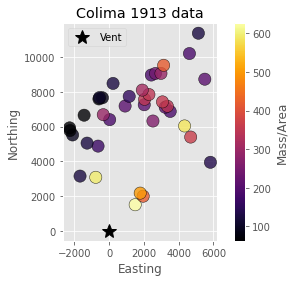

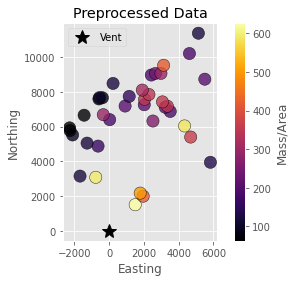

In [5]:
vis.plot_sample(raw_df, vent=(0,0), log=False, title="Colima 1913 data", cbar_label="Mass/Area")
plt.show()
# plt.savefig("colima/all_points.png", dpi=200, format='png')

obs_df = raw_df.copy()

# obs_df = obs_df.drop([16, 18, 17, 37, 31])
#This is going to be 100 across. Just needs to be the same as the other dfs. 
obs_df["Residual"] = obs_df["MassArea"]/obs_df["MassArea"]*100

vis.plot_sample(obs_df, vent=(0,0), log=False, title="Preprocessed Data", cbar_label="Mass/Area")
# plt.savefig("colima/All_trans.png", dpi=200, format='png')
plt.show()

In [6]:
t2_const_df, _, _, _ = io.read_tephra2("data/colima/colima_tephra2_const_wind_sim_data.txt")

t2_const_df["Residual"] = t2_const_df["MassArea"]/obs_df["MassArea"]

display.display(t2_const_df.head())

,Easting,Northing,Elevation,MassArea,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius,Residual
16,1499,1506,2500,"1,394.46",17.2005,24.2121,24.7779,18.9162,10.8457,3.58293,0.449327,0.015328,2.84769e-05,"2,124.86",2.22828
18,1957,1997,2500,"1,216.15",14.016,22.3619,24.864,20.2838,12.7356,4.93885,0.76913,0.0307052,6.30498e-05,"2,796.04",2.91503
17,1787,2173,2500,"1,251",13.877,22.2837,24.8861,20.3522,12.8046,4.98427,0.780754,0.0313104,6.44789e-05,"2,813.41",2.4988
37,-770,3082,2500,359.399,14.8025,22.8299,24.5313,19.4545,12.2828,5.13528,0.922533,0.0410962,9.09858e-05,"3,176.73",0.60453
31,-1673,3152,2500,134.301,15.3664,23.3283,24.4813,18.8191,11.7036,5.16746,1.07907,0.054478,0.000131905,"3,568.48",1.07303


In [7]:
config = io.read_tephra2_config("data/colima/colima_config.txt")

globs = {
    "LITHIC_DIAMETER_THRESHOLD": 7.,
    "PUMICE_DIAMETER_THRESHOLD": -1.,
    "AIR_VISCOSITY": 0.000018325,
    "AIR_DENSITY":  1.293,
    "GRAVITY": 9.81,
}






# Update parameters
# COL STEPS need to be small enough so the 
# layer height can be kept for an inversion with a high H
config["COL_STEPS"] = 20
theoretical_max = 45000 #The H value will be as close as possible to this
layer_thickness = ((config["PLUME_HEIGHT"]-config["VENT_ELEVATION"])/config["COL_STEPS"])

inversion_steps = np.round((config["COL_STEPS"]*(theoretical_max - config["VENT_ELEVATION"]))/\
                  (config["PLUME_HEIGHT"]-config["VENT_ELEVATION"]))
closest_H = ((inversion_steps*(config["PLUME_HEIGHT"] - config["VENT_ELEVATION"]))/\
             config["COL_STEPS"]) + config["VENT_ELEVATION"]
print("This number needs to be low enough to invert efficiently:")
print(inversion_steps)
print("If not, decrease COL_STEPS or theoretical max")
print("Closest Possible Theoretical Max Column Height:")
print(closest_H)

config["INV_STEPS"] = int(inversion_steps)
config["THEO_MAX_COL"] = closest_H
config["PART_STEPS"] = 9

config["MAX_GRAINSIZE"] = -5
config["MIN_GRAINSIZE"] = 4

# Additional parameter: Constant wind speed
config["WIND_SPEED"] = 10

# To ensure monotonicity:
# config["DIFFUSION_COEFFICIENT"] = 1.7*config["FALL_TIME_THRESHOLD"]

print("INPUT PARAMETERS:")
display.display(config)
display.display(globs)

This number needs to be low enough to invert efficiently:
40.0
If not, decrease COL_STEPS or theoretical max
Closest Possible Theoretical Max Column Height:
44915.0
INPUT PARAMETERS:


{'VENT_EASTING': 0.0,
 'VENT_NORTHING': 0.0,
 'VENT_ELEVATION': 3085.0,
 'PLUME_HEIGHT': 24000.0,
 'ALPHA': 1.02,
 'BETA': 1.56,
 'ERUPTION_MASS': 55000000000.0,
 'MAX_GRAINSIZE': -5,
 'MIN_GRAINSIZE': 4,
 'MEDIAN_GRAINSIZE': -1.8,
 'STD_GRAINSIZE': 2.4,
 'EDDY_CONST': 0.04,
 'DIFFUSION_COEFFICIENT': 4016.0,
 'FALL_TIME_THRESHOLD': 6458.0,
 'LITHIC_DENSITY': 2700.0,
 'PUMICE_DENSITY': 1024.0,
 'COL_STEPS': 20,
 'PART_STEPS': 9,
 'PLUME_MODEL': 2.0,
 'INV_STEPS': 40,
 'THEO_MAX_COL': 44915.0,
 'WIND_SPEED': 10}

{'LITHIC_DIAMETER_THRESHOLD': 7.0,
 'PUMICE_DIAMETER_THRESHOLD': -1.0,
 'AIR_VISCOSITY': 1.8325e-05,
 'AIR_DENSITY': 1.293,
 'GRAVITY': 9.81}

,lower,upper,interval,centroid,density,probability
0,-5,-4,"[-5,-4)",-4.5,"1,024",0.0683375
1,-4,-3,"[-4,-3)",-3.5,"1,024",0.109203
2,-3,-2,"[-3,-2)",-2.5,"1,024",0.146694
3,-2,-1,"[-2,-1)",-1.5,"1,024",0.16565
4,-1,0,"[-1,0)",-0.5,"1,024",0.157243
5,0,1,"[0,1)",0.5,"1,233.5",0.125474
6,1,2,"[1,2)",1.5,"1,443",0.0841661
7,2,3,"[2,3)",2.5,"1,652.5",0.0474595
8,3,4,"[3,4)",3.5,"1,862",0.0224962


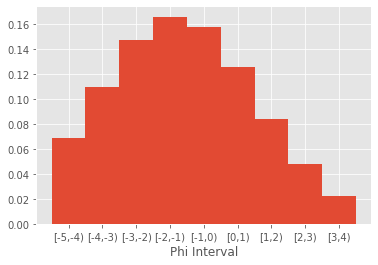

In [8]:
theo_phi_steps = get_phi_steps(config["MIN_GRAINSIZE"], config["MAX_GRAINSIZE"], 
                          config["PART_STEPS"], 
                          config["MEDIAN_GRAINSIZE"], config["STD_GRAINSIZE"],
                          globs["LITHIC_DIAMETER_THRESHOLD"], 
                          globs["PUMICE_DIAMETER_THRESHOLD"], 
                          config["LITHIC_DENSITY"], config["PUMICE_DENSITY"])
step_width = (config["MAX_GRAINSIZE"] - config["MIN_GRAINSIZE"])/config["PART_STEPS"]

display.display(pd.DataFrame(theo_phi_steps))



probs = [phi["probability"].copy() for phi in theo_phi_steps]
x = [phi["centroid"] for phi in theo_phi_steps]
labels = [phi["interval"] for phi in theo_phi_steps]
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, probs, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels)
plt.xlabel("Phi Interval")
plt.show()

[0.05231643 0.16945065 0.20390996 0.20809308 0.19893822 0.12429353
 0.02893896 0.00704844 0.00701073]
[-4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


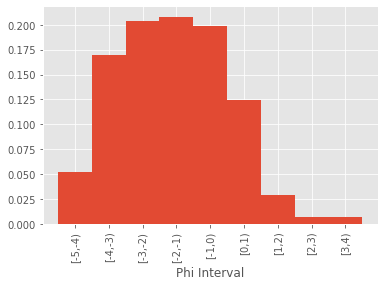

[{'lower': -5, 'upper': -4.0, 'interval': '[-5,-4)', 'centroid': -4.5, 'density': 1024.0, 'probability': 0.052316431318540024}, {'lower': -4.0, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.1694506511837887}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.20390996005463202}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.2080930801364657}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.19893821897376404}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.12429352702169855}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1,2)', 'centroid': 1.5, 'density': 1443.0, 'probability': 0.028938961877603735}, {'lower': 2.0, 'upper': 3.0, 'interval': '[2,3)', 'centroid': 2.5, 'density': 1652.5, 'probability': 0.00704844304499

In [9]:
naive_tgsd = get_tgsd(obs_df, theo_phi_steps)
print(naive_tgsd)
print(x)
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, naive_tgsd, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

naive_phi_steps = theo_phi_steps.copy()
for i, phi in enumerate(naive_phi_steps):
    phi["probability"] = naive_tgsd[i]
print(naive_phi_steps)

In [10]:

grid = obs_df[["Easting", "Northing"]]
wind_angle = np.radians(55)

u = config["WIND_SPEED"]*np.cos(wind_angle)
v = config["WIND_SPEED"]*np.sin(wind_angle)

forward_df = gaussian_stack_forward(
    grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
    config["PLUME_HEIGHT"], 2500, naive_phi_steps, (config["ALPHA"], config["BETA"]), 
    config["ERUPTION_MASS"], 
    (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
    config["FALL_TIME_THRESHOLD"]
)

forward_df["radius"] = np.sqrt(forward_df["Easting"]**2 + forward_df["Northing"]**2)
forward_df = forward_df.sort_values(by=['radius'])
forward_df["Residual"] = forward_df["MassArea"].values/obs_df["MassArea"].values
display.display(forward_df.head())

print(u, v)

,Northing,Easting,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",MassArea,radius,Residual
0,1506,1499,10.2913,29.5685,27.288,18.924,10.9616,2.84099,0.123803,0.001825,7.10812e-06,"1,678.84","2,124.86",2.68271
1,1997,1957,8.3142,27.1464,27.2807,20.2572,12.8676,3.91805,0.212099,0.00365928,1.57598e-05,"1,462.8","2,796.04",3.50624
2,2173,1787,8.22952,27.0446,27.2982,20.3207,12.9346,3.95335,0.215267,0.00373077,1.61147e-05,"1,504.98","2,813.41",3.00611
3,3082,-770,8.7488,27.7372,27.0418,19.5747,12.5223,4.11323,0.256923,0.00494637,2.29538e-05,428.027,"3,176.73",0.719966
4,3152,-1673,9.0285,28.313,27.0764,19.0615,12.0333,4.17711,0.303382,0.0066199,3.35645e-05,158.425,"3,568.48",1.26578


5.735764363510461 8.191520442889917


/home/nice/repos/inversion_project/vis_utils.py:135: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  bg = ax.scatter(


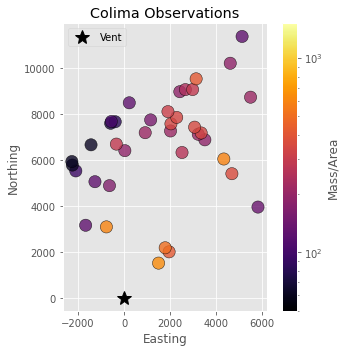

/home/nice/repos/inversion_project/vis_utils.py:135: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  bg = ax.scatter(
/home/nice/repos/inversion_project/vis_utils.py:135: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  bg = ax.scatter(


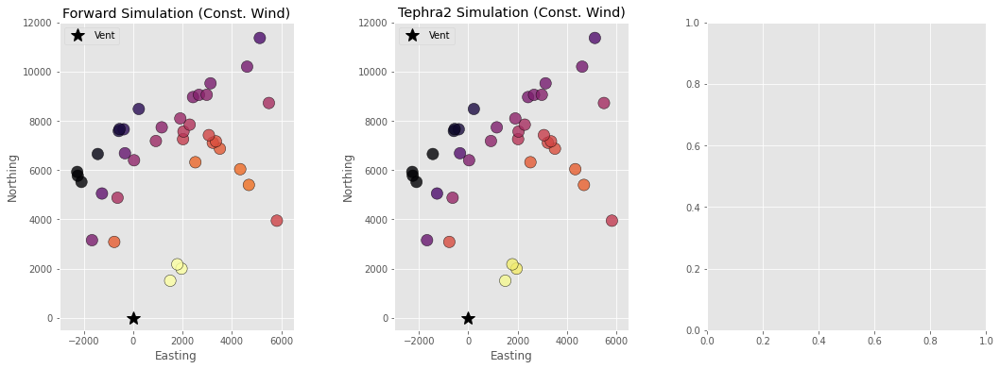

In [11]:

fig, ax = plt.subplots(1, 1, figsize=(5,5))

vis.plot_sample(obs_df, vent=(0,0), log=True, bounds=(50, 1500),
            title="Colima Observations", cbar_label="Mass/Area", ax = ax)
plt.tight_layout()
plt.show()


fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()

vis.plot_sample(forward_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Forward Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[0])
vis.plot_sample(t2_const_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Tephra2 Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[1])
# vis.plot_sample(t2_df, vent=(0,0), log=True, bounds=(50, 1500),
#             title="Tephra2 Simulation (NOAA Wind)", cbar_label="Mass/Area", ax=axs[2])
axs[0].set_xlim([-3000, 6500])
axs[0].set_ylim([-500, 12000])
axs[1].set_xlim([-3000, 6500])
axs[1].set_ylim([-500, 12000])
plt.show()




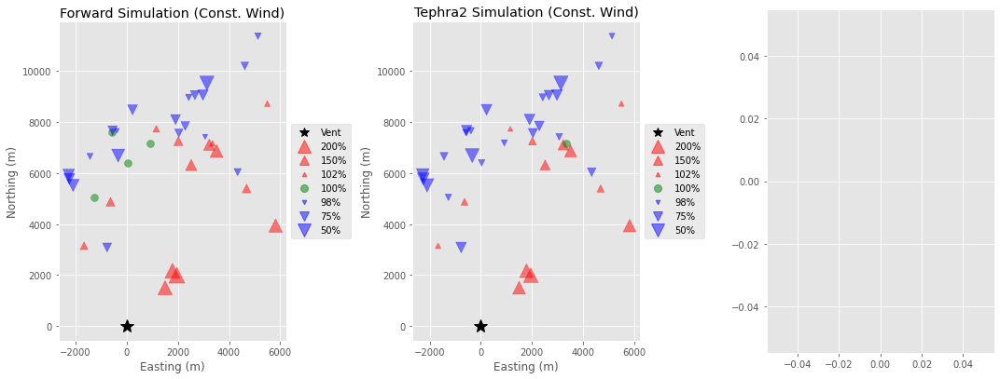

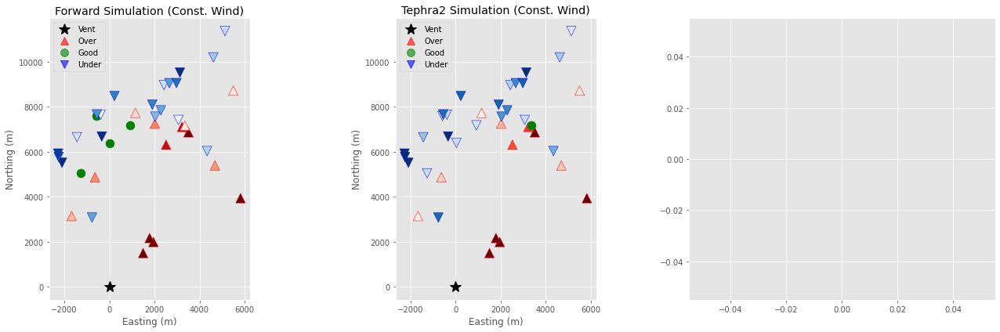

In [12]:
fig, axs = plt.subplots(1, 3, figsize=(
        15,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "size", ax=axs[0])
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "size", ax=axs[1])
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "size", ax=axs[2])


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "cmap", ax=axs[0], show_cbar = False)
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "cmap", ax=axs[1], show_cbar = False)
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "cmap", ax=axs[2], show_cbar = True)


# plt.tight_layout()
plt.show()

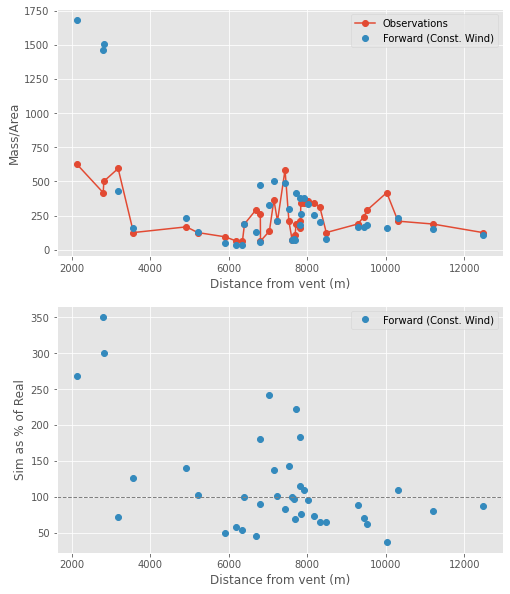

In [13]:
fig, axs = plt.subplots(2,1, figsize=(
        8,10), facecolor='w', edgecolor='k')
axs = axs.ravel()

axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C0o-', label="Observations")
# plt.plot(rotdf["radius"].values, rotdf["MassArea"].values, 'C1o-')
axs[0].plot(forward_df["radius"].values, forward_df["MassArea"].values, 'C1o', label="Forward (Const. Wind)")
# axs[0].plot(t2_const_df["radius"].values, t2_const_df["MassArea"].values, 'C2o', label="Tephra2 (Const. Wind)")
# axs[0].plot(t2_df["radius"].values, t2_df["MassArea"].values, 'C3o', label="Tephra2 (NOAA Wind)")
axs[0].legend()
axs[0].set_xlabel("Distance from vent (m)")
axs[0].set_ylabel("Mass/Area")

axs[1].plot(forward_df["radius"].values, forward_df["Residual"].values*100, 'C1o', label="Forward (Const. Wind)")
# axs[1].plot(t2_const_df["radius"].values, t2_const_df["Residual"].values*100, 'C2o', label="Tephra2 (Const. Wind)")
# axs[1].plot(t2_df["radius"].values, t2_df["Residual"].values*100, 'C3o', label="Tephra2 (NOAA Wind)")
axs[1].axhline(100, linestyle="--", lw=1, c="gray")
axs[1].legend()
axs[1].set_xlabel("Distance from vent (m)")
axs[1].set_ylabel("Sim as % of Real")
plt.show()

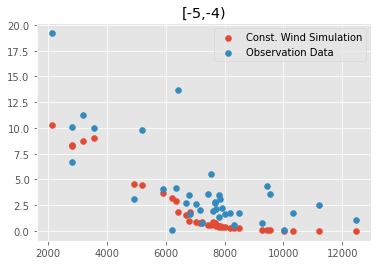

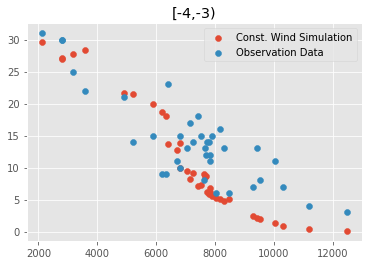

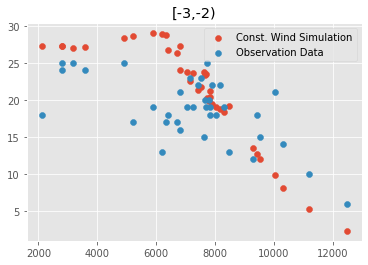

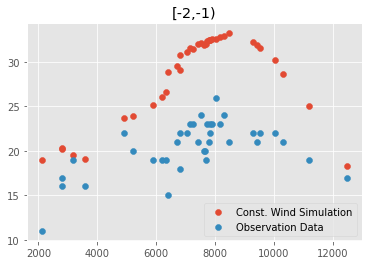

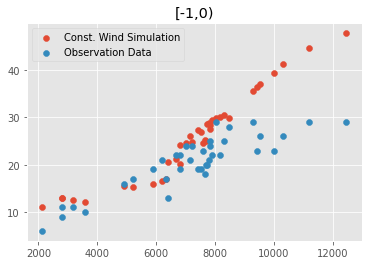

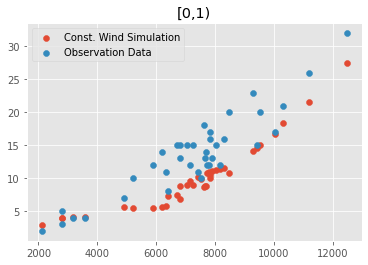

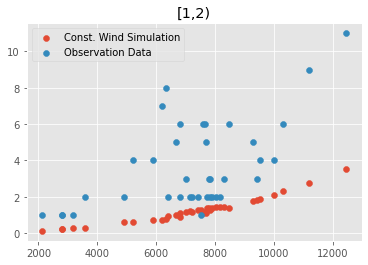

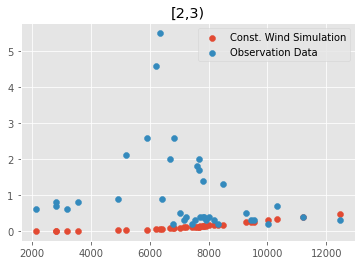

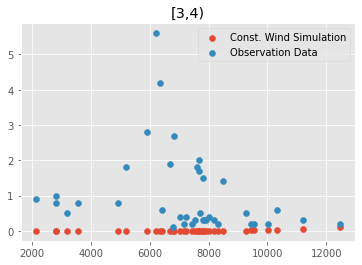

In [14]:
#TGSD calculation?
forward_tgsd = []
# t2_const_tgsd = []
# t2_tgsd = []
obs_tgsd = []
for phi_step in naive_phi_steps:
    plt.scatter(forward_df["radius"], forward_df[phi_step["interval"]], label="Const. Wind Simulation")
#     plt.scatter(t2_const_df["radius"], t2_const_df[phi_step["interval"]], label="T2 Const. Wind Simulation")
#     plt.scatter(t2_df["radius"], t2_df[phi_step["interval"]], label="T2 NOAA Wind Simulation")
    plt.scatter(obs_df["radius"], obs_df[phi_step["interval"]], label="Observation Data")
    plt.legend()
    plt.title(phi_step["interval"])
    plt.show()
    
    forward_tgsd += [forward_df[phi_step["interval"]].sum()/len(forward_df)]
#     t2_const_tgsd += [t2_const_df[phi_step["interval"]].sum()/len(t2_const_df)]
#     t2_tgsd += [t2_df[phi_step["interval"]].sum()/len(t2_df)]
    obs_tgsd += [obs_df[phi_step["interval"]].sum()/len(obs_df)]

In [15]:


def col_truncnorm(mean, top=config["THEO_MAX_COL"]):
    bottom = 5000
    std = (top - bottom)/4
    standard_a, standard_b = (bottom - mean) / std, (top - mean) / std
    return truncnorm.rvs(standard_a, standard_b, loc=mean, scale=std)

def lognorm(prior, bottom=0):
    std_norm = norm.rvs()
    std_lognorm = np.exp(std_norm)
    lognorm = bottom + (prior-bottom)*std_lognorm
    return lognorm

def normal(prior):
    std_norm = norm.rvs()
    normal = prior*std_norm
    return normal

def uninformed(bottom, top):
    unif = uniform.rvs(loc = bottom, scale = (top-bottom))
    return unif


In [16]:
full_inversion_priors = {
    "a": 2.87671,
    "b": 3.64588,
    "h1": 25619.6,
    "u": 6.32662,
    "v": 7.20299,
    "D": 14280.6,
    "ftt": 6458,
    "eta": 0,
    "zeta": 0
}

# phi_probs = [
#     0.058657896918929336,
#     0.15114329504320803,
#     0.15644352749157492,
#     0.15138125134809738,
#     0.17100876050061856,
#     0.1814490666782764,
#     0.06799943098150356,
#     0.01682410991463832,
#     0.045092661123153584
# ]

,value,invert,sample_function
a,"[1.00001, 5]",True,<function uninformed at 0x7f84275dfa60>
b,"[1.0001, 5]",True,<function uninformed at 0x7f84275dfa60>
h1,"[10000, 44915.0]",True,<function uninformed at 0x7f84275dfa60>
u,"[6.32662, 10]",False,<function uninformed at 0x7f84275dfa60>
v,"[7.20299, 10]",False,<function uninformed at 0x7f84275dfa60>
D,"[14280.6, 6000]",False,<function uninformed at 0x7f84275dfa60>
ftt,"[6458.0, 10000]",False,<function uninformed at 0x7f84275dfa60>
eta,"[0, 0]",False,<function uninformed at 0x7f84275dfa60>
zeta,"[0, 0]",False,<function uninformed at 0x7f84275dfa60>


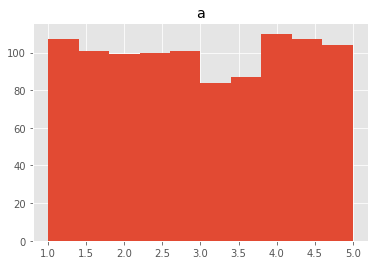

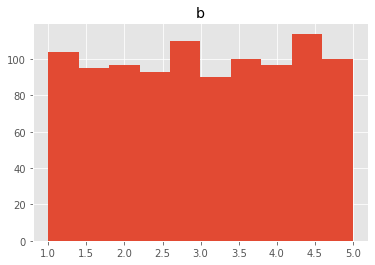

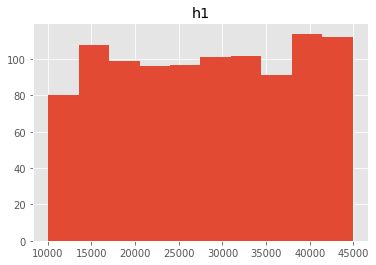

In [17]:
# param_config = {
#     "a": {
#         "value":[1.01, 5],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "b": {
#         "value":[1.01, 5],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "h1": {
#         "value":[5000, config["THEO_MAX_COL"]],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "u": {
#         "value":[full_inversion_priors["u"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "v": {
#         "value":[full_inversion_priors["v"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "D": {
#         "value":[full_inversion_priors["D"], 6000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "ftt": {
#         "value":[config["FALL_TIME_THRESHOLD"], 10000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "eta": {
#         "value":[full_inversion_priors["eta"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "zeta": {
#         "value":[0, 0],
#         "invert":False,
#         "sample_function": uninformed
#     },
# }


param_config = {
    "a": {
        "value":[1.00001, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "b": {
        "value":[1.0001, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "h1": {
        "value":[10000, config["THEO_MAX_COL"]],
        "invert":True,
        "sample_function": uninformed
    },
    "u": {
        "value":[full_inversion_priors["u"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "v": {
        "value":[full_inversion_priors["v"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "D": {
        "value":[full_inversion_priors["D"], 6000],
        "invert":False,
        "sample_function": uninformed
    },
    "ftt": {
        "value":[config["FALL_TIME_THRESHOLD"], 10000],
        "invert":False,
        "sample_function": uninformed
    },
    "eta": {
        "value":[0, 0],
        "invert":False,
        "sample_function": uninformed
    },
    "zeta": {
        "value":[0, 0],
        "invert":False,
        "sample_function": uninformed
    },
}

param_config_df = pd.DataFrame(param_config)
display.display(param_config_df.T)

for key, val in param_config.items():
    if val["invert"] == True:
        x = [val["sample_function"](*val["value"]) for i in range(1000)]
        plt.hist(x)
        plt.title(key)
        plt.show()



========[-5,-4)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.48e+02 	4.77e+02 	1.0666 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


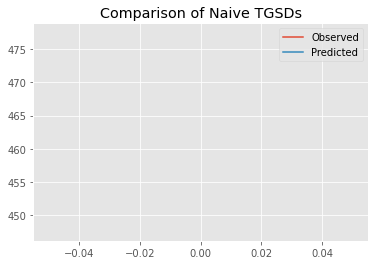

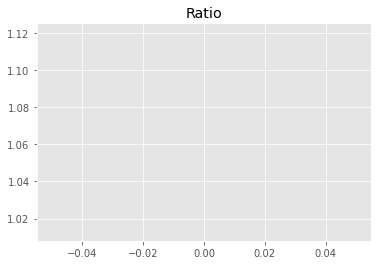

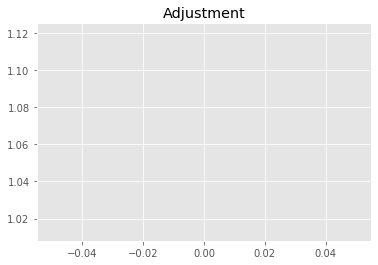

3069151758.691914
1


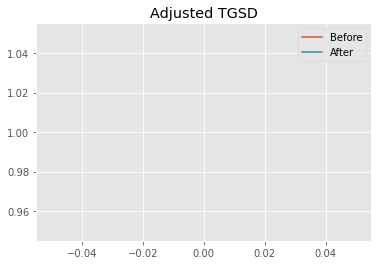

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85257 	2.68358 	26913.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.83959 	3.1572 	23132.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.1004
New Misfit: 11.7801
Convergence:
0.026473250897612533

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.16e+02 	4.77e+02 	1.1489 		1.0000


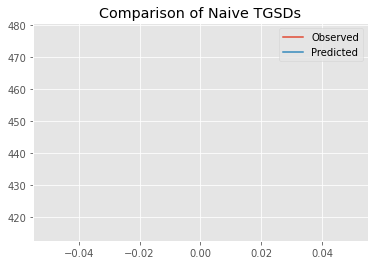

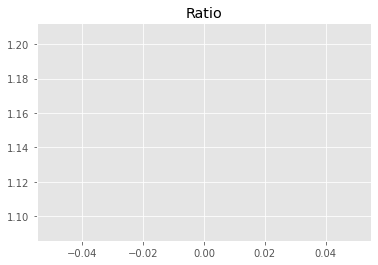

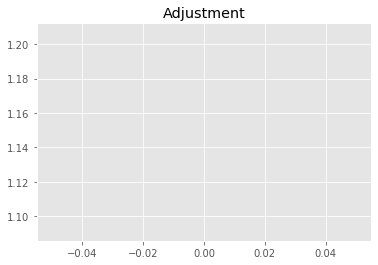

3305931442.5292077
1


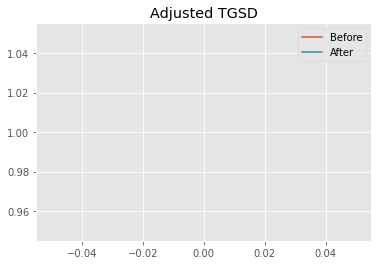

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83959 	3.1572 	23132.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.60801 	7.8655 	35468.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.7801
New Misfit: 11.5545
Convergence:
0.01914718344477935

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.82e+02 	4.77e+02 	1.2503 		1.0000


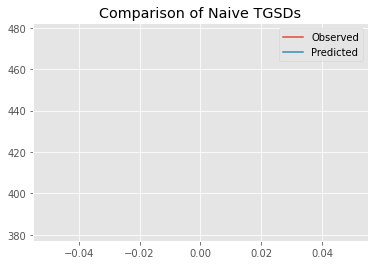

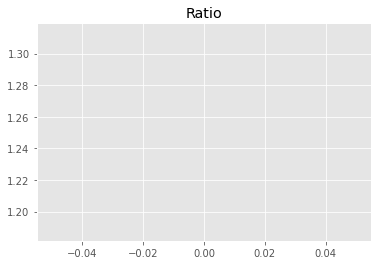

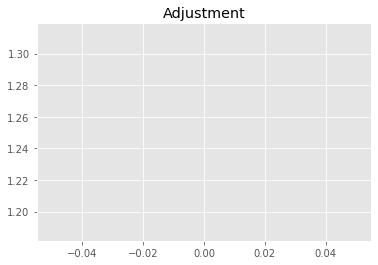

3597666086.948589
1


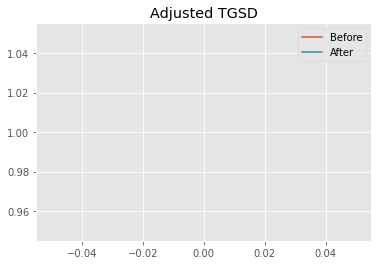

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.60801 	7.8655 	35468.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.18038 	4.18519 	30495.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5545
New Misfit: 11.3635
Convergence:
0.01652653328001863

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.92e+02 	4.77e+02 	1.2168 		1.0000


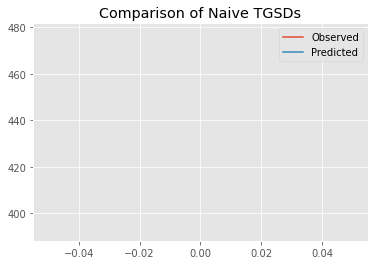

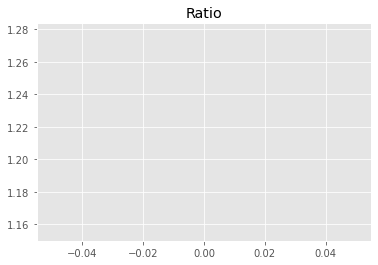

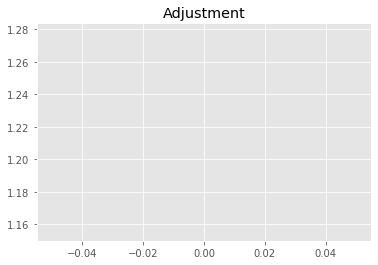

3501134637.3285413
1


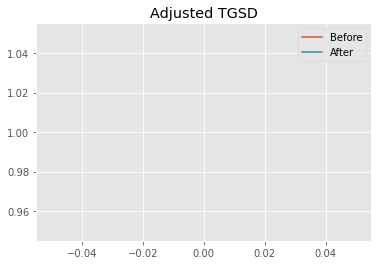

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.18038 	4.18519 	30495.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.03156 	4.97475 	36652.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.3635
New Misfit: 11.2501
Convergence:
0.00998399922383339

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.88e+02 	4.77e+02 	1.2297 		1.0000


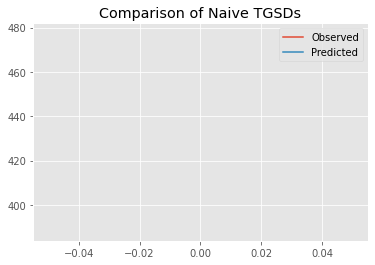

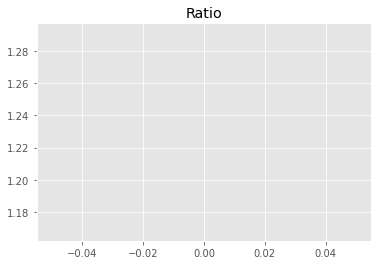

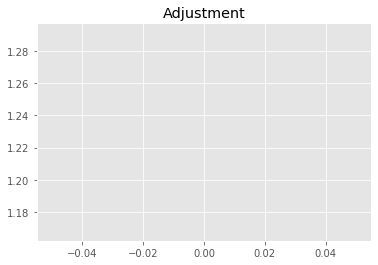

3538298880.124439
1


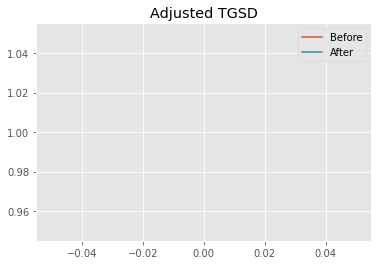

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03156 	4.97475 	36652.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00024 	5.97929 	44566.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2501
New Misfit: 11.1993
Convergence:
0.004516938944680113

____________________
a = 1.00024	b = 5.97929	            h1 = 44566.25233	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 11.199273839721466
Prior Misfit: 0.10076,	 Post Misfit: 11.1993


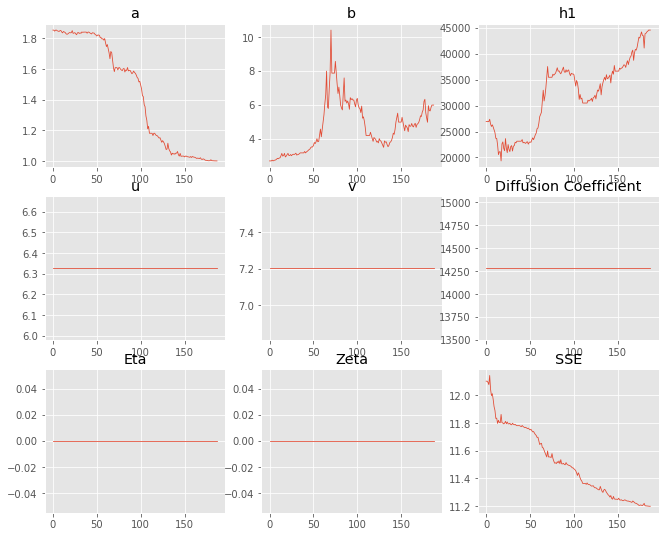

,Priors,Posteriors
a,1.85257,1.00024
b,2.68358,5.97929
h1,"26,913.6","44,566.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.096 minutes


Estimated remaining run time: 0.862 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.19e+02 	4.77e+02 	1.1394 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


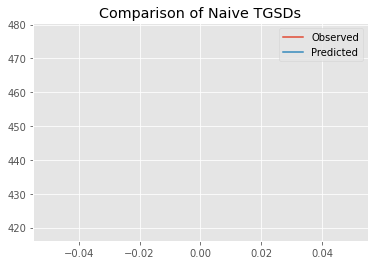

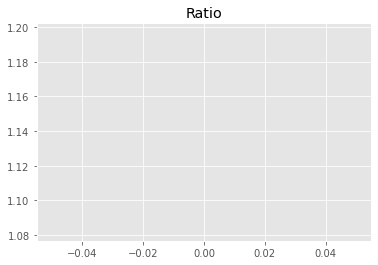

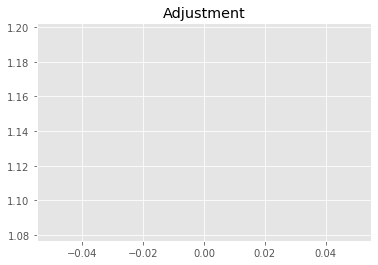

3278615419.525331
1


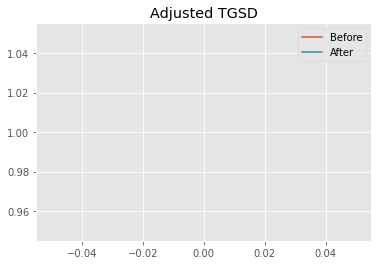

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.60341 	2.81746 	24192.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00876 	3.66576 	34525.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.6951
New Misfit: 11.2711
Convergence:
0.03625682760773647

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.04e+02 	4.77e+02 	1.1816 		1.0000


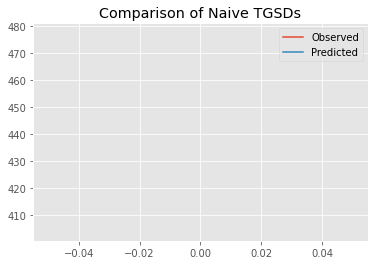

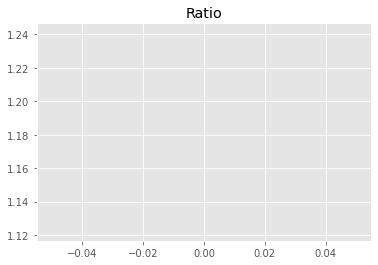

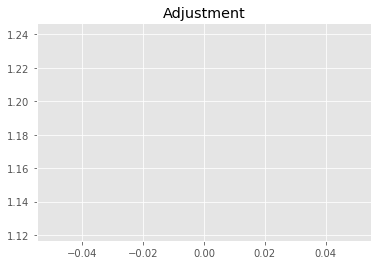

3399897340.6669817
1


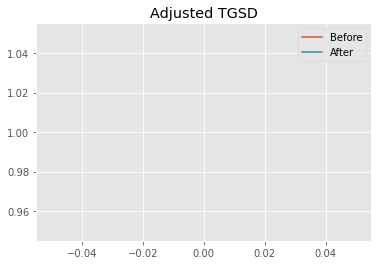

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00876 	3.66576 	34525.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00001 	5.5469 	43660.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2711
New Misfit: 11.2029
Convergence:
0.006051837787299757

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.94e+02 	4.77e+02 	1.2106 		1.0000


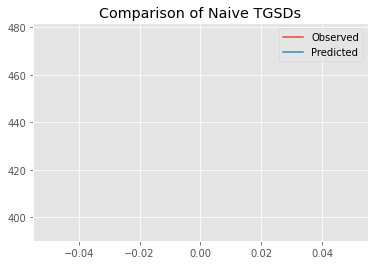

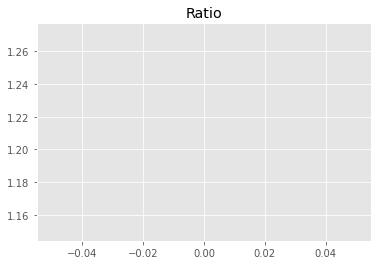

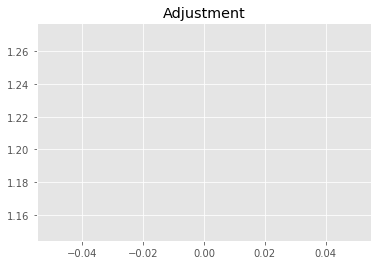

3483498885.301774
1


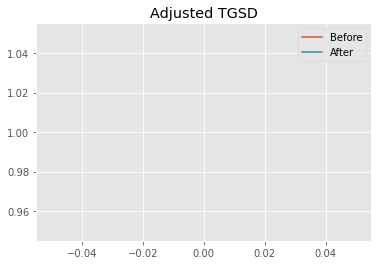

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00001 	5.5469 	43660.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00034 	5.8759 	44779 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2029
New Misfit: 11.1984
Convergence:
0.0003995966296223069

____________________
a = 1.00034	b = 5.87590	            h1 = 44779.04214	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.19839078658312
Prior Misfit: 0.0973853,	 Post Misfit: 11.1984


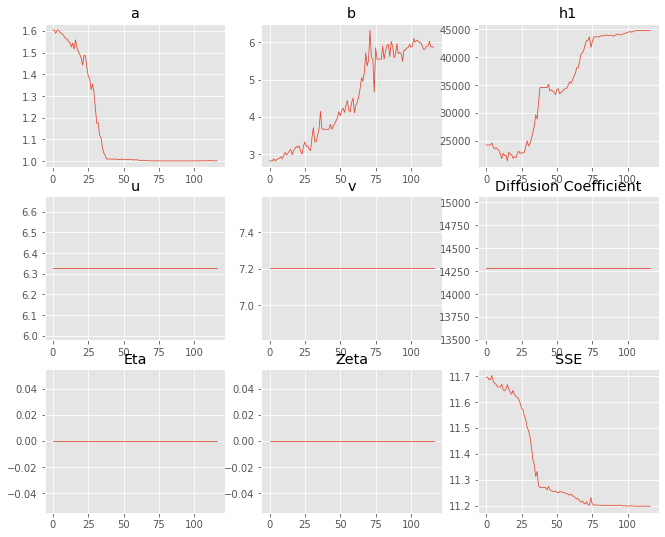

,Priors,Posteriors
a,1.60341,1.00034
b,2.81746,5.8759
h1,"24,192.8","44,779"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.064 minutes


Estimated remaining run time: 0.906 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.17e+02 	4.77e+02 	1.1456 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


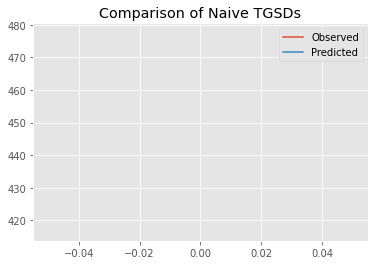

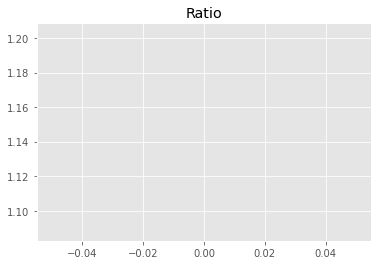

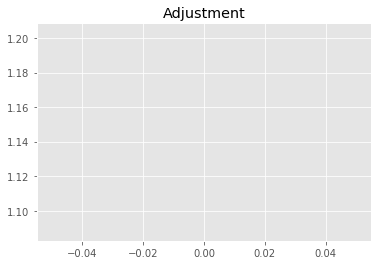

3296212936.047923
1


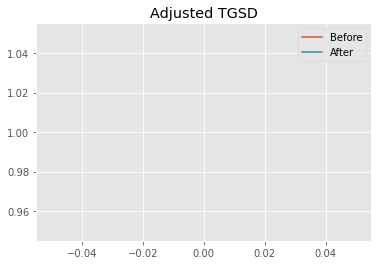

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.181 	2.59677 	19154.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.25765 	16.6309 	25260.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.0038
New Misfit: 11.4836
Convergence:
0.04332893037354947

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.80e+02 	4.77e+02 	1.7032 		1.0000


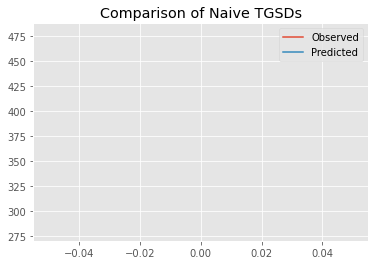

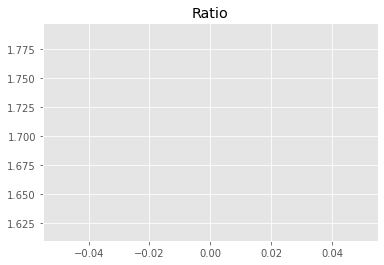

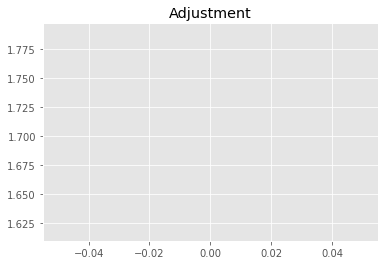

4900788018.527606
1


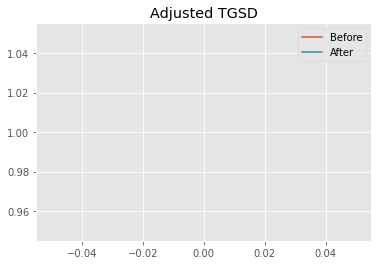

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.25765 	16.6309 	25260.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.11249 	15.3349 	25305.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4836
New Misfit: 11.4745
Convergence:
0.0007953166156395833

____________________
a = 1.11249	b = 15.33490	            h1 = 25305.34695	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.474516738521862
Prior Misfit: 0.0999555,	 Post Misfit: 11.4745


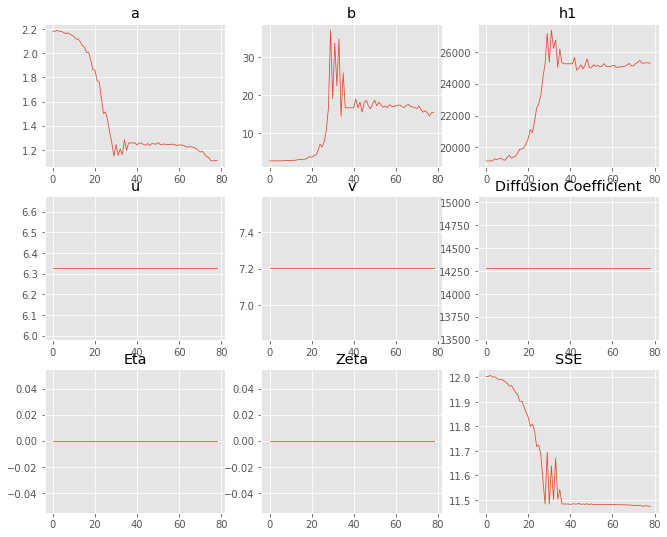

,Priors,Posteriors
a,2.181,1.11249
b,2.59677,15.3349
h1,"19,154.8","25,305.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.047 minutes


Estimated remaining run time: 0.827 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.48e+02 	4.77e+02 	1.0649 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


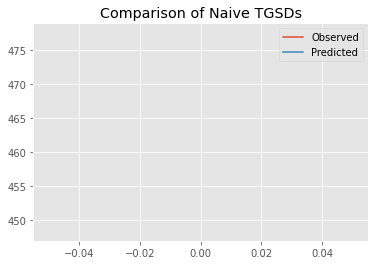

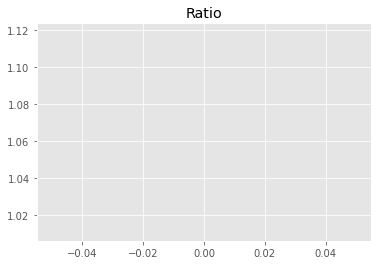

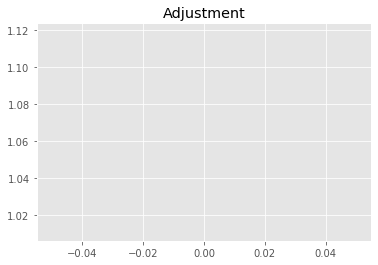

3064008414.3380413
1


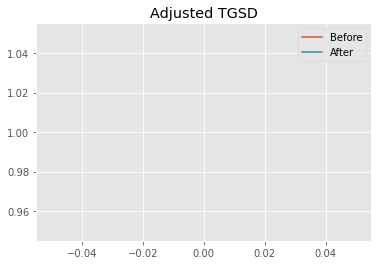

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.48756 	2.42871 	29551.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.26095 	2.20379 	23040.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.0261
New Misfit: 11.5539
Convergence:
0.039270817693660344

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.13e+02 	4.77e+02 	1.1549 		1.0000


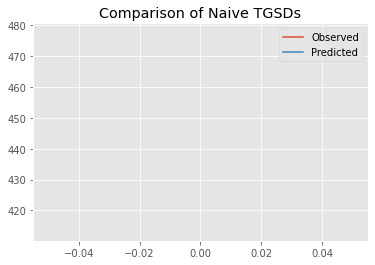

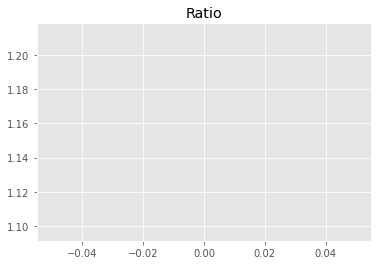

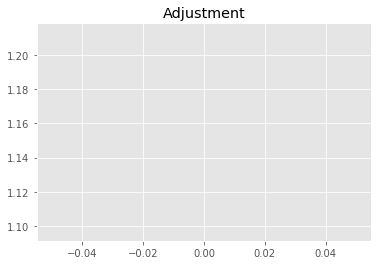

3323232142.808184
1


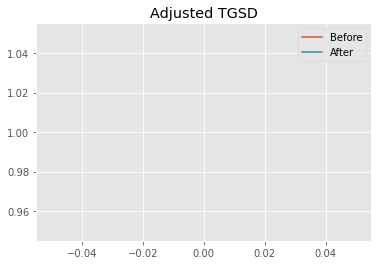

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.26095 	2.20379 	23040.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.01331 	2.26091 	24219.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5539
New Misfit: 11.3767
Convergence:
0.015332185411228877

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.03e+02 	4.77e+02 	1.1849 		1.0000


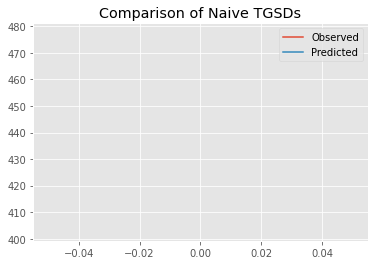

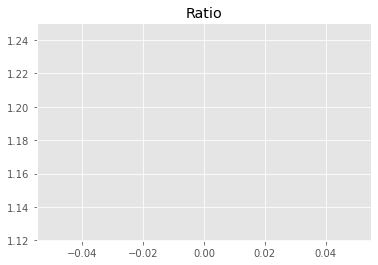

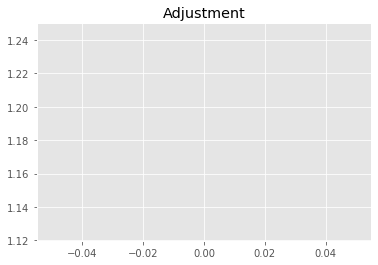

3409302121.9042764
1


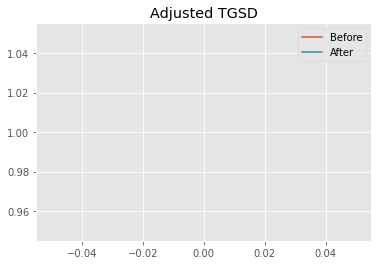

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01331 	2.26091 	24219.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	4.13269 	33587.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.3767
New Misfit: 11.2507
Convergence:
0.011080487170228238

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.92e+02 	4.77e+02 	1.2188 		1.0000


/home/nice/repos/inversion_project/utils.py:473: RuntimeWarning: divide by zero encountered in double_scalars
  factor_a = (1/((a-1)*(b-1)*(H-h1)))


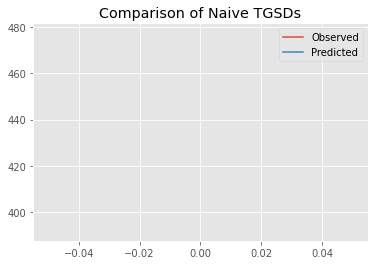

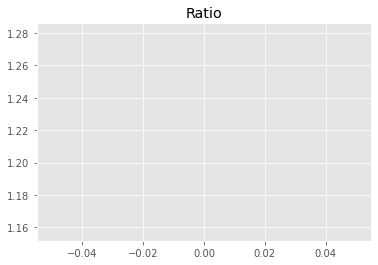

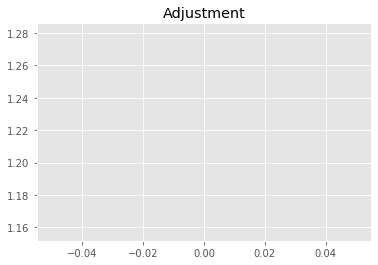

3507016867.202227
1


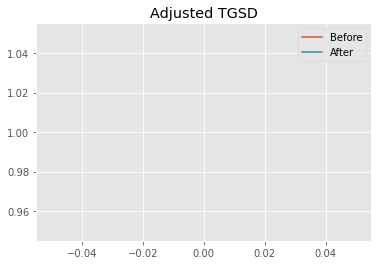

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	4.13269 	33587.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00001 	5.51456 	42486.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2507
New Misfit: 11.2061
Convergence:
0.003963016591460854

____________________
a = 1.00001	b = 5.51456	            h1 = 42486.83315	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.206068411972504
Prior Misfit: 0.100142,	 Post Misfit: 11.2061


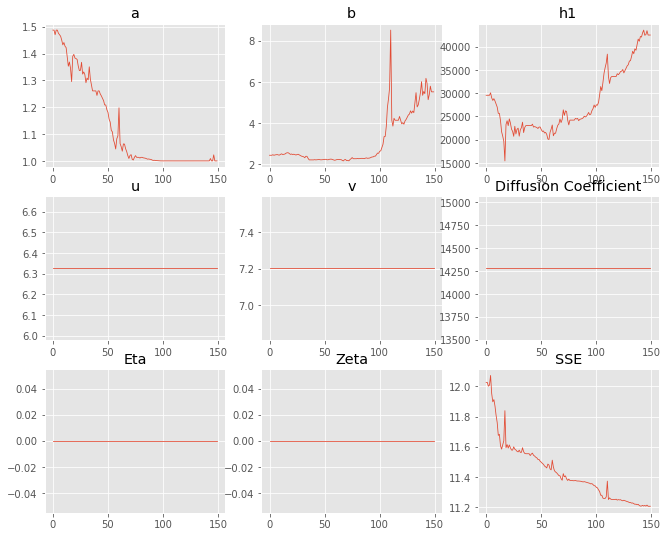

,Priors,Posteriors
a,1.48756,1.00001
b,2.42871,5.51456
h1,"29,551.8","42,486.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.078 minutes


Estimated remaining run time: 0.855 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.83e+02 	4.77e+02 	1.2464 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


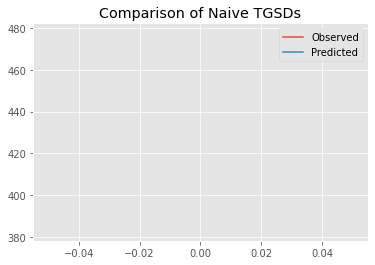

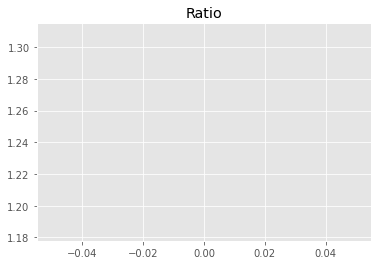

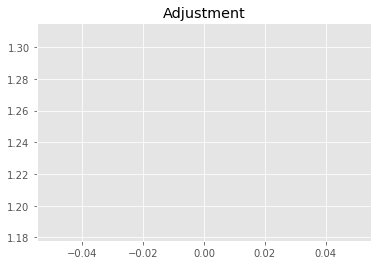

3586512097.1876607
1


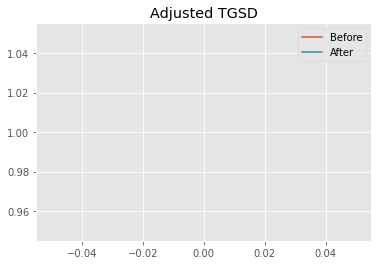

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01237 	4.68752 	21215 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.00903 	4.69044 	26359.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.9079
New Misfit: 11.7686
Convergence:
0.011697054808419627

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.09e+02 	4.77e+02 	1.1679 		1.0000


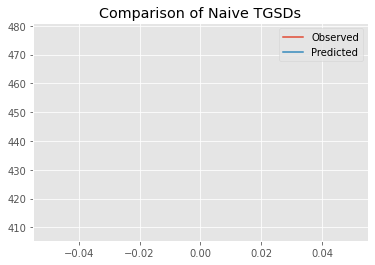

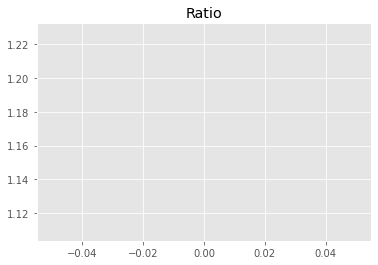

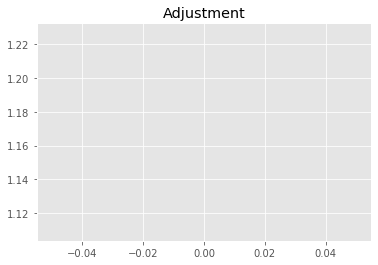

3360644700.535289
1


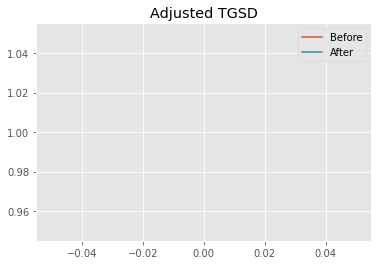

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00903 	4.69044 	26359.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.96656 	10.2764 	43298.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.7686
New Misfit: 11.6286
Convergence:
0.011893281971662695

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.98e+02 	4.77e+02 	1.1987 		1.0000


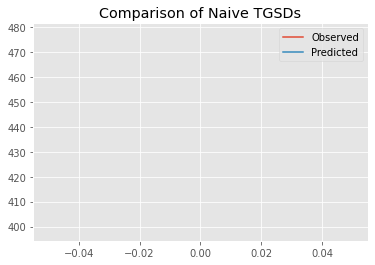

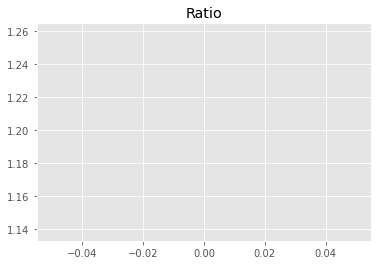

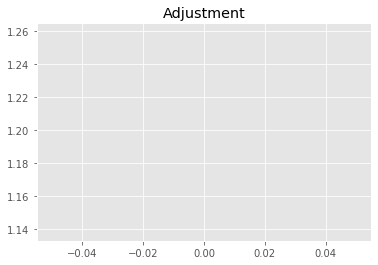

3449156729.8321023
1


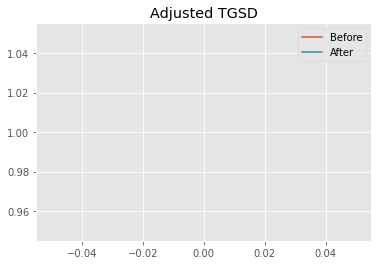

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96656 	10.2764 	43298.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.93408 	9.70486 	44306.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.6286
New Misfit: 11.6074
Convergence:
0.0018258375166649518

____________________
a = 1.93408	b = 9.70486	            h1 = 44306.49403	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.607388361314271
Prior Misfit: 0.0991571,	 Post Misfit: 11.6074


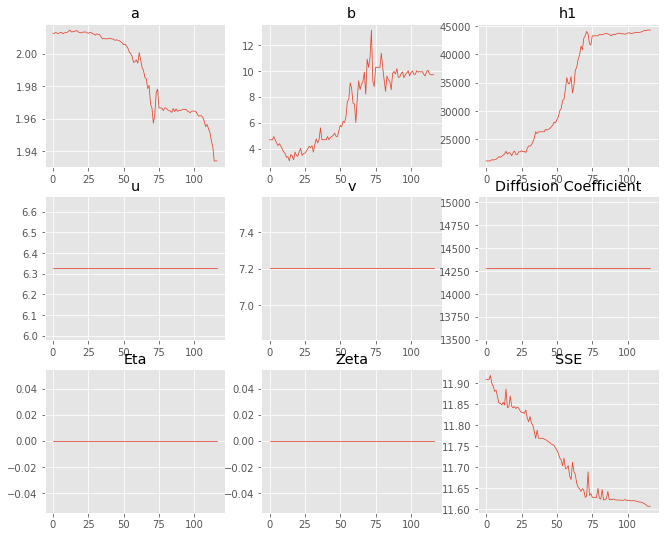

,Priors,Posteriors
a,2.01237,1.93408
b,4.68752,9.70486
h1,"21,215","44,306.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.065 minutes


Estimated remaining run time: 0.816 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.40e+02 	4.77e+02 	1.0862 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


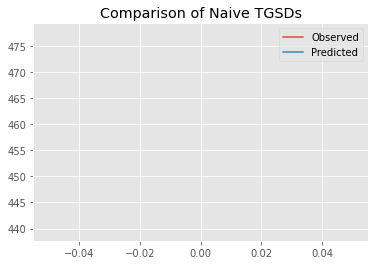

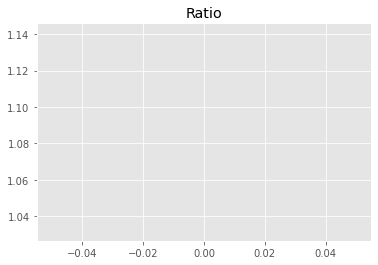

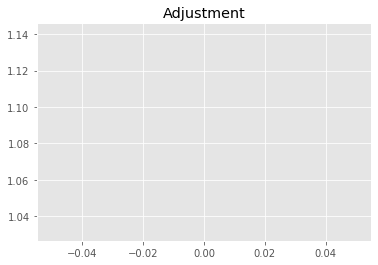

3125371015.8777275
1


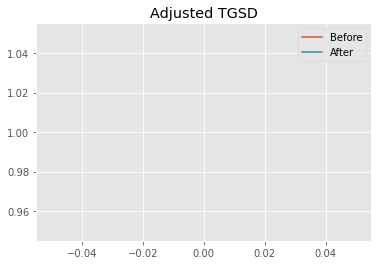

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.33187 	1.17318 	19838.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.16372 	2.04172 	19446.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.97
New Misfit: 11.5582
Convergence:
0.034395995097536096

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.93e+02 	4.77e+02 	1.2151 		1.0000


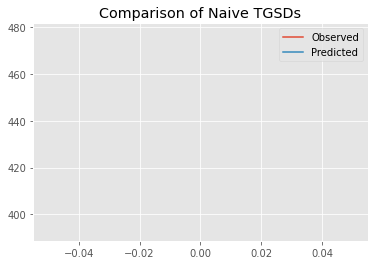

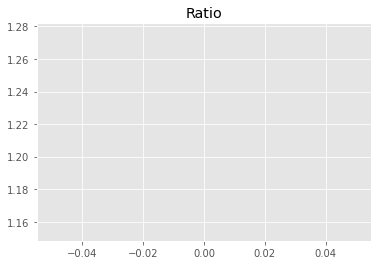

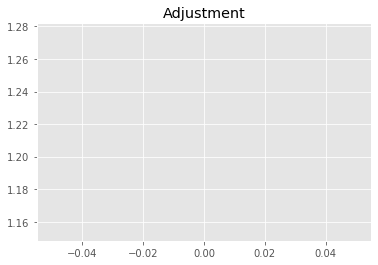

3496288510.1949005
1


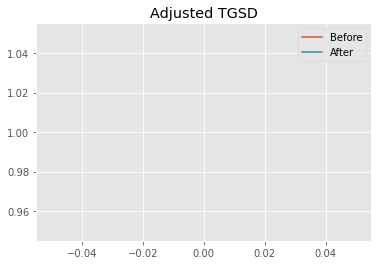

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.16372 	2.04172 	19446.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0015 	1.9483 	22140.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5582
New Misfit: 11.4129
Convergence:
0.012577025824999003

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.03e+02 	4.77e+02 	1.1861 		1.0000


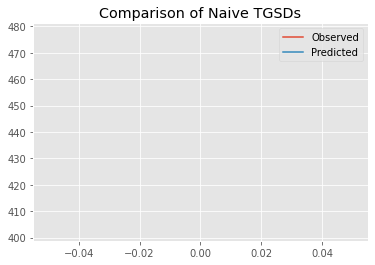

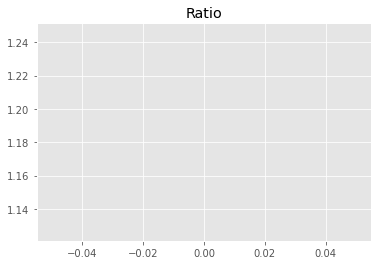

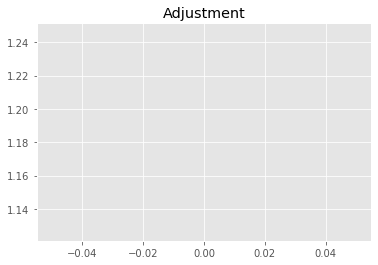

3412761923.6287866
1


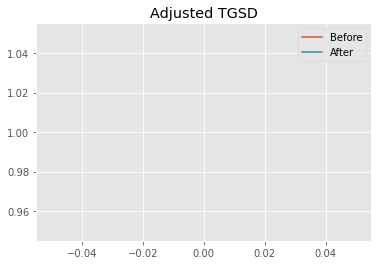

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0015 	1.9483 	22140.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0


/home/nice/repos/inversion_project/utils.py:473: RuntimeWarning: divide by zero encountered in double_scalars
  factor_a = (1/((a-1)*(b-1)*(H-h1)))


New Total Mass: 2.8774e+09
After: 		|1 	3.87222 	31726.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4129
New Misfit: 11.2646
Convergence:
0.012988238389493954

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.91e+02 	4.77e+02 	1.2211 		1.0000


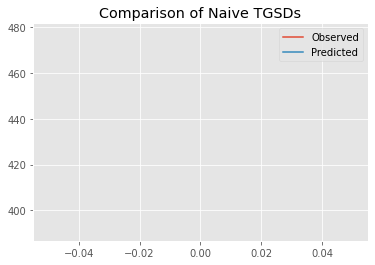

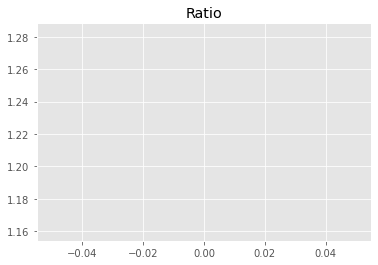

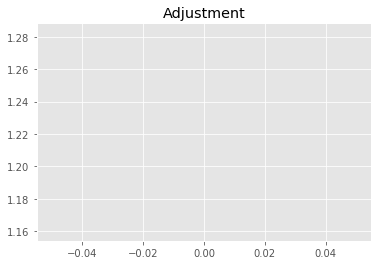

3513706896.253849
1


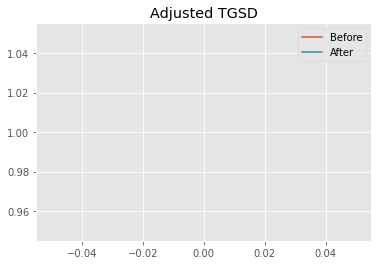

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	3.87222 	31726.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0


/home/nice/repos/inversion_project/utils.py:455: RuntimeWarning: divide by zero encountered in log
  a_star = np.log(a - 1)
/home/nice/miniconda3/lib/python3.9/site-packages/scipy/optimize/optimize.py:733: RuntimeWarning: invalid value encountered in subtract
  if (np.max(np.ravel(np.abs(sim[1:] - sim[0]))) <= xatol and
/home/nice/miniconda3/lib/python3.9/site-packages/scipy/optimize/optimize.py:738: RuntimeWarning: invalid value encountered in subtract
  xr = (1 + rho) * xbar - rho * sim[-1]


New Total Mass: 2.8774e+09
After: 		|1 	3.87222 	32299.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2646
New Misfit: 11.2599
Convergence:
0.00042094209850186226

____________________
a = 1.00000	b = 3.87222	            h1 = 32299.10752	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.259905586662859
Prior Misfit: 0.0996741,	 Post Misfit: 11.2599


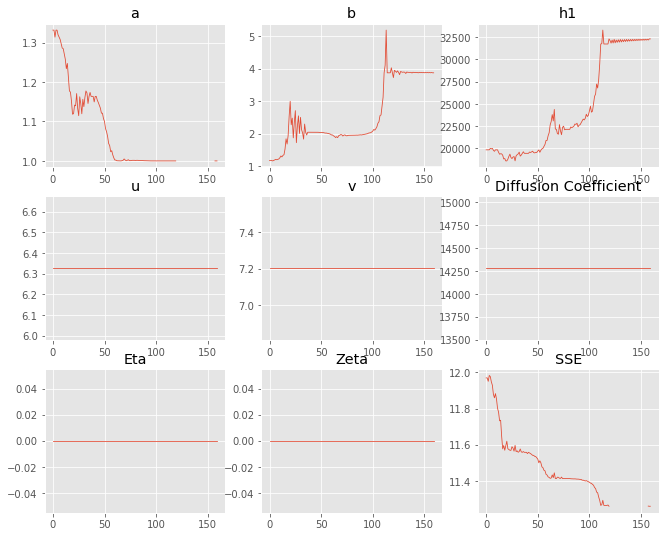

,Priors,Posteriors
a,1.33187,1
b,1.17318,3.87222
h1,"19,838.4","32,299.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.083 minutes


Estimated remaining run time: 0.804 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.22e+02 	4.77e+02 	1.1302 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


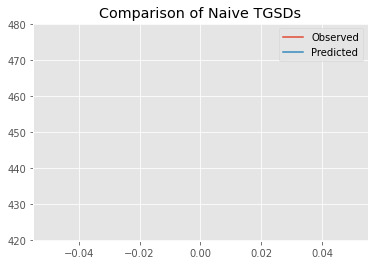

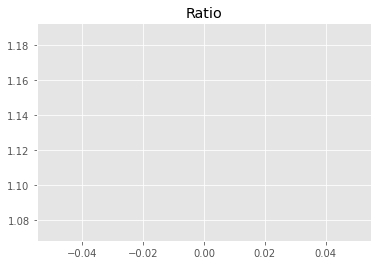

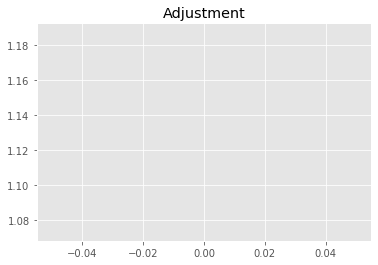

3251962841.549785
1


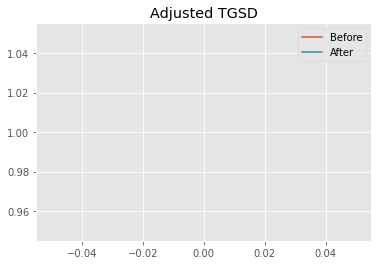

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.32292 	4.98373 	42681 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.08476 	4.81634 	35659.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4864
New Misfit: 11.2792
Convergence:
0.018040017485601058

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.92e+02 	4.77e+02 	1.2194 		1.0000


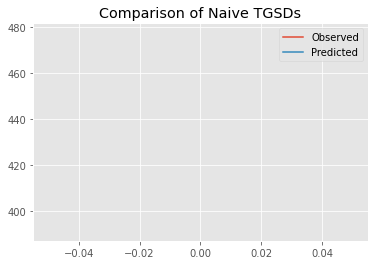

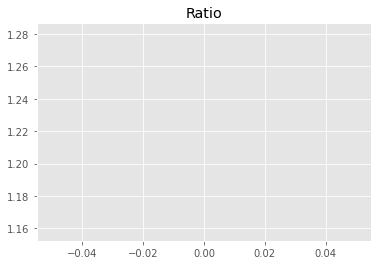

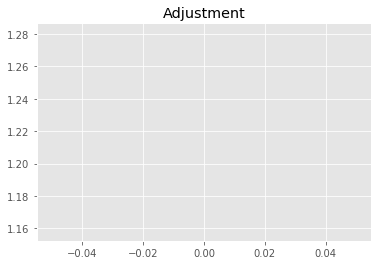

3508818072.560504
1


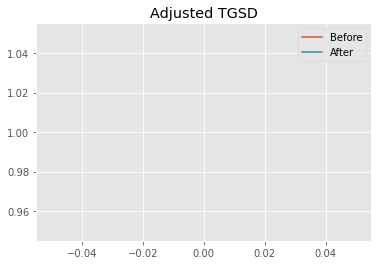

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.08476 	4.81634 	35659.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00001 	5.7367 	44150.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2792
New Misfit: 11.2004
Convergence:
0.006987008414015581

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.93e+02 	4.77e+02 	1.2154 		1.0000


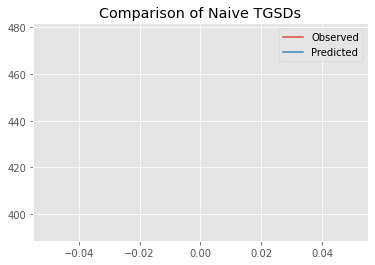

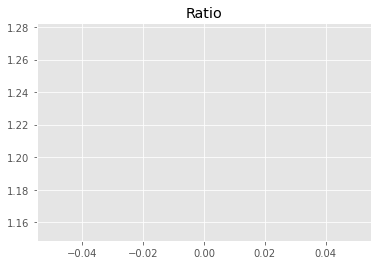

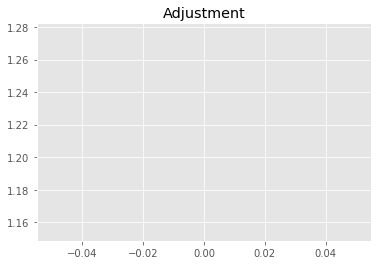

3497207694.813531
1


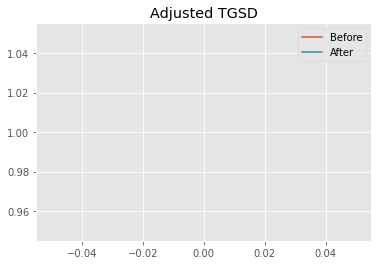

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00001 	5.7367 	44150.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.93652 	44910.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2004
New Misfit: 11.1978
Convergence:
0.00023324634549671392

____________________
a = 1.00000	b = 5.93652	            h1 = 44910.50886	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.197776976819842
Prior Misfit: 0.0956476,	 Post Misfit: 11.1978


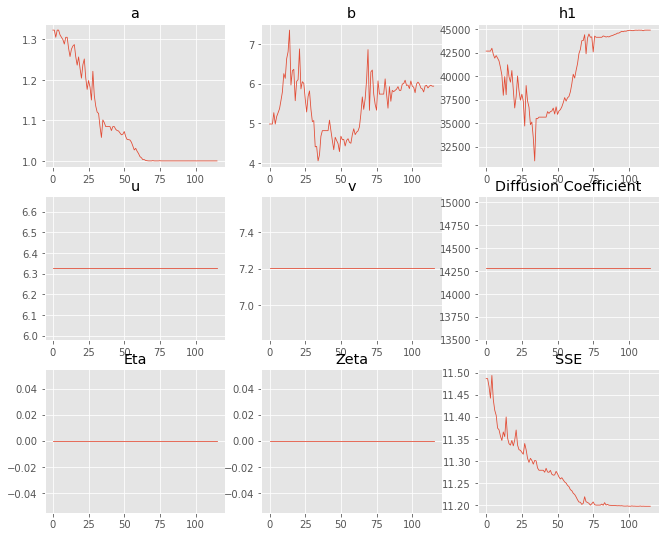

,Priors,Posteriors
a,1.32292,1
b,4.98373,5.93652
h1,"42,681","44,910.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.064 minutes


Estimated remaining run time: 0.745 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.42e+02 	4.77e+02 	1.0804 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


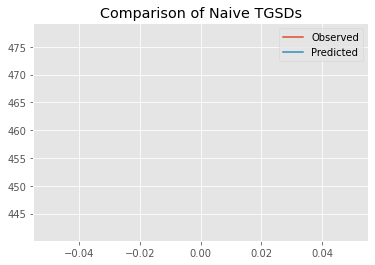

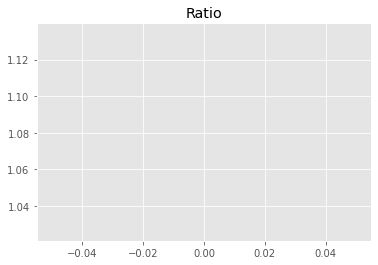

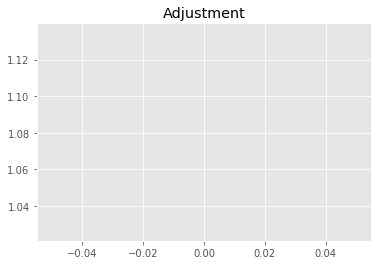

3108753433.6567597
1


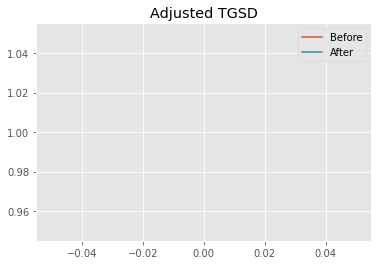

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.75358 	2.67044 	20690.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.10133 	11.4089 	18043.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.2928
New Misfit: 11.4883
Convergence:
0.0654461958383036

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.72e+02 	4.77e+02 	1.7560 		1.0000


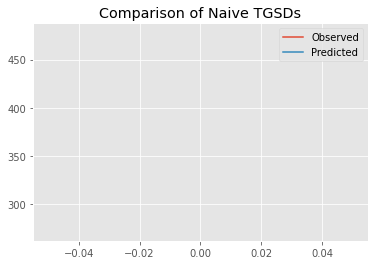

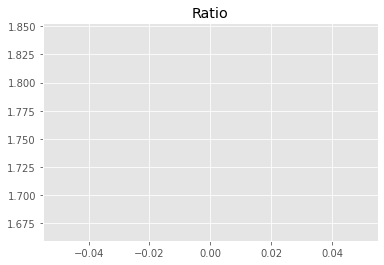

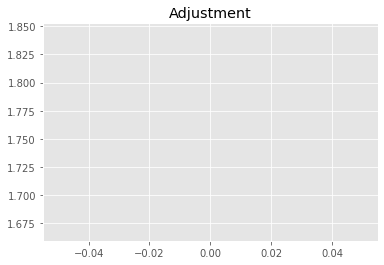

5052717839.176435
1


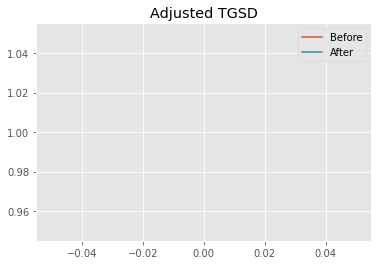

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10133 	11.4089 	18043.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.02394 	10.7861 	18840.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4883
New Misfit: 11.4807
Convergence:
0.0006634852089520002

____________________
a = 1.02394	b = 10.78613	            h1 = 18840.87415	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.48069502958019
Prior Misfit: 0.102363,	 Post Misfit: 11.4807


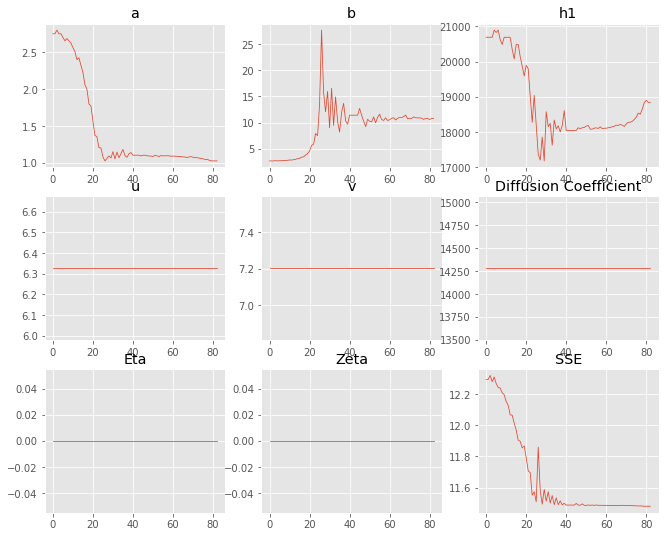

,Priors,Posteriors
a,2.75358,1.02394
b,2.67044,10.7861
h1,"20,690.3","18,840.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.049 minutes


Estimated remaining run time: 0.667 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.35e+02 	4.77e+02 	1.0964 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


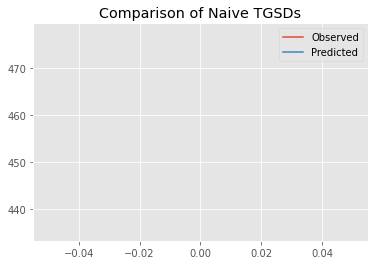

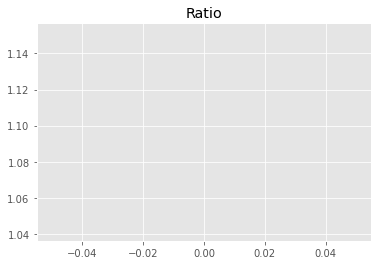

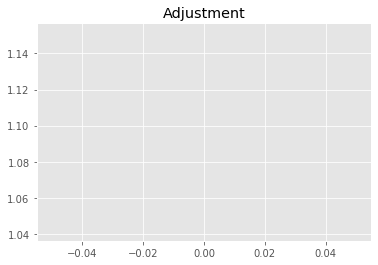

3154809329.252386
1


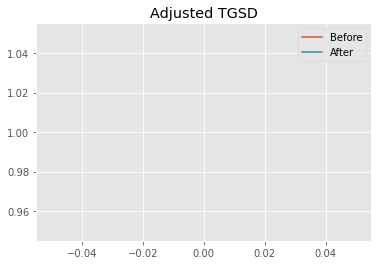

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.52001 	3.95013 	36096.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.35976 	7.55241 	40477.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.7408
New Misfit: 11.3988
Convergence:
0.029127278867792178

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.85e+02 	4.77e+02 	1.2389 		1.0000


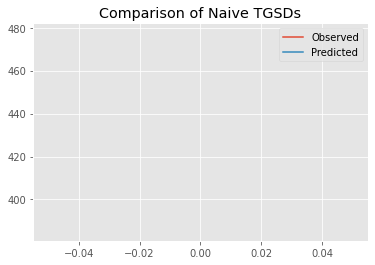

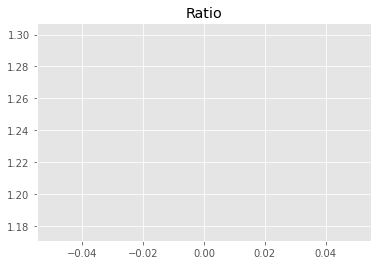

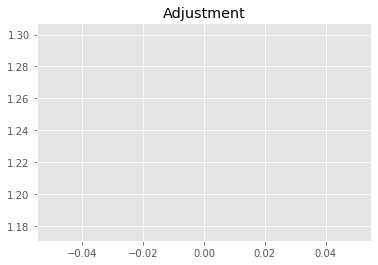

3564741167.359883
1


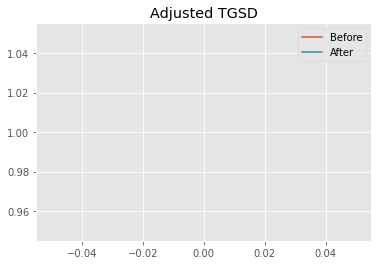

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.35976 	7.55241 	40477.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00274 	5.27326 	44099.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.3988
New Misfit: 11.211
Convergence:
0.016470721528040775

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.99e+02 	4.77e+02 	1.1955 		1.0000


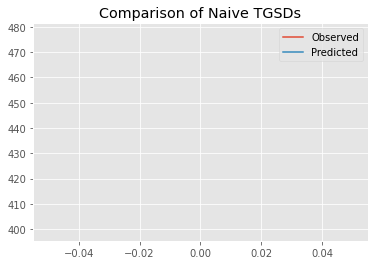

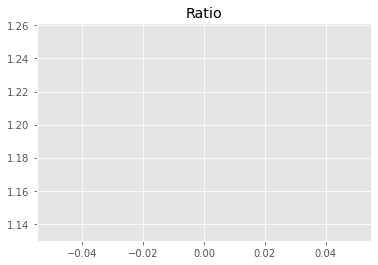

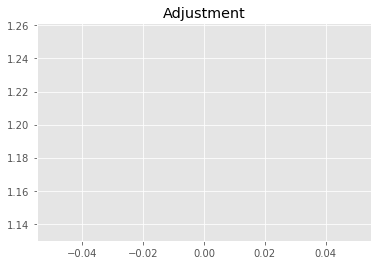

3439846001.8623567
1


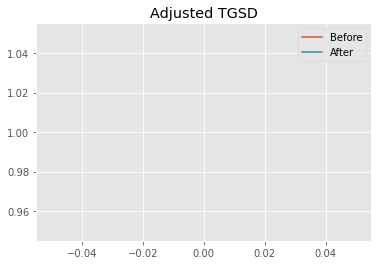

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00274 	5.27326 	44099.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00119 	5.75486 	44016.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.211
New Misfit: 11.2013
Convergence:
0.0008697832383248331

____________________
a = 1.00119	b = 5.75486	            h1 = 44016.79056	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.20129643519781
Prior Misfit: 0.0977656,	 Post Misfit: 11.2013


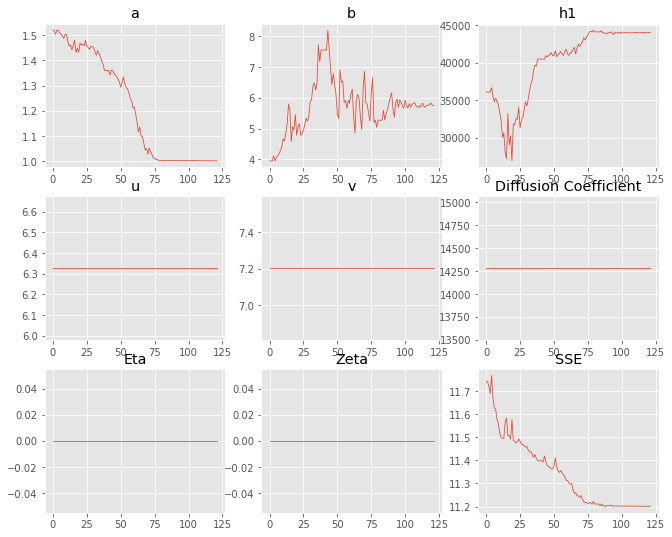

,Priors,Posteriors
a,1.52001,1.00119
b,3.95013,5.75486
h1,"36,096.4","44,016.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.066 minutes


Estimated remaining run time: 0.611 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.38e+02 	4.77e+02 	1.0892 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


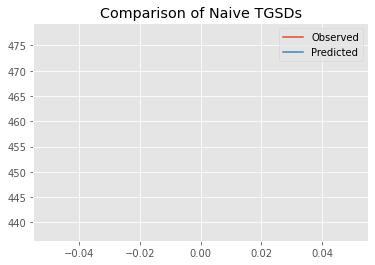

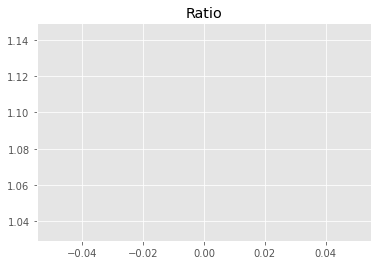

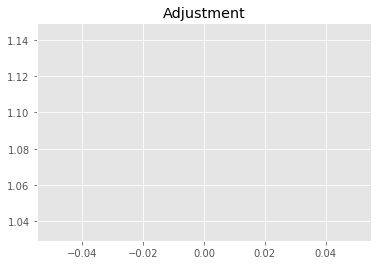

3134086406.7822275
1


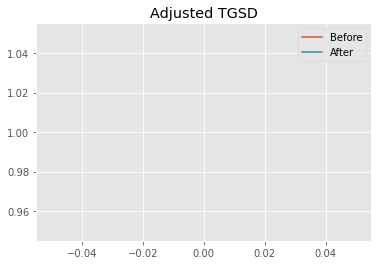

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.48948 	4.88291 	44294.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.119 	6.41965 	42689 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.7646
New Misfit: 11.2651
Convergence:
0.04245585448903134

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.89e+02 	4.77e+02 	1.2277 		1.0000


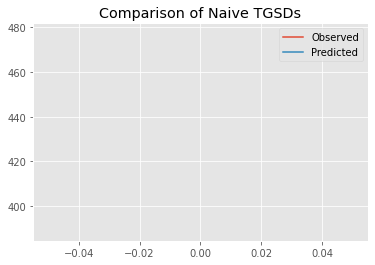

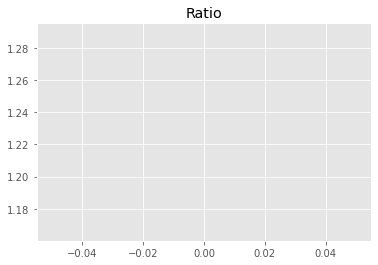

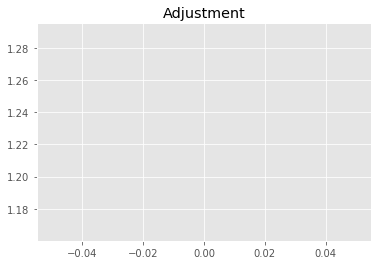

3532464172.637849
1


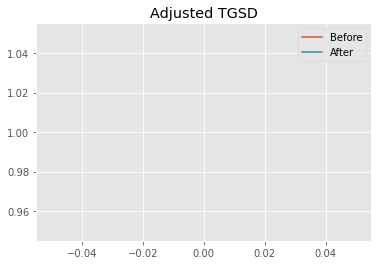

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.119 	6.41965 	42689 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00049 	5.73017 	44488.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2651
New Misfit: 11.1999
Convergence:
0.00579318060465993

____________________
a = 1.00049	b = 5.73017	            h1 = 44488.15496	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.199868393580768
Prior Misfit: 0.0979641,	 Post Misfit: 11.1999


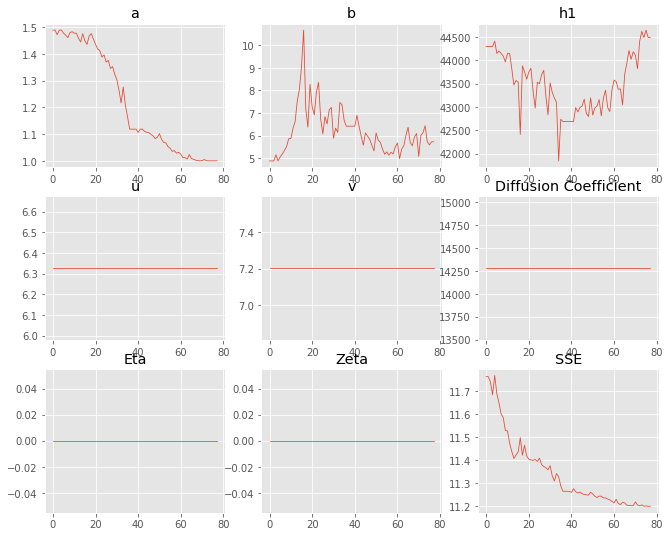

,Priors,Posteriors
a,1.48948,1.00049
b,4.88291,5.73017
h1,"44,294.9","44,488.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.050 minutes


Estimated remaining run time: 0.541 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.09e+02 	4.77e+02 	1.1665 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


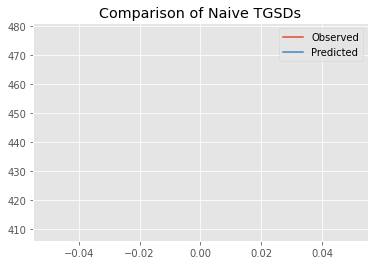

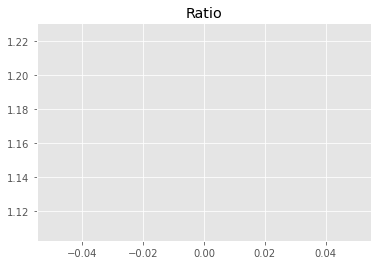

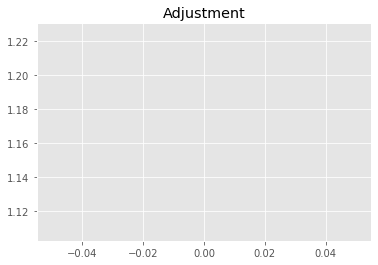

3356422980.543141
1


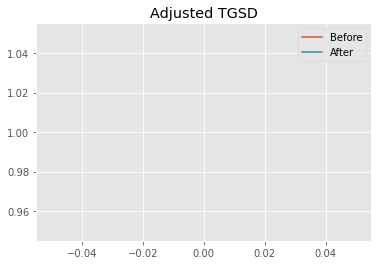

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6025 	4.72752 	22423 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00085 	5.9673 	44012.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.0336
New Misfit: 11.2019
Convergence:
0.0691147146650552

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.90e+02 	4.77e+02 	1.2256 		1.0000


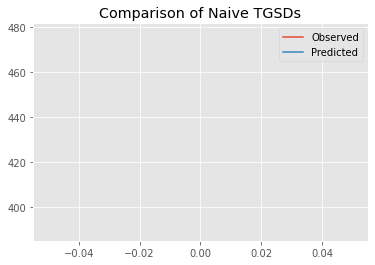

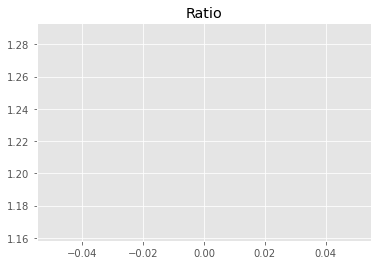

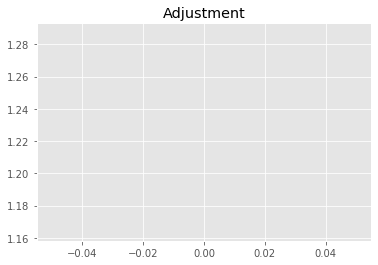

3526444041.188986
1


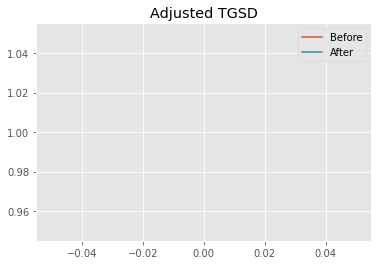

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00085 	5.9673 	44012.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.91023 	44912.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2019
New Misfit: 11.1978
Convergence:
0.00037107910247136556

____________________
a = 1.00000	b = 5.91023	            h1 = 44912.54200	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.197781567463478
Prior Misfit: 0.100204,	 Post Misfit: 11.1978


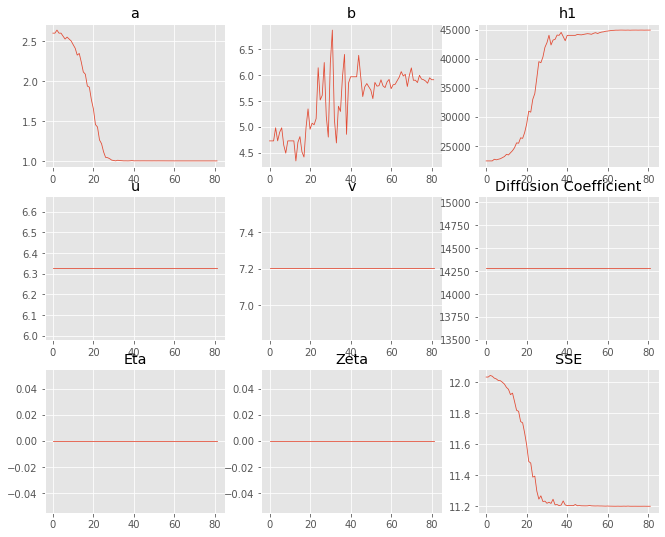

,Priors,Posteriors
a,2.6025,1
b,4.72752,5.91023
h1,"22,423","44,912.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.049 minutes


Estimated remaining run time: 0.474 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.63e+02 	4.77e+02 	1.3136 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


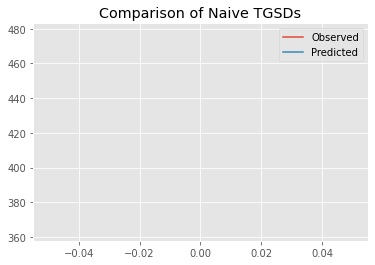

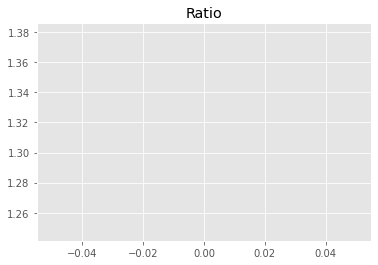

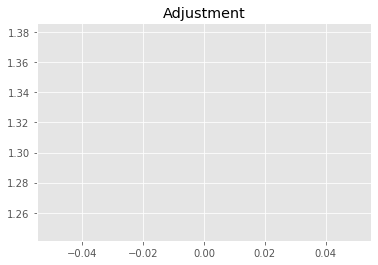

3779701215.0765038
1


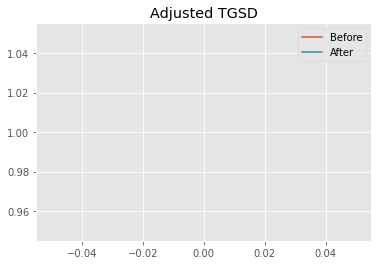

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09819 	4.54941 	25515.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.06299 	3.10735 	27373.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4602
New Misfit: 11.34
Convergence:
0.010496052974198424

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.96e+02 	4.77e+02 	1.2050 		1.0000


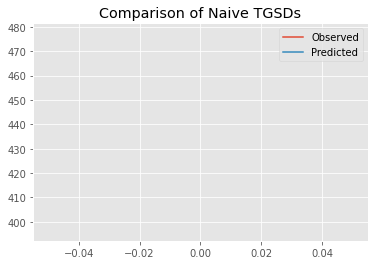

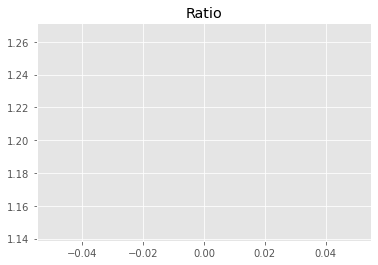

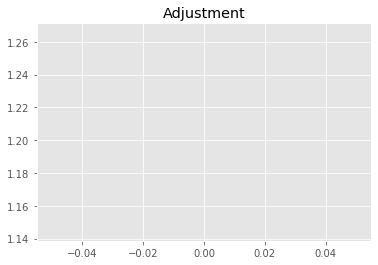

3467133236.727904
1


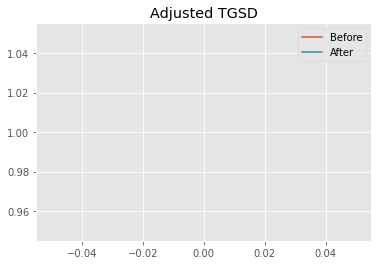

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.06299 	3.10735 	27373.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00052 	5.20044 	39907.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.34
New Misfit: 11.2168
Convergence:
0.010863657704857787

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.91e+02 	4.77e+02 	1.2213 		1.0000


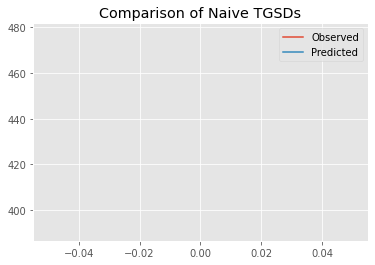

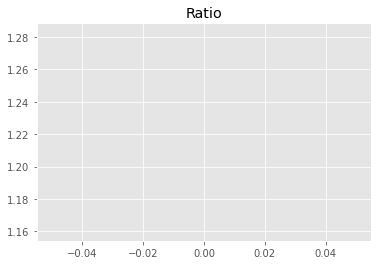

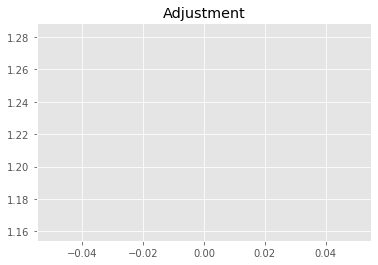

3514237202.4576483
1


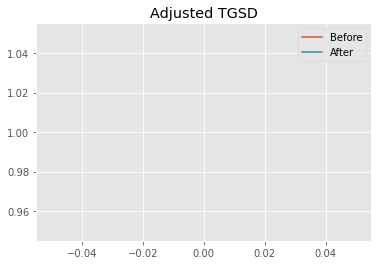

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00052 	5.20044 	39907.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00135 	5.90099 	44587.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2168
New Misfit: 11.1995
Convergence:
0.0015416207192660417

____________________
a = 1.00135	b = 5.90099	            h1 = 44587.08674	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.199465623500407
Prior Misfit: 0.0954296,	 Post Misfit: 11.1995


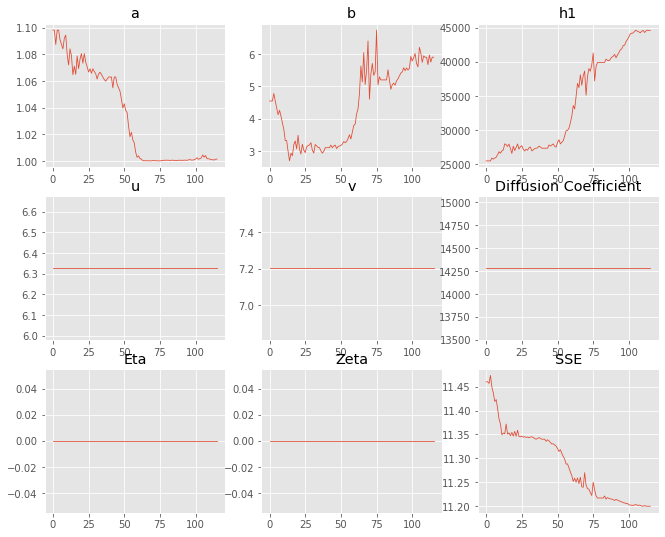

,Priors,Posteriors
a,1.09819,1.00135
b,4.54941,5.90099
h1,"25,515.2","44,587.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.065 minutes


Estimated remaining run time: 0.418 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.44e+02 	4.77e+02 	1.3896 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


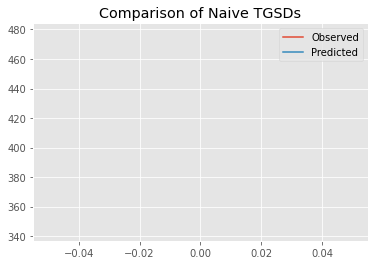

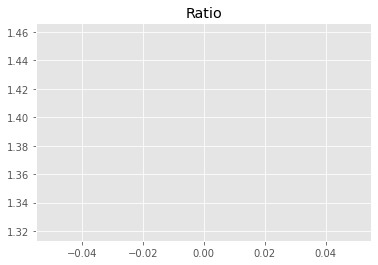

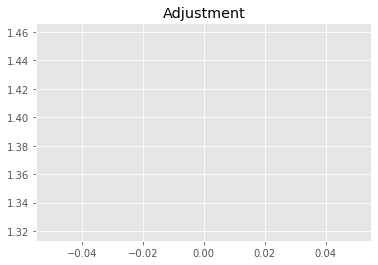

3998422178.3652453
1


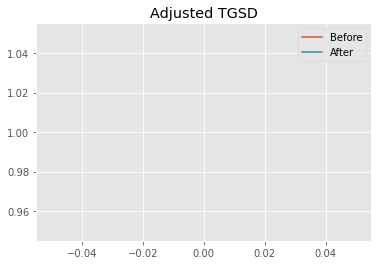

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.1091 	4.92741 	21836.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.09181 	2.83579 	25300 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5759
New Misfit: 11.3826
Convergence:
0.01669776483703018

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.96e+02 	4.77e+02 	1.2050 		1.0000


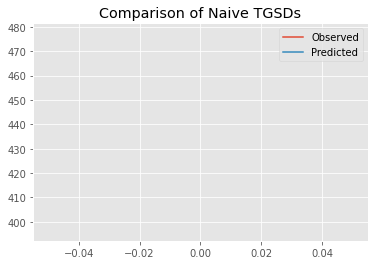

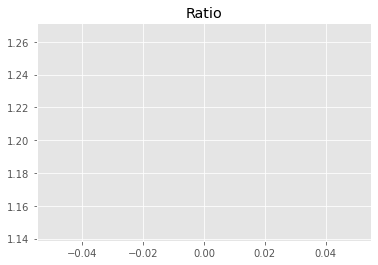

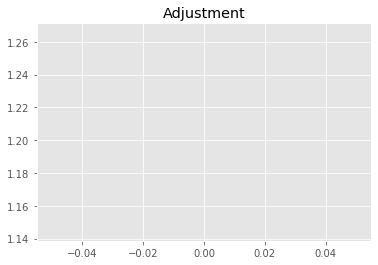

3467139369.397517
1


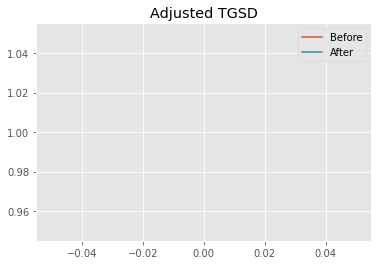

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09181 	2.83579 	25300 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.53331 	39365.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.3826
New Misfit: 11.2261
Convergence:
0.013755146314823174

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.85e+02 	4.77e+02 	1.2405 		1.0000


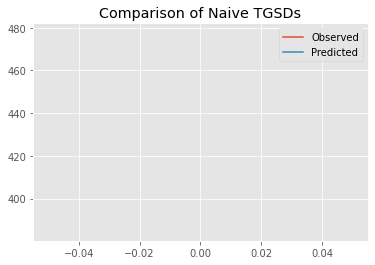

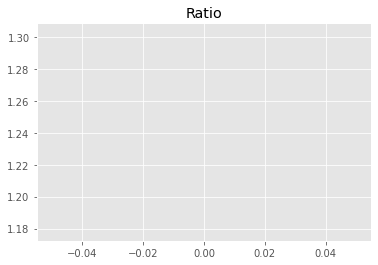

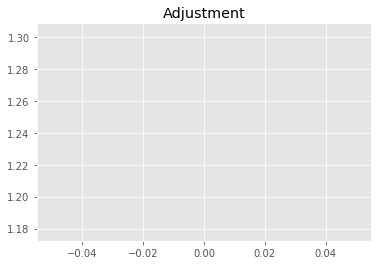

3569473635.2377543
1


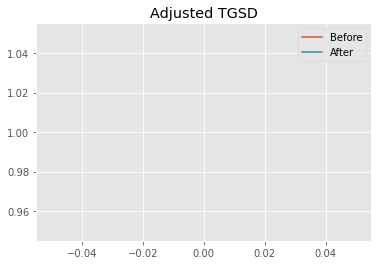

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	5.53331 	39365.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	5.99592 	44537.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2261
New Misfit: 11.1994
Convergence:
0.002375810489425771

____________________
a = 1.00000	b = 5.99592	            h1 = 44537.20272	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.19938218539159
Prior Misfit: 0.0963928,	 Post Misfit: 11.1994


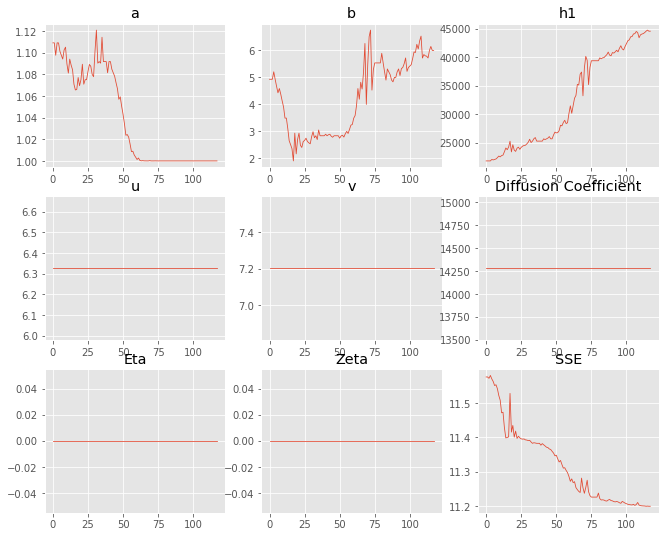

,Priors,Posteriors
a,1.1091,1
b,4.92741,5.99592
h1,"21,836.5","44,537.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.064 minutes


Estimated remaining run time: 0.360 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.71e+02 	4.77e+02 	1.7625 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


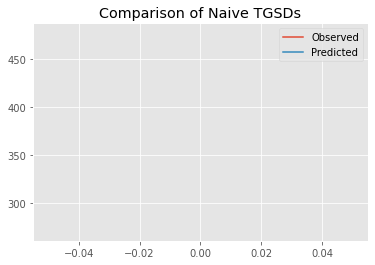

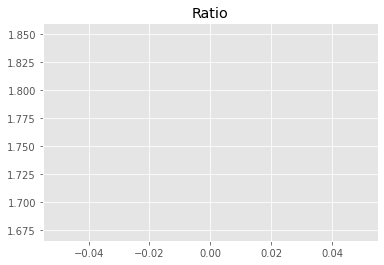

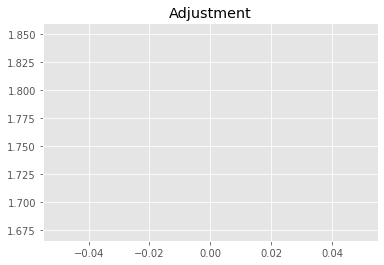

5071455016.160313
1


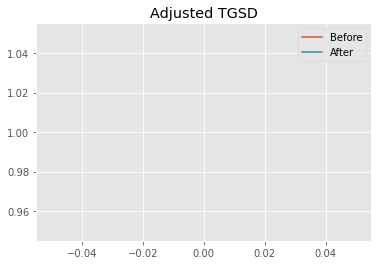

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.24559 	4.95303 	10217.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0529 	20.5136 	30030.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5326
New Misfit: 11.4673
Convergence:
0.005661796653921352

____________________
a = 1.05290	b = 20.51356	            h1 = 30030.41622	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 11.467274904985498
Prior Misfit: 0.0960319,	 Post Misfit: 11.4673


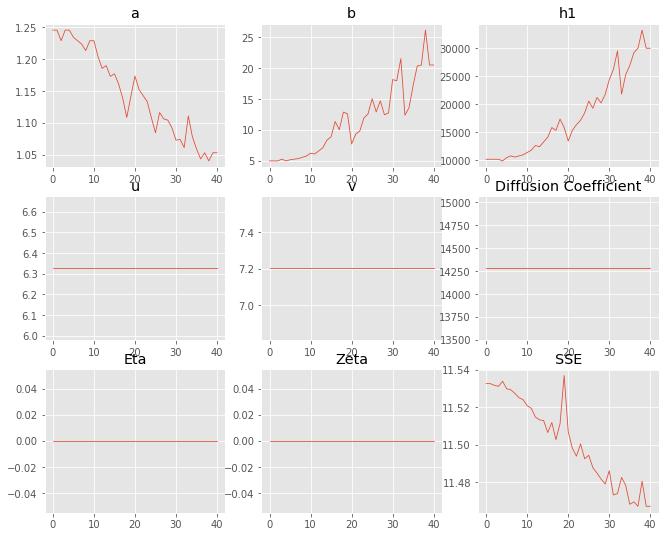

,Priors,Posteriors
a,1.24559,1.0529
b,4.95303,20.5136
h1,"10,217.2","30,030.4"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.032 minutes


Estimated remaining run time: 0.291 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.50e+02 	4.77e+02 	1.0613 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


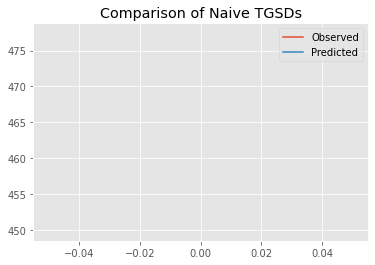

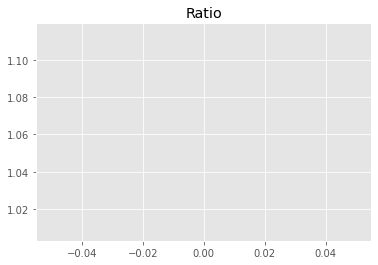

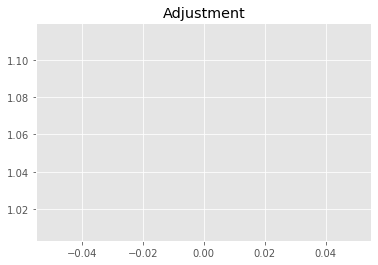

3053660997.525604
1


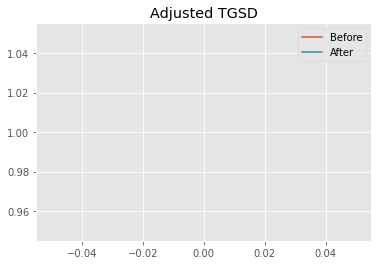

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.39508 	3.88523 	44291 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.24278 	6.58987 	43766 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.0386
New Misfit: 11.3163
Convergence:
0.059999545615159126

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.97e+02 	4.77e+02 	1.2020 		1.0000


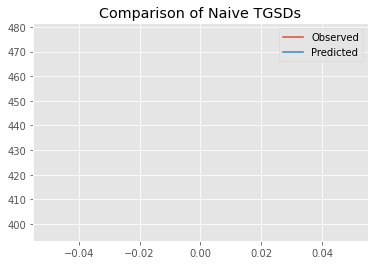

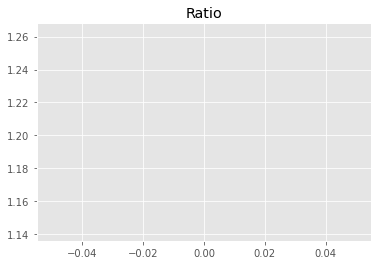

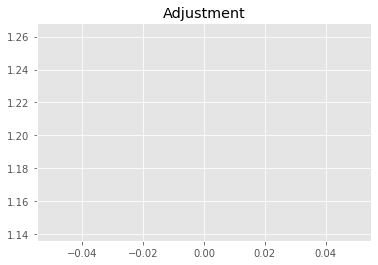

3458563522.862578
1


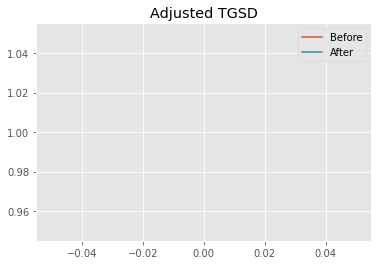

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.24278 	6.58987 	43766 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.02754 	5.03786 	39454.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.3163
New Misfit: 11.232
Convergence:
0.007453240836257639

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.94e+02 	4.77e+02 	1.2114 		1.0000


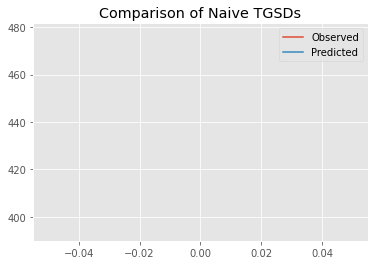

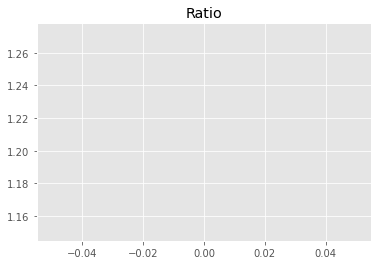

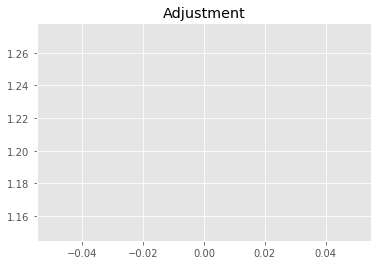

3485823042.7722726
1


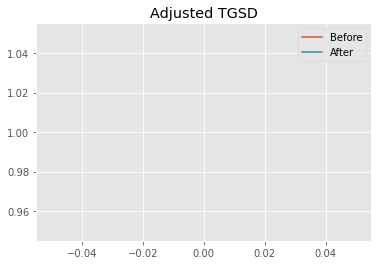

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02754 	5.03786 	39454.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00001 	5.89879 	44640 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.232
New Misfit: 11.1987
Convergence:
0.0029674180220781187

____________________
a = 1.00001	b = 5.89879	            h1 = 44639.95423	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.198652812052527
Prior Misfit: 0.100246,	 Post Misfit: 11.1987


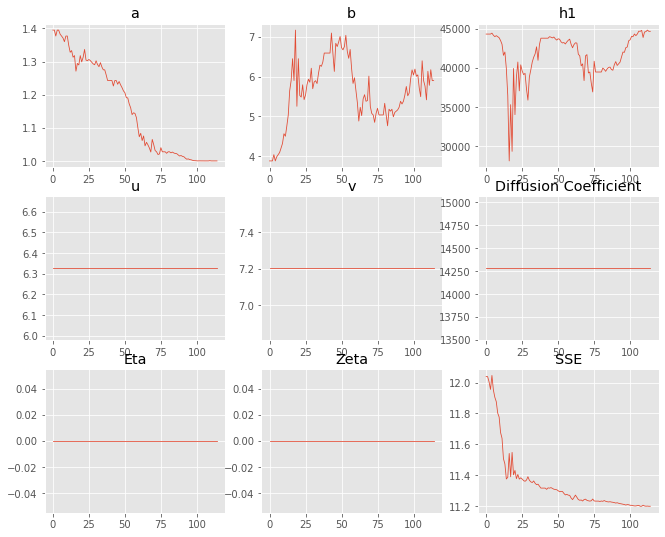

,Priors,Posteriors
a,1.39508,1.00001
b,3.88523,5.89879
h1,"44,291","44,640"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.064 minutes


Estimated remaining run time: 0.234 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.10e+02 	4.77e+02 	1.1636 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


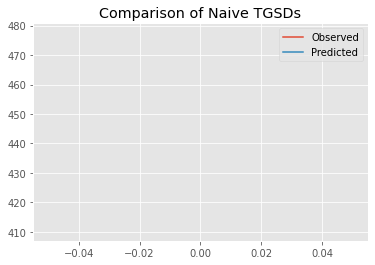

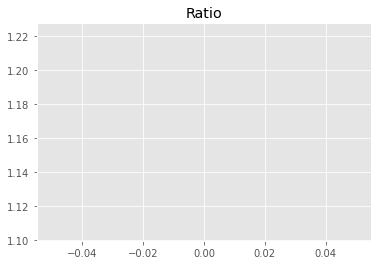

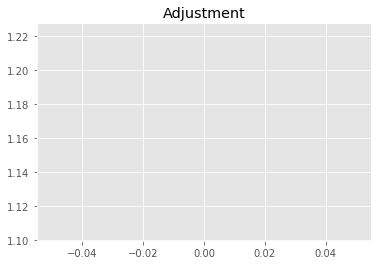

3348277590.718095
1


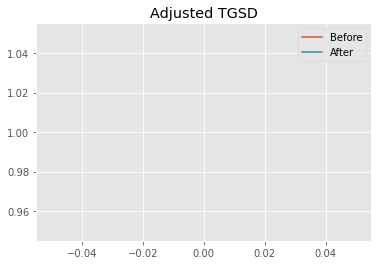

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.67688 	2.75179 	16952.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00009 	11.2117 	21344.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 12.226
New Misfit: 11.4761
Convergence:
0.06133512643581464

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.84e+02 	4.77e+02 	1.6819 		1.0000


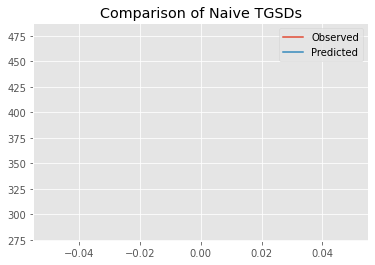

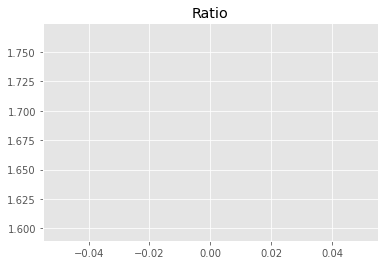

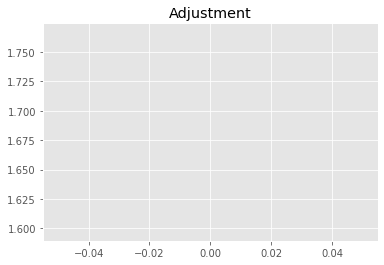

4839565460.070297
1


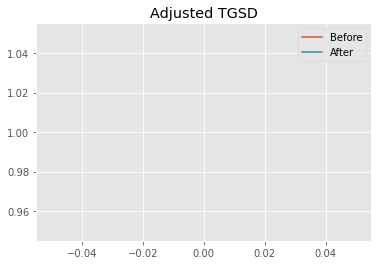

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00009 	11.2117 	21344.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.01149 	15.4585 	25805.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4761
New Misfit: 11.4663
Convergence:
0.0008608224814774659

____________________
a = 1.01149	b = 15.45850	            h1 = 25805.10034	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.466250209810593
Prior Misfit: 0.101806,	 Post Misfit: 11.4663


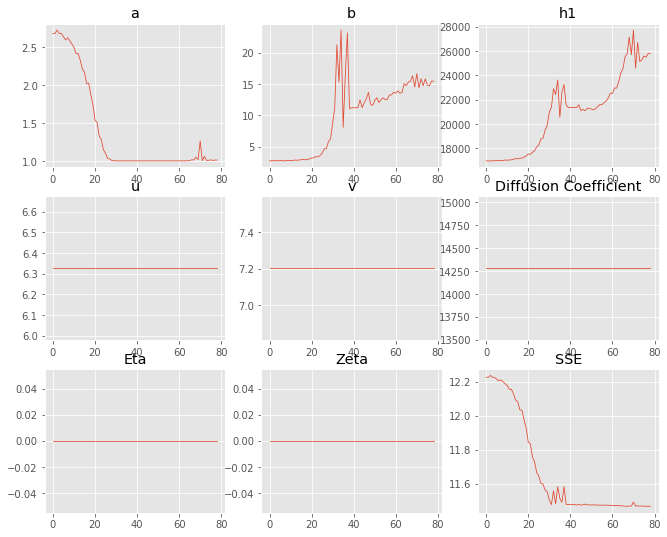

,Priors,Posteriors
a,2.67688,1.01149
b,2.75179,15.4585
h1,"16,952.3","25,805.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.049 minutes


Estimated remaining run time: 0.174 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.36e+02 	4.77e+02 	1.0938 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


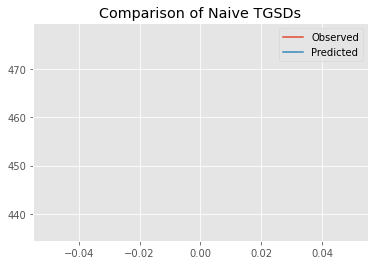

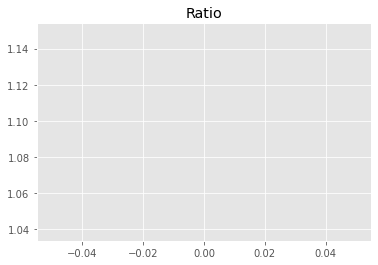

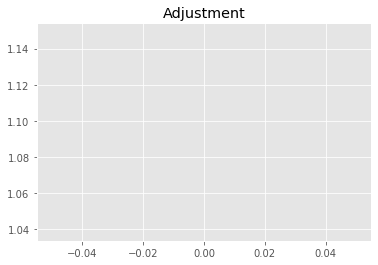

3147337222.787913
1


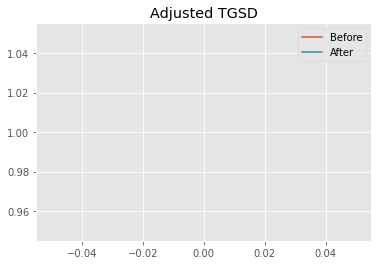

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.08223 	3.55617 	26992.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|2.03502 	6.2378 	30591.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.9633
New Misfit: 11.7278
Convergence:
0.019691513740135475

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.05e+02 	4.77e+02 	1.1797 		1.0000


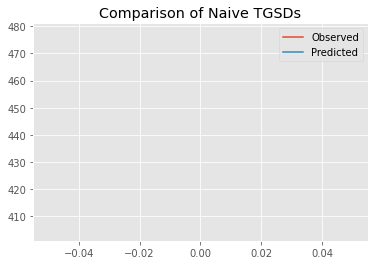

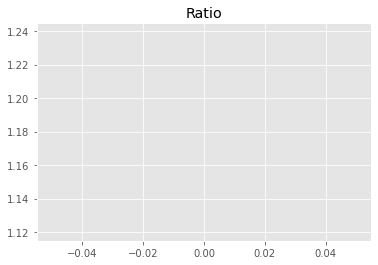

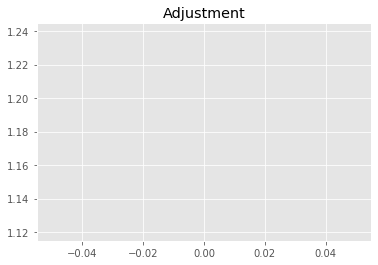

3394507766.621273
1


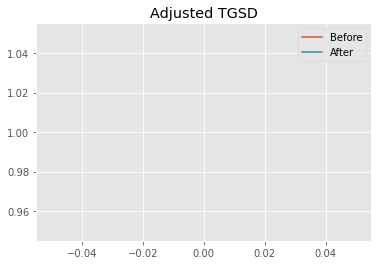

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03502 	6.2378 	30591.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.98494 	9.57432 	41586.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.7278
New Misfit: 11.6397
Convergence:
0.007504647475284966

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.01e+02 	4.77e+02 	1.1908 		1.0000


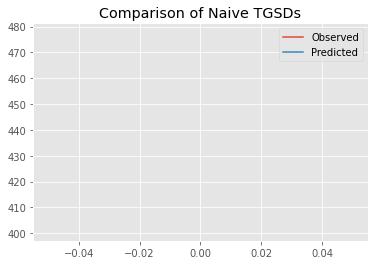

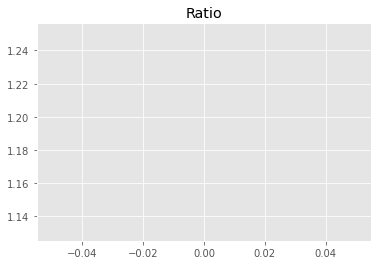

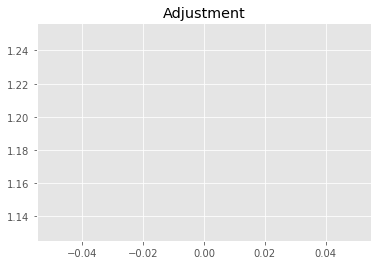

3426514247.7808957
1


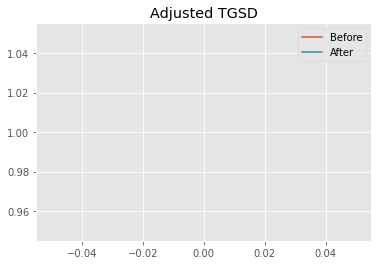

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.98494 	9.57432 	41586.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.96284 	10.3769 	44905.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.6397
New Misfit: 11.6174
Convergence:
0.001918393720719387

____________________
a = 1.96284	b = 10.37695	            h1 = 44905.34124	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 11.61741431899435
Prior Misfit: 0.0996189,	 Post Misfit: 11.6174


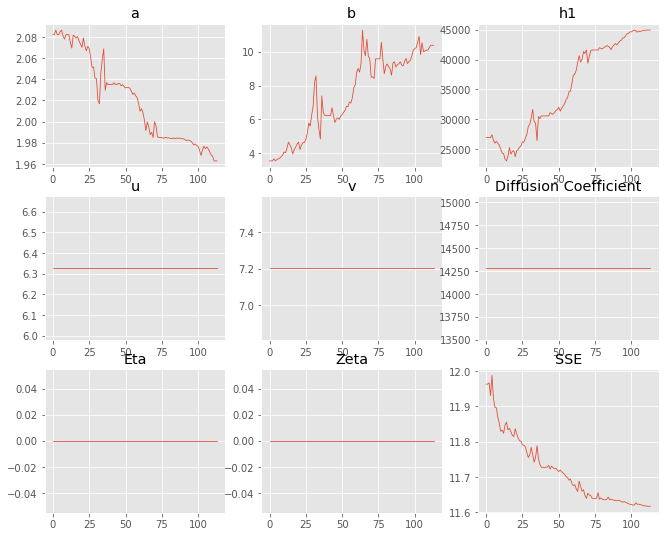

,Priors,Posteriors
a,2.08223,1.96284
b,3.55617,10.3769
h1,"26,992.1","44,905.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.064 minutes


Estimated remaining run time: 0.117 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.91e+02 	4.77e+02 	1.6389 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


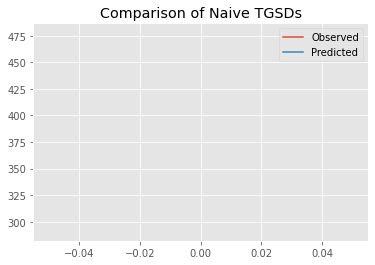

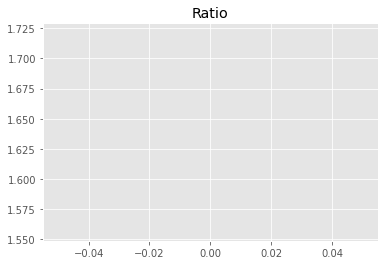

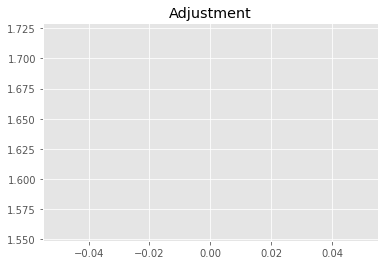

4715859771.360438
1


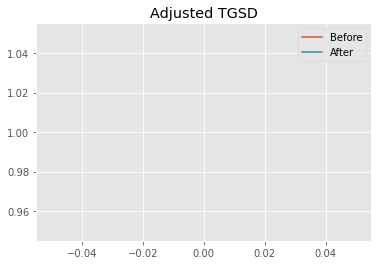

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02052 	3.27512 	10399.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.06228 	4.73583 	10363.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.6016
New Misfit: 11.5252
Convergence:
0.00658374072772652

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.71e+02 	4.77e+02 	1.7634 		1.0000


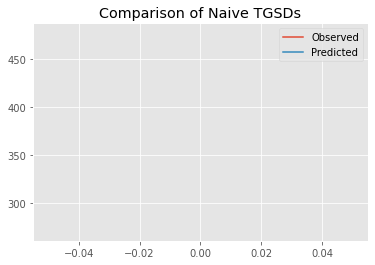

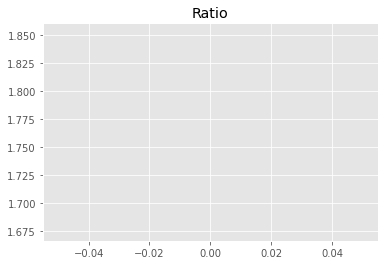

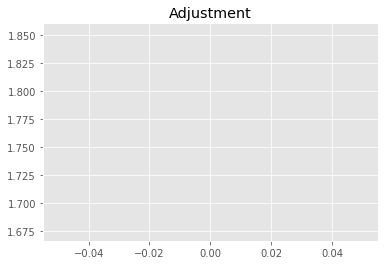

5073883828.29968
1


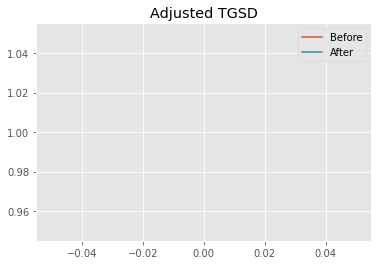

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.06228 	4.73583 	10363.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.0023 	18.9 	33625.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5252
New Misfit: 11.4572
Convergence:
0.005899169884607281

____________________
a = 1.00230	b = 18.90001	            h1 = 33625.22763	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.457216642949058
Prior Misfit: 0.0966066,	 Post Misfit: 11.4572


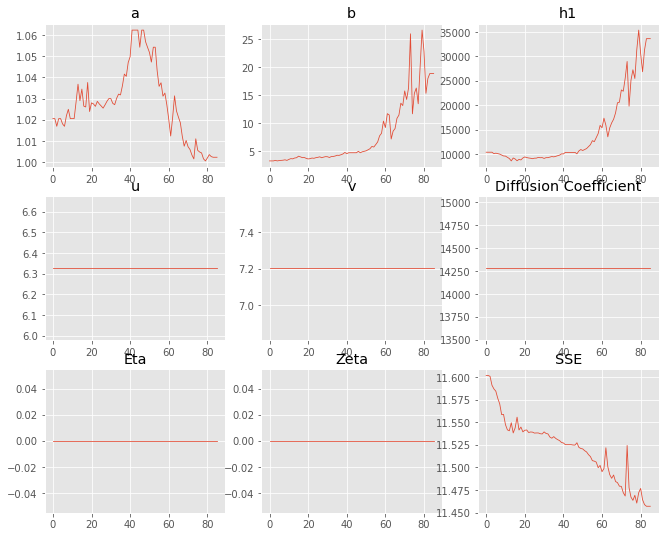

,Priors,Posteriors
a,1.02052,1.0023
b,3.27512,18.9
h1,"10,399.6","33,625.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.051 minutes


Estimated remaining run time: 0.058 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.41e+02 	4.77e+02 	1.4014 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


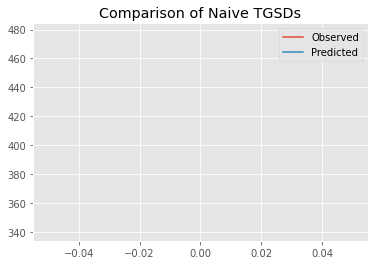

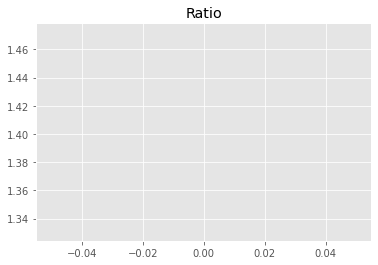

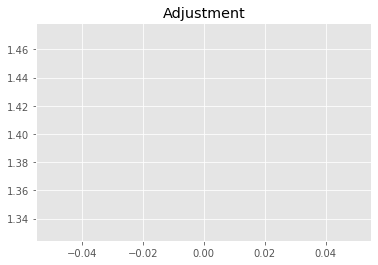

4032309051.1539836
1


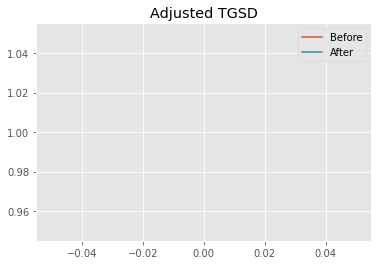

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.64254 	4.15769 	15276.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.59934 	12.0727 	16247.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.9198
New Misfit: 11.5123
Convergence:
0.034185970151784525

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	2.72e+02 	4.77e+02 	1.7581 		1.0000


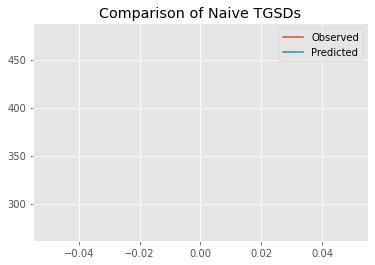

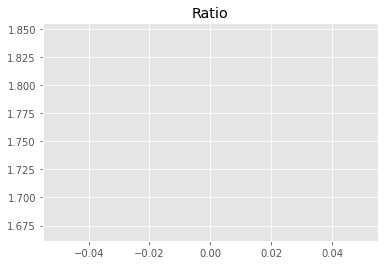

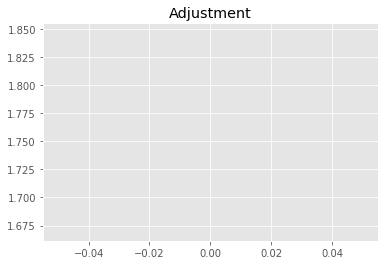

5058817820.629161
1


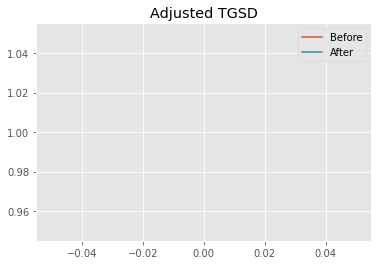

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.59934 	12.0727 	16247.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.07668 	9.79608 	16681.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.5123
New Misfit: 11.4899
Convergence:
0.0019402488872068322

____________________
a = 1.07668	b = 9.79608	            h1 = 16681.55751	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 11.489940250781284
Prior Misfit: 0.0992561,	 Post Misfit: 11.4899


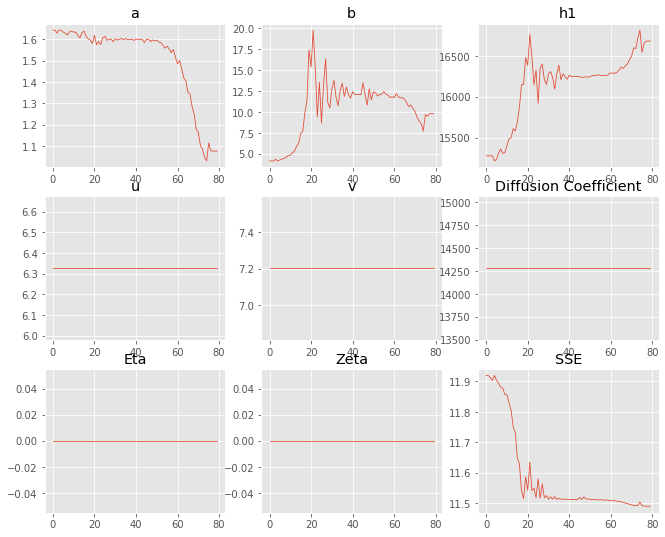

,Priors,Posteriors
a,1.64254,1.07668
b,4.15769,9.79608
h1,"15,276.2","16,681.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.050 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.97e+02 	4.77e+02 	1.2017 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


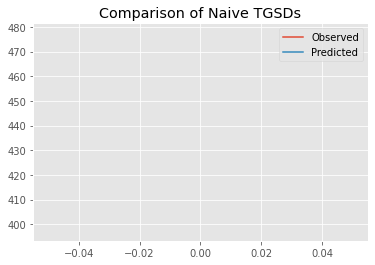

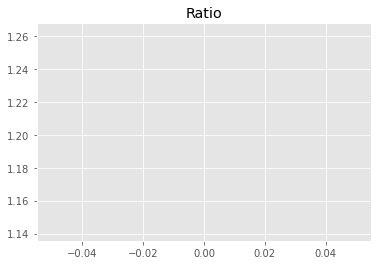

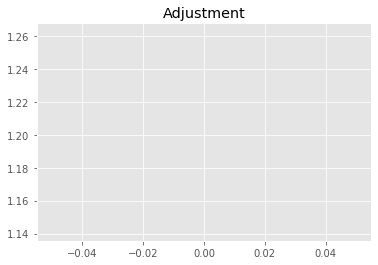

3457715226.5811567
1


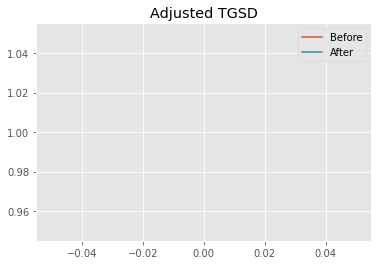

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.42822 	2.85712 	21900.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.02779 	2.21982 	21980.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.6093
New Misfit: 11.4138
Convergence:
0.016844575391236755

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.94e+02 	4.77e+02 	1.2109 		1.0000


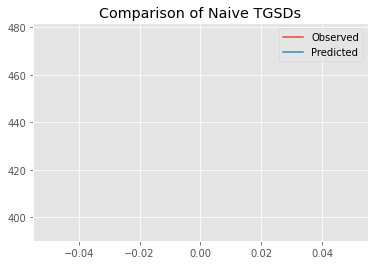

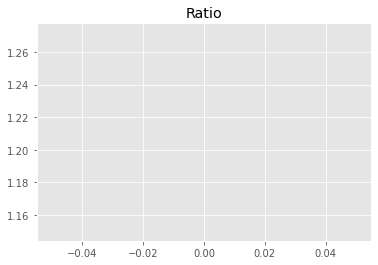

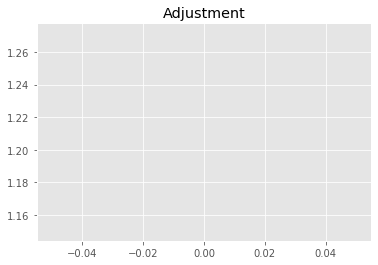

3484118813.2489004
1


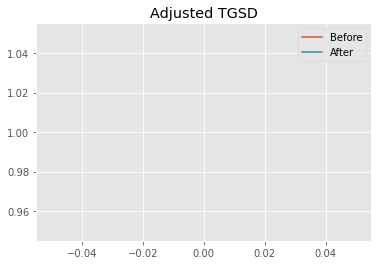

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02779 	2.21982 	21980.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1 	3.22625 	27986.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.4138
New Misfit: 11.3002
Convergence:
0.009952180609319254

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.92e+02 	4.77e+02 	1.2185 		1.0000


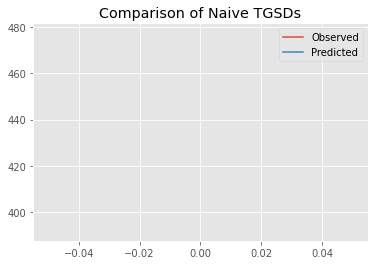

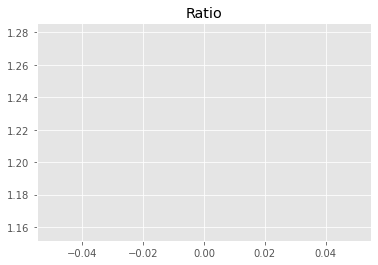

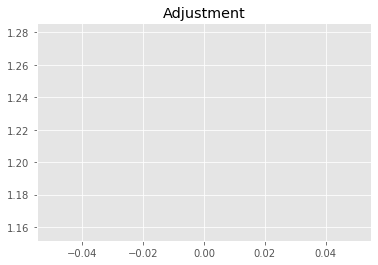

3506173458.142938
1


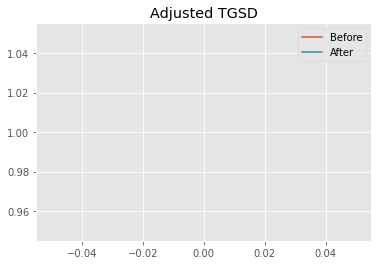

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	3.22625 	27986.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00228 	4.65187 	38814.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.3002
New Misfit: 11.2259
Convergence:
0.0065768222273566365

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	3.97e+02 	4.77e+02 	1.2029 		1.0000


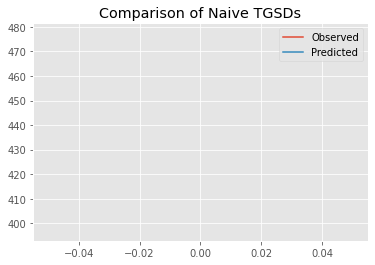

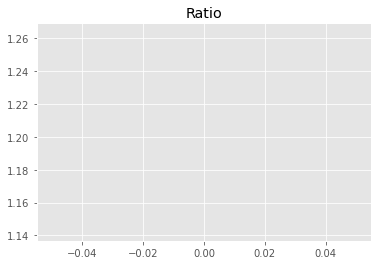

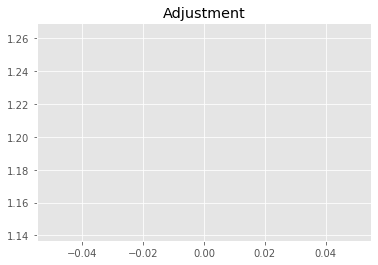

3461221188.558631
1


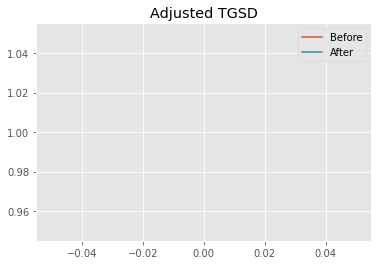

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00228 	4.65187 	38814.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 2.8774e+09
After: 		|1.00119 	5.64419 	43810.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 11.2259
New Misfit: 11.2023
Convergence:
0.0020974749860820908

____________________
a = 1.00119	b = 5.64419	            h1 = 43810.48199	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 11.202320262284154
Prior Misfit: 0.0966711,	 Post Misfit: 11.2023


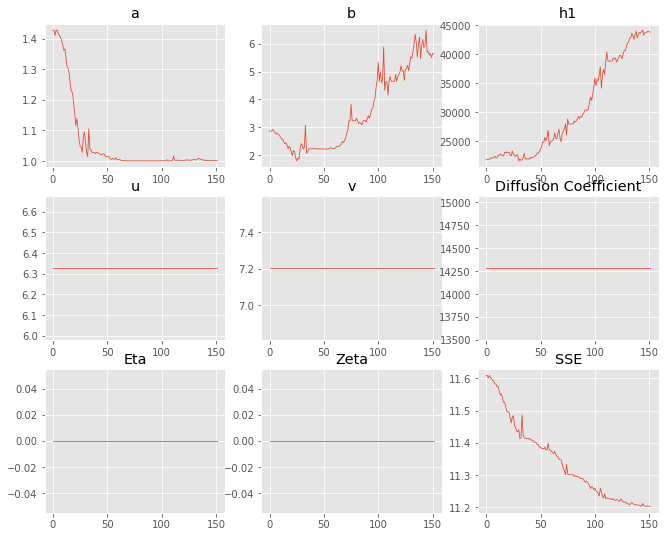

,Priors,Posteriors
a,1.42822,1.00119
b,2.85712,5.64419
h1,"21,900.4","43,810.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.081 minutes


Estimated remaining run time: -0.059 minutes


Total Run Time: 1.23033 minutes


[{'a': 1.0002438378158172,
  'b': 5.97929044058647,
  'h1': 44566.25233248591,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0003409665166427,
  'b': 5.875899285588845,
  'h1': 44779.04214415991,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.112487373540754,
  'b': 15.334904127427016,
  'h1': 25305.346951013937,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000073659636068,
  'b': 5.514559440582128,
  'h1': 42486.83314745307,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.9340788731187963,
  'b': 9.704864813917203,
  'h1': 44306.49402753032,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0,
  '

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
6,1,5.93652,"44,910.5",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932441
10,1,5.91023,"44,912.5",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932441
1,1.00034,5.8759,"44,779",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932492
14,1.00001,5.89879,"44,640",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932514
0,1.00024,5.97929,"44,566.3",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932565
12,1,5.99592,"44,537.2",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932574
11,1.00135,5.90099,"44,587.1",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932581
9,1.00049,5.73017,"44,488.2",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932615
8,1.00119,5.75486,"44,016.8",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932734
19,1.00119,5.64419,"43,810.5",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932819


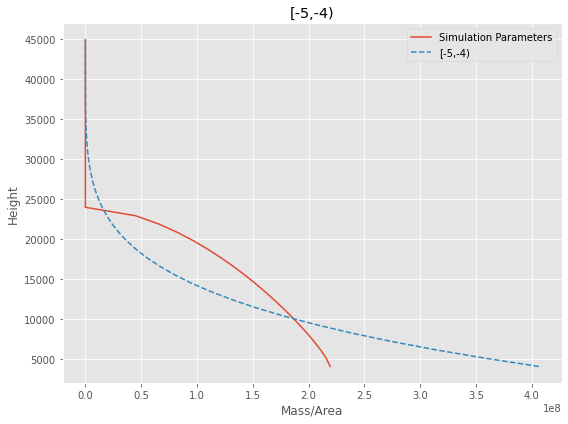

[-5,-4) Run Time: 1.23309 minutes


Mass Test: 2877403722.5197015
========[-4,-3)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8907 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


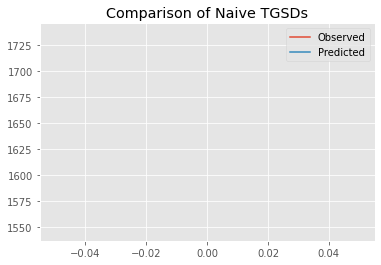

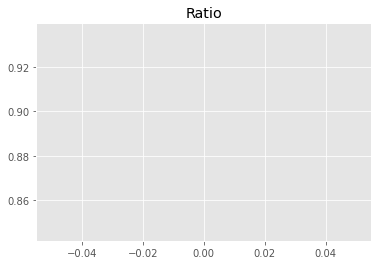

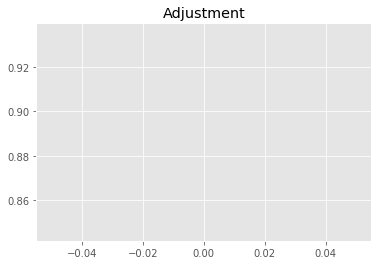

8301140055.434717
1


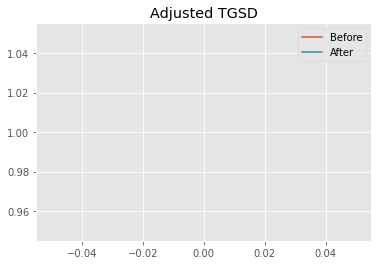

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97711 	1.85477 	27820 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.97044 	1.84231 	23234 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.2111
New Misfit: 22.1252
Convergence:
0.04678300098171228

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.69e+03 	1.55e+03 	0.9162 		1.0000


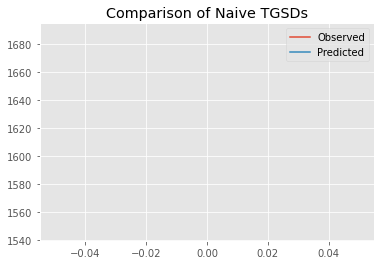

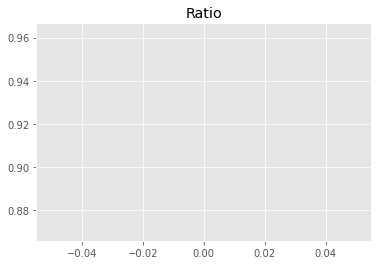

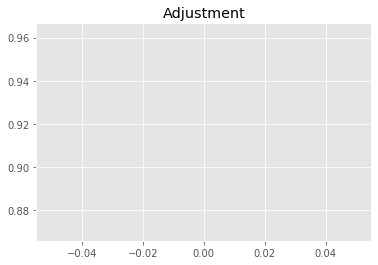

8538751642.42366
1


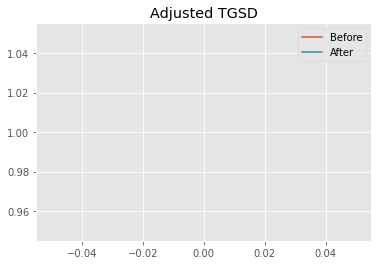

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97044 	1.84231 	23234 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.88705 	2.97915 	29990.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.1252
New Misfit: 21.769
Convergence:
0.01609797619735189

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9311 		1.0000


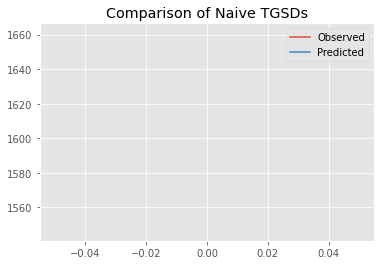

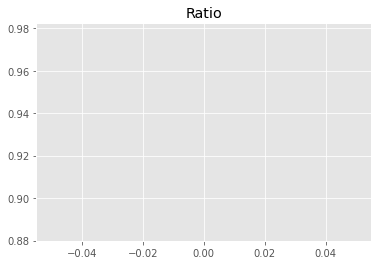

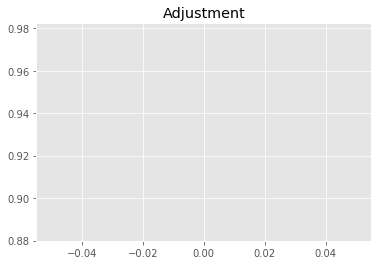

8677525122.046055
1


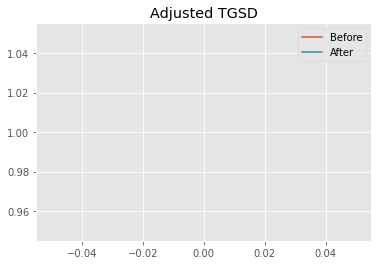

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88705 	2.97915 	29990.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.80512 	3.65876 	36025.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.769
New Misfit: 21.5329
Convergence:
0.010847946282700057

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9333 		1.0000


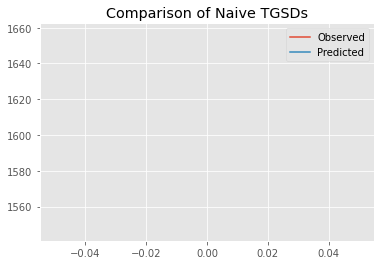

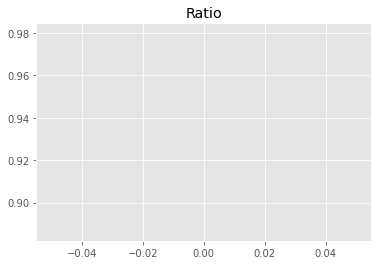

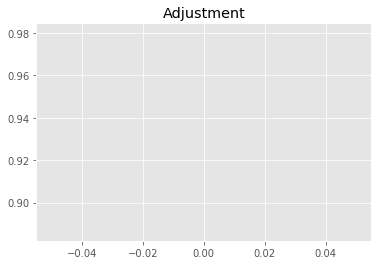

8697879829.204489
1


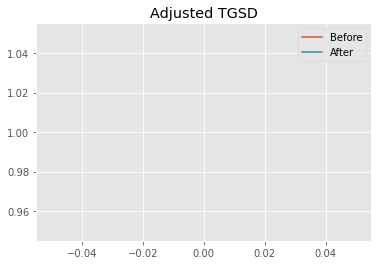

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80512 	3.65876 	36025.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.54725 	4.15928 	43653.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.5329
New Misfit: 21.2457
Convergence:
0.013335802971846616

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9459 		1.0000


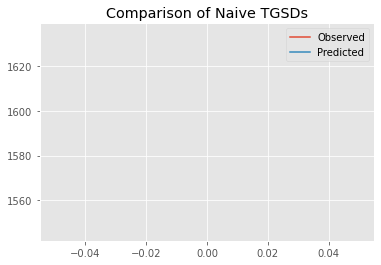

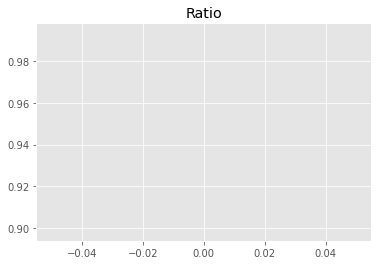

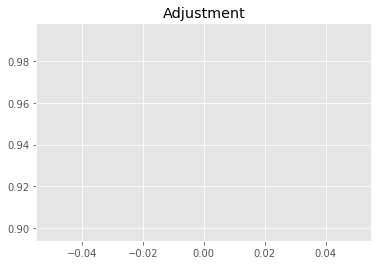

8816007440.74727
1


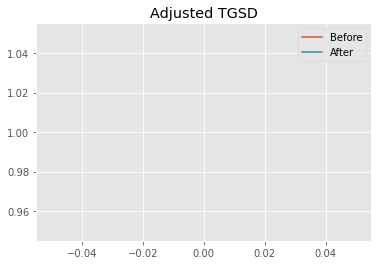

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54725 	4.15928 	43653.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.07664 	2.09358 	37394 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.2457
New Misfit: 20.8434
Convergence:
0.01893680881521473

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9476 		1.0000


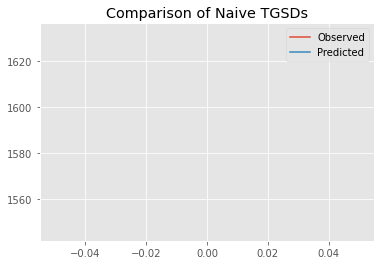

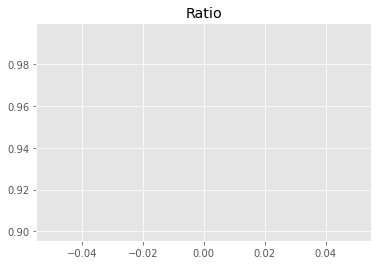

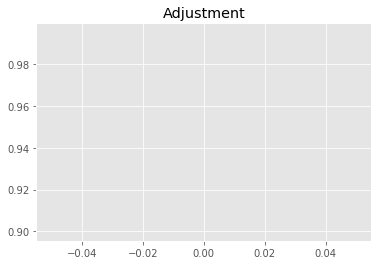

8831368146.920506
1


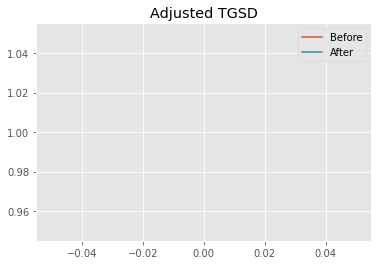

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.07664 	2.09358 	37394 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00519 	2.03908 	38380.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8434
New Misfit: 20.756
Convergence:
0.0041935461079194505

____________________
a = 1.00519	b = 2.03908	            h1 = 38380.34226	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 20.755969956340085
Prior Misfit: 0.122007,	 Post Misfit: 20.756


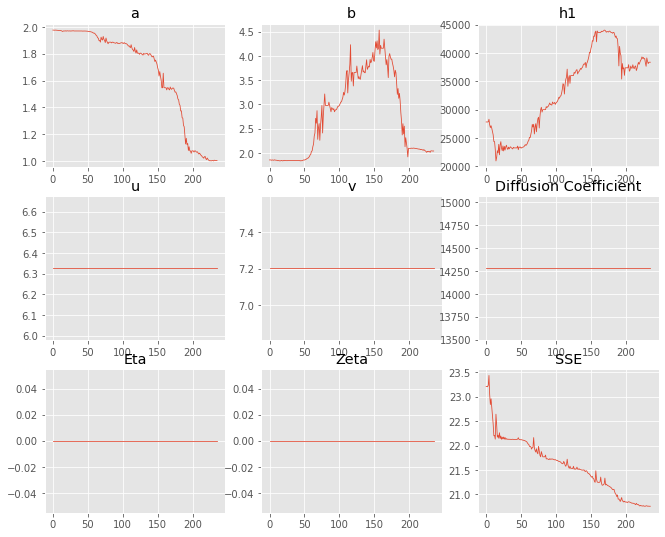

,Priors,Posteriors
a,1.97711,1.00519
b,1.85477,2.03908
h1,"27,820","38,380.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.121 minutes


Estimated remaining run time: 1.085 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8941 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


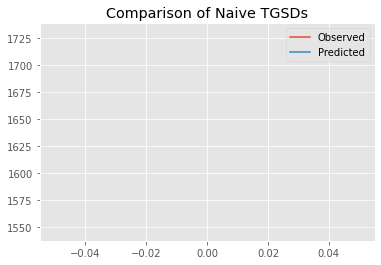

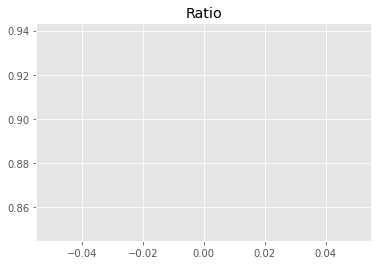

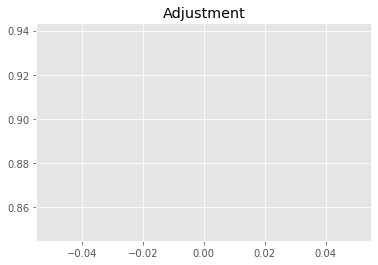

8332662671.786852
1


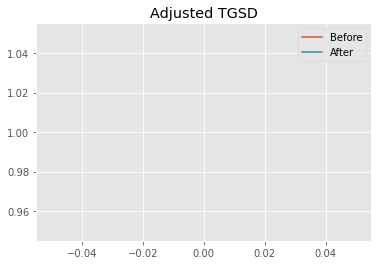

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.79834 	3.3024 	28369 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.0803 	2.28182 	41860.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.944
New Misfit: 20.8772
Convergence:
0.0900803653285065

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9469 		1.0000


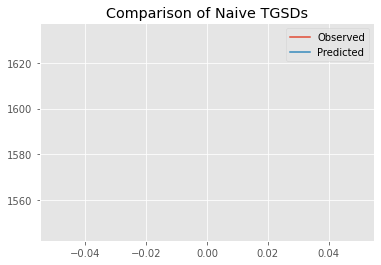

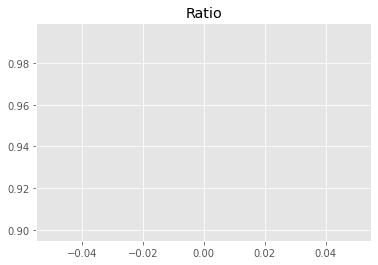

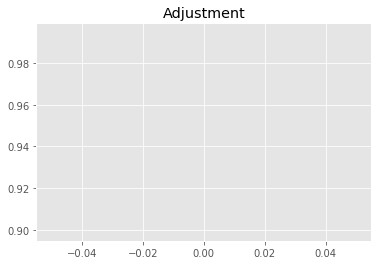

8824888159.859829
1


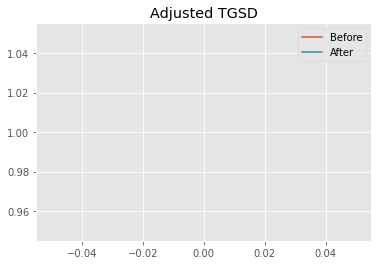

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0803 	2.28182 	41860.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00975 	2.19402 	41020.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8772
New Misfit: 20.7368
Convergence:
0.006727046867902256

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9530 		1.0000


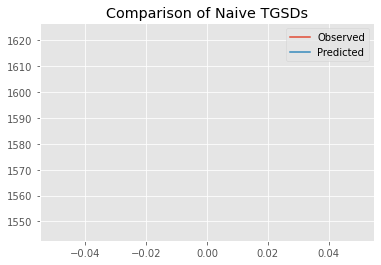

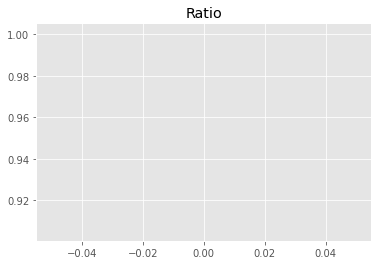

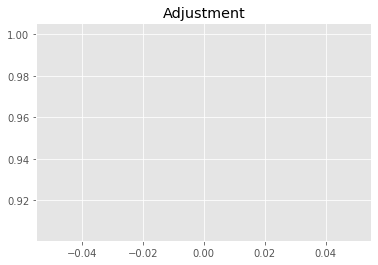

8881290800.951479
1


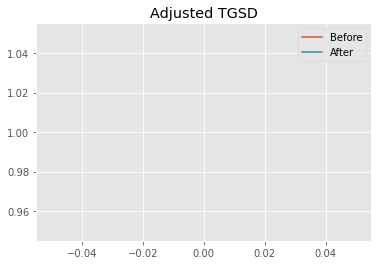

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00975 	2.19402 	41020.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00007 	2.49666 	44169.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7368
New Misfit: 20.6895
Convergence:
0.0022818198404269477

____________________
a = 1.00007	b = 2.49666	            h1 = 44169.64697	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.68946667789981
Prior Misfit: 0.120604,	 Post Misfit: 20.6895


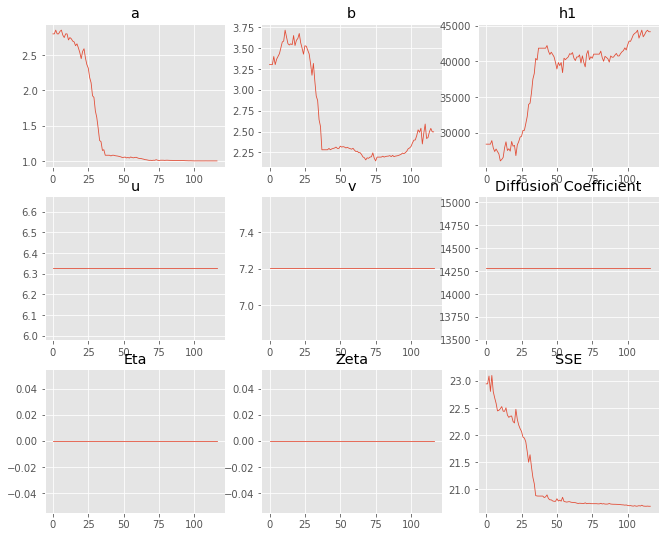

,Priors,Posteriors
a,2.79834,1.00007
b,3.3024,2.49666
h1,"28,369","44,169.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.066 minutes


Estimated remaining run time: 1.055 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.60e+03 	1.55e+03 	0.9653 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


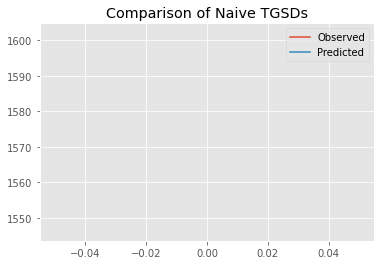

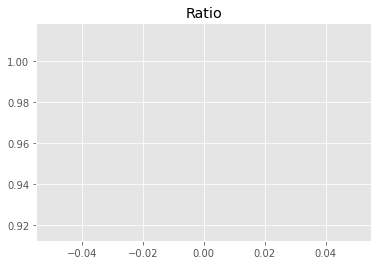

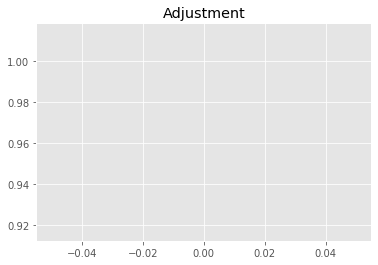

8996009194.524899
1


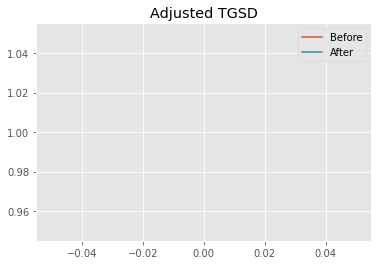

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.15562 	3.1091 	23793.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.03027 	2.77695 	27633.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.7253
New Misfit: 21.9435
Convergence:
0.07509901475185228

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.67e+03 	1.55e+03 	0.9259 		1.0000


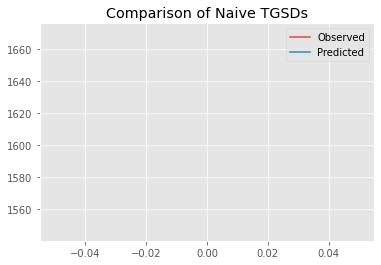

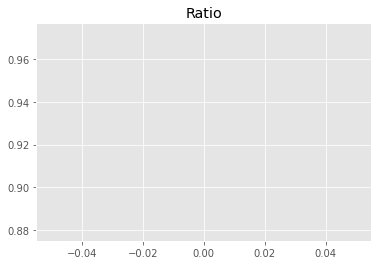

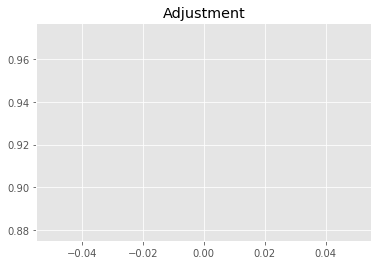

8629007701.781082
1


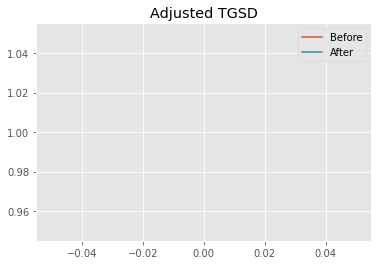

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03027 	2.77695 	27633.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.9738 	4.30789 	36850.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.9435
New Misfit: 21.6838
Convergence:
0.011834800909758641

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9346 		1.0000


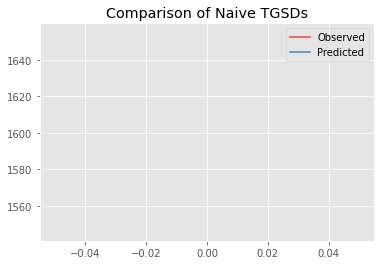

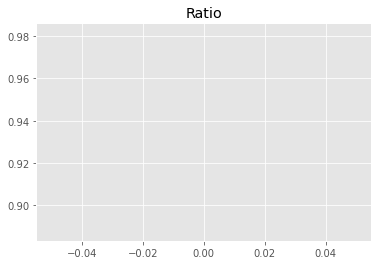

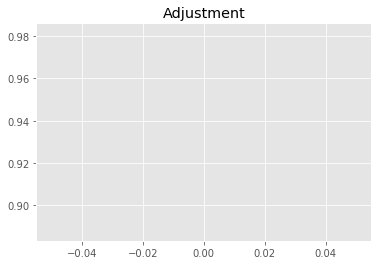

8710592657.987867
1


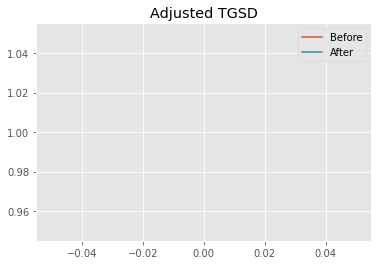

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.9738 	4.30789 	36850.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.99036 	4.90084 	41698.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.6838
New Misfit: 21.5858
Convergence:
0.00451990825269361

____________________
a = 1.99036	b = 4.90084	            h1 = 41698.28167	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 21.58581135878188
Prior Misfit: 0.12471,	 Post Misfit: 21.5858


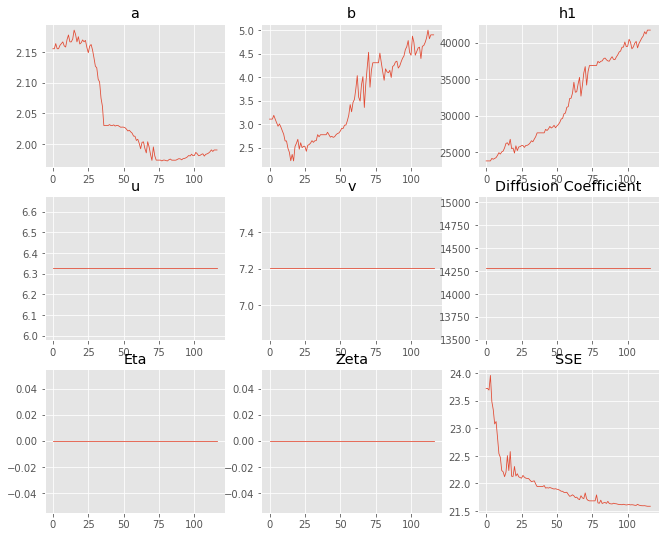

,Priors,Posteriors
a,2.15562,1.99036
b,3.1091,4.90084
h1,"23,793.7","41,698.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.066 minutes


Estimated remaining run time: 1.010 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8938 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


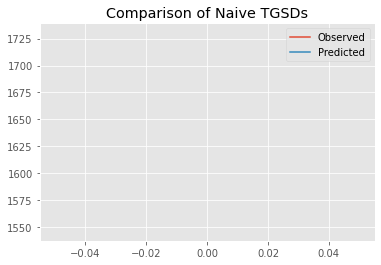

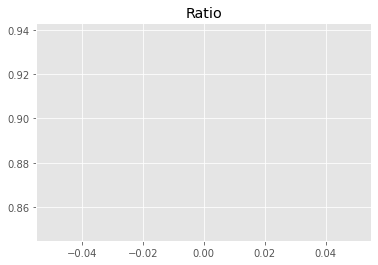

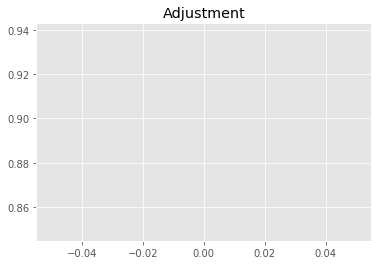

8330466222.135412
1


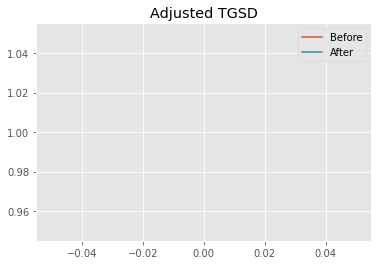

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33006 	2.01253 	24569.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.34424 	2.00007 	29685.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.8485
New Misfit: 21.2957
Convergence:
0.06796082891662071

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9378 		1.0000


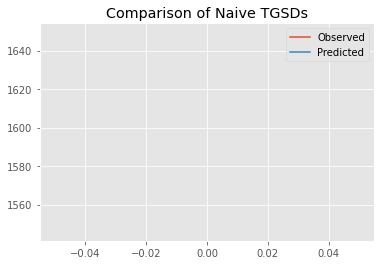

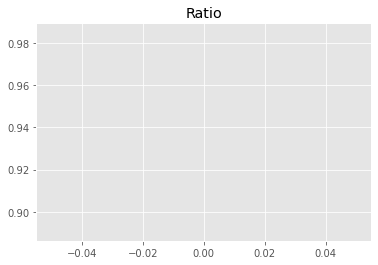

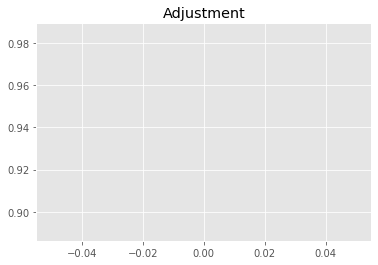

8739863522.375572
1


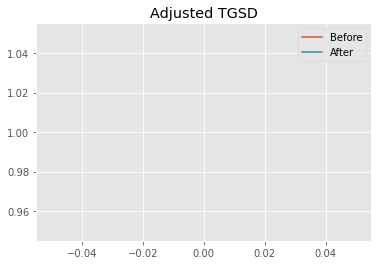

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.34424 	2.00007 	29685.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.02379 	1.99998 	37099.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.2957
New Misfit: 20.7916
Convergence:
0.023672173140557178

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9505 		1.0000


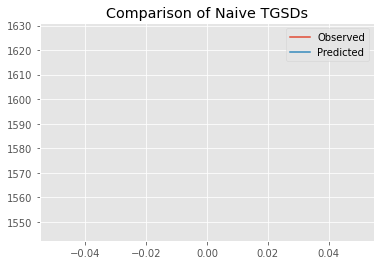

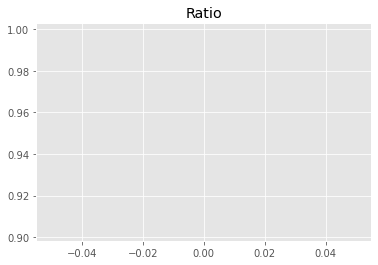

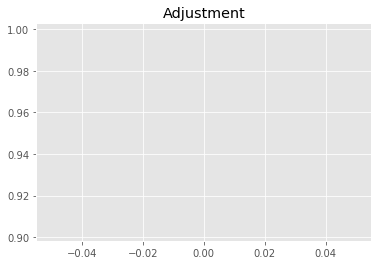

8858610598.137756
1


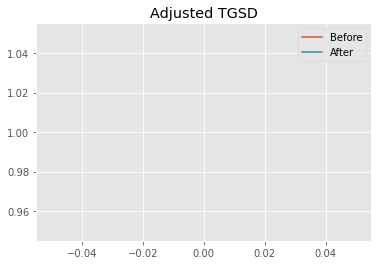

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02379 	1.99998 	37099.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00002 	2.00002 	38246.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7916
New Misfit: 20.7555
Convergence:
0.0017334541209471518

____________________
a = 1.00002	b = 2.00002	            h1 = 38246.88037	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.755526853770856
Prior Misfit: 0.120101,	 Post Misfit: 20.7555


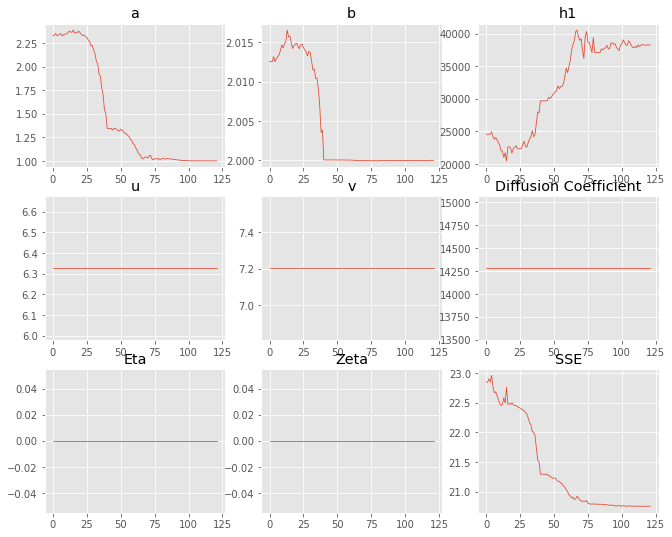

,Priors,Posteriors
a,2.33006,1.00002
b,2.01253,2.00002
h1,"24,569.2","38,246.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.066 minutes


Estimated remaining run time: 0.956 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.71e+03 	1.55e+03 	0.9062 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


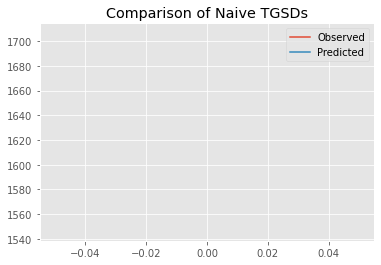

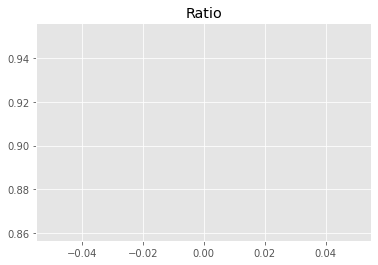

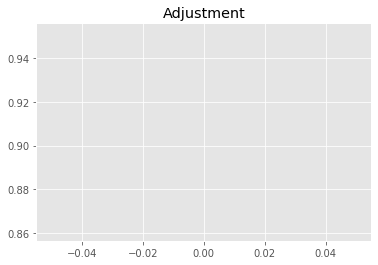

8445597257.455087
1


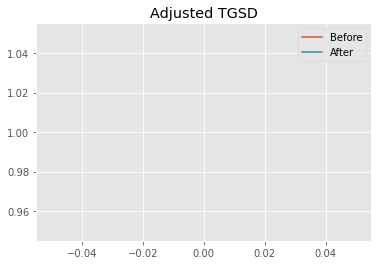

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.12791 	4.44208 	43751.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.0213 	5.64619 	44820.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.6144
New Misfit: 21.5791
Convergence:
0.04578080181090709

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9337 		1.0000


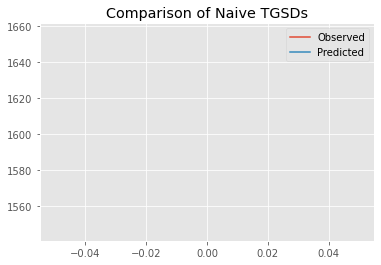

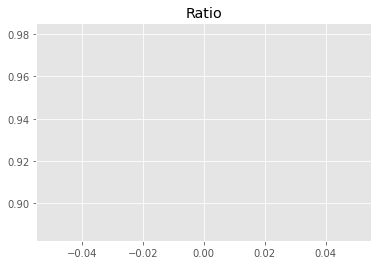

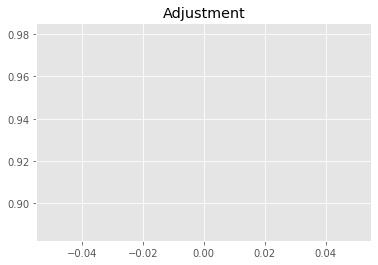

8701963122.638788
1


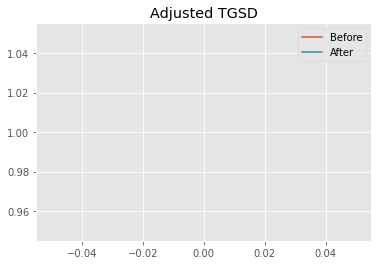

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0213 	5.64619 	44820.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.97151 	5.48847 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.5791
New Misfit: 21.5384
Convergence:
0.0018845448305468452

____________________
a = 1.97151	b = 5.48847	            h1 = 44914.99930	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.538412497526004
Prior Misfit: 0.118871,	 Post Misfit: 21.5384


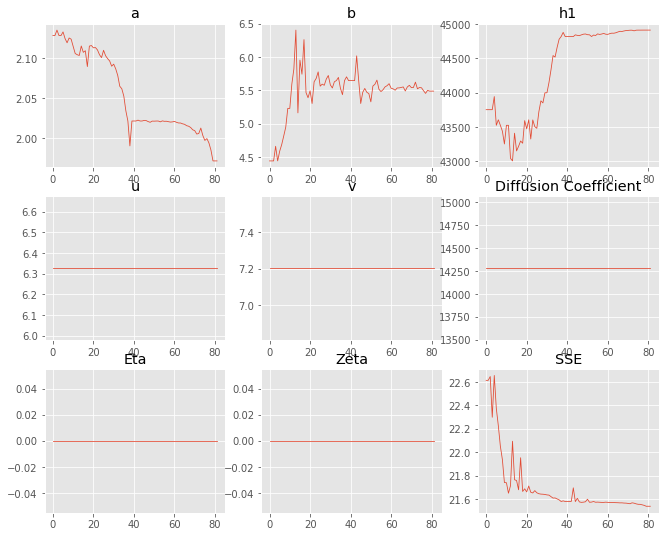

,Priors,Posteriors
a,2.12791,1.97151
b,4.44208,5.48847
h1,"43,751.9","44,915"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.049 minutes


Estimated remaining run time: 0.859 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.73e+03 	1.55e+03 	0.8953 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


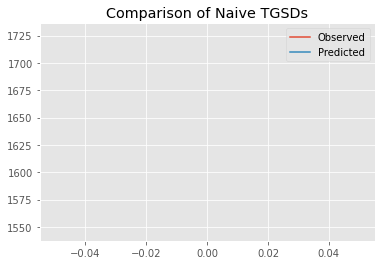

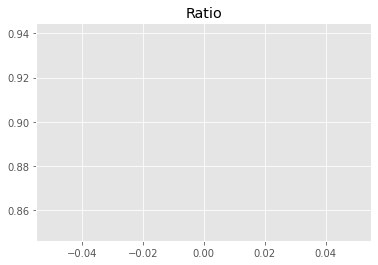

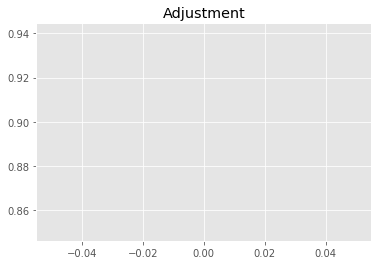

8344052969.125922
1


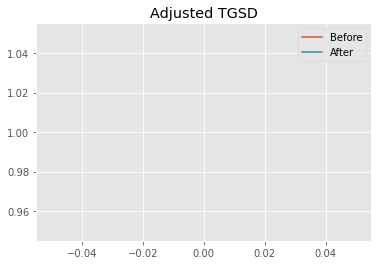

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86736 	2.45916 	39093.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.85047 	2.66762 	29392.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.7637
New Misfit: 21.7325
Convergence:
0.12240470438954151

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.67e+03 	1.55e+03 	0.9247 		1.0000


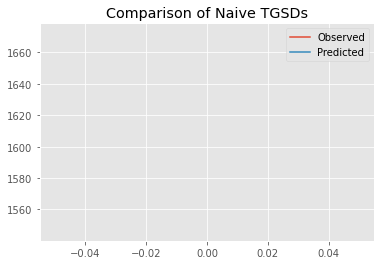

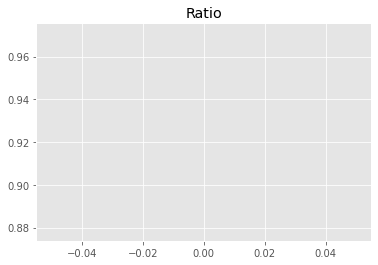

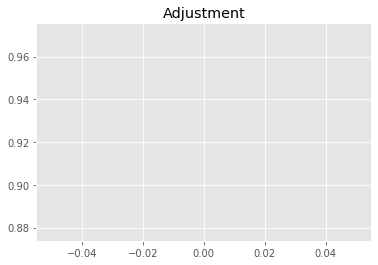

8618111161.77594
1


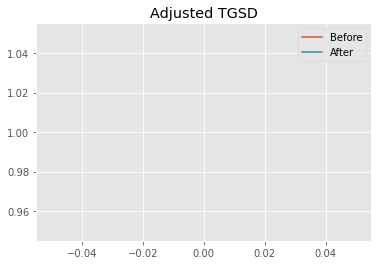

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85047 	2.66762 	29392.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.51753 	3.44858 	39680.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.7325
New Misfit: 21.2259
Convergence:
0.023309969675709287

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9408 		1.0000


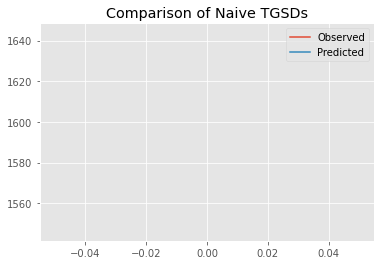

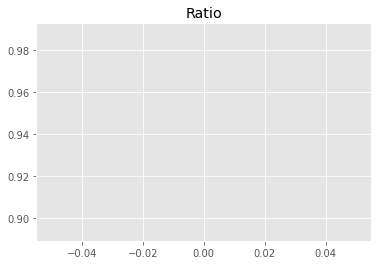

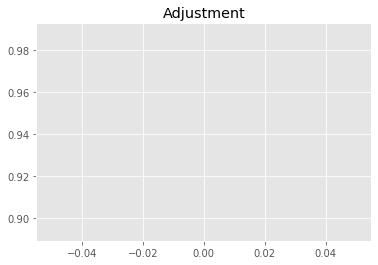

8768159343.756464
1


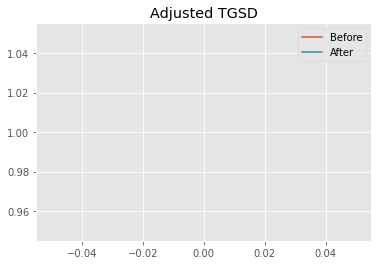

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51753 	3.44858 	39680.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.05841 	2.48504 	43795.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.2259
New Misfit: 20.7646
Convergence:
0.021730632919438747

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9526 		1.0000


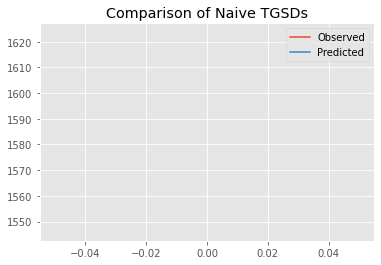

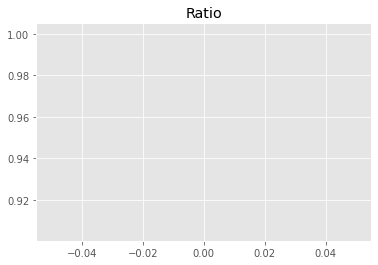

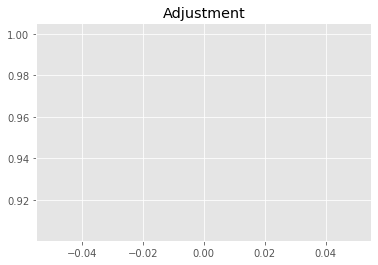

8878100038.825167
1


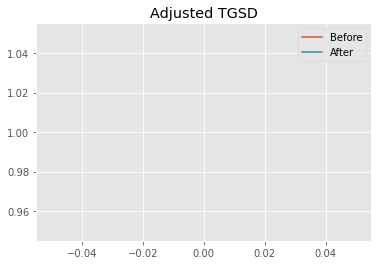

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05841 	2.48504 	43795.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00005 	2.50657 	44785.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7646
New Misfit: 20.6823
Convergence:
0.003964511622835402

____________________
a = 1.00005	b = 2.50657	            h1 = 44785.74002	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.68230813805638
Prior Misfit: 0.130168,	 Post Misfit: 20.6823


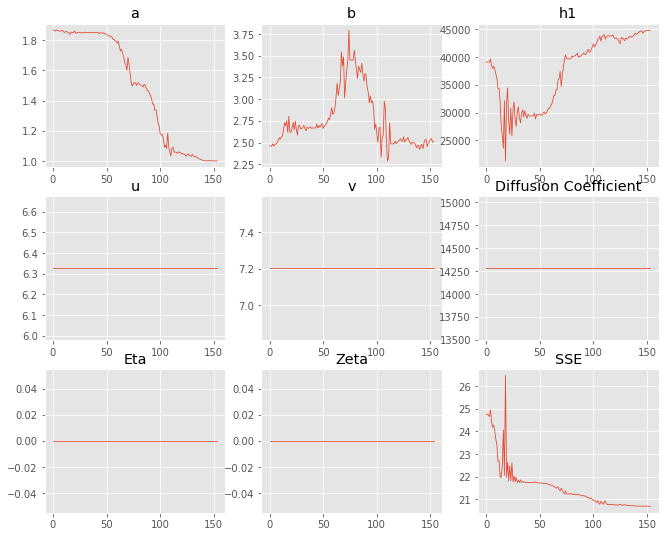

,Priors,Posteriors
a,1.86736,1.00005
b,2.45916,2.50657
h1,"39,093.1","44,785.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.083 minutes


Estimated remaining run time: 0.838 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9547 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


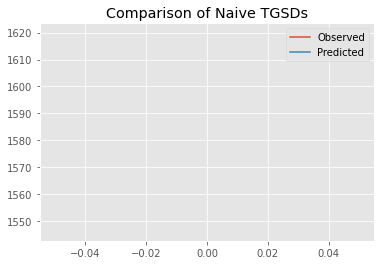

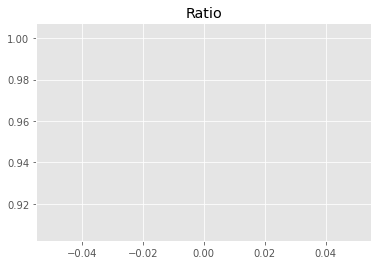

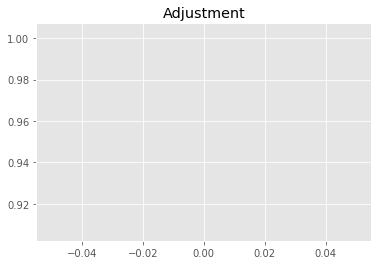

8897324849.543005
1


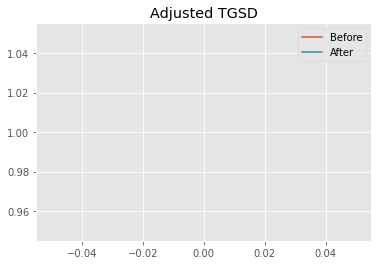

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.26579 	3.28054 	42437.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.03841 	2.34829 	42649.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.0485
New Misfit: 20.758
Convergence:
0.013800316791371258

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9524 		1.0000


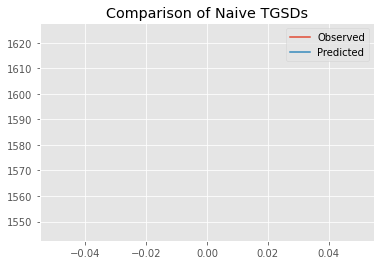

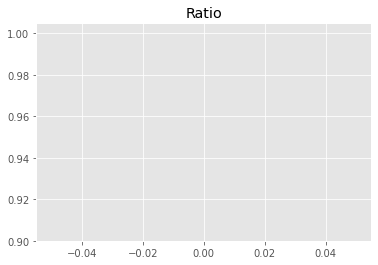

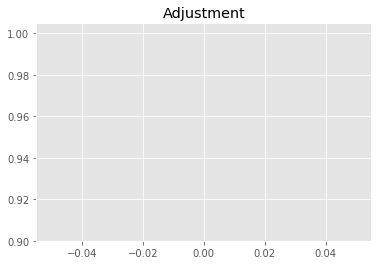

8875826749.922358
1


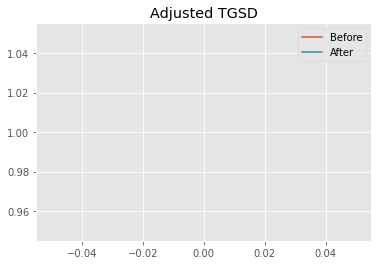

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03841 	2.34829 	42649.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.53249 	44834.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.758
New Misfit: 20.6828
Convergence:
0.0036243153458867913

____________________
a = 1.00000	b = 2.53249	            h1 = 44834.64807	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.682794910293545
Prior Misfit: 0.11064,	 Post Misfit: 20.6828


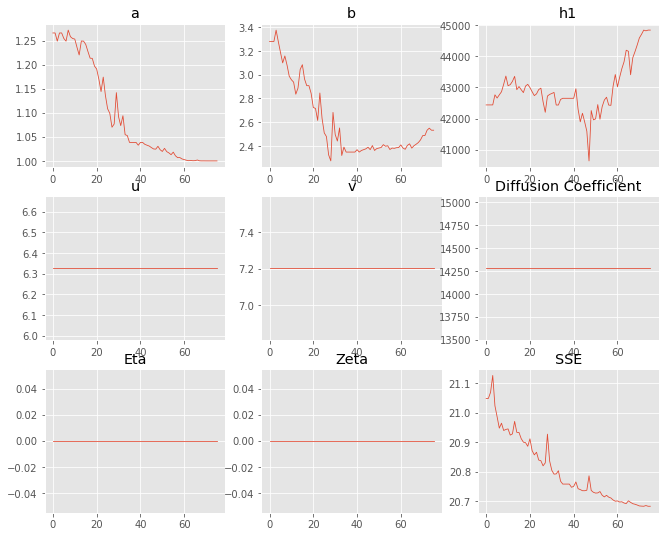

,Priors,Posteriors
a,1.26579,1
b,3.28054,2.53249
h1,"42,437.1","44,834.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.046 minutes


Estimated remaining run time: 0.746 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9569 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


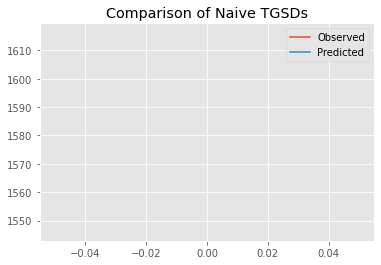

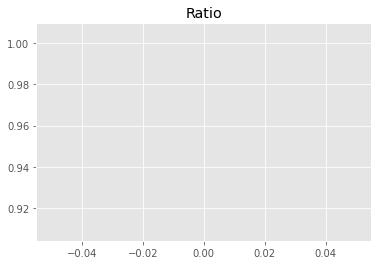

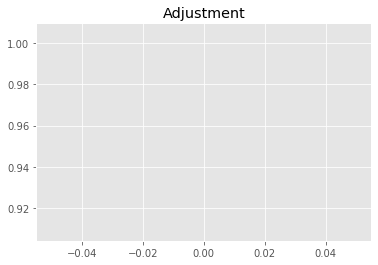

8917890185.877285
1


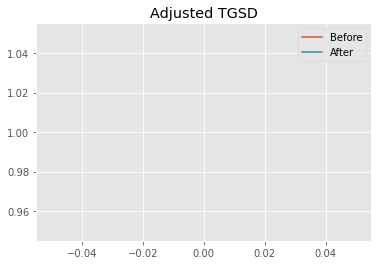

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.77454 	1.97512 	21552.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.69421 	1.98558 	25185.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.1115
New Misfit: 21.8213
Convergence:
0.05582751079887749

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9302 		1.0000


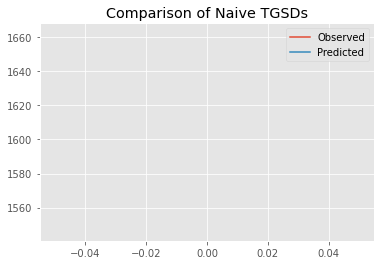

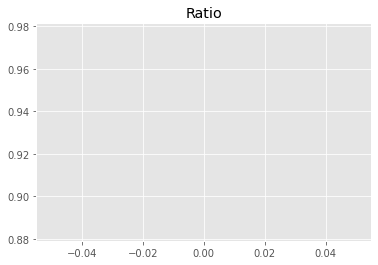

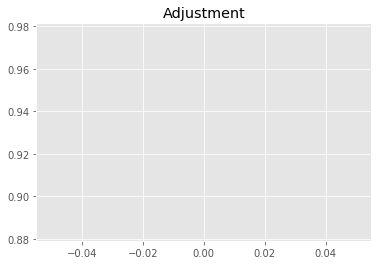

8669432001.897509
1


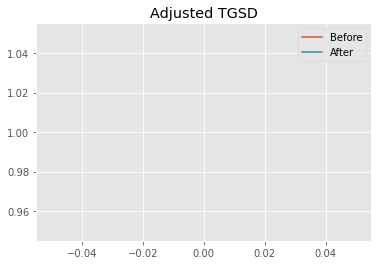

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.69421 	1.98558 	25185.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.0343 	2.01815 	39304.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.8213
New Misfit: 20.8457
Convergence:
0.044705483537165545

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9467 		1.0000


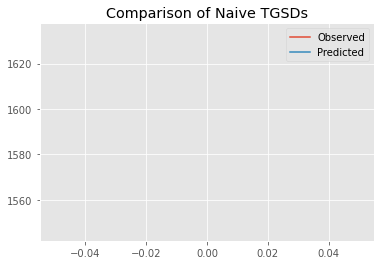

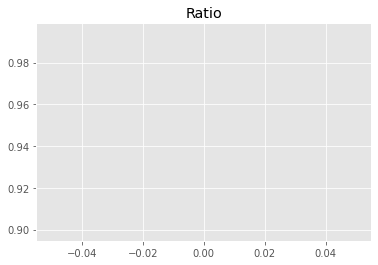

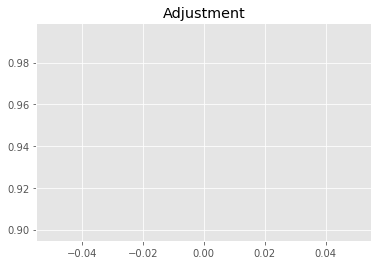

8823172331.65684
1


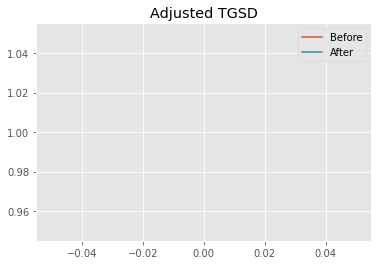

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0343 	2.01815 	39304.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00016 	2.0037 	38167.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8457
New Misfit: 20.755
Convergence:
0.004352260977242277

____________________
a = 1.00016	b = 2.00370	            h1 = 38167.57821	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.75502385472669
Prior Misfit: 0.121484,	 Post Misfit: 20.755


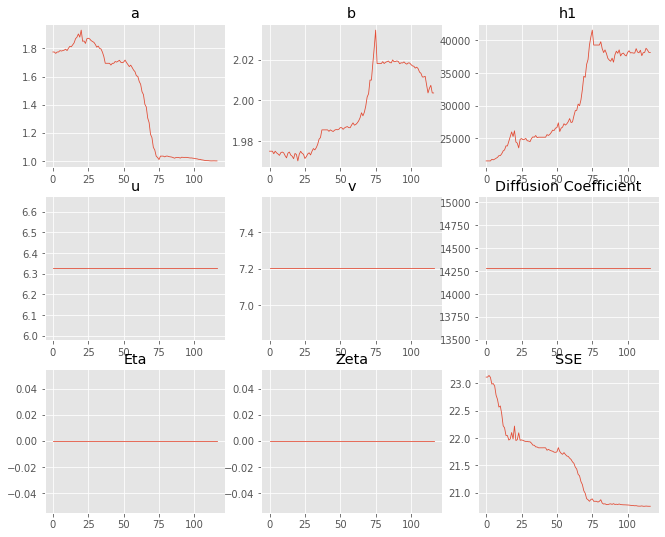

,Priors,Posteriors
a,1.77454,1.00016
b,1.97512,2.0037
h1,"21,552.4","38,167.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.065 minutes


Estimated remaining run time: 0.688 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.74e+03 	1.55e+03 	0.8898 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


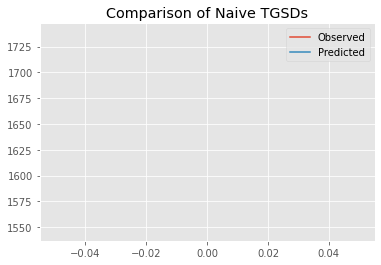

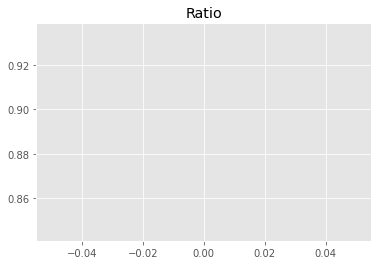

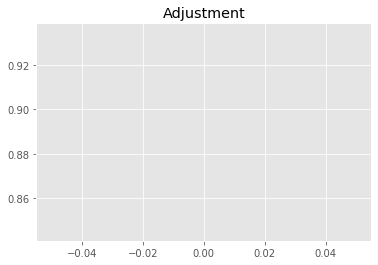

8292459041.226755
1


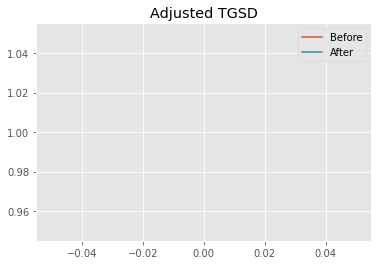

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.72345 	4.73917 	39025.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.30972 	6.04736 	42158.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.5885
New Misfit: 21.8162
Convergence:
0.07513663851921716

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.67e+03 	1.55e+03 	0.9287 		1.0000


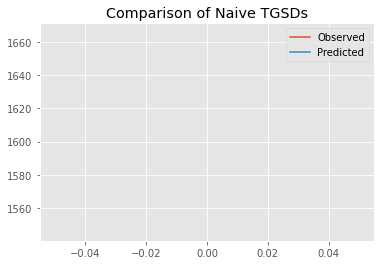

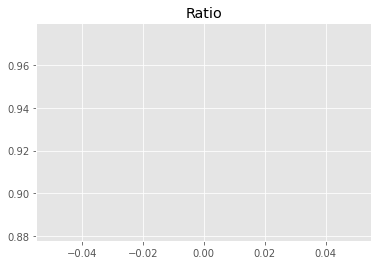

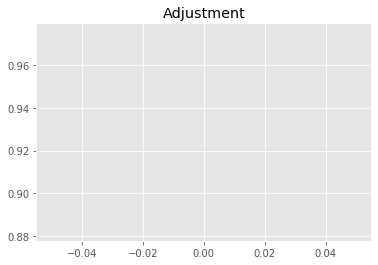

8655360744.766977
1


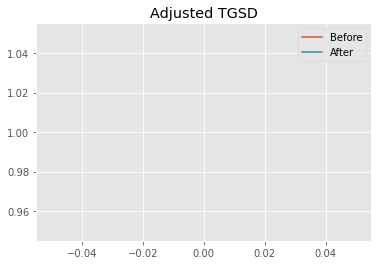

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.30972 	6.04736 	42158.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.27882 	3.16199 	44914.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.8162
New Misfit: 20.9609
Convergence:
0.03920177653869122

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9452 		1.0000


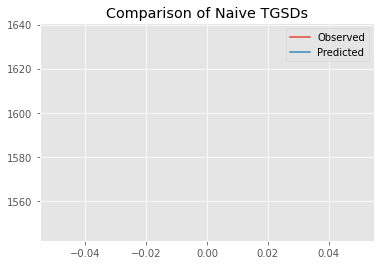

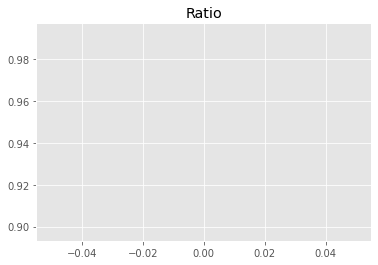

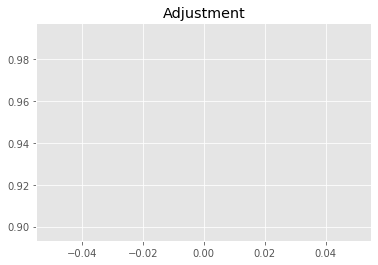

8808793938.217882
1


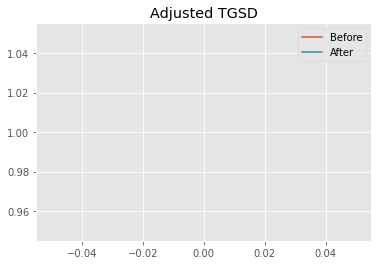

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.27882 	3.16199 	44914.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.0765 	2.58811 	44146.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.9609
New Misfit: 20.7686
Convergence:
0.009176838524461215

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9530 		1.0000


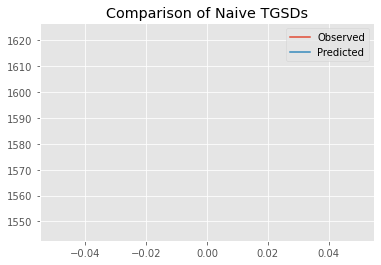

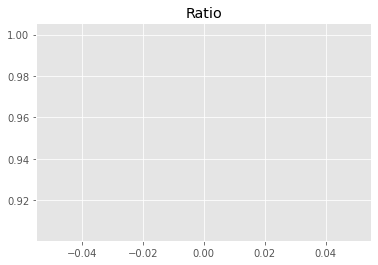

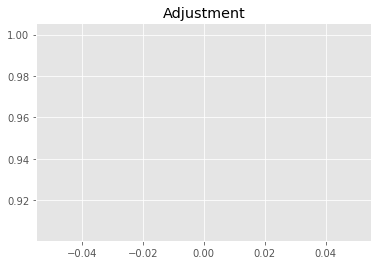

8881467771.663769
1


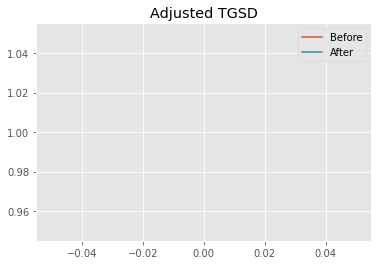

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0765 	2.58811 	44146.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00047 	2.50551 	44821.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7686
New Misfit: 20.6825
Convergence:
0.00414568096013237

____________________
a = 1.00047	b = 2.50551	            h1 = 44821.94196	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.682471241555092
Prior Misfit: 0.123991,	 Post Misfit: 20.6825


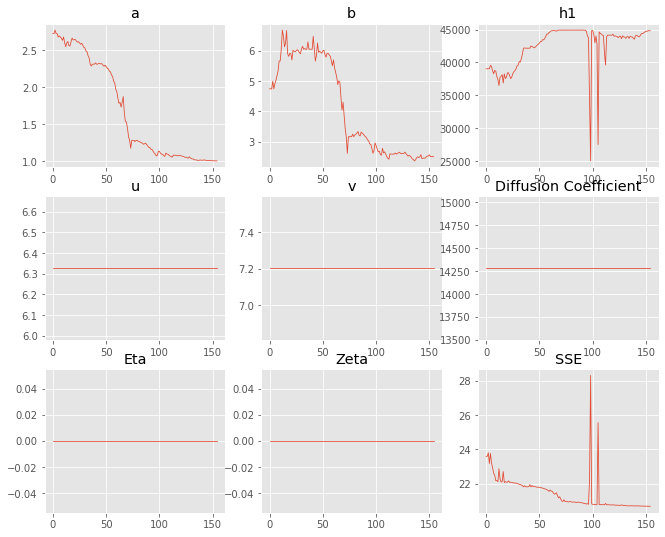

,Priors,Posteriors
a,2.72345,1.00047
b,4.73917,2.50551
h1,"39,025.8","44,821.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.082 minutes


Estimated remaining run time: 0.645 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.60e+03 	1.55e+03 	0.9643 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


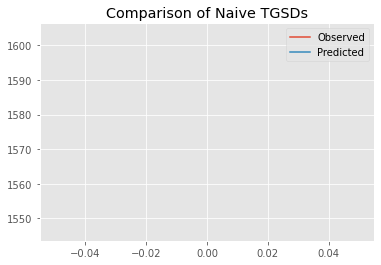

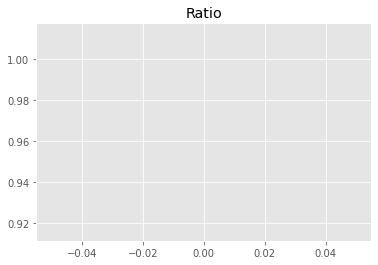

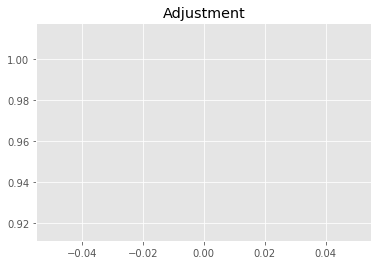

8987500724.269773
1


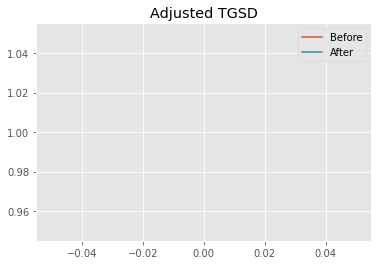

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19965 	3.15324 	40157.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.03965 	2.26451 	40675.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.3321
New Misfit: 20.7629
Convergence:
0.02668236368170438

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9523 		1.0000


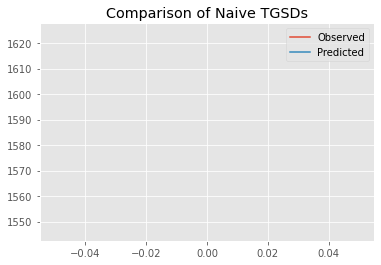

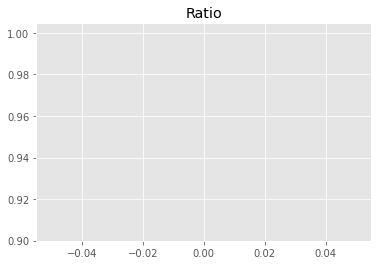

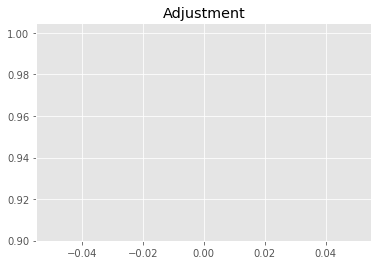

8874858480.483881
1


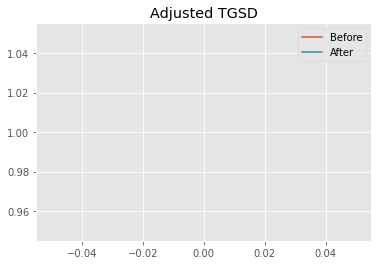

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03965 	2.26451 	40675.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00026 	2.30549 	41934 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7629
New Misfit: 20.7081
Convergence:
0.002642922788346825

____________________
a = 1.00026	b = 2.30549	            h1 = 41933.97530	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.70805805641751
Prior Misfit: 0.112131,	 Post Misfit: 20.7081


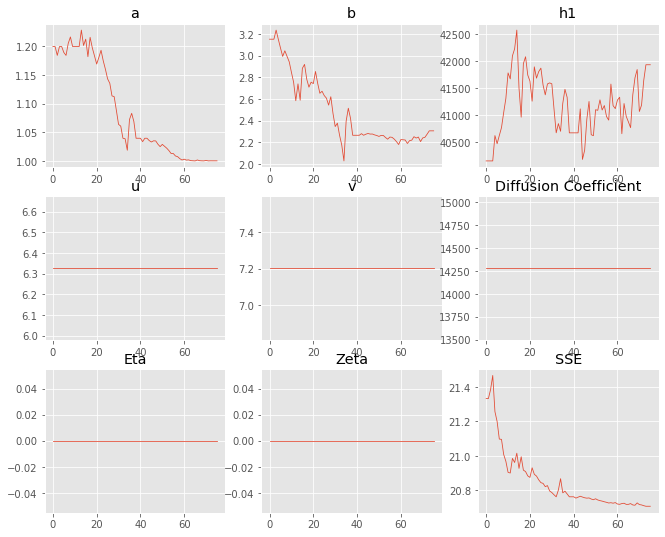

,Priors,Posteriors
a,1.19965,1.00026
b,3.15324,2.30549
h1,"40,157.4","41,934"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.047 minutes


Estimated remaining run time: 0.566 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.67e+03 	1.55e+03 	0.9279 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


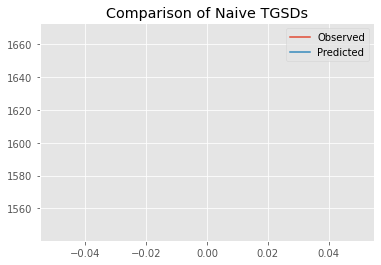

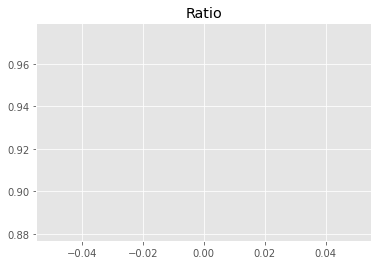

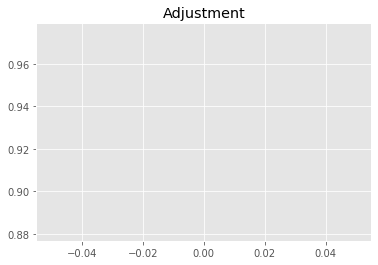

8647703420.678183
1


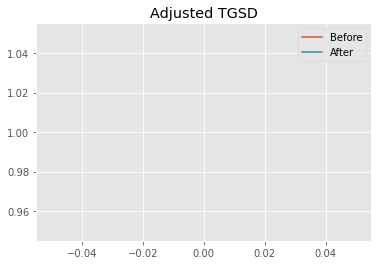

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.17274 	3.72944 	31426.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.93328 	4.86838 	41127.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.9304
New Misfit: 21.5747
Convergence:
0.016216709538404046

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9360 		1.0000


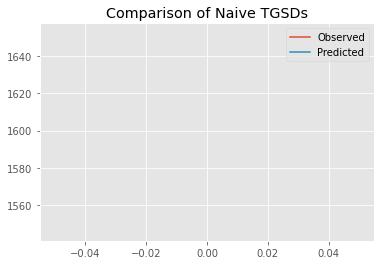

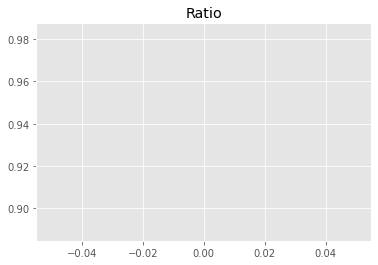

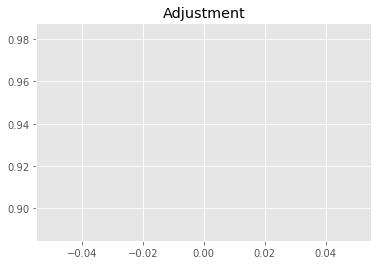

8723619134.23513
1


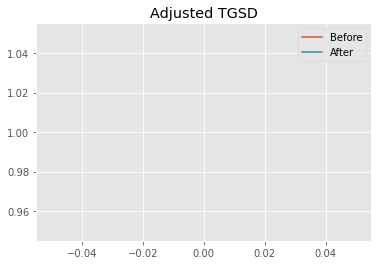

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.93328 	4.86838 	41127.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.94225 	5.22591 	44101.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.5747
New Misfit: 21.5211
Convergence:
0.0024881644033775507

____________________
a = 1.94225	b = 5.22591	            h1 = 44101.34895	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 21.521060527712933
Prior Misfit: 0.115276,	 Post Misfit: 21.5211


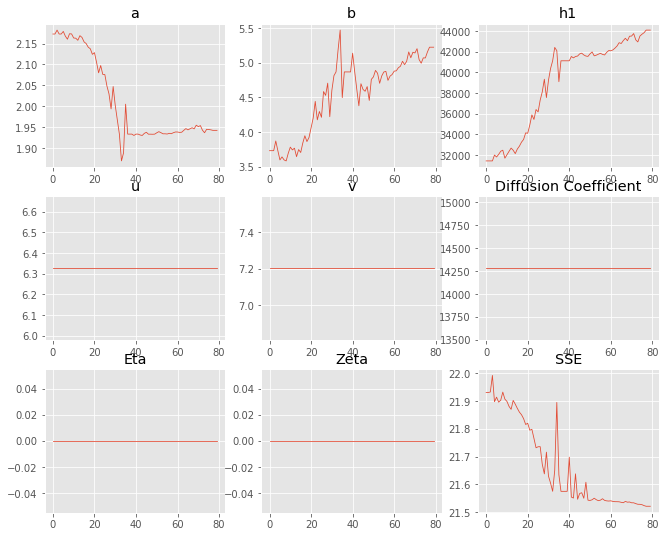

,Priors,Posteriors
a,2.17274,1.94225
b,3.72944,5.22591
h1,"31,426.1","44,101.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.049 minutes


Estimated remaining run time: 0.494 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.72e+03 	1.55e+03 	0.9007 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


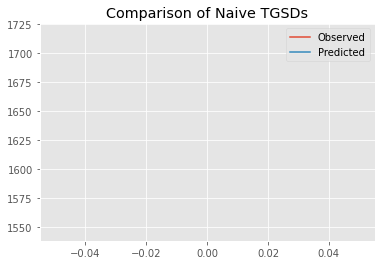

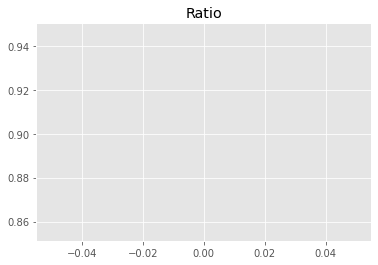

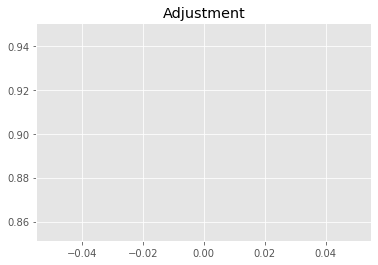

8394779325.516619
1


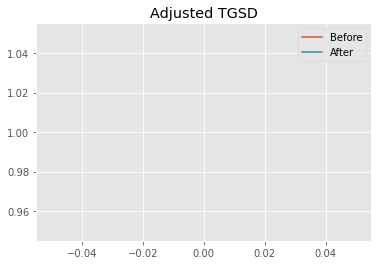

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.32082 	2.94304 	22786.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.22106 	1.85642 	33327.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.9724
New Misfit: 21.1928
Convergence:
0.07746710978048953

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9315 		1.0000


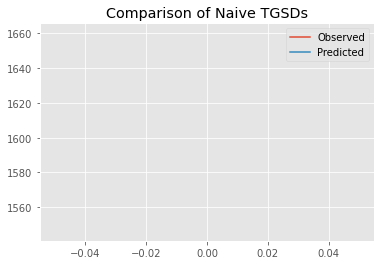

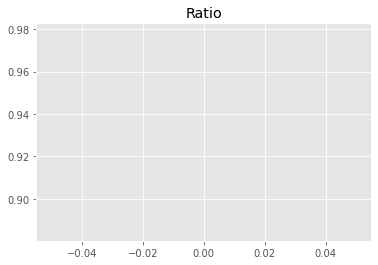

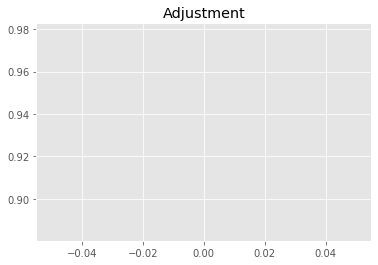

8681278503.526451
1


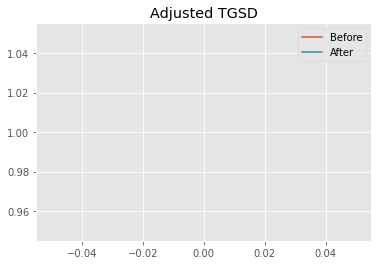

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.22106 	1.85642 	33327.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00687 	2.29323 	39919.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.1928
New Misfit: 20.7699
Convergence:
0.019952209270698584

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.61e+03 	1.55e+03 	0.9582 		1.0000


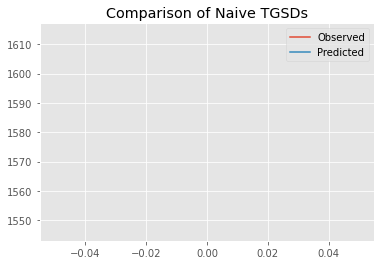

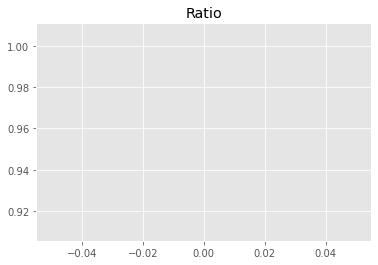

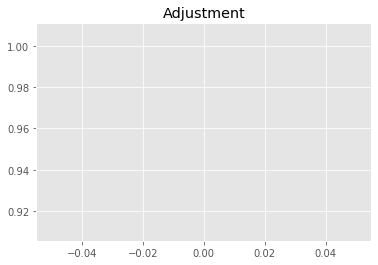

8930646467.115324
1


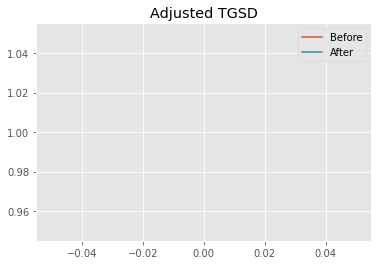

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00687 	2.29323 	39919.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00007 	2.36082 	42920.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7699
New Misfit: 20.6987
Convergence:
0.0034293613977463186

____________________
a = 1.00007	b = 2.36082	            h1 = 42920.53357	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.698692020718493
Prior Misfit: 0.120753,	 Post Misfit: 20.6987


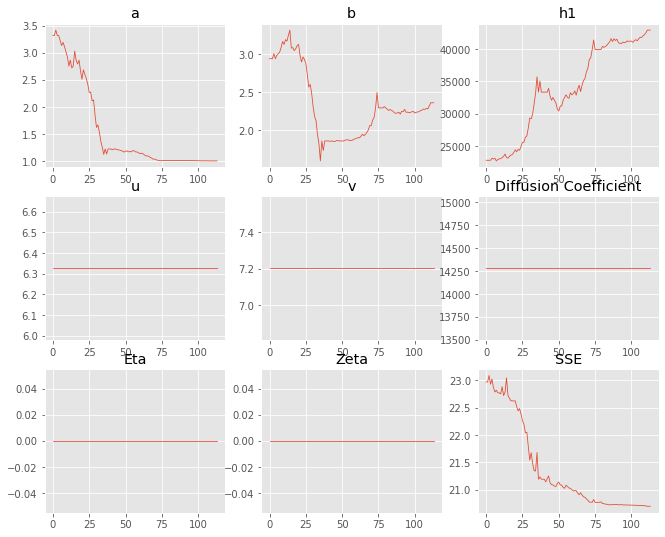

,Priors,Posteriors
a,3.32082,1.00007
b,2.94304,2.36082
h1,"22,786.5","42,920.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.063 minutes


Estimated remaining run time: 0.433 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.67e+03 	1.55e+03 	0.9287 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


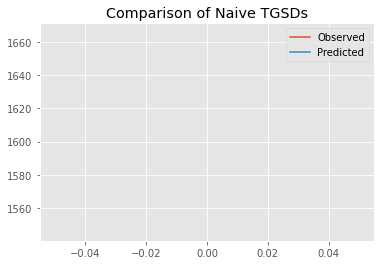

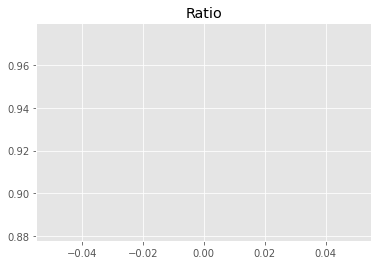

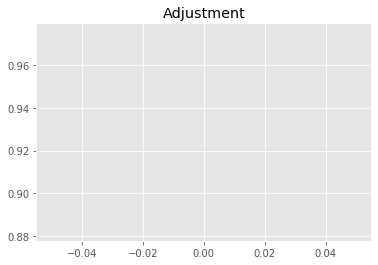

8655368608.622175
1


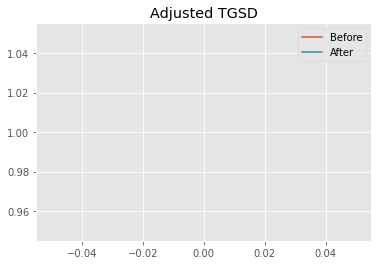

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87562 	3.86445 	37255 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.65936 	4.07246 	42109.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.5657
New Misfit: 21.3114
Convergence:
0.011792342816699504

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9374 		1.0000


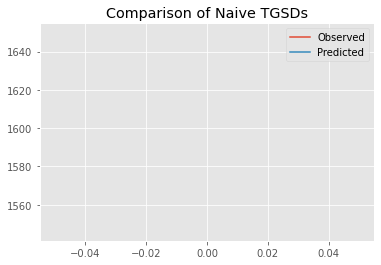

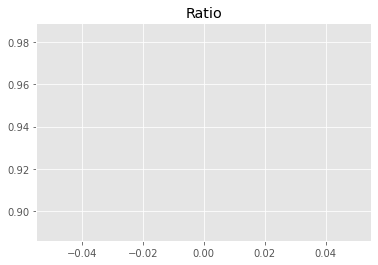

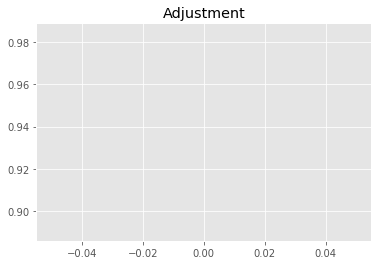

8736439500.992
1


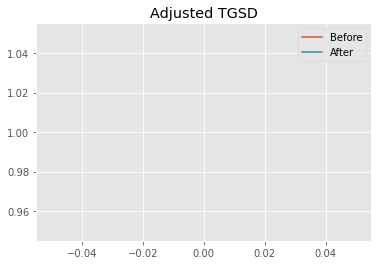

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.65936 	4.07246 	42109.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.09959 	2.69986 	44392.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.3114
New Misfit: 20.7814
Convergence:
0.024866667877036563

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9531 		1.0000


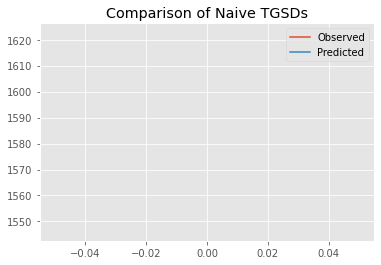

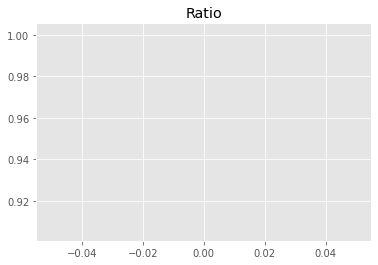

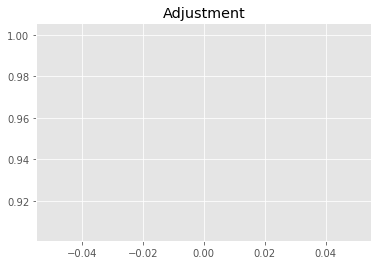

8882524176.624258
1


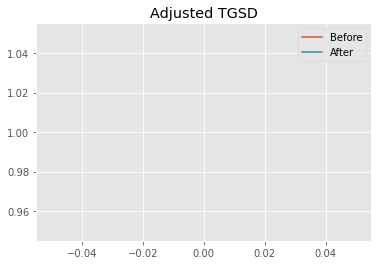

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09959 	2.69986 	44392.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.01303 	2.44005 	43690.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7814
New Misfit: 20.7046
Convergence:
0.0036990646606462297

____________________
a = 1.01303	b = 2.44005	            h1 = 43690.53616	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.704567374598415
Prior Misfit: 0.113359,	 Post Misfit: 20.7046


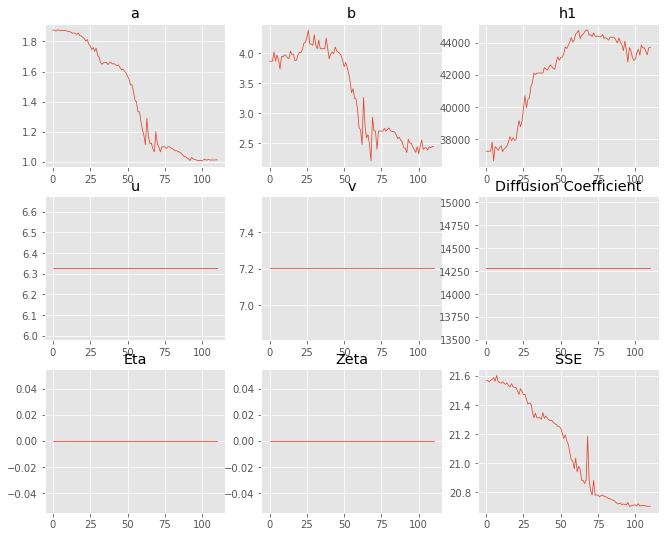

,Priors,Posteriors
a,1.87562,1.01303
b,3.86445,2.44005
h1,"37,255","43,690.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.060 minutes


Estimated remaining run time: 0.370 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.58e+03 	1.55e+03 	0.9795 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


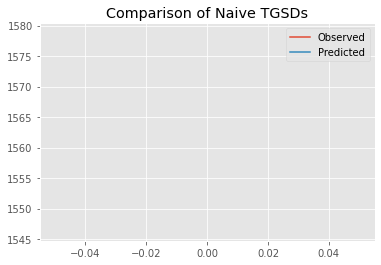

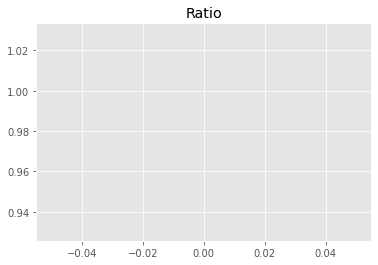

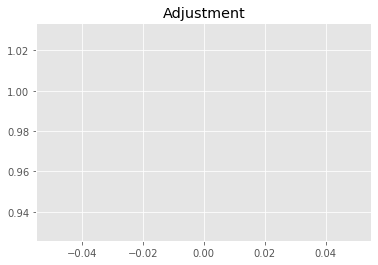

9128549923.059822
1


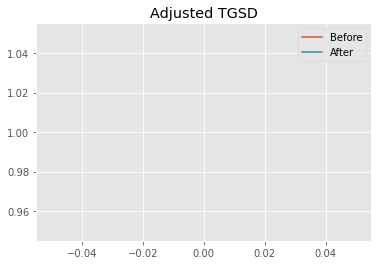

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50376 	1.55357 	19177.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.8587 	1.44523 	20965.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.3829
New Misfit: 22.2162
Convergence:
0.0888631330259969

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.68e+03 	1.55e+03 	0.9186 		1.0000


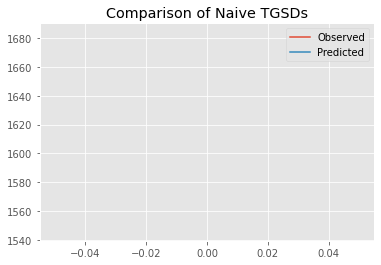

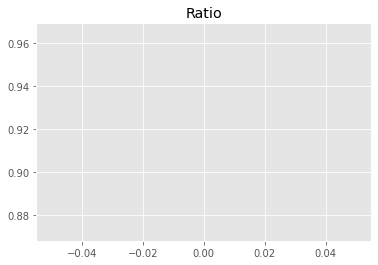

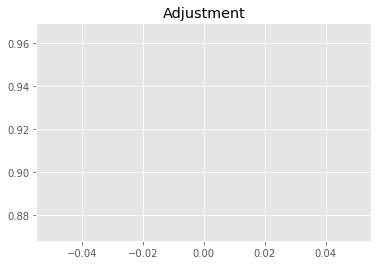

8561499034.304762
1


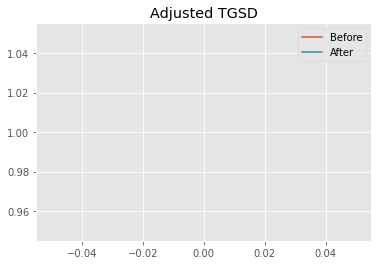

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.8587 	1.44523 	20965.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.7759 	2.54582 	28770.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2162
New Misfit: 21.7004
Convergence:
0.02321416261845251

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9290 		1.0000


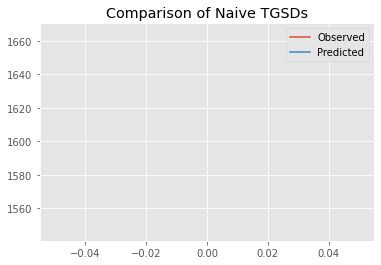

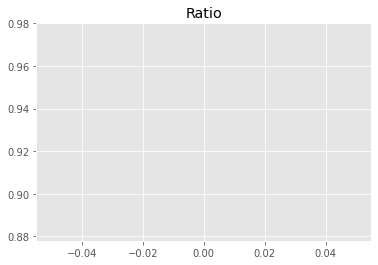

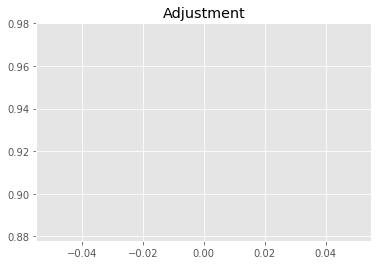

8657688513.399345
1


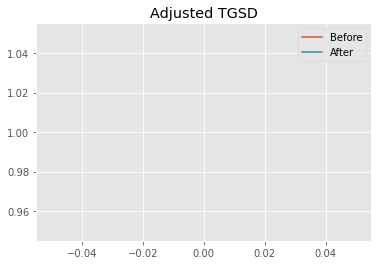

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.7759 	2.54582 	28770.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.09554 	2.7852 	42576.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.7004
New Misfit: 20.8592
Convergence:
0.038766103577749574

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.61e+03 	1.55e+03 	0.9589 		1.0000


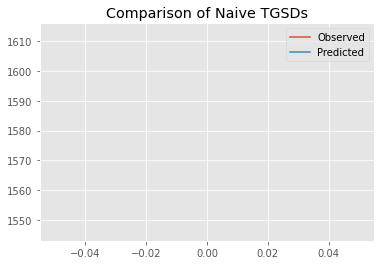

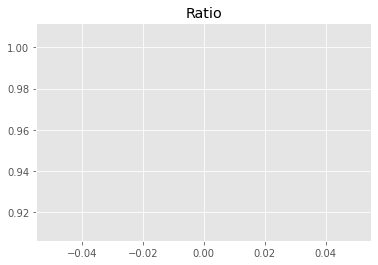

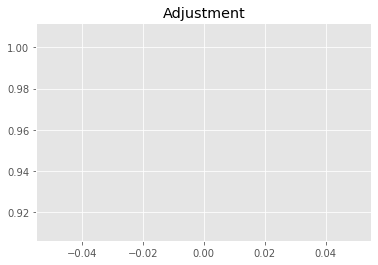

8936956705.023684
1


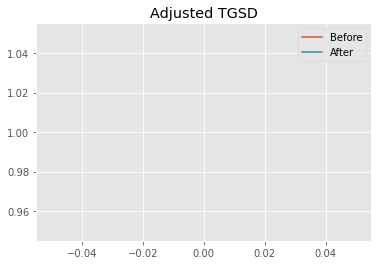

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09554 	2.7852 	42576.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00374 	2.41943 	44000.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8592
New Misfit: 20.6955
Convergence:
0.00784903379752544

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9567 		1.0000


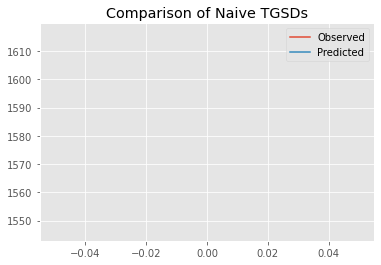

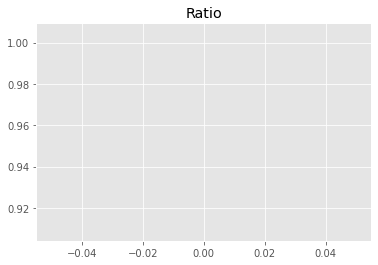

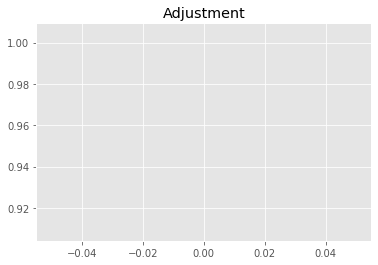

8916199160.525099
1


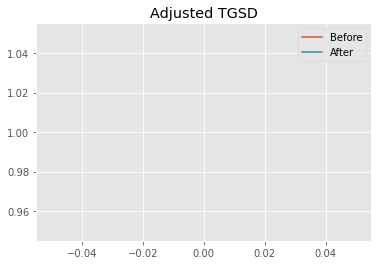

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00374 	2.41943 	44000.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.0001 	2.51774 	44910.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.6955
New Misfit: 20.6814
Convergence:
0.0006808021495364541

____________________
a = 1.00010	b = 2.51774	            h1 = 44910.92535	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 20.681391572990904
Prior Misfit: 0.128167,	 Post Misfit: 20.6814


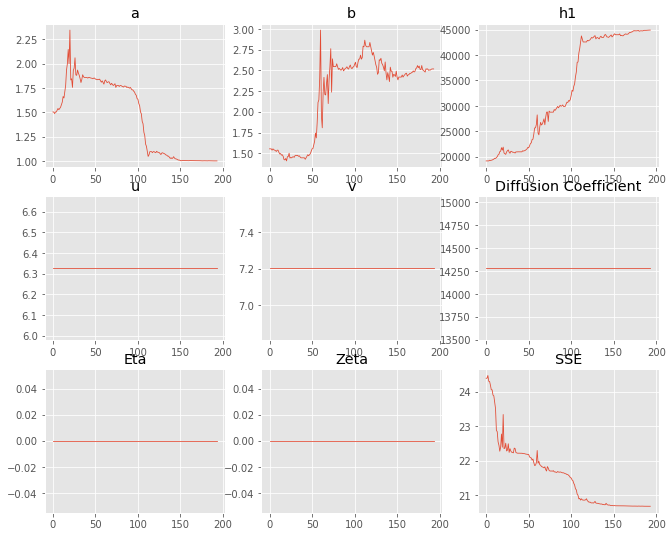

,Priors,Posteriors
a,1.50376,1.0001
b,1.55357,2.51774
h1,"19,177.2","44,910.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.096 minutes


Estimated remaining run time: 0.320 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8766 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


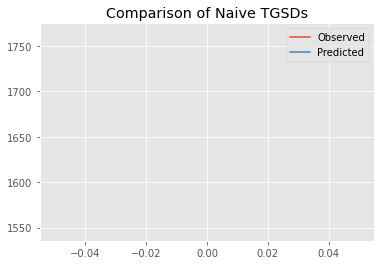

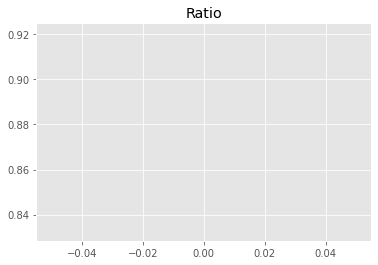

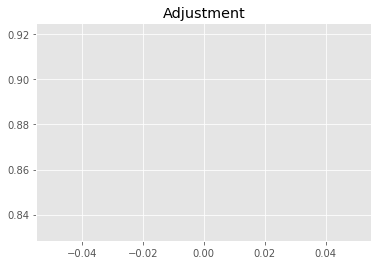

8169882834.963873
1


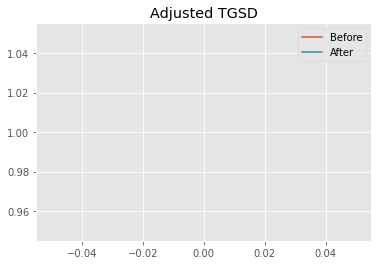

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.42531 	3.91471 	24711.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|3.06944 	3.99178 	26396.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.1342
New Misfit: 22.5912
Convergence:
0.06393380715259415

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.69e+03 	1.55e+03 	0.9157 		1.0000


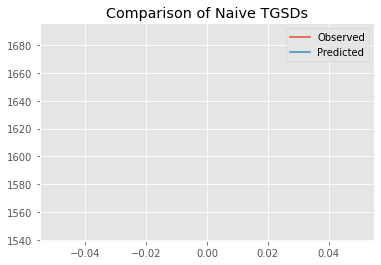

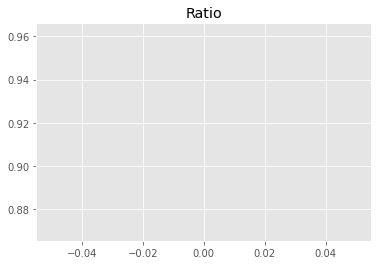

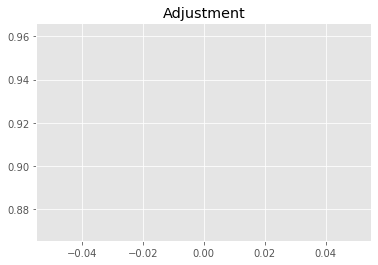

8534212329.631231
1


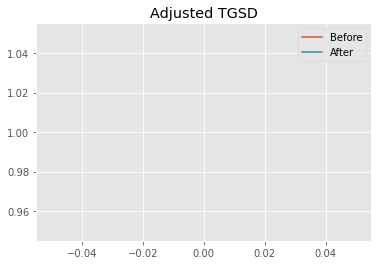

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.06944 	3.99178 	26396.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.03841 	2.44621 	44794.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.5912
New Misfit: 20.7673
Convergence:
0.08073466813186628

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9527 		1.0000


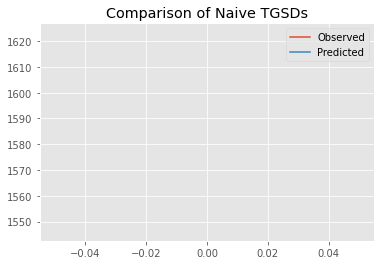

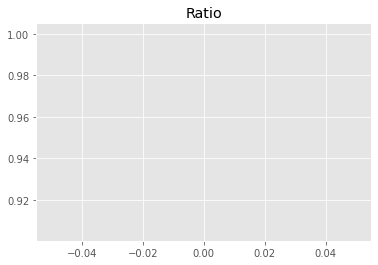

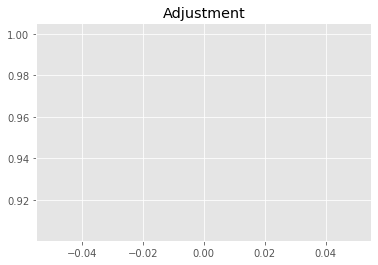

8879237555.771704
1


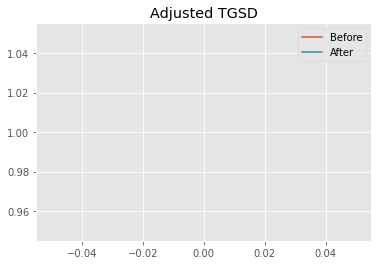

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03841 	2.44621 	44794.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00257 	2.48101 	44537.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7673
New Misfit: 20.687
Convergence:
0.003867344026780316

____________________
a = 1.00257	b = 2.48101	            h1 = 44537.61947	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 20.687034157349704
Prior Misfit: 0.12686,	 Post Misfit: 20.687


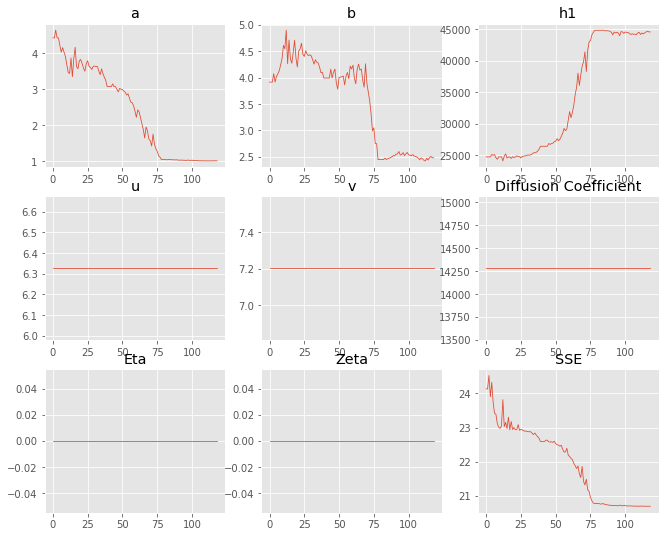

,Priors,Posteriors
a,4.42531,1.00257
b,3.91471,2.48101
h1,"24,711.9","44,537.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.064 minutes


Estimated remaining run time: 0.256 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9332 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


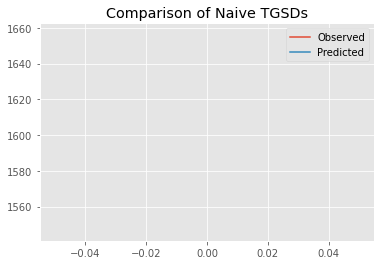

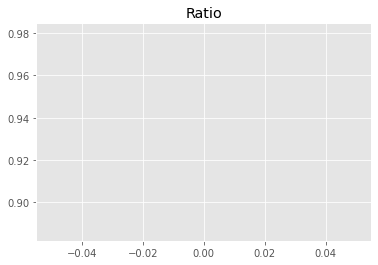

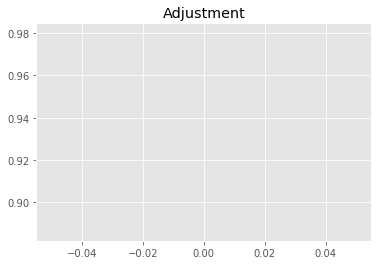

8697303126.421272
1


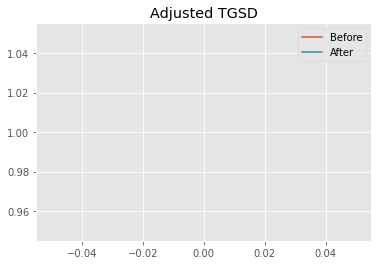

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.65206 	4.42676 	29010.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.41535 	3.02182 	38071.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.4774
New Misfit: 21.1594
Convergence:
0.058636236797014206

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9424 		1.0000


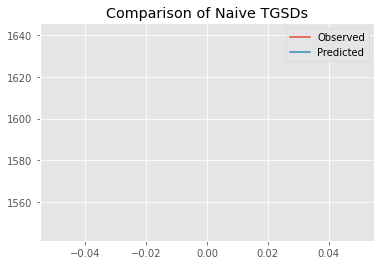

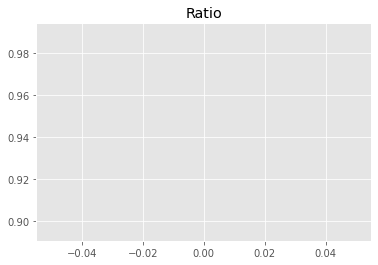

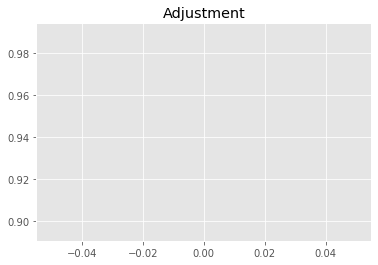

8783418251.053719
1


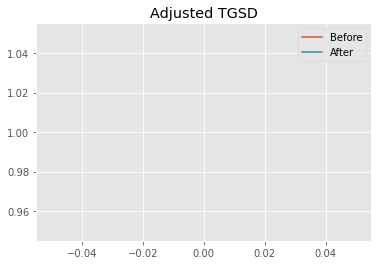

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.41535 	3.02182 	38071.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.09932 	2.3793 	41579.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.1594
New Misfit: 20.8443
Convergence:
0.014893381134066621

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9480 		1.0000


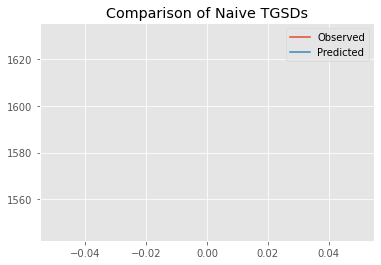

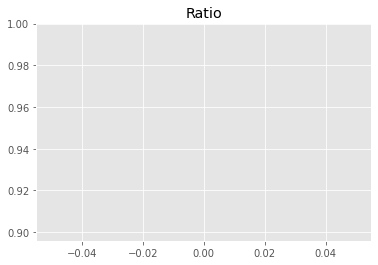

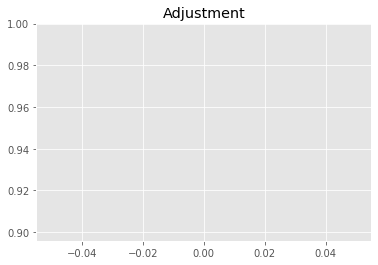

8835042334.187643
1


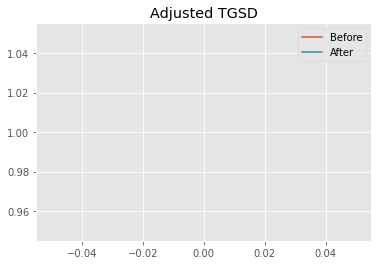

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.09932 	2.3793 	41579.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00019 	2.5271 	44897.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8443
New Misfit: 20.6818
Convergence:
0.0077924795240288955

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.61e+03 	1.55e+03 	0.9590 		1.0000


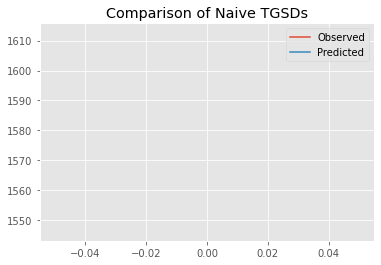

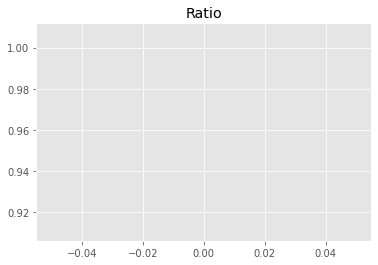

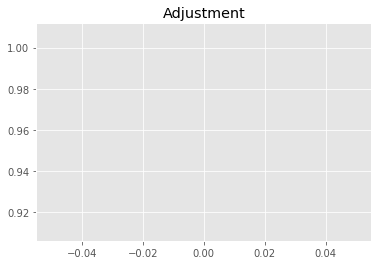

8937627564.951736
1


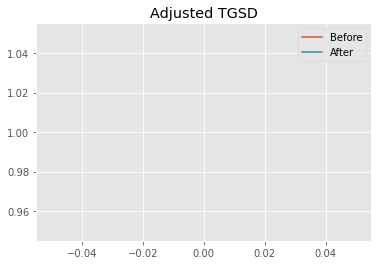

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00019 	2.5271 	44897.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.51611 	44913.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.6818
New Misfit: 20.6813
Convergence:
2.6769408841363522e-05

____________________
a = 1.00000	b = 2.51611	            h1 = 44913.57217	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.68127580617343
Prior Misfit: 0.118151,	 Post Misfit: 20.6813


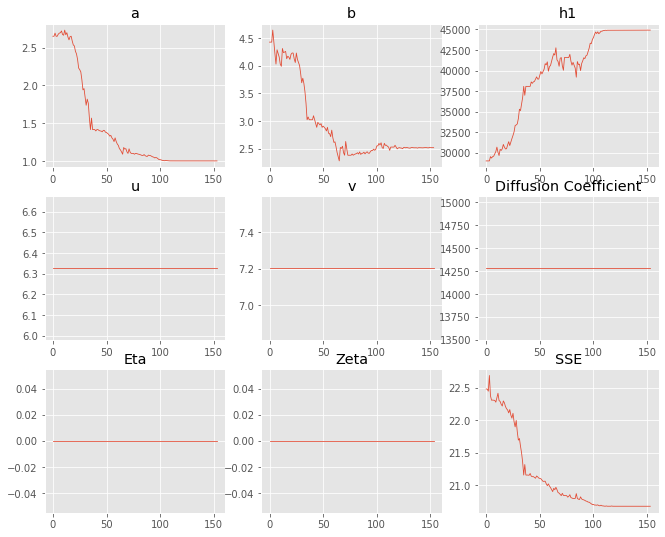

,Priors,Posteriors
a,2.65206,1
b,4.42676,2.51611
h1,"29,010.2","44,913.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.078 minutes


Estimated remaining run time: 0.194 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.76e+03 	1.55e+03 	0.8808 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


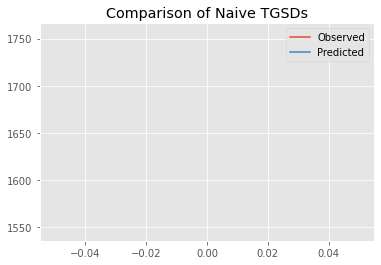

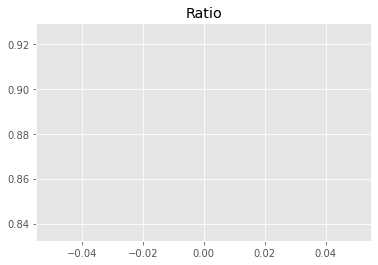

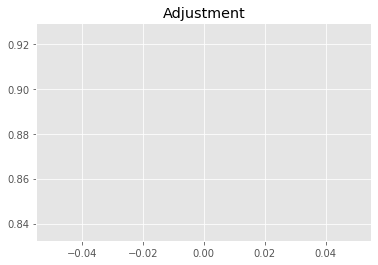

8208405426.671716
1


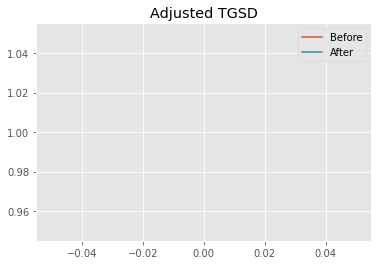

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.61701 	2.61241 	28763.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.7803 	3.76412 	35305.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0041
New Misfit: 21.6546
Convergence:
0.09787983615359828

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9418 		1.0000


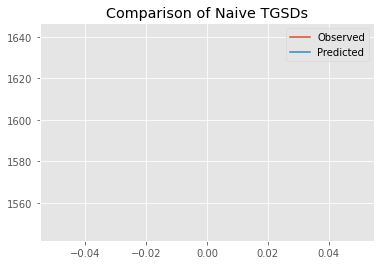

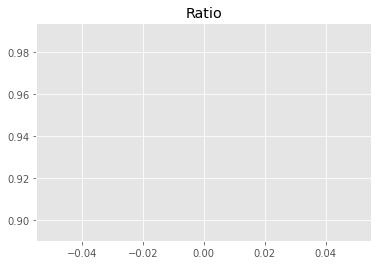

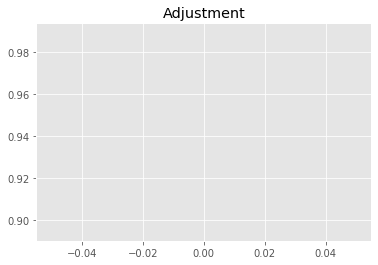

8777627506.916939
1


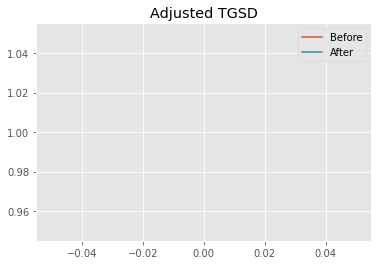

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.7803 	3.76412 	35305.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.43761 	2.08779 	29378.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.6546
New Misfit: 21.3831
Convergence:
0.012539146159920496

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9344 		1.0000


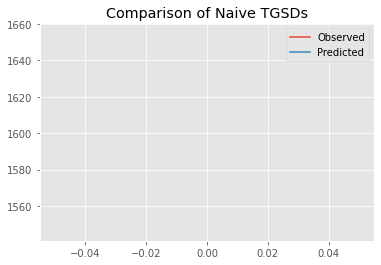

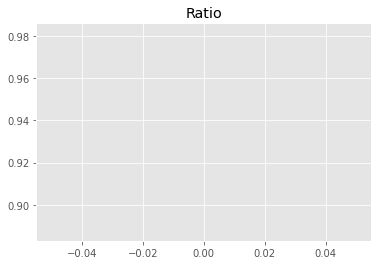

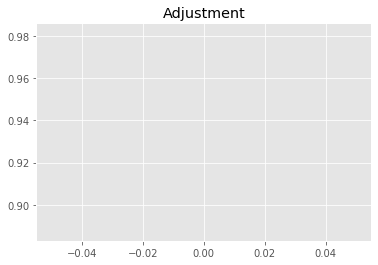

8708842730.526365
1


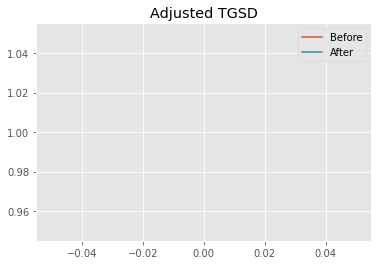

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.43761 	2.08779 	29378.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.06942 	1.8795 	35991.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.3831
New Misfit: 20.9056
Convergence:
0.022327492688210073

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9427 		1.0000


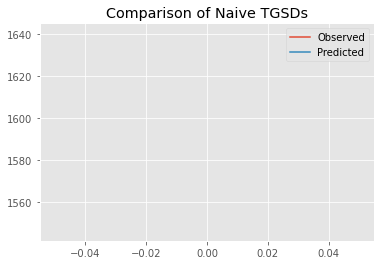

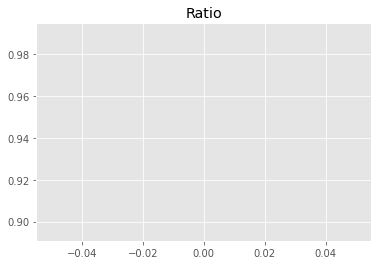

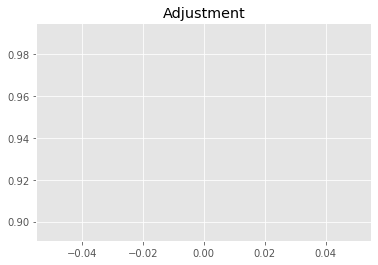

8785863077.320885
1


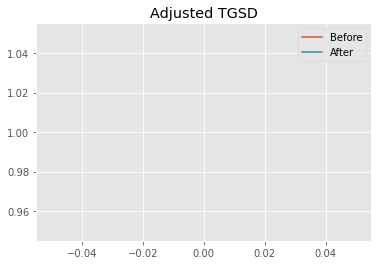

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.06942 	1.8795 	35991.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00029 	2.35835 	42778.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.9056
New Misfit: 20.7002
Convergence:
0.009828041076231418

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9568 		1.0000


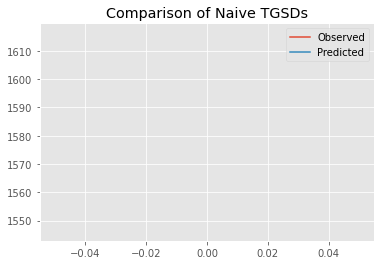

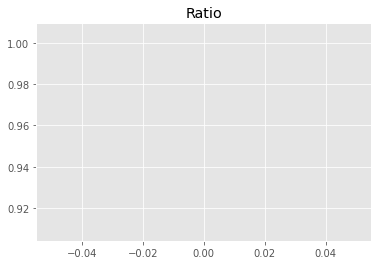

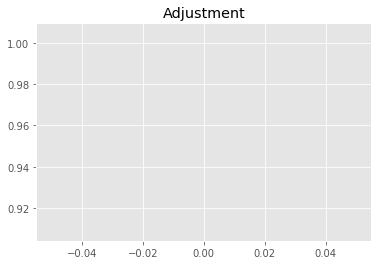

8917019143.626583
1


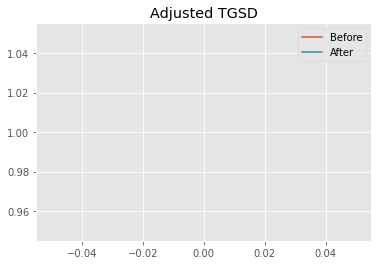

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00029 	2.35835 	42778.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00038 	2.49999 	44760.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7002
New Misfit: 20.6829
Convergence:
0.0008356487347355089

____________________
a = 1.00038	b = 2.49999	            h1 = 44760.28568	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 20.682887592234028
Prior Misfit: 0.126176,	 Post Misfit: 20.6829


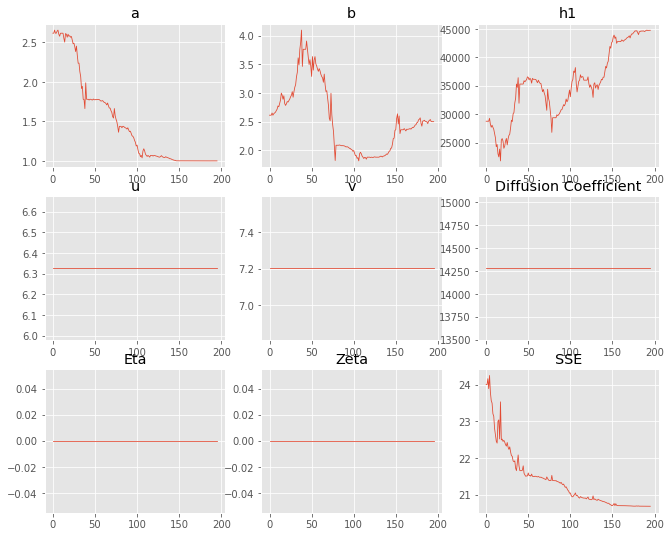

,Priors,Posteriors
a,2.61701,1.00038
b,2.61241,2.49999
h1,"28,763.7","44,760.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.098 minutes


Estimated remaining run time: 0.133 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.55e+03 	1.55e+03 	0.9988 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


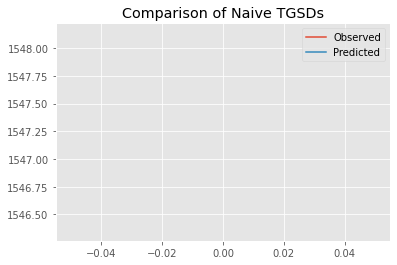

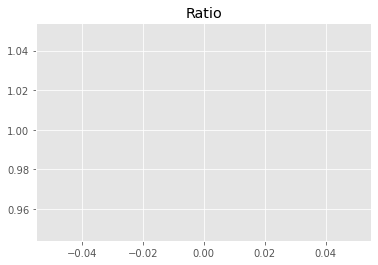

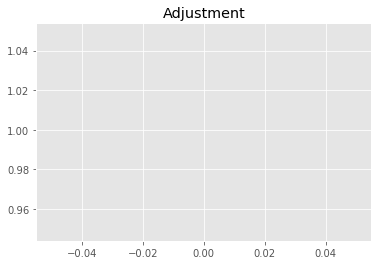

9309061946.440838
1


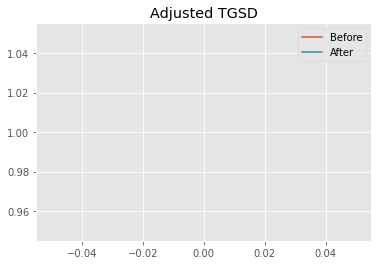

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.48669 	4.36379 	34508.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.42377 	2.85561 	37546.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.4951
New Misfit: 21.1716
Convergence:
0.13567964815607783

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9377 		1.0000


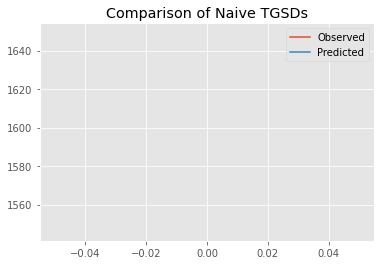

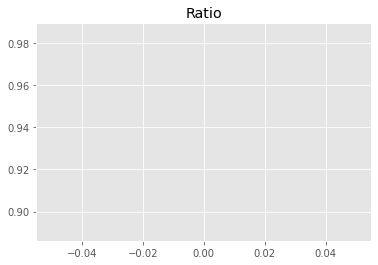

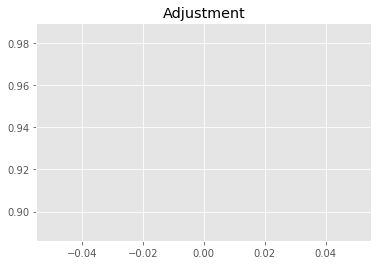

8739437228.75622
1


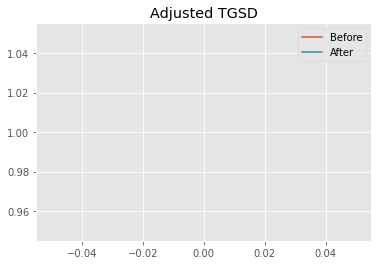

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.42377 	2.85561 	37546.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.05731 	1.88353 	35277.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.1716
New Misfit: 20.8634
Convergence:
0.014559086092196865

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9455 		1.0000


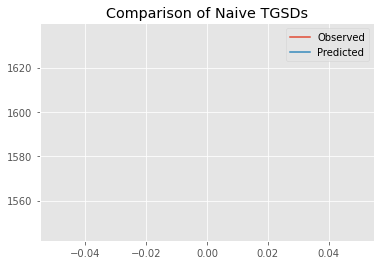

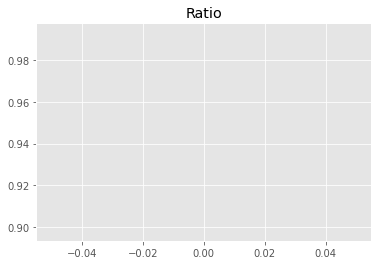

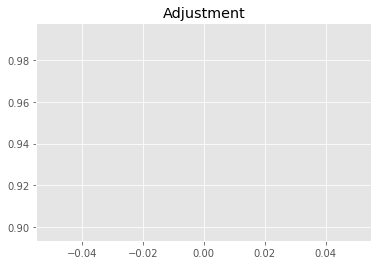

8811784296.65026
1


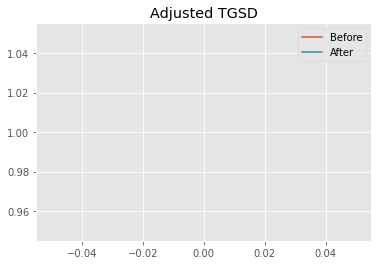

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05731 	1.88353 	35277.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00001 	2.34803 	42511.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8634
New Misfit: 20.7023
Convergence:
0.007721388621050065

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.62e+03 	1.55e+03 	0.9569 		1.0000


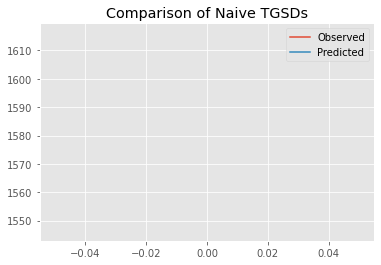

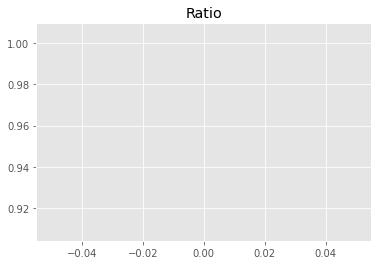

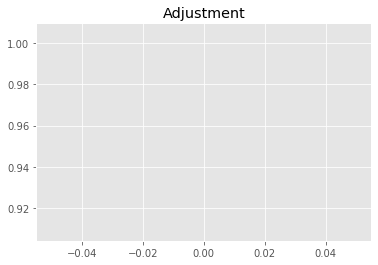

8917723299.394165
1


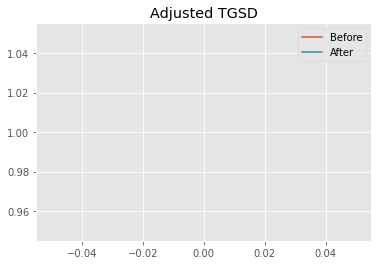

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00001 	2.34803 	42511.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.00078 	2.49547 	44455.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7023
New Misfit: 20.6858
Convergence:
0.0007973734243535503

____________________
a = 1.00078	b = 2.49547	            h1 = 44455.64993	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.68580200247472
Prior Misfit: 0.128757,	 Post Misfit: 20.6858


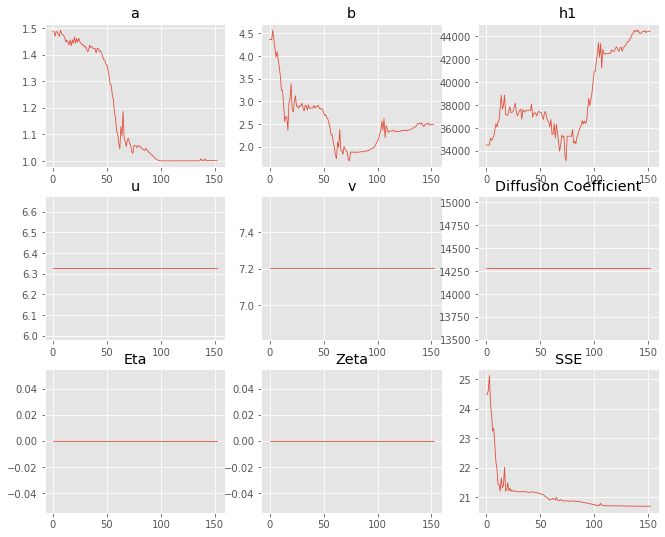

,Priors,Posteriors
a,1.48669,1.00078
b,4.36379,2.49547
h1,"34,508.4","44,455.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.080 minutes


Estimated remaining run time: 0.067 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9454 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


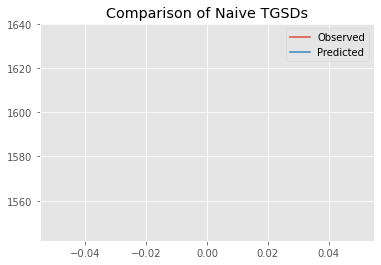

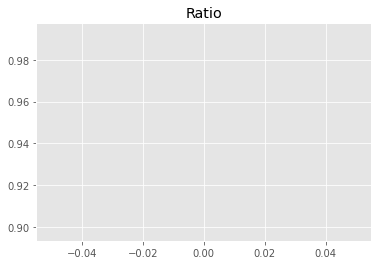

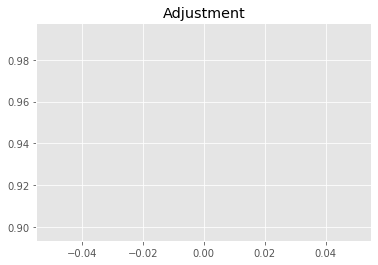

8810710014.320292
1


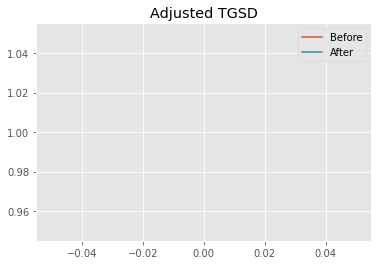

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.69766 	4.45116 	27295.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.79137 	3.34678 	33204.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.9887
New Misfit: 21.6298
Convergence:
0.059109658380071345

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9364 		1.0000


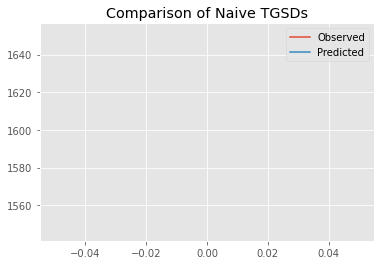

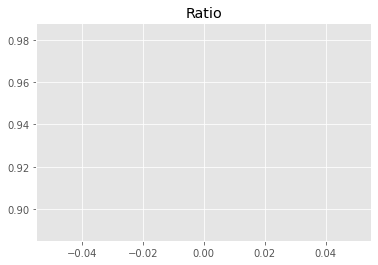

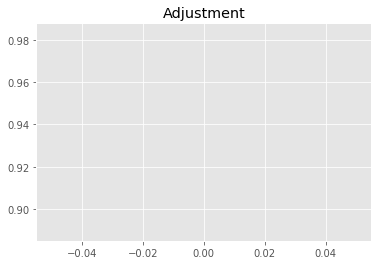

8727067052.876148
1


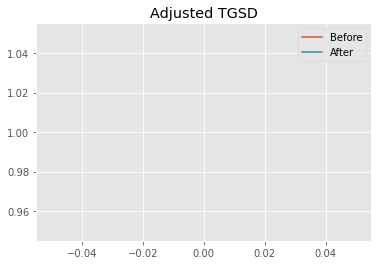

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.79137 	3.34678 	33204.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.22621 	2.24555 	35145.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.6298
New Misfit: 21.0239
Convergence:
0.028010674883227345

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.64e+03 	1.55e+03 	0.9423 		1.0000


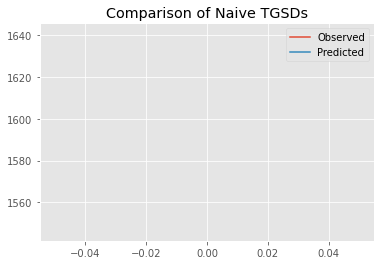

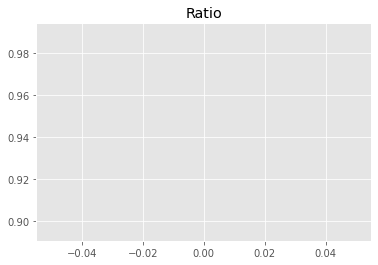

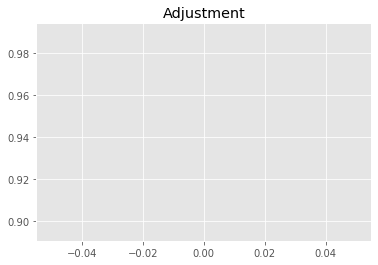

8782380541.031784
1


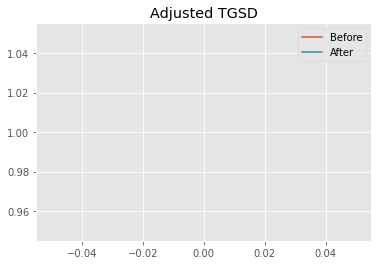

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.22621 	2.24555 	35145.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1.01162 	1.92167 	37099.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.0239
New Misfit: 20.7892
Convergence:
0.011167367099607053

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.63e+03 	1.55e+03 	0.9489 		1.0000


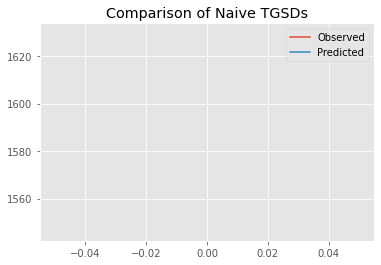

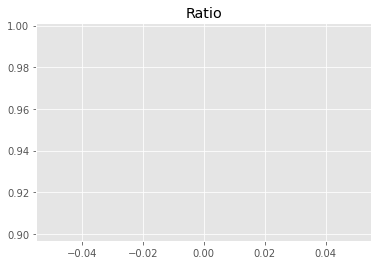

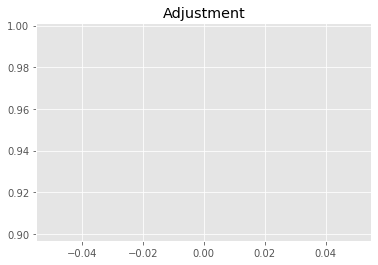

8843222995.345097
1


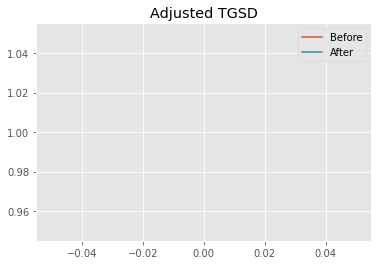

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01162 	1.92167 	37099.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|1 	2.3164 	41870.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7892
New Misfit: 20.7092
Convergence:
0.003847882972719701

____________________
a = 1.00000	b = 2.31640	            h1 = 41870.31566	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 20.709162446900184
Prior Misfit: 0.120838,	 Post Misfit: 20.7092


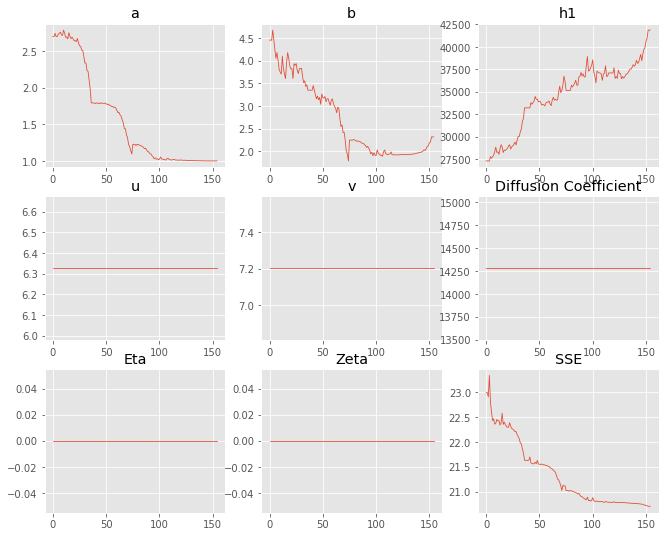

,Priors,Posteriors
a,2.69766,1
b,4.45116,2.3164
h1,"27,295.2","41,870.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.081 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.82e+03 	1.55e+03 	0.8489 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


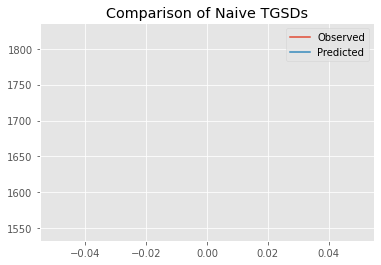

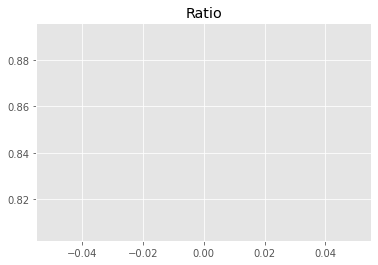

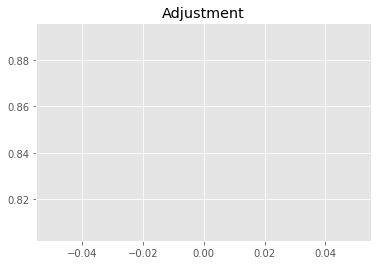

7911802765.649977
1


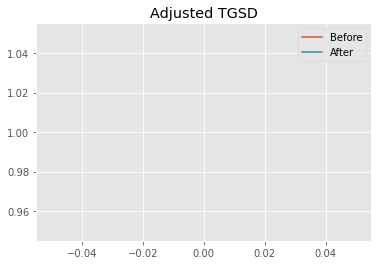

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.77882 	2.49006 	28608.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.02454 	2.84097 	27238.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 28.6852
New Misfit: 22.0275
Convergence:
0.2320944910775268

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9318 		1.0000


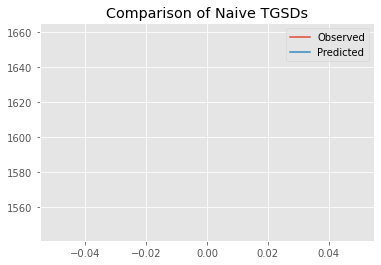

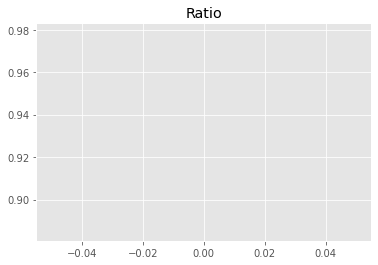

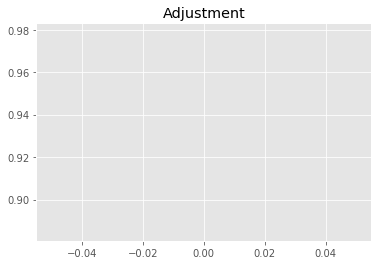

8684033859.109758
1


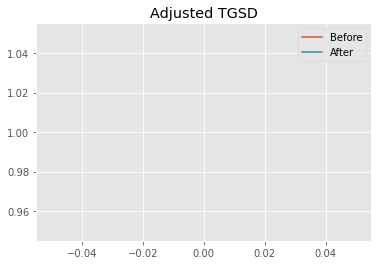

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02454 	2.84097 	27238.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.00359 	3.99503 	34891.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.0275
New Misfit: 21.7265
Convergence:
0.013664217241876992

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.66e+03 	1.55e+03 	0.9318 		1.0000


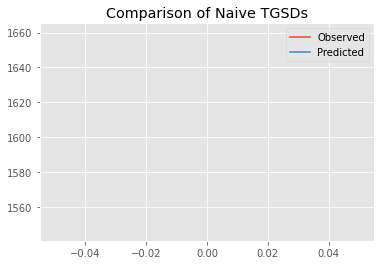

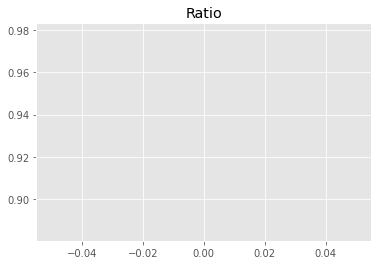

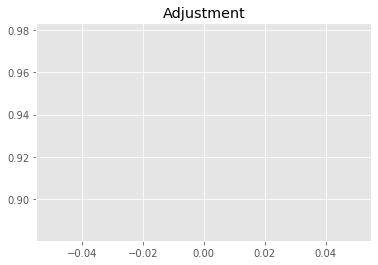

8683828028.25492
1


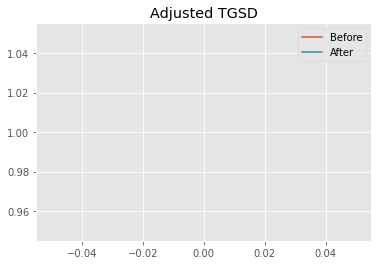

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00359 	3.99503 	34891.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 9.31979e+09
After: 		|2.00235 	4.78236 	40666.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.7265
New Misfit: 21.6081
Convergence:
0.005448519298922795

____________________
a = 2.00235	b = 4.78236	            h1 = 40666.28260	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 21.60813690388798
Prior Misfit: 0.150782,	 Post Misfit: 21.6081


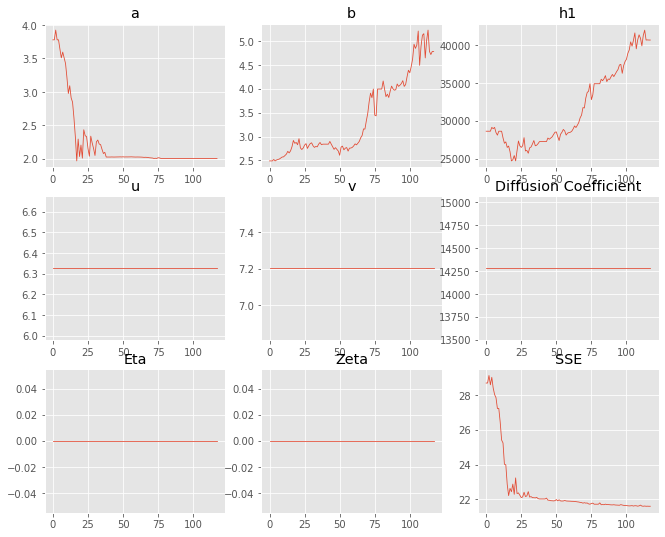

,Priors,Posteriors
a,3.77882,2.00235
b,2.49006,4.78236
h1,"28,608.9","40,666.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.065 minutes


Estimated remaining run time: -0.068 minutes


Total Run Time: 1.42629 minutes


[{'a': 1.0051921299731288,
  'b': 2.0390797468316864,
  'h1': 38380.3422613083,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000685555894309,
  'b': 2.496659354337945,
  'h1': 44169.64696681187,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.99036131715096,
  'b': 4.900842160050303,
  'h1': 41698.281670950564,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000165487102048,
  'b': 2.000016879131307,
  'h1': 38246.88036836926,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.9715087906186752,
  'b': 5.488469660427802,
  'h1': 44914.99929808723,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0000459

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
15,1,2.51611,"44,913.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.10871
13,1.0001,2.51774,"44,910.9",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.10871
5,1.00005,2.50657,"44,785.7",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108715
8,1.00047,2.50551,"44,821.9",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108716
6,1,2.53249,"44,834.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108718
16,1.00038,2.49999,"44,760.3",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108718
17,1.00078,2.49547,"44,455.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108733
14,1.00257,2.48101,"44,537.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.10874
1,1.00007,2.49666,"44,169.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108753
11,1.00007,2.36082,"42,920.5",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108801


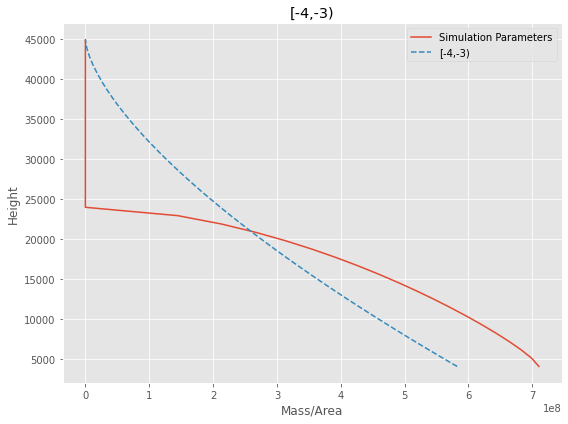

[-4,-3) Run Time: 1.42901 minutes


Mass Test: 12197189537.628078
========[-3,-2)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.97e+03 	1.86e+03 	0.9468 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


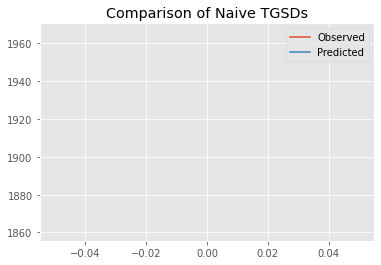

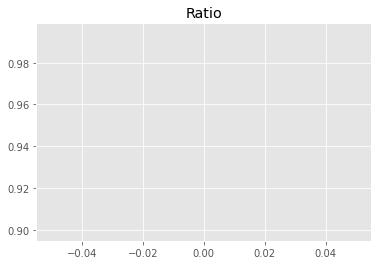

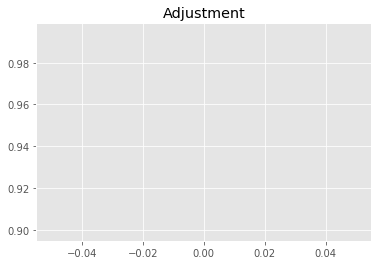

10618191835.996964
1


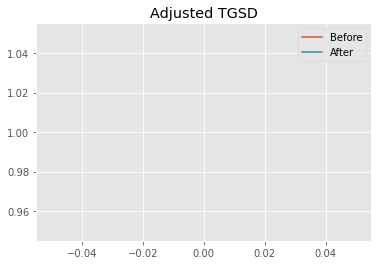

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.9213 	2.02872 	40857.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.88172 	2.02717 	31774.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.217
New Misfit: 24.8594
Convergence:
0.05178313002598356

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.08e+03 	1.86e+03 	0.8932 		1.0000


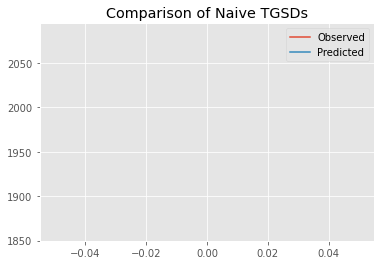

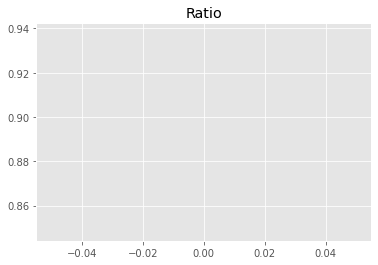

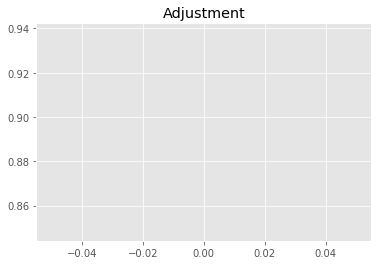

10017011640.937414
1


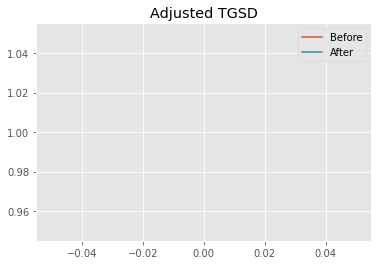

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88172 	2.02717 	31774.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.28042 	2.07904 	41169.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.8594
New Misfit: 24.1161
Convergence:
0.02990125228132168

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.99e+03 	1.86e+03 	0.9358 		1.0000


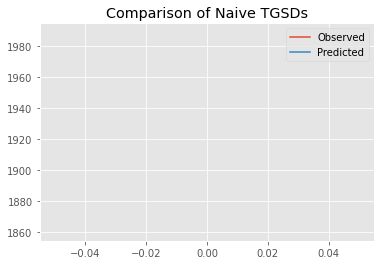

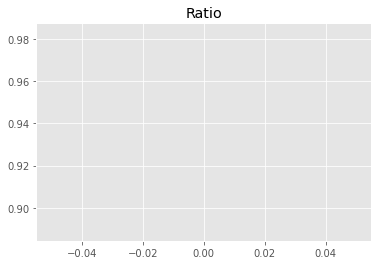

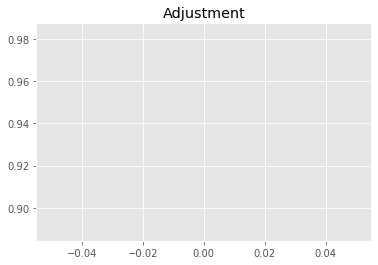

10495335071.56628
1


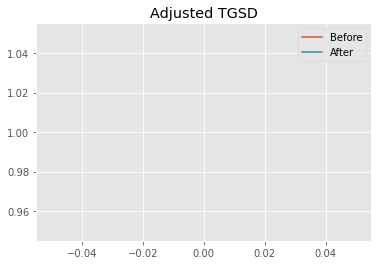

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.28042 	2.07904 	41169.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01364 	1.61006 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.1161
New Misfit: 23.9409
Convergence:
0.007265296351048861

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.92e+03 	1.86e+03 	0.9695 		1.0000


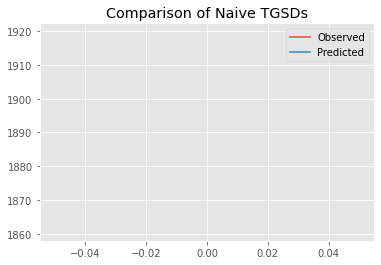

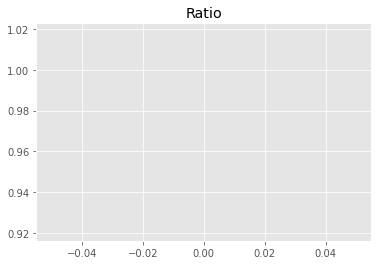

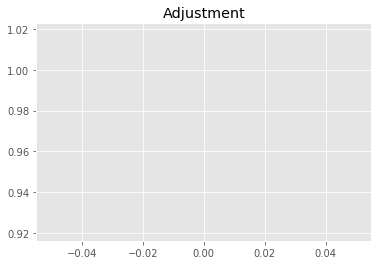

10872844576.613626
1


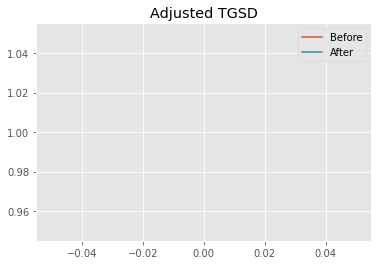

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01364 	1.61006 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.0003 	1.59033 	44707.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9409
New Misfit: 23.9371
Convergence:
0.00015669483350218798

____________________
a = 1.00030	b = 1.59033	            h1 = 44707.08404	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.9371122055764
Prior Misfit: 0.185781,	 Post Misfit: 23.9371


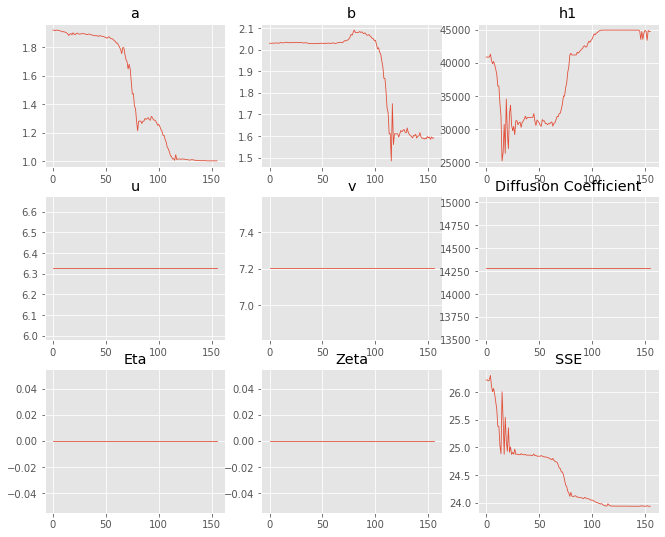

,Priors,Posteriors
a,1.9213,1.0003
b,2.02872,1.59033
h1,"40,857.1","44,707.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.084 minutes


Estimated remaining run time: 0.752 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.18e+03 	1.86e+03 	0.8535 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


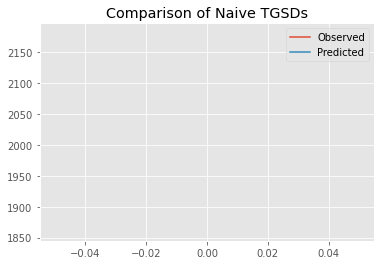

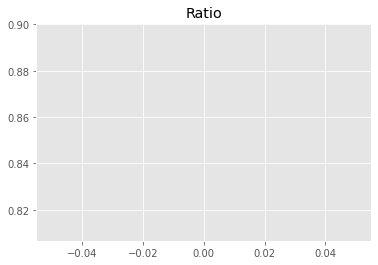

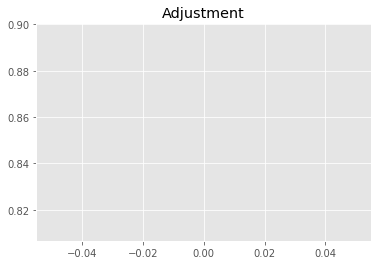

9572259230.174482
1


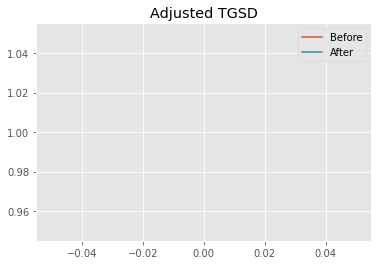

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.59071 	2.13705 	24257.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.57209 	44914.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.8677
New Misfit: 23.9389
Convergence:
0.07456157778144802

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.92e+03 	1.86e+03 	0.9713 		1.0000


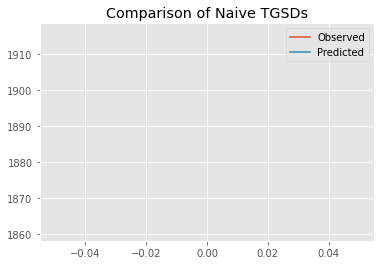

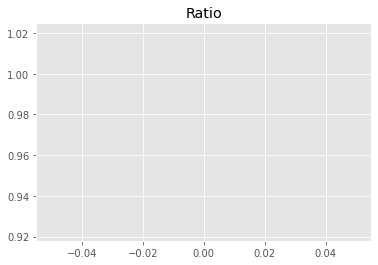

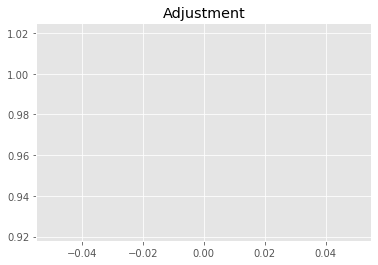

10893672120.468493
1


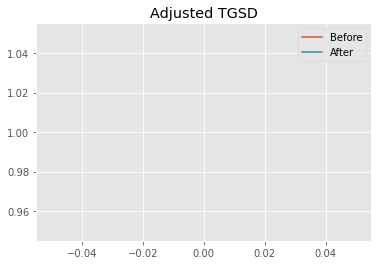

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	1.57209 	44914.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1 	1.59643 	44914.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9389
New Misfit: 23.9371
Convergence:
7.585398928688235e-05

____________________
a = 1.00000	b = 1.59643	            h1 = 44914.56760	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.93710973459995
Prior Misfit: 0.183305,	 Post Misfit: 23.9371


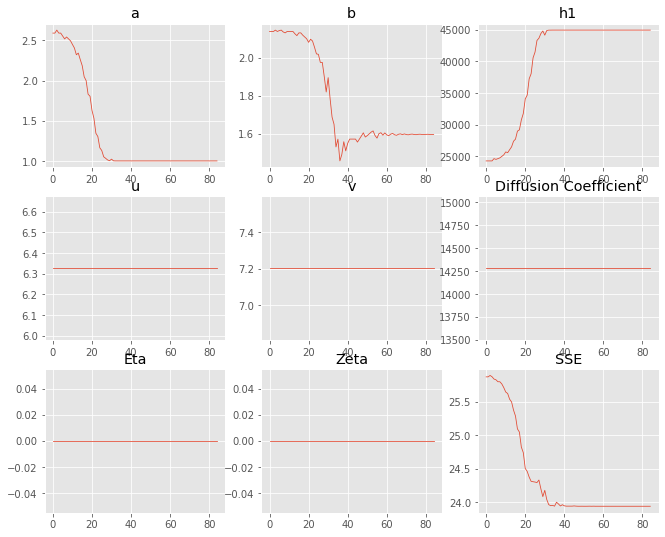

,Priors,Posteriors
a,2.59071,1
b,2.13705,1.59643
h1,"24,257.9","44,914.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.047 minutes


Estimated remaining run time: 0.740 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.94e+03 	1.86e+03 	0.9585 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


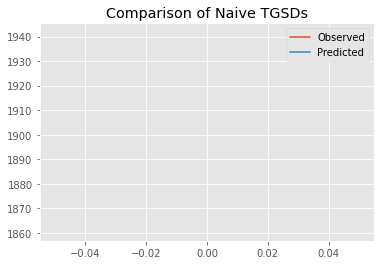

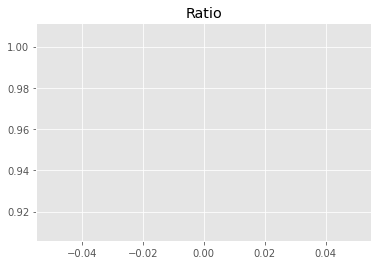

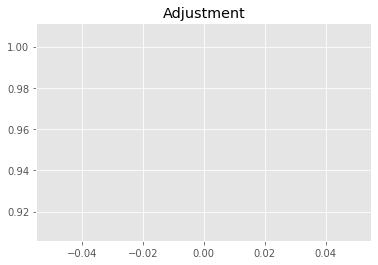

10749805540.20949
1


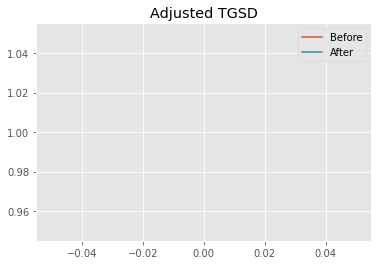

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.41906 	2.74536 	40305.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.80876 	3.60698 	43982.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 29.5825
New Misfit: 24.4942
Convergence:
0.17200459958272127

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.05e+03 	1.86e+03 	0.9085 		1.0000


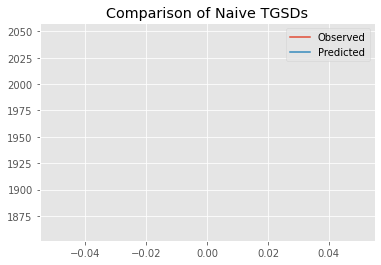

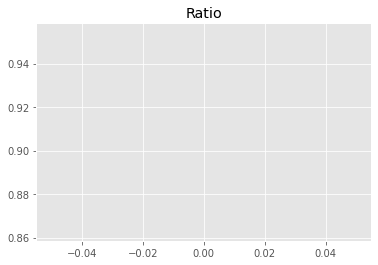

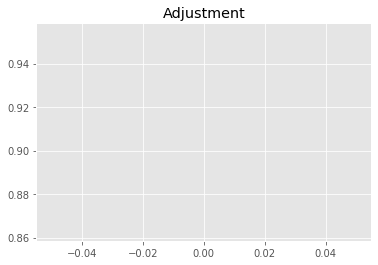

10189024927.359846
1


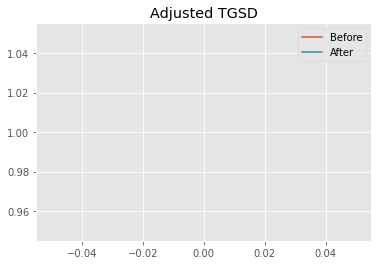

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80876 	3.60698 	43982.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.60904 	2.47812 	40084.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.4942
New Misfit: 24.3526
Convergence:
0.005780090764518195

____________________
a = 1.60904	b = 2.47812	            h1 = 40084.80304	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 24.35258829201694
Prior Misfit: 0.20963,	 Post Misfit: 24.3526


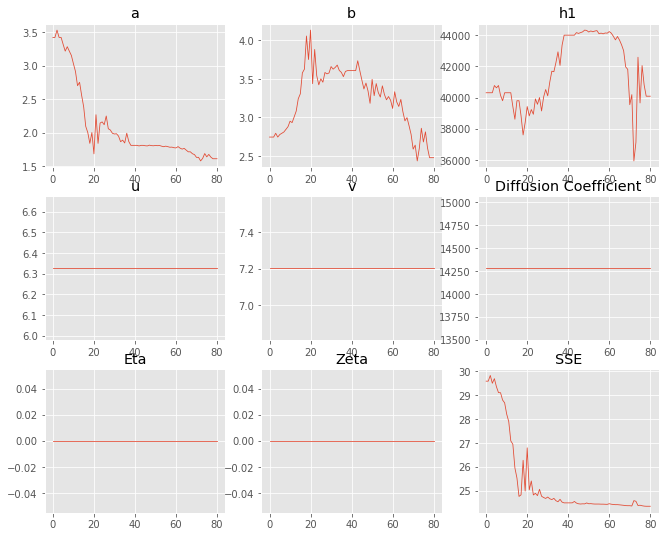

,Priors,Posteriors
a,3.41906,1.60904
b,2.74536,2.47812
h1,"40,305.3","40,084.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.047 minutes


Estimated remaining run time: 0.711 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.09e+03 	1.86e+03 	0.8917 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


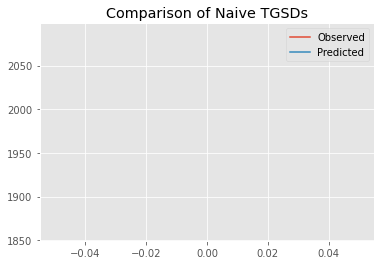

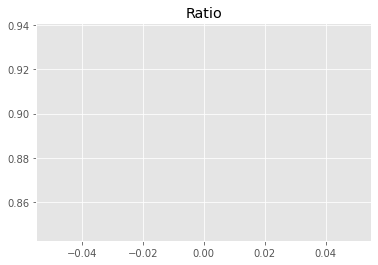

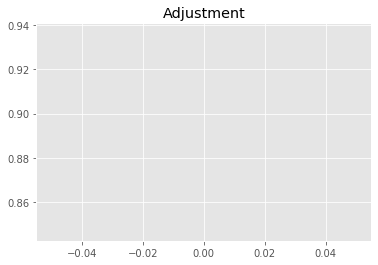

9999971698.050213
1


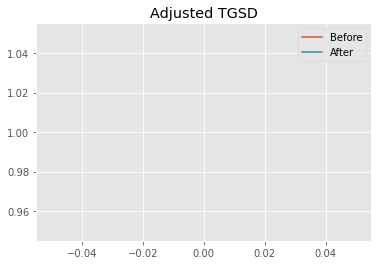

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.64293 	1.54091 	28942.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.46071 	1.87194 	35514.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.7274
New Misfit: 24.3075
Convergence:
0.01698105050272117

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.03e+03 	1.86e+03 	0.9176 		1.0000


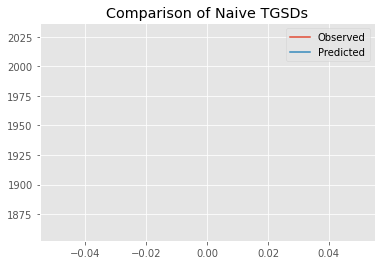

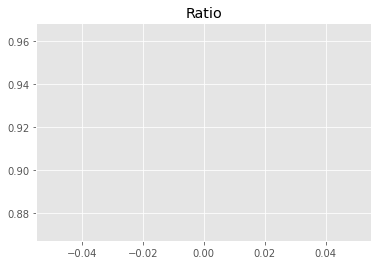

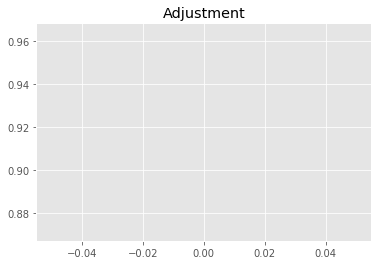

10290686309.714384
1


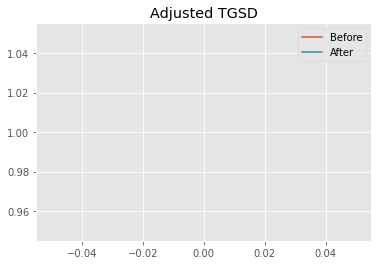

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.46071 	1.87194 	35514.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.22685 	2.05563 	43495 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.3075
New Misfit: 24.0403
Convergence:
0.01099533028926312

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.97e+03 	1.86e+03 	0.9456 		1.0000


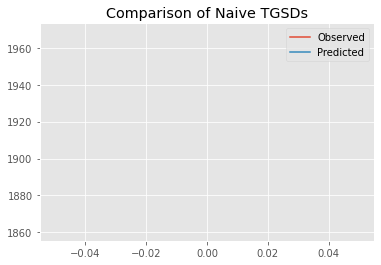

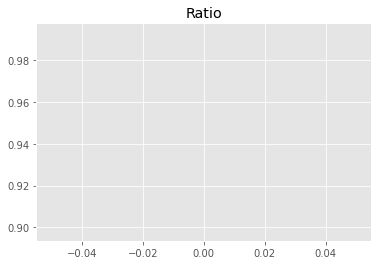

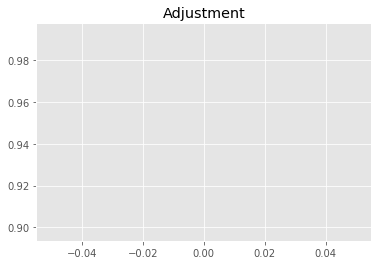

10605107890.249752
1


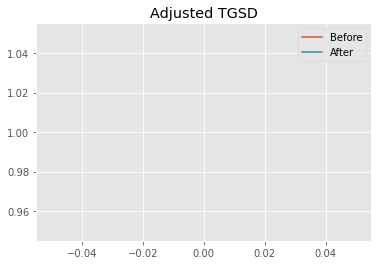

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.22685 	2.05563 	43495 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.07515 	1.74809 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0403
New Misfit: 23.9582
Convergence:
0.003414871801558254

____________________
a = 1.07515	b = 1.74809	            h1 = 44915.00000	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.958160188462163
Prior Misfit: 0.175225,	 Post Misfit: 23.9582


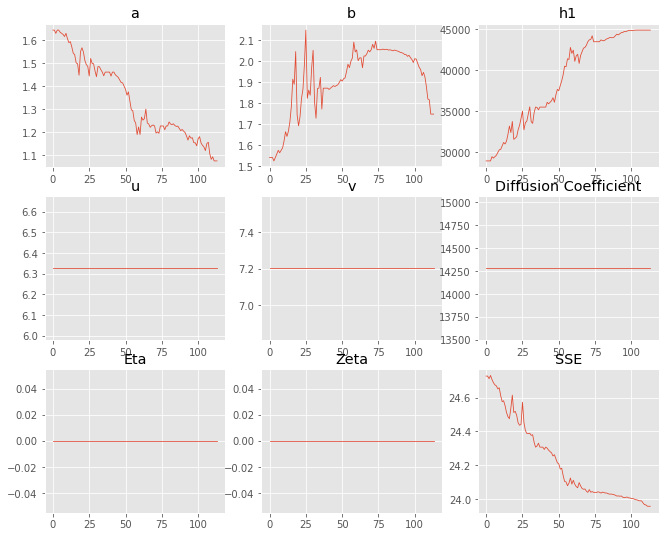

,Priors,Posteriors
a,1.64293,1.07515
b,1.54091,1.74809
h1,"28,942.9","44,915"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.062 minutes


Estimated remaining run time: 0.720 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.09e+03 	1.86e+03 	0.8883 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


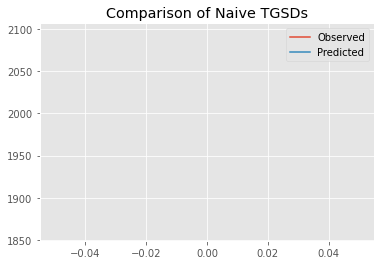

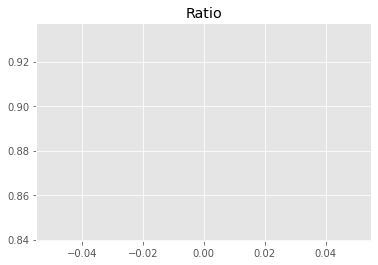

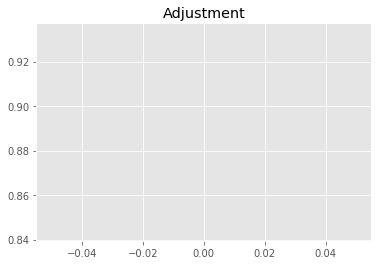

9962813280.622534
1


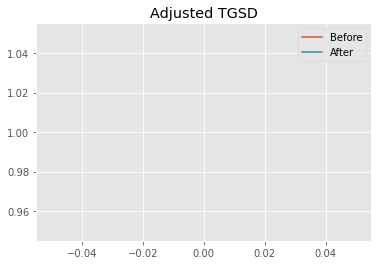

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02295 	1.27843 	27757.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|2.02476 	2.17455 	29515.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.9717
New Misfit: 25.0376
Convergence:
0.03596615252503201

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.12e+03 	1.86e+03 	0.8798 		1.0000


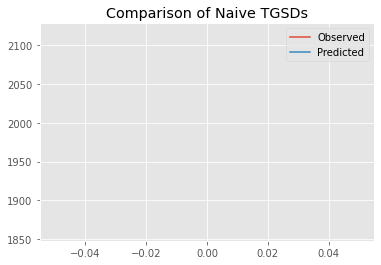

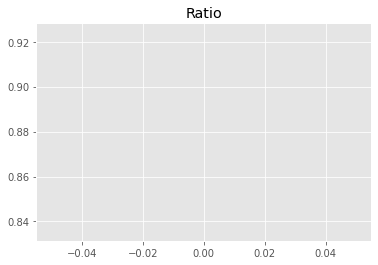

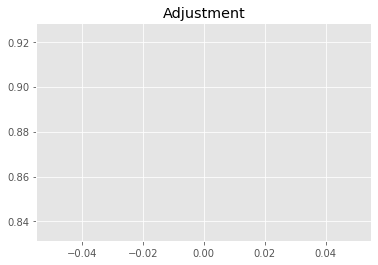

9866719599.299511
1


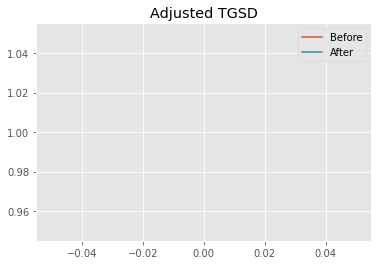

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02476 	2.17455 	29515.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.97408 	3.12534 	37572.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.0376
New Misfit: 24.7177
Convergence:
0.012776346141280393

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.08e+03 	1.86e+03 	0.8954 		1.0000


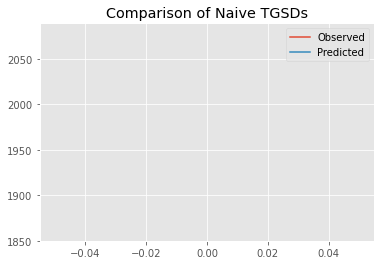

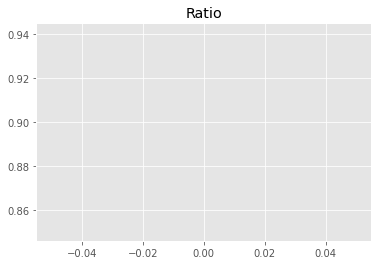

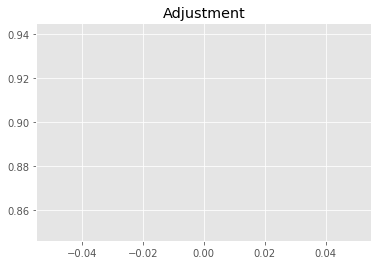

10042316589.504164
1


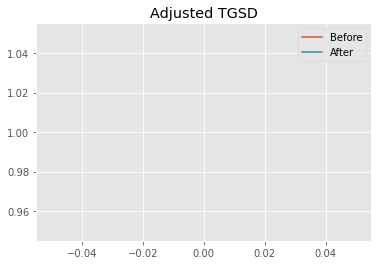

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97408 	3.12534 	37572.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.96526 	3.63097 	43331 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.7177
New Misfit: 24.5997
Convergence:
0.0047734210334063705

____________________
a = 1.96526	b = 3.63097	            h1 = 43331.00670	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 24.59974637094382
Prior Misfit: 0.184043,	 Post Misfit: 24.5997


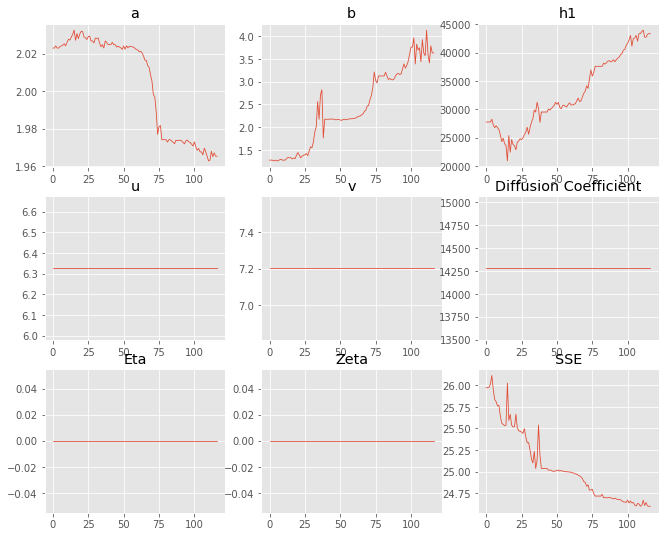

,Priors,Posteriors
a,2.02295,1.96526
b,1.27843,3.63097
h1,"27,757.9","43,331"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.066 minutes


Estimated remaining run time: 0.714 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.07e+03 	1.86e+03 	0.8984 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


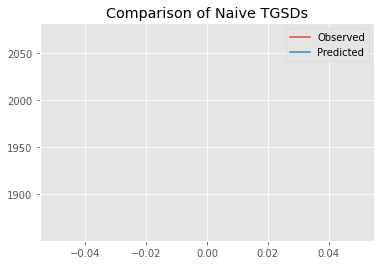

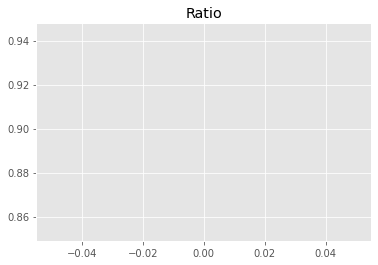

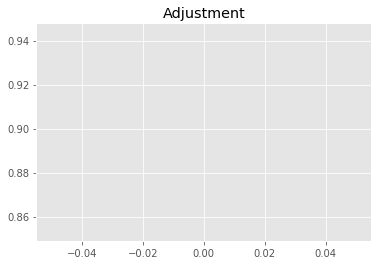

10075377287.154951
1


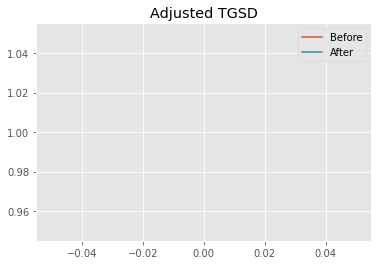

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.7391 	3.92103 	38047.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.66175 	2.68673 	41056.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.3736
New Misfit: 24.3797
Convergence:
0.07560382910401767

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.03e+03 	1.86e+03 	0.9175 		1.0000


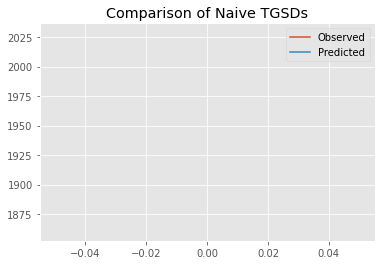

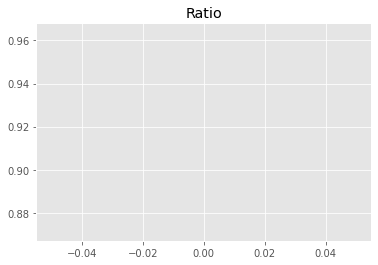

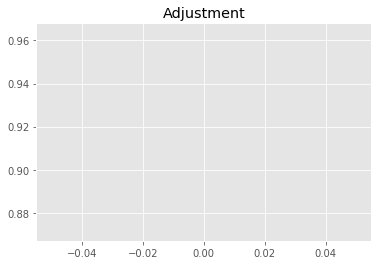

10289342207.870234
1


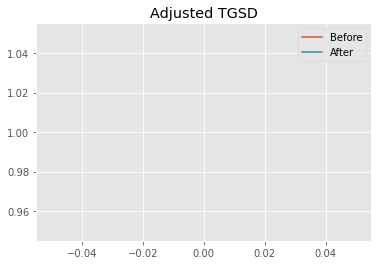

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.66175 	2.68673 	41056.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.05868 	1.71466 	44914.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.3797
New Misfit: 23.9528
Convergence:
0.017510543365981773

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.93e+03 	1.86e+03 	0.9647 		1.0000


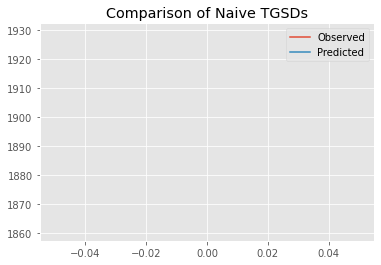

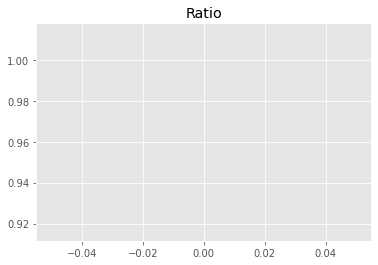

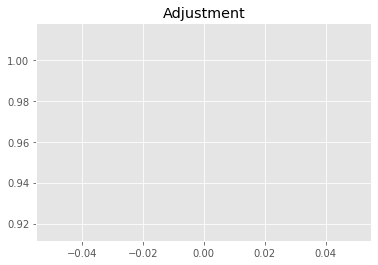

10818897583.42531
1


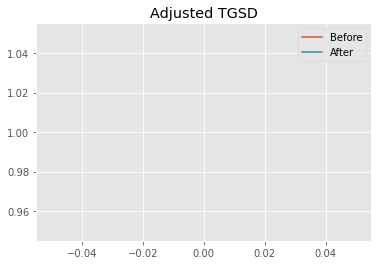

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05868 	1.71466 	44914.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01317 	1.59371 	44088 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9528
New Misfit: 23.9401
Convergence:
0.0005285560545179838

____________________
a = 1.01317	b = 1.59371	            h1 = 44087.95165	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.940114519073735
Prior Misfit: 0.186891,	 Post Misfit: 23.9401


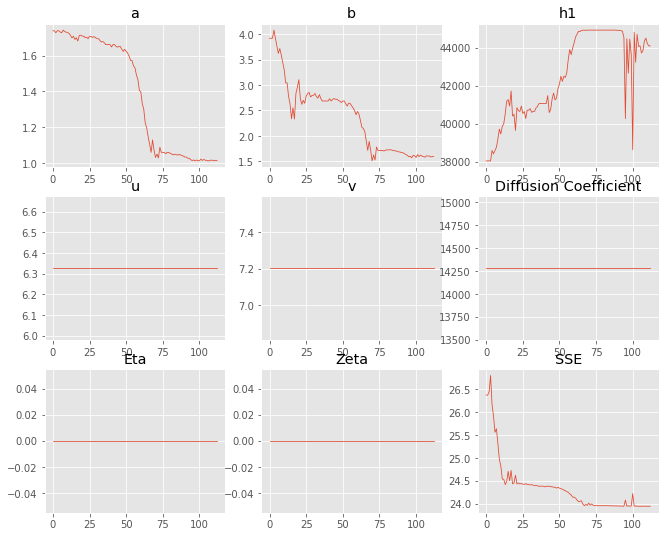

,Priors,Posteriors
a,1.7391,1.01317
b,3.92103,1.59371
h1,"38,047.7","44,088"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.062 minutes


Estimated remaining run time: 0.683 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.05e+03 	1.86e+03 	0.9060 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


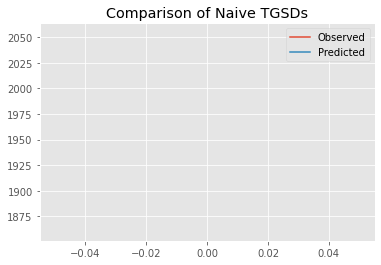

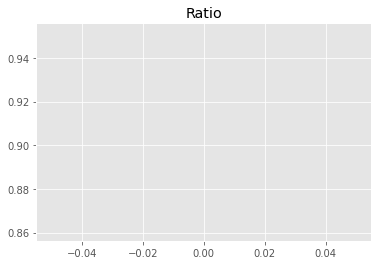

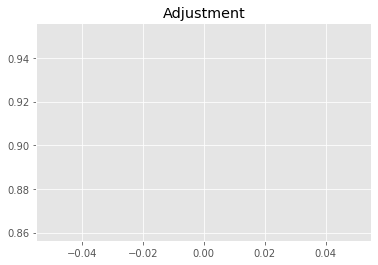

10161365016.245808
1


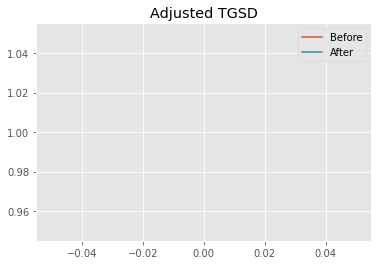

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.81552 	2.28166 	35825.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.69331 	2.89079 	40781.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.7051
New Misfit: 24.4168
Convergence:
0.011667611397744998

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.04e+03 	1.86e+03 	0.9120 		1.0000


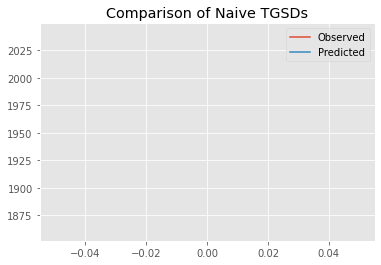

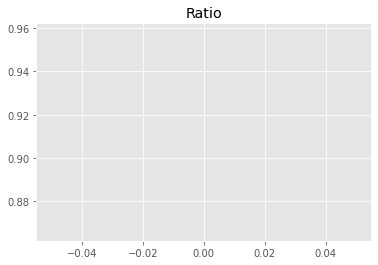

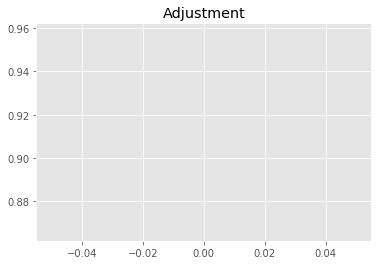

10227846706.036179
1


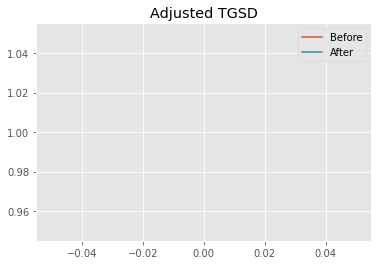

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.69331 	2.89079 	40781.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.05302 	1.70805 	44914.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.4168
New Misfit: 23.951
Convergence:
0.01907826098166547

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.93e+03 	1.86e+03 	0.9649 		1.0000


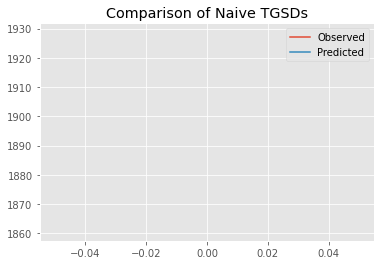

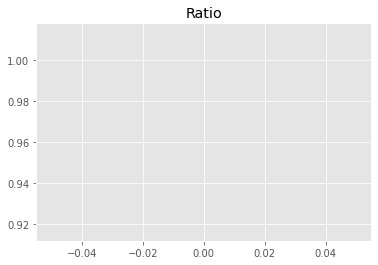

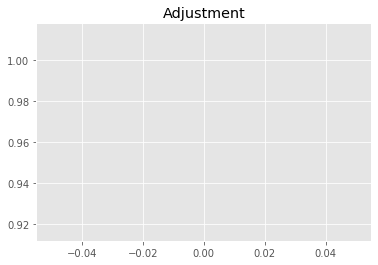

10821918220.600552
1


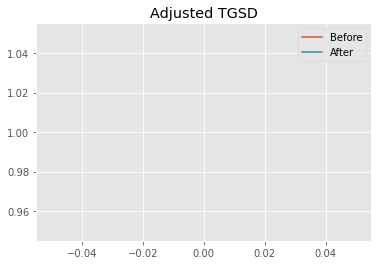

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05302 	1.70805 	44914.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01611 	1.63419 	44752.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.951
New Misfit: 23.9412
Convergence:
0.00040949395713151134

____________________
a = 1.01611	b = 1.63419	            h1 = 44752.48193	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.94119840323719
Prior Misfit: 0.175067,	 Post Misfit: 23.9412


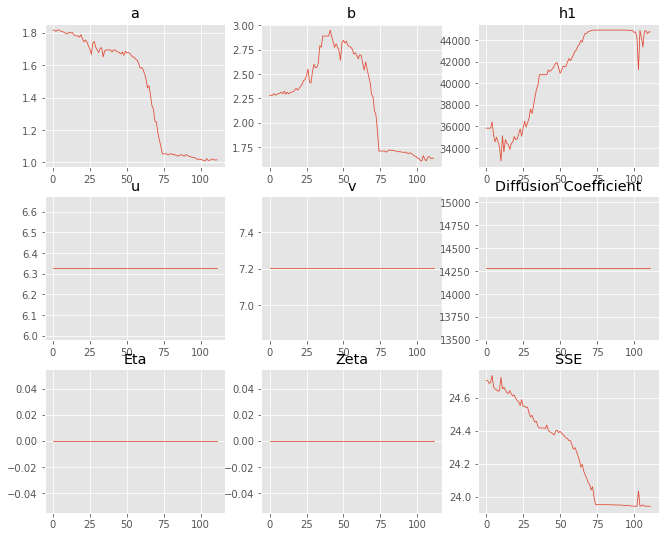

,Priors,Posteriors
a,1.81552,1.01611
b,2.28166,1.63419
h1,"35,825.3","44,752.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.064 minutes


Estimated remaining run time: 0.647 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.16e+03 	1.86e+03 	0.8629 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


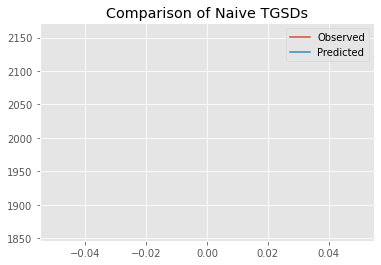

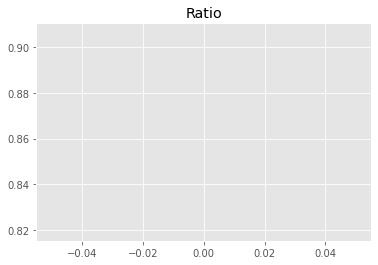

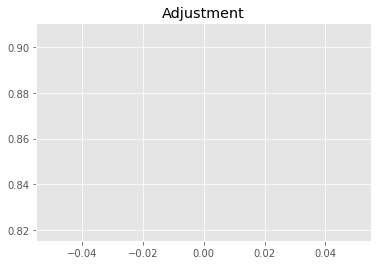

9677055370.108776
1


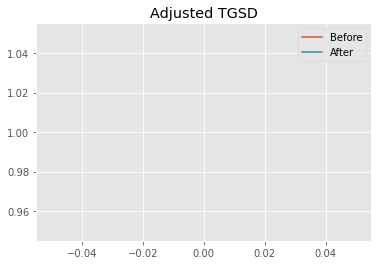

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.87402 	2.09681 	26969.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.40702 	2.1972 	37620.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.421
New Misfit: 24.3566
Convergence:
0.07813566302777859

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.03e+03 	1.86e+03 	0.9186 		1.0000


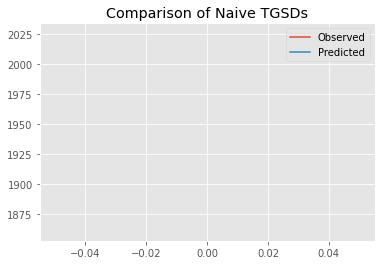

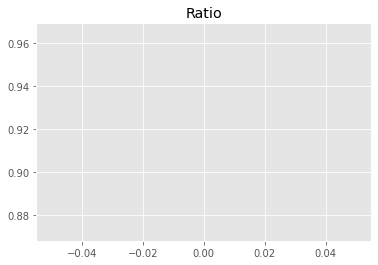

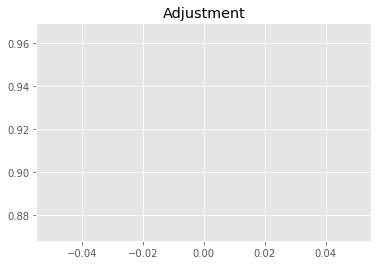

10301991136.45381
1


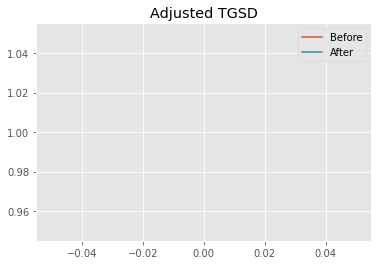

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.40702 	2.1972 	37620.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.05339 	1.64194 	44600.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.3566
New Misfit: 23.9588
Convergence:
0.016334405610944184

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.92e+03 	1.86e+03 	0.9672 		1.0000


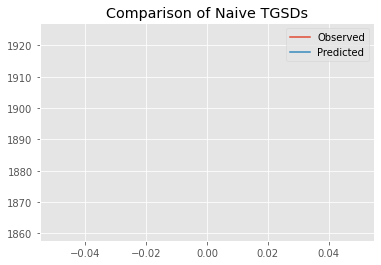

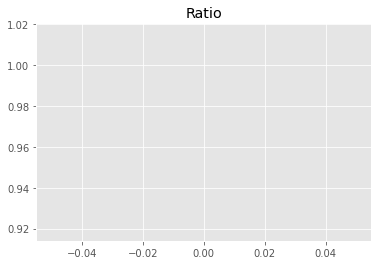

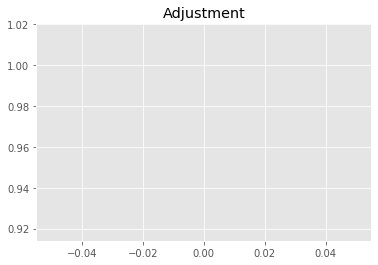

10847502591.069963
1


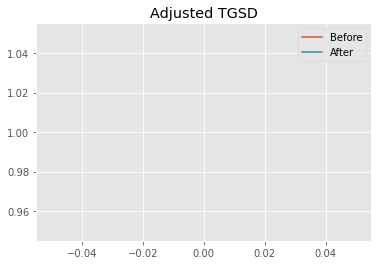

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05339 	1.64194 	44600.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00715 	1.55666 	43682.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9588
New Misfit: 23.9381
Convergence:
0.0008609006094155323

____________________
a = 1.00715	b = 1.55666	            h1 = 43682.53932	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.938135443130804
Prior Misfit: 0.187227,	 Post Misfit: 23.9381


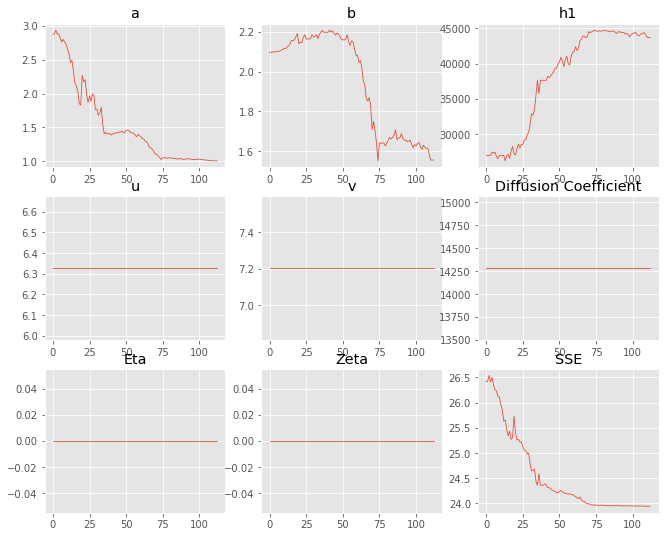

,Priors,Posteriors
a,2.87402,1.00715
b,2.09681,1.55666
h1,"26,969.3","43,682.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.065 minutes


Estimated remaining run time: 0.607 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.22e+03 	1.86e+03 	0.8396 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


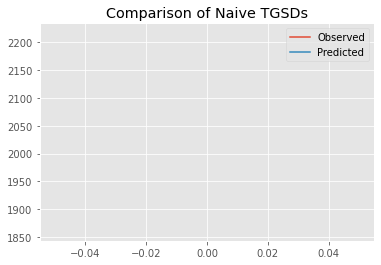

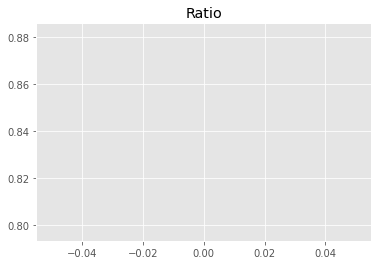

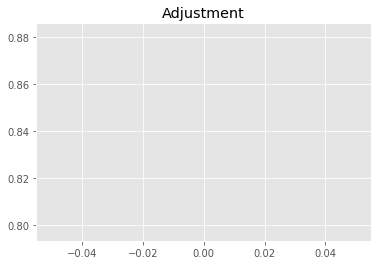

9416166215.417784
1


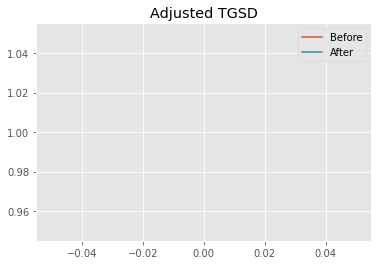

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.90502 	3.6696 	21834.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.08965 	1.3188 	36683.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 27.4186
New Misfit: 24.0091
Convergence:
0.12435031631673317

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.97e+03 	1.86e+03 	0.9464 		1.0000


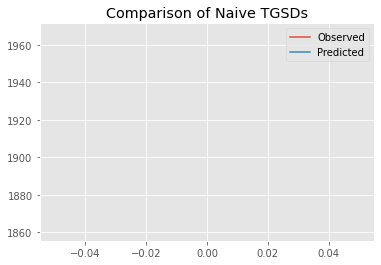

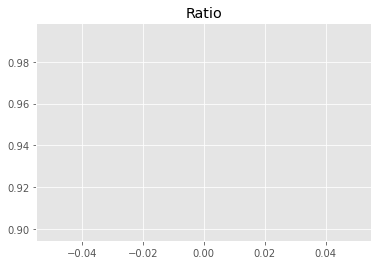

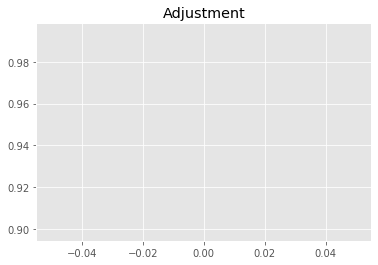

10613677240.711704
1


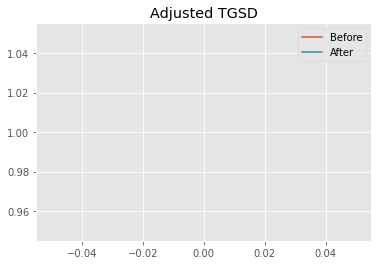

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.08965 	1.3188 	36683.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.04134 	1.59527 	43157.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0091
New Misfit: 23.9487
Convergence:
0.002511868182361526

____________________
a = 1.04134	b = 1.59527	            h1 = 43157.66475	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.9487448379414
Prior Misfit: 0.194295,	 Post Misfit: 23.9487


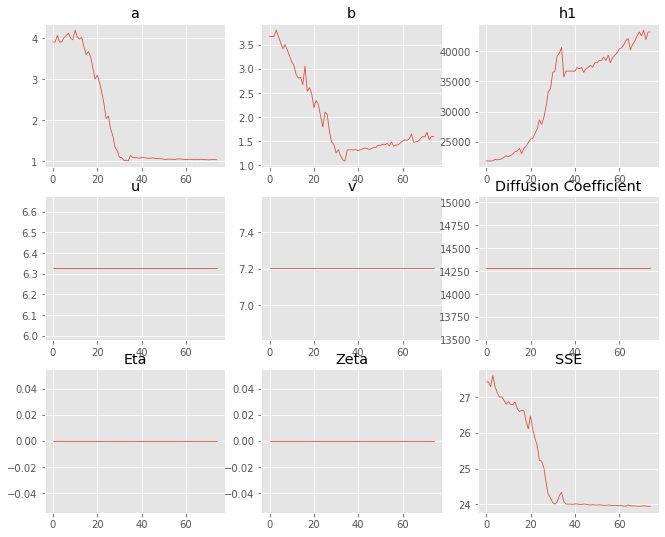

,Priors,Posteriors
a,3.90502,1.04134
b,3.6696,1.59527
h1,"21,834.3","43,157.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.046 minutes


Estimated remaining run time: 0.543 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.12e+03 	1.86e+03 	0.8772 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


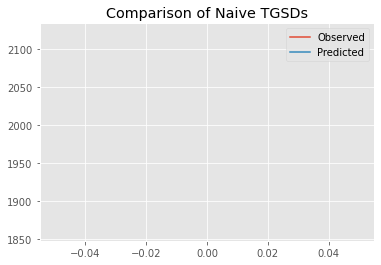

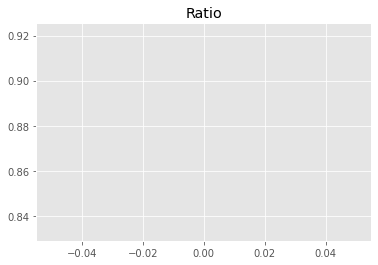

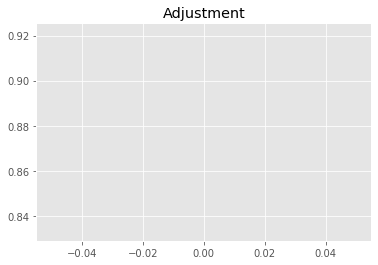

9837622421.574257
1


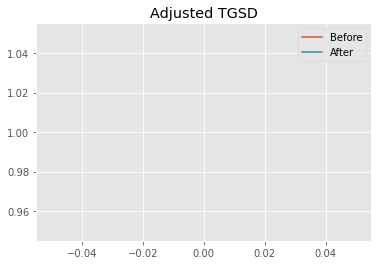

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.71051 	4.13876 	37159.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.13927 	1.9281 	44911.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.4043
New Misfit: 23.9861
Convergence:
0.05582548150598884

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.95e+03 	1.86e+03 	0.9557 		1.0000


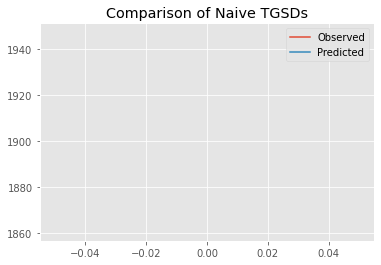

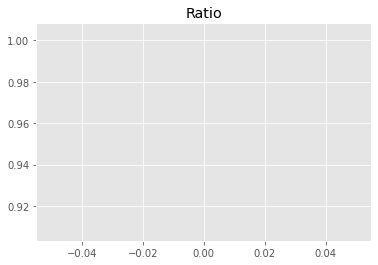

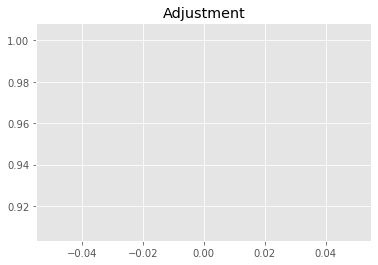

10718262765.636892
1


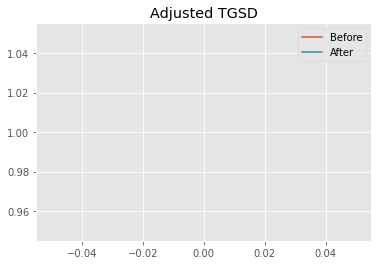

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.13927 	1.9281 	44911.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.03039 	1.59231 	43520.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9861
New Misfit: 23.9449
Convergence:
0.0017194572220858857

____________________
a = 1.03039	b = 1.59231	            h1 = 43520.15028	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.94487378531842
Prior Misfit: 0.180022,	 Post Misfit: 23.9449


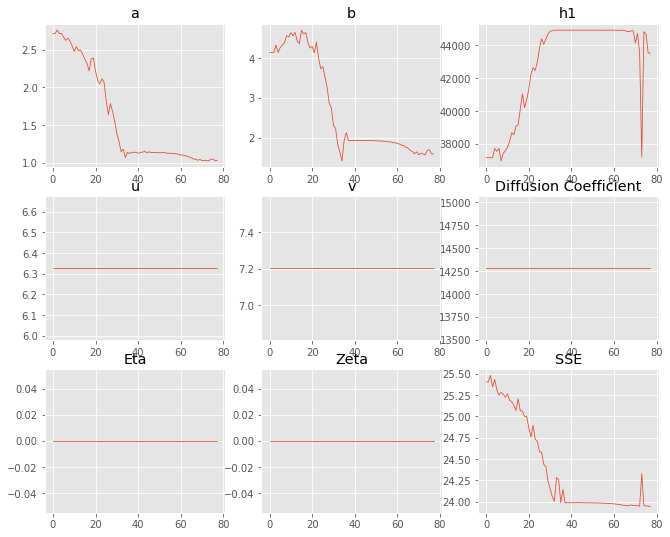

,Priors,Posteriors
a,2.71051,1.03039
b,4.13876,1.59231
h1,"37,159.5","43,520.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.048 minutes


Estimated remaining run time: 0.483 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.19e+03 	1.86e+03 	0.8487 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


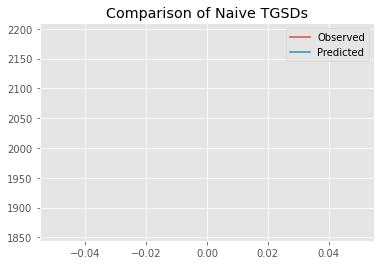

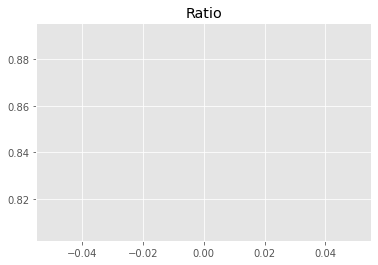

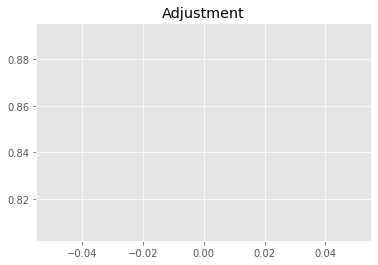

9517947994.449852
1


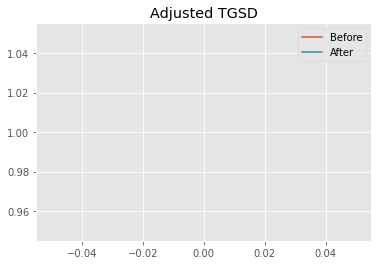

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.45557 	3.19584 	27045.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.12952 	1.64853 	41326.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.3317
New Misfit: 23.9935
Convergence:
0.08879851142030999

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.95e+03 	1.86e+03 	0.9528 		1.0000


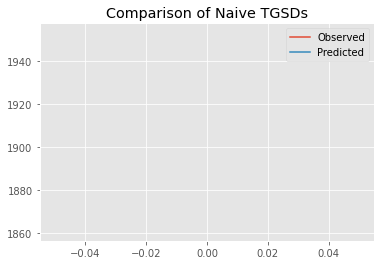

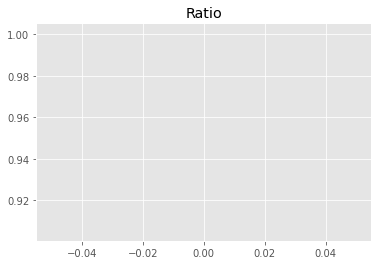

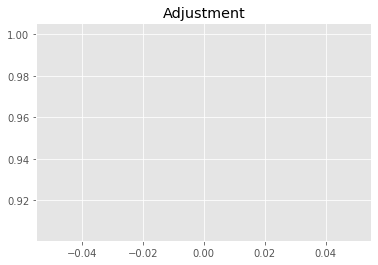

10685963977.239662
1


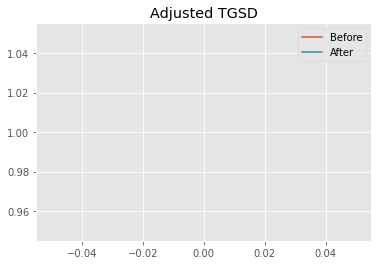

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.12952 	1.64853 	41326.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00058 	1.58327 	44906.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9935
New Misfit: 23.9378
Convergence:
0.002317620545146486

____________________
a = 1.00058	b = 1.58327	            h1 = 44906.50834	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.937842462988737
Prior Misfit: 0.186593,	 Post Misfit: 23.9378


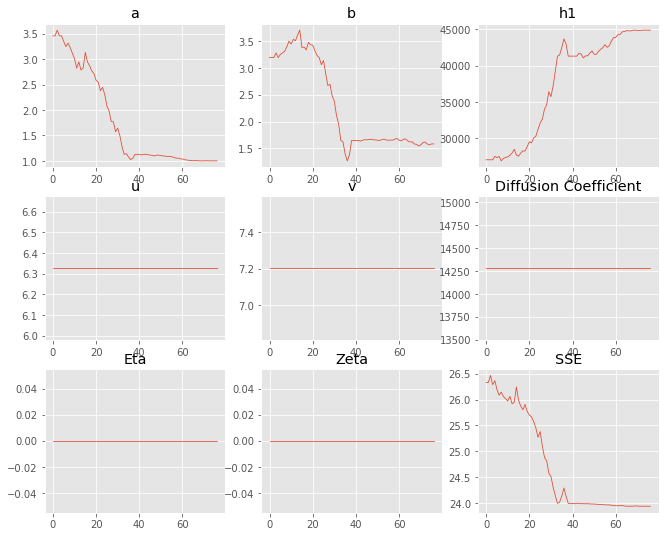

,Priors,Posteriors
a,3.45557,1.00058
b,3.19584,1.58327
h1,"27,045.9","44,906.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.044 minutes


Estimated remaining run time: 0.423 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.05e+03 	1.86e+03 	0.9058 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


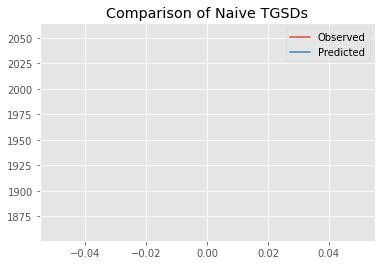

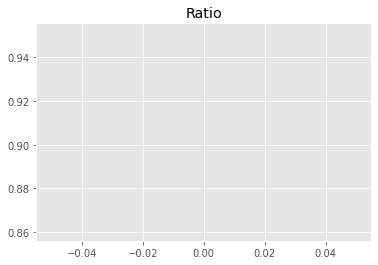

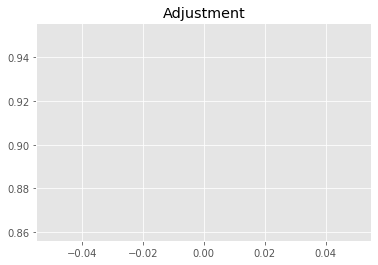

10158345880.073412
1


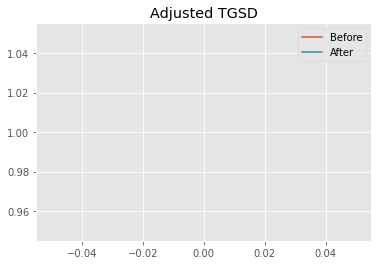

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.85665 	4.38448 	44727.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|2.26407 	5.03363 	44836.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.4108
New Misfit: 24.872
Convergence:
0.05826271647840566

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.09e+03 	1.86e+03 	0.8905 		1.0000


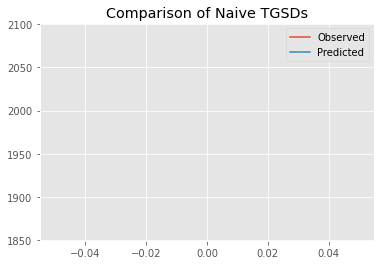

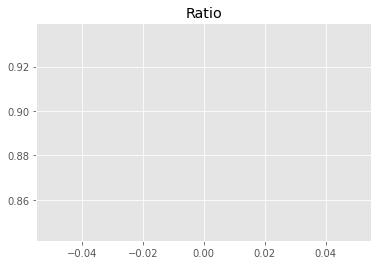

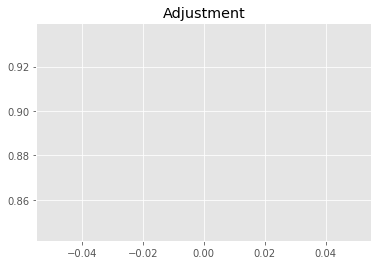

9987186375.875168
1


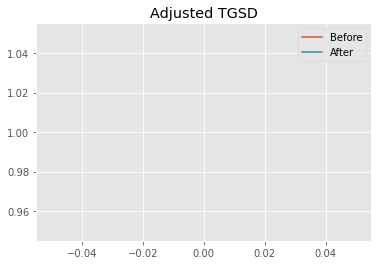

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.26407 	5.03363 	44836.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.61169 	2.92322 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.872
New Misfit: 24.2899
Convergence:
0.02340261971204232

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.01e+03 	1.86e+03 	0.9254 		1.0000


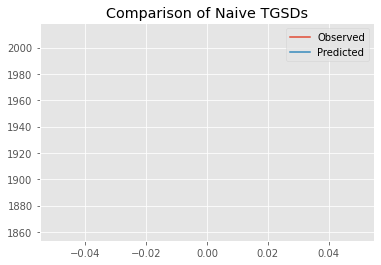

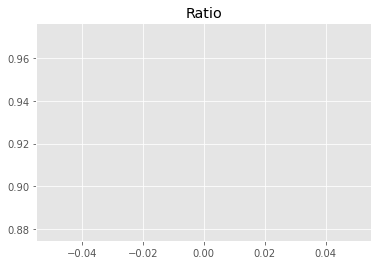

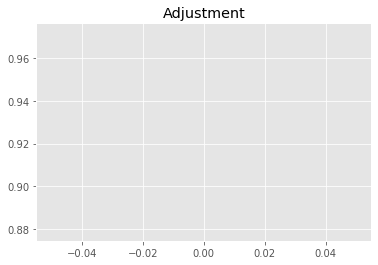

10378172359.560837
1


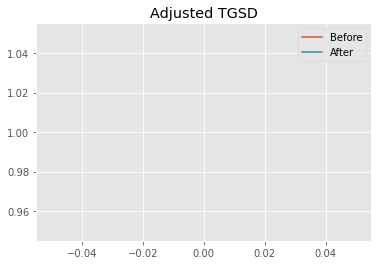

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.61169 	2.92322 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.25445 	2.06412 	43898.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.2899
New Misfit: 24.0456
Convergence:
0.010059471603763477

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.96e+03 	1.86e+03 	0.9470 		1.0000


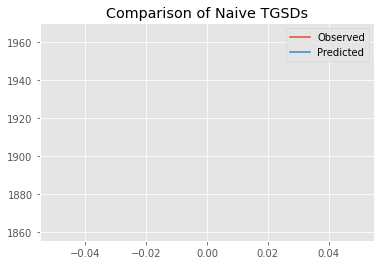

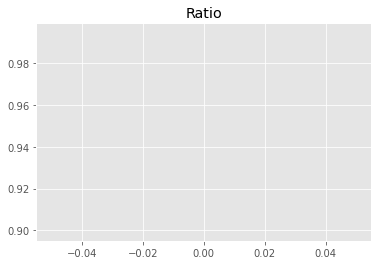

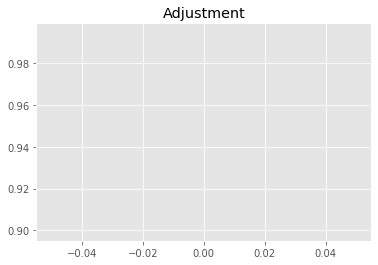

10621200476.65869
1


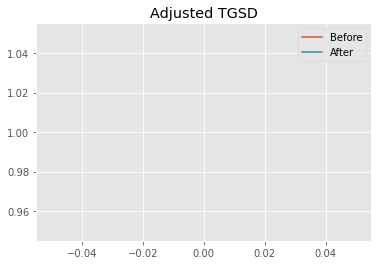

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.25445 	2.06412 	43898.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.04924 	1.69759 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0456
New Misfit: 23.9499
Convergence:
0.003980645341232308

____________________
a = 1.04924	b = 1.69759	            h1 = 44915.00000	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.949858015385136
Prior Misfit: 0.187154,	 Post Misfit: 23.9499


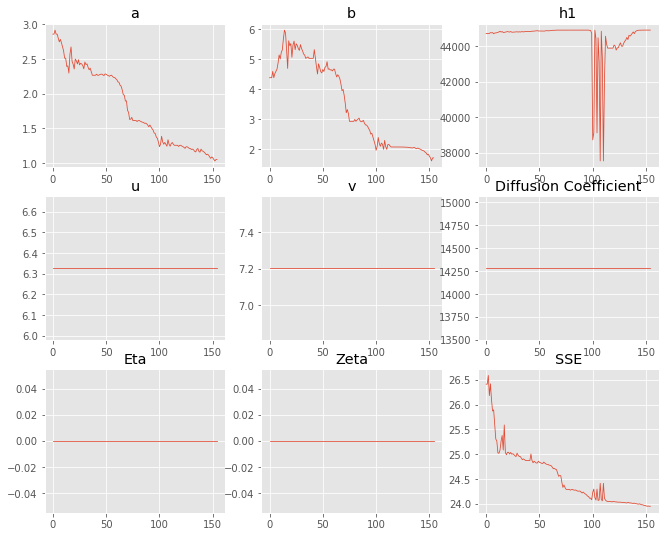

,Priors,Posteriors
a,2.85665,1.04924
b,4.38448,1.69759
h1,"44,727.6","44,915"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.078 minutes


Estimated remaining run time: 0.383 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.12e+03 	1.86e+03 	0.8774 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


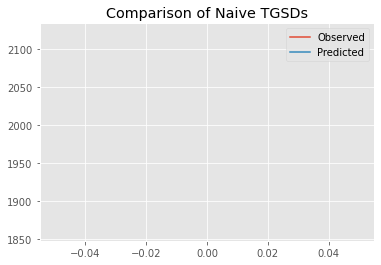

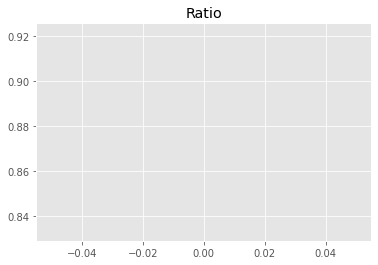

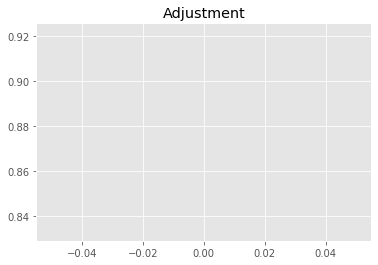

9840575724.884834
1


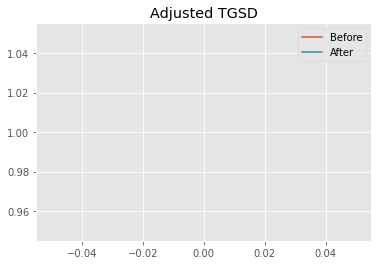

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.77113 	1.59361 	26114.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.41095 	2.10436 	38422.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.07
New Misfit: 24.2303
Convergence:
0.03349301741811523

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9235 		1.0000


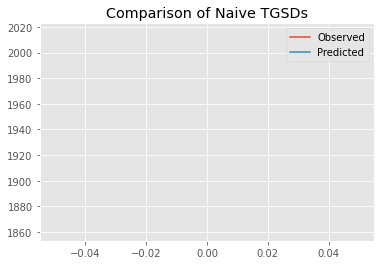

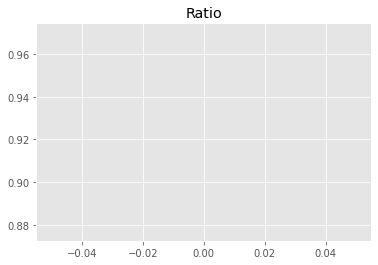

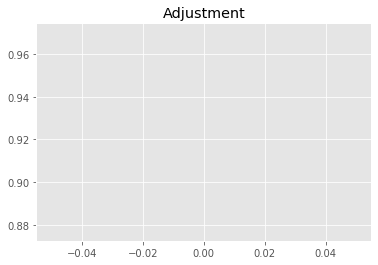

10356633149.800327
1


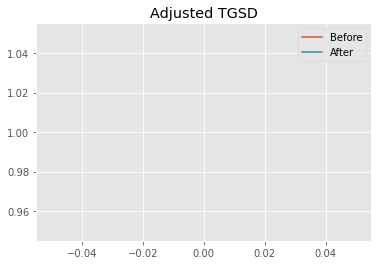

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.41095 	2.10436 	38422.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.14643 	1.95302 	44803.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.2303
New Misfit: 23.9927
Convergence:
0.009807349231568629

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.95e+03 	1.86e+03 	0.9544 		1.0000


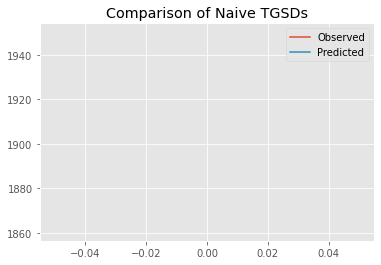

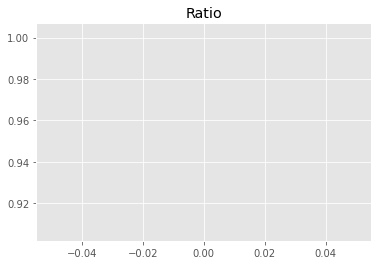

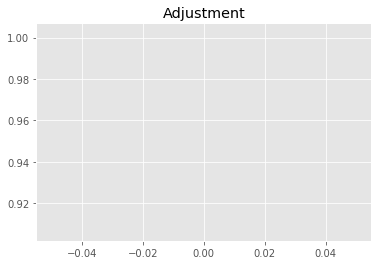

10703109620.624176
1


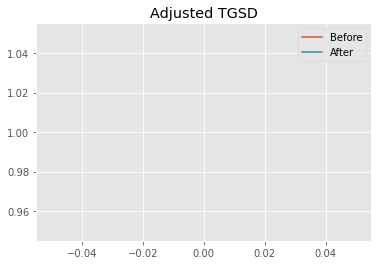

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.14643 	1.95302 	44803.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.02296 	1.63175 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9927
New Misfit: 23.943
Convergence:
0.0020708667786438636

____________________
a = 1.02296	b = 1.63175	            h1 = 44914.97524	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.942979913940288
Prior Misfit: 0.177653,	 Post Misfit: 23.943


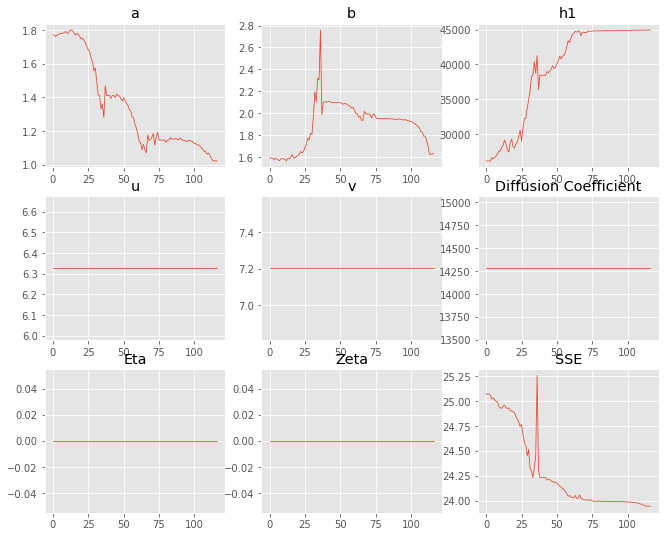

,Priors,Posteriors
a,1.77113,1.02296
b,1.59361,1.63175
h1,"26,114.9","44,915"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.064 minutes


Estimated remaining run time: 0.333 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.13e+03 	1.86e+03 	0.8749 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


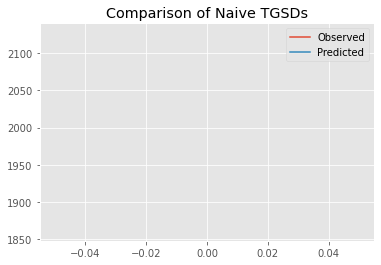

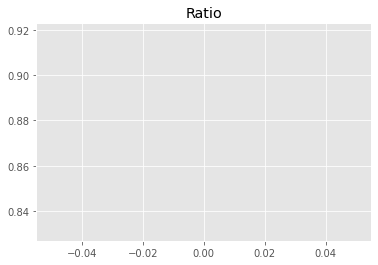

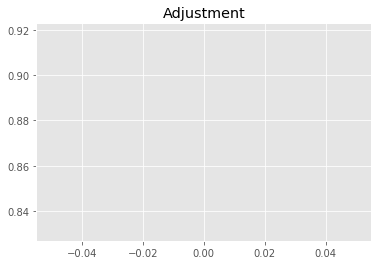

9811668131.88246
1


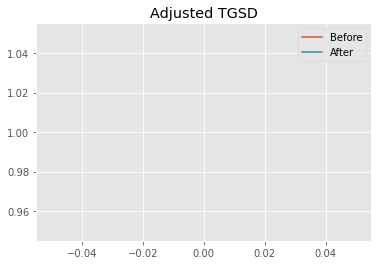

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.26973 	1.82595 	27934.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.15654 	1.40857 	36068.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.6317
New Misfit: 24.0594
Convergence:
0.061344590387025937

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.98e+03 	1.86e+03 	0.9380 		1.0000


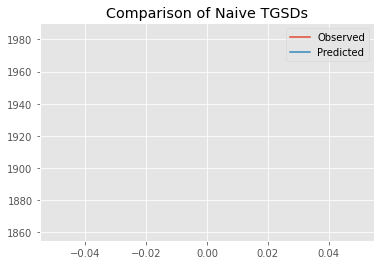

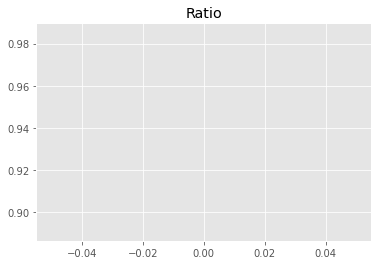

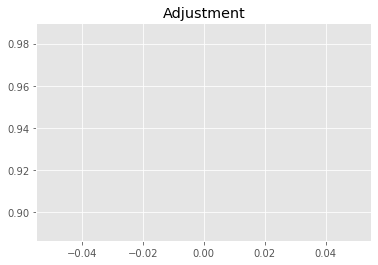

10519544648.986061
1


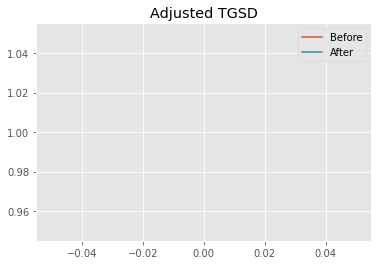

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.15654 	1.40857 	36068.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.06368 	1.53039 	41347.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0594
New Misfit: 23.9621
Convergence:
0.004041347792555313

____________________
a = 1.06368	b = 1.53039	            h1 = 41347.90369	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.962124987608895
Prior Misfit: 0.181633,	 Post Misfit: 23.9621


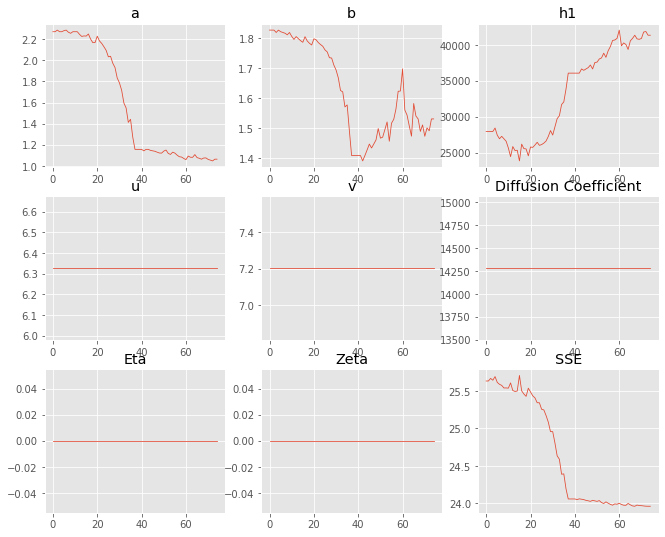

,Priors,Posteriors
a,2.26973,1.06368
b,1.82595,1.53039
h1,"27,934.8","41,347.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.046 minutes


Estimated remaining run time: 0.274 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.09e+03 	1.86e+03 	0.8902 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


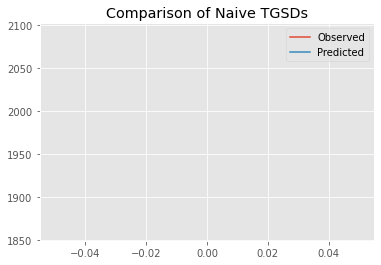

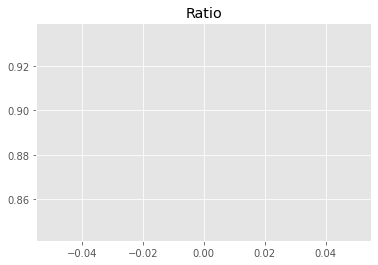

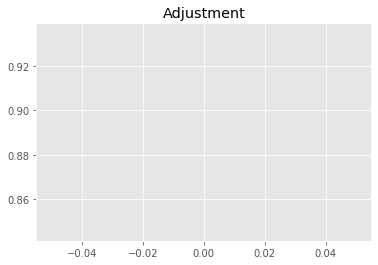

9984149684.799091
1


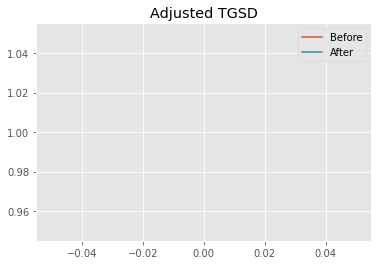

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.59561 	4.78813 	43873.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.38335 	2.41912 	44913.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.2713
New Misfit: 24.1193
Convergence:
0.04558578462936285

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.98e+03 	1.86e+03 	0.9390 		1.0000


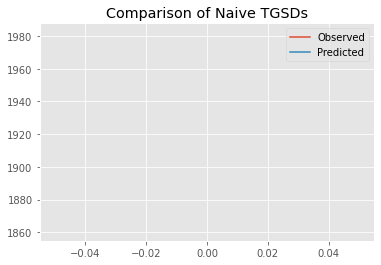

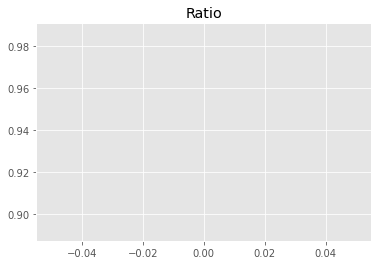

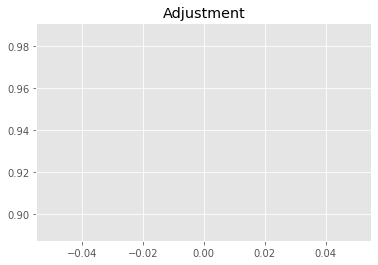

10530609461.721836
1


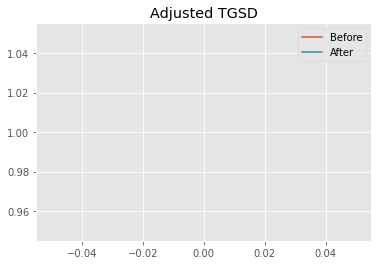

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.38335 	2.41912 	44913.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.06205 	1.69742 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.1193
New Misfit: 23.9559
Convergence:
0.006774930546220743

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.93e+03 	1.86e+03 	0.9656 		1.0000


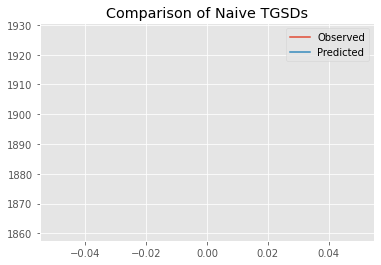

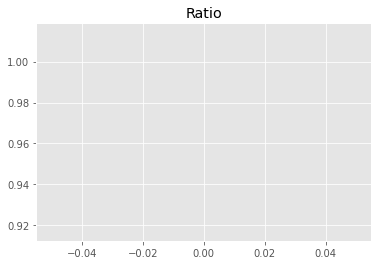

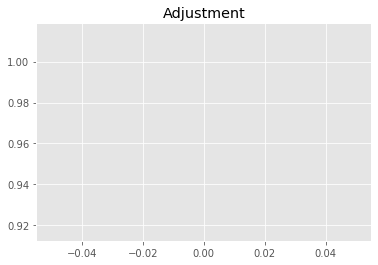

10828760726.979464
1


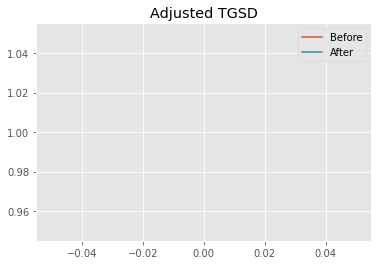

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.06205 	1.69742 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.01172 	1.59855 	44579.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9559
New Misfit: 23.94
Convergence:
0.0006649362793492153

____________________
a = 1.01172	b = 1.59855	            h1 = 44579.13557	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.939967374390246
Prior Misfit: 0.179079,	 Post Misfit: 23.94


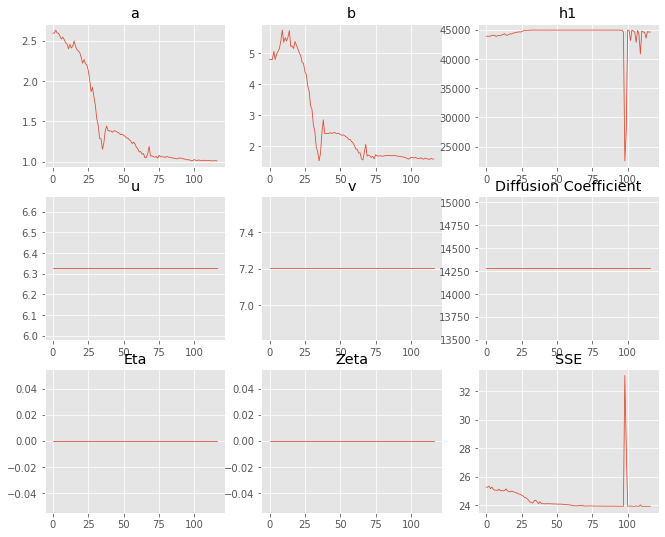

,Priors,Posteriors
a,2.59561,1.01172
b,4.78813,1.59855
h1,"43,873.3","44,579.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.061 minutes


Estimated remaining run time: 0.221 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.04e+03 	1.86e+03 	0.9120 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


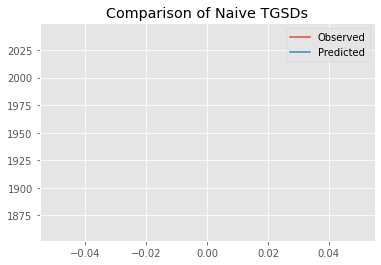

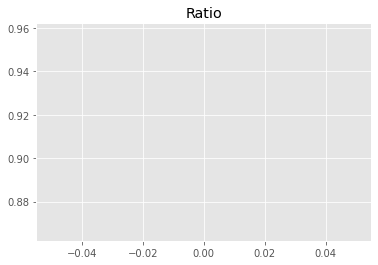

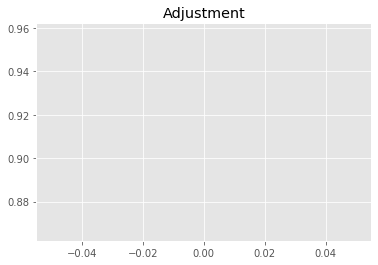

10228616069.835993
1


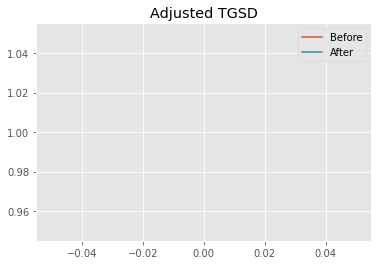

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.27032 	1.93215 	33055.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.4257 	1.93285 	37208.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.1198
New Misfit: 24.245
Convergence:
0.03482459687905304

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.02e+03 	1.86e+03 	0.9232 		1.0000


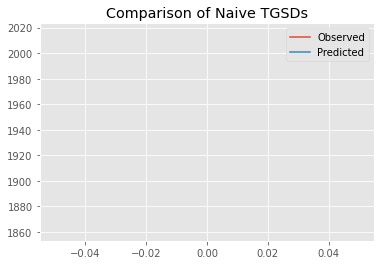

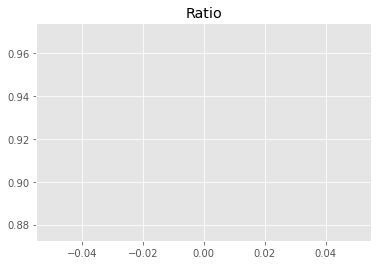

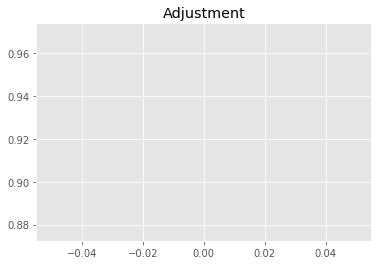

10354043190.694489
1


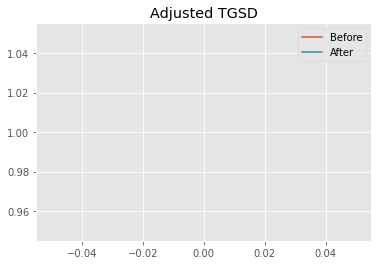

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.4257 	1.93285 	37208.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.19125 	2.05262 	44263.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.245
New Misfit: 24.0256
Convergence:
0.009052743216042868

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.96e+03 	1.86e+03 	0.9487 		1.0000


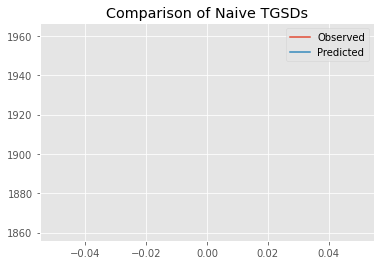

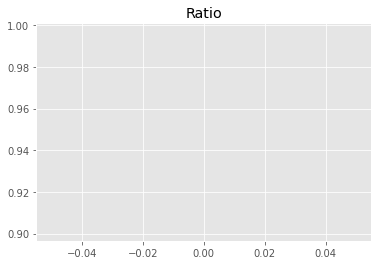

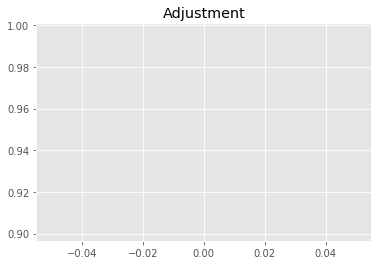

10639847735.08536
1


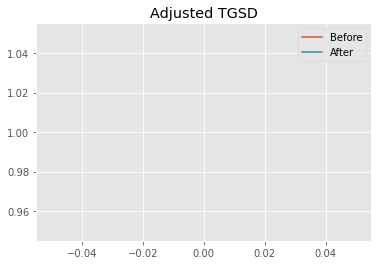

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19125 	2.05262 	44263.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.05788 	1.75808 	44915 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0256
New Misfit: 23.9571
Convergence:
0.002848368392328301

____________________
a = 1.05788	b = 1.75808	            h1 = 44915.00000	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.95711920590066
Prior Misfit: 0.178006,	 Post Misfit: 23.9571


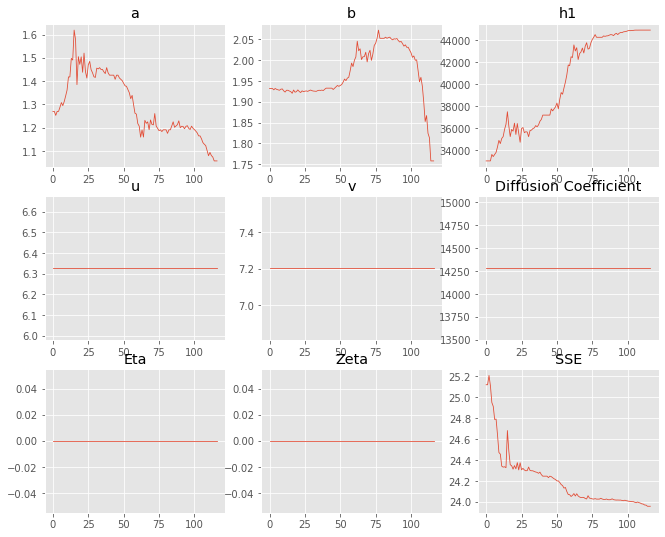

,Priors,Posteriors
a,1.27032,1.05788
b,1.93215,1.75808
h1,"33,055.4","44,915"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.065 minutes


Estimated remaining run time: 0.167 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.00e+03 	1.86e+03 	0.9285 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


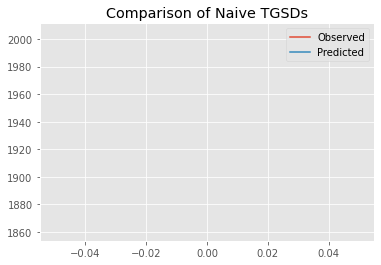

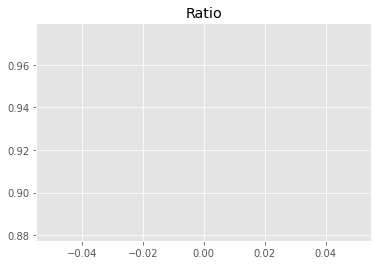

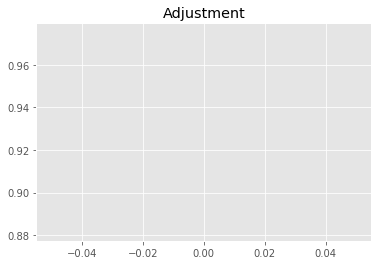

10412617783.383385
1


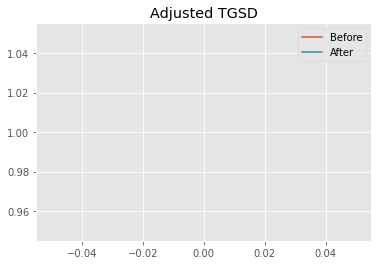

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05015 	1.29051 	32844.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00677 	1.2602 	38117.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.2636
New Misfit: 23.9527
Convergence:
0.012813140035974824

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.95e+03 	1.86e+03 	0.9561 		1.0000


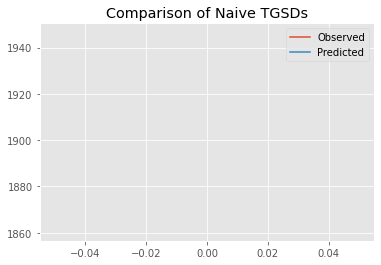

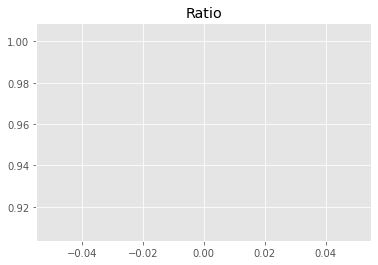

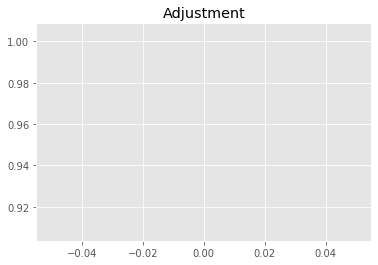

10723181183.507513
1


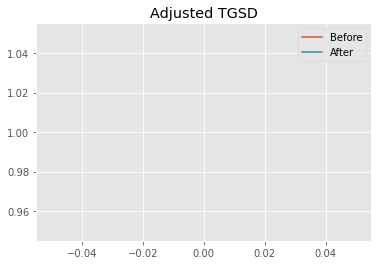

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00677 	1.2602 	38117.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00378 	1.42923 	41304.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9527
New Misfit: 23.9385
Convergence:
0.0005932217180719743

____________________
a = 1.00378	b = 1.42923	            h1 = 41304.45433	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 23.938488985763325
Prior Misfit: 0.171938,	 Post Misfit: 23.9385


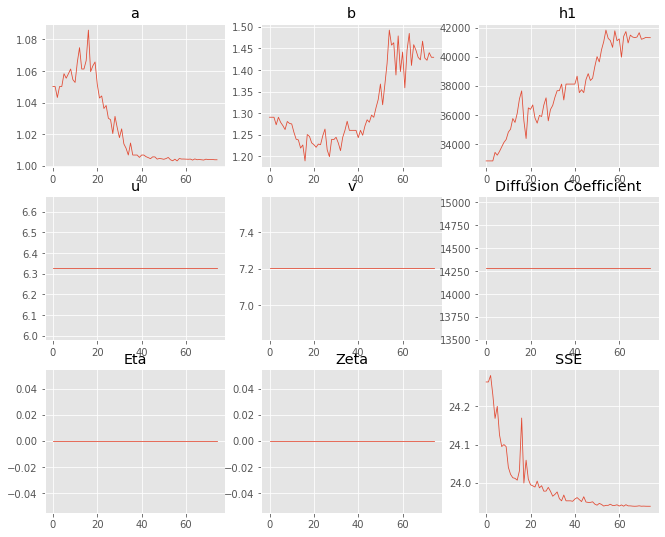

,Priors,Posteriors
a,1.05015,1.00378
b,1.29051,1.42923
h1,"32,844.1","41,304.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.046 minutes


Estimated remaining run time: 0.111 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.15e+03 	1.86e+03 	0.8639 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


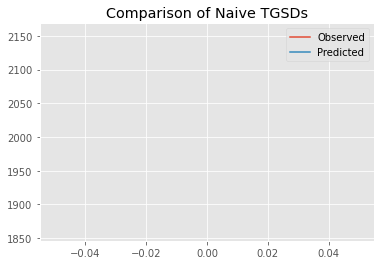

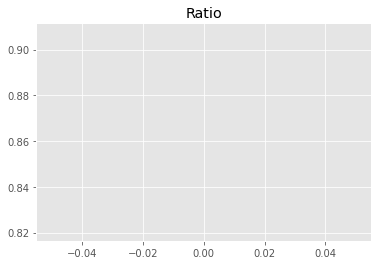

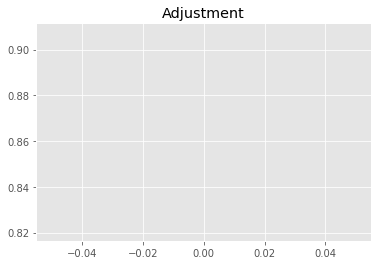

9688941002.044266
1


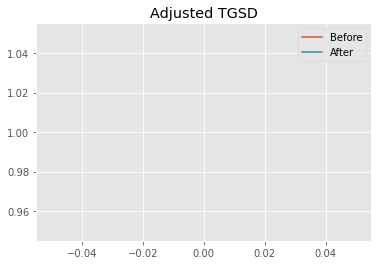

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.8777 	2.83785 	29377.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.76214 	3.34533 	40177.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.9304
New Misfit: 24.7046
Convergence:
0.047274061300053384

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.06e+03 	1.86e+03 	0.9028 		1.0000


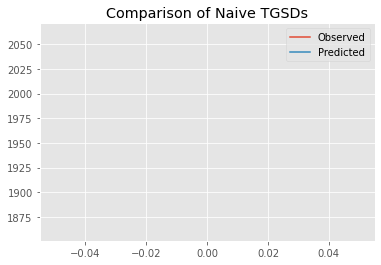

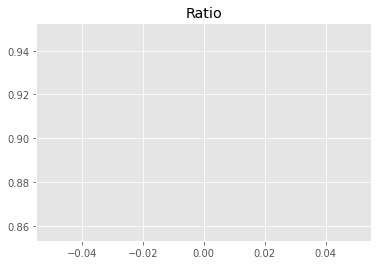

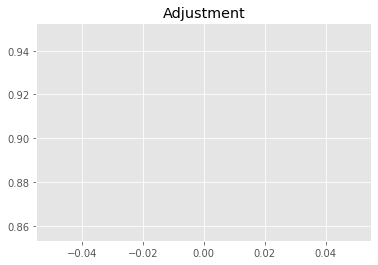

10125150931.16366
1


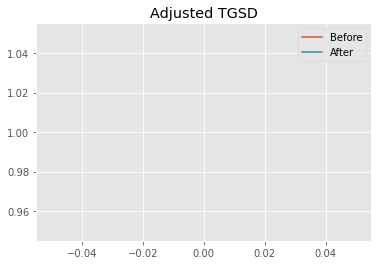

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.76214 	3.34533 	40177.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.52307 	2.91246 	44713 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.7046
New Misfit: 24.249
Convergence:
0.018440802998344878

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.01e+03 	1.86e+03 	0.9251 		1.0000


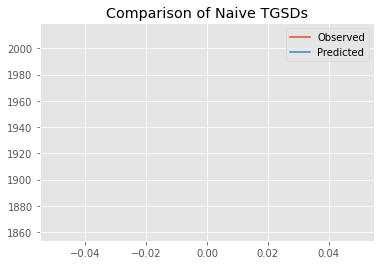

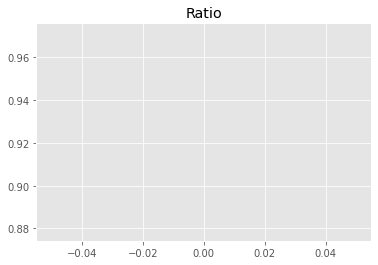

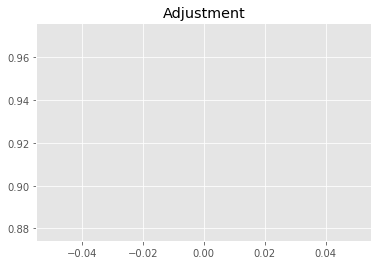

10374935891.78301
1


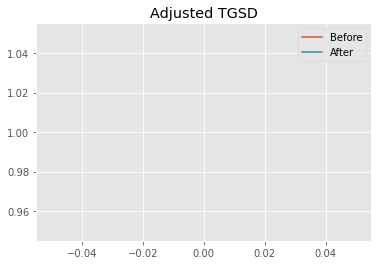

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.52307 	2.91246 	44713 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.06407 	1.65583 	44548.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.249
New Misfit: 23.9639
Convergence:
0.011759809809260413

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.93e+03 	1.86e+03 	0.9664 		1.0000


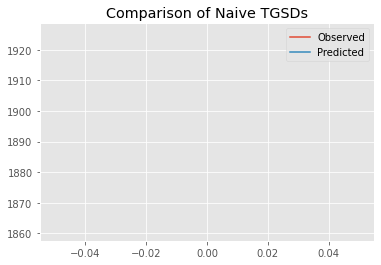

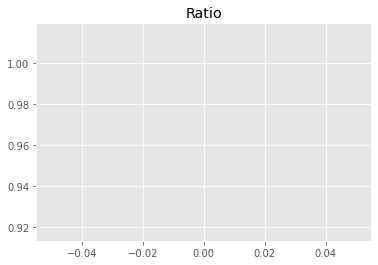

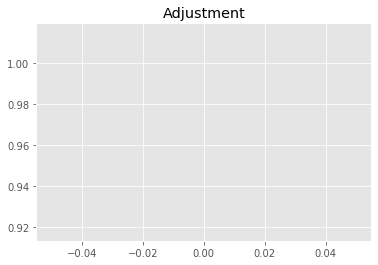

10838684597.670628
1


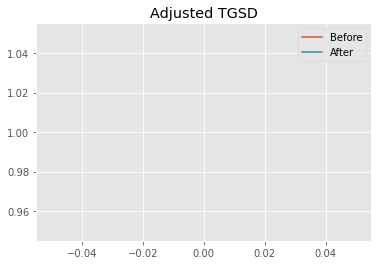

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.06407 	1.65583 	44548.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.00944 	1.51357 	42581.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9639
New Misfit: 23.9393
Convergence:
0.001025174873324193

____________________
a = 1.00944	b = 1.51357	            h1 = 42581.06375	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.93929124887734
Prior Misfit: 0.18375,	 Post Misfit: 23.9393


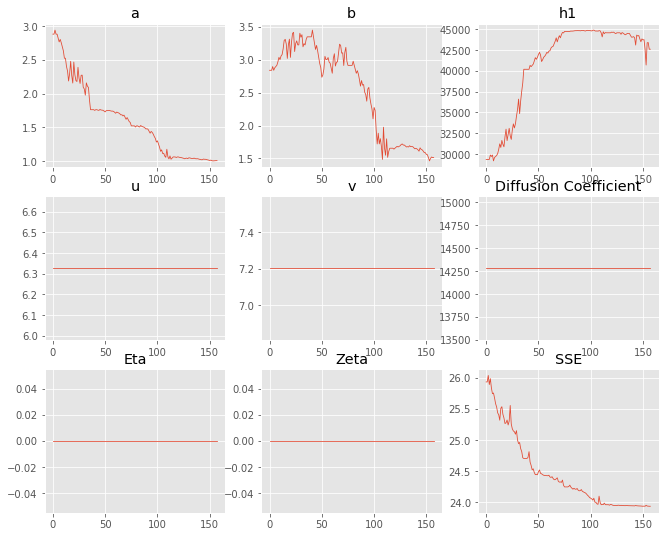

,Priors,Posteriors
a,2.8777,1.00944
b,2.83785,1.51357
h1,"29,377.4","42,581.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.083 minutes


Estimated remaining run time: 0.057 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.15e+03 	1.86e+03 	0.8649 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


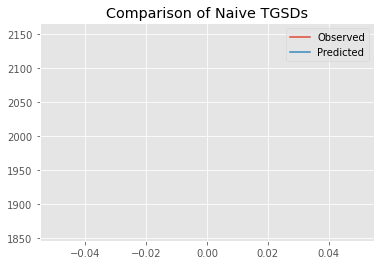

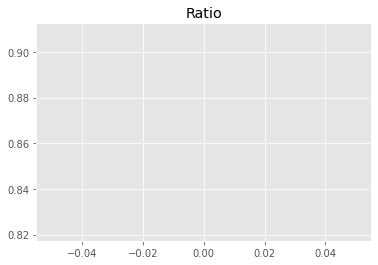

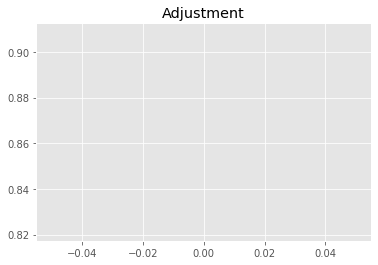

9699588170.351656
1


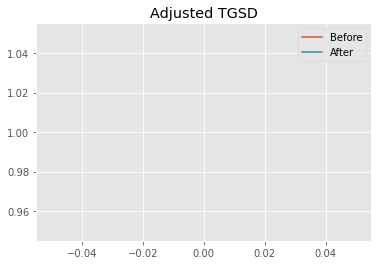

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.79809 	3.60733 	29790.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|2.73773 	3.9993 	32258.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 28.2544
New Misfit: 25.5563
Convergence:
0.09549502598006754

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.15e+03 	1.86e+03 	0.8651 		1.0000


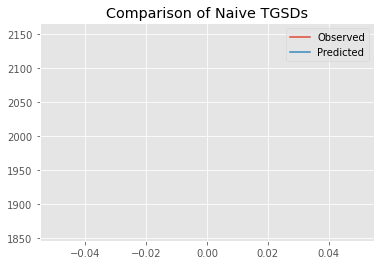

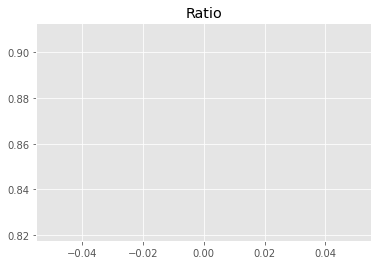

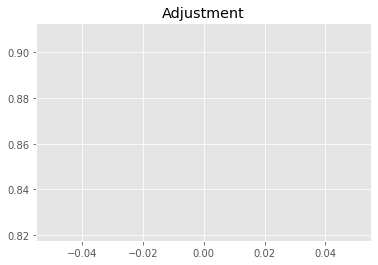

9702220786.056257
1


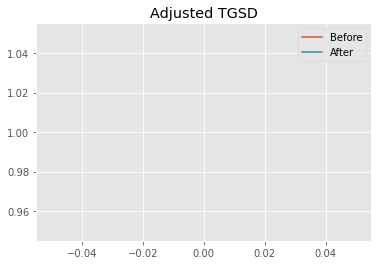

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.73773 	3.9993 	32258.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.07488 	1.688 	44783.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 25.5563
New Misfit: 23.9672
Convergence:
0.06217726852336109

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.93e+03 	1.86e+03 	0.9657 		1.0000


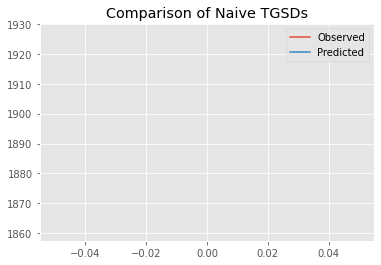

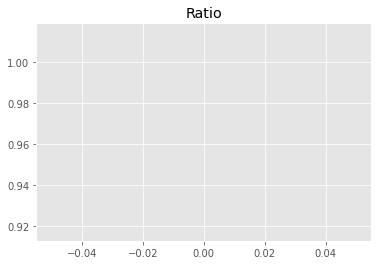

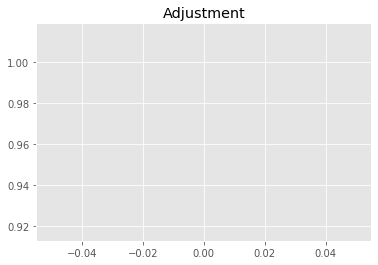

10830698694.533356
1


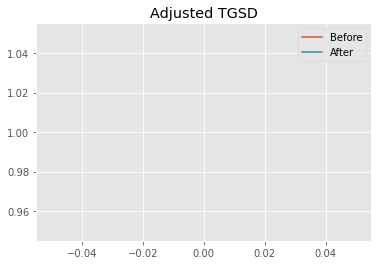

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.07488 	1.688 	44783.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.0297 	1.65407 	44410.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9672
New Misfit: 23.9454
Convergence:
0.0009120115512587396

____________________
a = 1.02970	b = 1.65407	            h1 = 44410.25050	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 23.94538102897388
Prior Misfit: 0.200218,	 Post Misfit: 23.9454


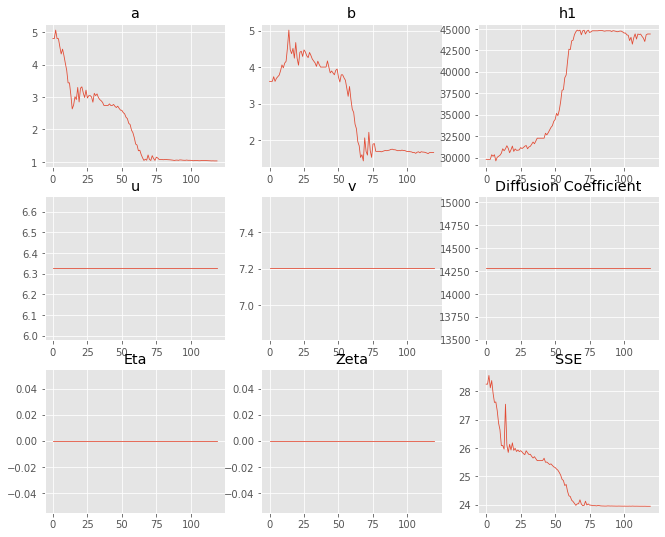

,Priors,Posteriors
a,4.79809,1.0297
b,3.60733,1.65407
h1,"29,790.9","44,410.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.064 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.08e+03 	1.86e+03 	0.8942 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


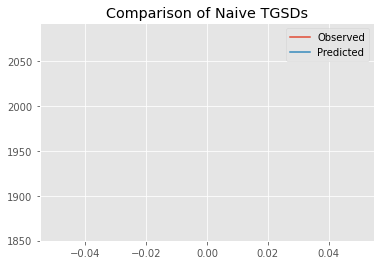

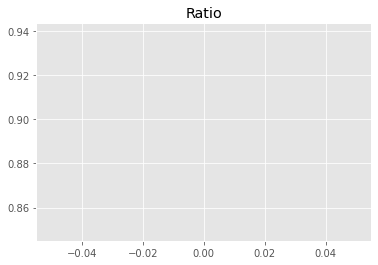

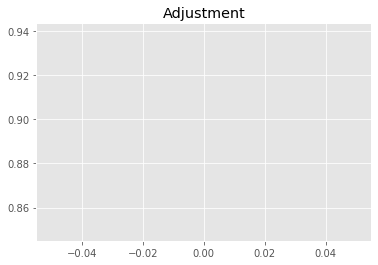

10028314081.168886
1


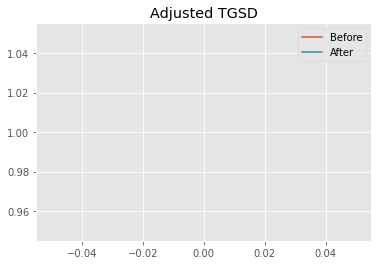

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86195 	4.15072 	38405 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.833 	3.10995 	40718.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.0746
New Misfit: 24.5252
Convergence:
0.059421209246385616

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.05e+03 	1.86e+03 	0.9068 		1.0000


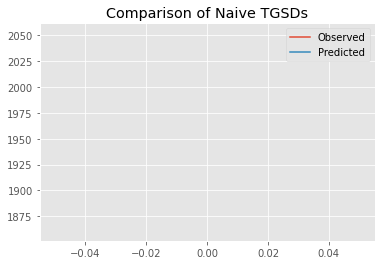

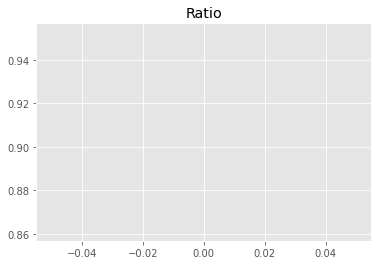

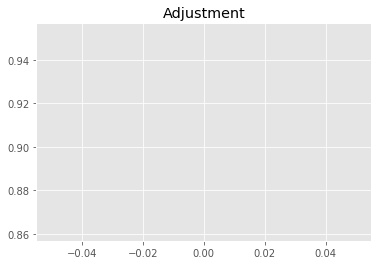

10169745297.387197
1


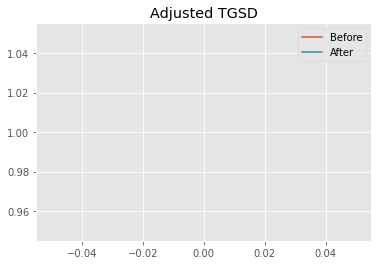

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.833 	3.10995 	40718.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.36833 	2.55839 	44445.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.5252
New Misfit: 24.1673
Convergence:
0.014591746056913067

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.99e+03 	1.86e+03 	0.9334 		1.0000


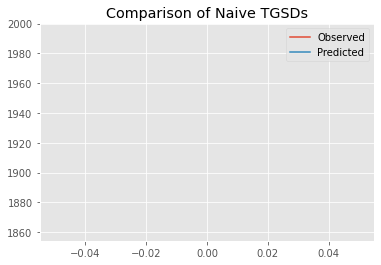

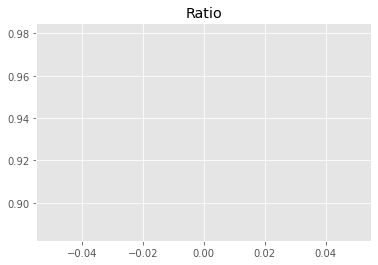

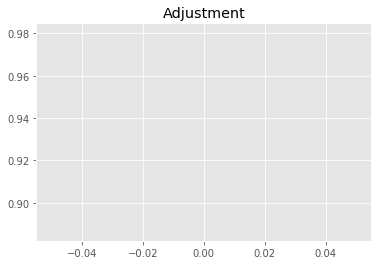

10468286785.576675
1


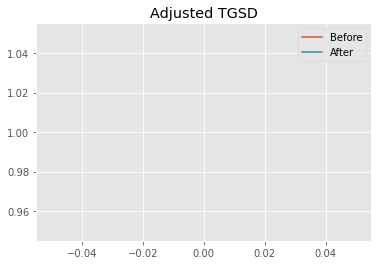

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.36833 	2.55839 	44445.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.10497 	1.77457 	44912.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.1673
New Misfit: 23.9731
Convergence:
0.008035764938029826

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	1.93e+03 	1.86e+03 	0.9622 		1.0000


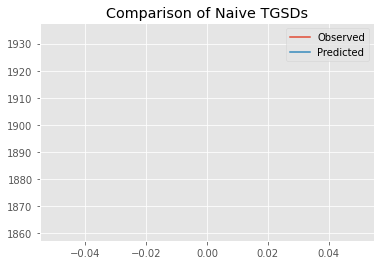

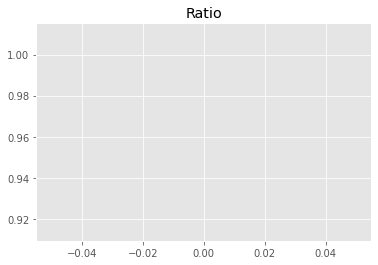

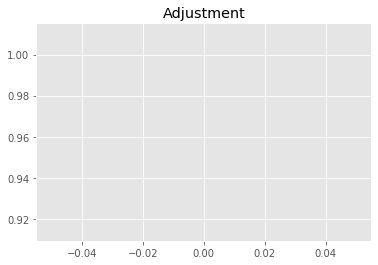

10791588047.66925
1


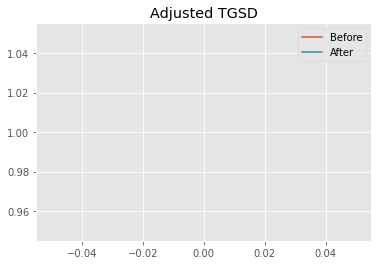

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10497 	1.77457 	44912.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.1215e+10
After: 		|1.03457 	1.64837 	44062 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9731
New Misfit: 23.9469
Convergence:
0.0010917788393633415

____________________
a = 1.03457	b = 1.64837	            h1 = 44062.02558	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 23.946932275107784
Prior Misfit: 0.184771,	 Post Misfit: 23.9469


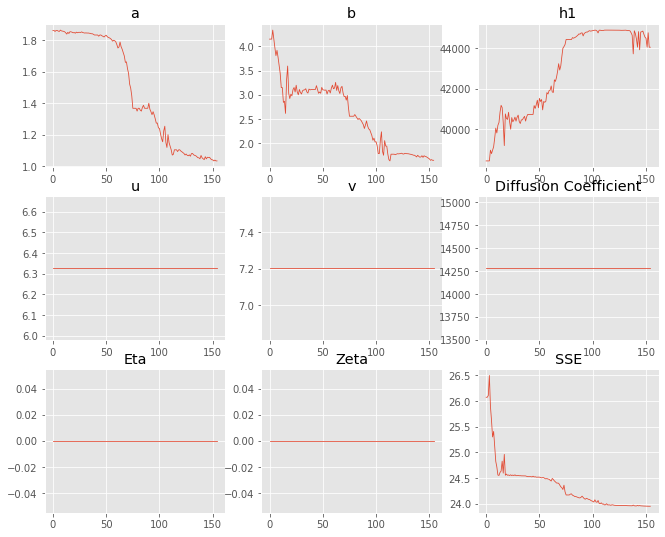

,Priors,Posteriors
a,1.86195,1.03457
b,4.15072,1.64837
h1,"38,405","44,062"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.080 minutes


Estimated remaining run time: -0.058 minutes


Total Run Time: 1.22198 minutes


[{'a': 1.0003003195074431,
  'b': 1.5903303841451522,
  'h1': 44707.084035284126,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.00000068080469,
  'b': 1.5964310080999102,
  'h1': 44914.567598701964,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.6090365616061022,
  'b': 2.478116774063505,
  'h1': 40084.80304061387,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0751458790918205,
  'b': 1.74808961811698,
  'h1': 44914.99999999114,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.9652561111543085,
  'b': 3.63096811098426,
  'h1': 43331.0066960025,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 1.0131678

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
1,1,1.59643,"44,914.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169625
0,1.0003,1.59033,"44,707.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169625
10,1.00058,1.58327,"44,906.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.16963
7,1.00715,1.55666,"43,682.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169632
16,1.00378,1.42923,"41,304.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169635
17,1.00944,1.51357,"42,581.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.16964
14,1.01172,1.59855,"44,579.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169645
5,1.01317,1.59371,"44,088",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169646
6,1.01611,1.63419,"44,752.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169654
12,1.02296,1.63175,"44,915",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169666


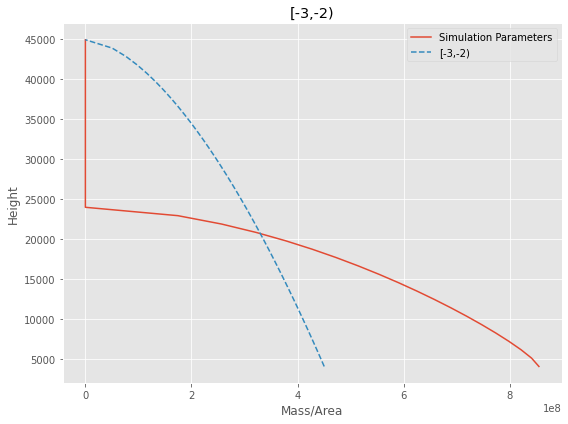

[-3,-2) Run Time: 1.22434 minutes


Mass Test: 23412237340.63284
========[-2,-1)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.08e+03 	1.90e+03 	0.9132 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


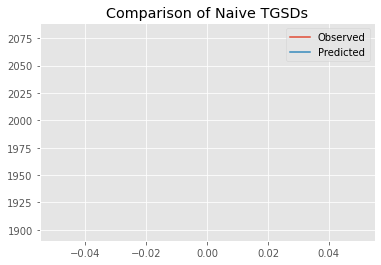

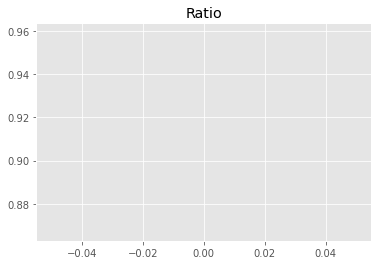

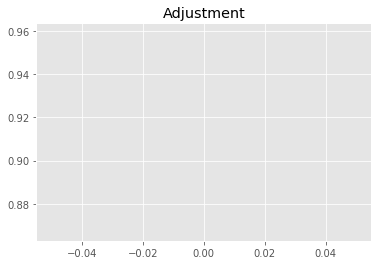

10451543161.892118
1


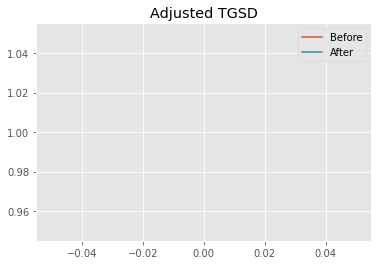

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.06074 	1.92109 	22181 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.02812 	1.90773 	28143.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.7631
New Misfit: 22.2479
Convergence:
0.0637641630900987

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	0.9981 		1.0000


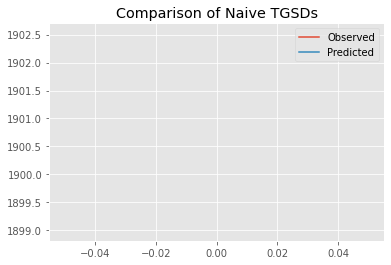

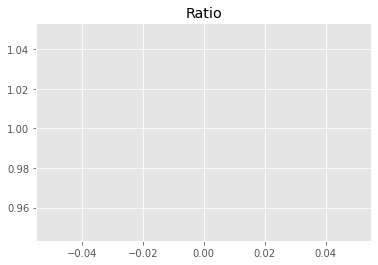

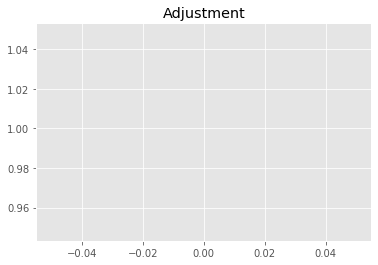

11423861933.235575
1


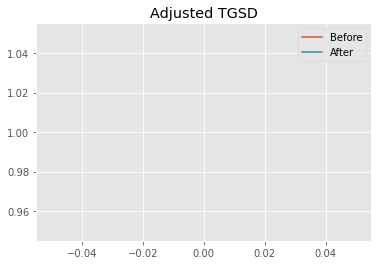

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02812 	1.90773 	28143.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.82743 	1.42993 	25833.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2479
New Misfit: 22.2201
Convergence:
0.001246423332303852

____________________
a = 1.82743	b = 1.42993	            h1 = 25833.66050	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.2201324308633
Prior Misfit: 0.213328,	 Post Misfit: 22.2201


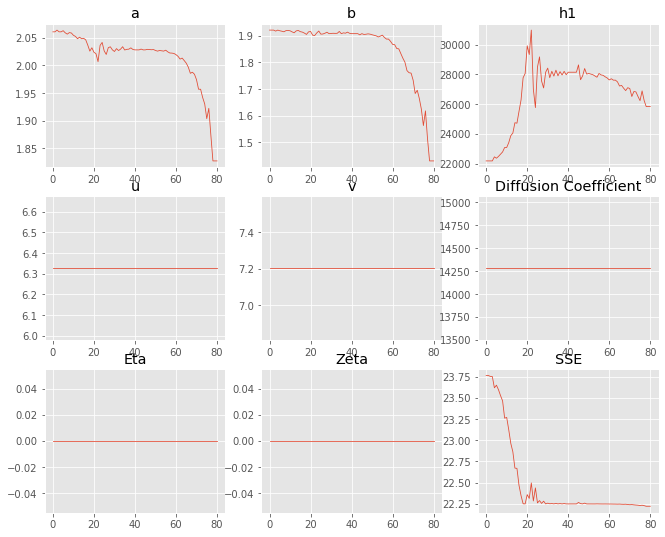

,Priors,Posteriors
a,2.06074,1.82743
b,1.92109,1.42993
h1,"22,181","25,833.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.048 minutes


Estimated remaining run time: 0.436 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.98e+03 	1.90e+03 	0.9601 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


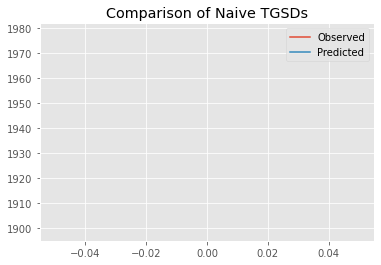

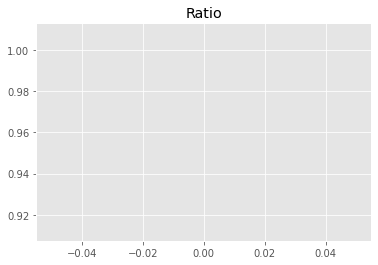

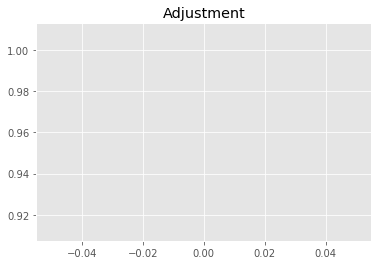

10988960323.19777
1


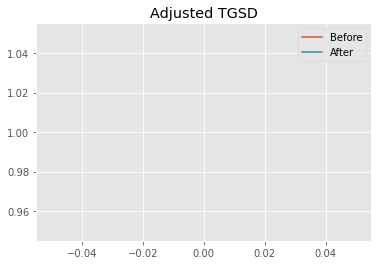

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.33698 	4.60019 	32262.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.50422 	4.09762 	37578.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.4537
New Misfit: 22.312
Convergence:
0.006309292151754332

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	0.9982 		1.0000


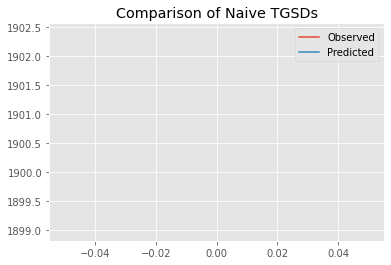

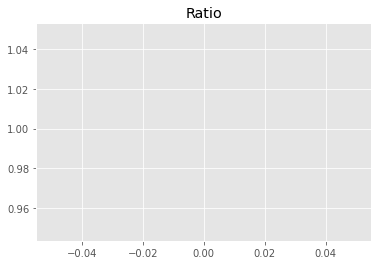

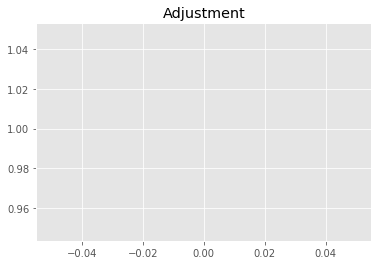

11424623860.002592
1


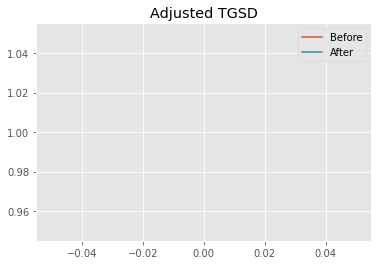

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.50422 	4.09762 	37578.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.20182 	2.90611 	33079.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.312
New Misfit: 22.294
Convergence:
0.0008077786027441905

____________________
a = 2.20182	b = 2.90611	            h1 = 33079.39348	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.293982799403334
Prior Misfit: 0.201573,	 Post Misfit: 22.294


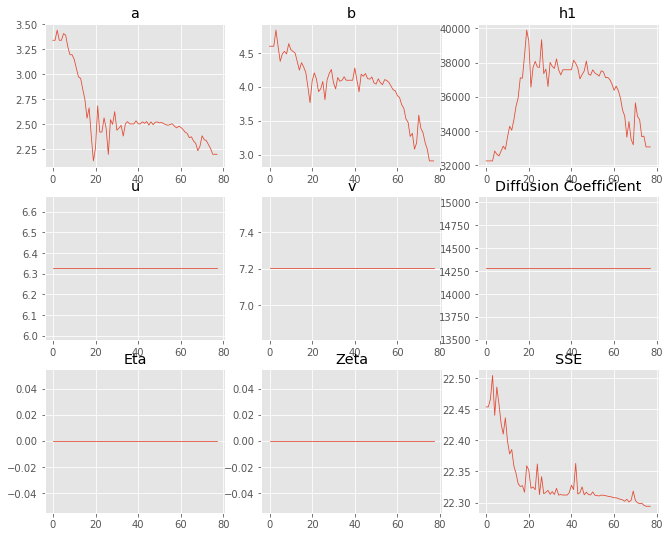

,Priors,Posteriors
a,3.33698,2.20182
b,4.60019,2.90611
h1,"32,262.3","33,079.4"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.048 minutes


Estimated remaining run time: 0.547 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.81e+03 	1.90e+03 	1.0501 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


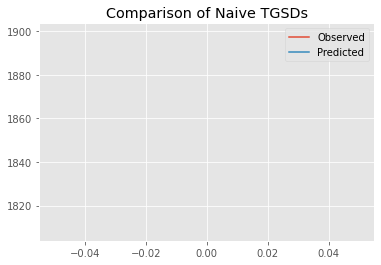

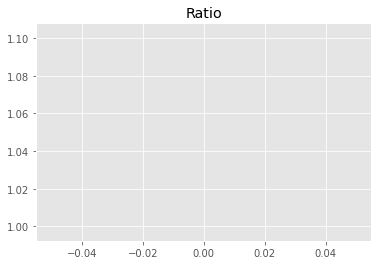

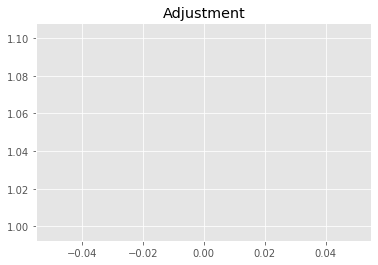

12018709448.194319
1


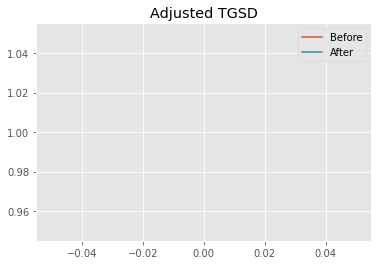

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.93241 	2.17411 	24615.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.09694 	2.26196 	29217.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.9571
New Misfit: 22.2819
Convergence:
0.0699234244343484

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.92e+03 	1.90e+03 	0.9885 		1.0000


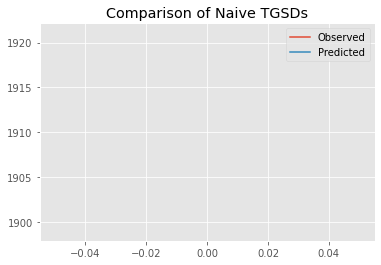

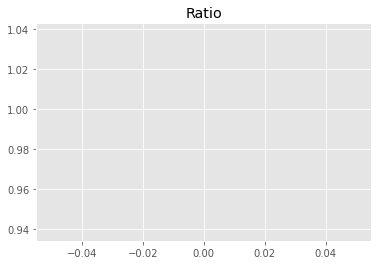

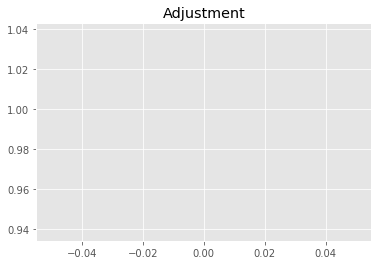

11313792173.19133
1


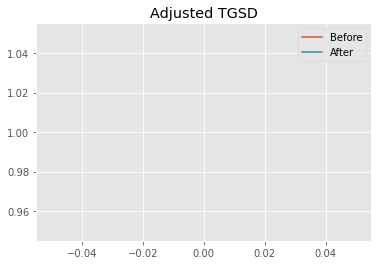

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09694 	2.26196 	29217.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.14671 	2.11699 	28384.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2819
New Misfit: 22.2584
Convergence:
0.001054667079641073

____________________
a = 2.14671	b = 2.11699	            h1 = 28384.11870	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.258419699360015
Prior Misfit: 0.215069,	 Post Misfit: 22.2584


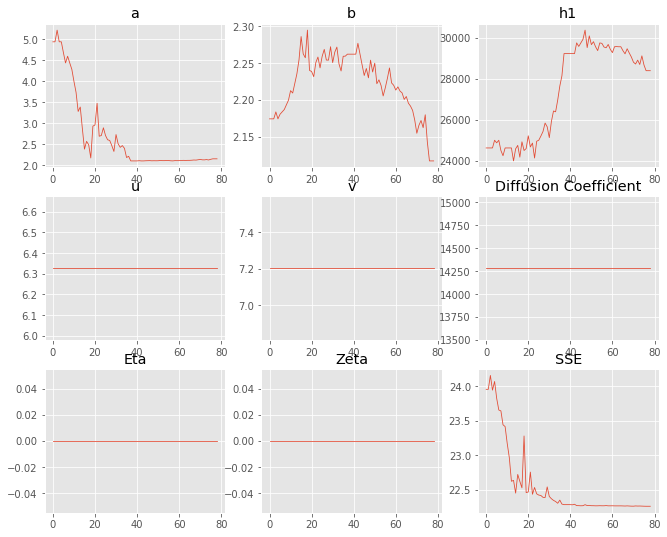

,Priors,Posteriors
a,4.93241,2.14671
b,2.17411,2.11699
h1,"24,615.4","28,384.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.050 minutes


Estimated remaining run time: 0.586 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.72e+03 	1.90e+03 	1.1014 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


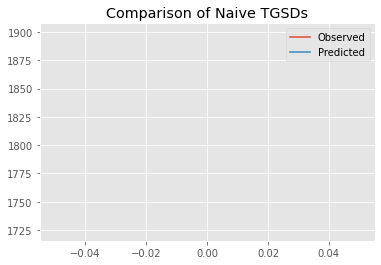

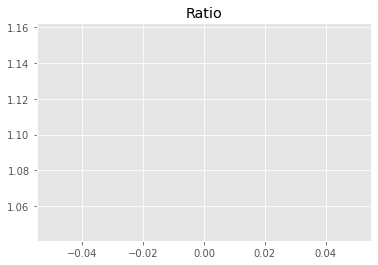

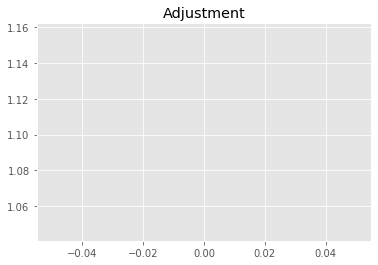

12605534624.817219
1


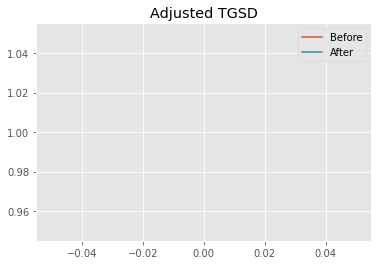

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.57738 	3.93944 	44432 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.50524 	5.2716 	44156.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.3775
New Misfit: 22.3352
Convergence:
0.04458218560305092

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.89e+03 	1.90e+03 	1.0034 		1.0000


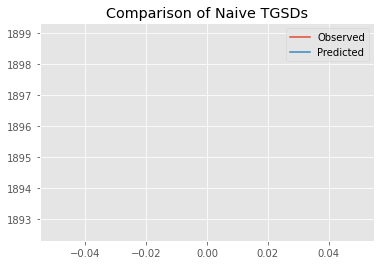

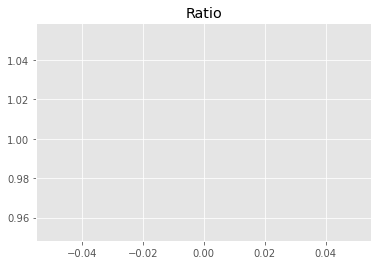

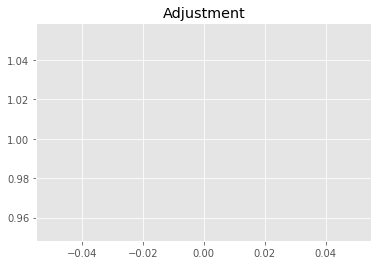

11483646545.72468
1


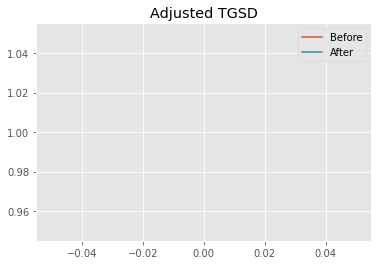

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.50524 	5.2716 	44156.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.64578 	5.18656 	41627.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.3352
New Misfit: 22.3269
Convergence:
0.00037280172023062397

____________________
a = 2.64578	b = 5.18656	            h1 = 41627.83136	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.326921257496423
Prior Misfit: 0.209866,	 Post Misfit: 22.3269


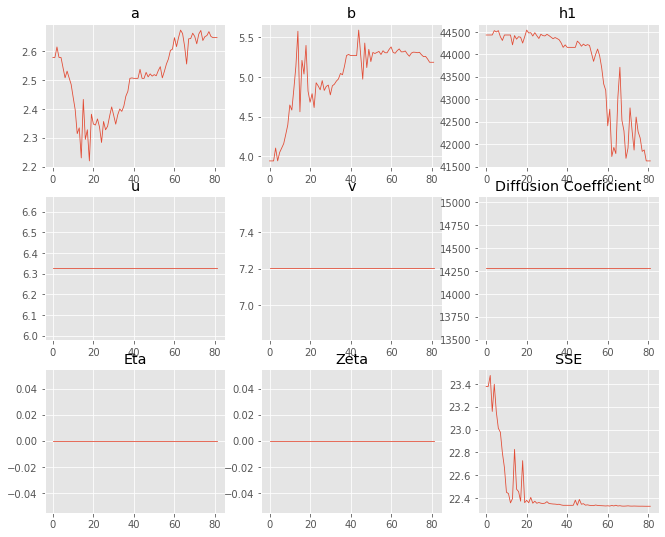

,Priors,Posteriors
a,2.57738,2.64578
b,3.93944,5.18656
h1,"44,432","41,627.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.049 minutes


Estimated remaining run time: 0.587 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.93e+03 	1.90e+03 	0.9844 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


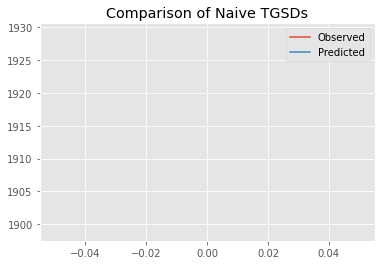

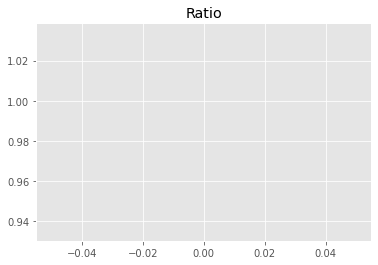

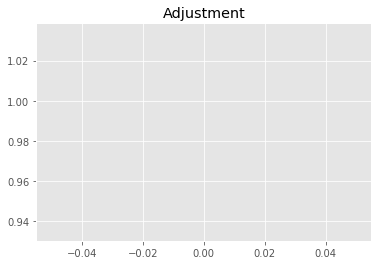

11266523937.063648
1


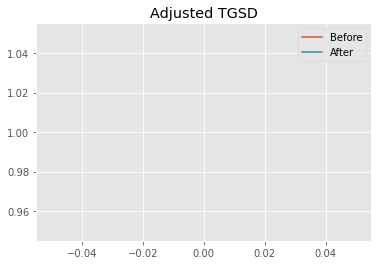

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.96238 	2.56371 	24904.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.40446 	2.63912 	30220.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.9083
New Misfit: 22.2896
Convergence:
0.027008055287545837

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9932 		1.0000


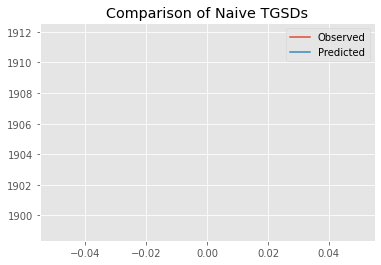

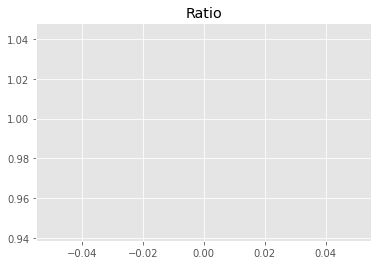

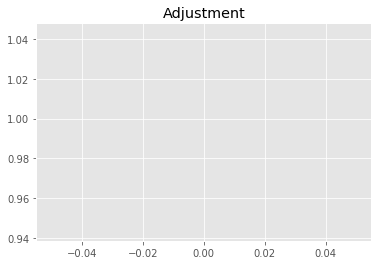

11367776363.270554
1


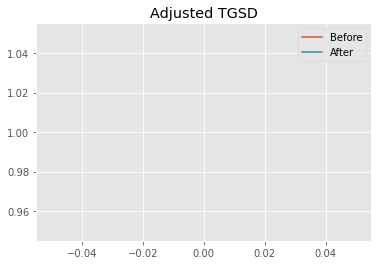

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.40446 	2.63912 	30220.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.21522 	2.39547 	29956 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2896
New Misfit: 22.2697
Convergence:
0.0008909905792664181

____________________
a = 2.21522	b = 2.39547	            h1 = 29956.02299	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.26969167977847
Prior Misfit: 0.205654,	 Post Misfit: 22.2697


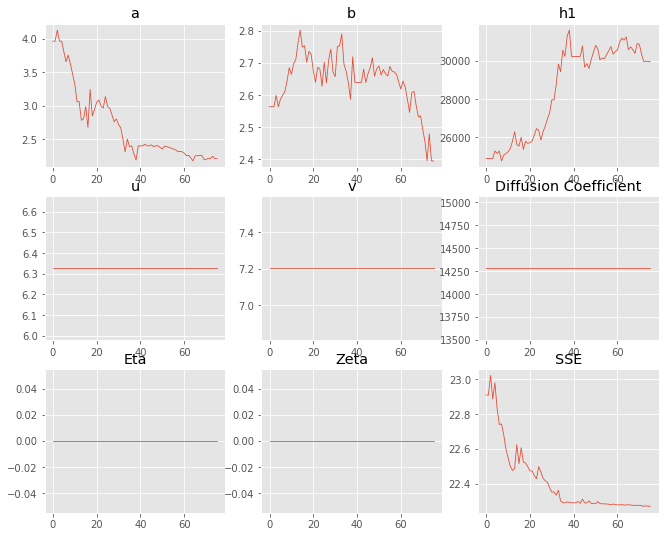

,Priors,Posteriors
a,3.96238,2.21522
b,2.56371,2.39547
h1,"24,904.4","29,956"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.047 minutes


Estimated remaining run time: 0.565 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.97e+03 	1.90e+03 	0.9639 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


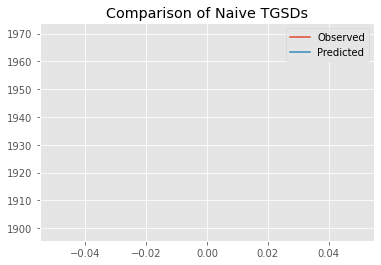

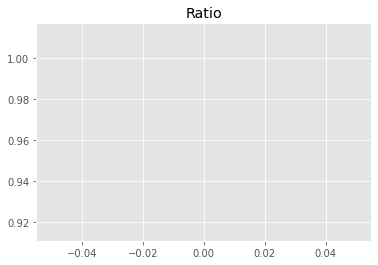

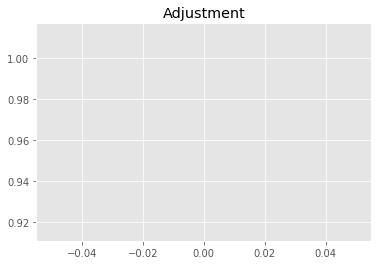

11032041132.06679
1


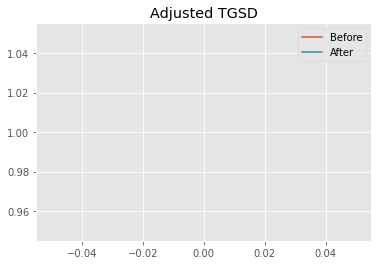

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.09079 	2.66561 	26169.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.2849 	2.72416 	31567.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.4665
New Misfit: 22.2819
Convergence:
0.008217664820773869

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	0.9983 		1.0000


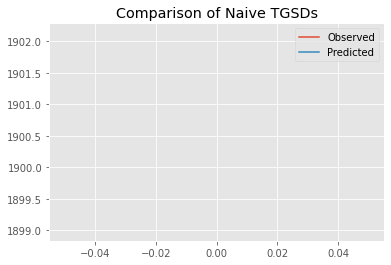

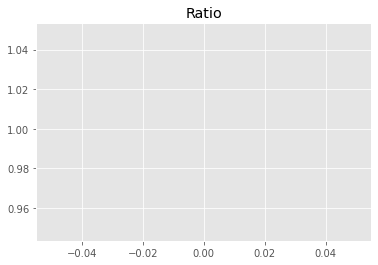

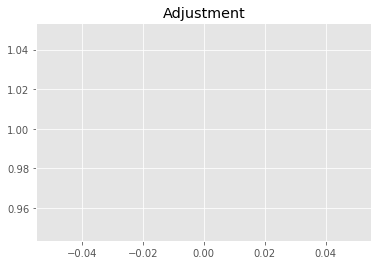

11426227244.14523
1


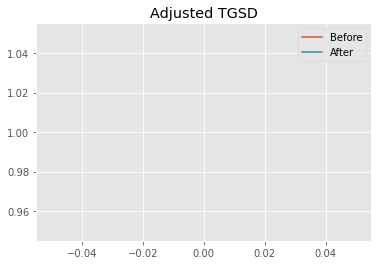

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.2849 	2.72416 	31567.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.28622 	2.23222 	28109.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2819
New Misfit: 22.2705
Convergence:
0.0005098550902586498

____________________
a = 2.28622	b = 2.23222	            h1 = 28109.41386	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.270546228518544
Prior Misfit: 0.201688,	 Post Misfit: 22.2705


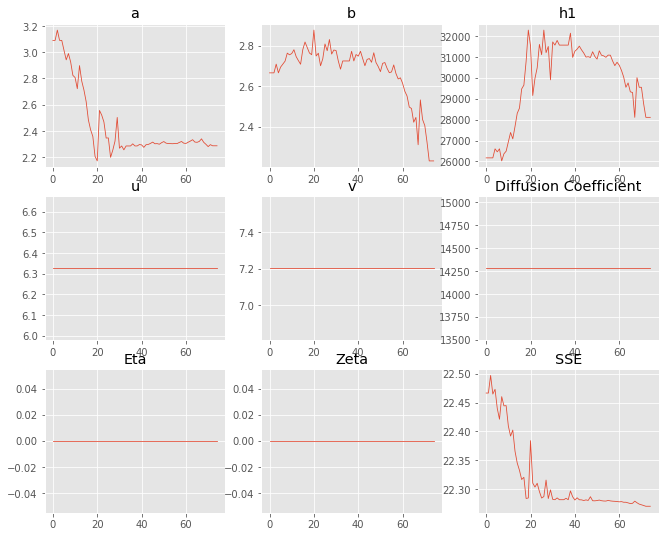

,Priors,Posteriors
a,3.09079,2.28622
b,2.66561,2.23222
h1,"26,169.9","28,109.4"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.047 minutes


Estimated remaining run time: 0.537 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.89e+03 	1.90e+03 	1.0047 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


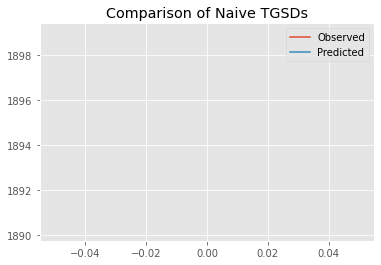

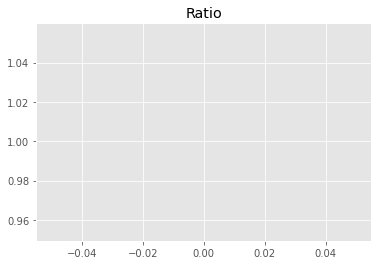

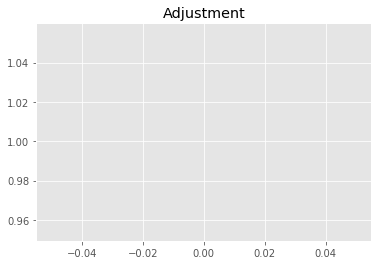

11498490481.893425
1


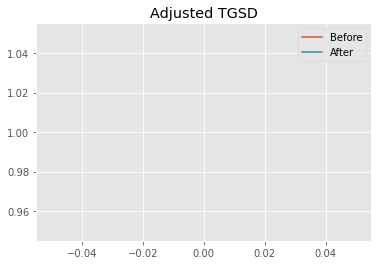

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.64584 	3.24123 	32918.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.44998 	3.45695 	34220.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.3736
New Misfit: 22.2994
Convergence:
0.0033139752923346047

____________________
a = 2.44998	b = 3.45695	            h1 = 34220.10987	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 22.299439422362074
Prior Misfit: 0.200854,	 Post Misfit: 22.2994


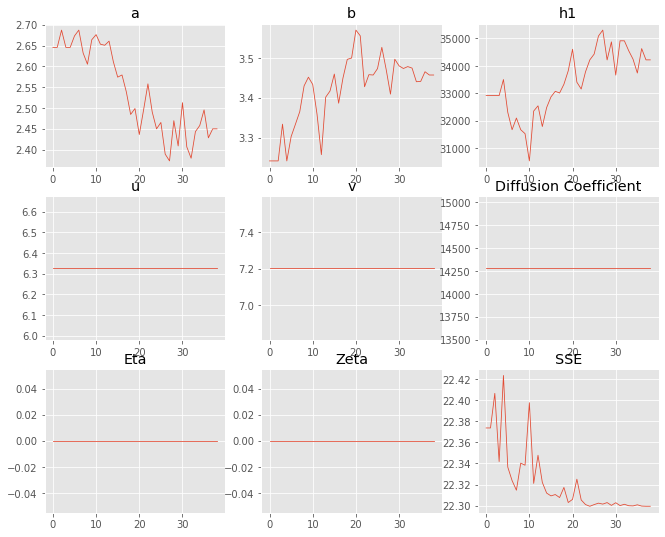

,Priors,Posteriors
a,2.64584,2.44998
b,3.24123,3.45695
h1,"32,918.5","34,220.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.028 minutes


Estimated remaining run time: 0.476 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.05e+03 	1.90e+03 	0.9277 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


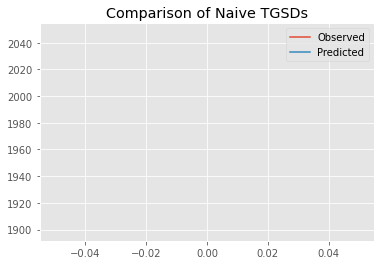

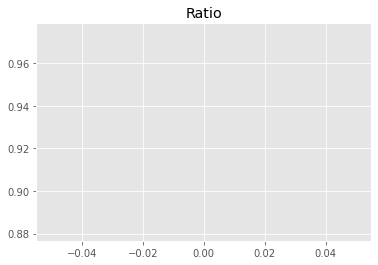

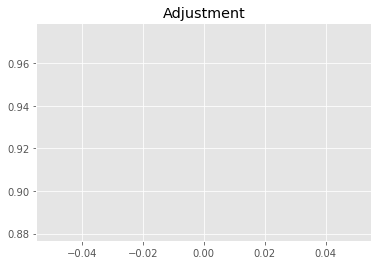

10617251363.3792
1


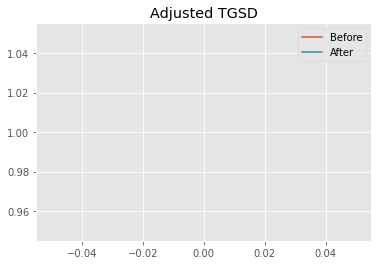

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.64537 	3.24881 	24717.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.22637 	2.42289 	29988.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.7313
New Misfit: 22.2703
Convergence:
0.020278548164133194

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9954 		1.0000


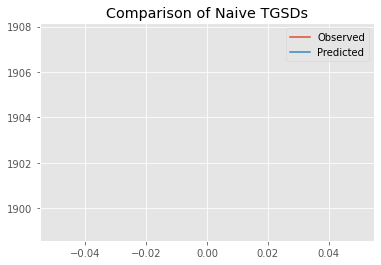

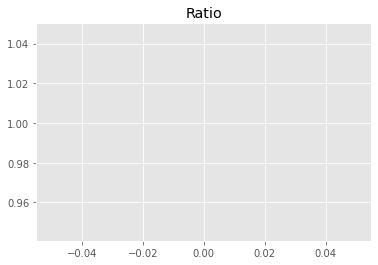

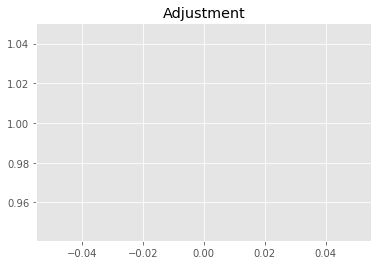

11392818821.090286
1


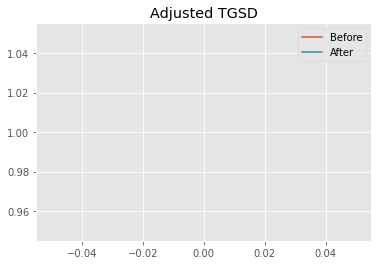

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.22637 	2.42289 	29988.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.14973 	1.942 	27197.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2703
New Misfit: 22.2529
Convergence:
0.0007821176483420495

____________________
a = 2.14973	b = 1.94200	            h1 = 27197.12059	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.25289880792524
Prior Misfit: 0.204065,	 Post Misfit: 22.2529


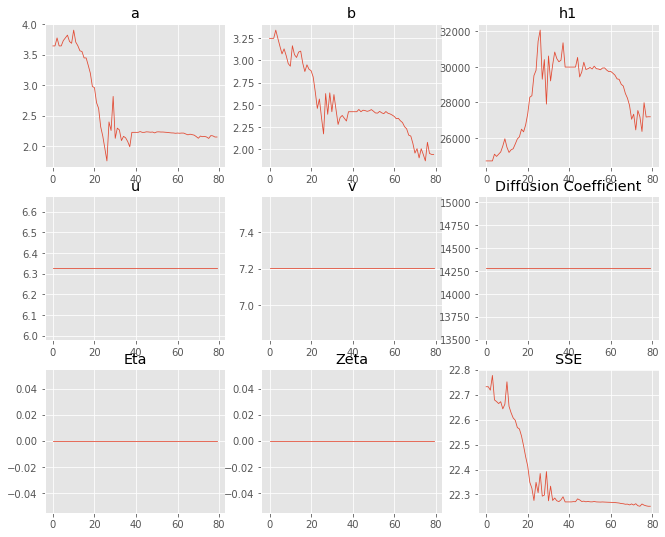

,Priors,Posteriors
a,3.64537,2.14973
b,3.24881,1.942
h1,"24,717.3","27,197.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.048 minutes


Estimated remaining run time: 0.447 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.95e+03 	1.90e+03 	0.9731 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


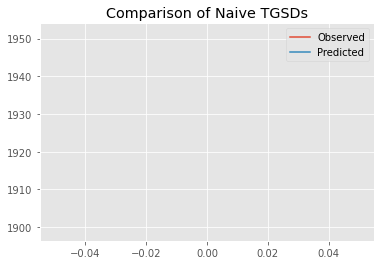

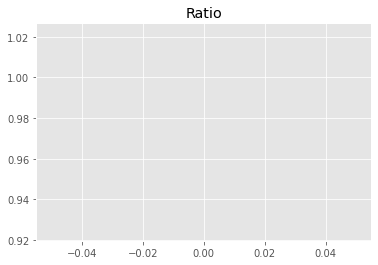

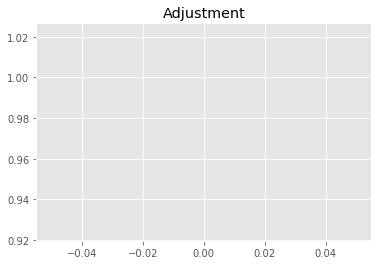

11137592534.656927
1


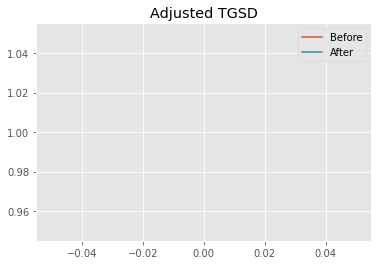

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.53337 	2.40349 	22961.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.67065 	2.55133 	28086.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.0498
New Misfit: 22.3476
Convergence:
0.03046732550324493

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.93e+03 	1.90e+03 	0.9826 		1.0000


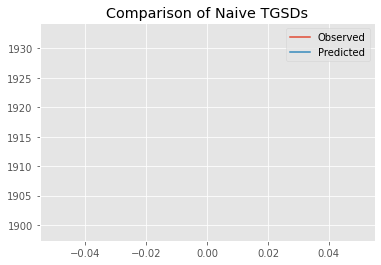

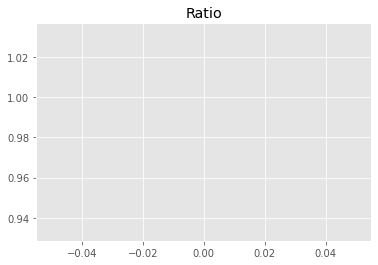

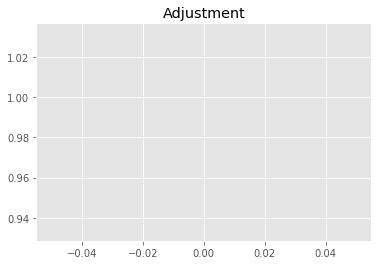

11246250793.188498
1


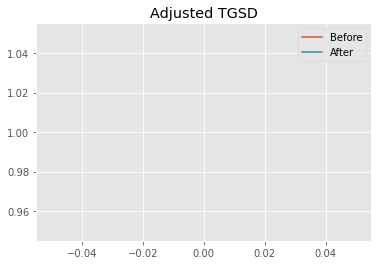

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.67065 	2.55133 	28086.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.28336 	2.63411 	30786.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.3476
New Misfit: 22.2776
Convergence:
0.0031311916095973016

____________________
a = 2.28336	b = 2.63411	            h1 = 30786.78943	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.277586603142716
Prior Misfit: 0.206925,	 Post Misfit: 22.2776


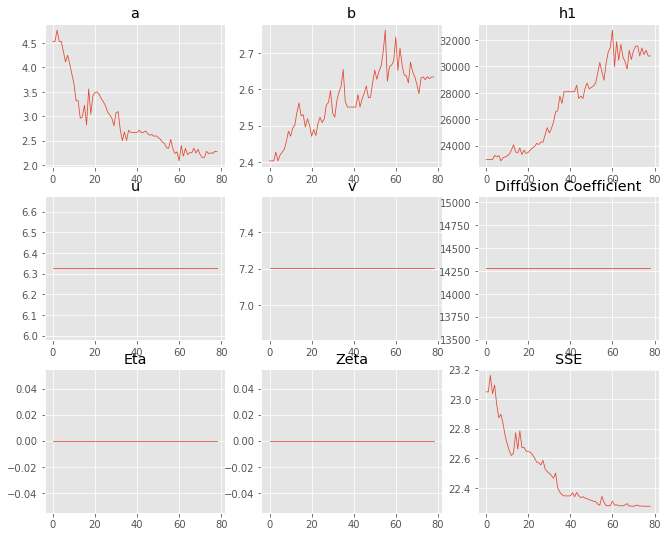

,Priors,Posteriors
a,4.53337,2.28336
b,2.40349,2.63411
h1,"22,961.4","30,786.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.050 minutes


Estimated remaining run time: 0.415 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.92e+03 	1.90e+03 	0.9900 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


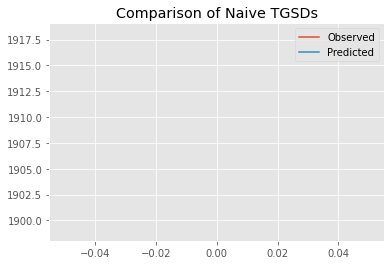

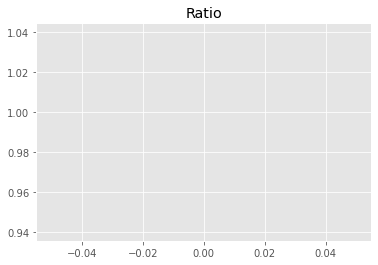

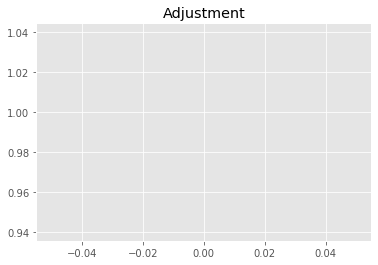

11331010308.03674
1


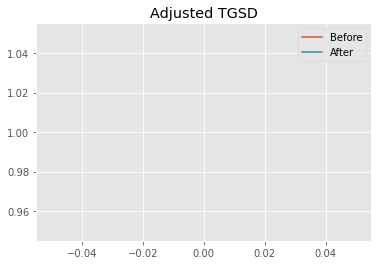

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.90875 	3.94979 	40422.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.89665 	3.06728 	37601.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.7913
New Misfit: 22.4225
Convergence:
0.016182315439765463

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.87e+03 	1.90e+03 	1.0164 		1.0000


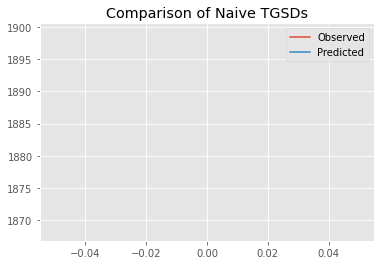

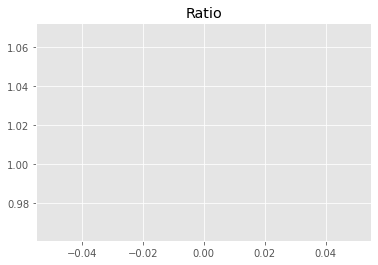

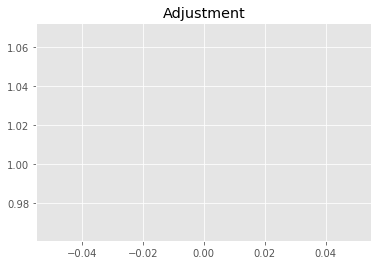

11632664861.997774
1


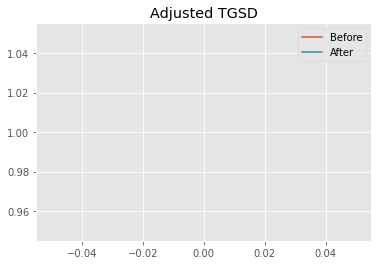

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.89665 	3.06728 	37601.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.98667 	2.56541 	33534 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.4225
New Misfit: 22.3192
Convergence:
0.004605067347480639

____________________
a = 1.98667	b = 2.56541	            h1 = 33534.04533	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.319209187315444
Prior Misfit: 0.204604,	 Post Misfit: 22.3192


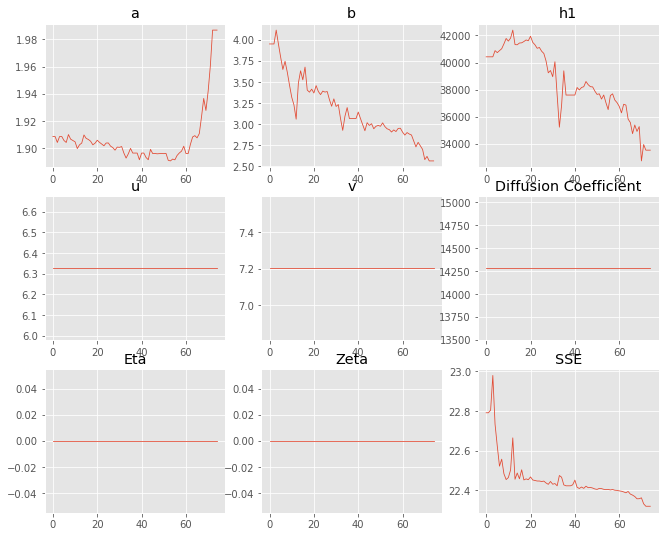

,Priors,Posteriors
a,1.90875,1.98667
b,3.94979,2.56541
h1,"40,422.7","33,534"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.046 minutes


Estimated remaining run time: 0.377 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.07e+03 	1.90e+03 	0.9176 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


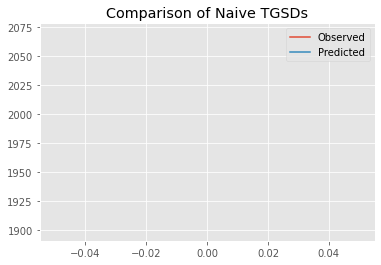

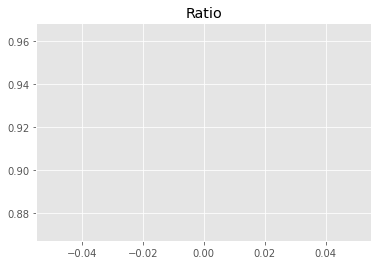

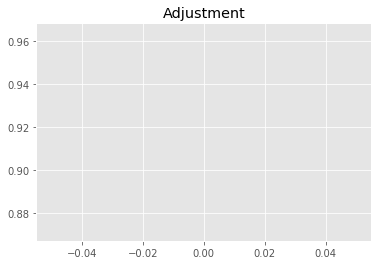

10502100723.684484
1


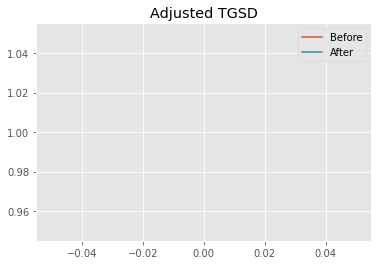

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.47578 	4.76766 	28860.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.27221 	3.02953 	33569 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.933
New Misfit: 22.2925
Convergence:
0.027926352302831206

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	1.0015 		1.0000


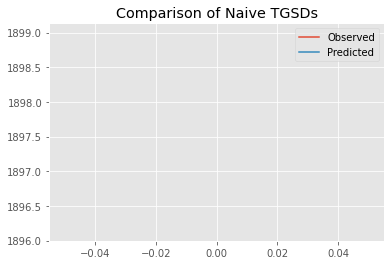

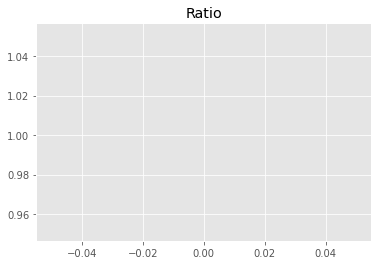

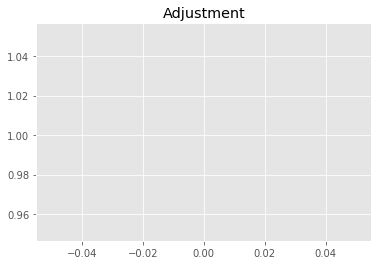

11462327261.702173
1


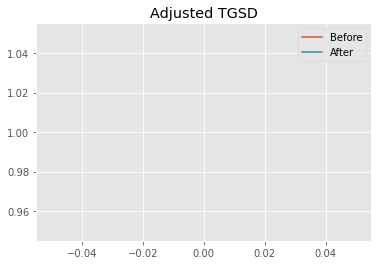

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.27221 	3.02953 	33569 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.21159 	2.27624 	29034.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2925
New Misfit: 22.2649
Convergence:
0.0012410612046192026

____________________
a = 2.21159	b = 2.27624	            h1 = 29034.20978	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.264873046945546
Prior Misfit: 0.205876,	 Post Misfit: 22.2649


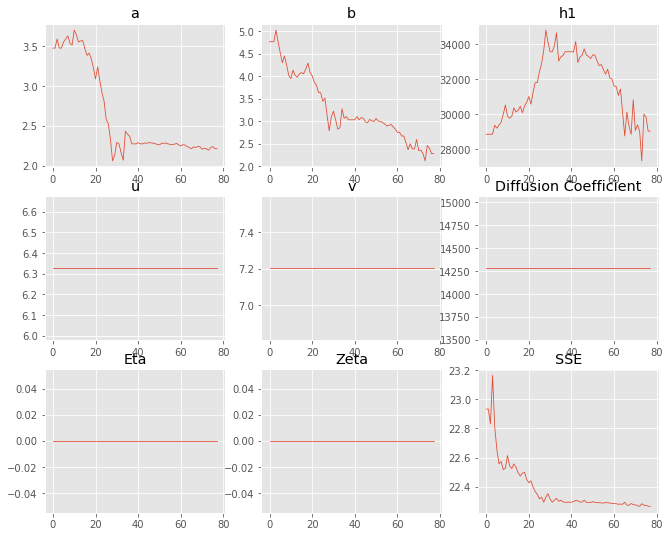

,Priors,Posteriors
a,3.47578,2.21159
b,4.76766,2.27624
h1,"28,860.6","29,034.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.048 minutes


Estimated remaining run time: 0.339 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.83e+03 	1.90e+03 	1.0387 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


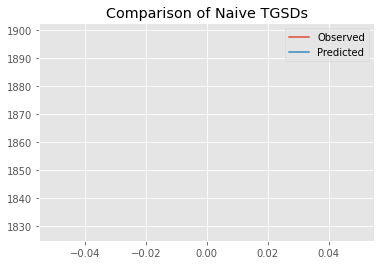

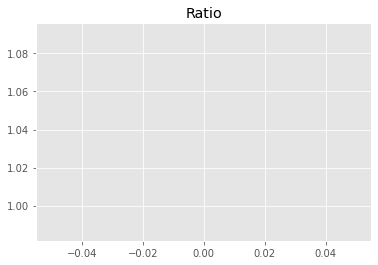

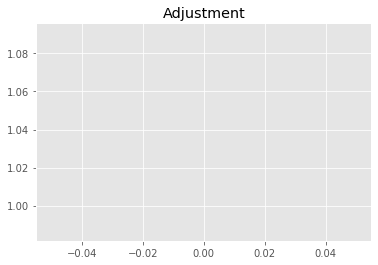

11887575786.214529
1


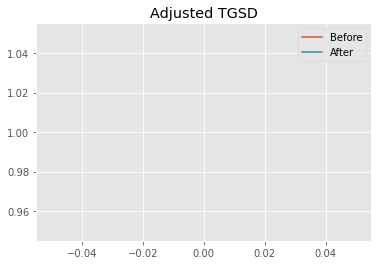

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.87185 	3.17537 	27326.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.60565 	3.2779 	31871.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.6551
New Misfit: 22.3112
Convergence:
0.056814246548871364

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.93e+03 	1.90e+03 	0.9848 		1.0000


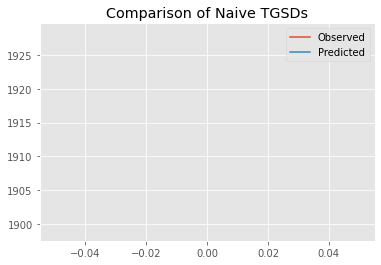

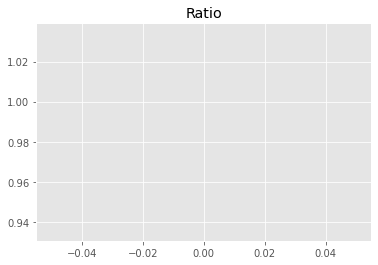

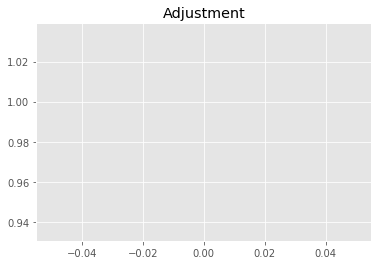

11271641517.418333
1


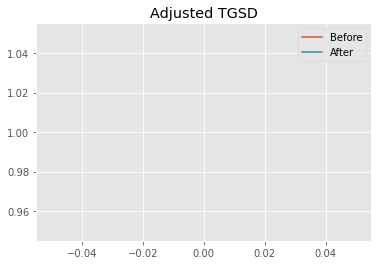

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.60565 	3.2779 	31871.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.39091 	3.17067 	32997.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.3112
New Misfit: 22.2931
Convergence:
0.0008125659279032214

____________________
a = 2.39091	b = 3.17067	            h1 = 32997.23197	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.293055857325253
Prior Misfit: 0.212359,	 Post Misfit: 22.2931


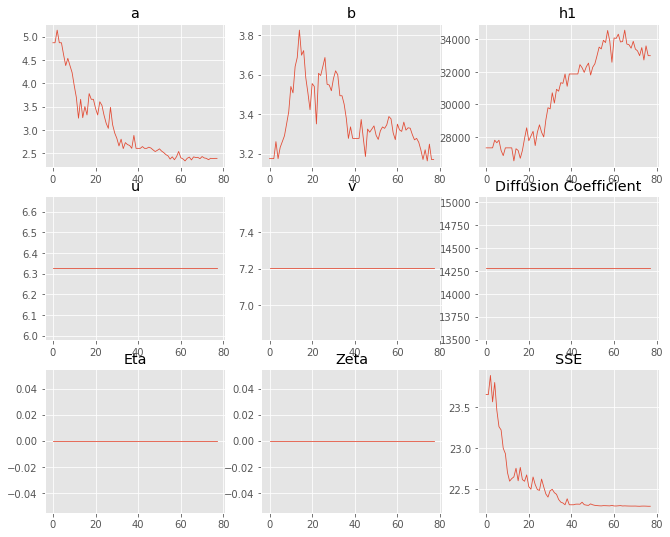

,Priors,Posteriors
a,4.87185,2.39091
b,3.17537,3.17067
h1,"27,326.4","32,997.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.047 minutes


Estimated remaining run time: 0.300 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.11e+03 	1.90e+03 	0.9005 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


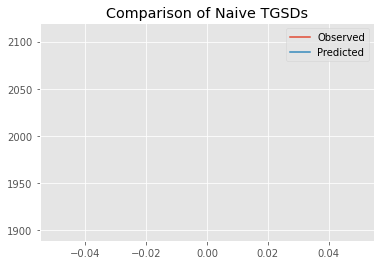

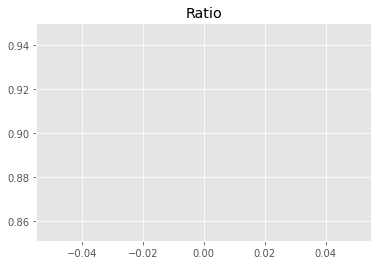

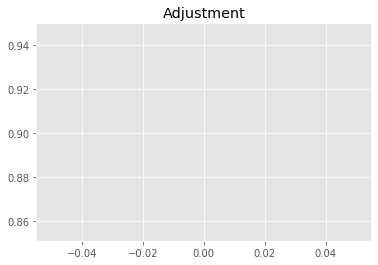

10306127081.111404
1


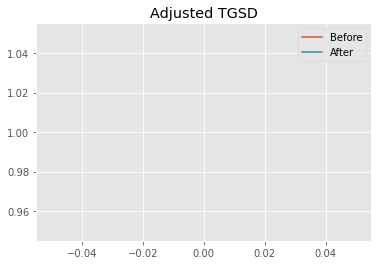

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.17985 	2.0701 	20500 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.11986 	2.03859 	27508.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.1282
New Misfit: 22.2692
Convergence:
0.03713945387039613

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.93e+03 	1.90e+03 	0.9837 		1.0000


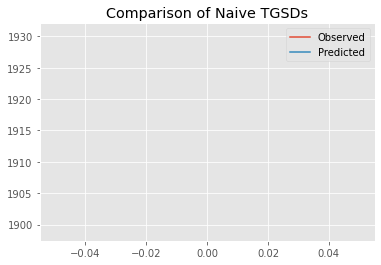

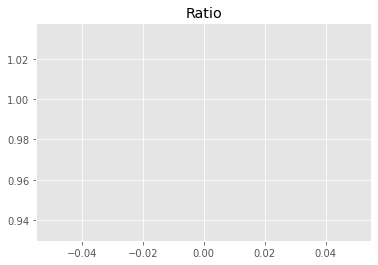

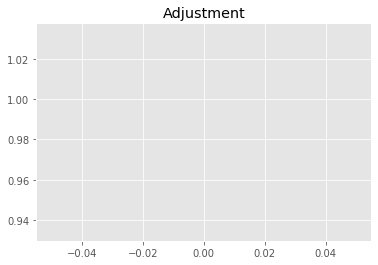

11258402000.780409
1


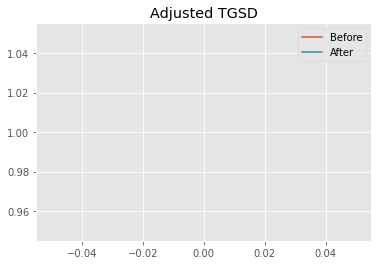

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.11986 	2.03859 	27508.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.12639 	2.03591 	28182.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2692
New Misfit: 22.2533
Convergence:
0.0007134982467254923

____________________
a = 2.12639	b = 2.03591	            h1 = 28182.60982	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.253316973686577
Prior Misfit: 0.207628,	 Post Misfit: 22.2533


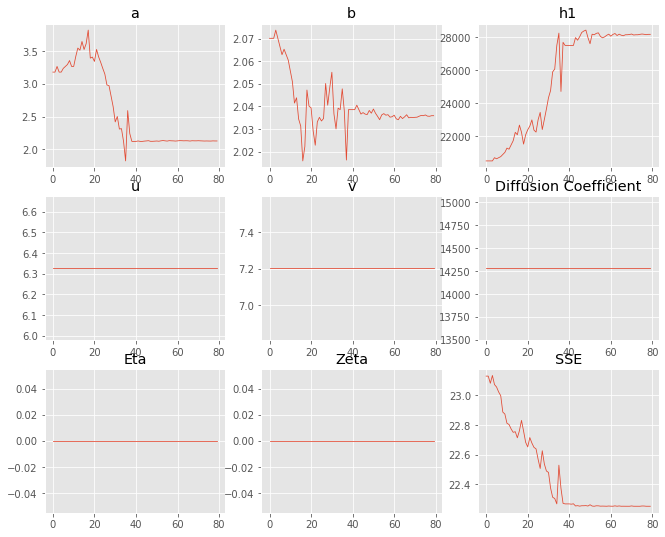

,Priors,Posteriors
a,3.17985,2.12639
b,2.0701,2.03591
h1,"20,500","28,182.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.047 minutes


Estimated remaining run time: 0.259 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.03e+03 	1.90e+03 	0.9363 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


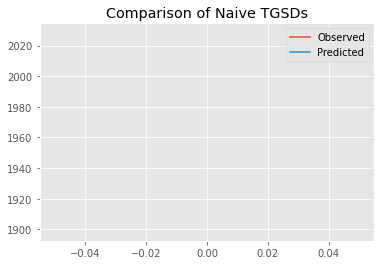

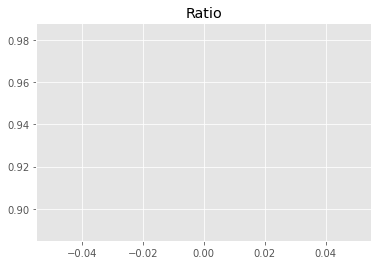

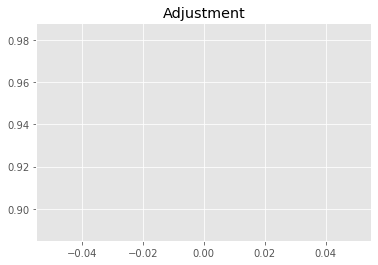

10716606278.22877
1


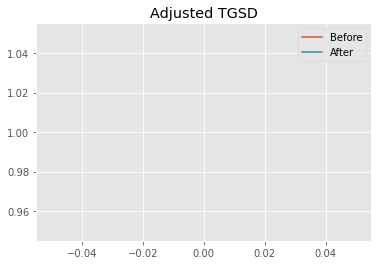

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.71575 	2.72092 	25647.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.22679 	2.49162 	30231 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.6194
New Misfit: 22.2727
Convergence:
0.01532973496065099

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9933 		1.0000


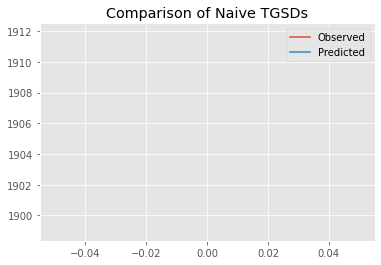

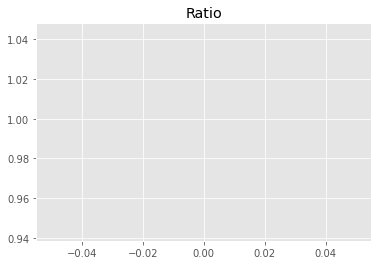

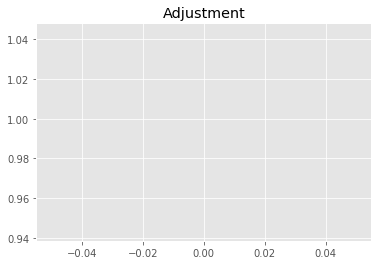

11368074962.099323
1


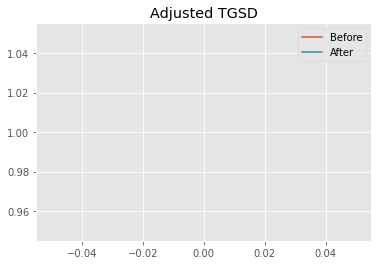

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.22679 	2.49162 	30231 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.20688 	2.10941 	27814 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2727
New Misfit: 22.2619
Convergence:
0.00048532399542483573

____________________
a = 2.20688	b = 2.10941	            h1 = 27813.97007	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.261873146831896
Prior Misfit: 0.203061,	 Post Misfit: 22.2619


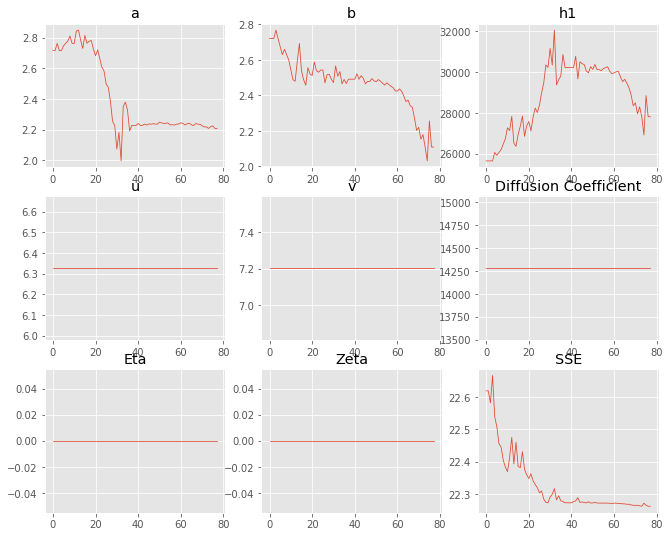

,Priors,Posteriors
a,2.71575,2.20688
b,2.72092,2.10941
h1,"25,647.6","27,814"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.047 minutes


Estimated remaining run time: 0.217 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9934 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


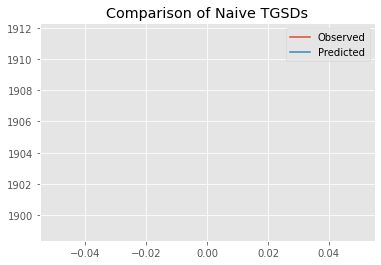

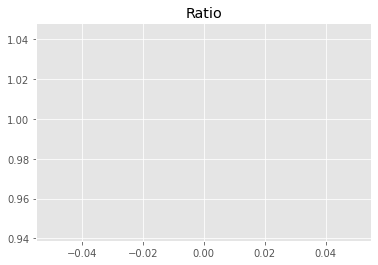

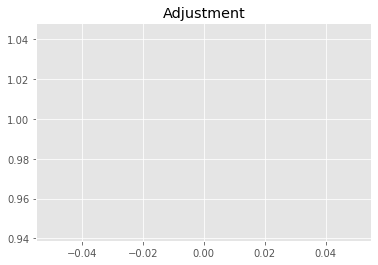

11369350507.45133
1


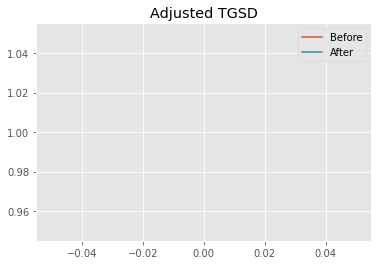

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.82577 	3.62536 	26794.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.50739 	3.18243 	30806.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.1172
New Misfit: 22.3508
Convergence:
0.03315143830783719

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.96e+03 	1.90e+03 	0.9708 		1.0000


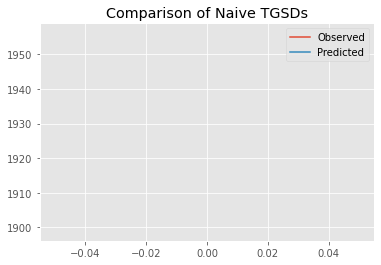

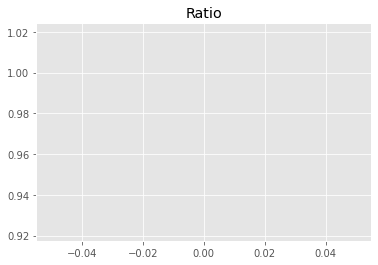

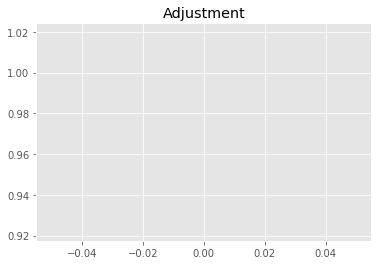

11110897905.543915
1


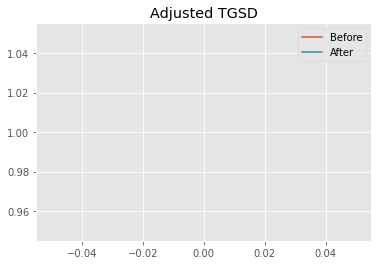

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.50739 	3.18243 	30806.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.34187 	2.9594 	32317.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.3508
New Misfit: 22.287
Convergence:
0.0028529888849741355

____________________
a = 2.34187	b = 2.95940	            h1 = 32317.77660	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.28702366115832
Prior Misfit: 0.207529,	 Post Misfit: 22.287


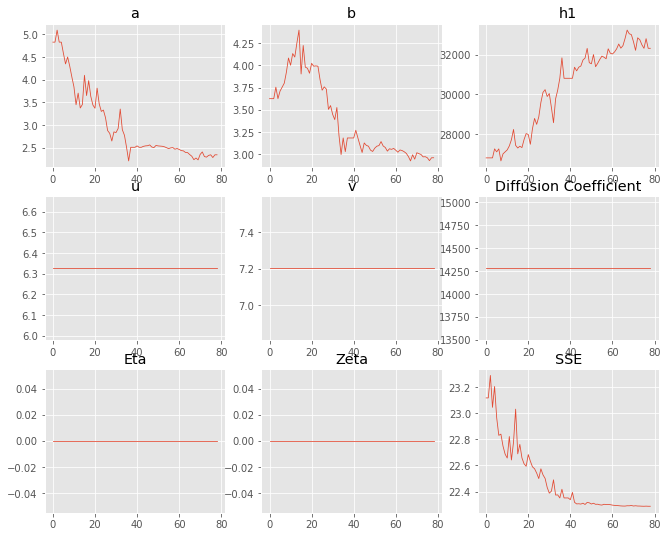

,Priors,Posteriors
a,4.82577,2.34187
b,3.62536,2.9594
h1,"26,794.8","32,317.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.048 minutes


Estimated remaining run time: 0.175 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.00e+03 	1.90e+03 	0.9488 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


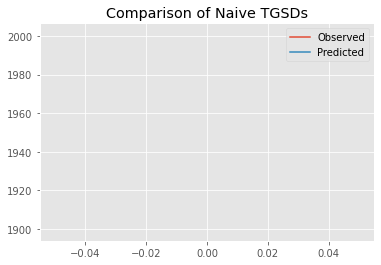

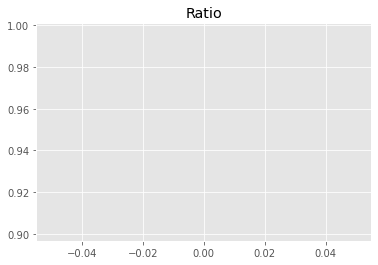

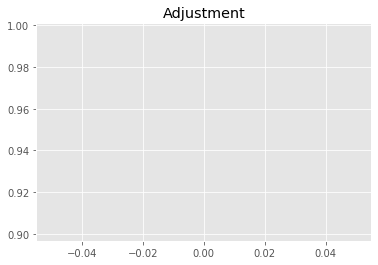

10859151249.861507
1


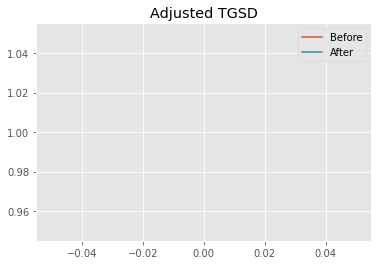

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.71024 	1.26809 	22748.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.74719 	1.16029 	24108.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.6541
New Misfit: 22.1953
Convergence:
0.020253060532633864

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9944 		1.0000


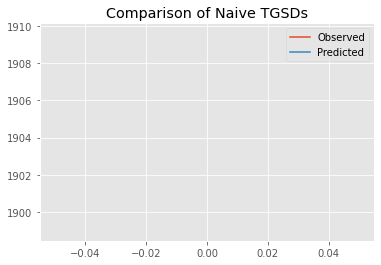

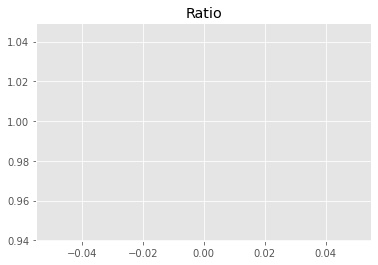

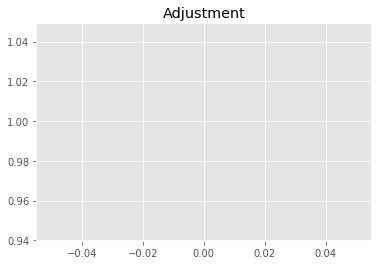

11381548829.962559
1


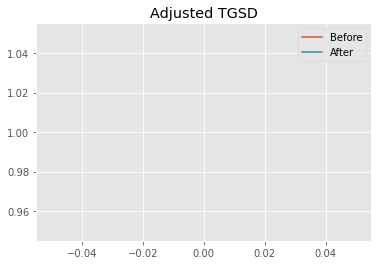

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.74719 	1.16029 	24108.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.68047 	1.1035 	24113.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.1953
New Misfit: 22.1915
Convergence:
0.00017019280882946795

____________________
a = 1.68047	b = 1.10350	            h1 = 24113.73733	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.191479490797843
Prior Misfit: 0.203372,	 Post Misfit: 22.1915


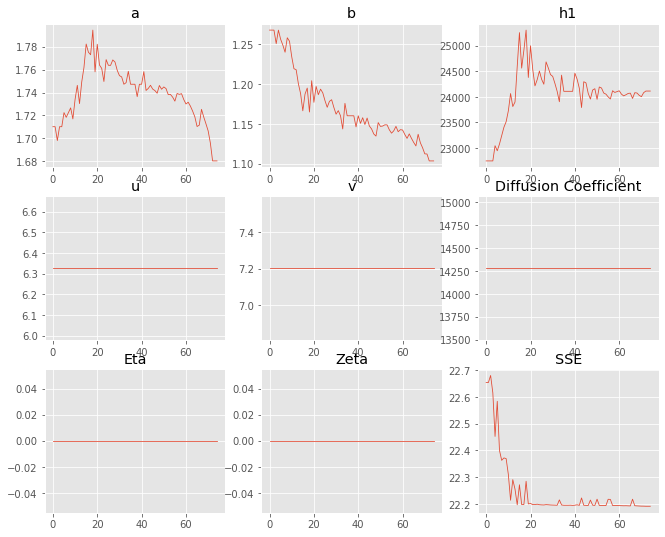

,Priors,Posteriors
a,1.71024,1.68047
b,1.26809,1.1035
h1,"22,748.7","24,113.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.047 minutes


Estimated remaining run time: 0.132 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	0.9978 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


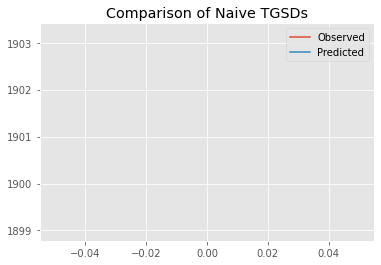

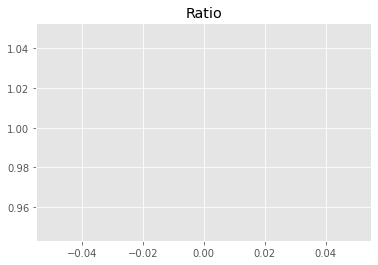

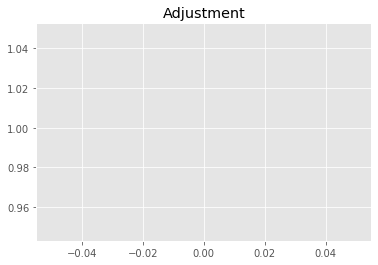

11419796762.018301
1


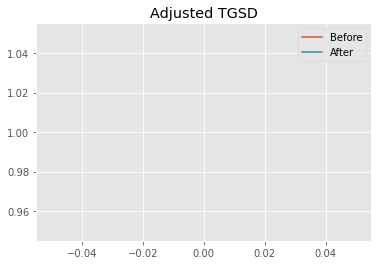

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.87065 	1.5399 	22102 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.14603 	1.46429 	23704.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.2023
New Misfit: 22.2804
Convergence:
0.039732223044317755

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.96e+03 	1.90e+03 	0.9673 		1.0000


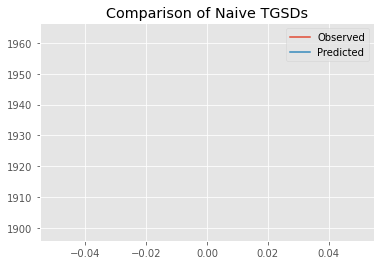

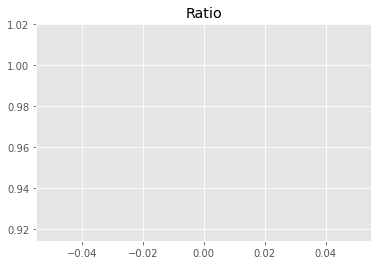

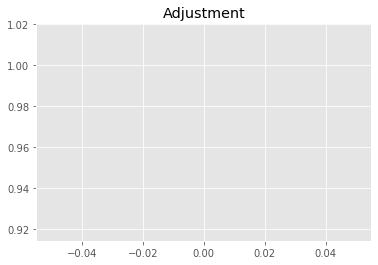

11070966010.561863
1


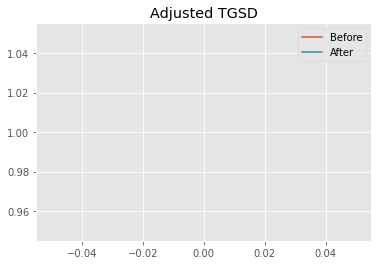

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.14603 	1.46429 	23704.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|1.88958 	1.46935 	25860 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2804
New Misfit: 22.2195
Convergence:
0.0027343784322241874

____________________
a = 1.88958	b = 1.46935	            h1 = 25860.00453	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.219518602560882
Prior Misfit: 0.208294,	 Post Misfit: 22.2195


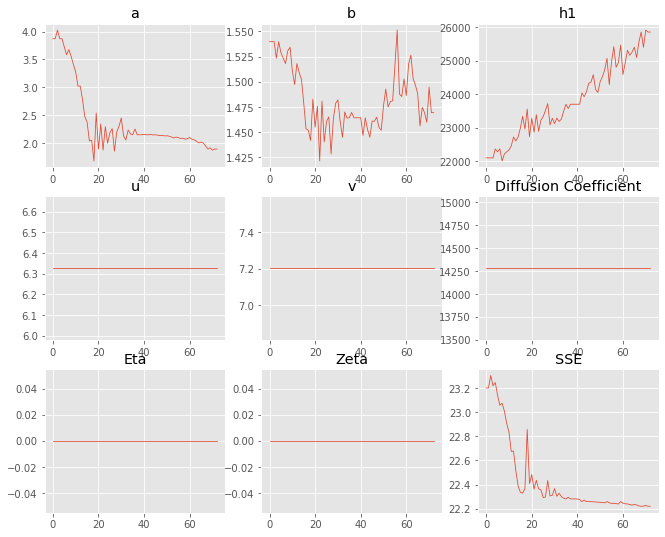

,Priors,Posteriors
a,3.87065,1.88958
b,1.5399,1.46935
h1,"22,102","25,860"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.046 minutes


Estimated remaining run time: 0.088 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.89e+03 	1.90e+03 	1.0060 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


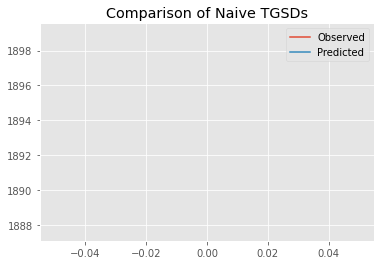

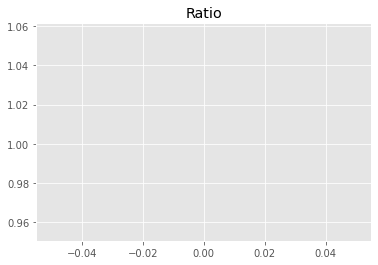

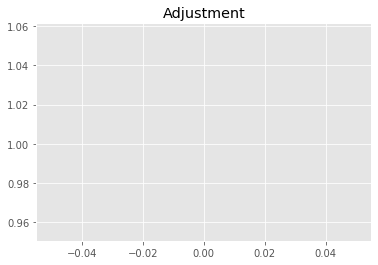

11513846097.53819
1


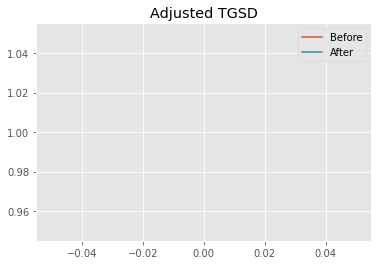

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.93739 	3.84429 	34414.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.43935 	3.83383 	36637.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.4629
New Misfit: 22.3076
Convergence:
0.0069160740195962946

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.90e+03 	1.90e+03 	0.9982 		1.0000


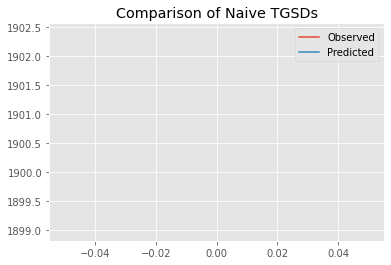

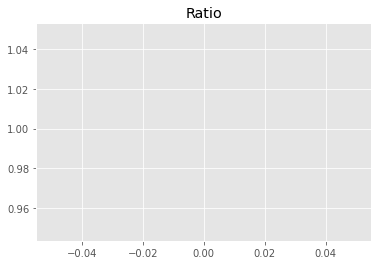

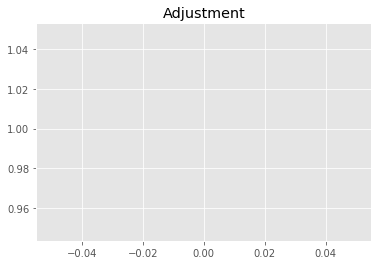

11424661948.611769
1


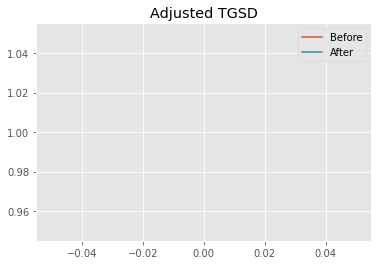

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.43935 	3.83383 	36637.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.4173 	2.99839 	31600.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.3076
New Misfit: 22.2923
Convergence:
0.0006826680686128489

____________________
a = 2.41730	b = 2.99839	            h1 = 31600.12247	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.292349410066162
Prior Misfit: 0.201656,	 Post Misfit: 22.2923


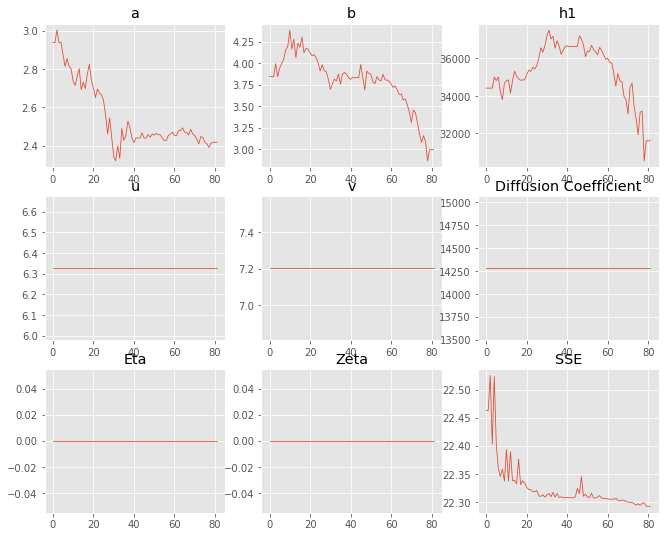

,Priors,Posteriors
a,2.93739,2.4173
b,3.84429,2.99839
h1,"34,414.2","31,600.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.051 minutes


Estimated remaining run time: 0.044 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.82e+03 	1.90e+03 	1.0452 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


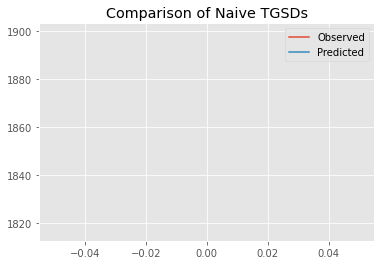

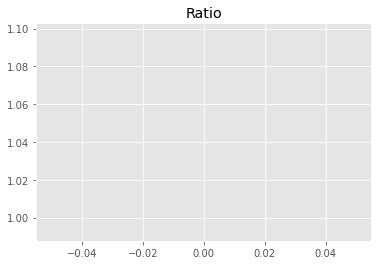

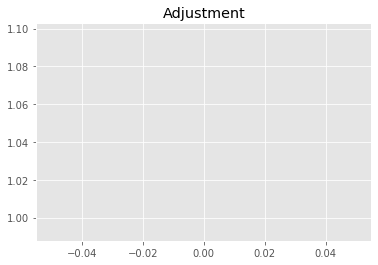

11962978675.14011
1


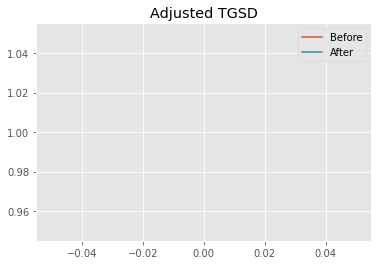

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.52722 	2.91363 	34515 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.44425 	3.18388 	32824.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.6813
New Misfit: 22.2949
Convergence:
0.017035905076620325

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.91e+03 	1.90e+03 	0.9932 		1.0000


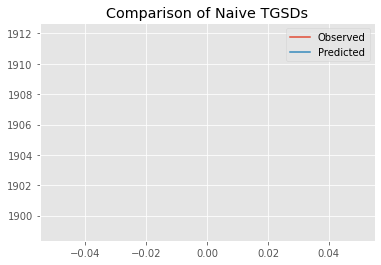

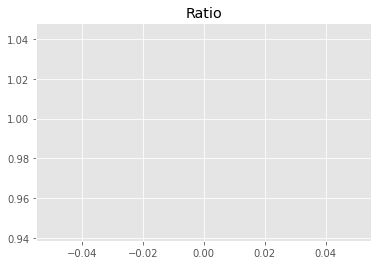

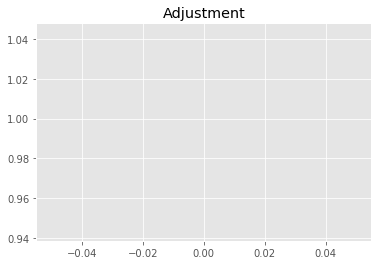

11367163329.811312
1


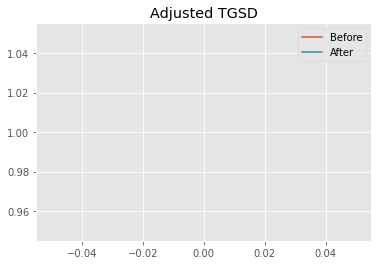

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.44425 	3.18388 	32824.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.14822 	2.46237 	30613.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2949
New Misfit: 22.276
Convergence:
0.0008482557324867978

____________________
a = 2.14822	b = 2.46237	            h1 = 30613.73751	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.27596485321611
Prior Misfit: 0.203616,	 Post Misfit: 22.276


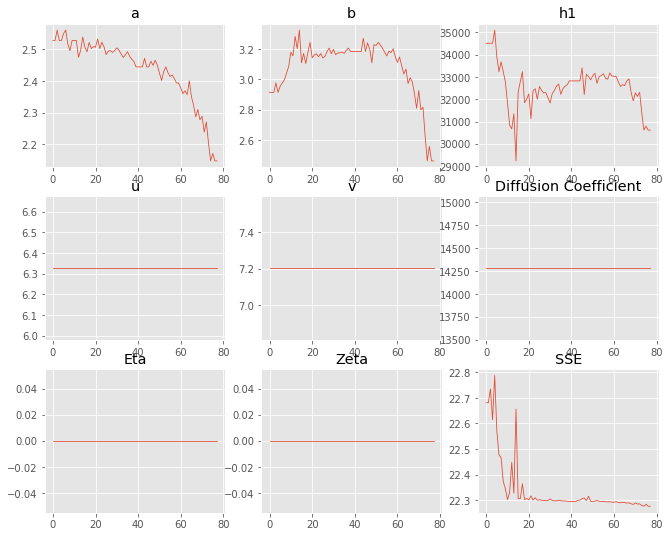

,Priors,Posteriors
a,2.52722,2.14822
b,2.91363,2.46237
h1,"34,515","30,613.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.048 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.04e+03 	1.90e+03 	0.9293 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


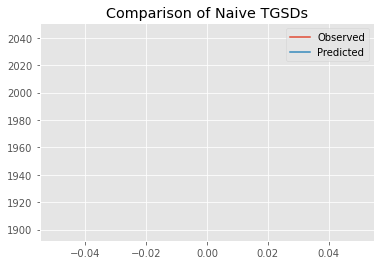

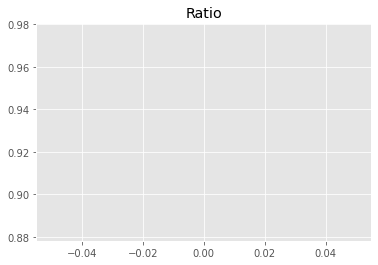

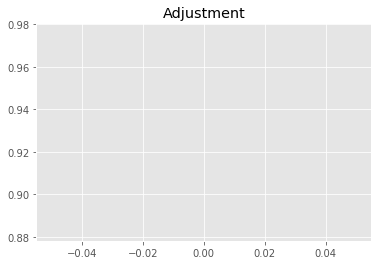

10636352908.544302
1


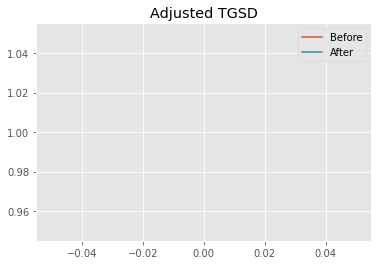

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.31311 	3.56283 	26547.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.26143 	2.82932 	32637.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.6906
New Misfit: 22.2892
Convergence:
0.0176894134314226

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	1.89e+03 	1.90e+03 	1.0033 		1.0000


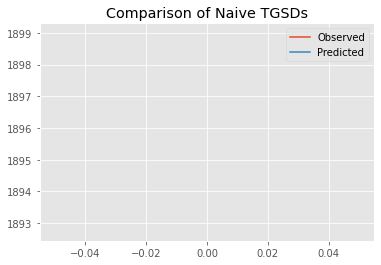

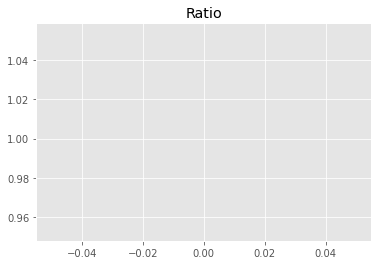

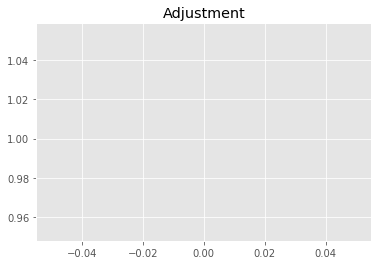

11482829844.171936
1


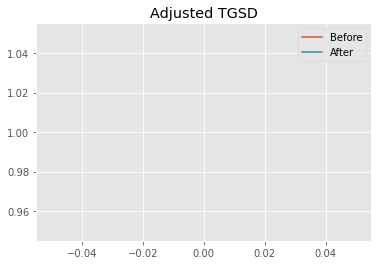

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.26143 	2.82932 	32637.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.14451e+10
After: 		|2.32369 	2.53588 	29924.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2892
New Misfit: 22.2774
Convergence:
0.0005302737985429335

____________________
a = 2.32369	b = 2.53588	            h1 = 29924.94675	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 22.277363403891897
Prior Misfit: 0.203699,	 Post Misfit: 22.2774


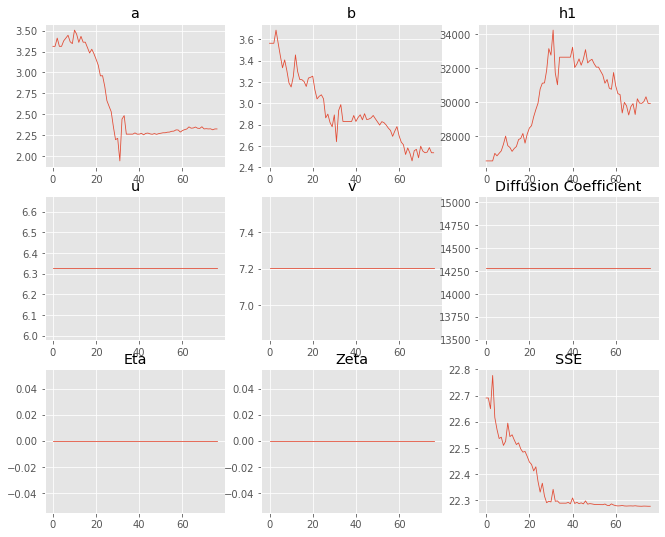

,Priors,Posteriors
a,3.31311,2.32369
b,3.56283,2.53588
h1,"26,547.8","29,924.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.046 minutes


Estimated remaining run time: -0.045 minutes


Total Run Time: 0.93726 minutes


[{'a': 1.8274302007704866,
  'b': 1.4299251019085568,
  'h1': 25833.660497736,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.201818047764508,
  'b': 2.906108105745038,
  'h1': 33079.39348486758,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.1467060131361677,
  'b': 2.1169888617310413,
  'h1': 28384.118701532185,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.645782672023679,
  'b': 5.186556185613442,
  'h1': 41627.831362172794,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.2152181748214756,
  'b': 2.395467903444943,
  'h1': 29956.022994888255,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.28621

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
15,1.68047,1.1035,"24,113.7",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199219
16,1.88958,1.46935,"25,860",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199471
0,1.82743,1.42993,"25,833.7",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199476
7,2.14973,1.942,"27,197.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.19977
12,2.12639,2.03591,"28,182.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199774
2,2.14671,2.11699,"28,384.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.19982
13,2.20688,2.10941,"27,814",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199851
10,2.21159,2.27624,"29,034.2",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199878
4,2.21522,2.39547,"29,956",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199921
5,2.28622,2.23222,"28,109.4",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199929


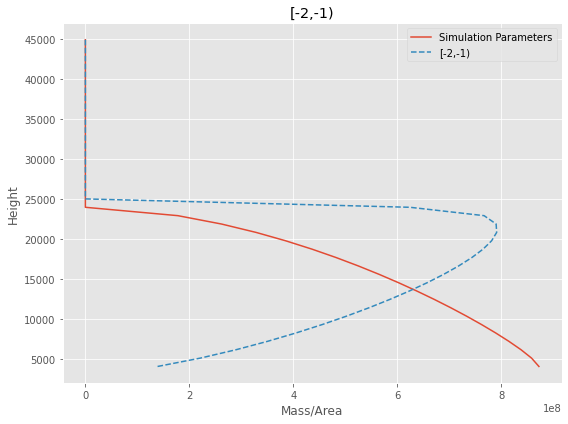

[-2,-1) Run Time: 0.93975 minutes


Mass Test: 34857356748.13845
========[-1,0)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0224 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


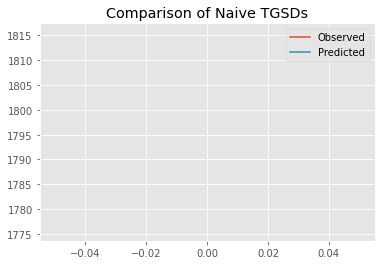

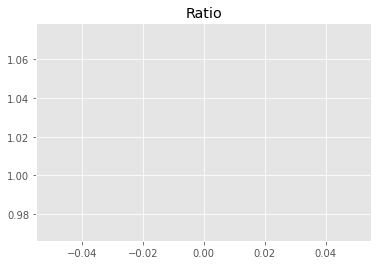

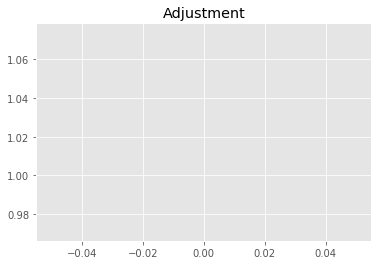

11187125618.855211
1


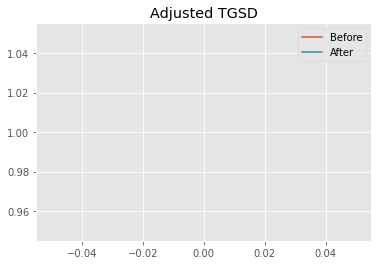

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.19413 	2.8899 	21807.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.52285 	1.72912 	18678.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.6237
New Misfit: 21.5021
Convergence:
0.08981133873752879

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.69e+03 	1.82e+03 	1.0756 		1.0000


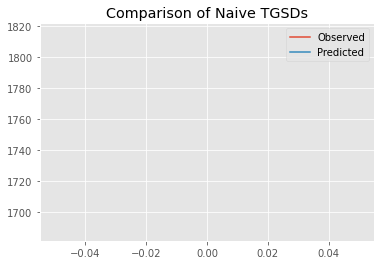

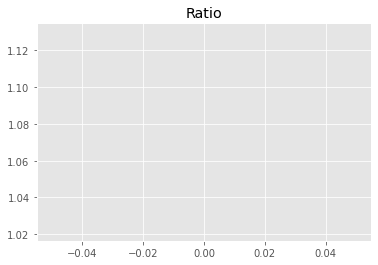

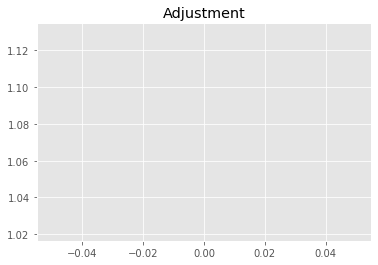

11768587102.237617
1


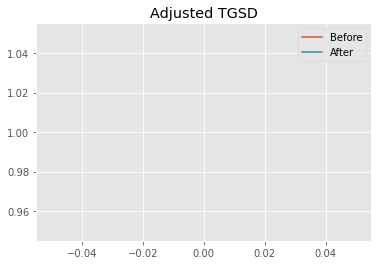

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.52285 	1.72912 	18678.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|15.5873 	1.62775 	12693.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.5021
New Misfit: 19.8917
Convergence:
0.07489328653768167

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.82e+03 	1.82e+03 	0.9994 		1.0000


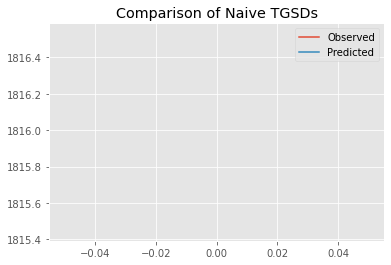

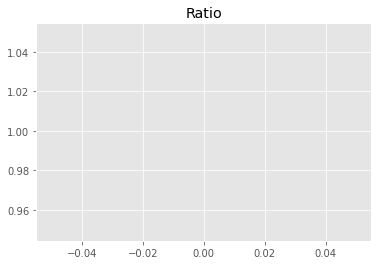

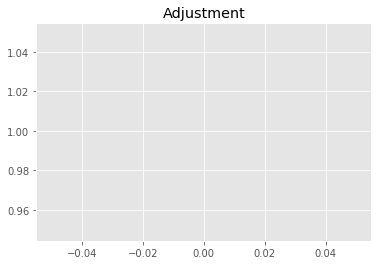

10935052925.610464
1


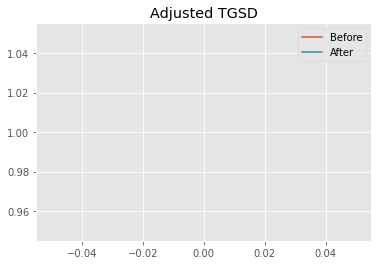

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|15.5873 	1.62775 	12693.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|27.4803 	1.60421 	12951.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8917
New Misfit: 19.8285
Convergence:
0.0031752348336589135

____________________
a = 27.48031	b = 1.60421	            h1 = 12951.49796	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.82854185793456
Prior Misfit: 0.235445,	 Post Misfit: 19.8285


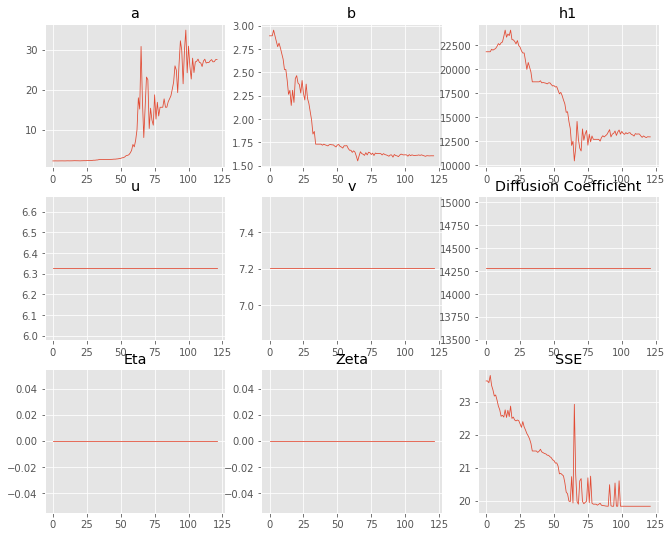

,Priors,Posteriors
a,2.19413,27.4803
b,2.8899,1.60421
h1,"21,807.7","12,951.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.068 minutes


Estimated remaining run time: 0.612 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.66e+03 	1.82e+03 	1.0923 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


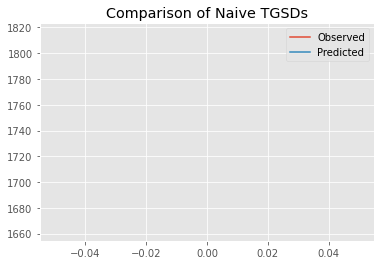

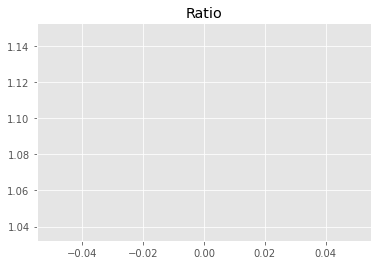

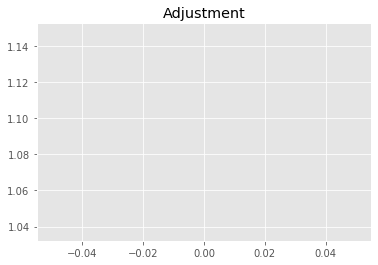

11951042753.998524
1


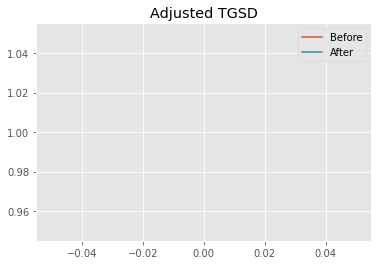

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.49626 	1.88915 	22864.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.88643 	1.6854 	16162.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.3577
New Misfit: 20.5068
Convergence:
0.15809661071944772

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.73e+03 	1.82e+03 	1.0508 		1.0000


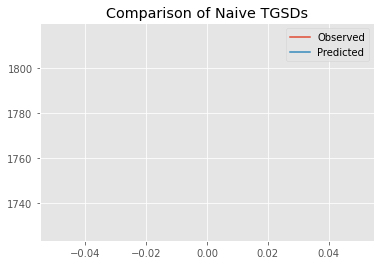

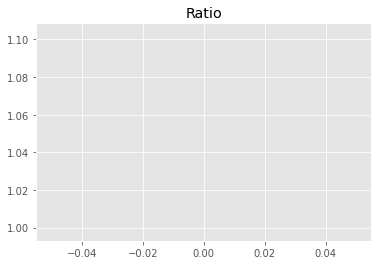

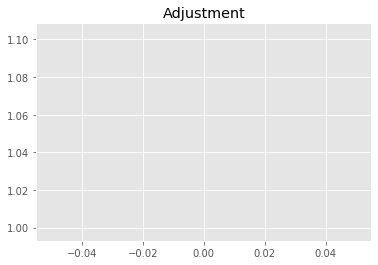

11496949335.365482
1


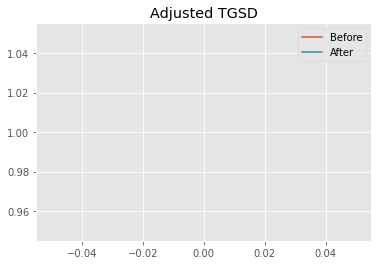

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.88643 	1.6854 	16162.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.39505 	3.2006 	15754.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.5068
New Misfit: 20.143
Convergence:
0.017744060252057145

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0283 		1.0000


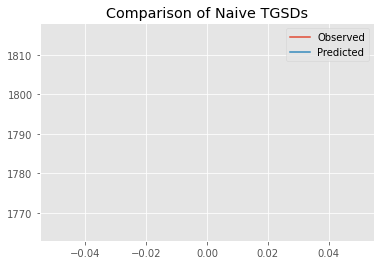

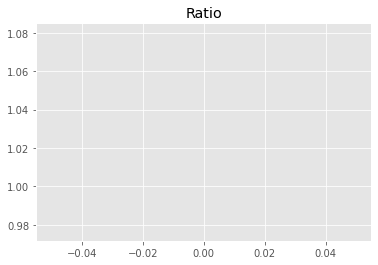

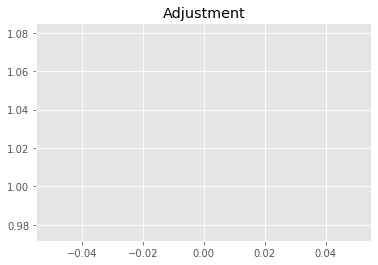

11251239273.84682
1


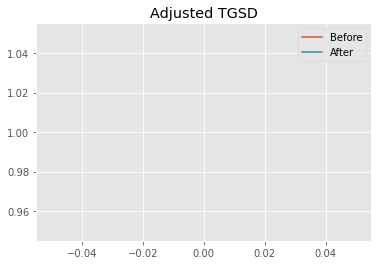

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.39505 	3.2006 	15754.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|17.004 	8.31956 	16437.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.143
New Misfit: 19.9713
Convergence:
0.00852145131436579

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.75e+03 	1.82e+03 	1.0371 		1.0000


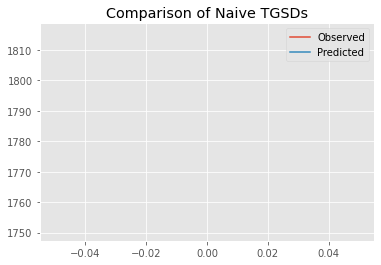

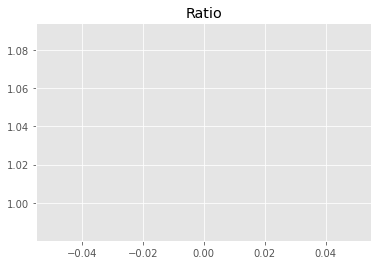

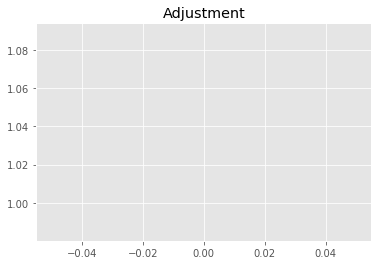

11347156041.603983
1


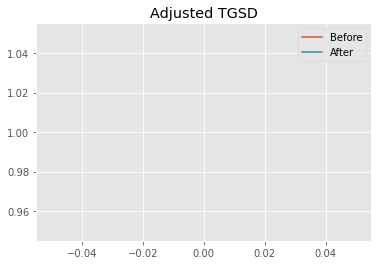

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|17.004 	8.31956 	16437.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|231.952 	118.647 	16437.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9713
New Misfit: 19.8352
Convergence:
0.006817704391519047

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0267 		1.0000


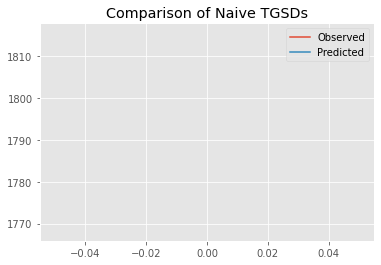

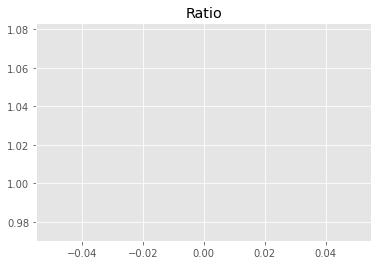

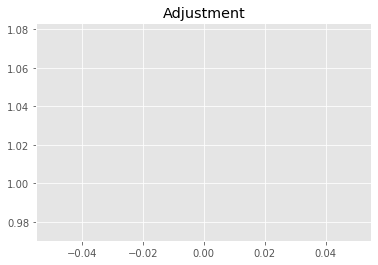

11233578355.256153
1


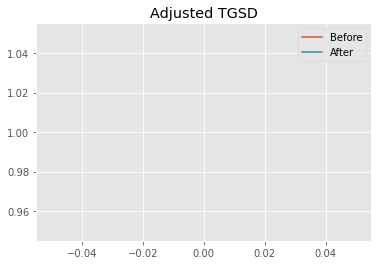

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|231.952 	118.647 	16437.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|234.596 	122.84 	16434.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8352
New Misfit: 19.8321
Convergence:
0.00015567460074913294

____________________
a = 234.59587	b = 122.84050	            h1 = 16434.87868	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 19.832072139165174
Prior Misfit: 0.24276,	 Post Misfit: 19.8321


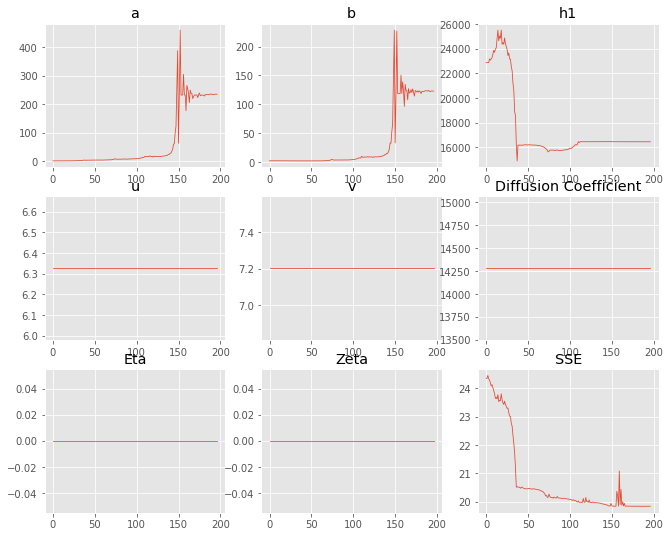

,Priors,Posteriors
a,1.49626,234.596
b,1.88915,122.84
h1,"22,864.1","16,434.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.100 minutes


Estimated remaining run time: 0.951 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0232 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


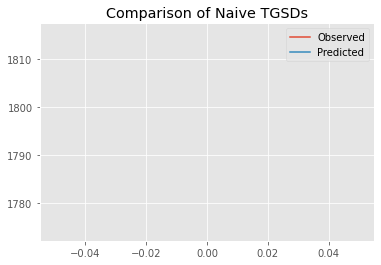

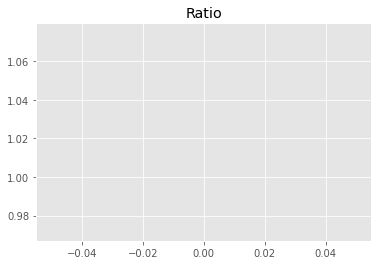

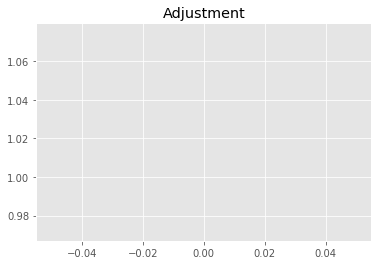

11195806158.239437
1


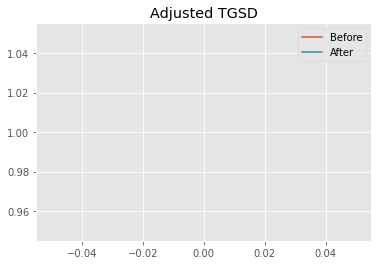

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.2832 	2.48983 	16800.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.10604 	3.53881 	16447.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.655
New Misfit: 20.1886
Convergence:
0.022579426937636145

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0335 		1.0000


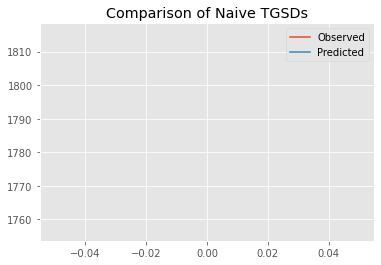

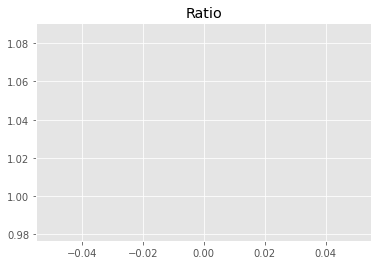

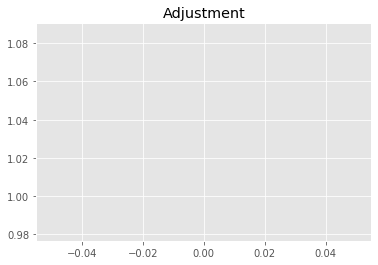

11308337671.043158
1


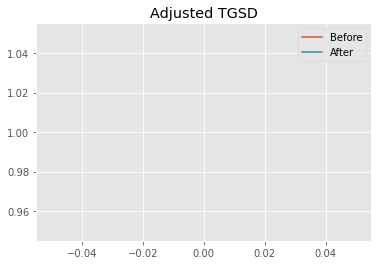

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.10604 	3.53881 	16447.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|30.4781 	16.3431 	16567.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.1886
New Misfit: 19.9017
Convergence:
0.014212315924089792

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0199 		1.0000


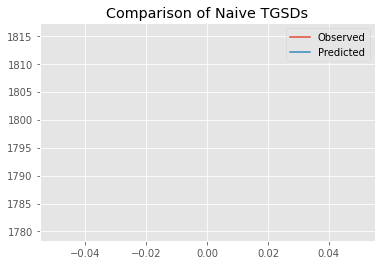

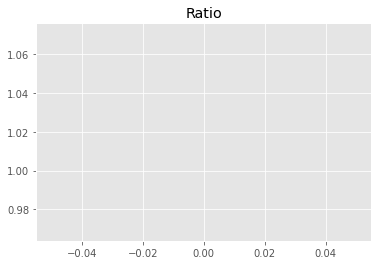

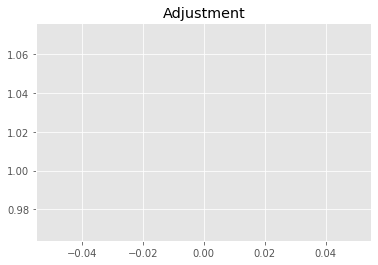

11158873890.97271
1


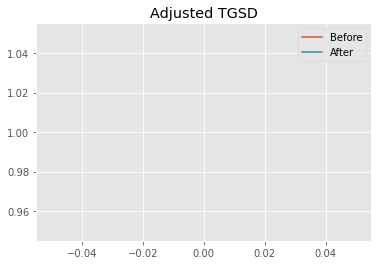

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|30.4781 	16.3431 	16567.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|60.7074 	33.0755 	16576.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9017
New Misfit: 19.8646
Convergence:
0.0018645457578141842

____________________
a = 60.70735	b = 33.07548	            h1 = 16576.08029	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.86455810267832
Prior Misfit: 0.205857,	 Post Misfit: 19.8646


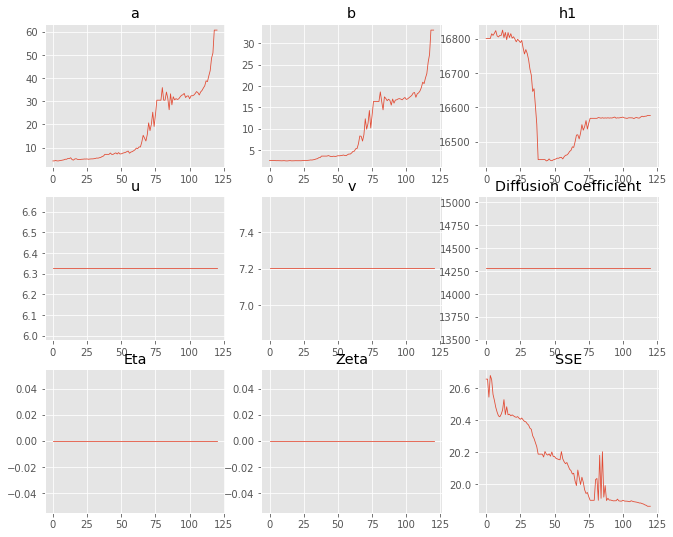

,Priors,Posteriors
a,4.2832,60.7074
b,2.48983,33.0755
h1,"16,800.4","16,576.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.067 minutes


Estimated remaining run time: 0.939 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.97e+03 	1.82e+03 	0.9208 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


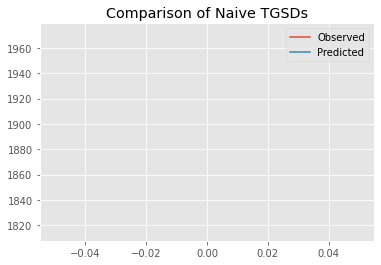

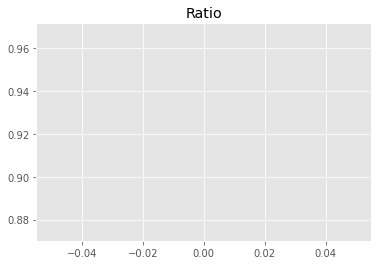

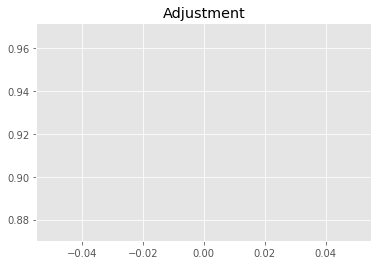

10074671855.150349
1


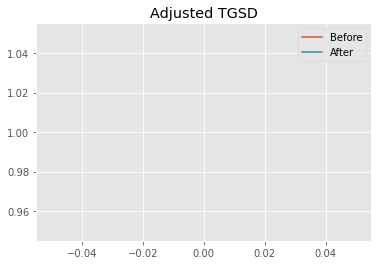

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.59743 	1.98768 	14412.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.11446 	1.98775 	15519.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.9216
New Misfit: 20.2691
Convergence:
0.1157177851330005

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0214 		1.0000


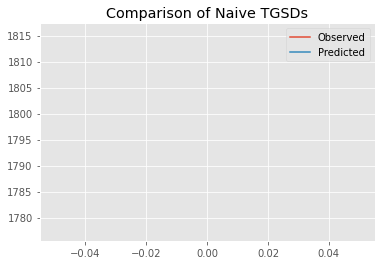

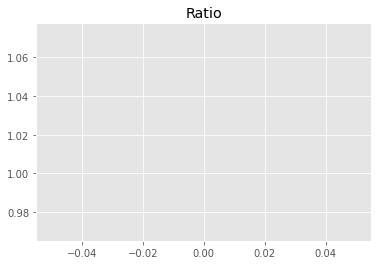

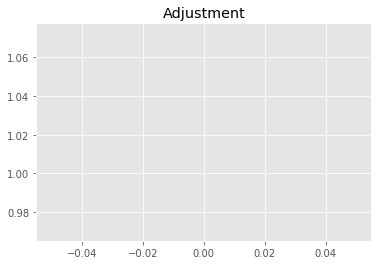

11175649876.159222
1


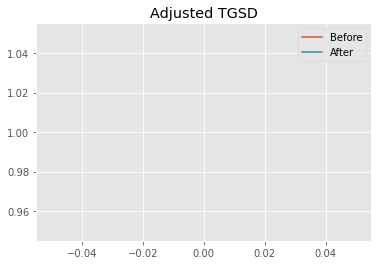

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.11446 	1.98775 	15519.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|6.65086 	1.98803 	14859.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.2691
New Misfit: 20.1055
Convergence:
0.008072153582751759

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.74e+03 	1.82e+03 	1.0449 		1.0000


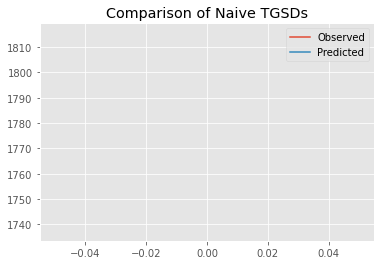

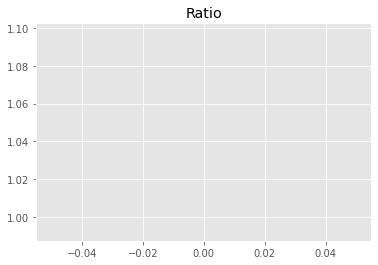

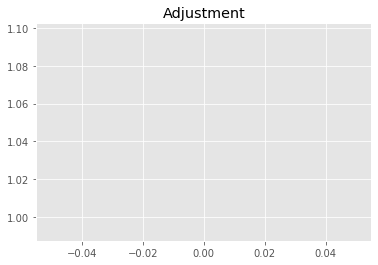

11432800432.492762
1


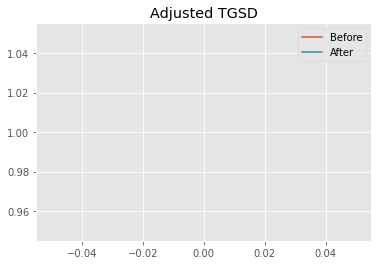

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.65086 	1.98803 	14859.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|11.4172 	2.00116 	13554.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.1055
New Misfit: 19.9237
Convergence:
0.009046177215214913

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0322 		1.0000


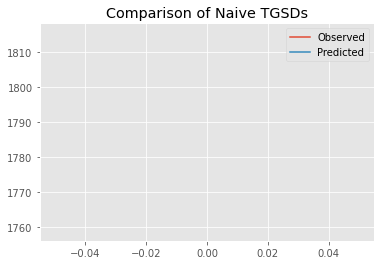

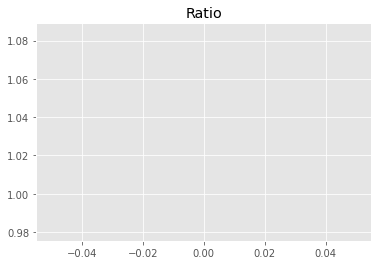

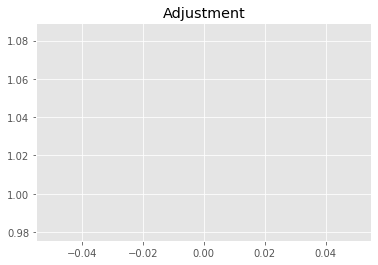

11293792458.829172
1


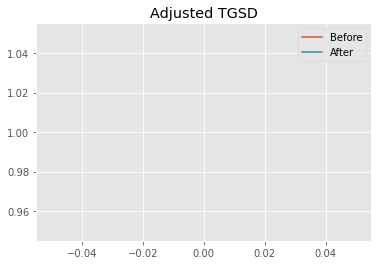

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|11.4172 	2.00116 	13554.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|11.4424 	2.00122 	13542.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9237
New Misfit: 19.9227
Convergence:
4.75376813496953e-05

____________________
a = 11.44240	b = 2.00122	            h1 = 13542.94934	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.922707976206876
Prior Misfit: 0.228447,	 Post Misfit: 19.9227


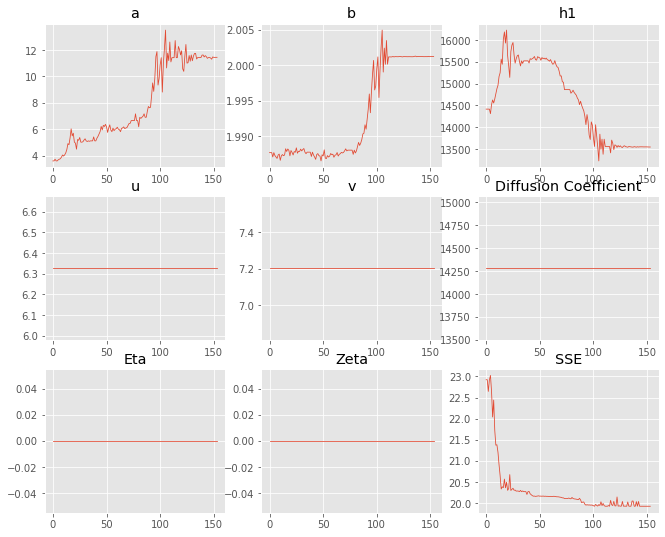

,Priors,Posteriors
a,3.59743,11.4424
b,1.98768,2.00122
h1,"14,412.2","13,542.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.086 minutes


Estimated remaining run time: 0.961 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.52e+03 	1.82e+03 	1.1940 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


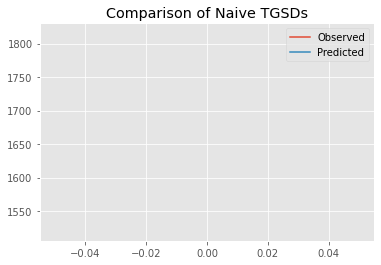

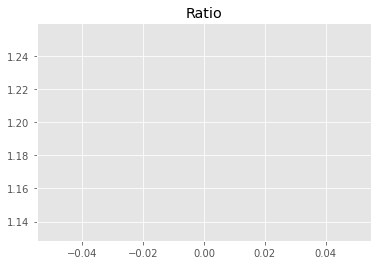

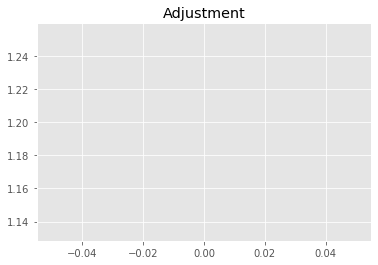

13064733198.304014
1


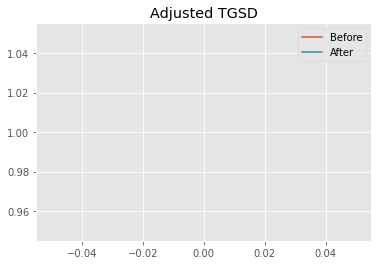

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03391 	2.38947 	25867.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.13496 	1.64801 	18426.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.1815
New Misfit: 22.2525
Convergence:
0.04007602076164846

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.73e+03 	1.82e+03 	1.0473 		1.0000


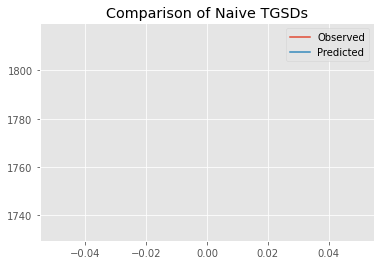

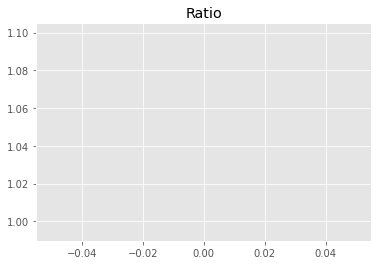

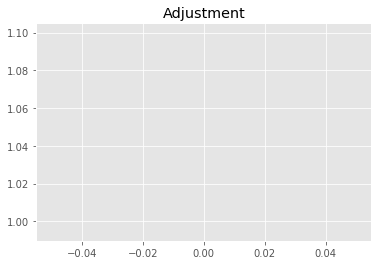

11459074137.728493
1


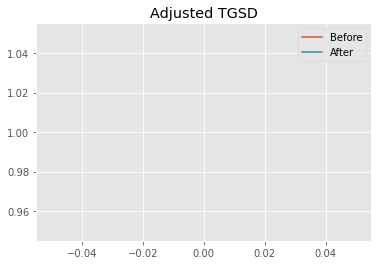

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.13496 	1.64801 	18426.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.43316 	1.13928 	16452.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.2525
New Misfit: 21.1897
Convergence:
0.047758754327000316

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.75e+03 	1.82e+03 	1.0391 		1.0000


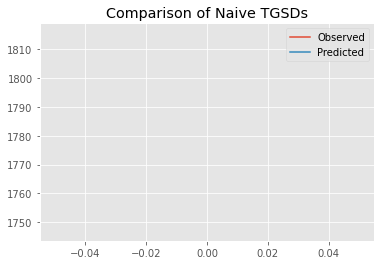

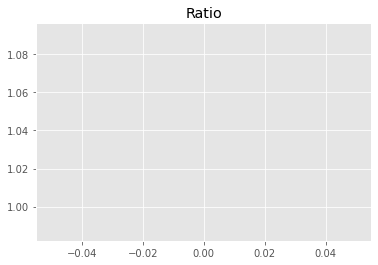

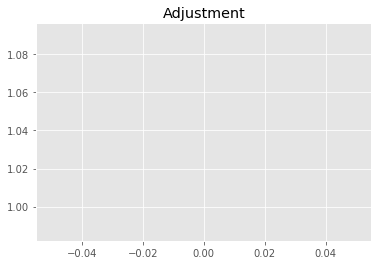

11369928824.772717
1


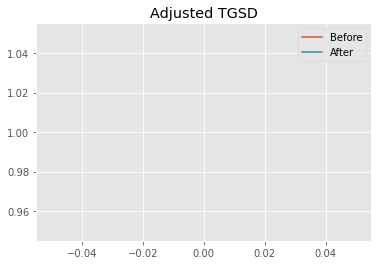

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.43316 	1.13928 	16452.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.21458 	1.06779 	16538.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.1897
New Misfit: 20.6798
Convergence:
0.02406632938479636

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.66e+03 	1.82e+03 	1.0942 		1.0000


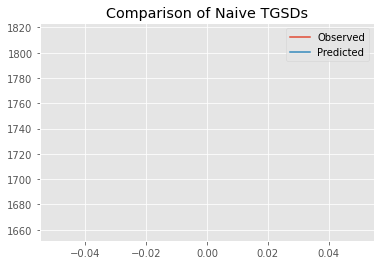

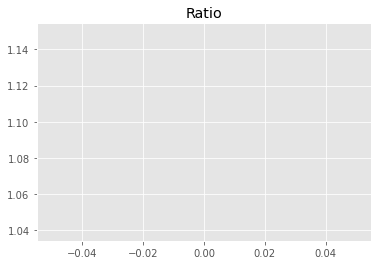

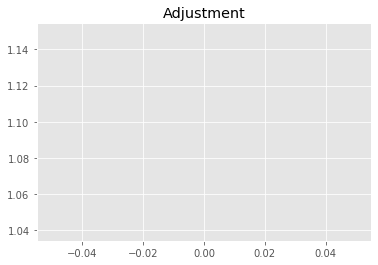

11972832516.212126
1


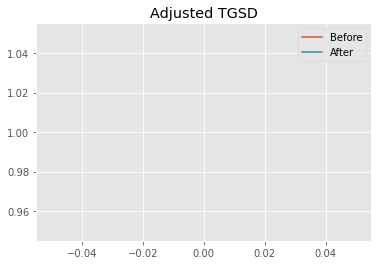

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.21458 	1.06779 	16538.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.9755 	1.64505 	16534 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.6798
New Misfit: 20.4959
Convergence:
0.008890129451060859

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.70e+03 	1.82e+03 	1.0692 		1.0000


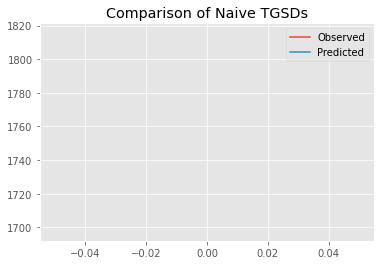

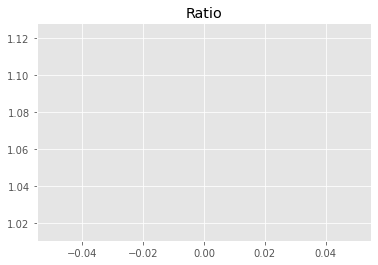

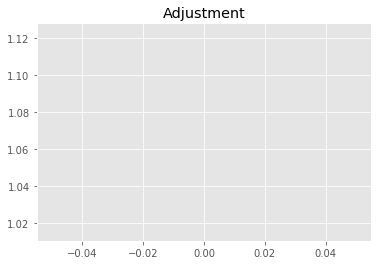

11699083040.823433
1


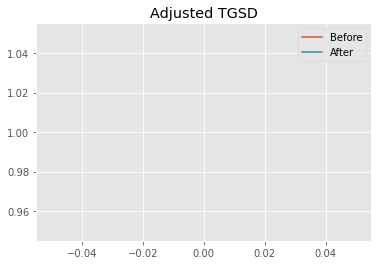

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.9755 	1.64505 	16534 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|16.7524 	8.07787 	16539.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.4959
New Misfit: 19.9996
Convergence:
0.024213867430813944

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.73e+03 	1.82e+03 	1.0473 		1.0000


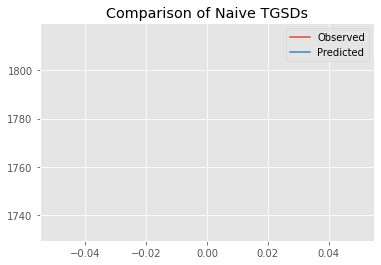

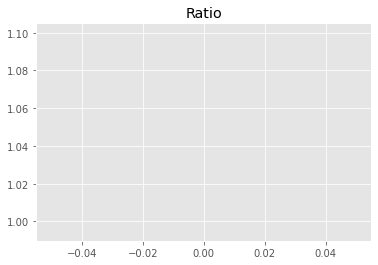

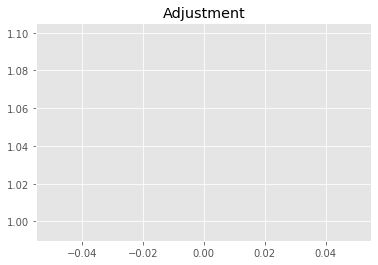

11459571162.774803
1


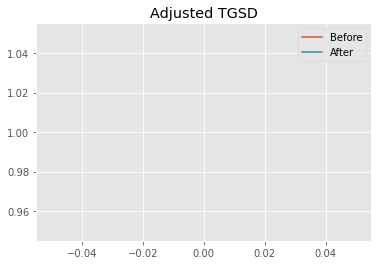

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|16.7524 	8.07787 	16539.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|84.7257 	45.6801 	16535.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9996
New Misfit: 19.8528
Convergence:
0.0073441198452141926

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.79e+03 	1.82e+03 	1.0167 		1.0000


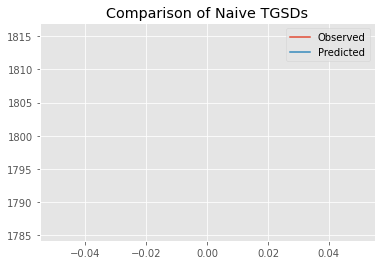

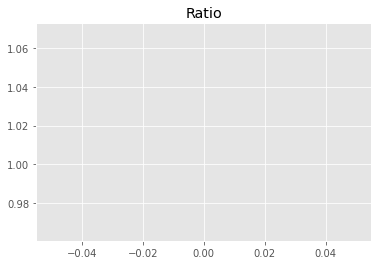

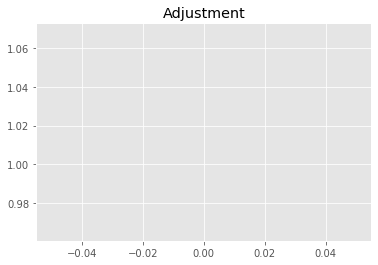

11124008358.373638
1


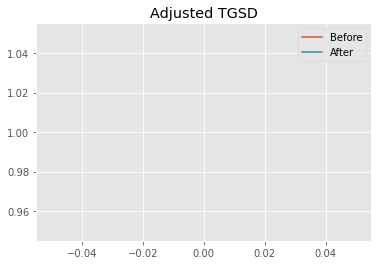

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|84.7257 	45.6801 	16535.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|280.897 	151.964 	16534.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8528
New Misfit: 19.8306
Convergence:
0.0011177299407791716

____________________
a = 280.89717	b = 151.96387	            h1 = 16534.47552	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 7
Misfit: 19.830570760491643
Prior Misfit: 0.231037,	 Post Misfit: 19.8306


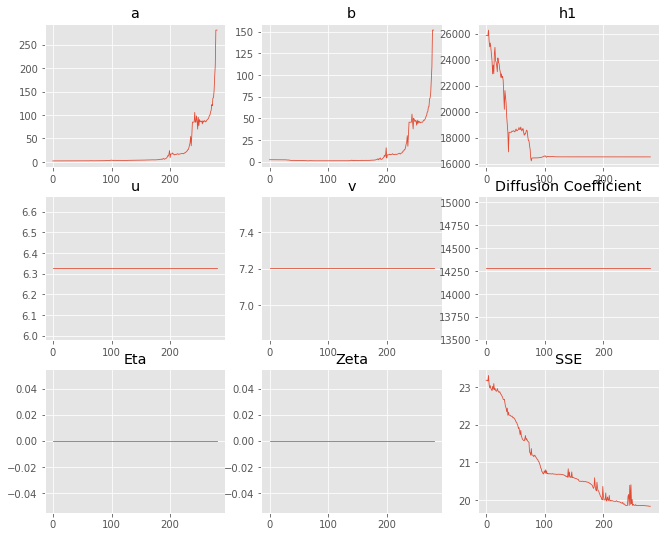

,Priors,Posteriors
a,2.03391,280.897
b,2.38947,151.964
h1,"25,867.1","16,534.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.136 minutes


Estimated remaining run time: 1.066 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.98e+03 	1.82e+03 	0.9156 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


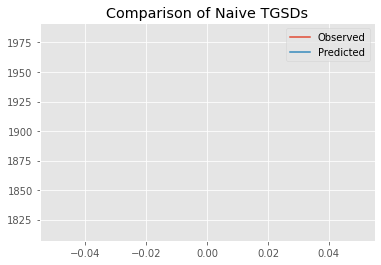

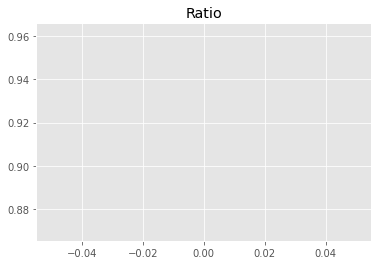

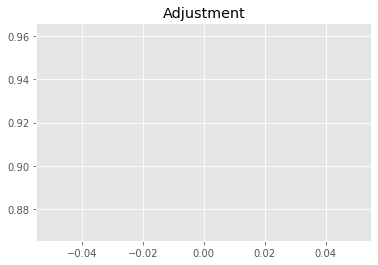

10018045290.786444
1


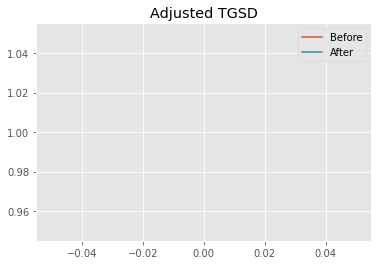

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.28166 	4.80311 	17809.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.36802 	3.32445 	17910.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.973
New Misfit: 20.4477
Convergence:
0.14705522727991044

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.71e+03 	1.82e+03 	1.0586 		1.0000


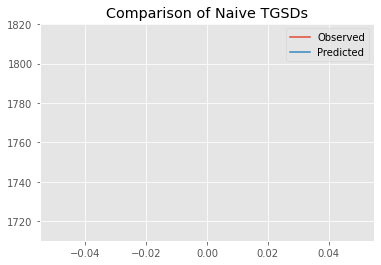

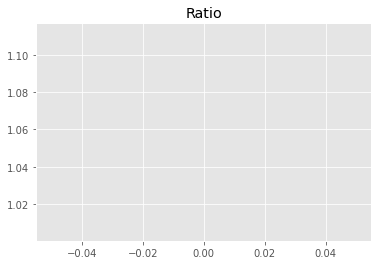

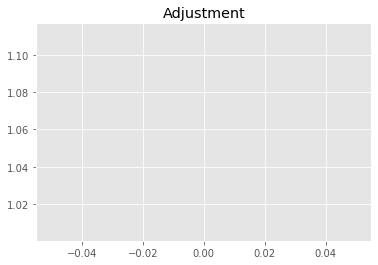

11582636557.394798
1


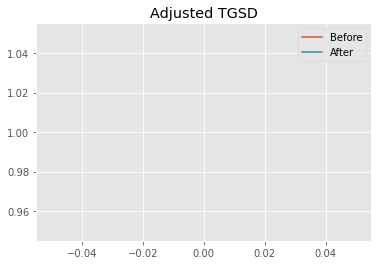

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.36802 	3.32445 	17910.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|41.4508 	10.5383 	14168 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.4477
New Misfit: 19.8601
Convergence:
0.028735493126878665

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0256 		1.0000


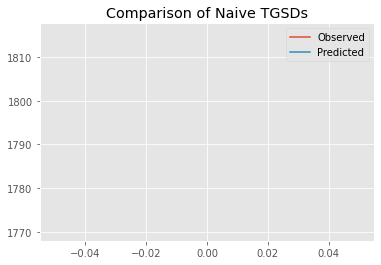

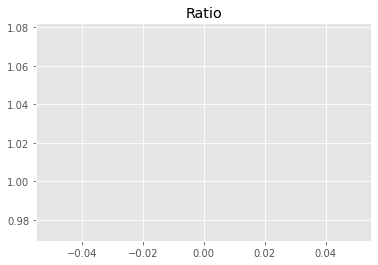

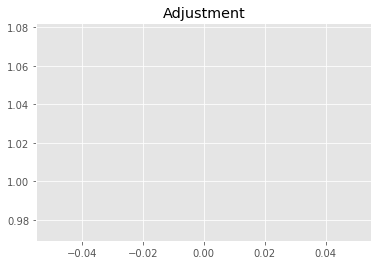

11221309800.262072
1


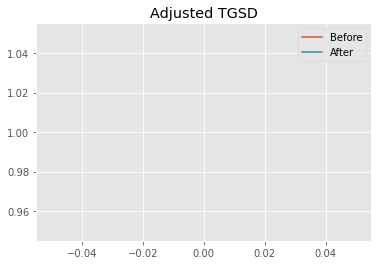

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|41.4508 	10.5383 	14168 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|52.7173 	10.4964 	13559.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8601
New Misfit: 19.8454
Convergence:
0.0007426734065268425

____________________
a = 52.71732	b = 10.49636	            h1 = 13559.30346	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.845357664317955
Prior Misfit: 0.238926,	 Post Misfit: 19.8454


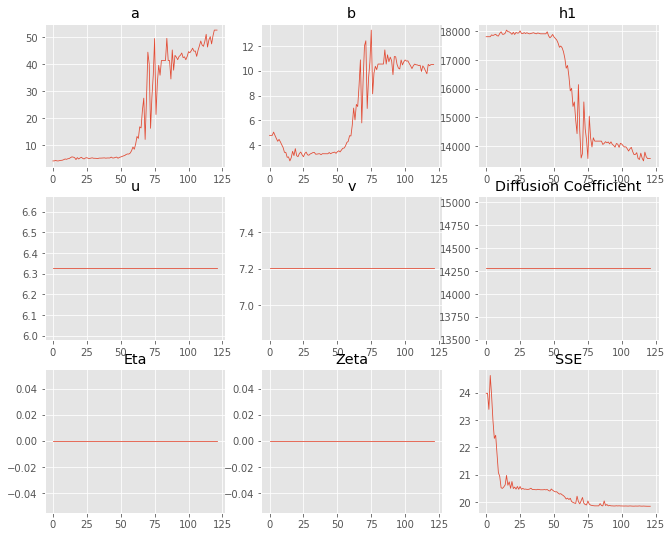

,Priors,Posteriors
a,4.28166,52.7173
b,4.80311,10.4964
h1,"17,809.3","13,559.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.066 minutes


Estimated remaining run time: 0.970 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.86e+03 	1.82e+03 	0.9742 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


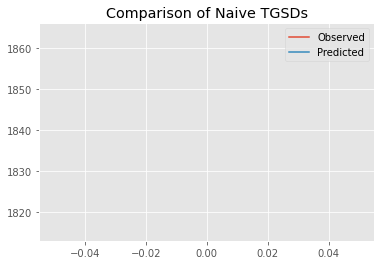

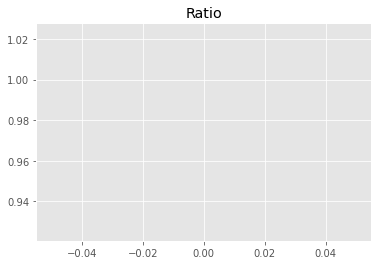

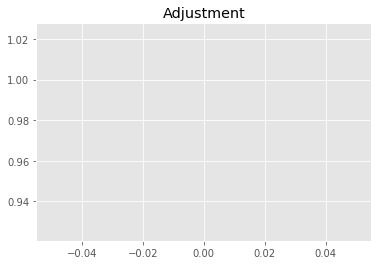

10658935886.215292
1


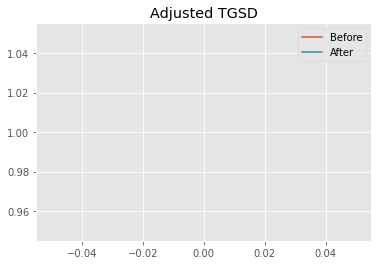

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.66919 	1.72649 	14905.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.67933 	1.71281 	15160.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.1947
New Misfit: 20.166
Convergence:
0.048537818013869395

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.73e+03 	1.82e+03 	1.0522 		1.0000


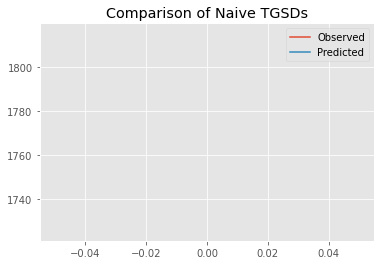

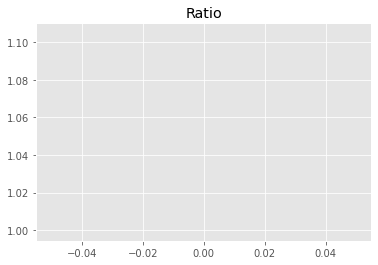

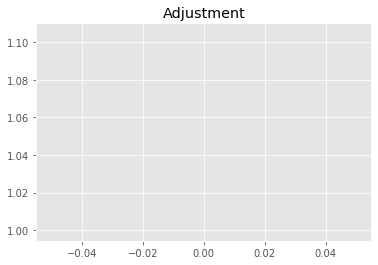

11512316049.94286
1


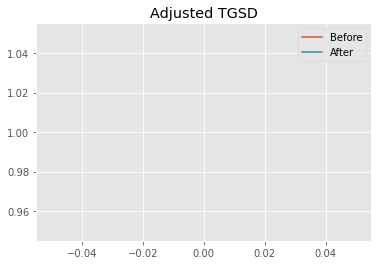

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.67933 	1.71281 	15160.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.0604 	1.92782 	14549.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.166
New Misfit: 20.0611
Convergence:
0.005197848682084561

____________________
a = 7.06040	b = 1.92782	            h1 = 14549.65499	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 20.06113431278217
Prior Misfit: 0.211236,	 Post Misfit: 20.0611


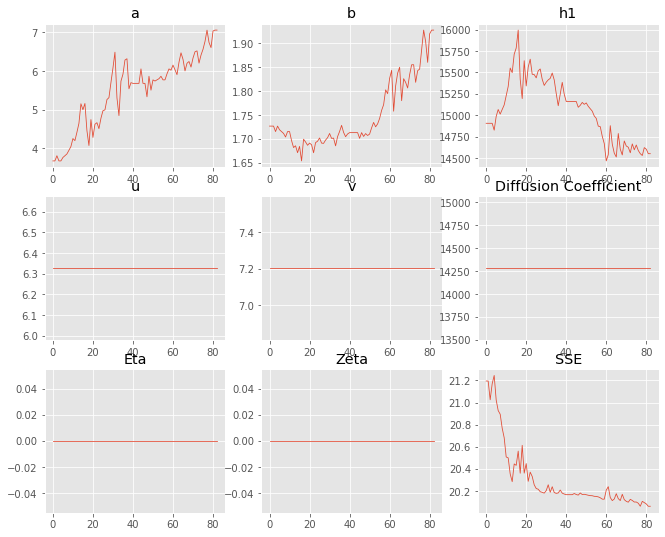

,Priors,Posteriors
a,3.66919,7.0604
b,1.72649,1.92782
h1,"14,905.1","14,549.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.049 minutes


Estimated remaining run time: 0.858 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.39e+03 	1.82e+03 	1.3092 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


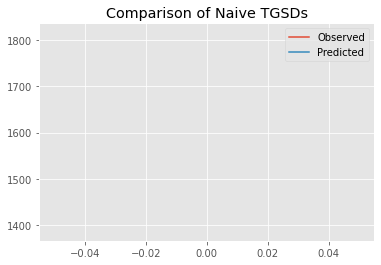

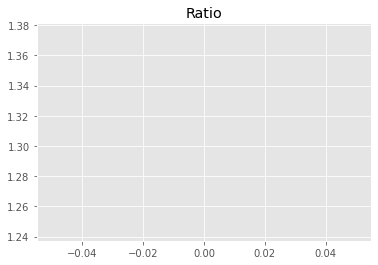

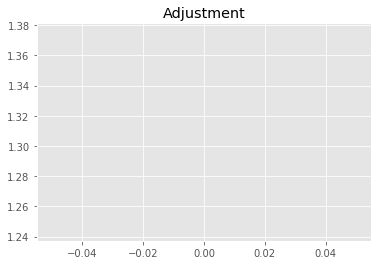

14324789259.10933
1


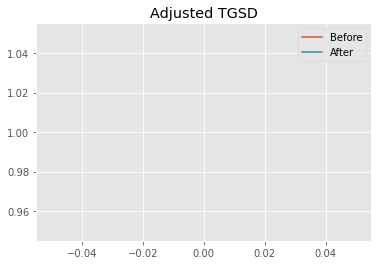

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.82922 	1.76092 	18955.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.3593 	1.74178 	17825.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.3124
New Misfit: 21.0284
Convergence:
0.09797427447039964

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.63e+03 	1.82e+03 	1.1151 		1.0000


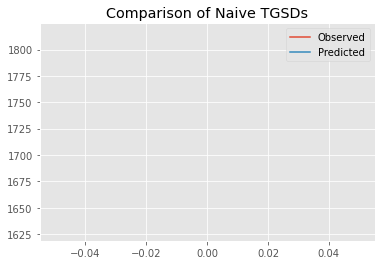

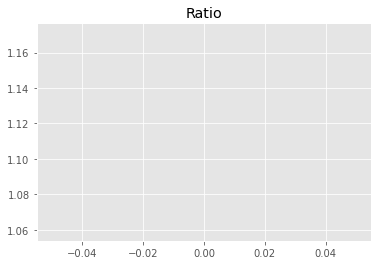

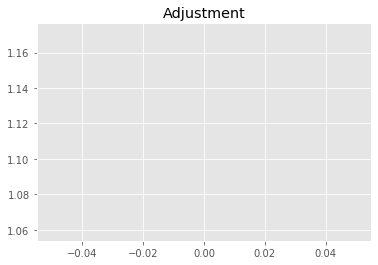

12201385957.735662
1


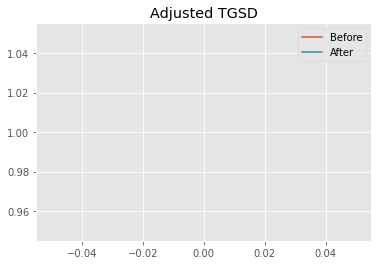

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.3593 	1.74178 	17825.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.80222 	1.56045 	13581.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.0284
New Misfit: 19.9848
Convergence:
0.04962613305669044

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0171 		1.0000


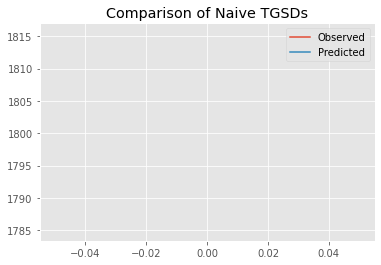

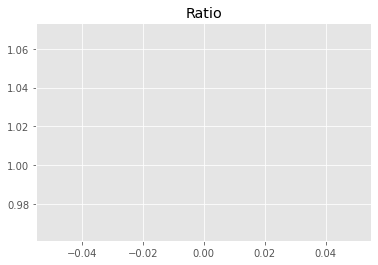

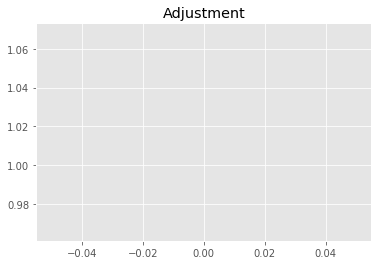

11128764469.081654
1


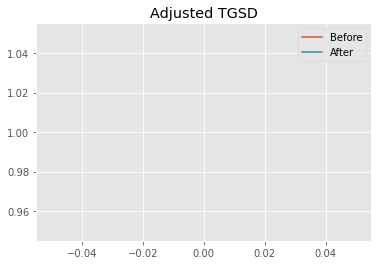

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.80222 	1.56045 	13581.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|9.34168 	1.57278 	13545.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9848
New Misfit: 19.9448
Convergence:
0.002002952828087645

____________________
a = 9.34168	b = 1.57278	            h1 = 13545.05042	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.9448093074926
Prior Misfit: 0.232342,	 Post Misfit: 19.9448


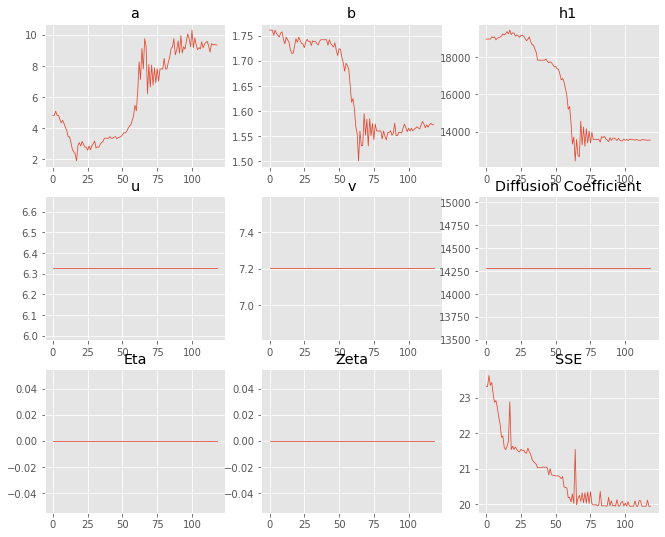

,Priors,Posteriors
a,4.82922,9.34168
b,1.76092,1.57278
h1,"18,955.1","13,545.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.066 minutes


Estimated remaining run time: 0.780 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.53e+03 	1.82e+03 	1.1852 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


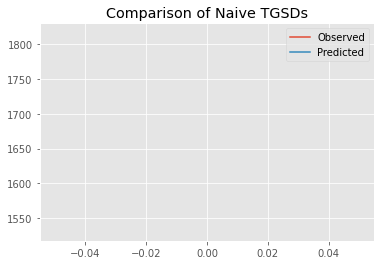

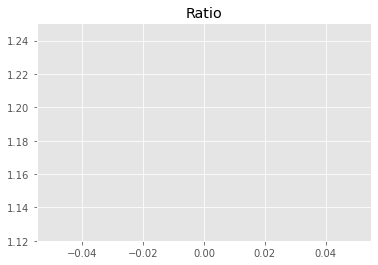

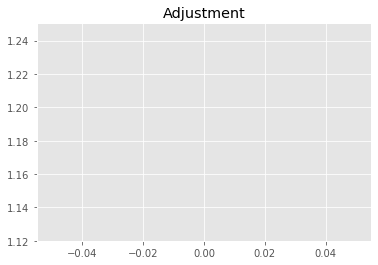

12967486030.028637
1


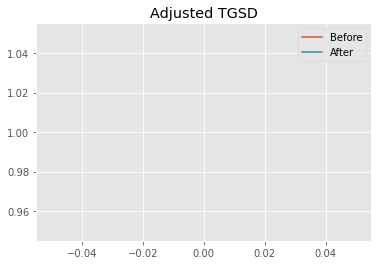

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85754 	2.40235 	26681.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|1.86775 	2.27578 	24187.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.5082
New Misfit: 23.2404
Convergence:
0.011392247109554283

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.61e+03 	1.82e+03 	1.1294 		1.0000


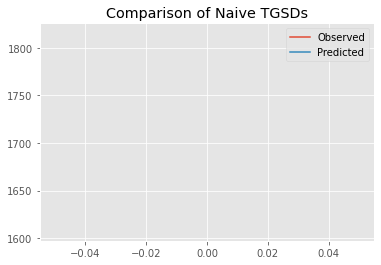

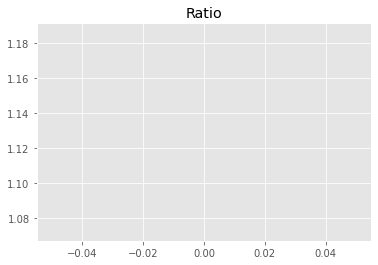

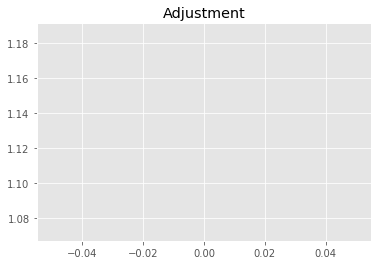

12357040887.618504
1


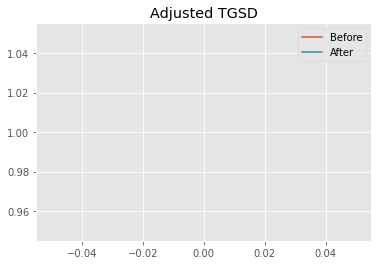

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86775 	2.27578 	24187.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|20.9179 	8.0696 	15023.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.2404
New Misfit: 19.9405
Convergence:
0.14198797041838893

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.81e+03 	1.82e+03 	1.0056 		1.0000


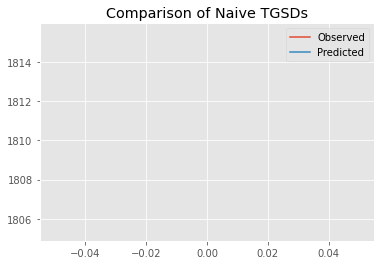

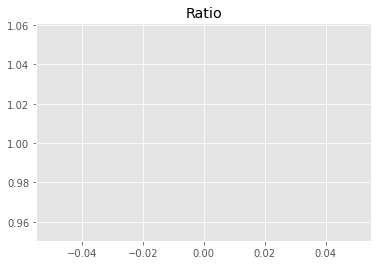

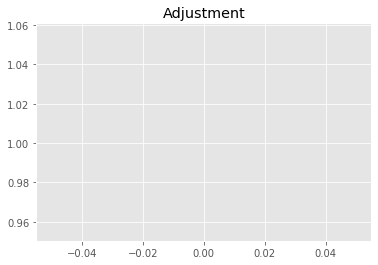

11002550369.145672
1


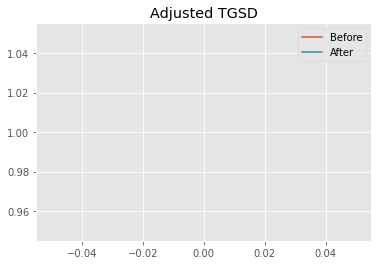

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|20.9179 	8.0696 	15023.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|34.6078 	13.5963 	15330.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9405
New Misfit: 19.8791
Convergence:
0.0030796482880700252

____________________
a = 34.60776	b = 13.59627	            h1 = 15330.50300	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.87911948978405
Prior Misfit: 0.234293,	 Post Misfit: 19.8791


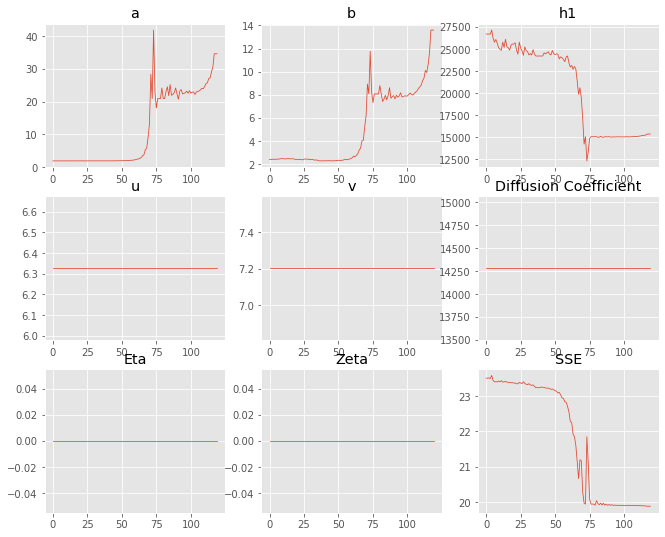

,Priors,Posteriors
a,1.85754,34.6078
b,2.40235,13.5963
h1,"26,681.3","15,330.5"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.065 minutes


Estimated remaining run time: 0.703 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.70e+03 	1.82e+03 	1.0668 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


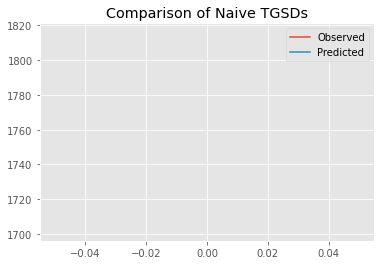

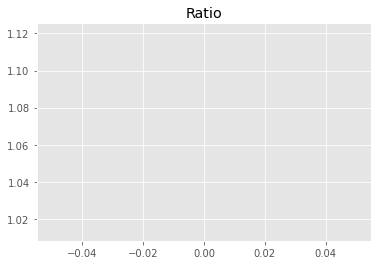

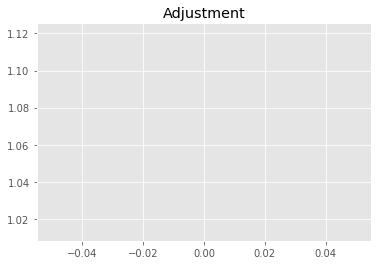

11672470057.269936
1


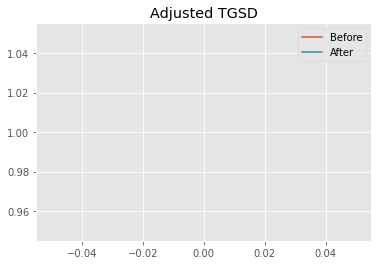

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.31455 	4.51462 	28996.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|2.80024 	2.39787 	19583.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.3766
New Misfit: 21.6064
Convergence:
0.07572410656029958

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.72e+03 	1.82e+03 	1.0554 		1.0000


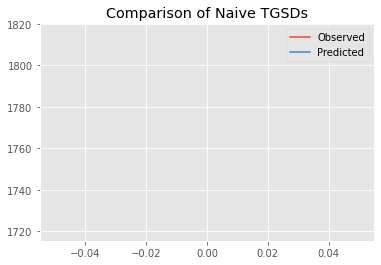

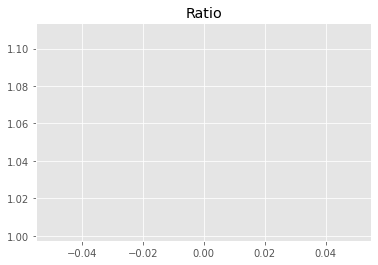

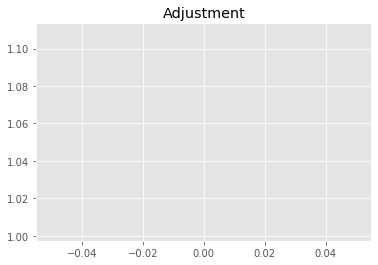

11547612850.10093
1


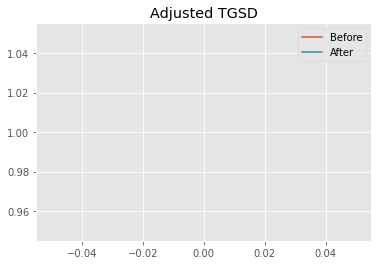

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.80024 	2.39787 	19583.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|9.9812 	2.30424 	14166.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.6064
New Misfit: 19.9474
Convergence:
0.07678491589856969

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0262 		1.0000


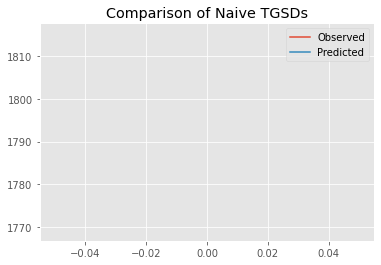

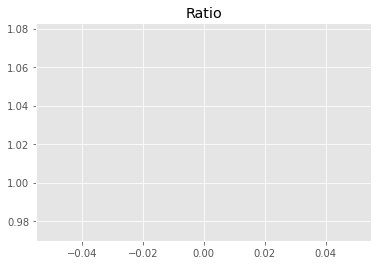

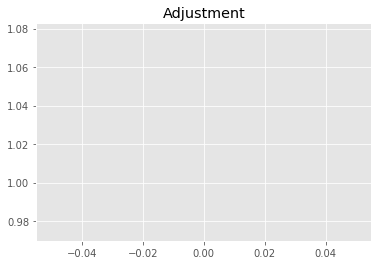

11228786390.44889
1


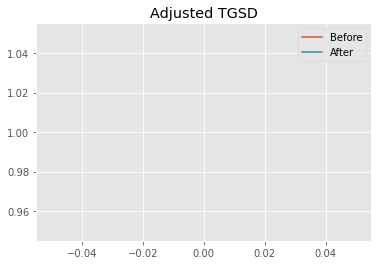

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.9812 	2.30424 	14166.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|12.5742 	2.23489 	13572.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9474
New Misfit: 19.9161
Convergence:
0.0015688201777099087

____________________
a = 12.57416	b = 2.23489	            h1 = 13572.35633	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.916094787367758
Prior Misfit: 0.232982,	 Post Misfit: 19.9161


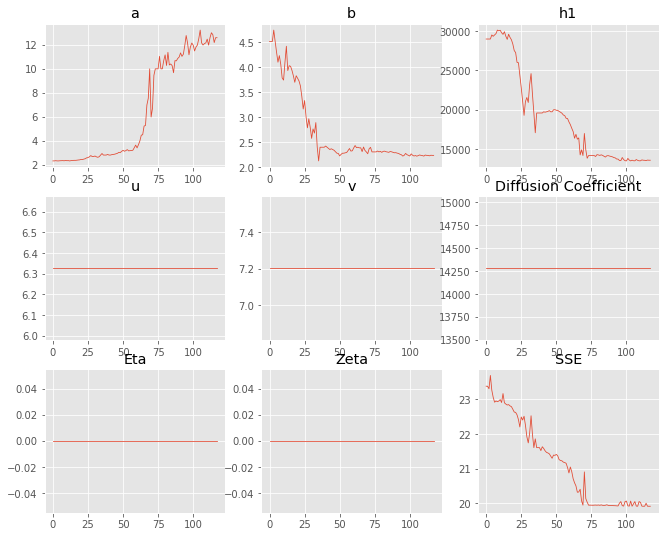

,Priors,Posteriors
a,2.31455,12.5742
b,4.51462,2.23489
h1,"28,996.3","13,572.4"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.065 minutes


Estimated remaining run time: 0.629 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.75e+03 	1.82e+03 	1.0357 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


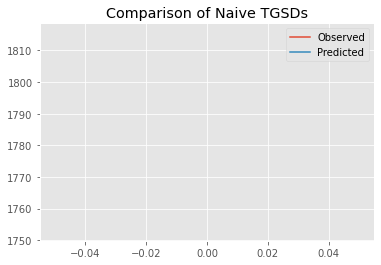

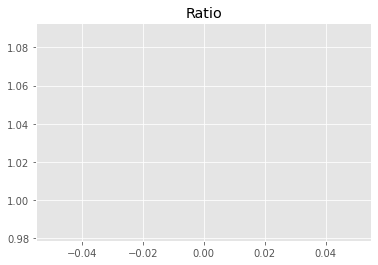

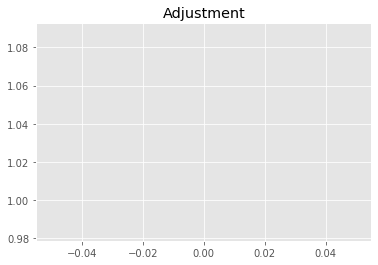

11331726050.573944
1


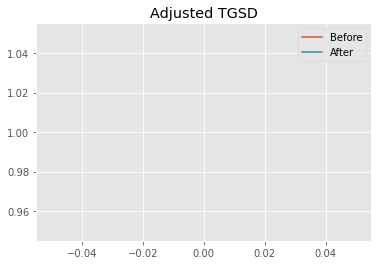

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.7666 	2.18496 	16987.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.21617 	2.47233 	16492.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7581
New Misfit: 20.3299
Convergence:
0.0206264999745536

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.74e+03 	1.82e+03 	1.0459 		1.0000


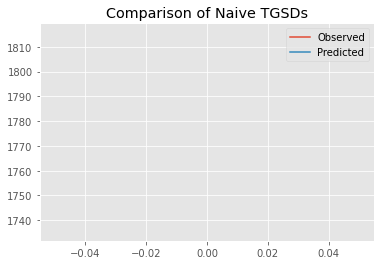

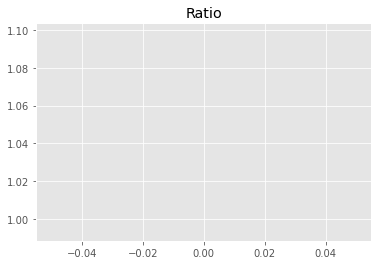

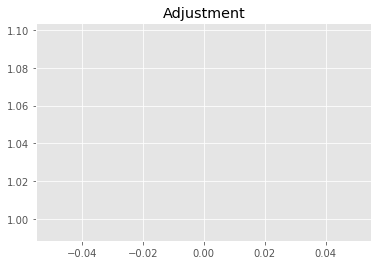

11444313724.435911
1


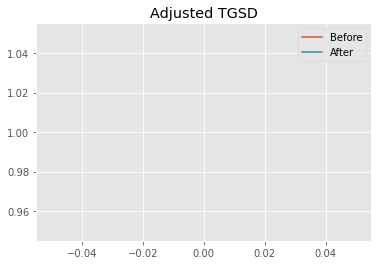

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.21617 	2.47233 	16492.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.74848 	3.98112 	16530.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.3299
New Misfit: 20.1615
Convergence:
0.008284535094980238

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0300 		1.0000


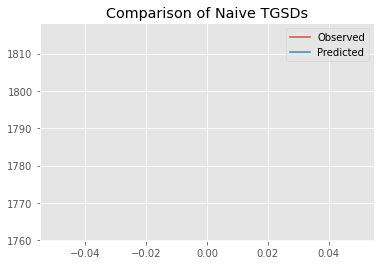

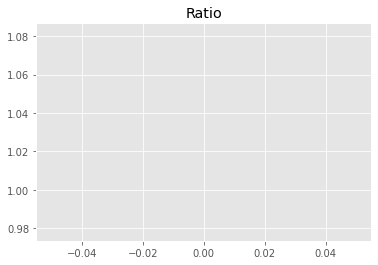

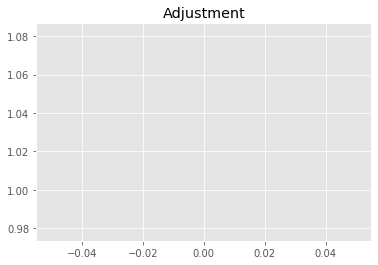

11270301979.629177
1


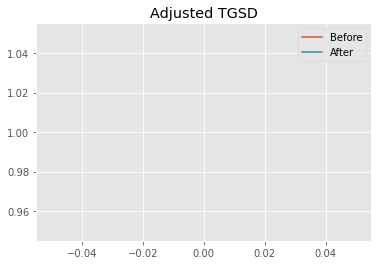

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.74848 	3.98112 	16530.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|14.3095 	7.28717 	16525.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.1615
New Misfit: 19.994
Convergence:
0.008310568563160113

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0316 		1.0000


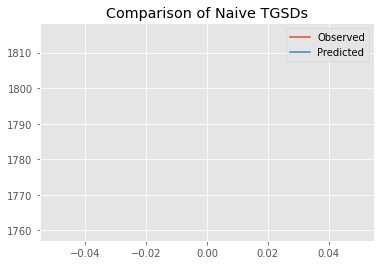

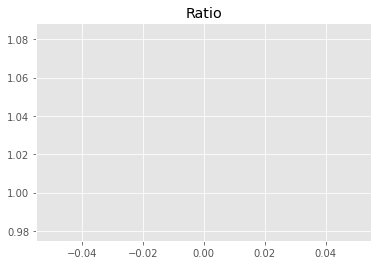

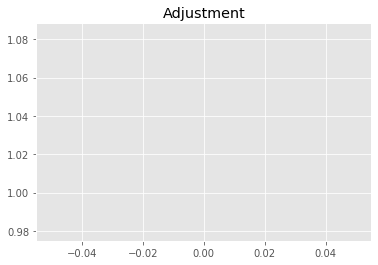

11287315722.109028
1


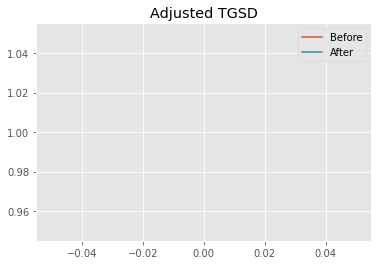

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|14.3095 	7.28717 	16525.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|59.827 	33.6974 	16522.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.994
New Misfit: 19.8882
Convergence:
0.005288044970215351

____________________
a = 59.82700	b = 33.69735	            h1 = 16522.85118	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.888237678422055
Prior Misfit: 0.206885,	 Post Misfit: 19.8882


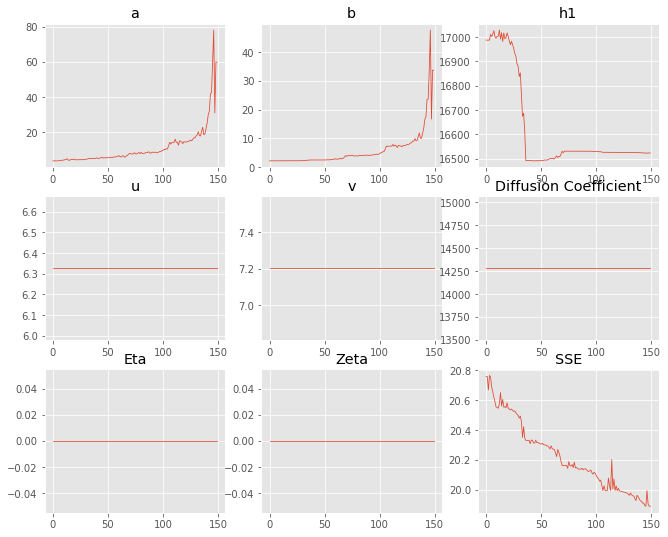

,Priors,Posteriors
a,3.7666,59.827
b,2.18496,33.6974
h1,"16,987.1","16,522.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.081 minutes


Estimated remaining run time: 0.567 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.42e+03 	1.82e+03 	1.2821 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


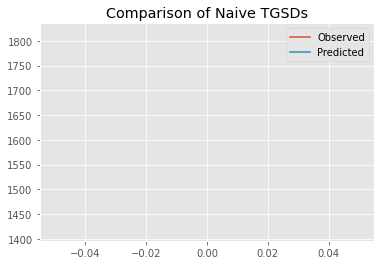

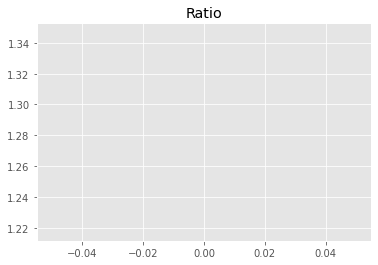

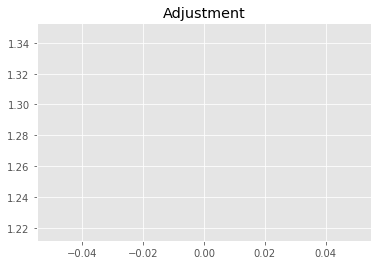

14028350264.457745
1


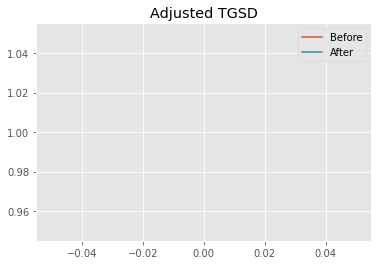

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.04837 	1.6579 	19314.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.00491 	1.86648 	18597.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 22.9393
New Misfit: 21.1458
Convergence:
0.07818721982527271

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.66e+03 	1.82e+03 	1.0961 		1.0000


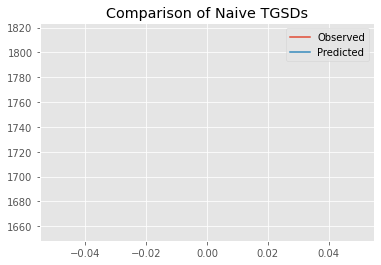

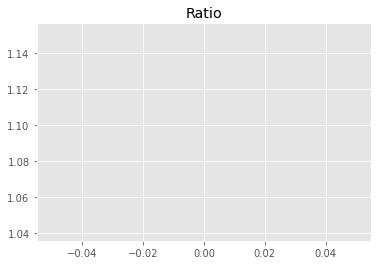

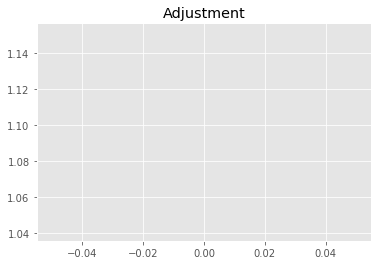

11993330453.767893
1


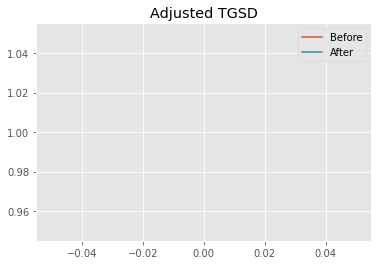

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.00491 	1.86648 	18597.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.25726 	1.8647 	13745.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.1458
New Misfit: 20.1386
Convergence:
0.047630737271547624

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.83e+03 	1.82e+03 	0.9933 		1.0000


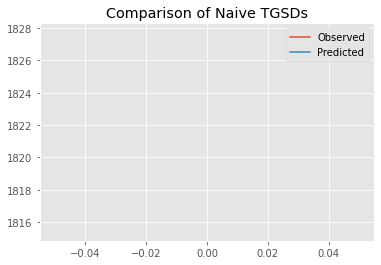

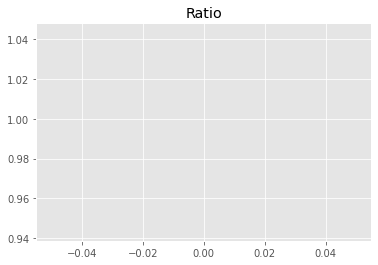

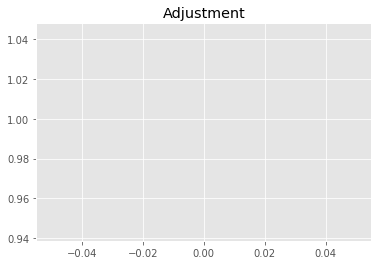

10868320405.111464
1


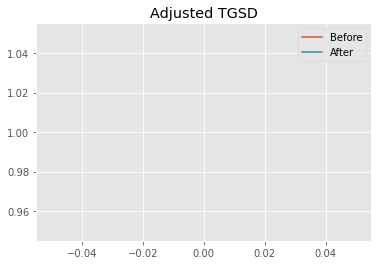

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.25726 	1.8647 	13745.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|10.1707 	1.88393 	13549.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.1386
New Misfit: 19.934
Convergence:
0.010160413548136087

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0250 		1.0000


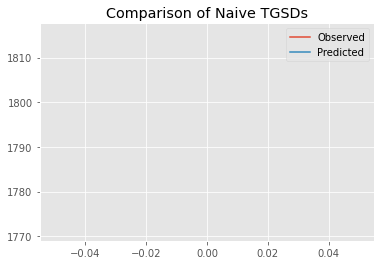

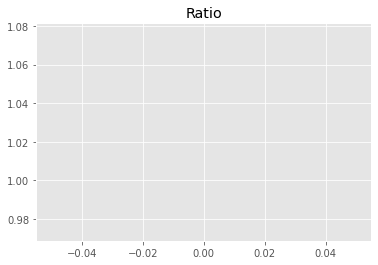

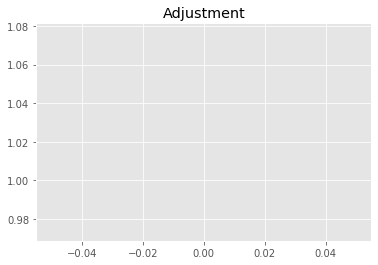

11215059827.864084
1


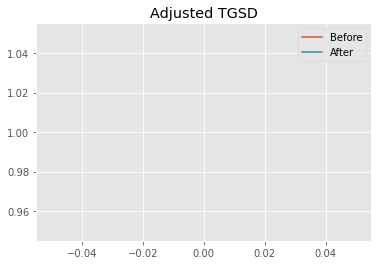

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.1707 	1.88393 	13549.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|10.808 	1.88412 	13542.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.934
New Misfit: 19.9279
Convergence:
0.00030473074844046733

____________________
a = 10.80796	b = 1.88412	            h1 = 13542.70649	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.927879227150843
Prior Misfit: 0.228624,	 Post Misfit: 19.9279


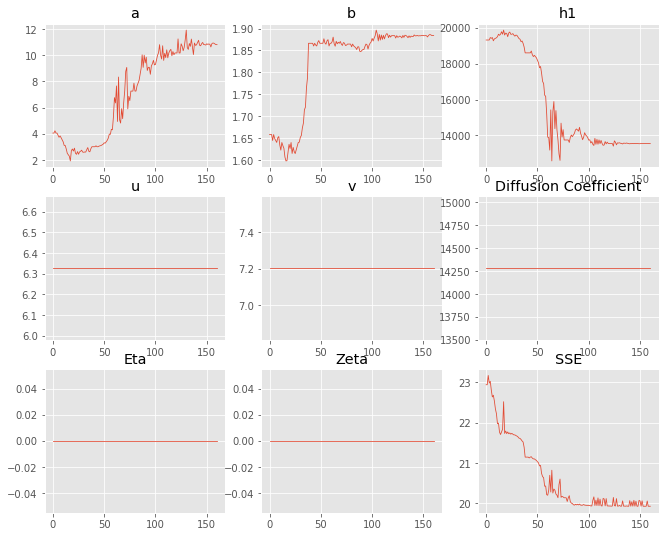

,Priors,Posteriors
a,4.04837,10.808
b,1.6579,1.88412
h1,"19,314.5","13,542.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.085 minutes


Estimated remaining run time: 0.503 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9814 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


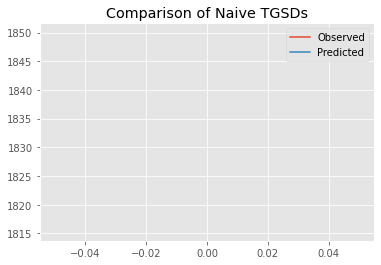

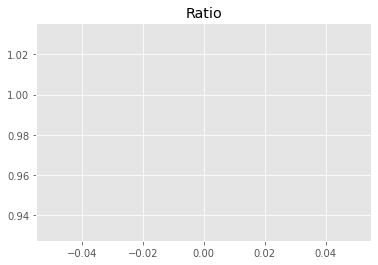

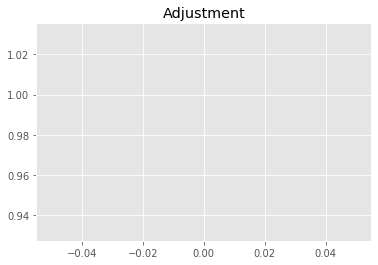

10737963901.776814
1


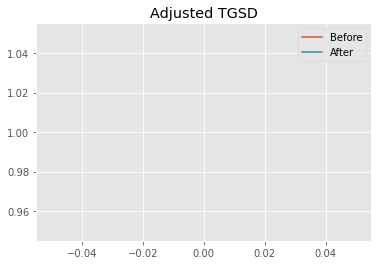

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.50807 	3.27162 	20475.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.48008 	2.34049 	18771.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.0153
New Misfit: 20.9899
Convergence:
0.1259793370458932

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.67e+03 	1.82e+03 	1.0866 		1.0000


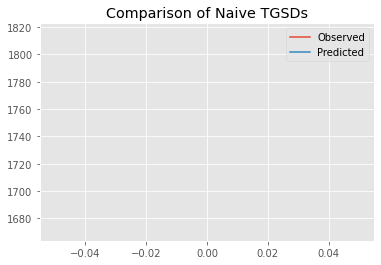

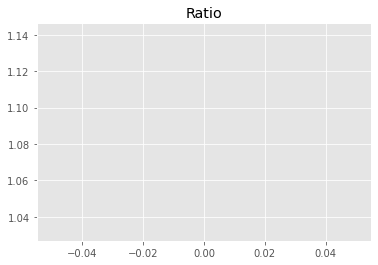

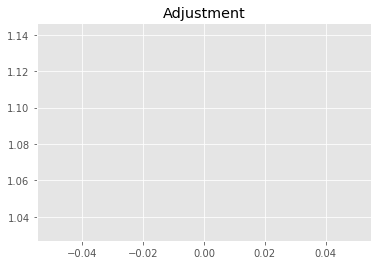

11888820972.005072
1


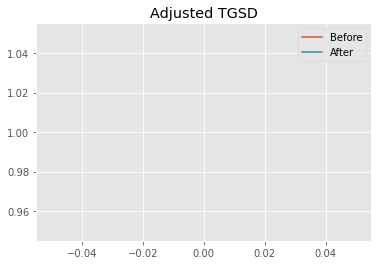

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.48008 	2.34049 	18771.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|13.0337 	2.66185 	13780.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.9899
New Misfit: 19.9158
Convergence:
0.05117328918817181

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0279 		1.0000


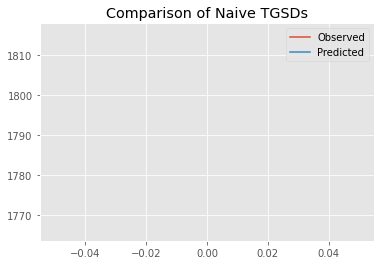

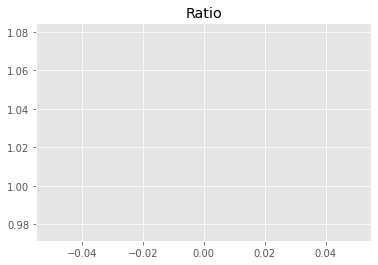

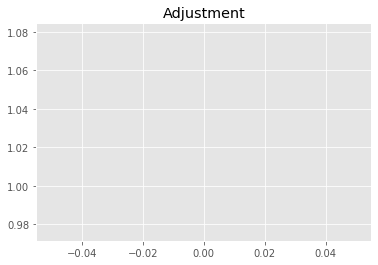

11247356598.381554
1


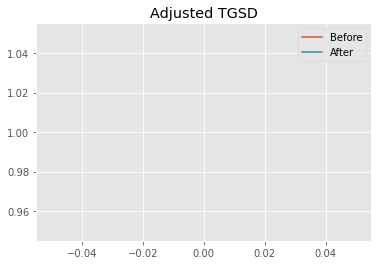

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|13.0337 	2.66185 	13780.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|14.7666 	2.6946 	13542.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9158
New Misfit: 19.9003
Convergence:
0.000778717823150566

____________________
a = 14.76658	b = 2.69460	            h1 = 13542.69226	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.900271491081476
Prior Misfit: 0.239348,	 Post Misfit: 19.9003


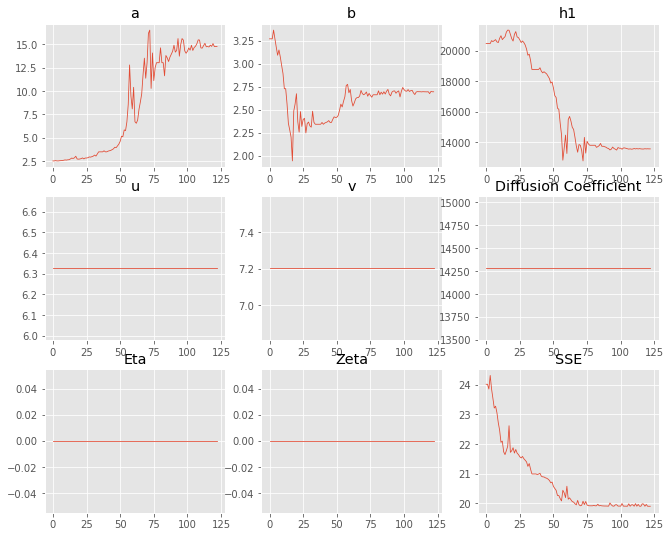

,Priors,Posteriors
a,2.50807,14.7666
b,3.27162,2.6946
h1,"20,475.6","13,542.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.069 minutes


Estimated remaining run time: 0.430 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.79e+03 	1.82e+03 	1.0129 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


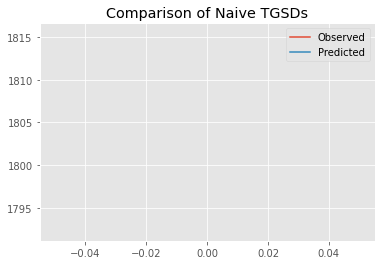

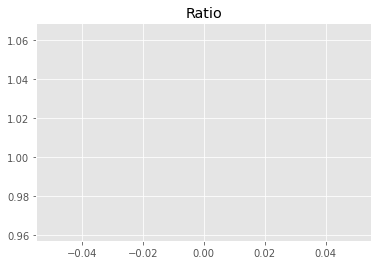

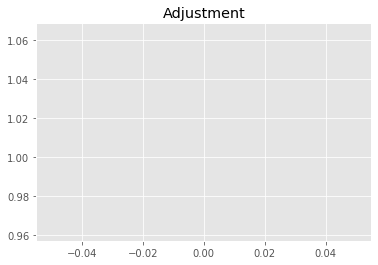

11083049237.802912
1


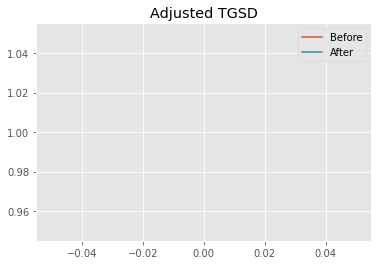

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.02369 	4.83036 	21678.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|33.4573 	26.3986 	18672.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.4252
New Misfit: 19.9186
Convergence:
0.07031677092752033

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.79e+03 	1.82e+03 	1.0140 		1.0000


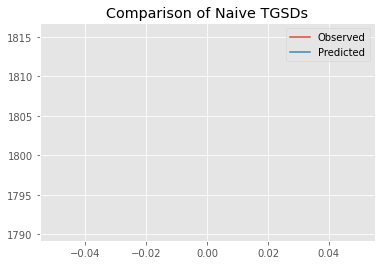

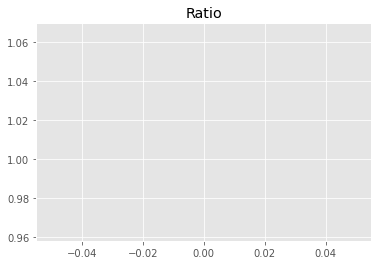

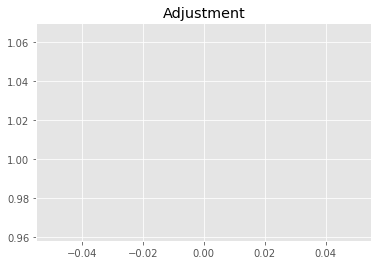

11094609045.063341
1


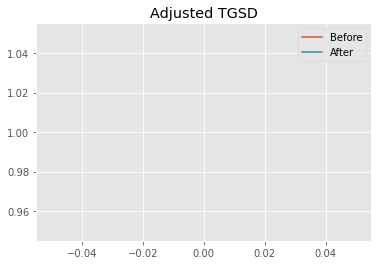

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|33.4573 	26.3986 	18672.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|81.0969 	44.3862 	16527.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9186
New Misfit: 19.8586
Convergence:
0.003011680808308761

____________________
a = 81.09688	b = 44.38622	            h1 = 16527.80561	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.85862618619904
Prior Misfit: 0.213533,	 Post Misfit: 19.8586


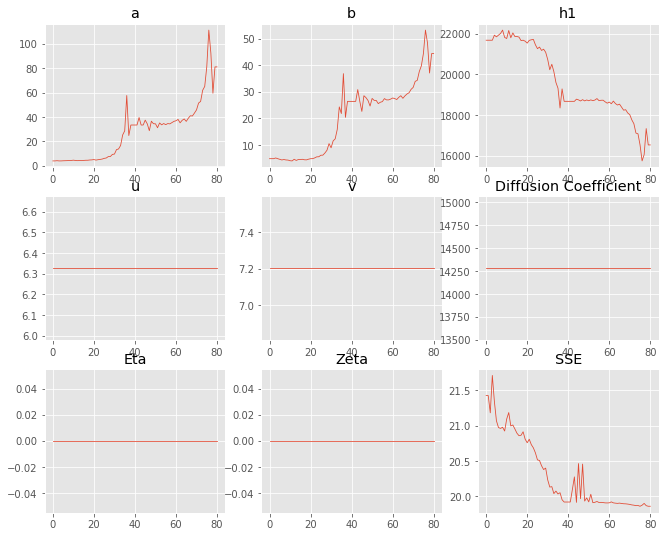

,Priors,Posteriors
a,4.02369,81.0969
b,4.83036,44.3862
h1,"21,678.8","16,527.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.049 minutes


Estimated remaining run time: 0.351 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.32e+03 	1.82e+03 	1.3745 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


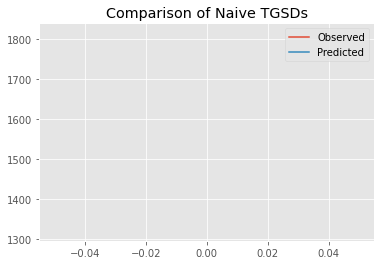

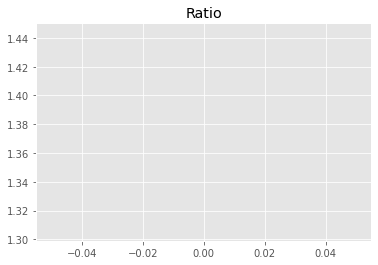

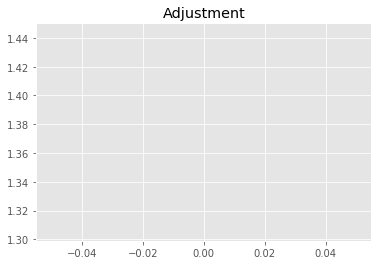

15039561704.100477
1


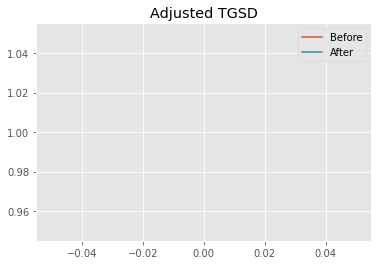

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.1205 	2.09355 	23954.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|3.9645 	2.14262 	16981.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.538
New Misfit: 20.6285
Convergence:
0.15932414817098392

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.73e+03 	1.82e+03 	1.0517 		1.0000


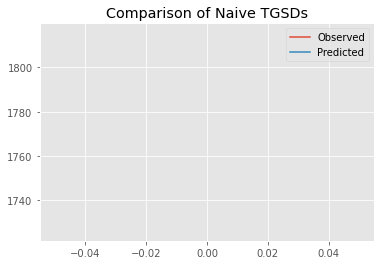

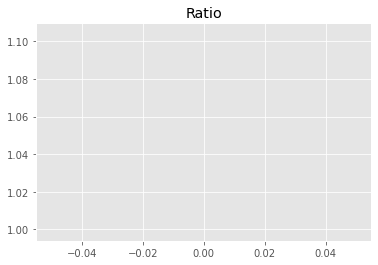

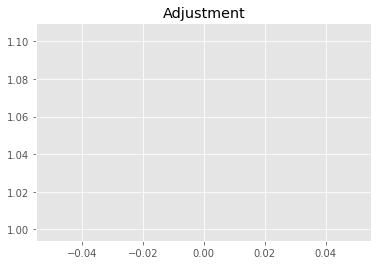

11507496201.289341
1


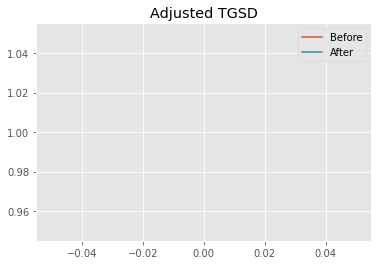

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.9645 	2.14262 	16981.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|7.30451 	2.24339 	14710.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.6285
New Misfit: 20.0705
Convergence:
0.027050870853925383

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0322 		1.0000


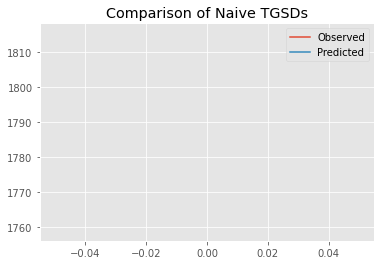

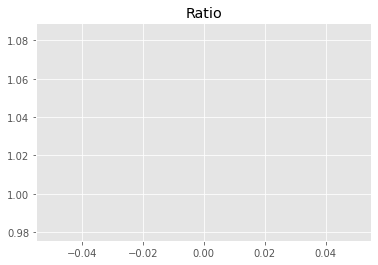

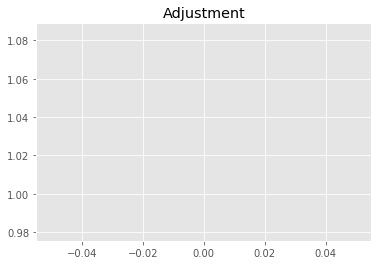

11293613978.07257
1


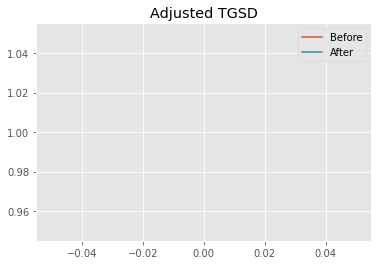

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.30451 	2.24339 	14710.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|11.7585 	2.13865 	13619.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.0705
New Misfit: 19.9227
Convergence:
0.00736315788653829

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0320 		1.0000


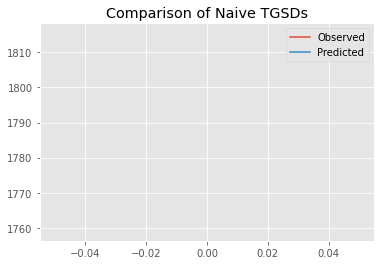

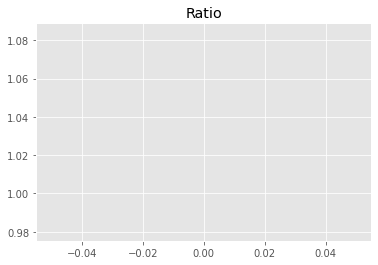

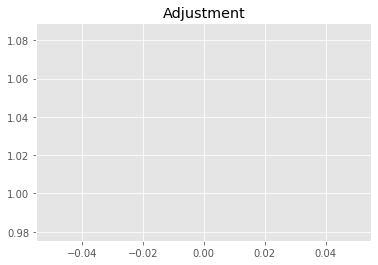

11292054921.971582
1


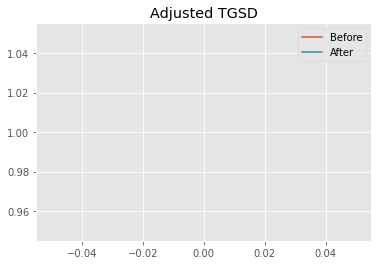

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|11.7585 	2.13865 	13619.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|11.8626 	2.14146 	13545.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9227
New Misfit: 19.918
Convergence:
0.00023498749422241137

____________________
a = 11.86262	b = 2.14146	            h1 = 13545.29431	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 19.91802721417235
Prior Misfit: 0.244557,	 Post Misfit: 19.918


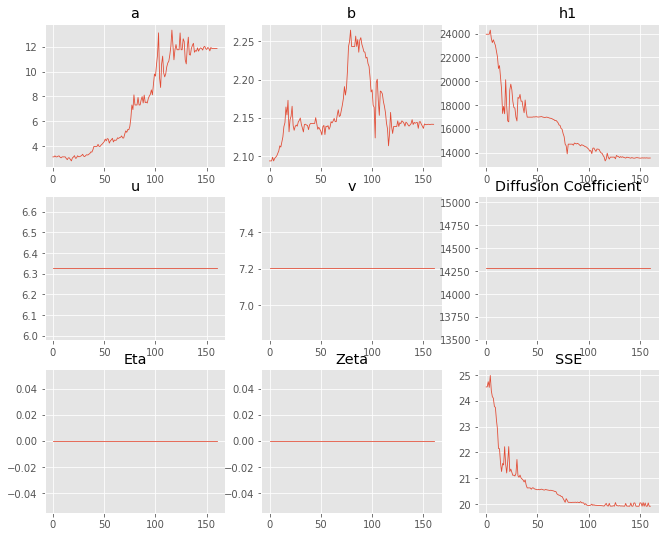

,Priors,Posteriors
a,3.1205,11.8626
b,2.09355,2.14146
h1,"23,954.2","13,545.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.084 minutes


Estimated remaining run time: 0.284 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.31e+03 	1.82e+03 	1.3824 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


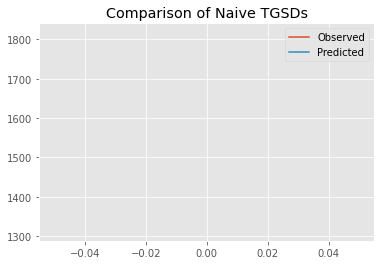

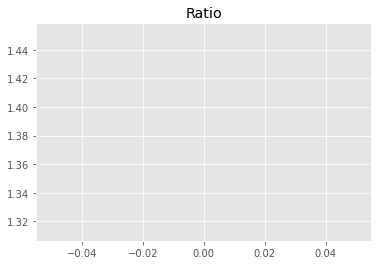

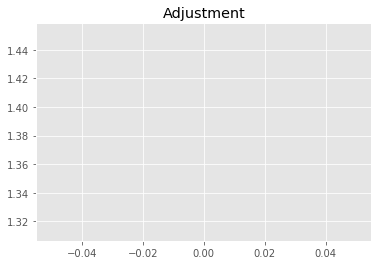

15126039217.177244
1


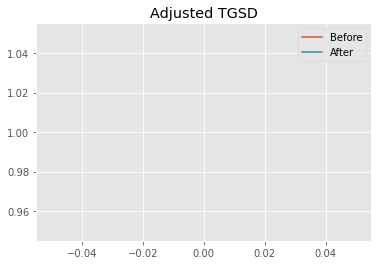

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.55774 	4.99215 	33731.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|6.1673 	7.26773 	21542.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.739
New Misfit: 20.7689
Convergence:
0.1604786709442756

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.81e+03 	1.82e+03 	1.0027 		1.0000


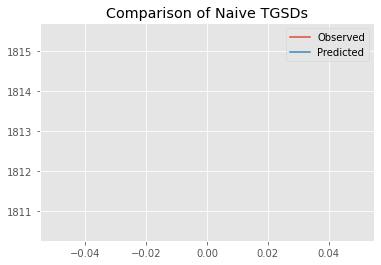

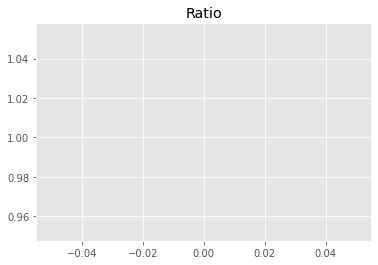

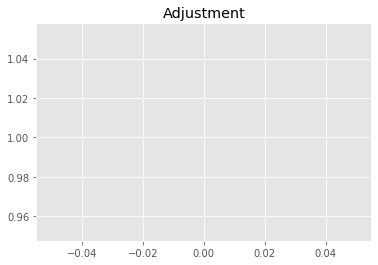

10971415634.750954
1


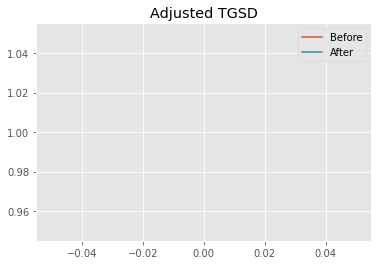

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.1673 	7.26773 	21542.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|118.215 	64.9168 	16629.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.7689
New Misfit: 19.8445
Convergence:
0.04451097186196584

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.78e+03 	1.82e+03 	1.0174 		1.0000


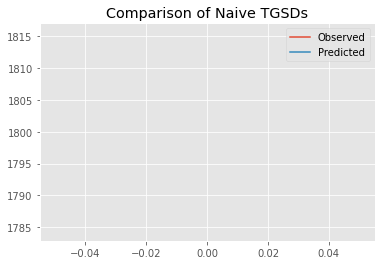

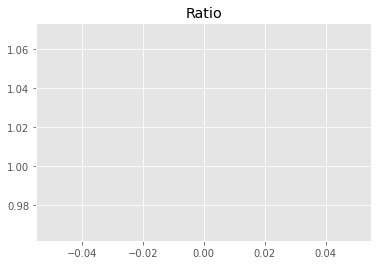

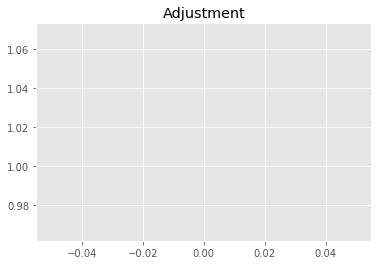

11131806993.756495
1


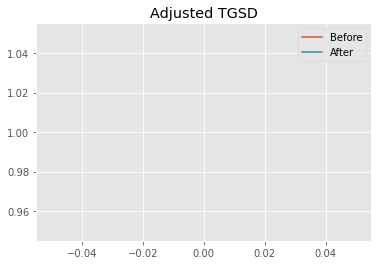

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|118.215 	64.9168 	16629.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|124.021 	67.332 	16635 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8445
New Misfit: 19.843
Convergence:
7.531864995809831e-05

____________________
a = 124.02117	b = 67.33198	            h1 = 16634.97551	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.843002692147437
Prior Misfit: 0.24656,	 Post Misfit: 19.843


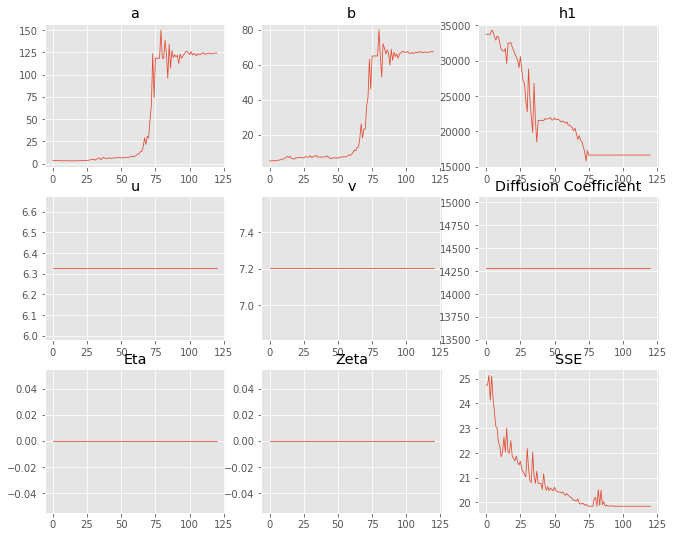

,Priors,Posteriors
a,3.55774,124.021
b,4.99215,67.332
h1,"33,731.1","16,635"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.069 minutes


Estimated remaining run time: 0.213 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.60e+03 	1.82e+03 	1.1374 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


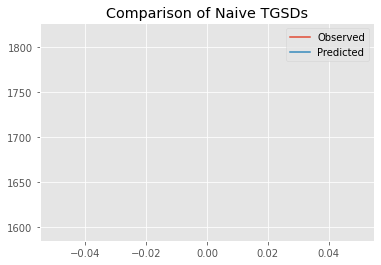

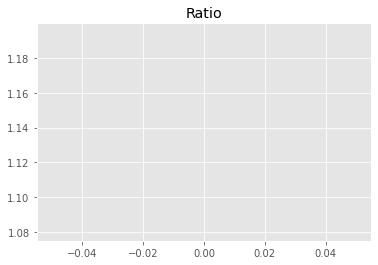

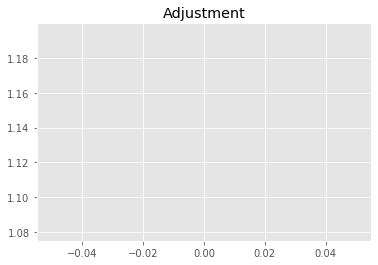

12445000808.2173
1


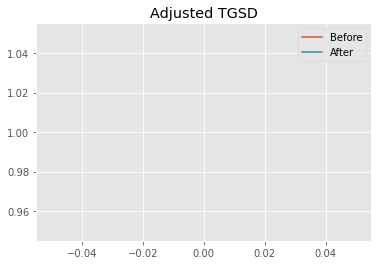

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.31394 	1.62766 	23815.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|4.9216 	1.26967 	14814.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 24.6307
New Misfit: 20.2227
Convergence:
0.1789622971505302

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.71e+03 	1.82e+03 	1.0631 		1.0000


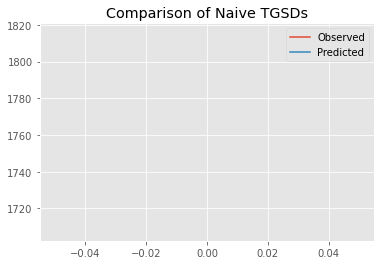

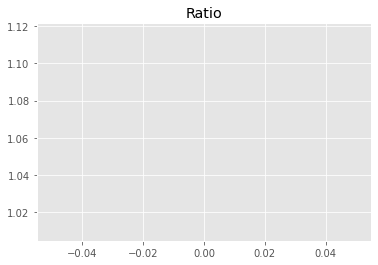

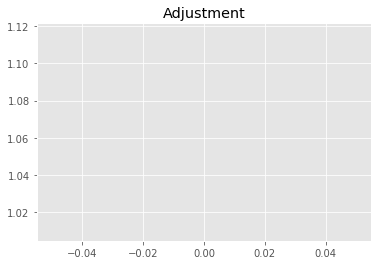

11631758865.726526
1


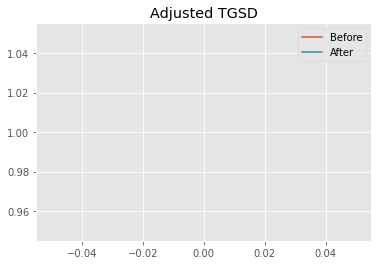

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.9216 	1.26967 	14814.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|8.47456 	1.49214 	14054.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.2227
New Misfit: 19.9721
Convergence:
0.012391761782370768

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.74e+03 	1.82e+03 	1.0441 		1.0000


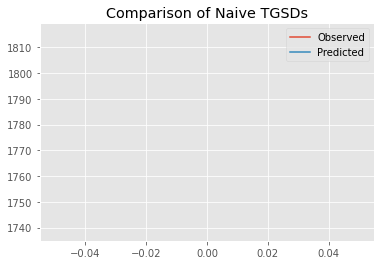

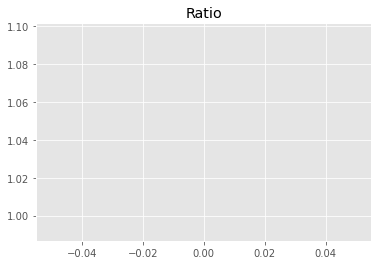

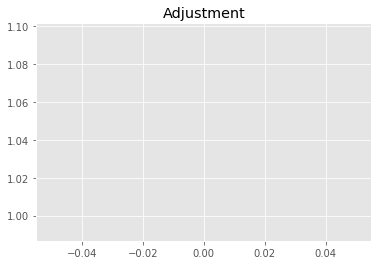

11424446485.273247
1


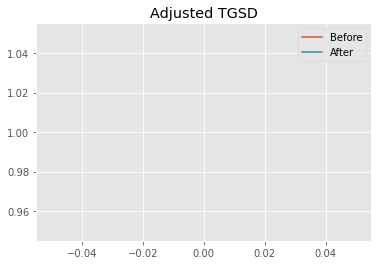

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.47456 	1.49214 	14054.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|9.28083 	1.63727 	13542.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9721
New Misfit: 19.9425
Convergence:
0.0014823851914408893

____________________
a = 9.28083	b = 1.63727	            h1 = 13542.82597	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.942517810774973
Prior Misfit: 0.245481,	 Post Misfit: 19.9425


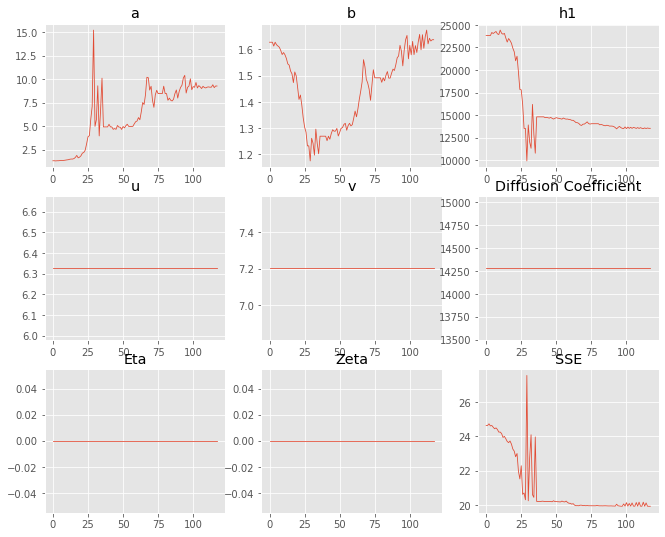

,Priors,Posteriors
a,1.31394,9.28083
b,1.62766,1.63727
h1,"23,815.6","13,542.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.068 minutes


Estimated remaining run time: 0.142 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.83e+03 	1.82e+03 	0.9905 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


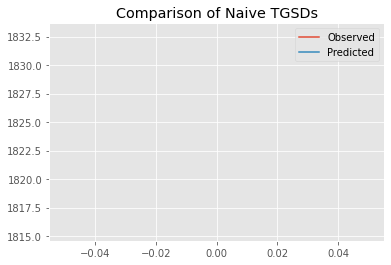

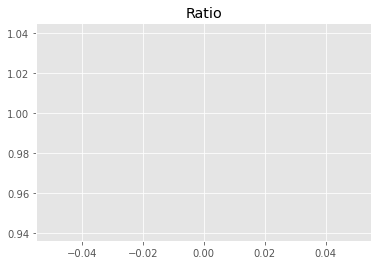

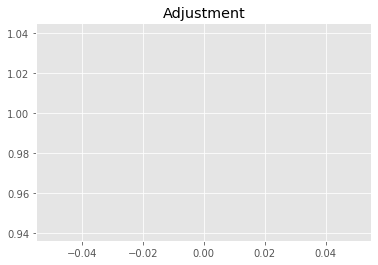

10838042212.069437
1


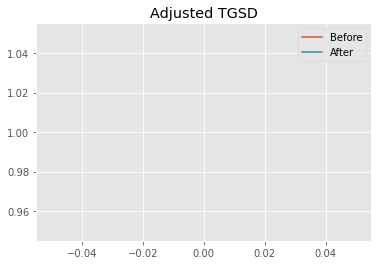

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.78688 	1.53233 	14693.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.45415 	1.64009 	14662.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.789
New Misfit: 20.1624
Convergence:
0.03013716701758821

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0343 		1.0000


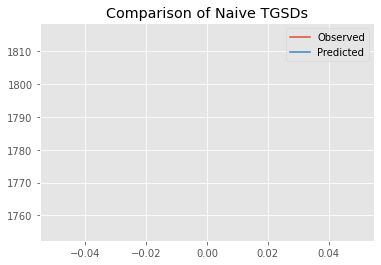

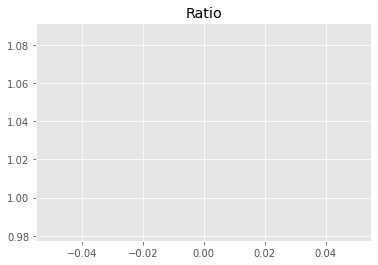

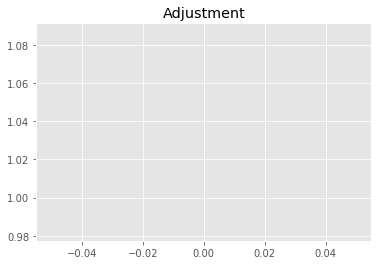

11316701227.355059
1


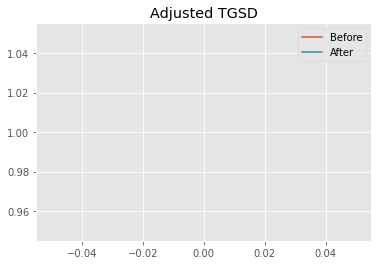

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.45415 	1.64009 	14662.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|9.69176 	1.70583 	13559.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.1624
New Misfit: 19.9387
Convergence:
0.011096671806266887

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.76e+03 	1.82e+03 	1.0315 		1.0000


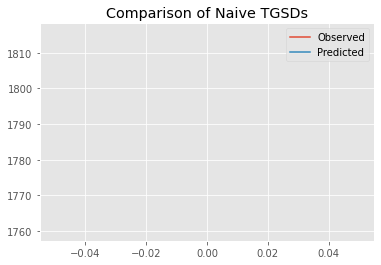

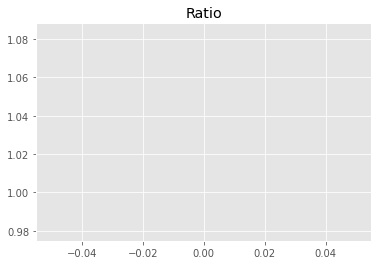

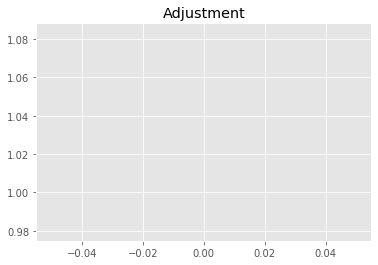

11286043199.94051
1


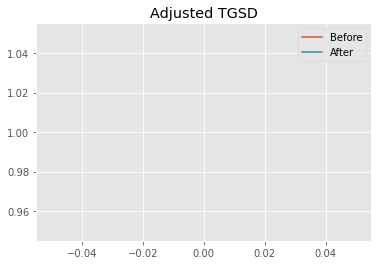

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.69176 	1.70583 	13559.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|11.2009 	1.89624 	13545.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9387
New Misfit: 19.9285
Convergence:
0.0005106695479485405

____________________
a = 11.20092	b = 1.89624	            h1 = 13545.75742	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 19.9285312408673
Prior Misfit: 0.207192,	 Post Misfit: 19.9285


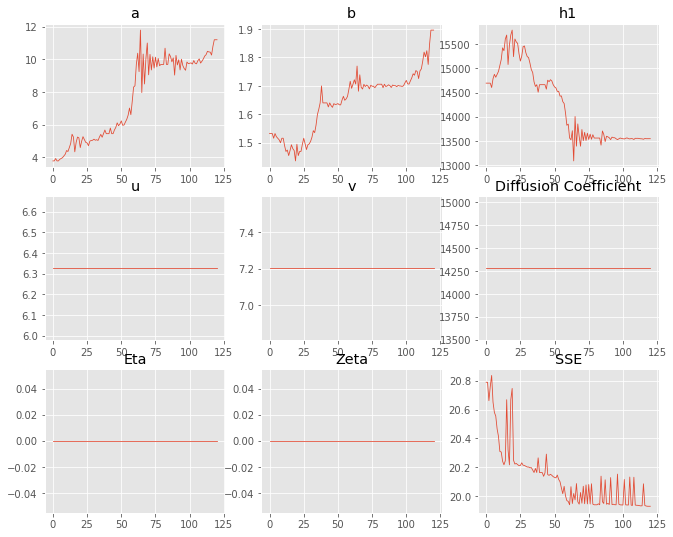

,Priors,Posteriors
a,3.78688,11.2009
b,1.53233,1.89624
h1,"14,693.9","13,545.8"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.067 minutes


Estimated remaining run time: 0.071 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.66e+03 	1.82e+03 	1.0965 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


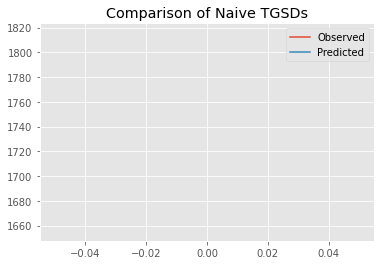

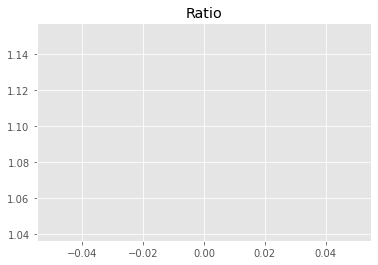

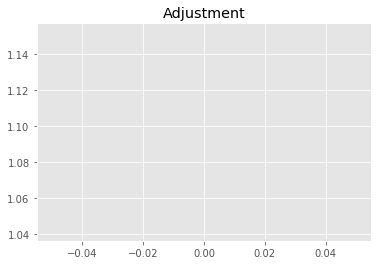

11997761735.196405
1


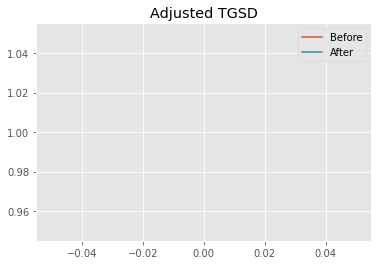

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.45018 	3.64216 	20488.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|24.0959 	6.33553 	14220.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.8678
New Misfit: 19.8824
Convergence:
0.047218352344970904

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0230 		1.0000


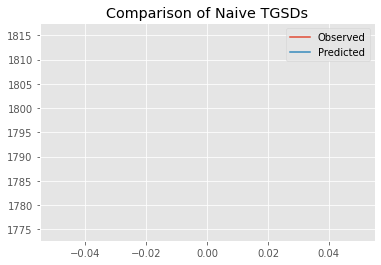

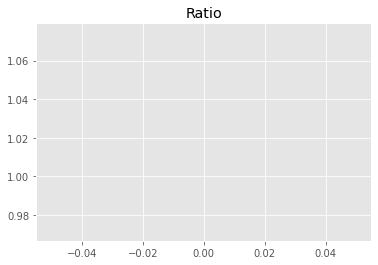

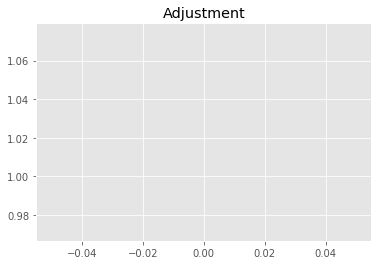

11193005793.504032
1


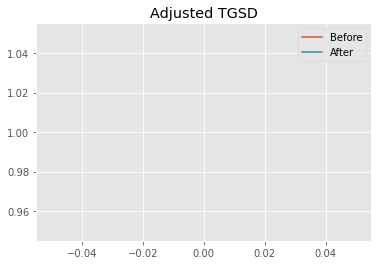

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|24.0959 	6.33553 	14220.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|42.2528 	4.86566 	12961.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8824
New Misfit: 19.832
Convergence:
0.0025347870588364086

____________________
a = 42.25284	b = 4.86566	            h1 = 12961.91777	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 19.832038452618427
Prior Misfit: 0.207978,	 Post Misfit: 19.832


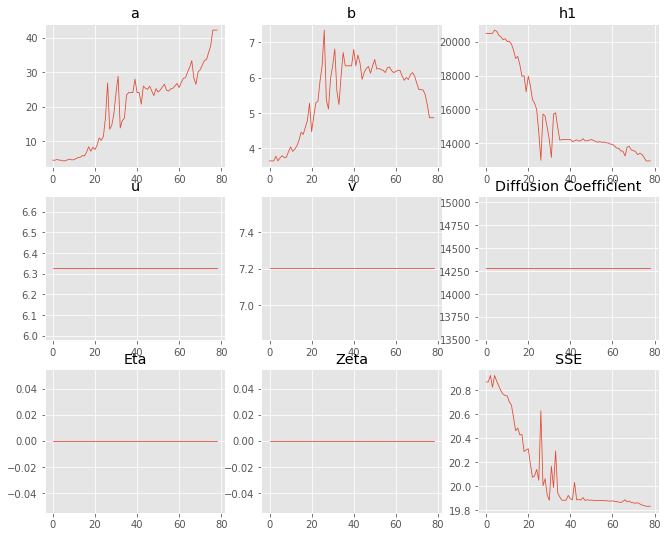

,Priors,Posteriors
a,4.45018,42.2528
b,3.64216,4.86566
h1,"20,488.4","12,961.9"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.050 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.86e+03 	1.82e+03 	0.9775 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


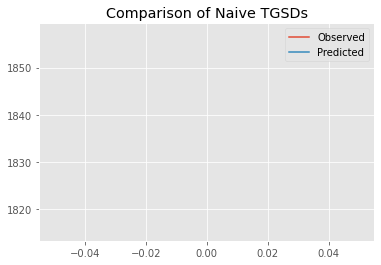

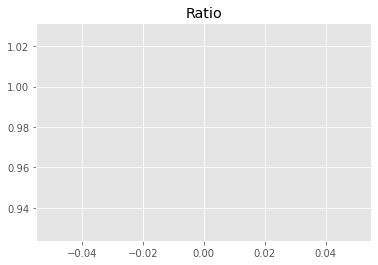

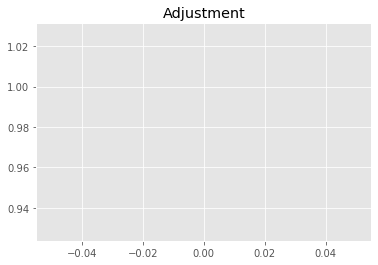

10695357107.85956
1


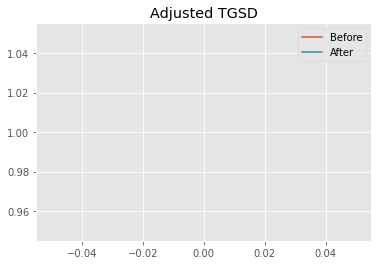

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.94094 	3.51174 	22735.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|1.91705 	2.13499 	23433.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 26.7558
New Misfit: 23.0115
Convergence:
0.13994256269754354

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.60e+03 	1.82e+03 	1.1350 		1.0000


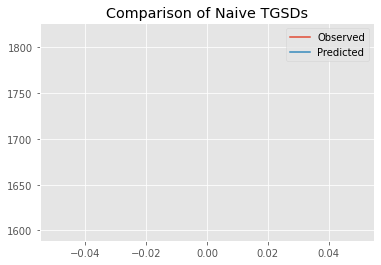

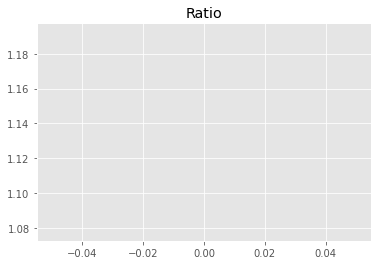

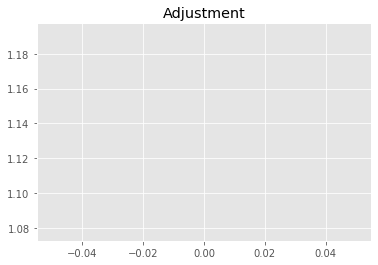

12419041424.5685
1


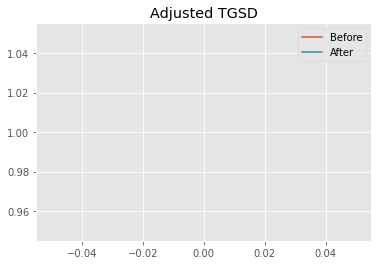

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91705 	2.13499 	23433.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|5.65469 	3.86455 	16658.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 23.0115
New Misfit: 20.9665
Convergence:
0.08887100556613033

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.87e+03 	1.82e+03 	0.9705 		1.0000


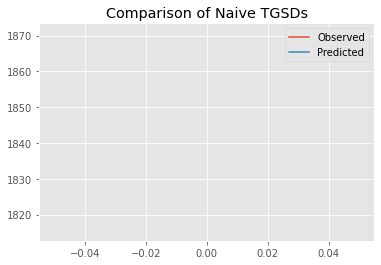

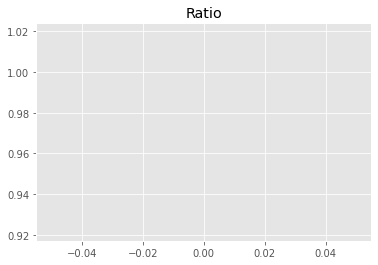

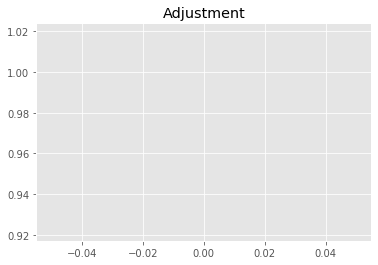

10618726029.439888
1


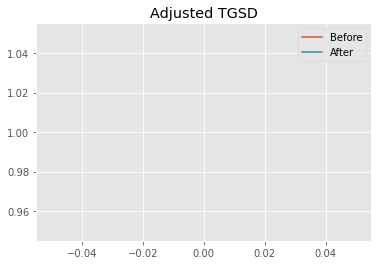

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.65469 	3.86455 	16658.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|14.0065 	7.29363 	16572.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.9665
New Misfit: 19.9983
Convergence:
0.04617407994872167

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0283 		1.0000


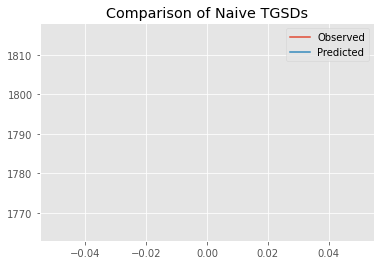

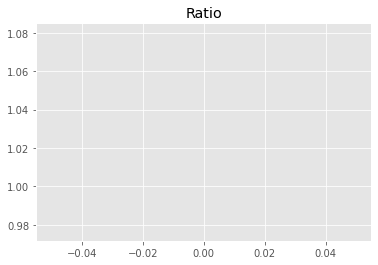

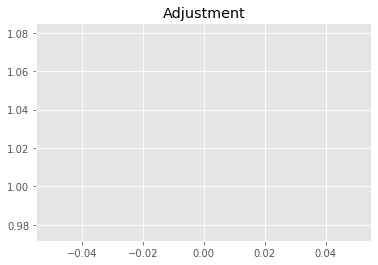

11251310410.750353
1


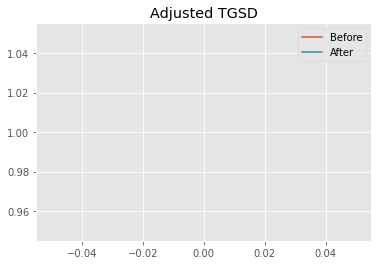

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|14.0065 	7.29363 	16572.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|417.083 	214.51 	16342.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9983
New Misfit: 19.8288
Convergence:
0.008479032709226533

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.77e+03 	1.82e+03 	1.0254 		1.0000


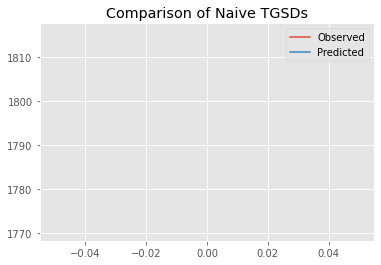

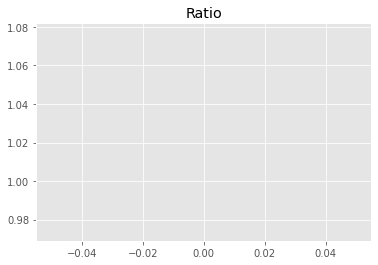

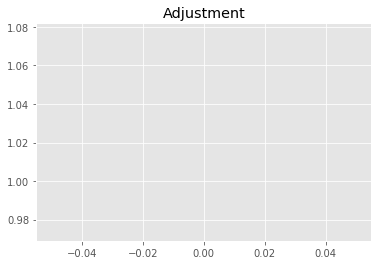

11219752615.106125
1


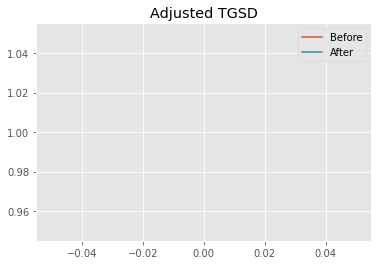

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|417.083 	214.51 	16342.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.09416e+10
After: 		|474.908 	248.646 	16334.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.8288
New Misfit: 19.828
Convergence:
3.7568641873239344e-05

____________________
a = 474.90839	b = 248.64640	            h1 = 16334.29042	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 19.828036893581885
Prior Misfit: 0.26666,	 Post Misfit: 19.828


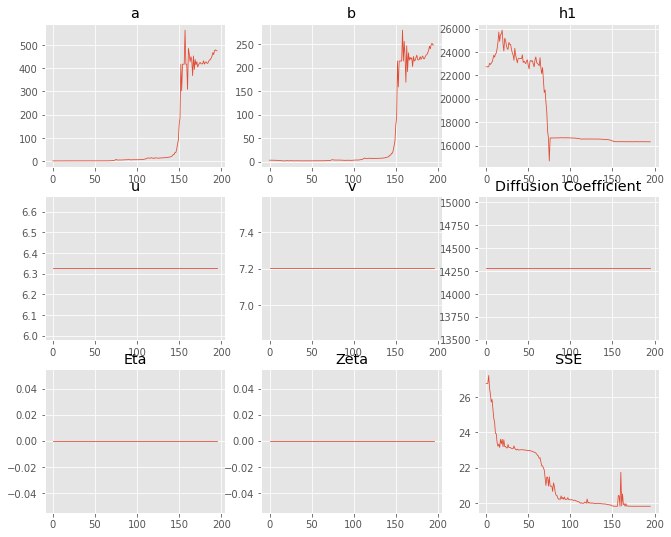

,Priors,Posteriors
a,1.94094,474.908
b,3.51174,248.646
h1,"22,735.7","16,334.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.103 minutes


Estimated remaining run time: -0.071 minutes


Total Run Time: 1.49476 minutes


[{'a': 27.480310501002553,
  'b': 1.604208932527252,
  'h1': 12951.497957516289,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 234.59587289815943,
  'b': 122.8404969883545,
  'h1': 16434.87867626157,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 60.70735399301232,
  'b': 33.07548275845775,
  'h1': 16576.08028575419,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 11.442404407850928,
  'b': 2.001217715468974,
  'h1': 13542.949337033197,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 280.8971688796557,
  'b': 151.96387017363193,
  'h1': 16534.47551802645,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 52.7173

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
19,474.908,248.646,"16,334.3",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197615
0,27.4803,1.60421,"12,951.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.19762
4,280.897,151.964,"16,534.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.19764
18,42.2528,4.86566,"12,961.9",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197655
1,234.596,122.84,"16,434.9",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197655
15,124.021,67.332,"16,635",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197764
5,52.7173,10.4964,"13,559.3",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197788
13,81.0969,44.3862,"16,527.8",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.19792
2,60.7074,33.0755,"16,576.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197979
8,34.6078,13.5963,"15,330.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.198124


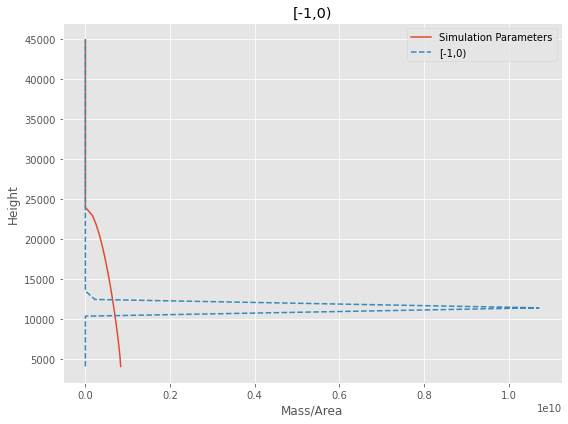

[-1,0) Run Time: 1.49765 minutes


Mass Test: 45798958791.69547
========[0,1)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.13e+02 	1.13e+03 	1.2429 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


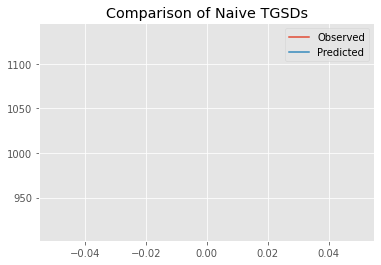

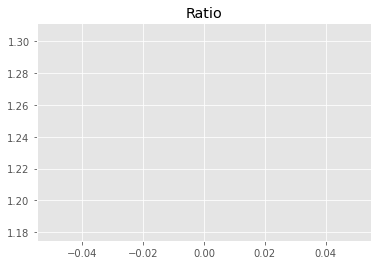

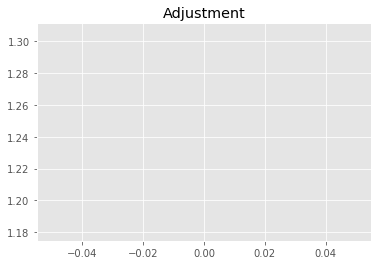

8496703679.150752
1


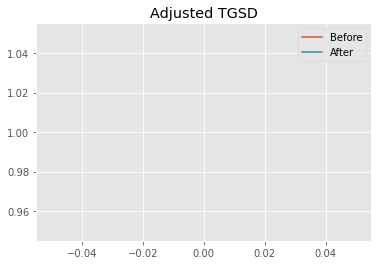

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.92155 	3.10363 	12837.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.60269 	2.26568 	9592.18 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.0227
New Misfit: 13.9374
Convergence:
0.0722417830569862

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0601 		1.0000


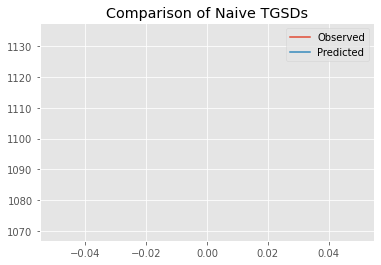

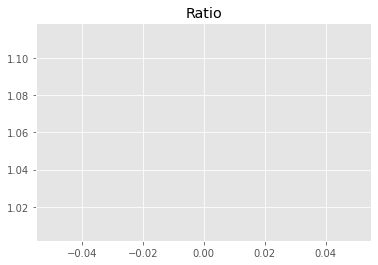

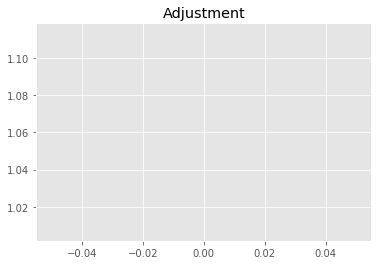

7247223778.831053
1


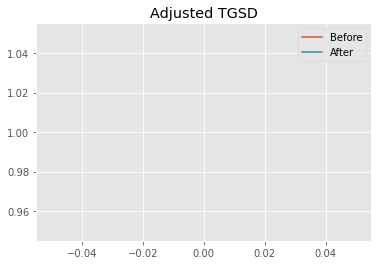

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.60269 	2.26568 	9592.18 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|12.2919 	2.17263 	9674.66 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.9374
New Misfit: 13.6881
Convergence:
0.017885456852286617

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1312 		1.0000


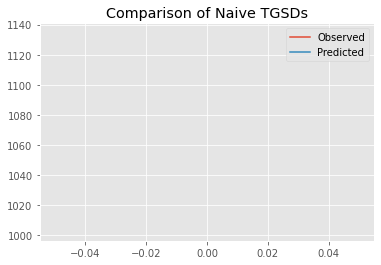

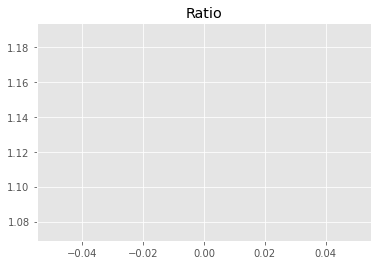

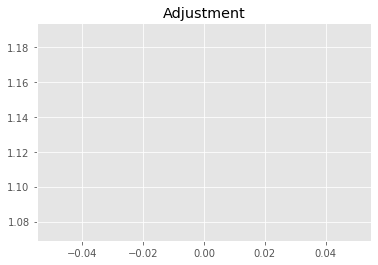

7733175878.971917
1


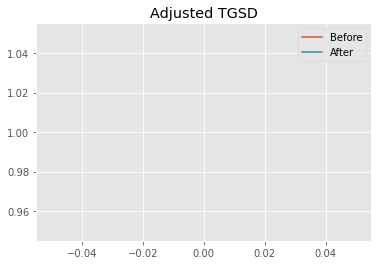

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.2919 	2.17263 	9674.66 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|13.6086 	2.17058 	9374.51 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6881
New Misfit: 13.6714
Convergence:
0.0012233455051511846

____________________
a = 13.60859	b = 2.17058	            h1 = 9374.51293	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.671368304276367
Prior Misfit: 0.2279,	 Post Misfit: 13.6714


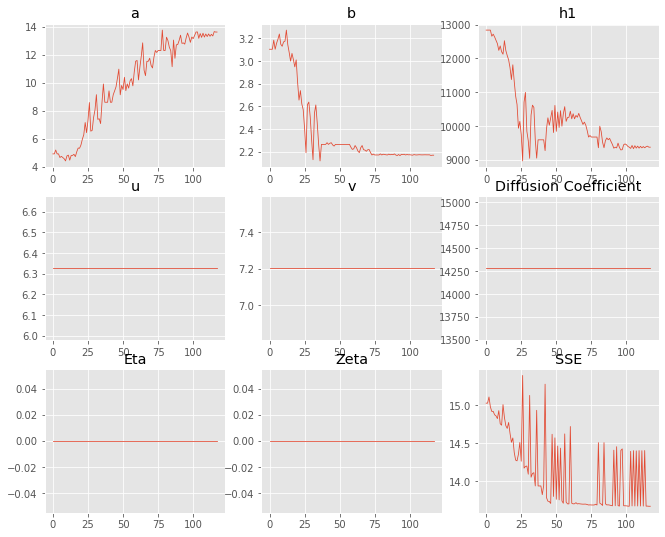

,Priors,Posteriors
a,4.92155,13.6086
b,3.10363,2.17058
h1,"12,837.9","9,374.51"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.067 minutes


Estimated remaining run time: 0.604 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.10e+03 	1.13e+03 	1.0277 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


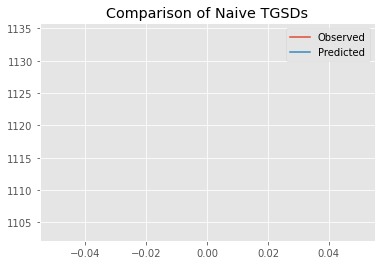

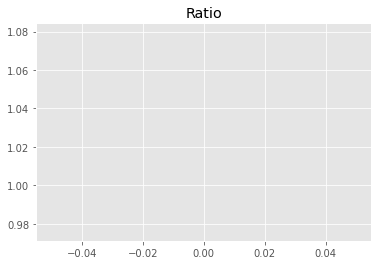

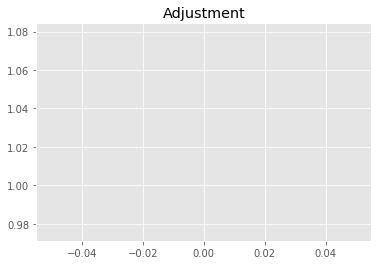

7025660197.654034
1


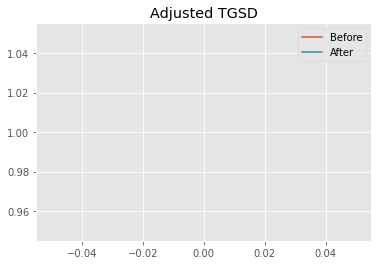

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.71665 	2.45213 	10433.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|10.4263 	2.22122 	9771.74 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.097
New Misfit: 13.7165
Convergence:
0.09144117581256503

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1087 		1.0000


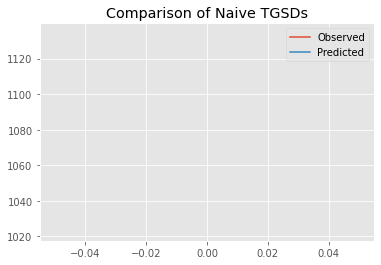

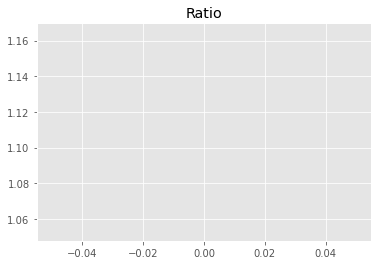

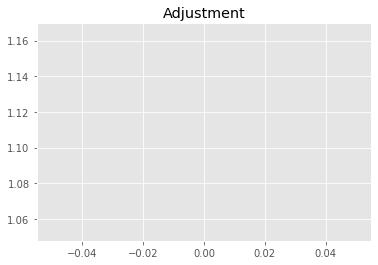

7578947704.193329
1


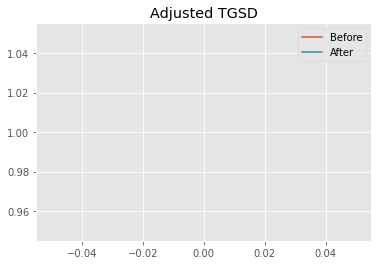

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.4263 	2.22122 	9771.74 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|13.6604 	2.17946 	9389.86 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.7165
New Misfit: 13.672
Convergence:
0.0032440441635801726

____________________
a = 13.66045	b = 2.17946	            h1 = 9389.86356	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 13.672019532218716
Prior Misfit: 0.229028,	 Post Misfit: 13.672


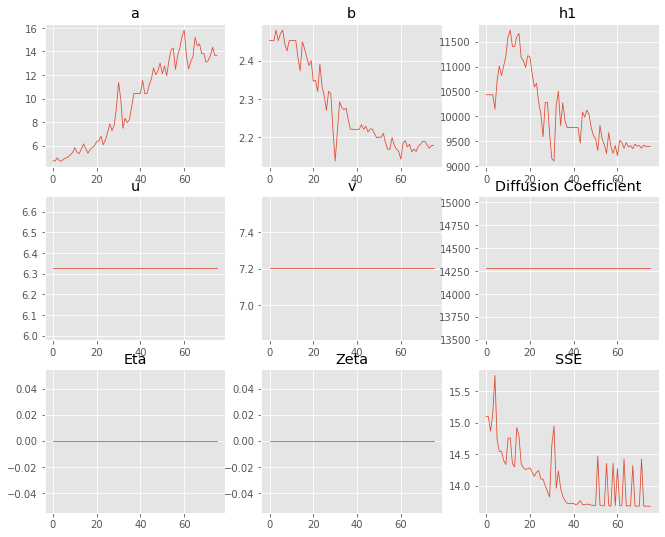

,Priors,Posteriors
a,4.71665,13.6604
b,2.45213,2.17946
h1,"10,433.7","9,389.86"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.047 minutes


Estimated remaining run time: 0.648 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	5.98e+02 	1.13e+03 	1.8976 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


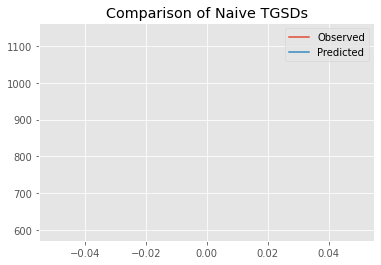

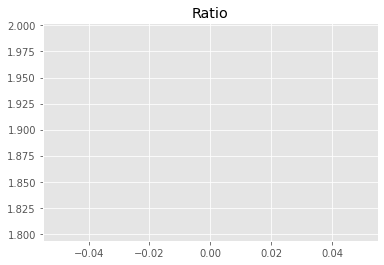

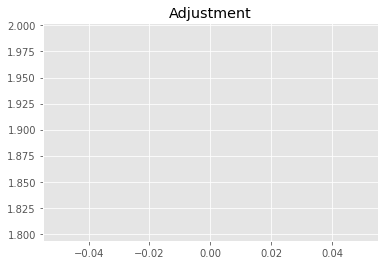

12972424587.773186
1


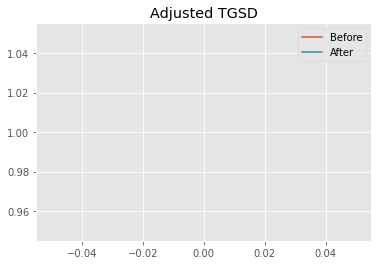

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.46549 	2.84804 	31469.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.55247 	3.904 	23929.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 21.3218
New Misfit: 18.3104
Convergence:
0.14123351884359625

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.93e+02 	1.13e+03 	1.2704 		1.0000


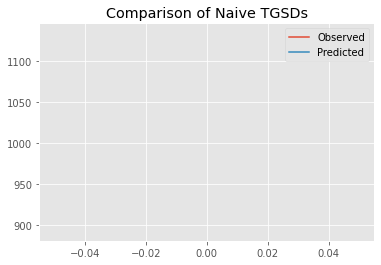

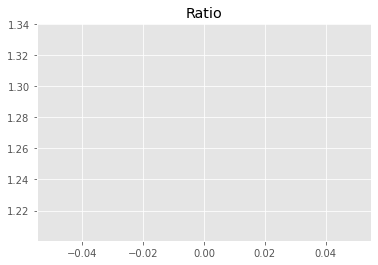

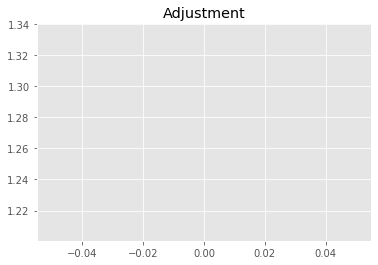

8684812904.53535
1


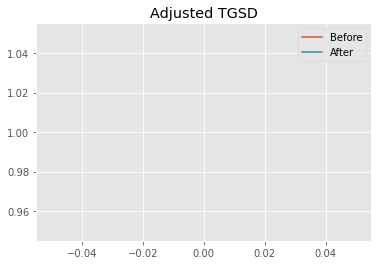

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55247 	3.904 	23929.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|58.4712 	210.359 	29424.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 18.3104
New Misfit: 13.9661
Convergence:
0.23726117642879058

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.51e+02 	1.13e+03 	1.1929 		1.0000


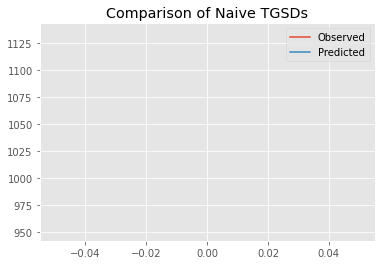

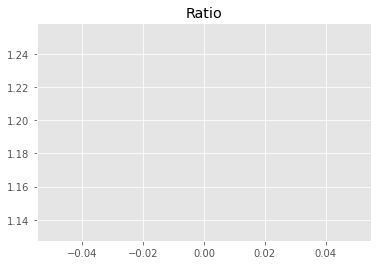

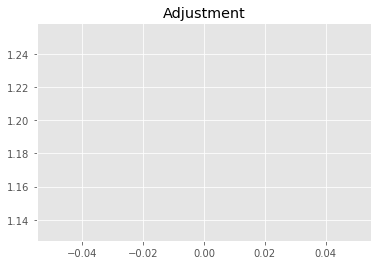

8154886783.277002
1


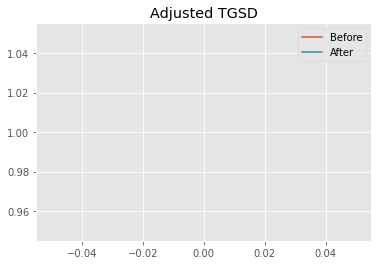

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|58.4712 	210.359 	29424.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|57.1872 	227.637 	29622.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.9661
New Misfit: 13.7087
Convergence:
0.018427455580625505

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.03e+03 	1.13e+03 	1.1035 		1.0000


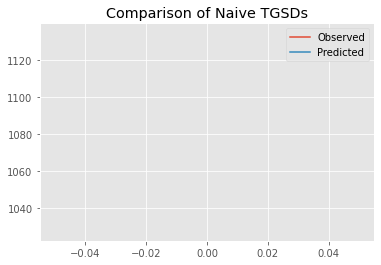

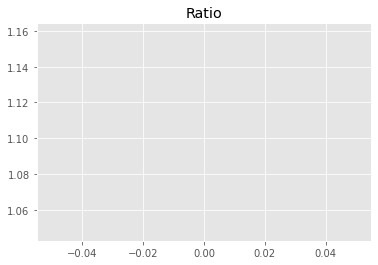

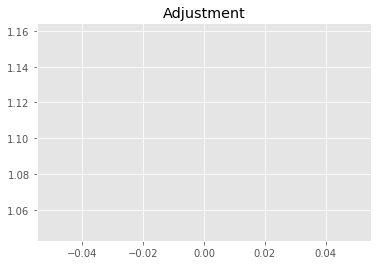

7543596113.146365
1


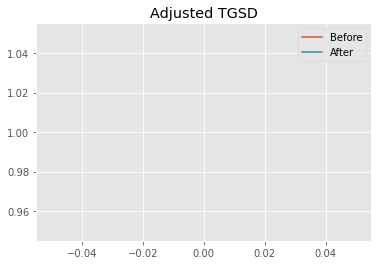

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|57.1872 	227.637 	29622.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|93.9364 	392.524 	30639.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.7087
New Misfit: 13.645
Convergence:
0.004647814157092718

____________________
a = 93.93639	b = 392.52398	            h1 = 30639.30836	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.644990019039152
Prior Misfit: 0.323461,	 Post Misfit: 13.645


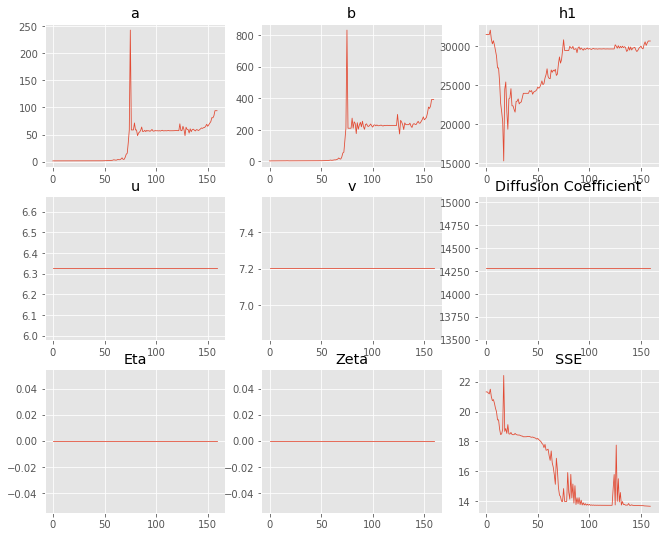

,Priors,Posteriors
a,1.46549,93.9364
b,2.84804,392.524
h1,"31,469.5","30,639.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.085 minutes


Estimated remaining run time: 0.798 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.25e+02 	1.13e+03 	1.5654 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


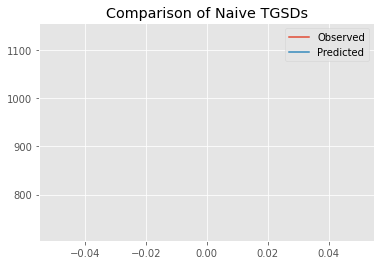

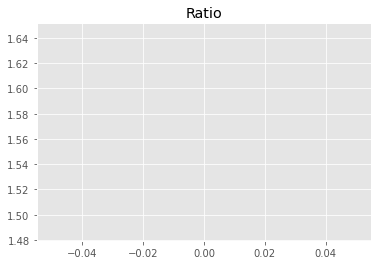

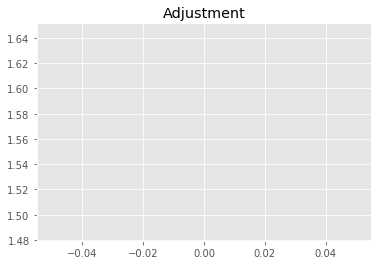

10701570228.62597
1


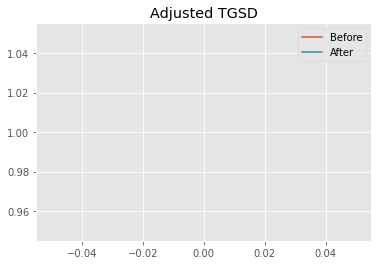

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.7347 	3.32297 	15546.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.36969 	4.91945 	15443.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.4239
New Misfit: 15.3551
Convergence:
0.11873031393064247

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.42e+02 	1.13e+03 	1.2045 		1.0000


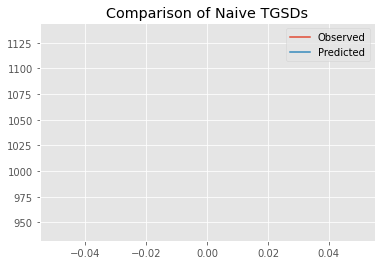

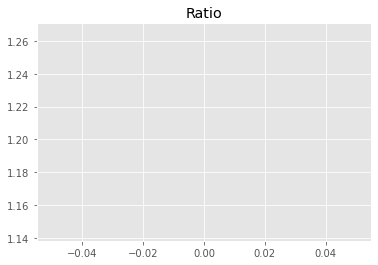

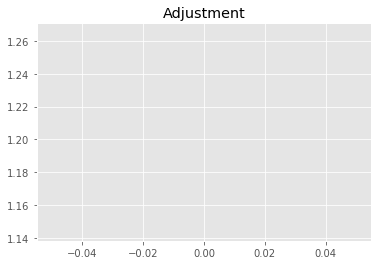

8234124284.211666
1


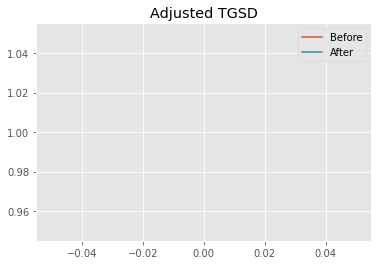

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.36969 	4.91945 	15443.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|237.32 	352.648 	16213.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.3551
New Misfit: 13.6117
Convergence:
0.11353959990001673

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.03e+03 	1.13e+03 	1.1009 		1.0000


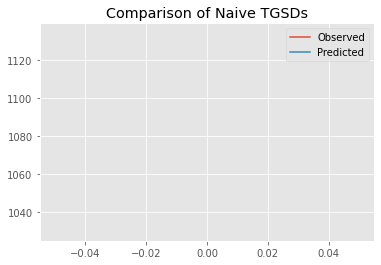

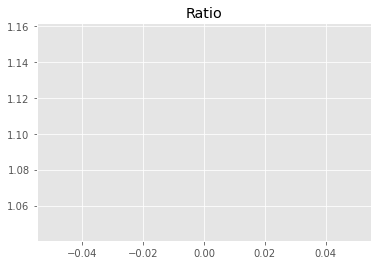

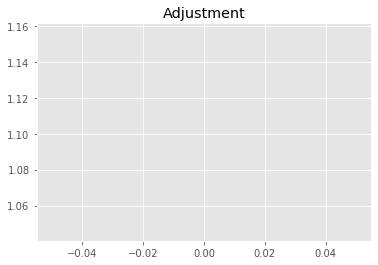

7525949607.10953
1


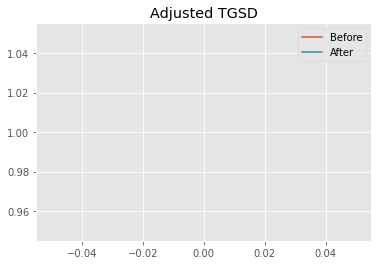

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|237.32 	352.648 	16213.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|240.067 	356.729 	16199.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6117
New Misfit: 13.6116
Convergence:
7.532415818012842e-06

____________________
a = 240.06653	b = 356.72862	            h1 = 16199.40927	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.611611988329035
Prior Misfit: 0.264328,	 Post Misfit: 13.6116


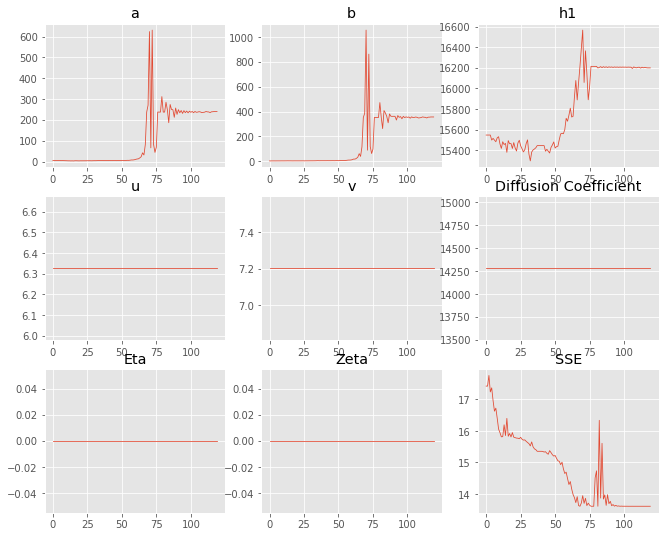

,Priors,Posteriors
a,4.7347,240.067
b,3.32297,356.729
h1,"15,546.4","16,199.4"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.067 minutes


Estimated remaining run time: 0.800 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.14e+02 	1.13e+03 	1.2411 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


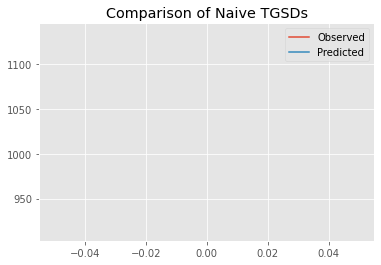

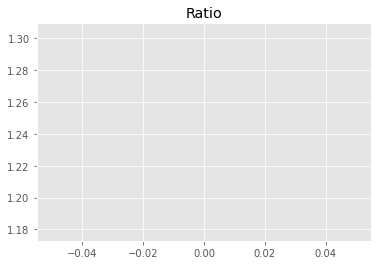

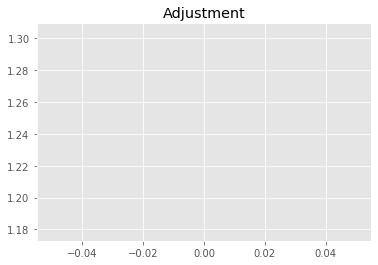

8484607882.431173
1


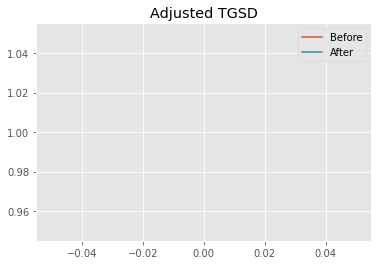

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.39698 	4.41693 	19939.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|5.36282 	4.24106 	11927.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.0013
New Misfit: 15.1036
Convergence:
0.11162304733339064

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.09e+03 	1.13e+03 	1.0437 		1.0000


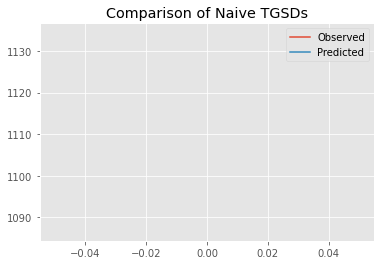

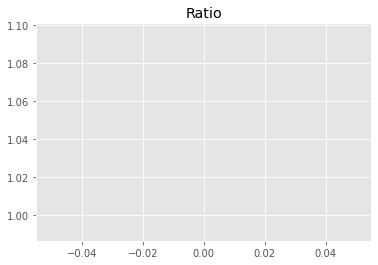

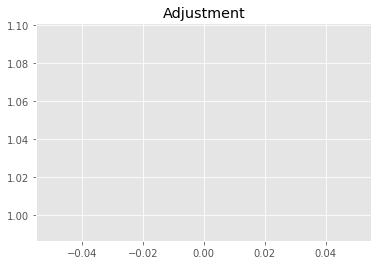

7135037470.8443575
1


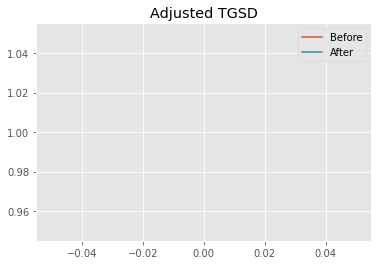

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.36282 	4.24106 	11927.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|6.89043 	2.86465 	10680.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.1036
New Misfit: 14.1535
Convergence:
0.06290300710641045

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1122 		1.0000


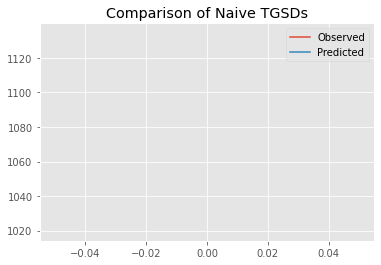

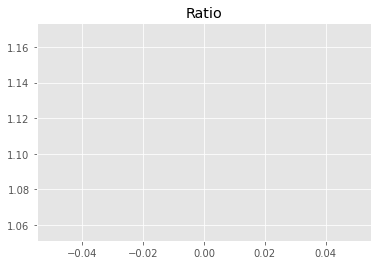

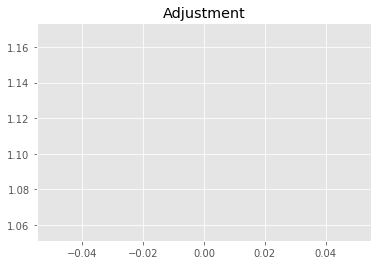

7603061663.87049
1


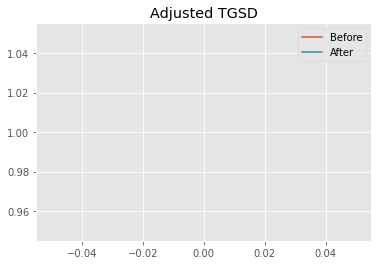

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.89043 	2.86465 	10680.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|14.5203 	2.58772 	9577.86 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.1535
New Misfit: 13.6742
Convergence:
0.03386426492185966

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1296 		1.0000


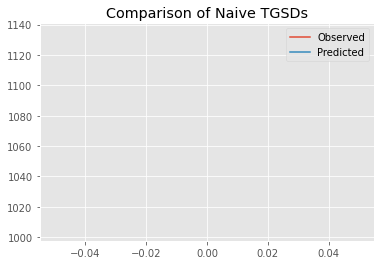

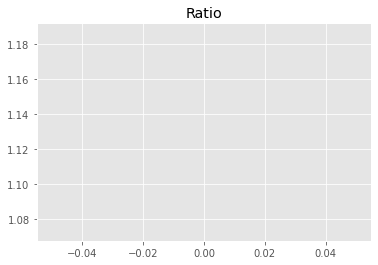

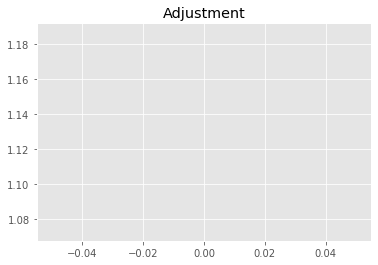

7721847601.356627
1


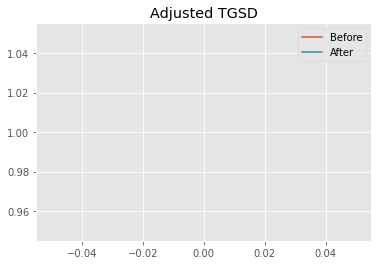

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|14.5203 	2.58772 	9577.86 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|15.5141 	2.59501 	9360.85 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6742
New Misfit: 13.6599
Convergence:
0.0010456561768725937

____________________
a = 15.51406	b = 2.59501	            h1 = 9360.85054	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.6599038708393
Prior Misfit: 0.257917,	 Post Misfit: 13.6599


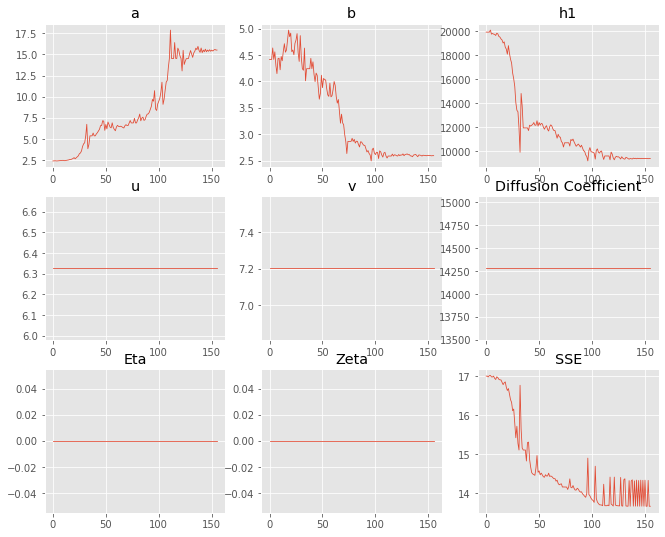

,Priors,Posteriors
a,2.39698,15.5141
b,4.41693,2.59501
h1,"19,939.8","9,360.85"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.083 minutes


Estimated remaining run time: 0.817 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.85e+02 	1.13e+03 	1.2814 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


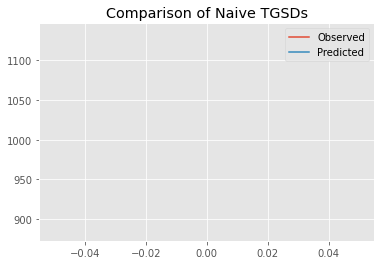

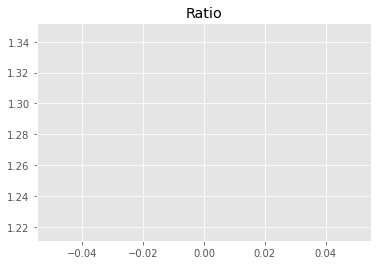

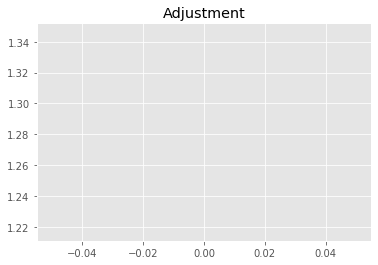

8760012584.75626
1


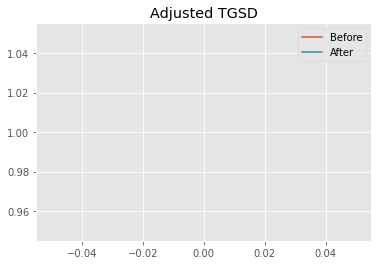

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.69131 	4.9481 	17618.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|82.2028 	85.2979 	13519.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 16.0259
New Misfit: 13.6763
Convergence:
0.14660944057368108

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0597 		1.0000


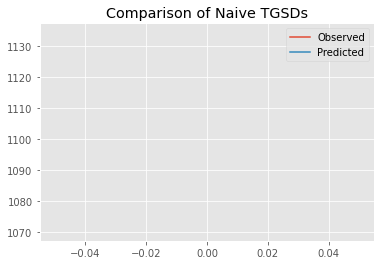

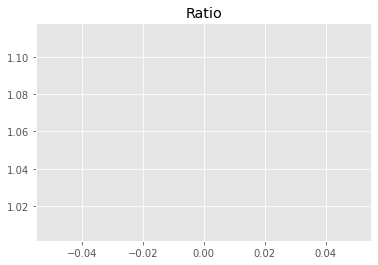

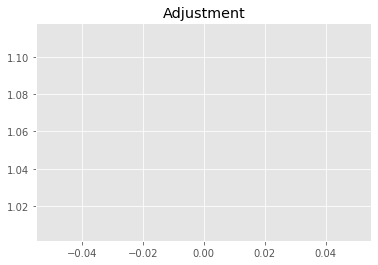

7244094510.500724
1


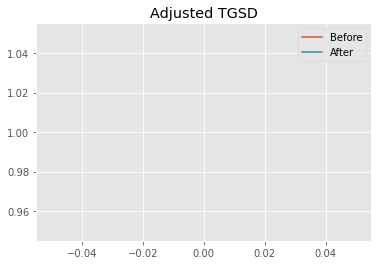

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|82.2028 	85.2979 	13519.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|86.9575 	83.3545 	13464.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6763
New Misfit: 13.6199
Convergence:
0.0041276599276757085

____________________
a = 86.95747	b = 83.35446	            h1 = 13464.15088	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 13.6198918502127
Prior Misfit: 0.24312,	 Post Misfit: 13.6199


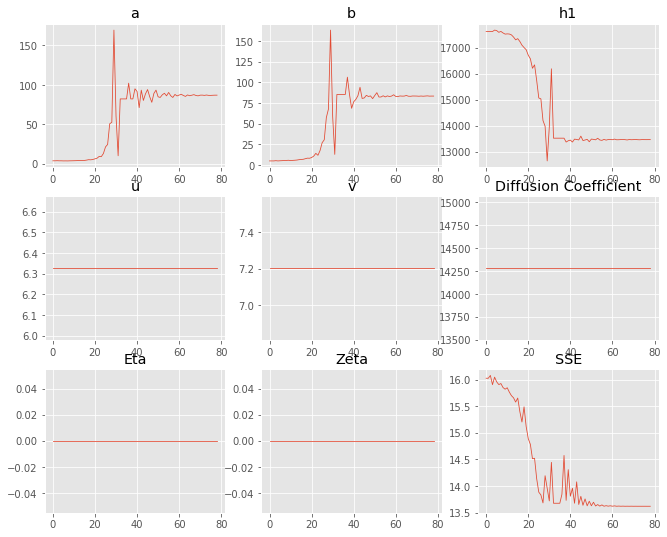

,Priors,Posteriors
a,3.69131,86.9575
b,4.9481,83.3545
h1,"17,618.4","13,464.2"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.050 minutes


Estimated remaining run time: 0.742 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.22e+03 	1.13e+03 	0.9322 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


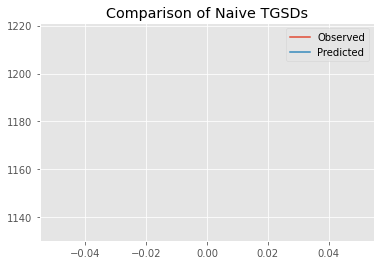

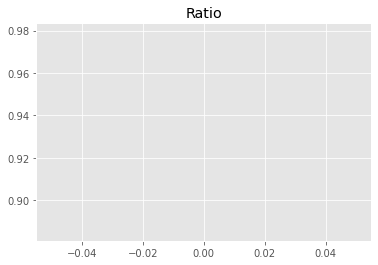

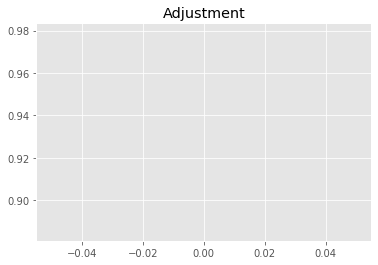

6372366114.921386
1


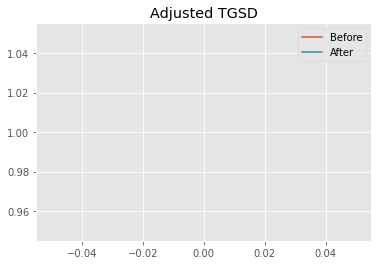

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.87533 	4.64642 	11068.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.50501 	3.38227 	11004.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.7337
New Misfit: 14.1201
Convergence:
0.2037722017257708

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.01e+03 	1.13e+03 	1.1250 		1.0000


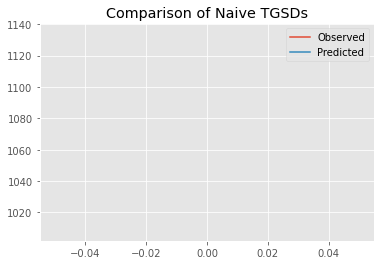

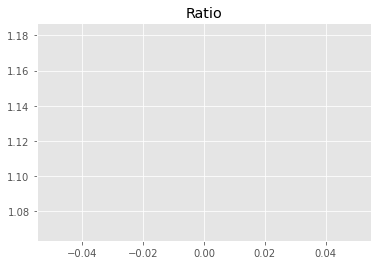

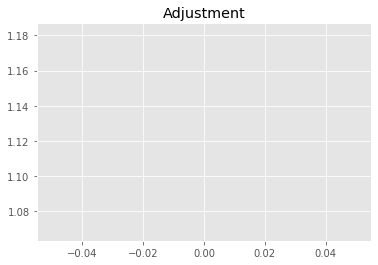

7690649951.330399
1


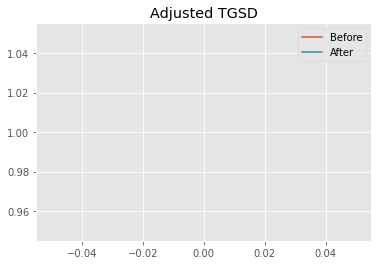

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.50501 	3.38227 	11004.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|15.6354 	2.73269 	9418.48 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.1201
New Misfit: 13.661
Convergence:
0.03251123762943704

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1174 		1.0000


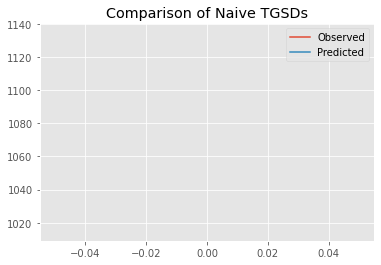

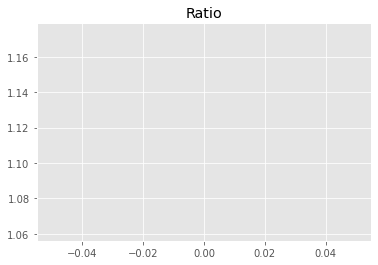

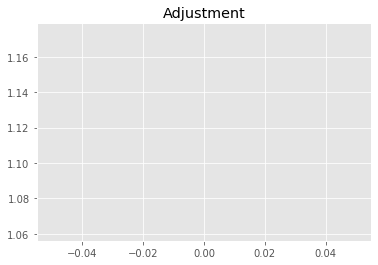

7638936742.386103
1


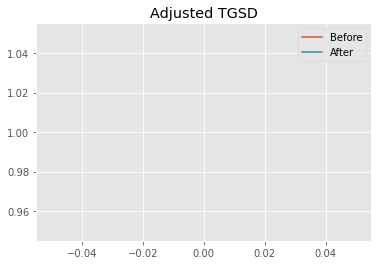

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|15.6354 	2.73269 	9418.48 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|17.564 	2.93055 	9377.79 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.661
New Misfit: 13.6532
Convergence:
0.0005673693674642029

____________________
a = 17.56403	b = 2.93055	            h1 = 9377.78752	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.653249615448631
Prior Misfit: 0.269028,	 Post Misfit: 13.6532


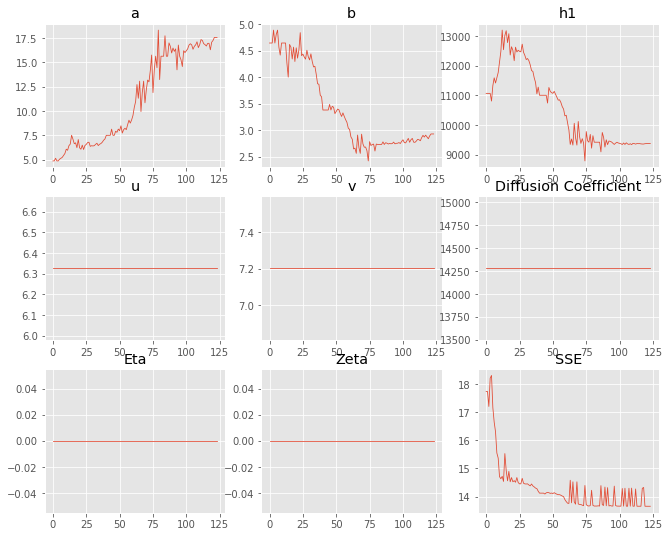

,Priors,Posteriors
a,4.87533,17.564
b,4.64642,2.93055
h1,"11,068.8","9,377.79"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.067 minutes


Estimated remaining run time: 0.699 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1300 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


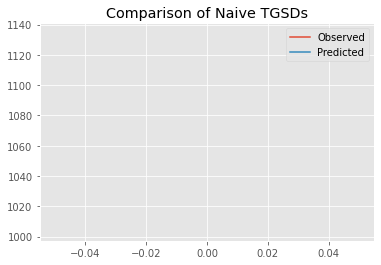

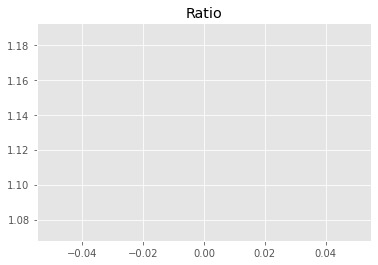

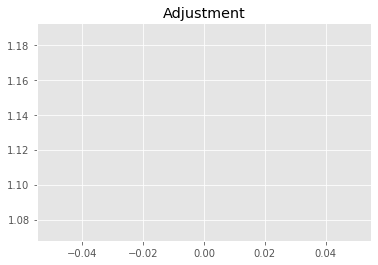

7725127500.782222
1


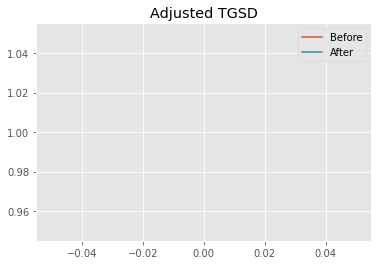

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.82947 	3.30123 	12261.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|16.3131 	3.00836 	9537.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.7612
New Misfit: 13.6628
Convergence:
0.07441036322102558

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.01e+03 	1.13e+03 	1.1243 		1.0000


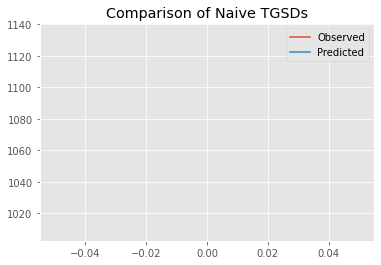

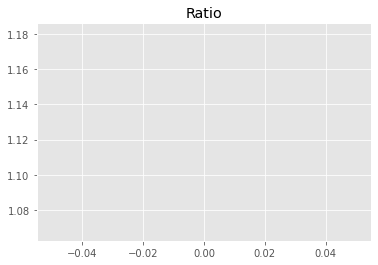

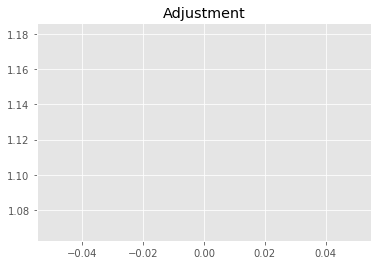

7685926264.165556
1


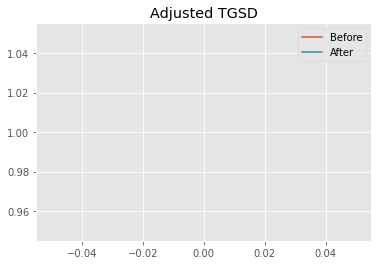

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|16.3131 	3.00836 	9537.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|19.2835 	3.38574 	9416.96 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6628
New Misfit: 13.6484
Convergence:
0.0010579334247012313

____________________
a = 19.28346	b = 3.38574	            h1 = 9416.95727	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 13.648393002637128
Prior Misfit: 0.223935,	 Post Misfit: 13.6484


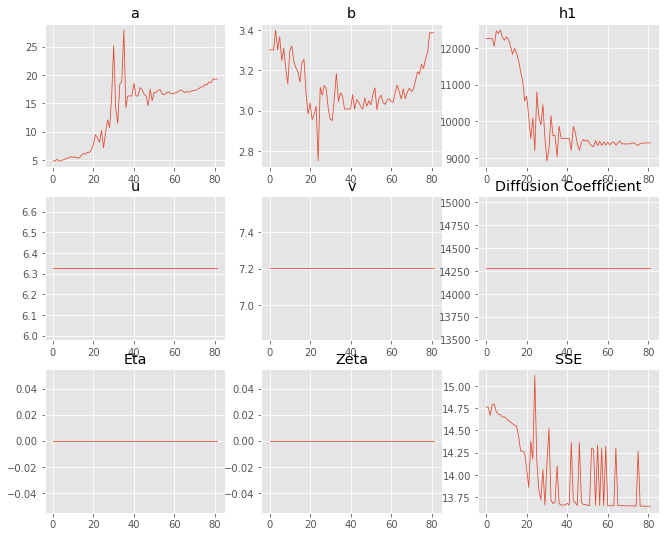

,Priors,Posteriors
a,4.82947,19.2835
b,3.30123,3.38574
h1,"12,261.8","9,416.96"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.050 minutes


Estimated remaining run time: 0.631 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	6.60e+02 	1.13e+03 	1.7175 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


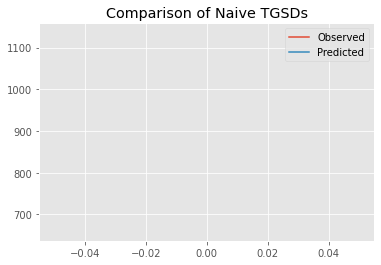

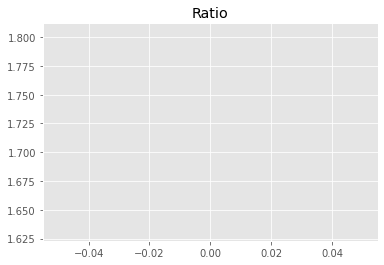

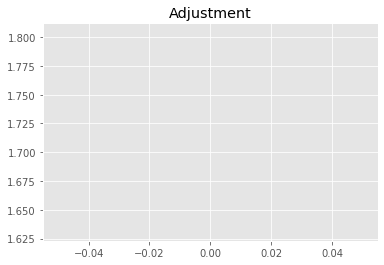

11741049138.587564
1


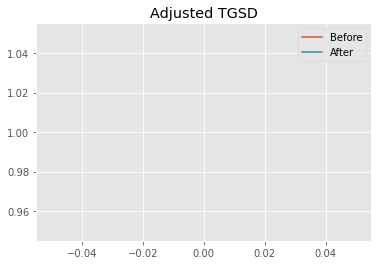

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.18026 	2.7944 	18146.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.53096 	4.40266 	16737.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 18.9504
New Misfit: 15.955
Convergence:
0.15806265313437384

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.02e+02 	1.13e+03 	1.2577 		1.0000


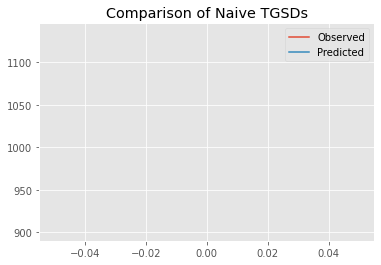

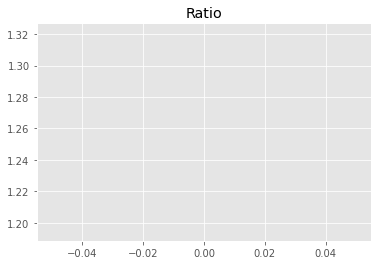

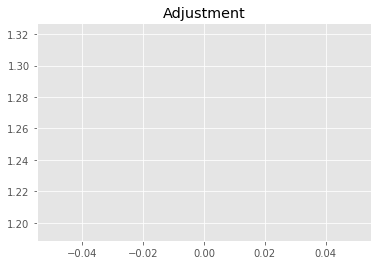

8597955709.74525
1


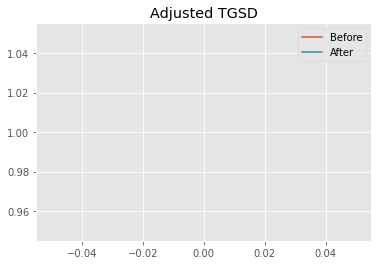

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.53096 	4.40266 	16737.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|197.131 	262.382 	15581.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.955
New Misfit: 13.6288
Convergence:
0.1458002752925428

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.01e+03 	1.13e+03 	1.1239 		1.0000


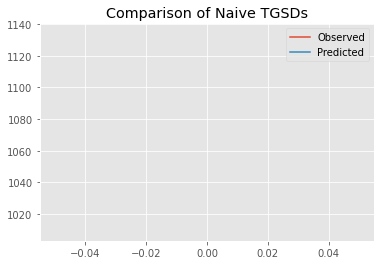

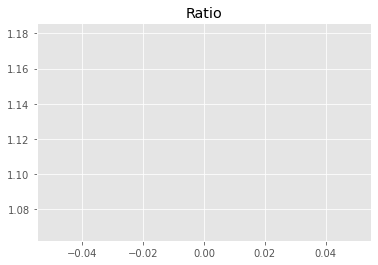

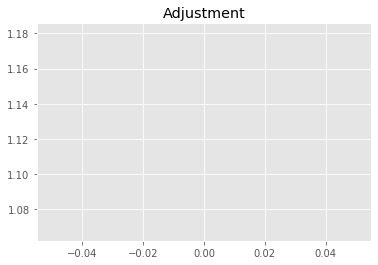

7682902443.377397
1


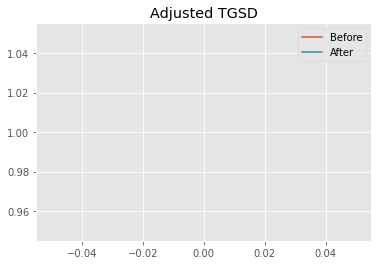

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|197.131 	262.382 	15581.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|197.375 	268.84 	15557.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6288
New Misfit: 13.6118
Convergence:
0.0012471538873353664

____________________
a = 197.37457	b = 268.84005	            h1 = 15557.70795	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.611795112185948
Prior Misfit: 0.287486,	 Post Misfit: 13.6118


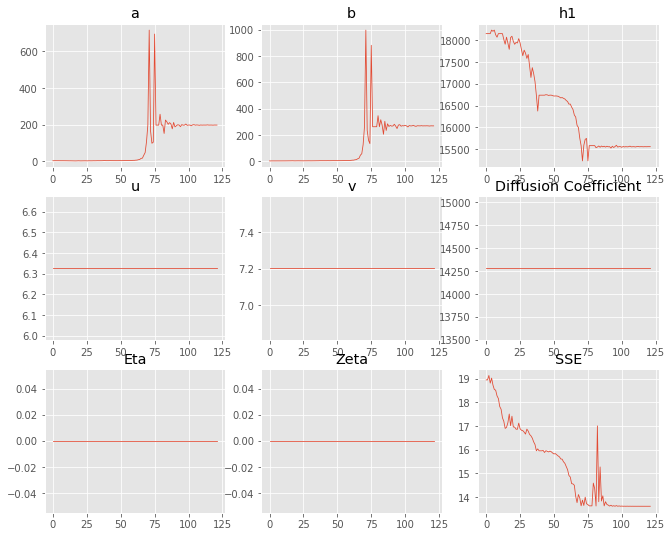

,Priors,Posteriors
a,3.18026,197.375
b,2.7944,268.84
h1,"18,146.9","15,557.7"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.069 minutes


Estimated remaining run time: 0.585 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.59e+02 	1.13e+03 	1.1833 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


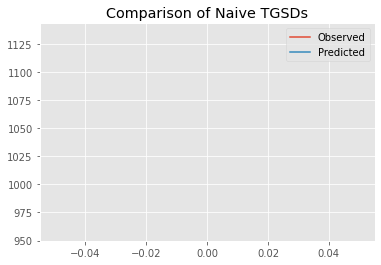

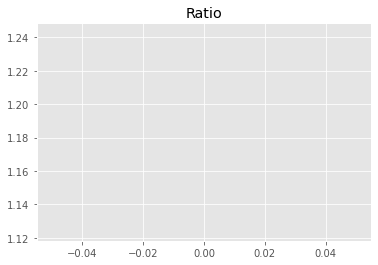

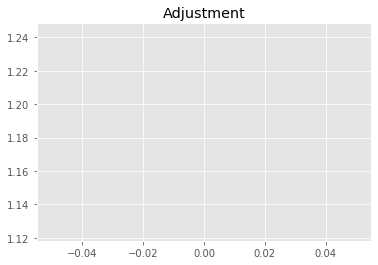

8088929840.670289
1


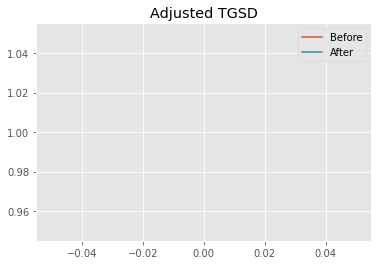

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19638 	1.26817 	13599.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.67121 	1.11766 	13130.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.754
New Misfit: 16.566
Convergence:
0.06691188768015835

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.15e+02 	1.13e+03 	1.2395 		1.0000


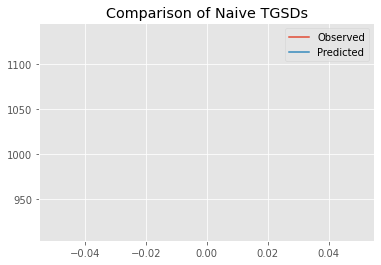

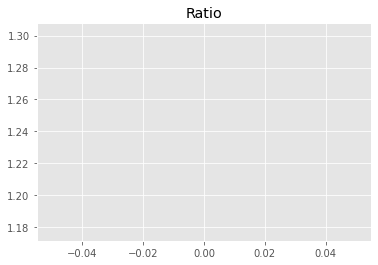

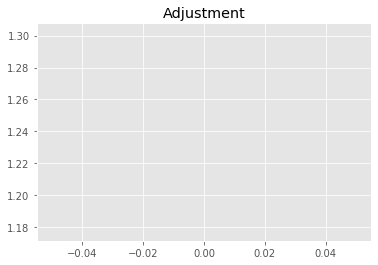

8473510143.235727
1


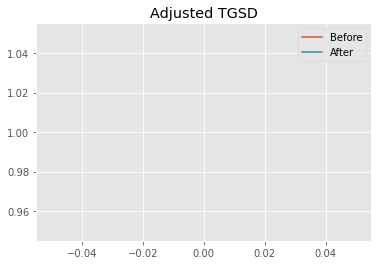

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67121 	1.11766 	13130.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.97155 	1.00077 	9371.96 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 16.566
New Misfit: 14.0337
Convergence:
0.15286018858717396

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0759 		1.0000


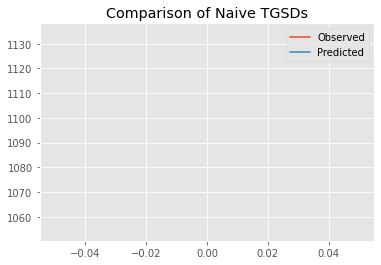

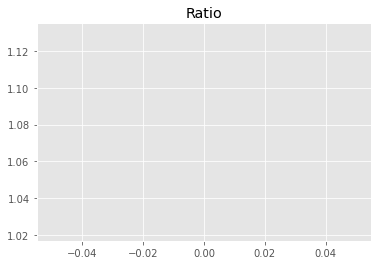

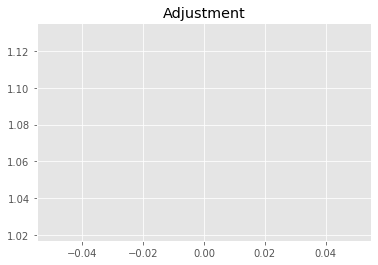

7354918703.293571
1


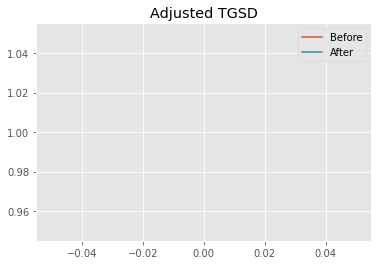

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.97155 	1.00077 	9371.96 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.66014 	1.00112 	10236.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.0337
New Misfit: 13.7231
Convergence:
0.02213802075019485

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.90e+02 	1.13e+03 	1.1452 		1.0000


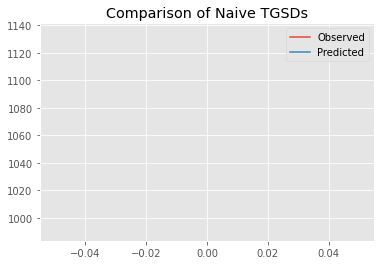

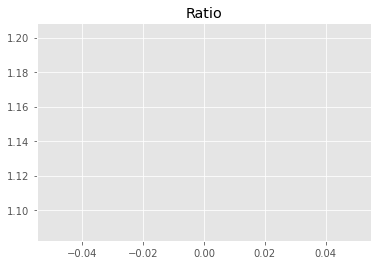

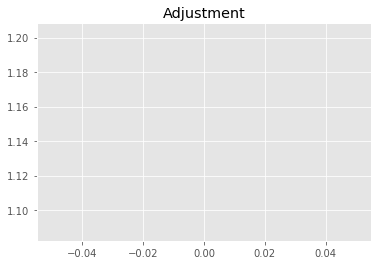

7828937949.610514
1


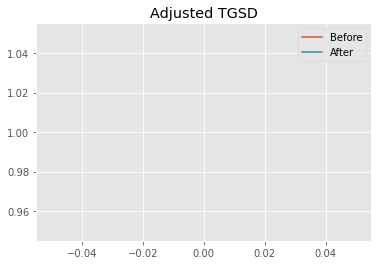

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.66014 	1.00112 	10236.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.75605 	1.02432 	9413.96 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.7231
New Misfit: 13.7217
Convergence:
0.0001011914600725992

____________________
a = 8.75605	b = 1.02432	            h1 = 9413.96370	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.721667400545277
Prior Misfit: 0.269336,	 Post Misfit: 13.7217


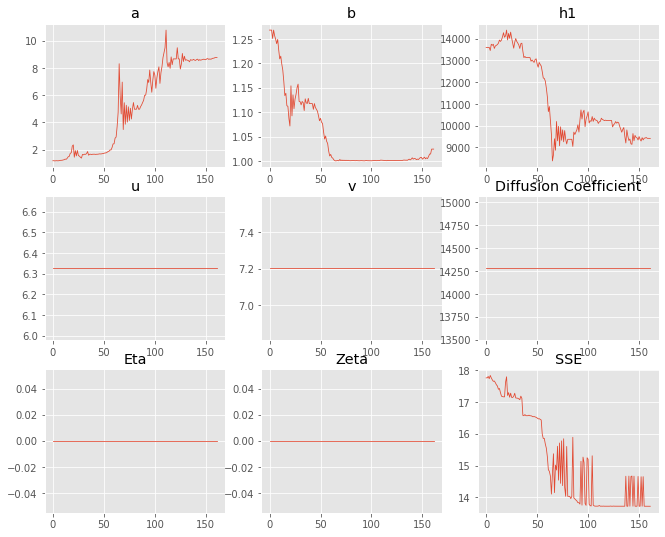

,Priors,Posteriors
a,1.19638,8.75605
b,1.26817,1.02432
h1,"13,599.8","9,413.96"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.085 minutes


Estimated remaining run time: 0.549 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.15e+03 	1.13e+03 	0.9859 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


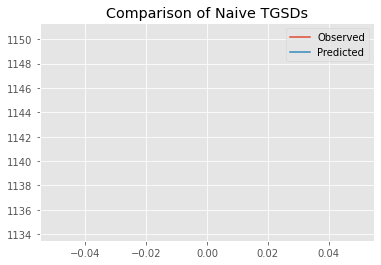

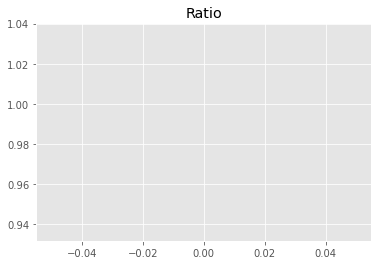

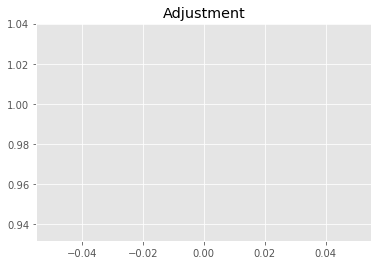

6739705176.859183
1


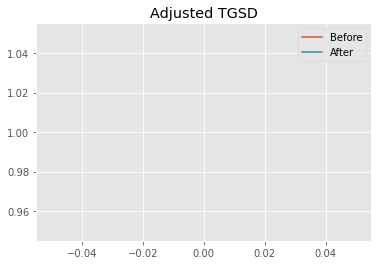

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6912 	2.37823 	11384.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.01617 	2.41169 	13526.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.4987
New Misfit: 15.655
Convergence:
0.10536075324309992

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.46e+02 	1.13e+03 	1.1986 		1.0000


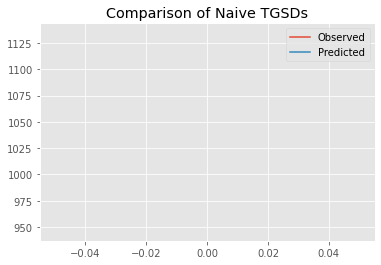

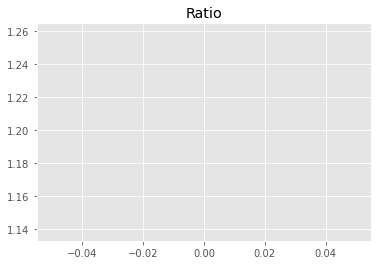

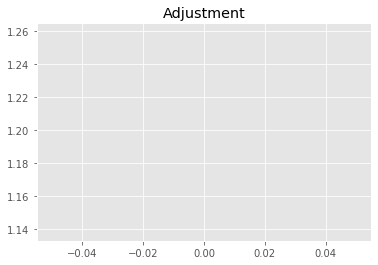

8194050581.754645
1


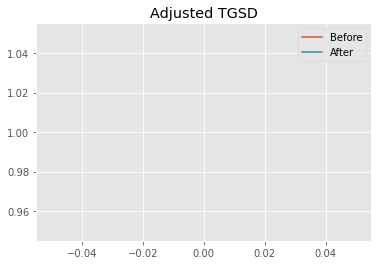

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.01617 	2.41169 	13526.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|7.88678 	2.09363 	9564.15 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.655
New Misfit: 14.0015
Convergence:
0.10562409570849597

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.08e+03 	1.13e+03 	1.0550 		1.0000


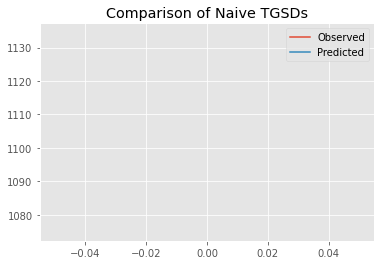

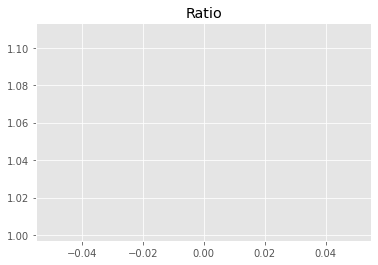

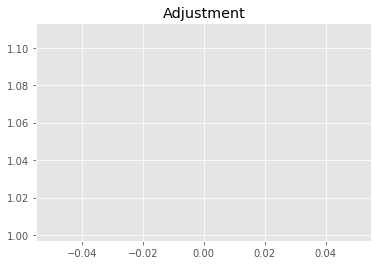

7211798485.84391
1


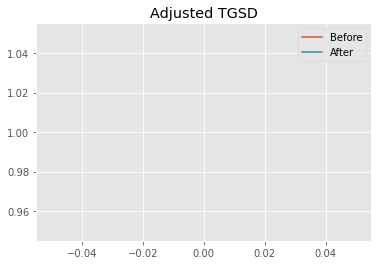

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.88678 	2.09363 	9564.15 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|12.531 	2.05325 	9544.73 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.0015
New Misfit: 13.6856
Convergence:
0.022563478472858903

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.00e+03 	1.13e+03 	1.1322 		1.0000


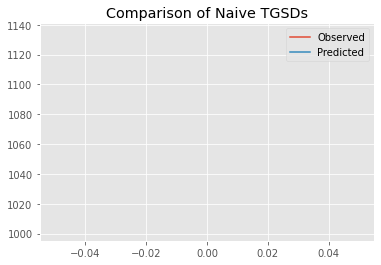

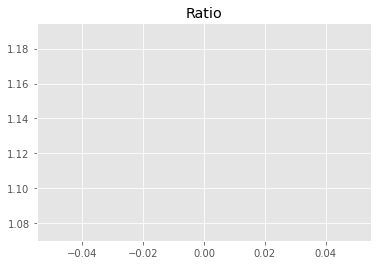

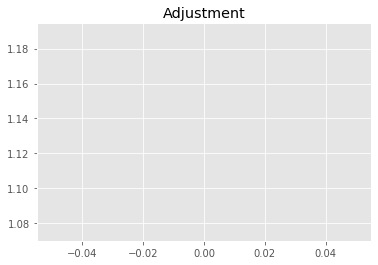

7739917936.770222
1


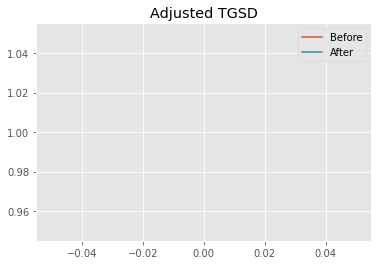

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.531 	2.05325 	9544.73 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|13.3236 	2.0543 	9360.45 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6856
New Misfit: 13.6734
Convergence:
0.0008918118163149663

____________________
a = 13.32364	b = 2.05430	            h1 = 9360.44864	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.673354208735292
Prior Misfit: 0.265463,	 Post Misfit: 13.6734


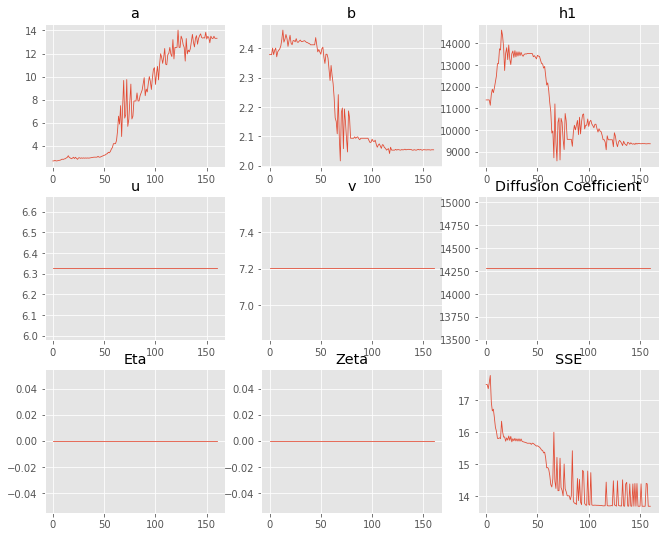

,Priors,Posteriors
a,2.6912,13.3236
b,2.37823,2.0543
h1,"11,384.8","9,360.45"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.086 minutes


Estimated remaining run time: 0.504 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.84e+02 	1.13e+03 	1.4467 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


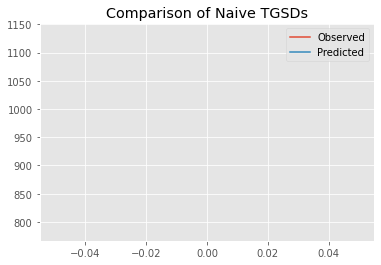

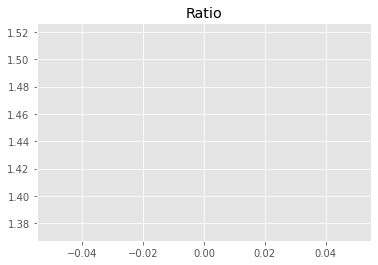

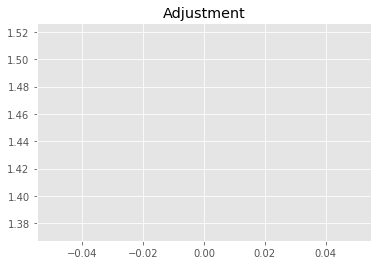

9890014809.7989
1


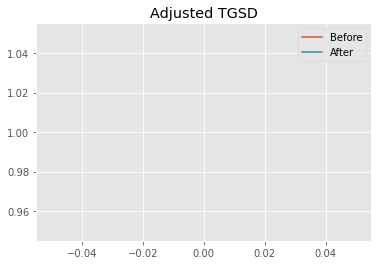

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.70422 	2.33817 	14402.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.574 	2.45817 	12444.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 16.6598
New Misfit: 15.1635
Convergence:
0.08981572445813316

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.95e+02 	1.13e+03 	1.1404 		1.0000


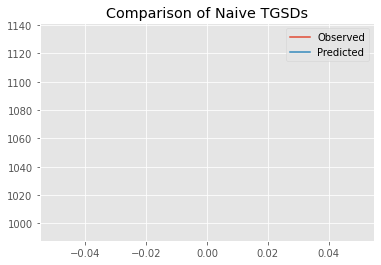

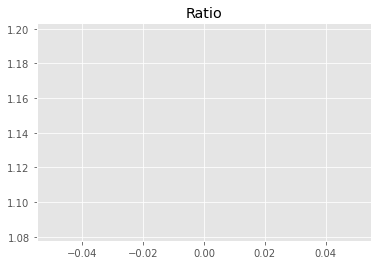

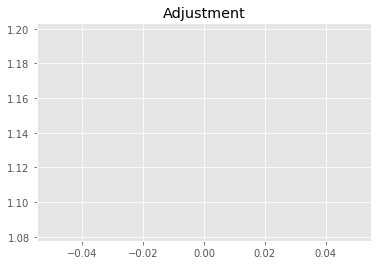

7795779656.432364
1


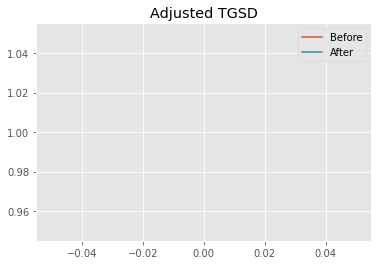

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.574 	2.45817 	12444.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|5.17589 	2.29283 	10657.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.1635
New Misfit: 14.449
Convergence:
0.047118375945592095

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0920 		1.0000


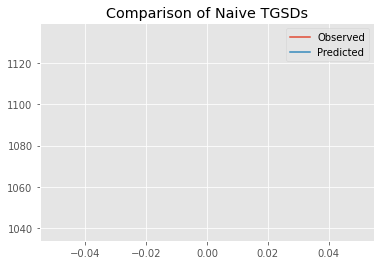

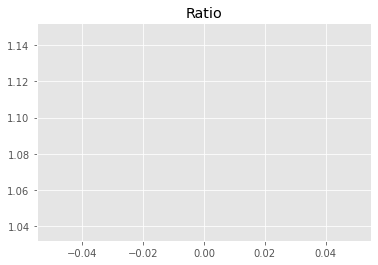

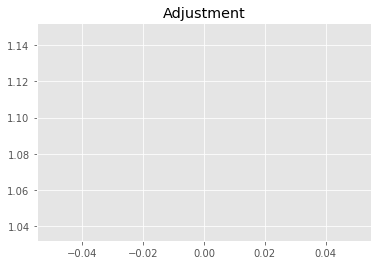

7464749682.297558
1


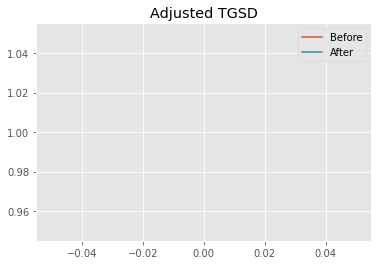

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.17589 	2.29283 	10657.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|14.4554 	1.87798 	9390.68 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.449
New Misfit: 13.6967
Convergence:
0.05206773420490274

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.87e+02 	1.13e+03 	1.1489 		1.0000


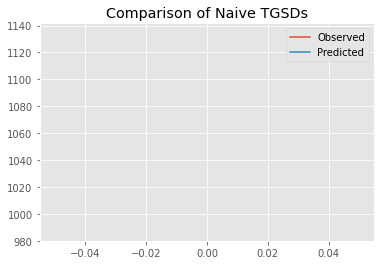

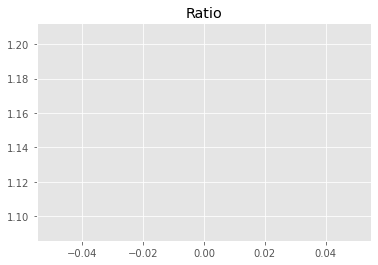

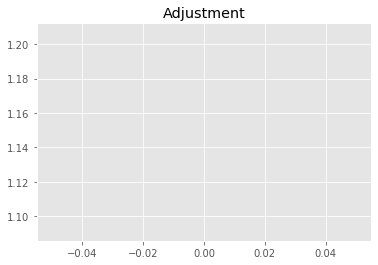

7853795088.920458
1


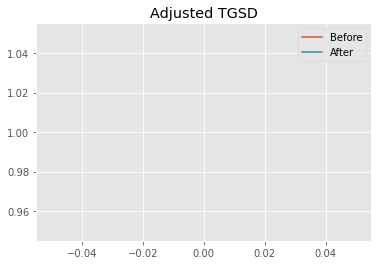

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|14.4554 	1.87798 	9390.68 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|12.3773 	1.87367 	9364.49 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6967
New Misfit: 13.6799
Convergence:
0.0012242125653506926

____________________
a = 12.37732	b = 1.87367	            h1 = 9364.49156	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.679910408500772
Prior Misfit: 0.252737,	 Post Misfit: 13.6799


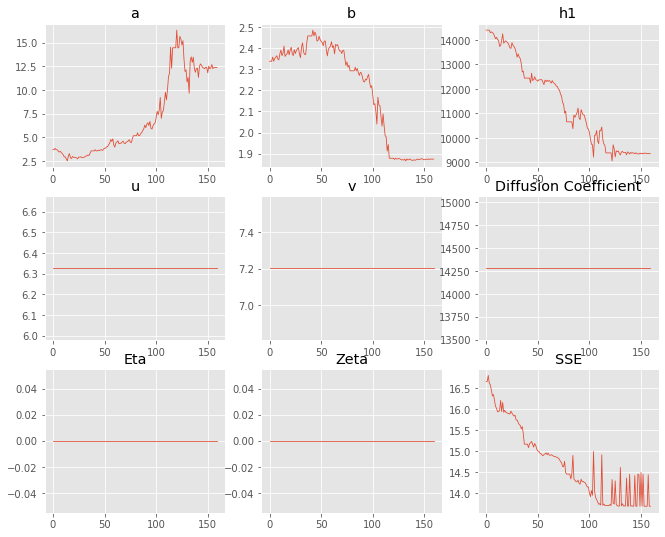

,Priors,Posteriors
a,3.70422,12.3773
b,2.33817,1.87367
h1,"14,402.1","9,364.49"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.085 minutes


Estimated remaining run time: 0.453 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.80e+02 	1.13e+03 	1.1571 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


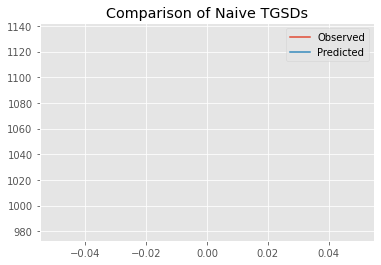

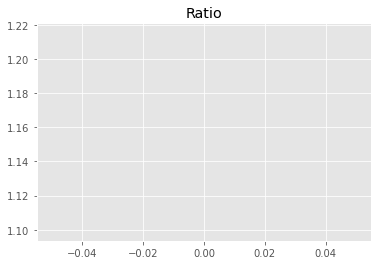

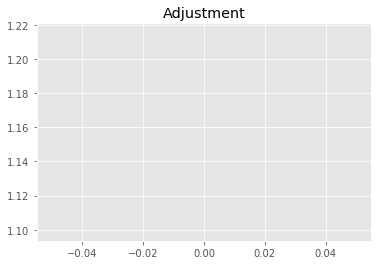

7910292516.010542
1


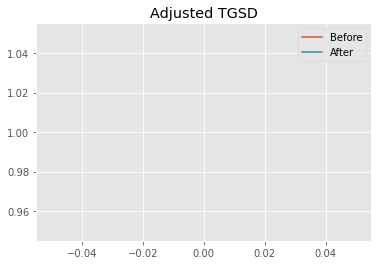

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.88258 	4.77266 	15435.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|235.063 	548.526 	20625.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.5652
New Misfit: 13.6128
Convergence:
0.1254332643808868

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0932 		1.0000


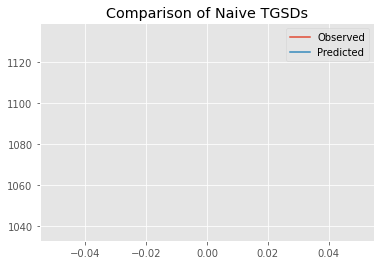

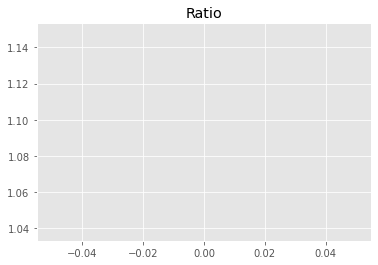

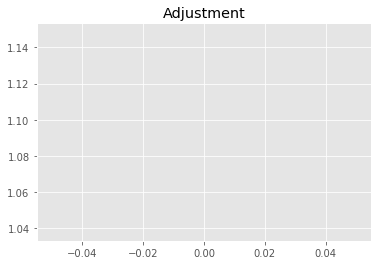

7473196843.284454
1


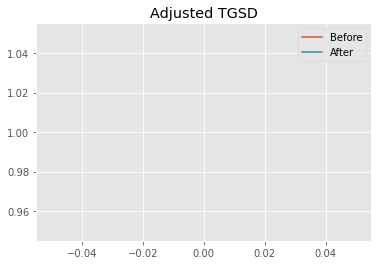

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|235.063 	548.526 	20625.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|238.156 	556.191 	20701.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6128
New Misfit: 13.6118
Convergence:
7.282478456142625e-05

____________________
a = 238.15617	b = 556.19105	            h1 = 20701.05952	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 13.611843995760603
Prior Misfit: 0.236132,	 Post Misfit: 13.6118


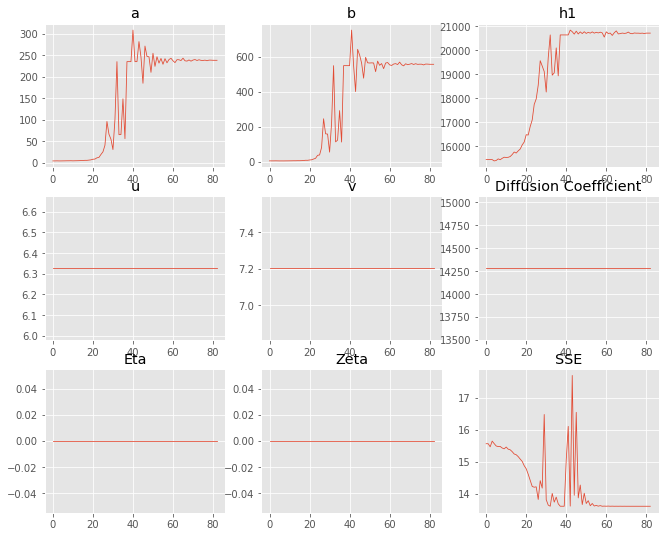

,Priors,Posteriors
a,3.88258,238.156
b,4.77266,556.191
h1,"15,435.7","20,701.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.050 minutes


Estimated remaining run time: 0.382 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.11e+03 	1.13e+03 	1.0184 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


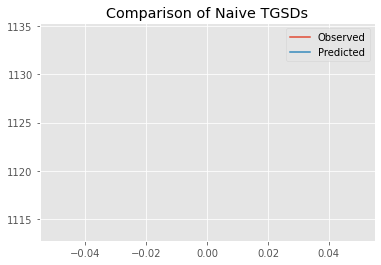

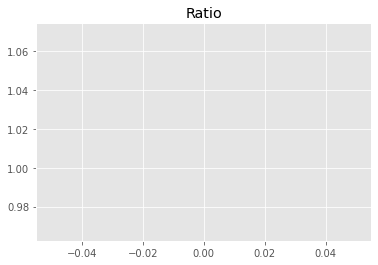

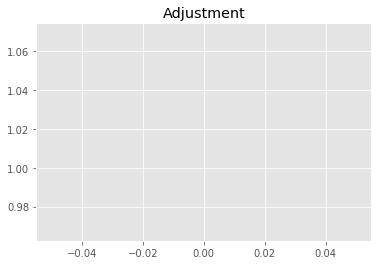

6962051707.463253
1


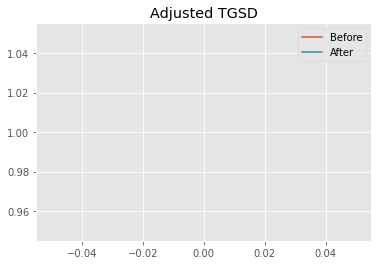

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04021 	1.38207 	12171 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.31834 	1.11883 	13145.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.6441
New Misfit: 17.198
Convergence:
0.12452442776177722

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.65e+02 	1.13e+03 	1.1750 		1.0000


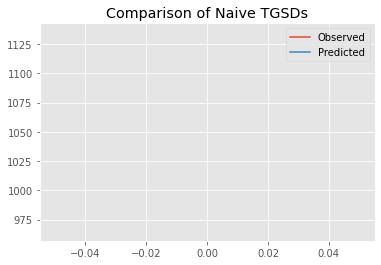

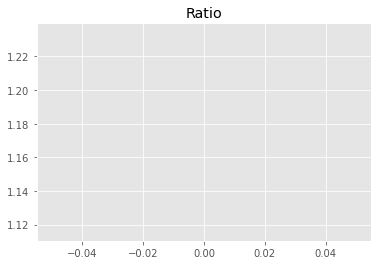

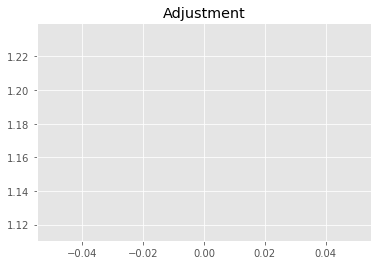

8032672465.71897
1


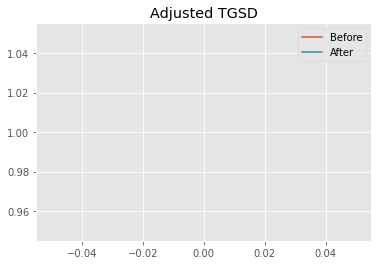

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.31834 	1.11883 	13145.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.12023 	1.00475 	10204.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.198
New Misfit: 13.7249
Convergence:
0.20194469231491502

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.97e+02 	1.13e+03 	1.1381 		1.0000


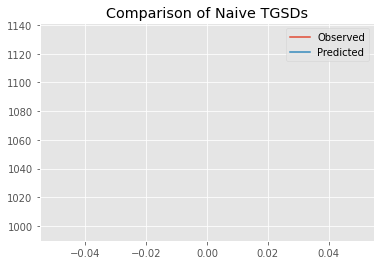

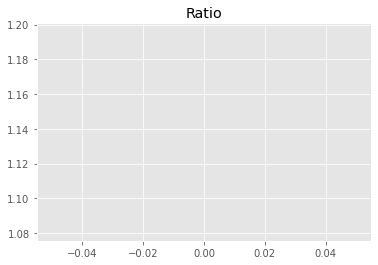

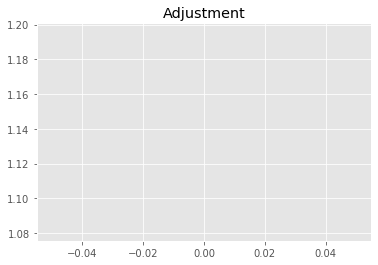

7780538960.918619
1


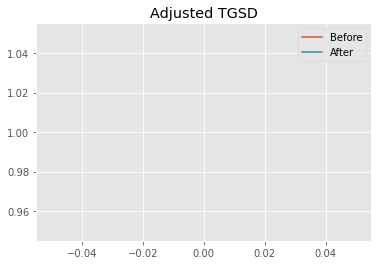

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.12023 	1.00475 	10204.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|8.68791 	1.02053 	9375.13 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.7249
New Misfit: 13.7217
Convergence:
0.00023616416650998147

____________________
a = 8.68791	b = 1.02053	            h1 = 9375.13081	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.721691769022947
Prior Misfit: 0.298011,	 Post Misfit: 13.7217


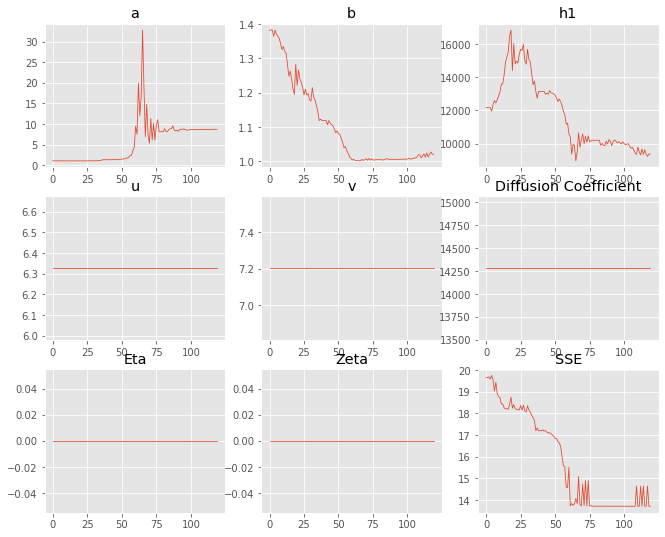

,Priors,Posteriors
a,1.04021,8.68791
b,1.38207,1.02053
h1,"12,171","9,375.13"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.068 minutes


Estimated remaining run time: 0.320 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	6.43e+02 	1.13e+03 	1.7637 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


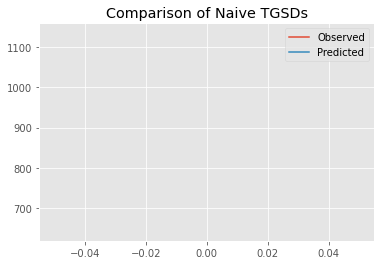

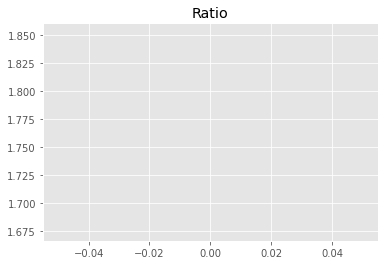

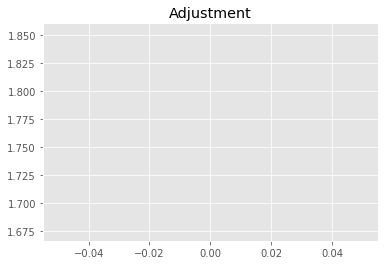

12056691779.395113
1


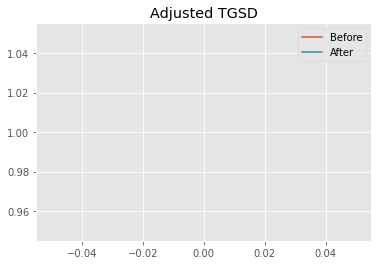

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.63811 	4.4934 	26227.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.66577 	4.34577 	14969.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.6991
New Misfit: 15.6658
Convergence:
0.2047450272185488

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.93e+02 	1.13e+03 	1.1418 		1.0000


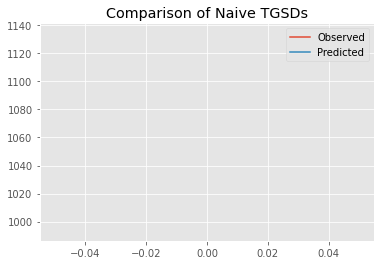

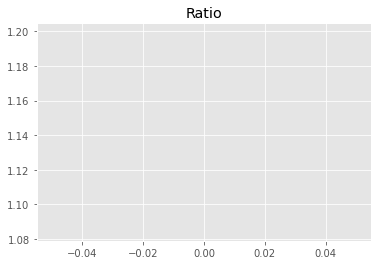

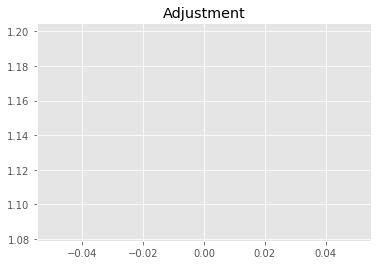

7805613142.037741
1


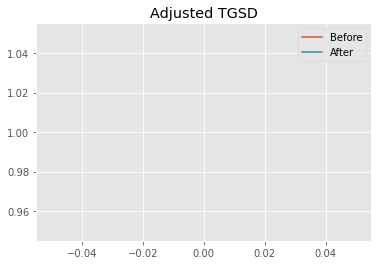

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.66577 	4.34577 	14969.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|21.363 	37.5147 	17966.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.6658
New Misfit: 13.9283
Convergence:
0.1109115830985498

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1166 		1.0000


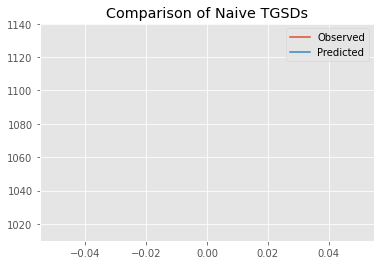

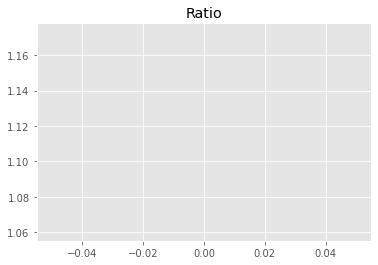

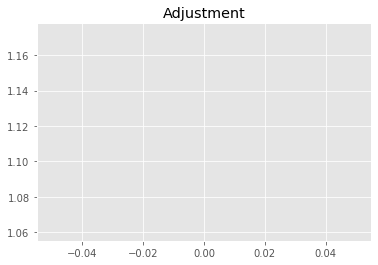

7633209422.481617
1


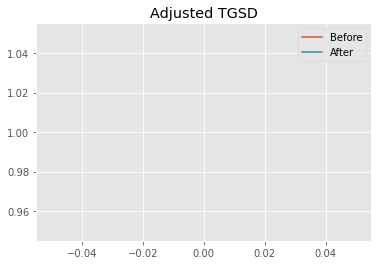

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|21.363 	37.5147 	17966.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|296.42 	362.86 	14774.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.9283
New Misfit: 13.6123
Convergence:
0.02268898820983804

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.04e+03 	1.13e+03 	1.0941 		1.0000


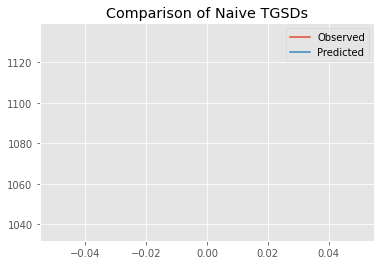

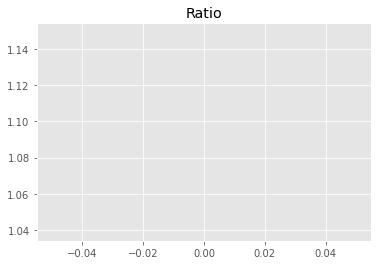

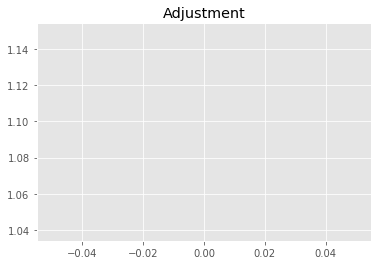

7479497198.6152525
1


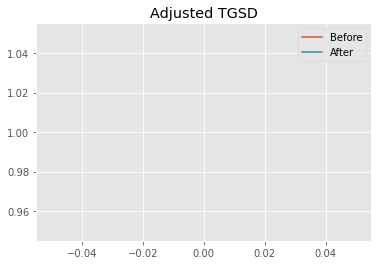

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|296.42 	362.86 	14774.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|298.016 	361.452 	14740.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6123
New Misfit: 13.6115
Convergence:
5.2813122566615295e-05

____________________
a = 298.01630	b = 361.45170	            h1 = 14740.56473	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 13.611543340004054
Prior Misfit: 0.298844,	 Post Misfit: 13.6115


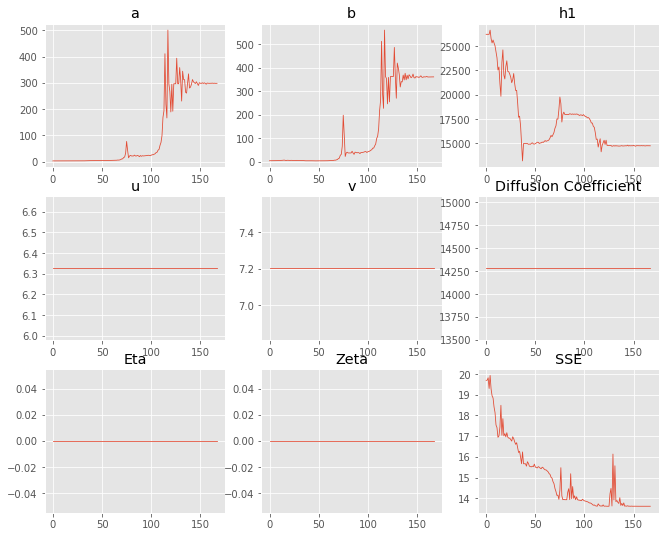

,Priors,Posteriors
a,2.63811,298.016
b,4.4934,361.452
h1,"26,227.7","14,740.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.083 minutes


Estimated remaining run time: 0.261 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	6.86e+02 	1.13e+03 	1.6528 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


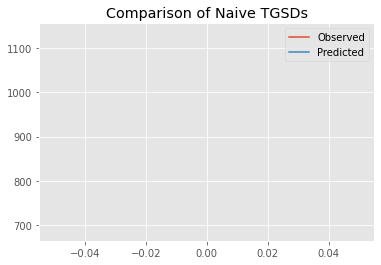

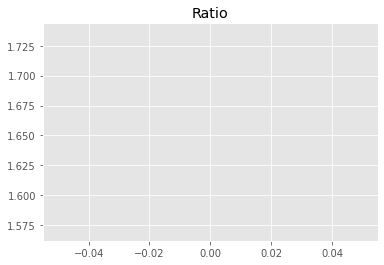

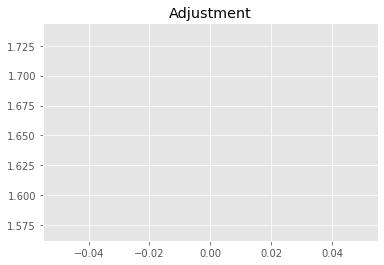

11298898676.487892
1


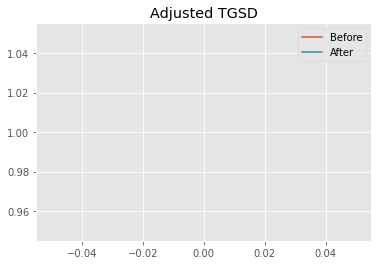

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09309 	1.95794 	18376.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.15363 	1.93001 	13487.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.0213
New Misfit: 16.3917
Convergence:
0.13824519873617275

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.81e+02 	1.13e+03 	1.1564 		1.0000


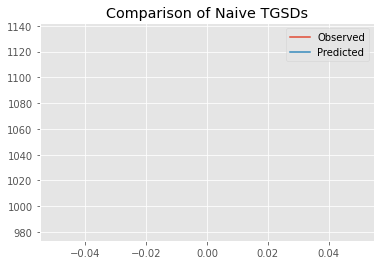

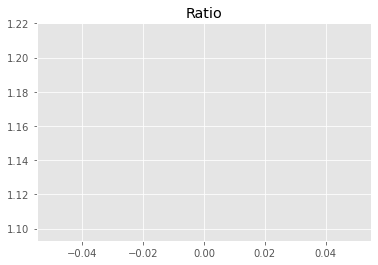

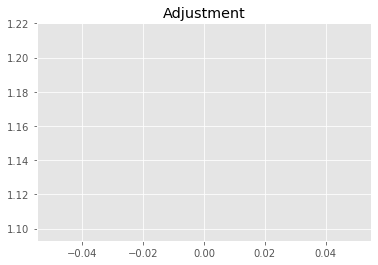

7905648894.197387
1


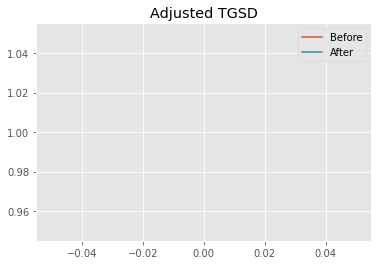

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.15363 	1.93001 	13487.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.26319 	1.93801 	13126.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 16.3917
New Misfit: 15.7351
Convergence:
0.0400551181282461

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	8.73e+02 	1.13e+03 	1.2988 		1.0000


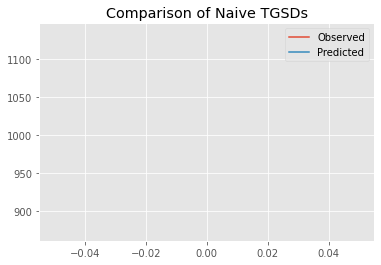

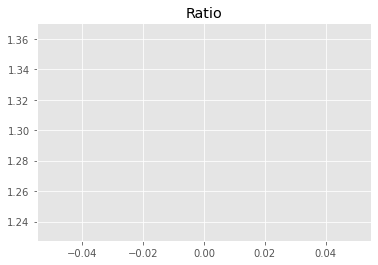

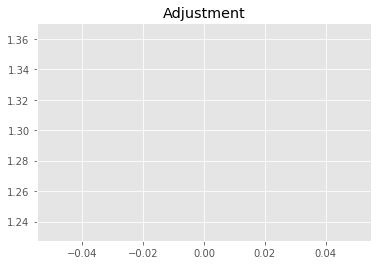

8878626221.032063
1


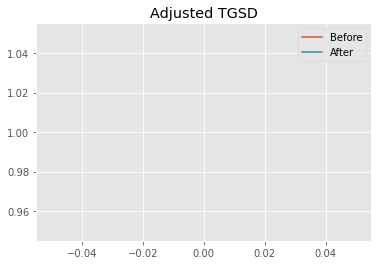

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.26319 	1.93801 	13126.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.57721 	1.95344 	12368.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.7351
New Misfit: 15.0918
Convergence:
0.04088278478789463

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.37e+02 	1.13e+03 	1.2109 		1.0000


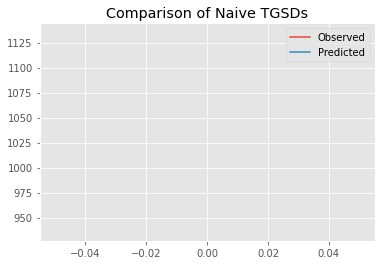

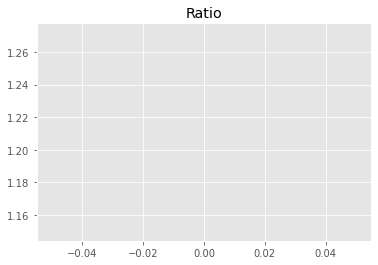

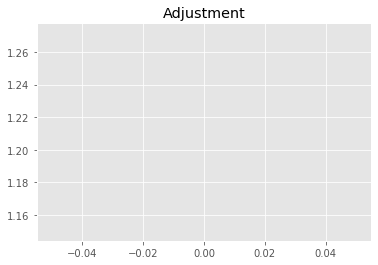

8277647247.688761
1


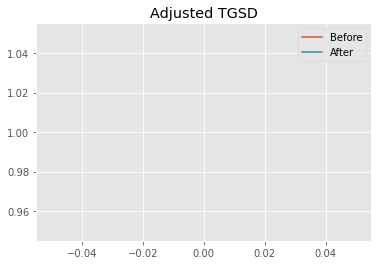

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.57721 	1.95344 	12368.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|15.0947 	2.07401 	9428.07 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.0918
New Misfit: 13.6929
Convergence:
0.09269539375655579

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.88e+02 	1.13e+03 	1.1475 		1.0000


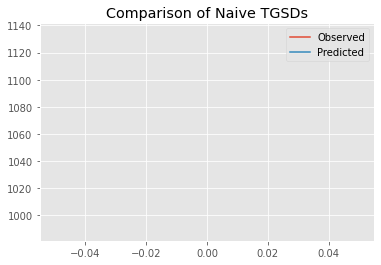

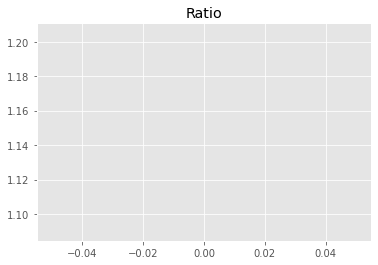

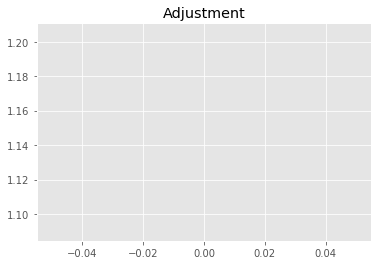

7844716346.675822
1


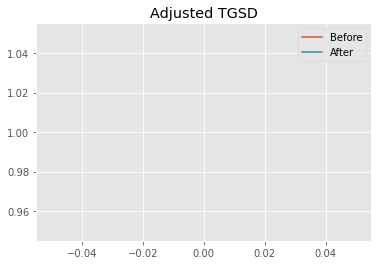

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|15.0947 	2.07401 	9428.07 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|13.6896 	2.07674 	9362.88 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6929
New Misfit: 13.6727
Convergence:
0.0014707968739467788

____________________
a = 13.68956	b = 2.07674	            h1 = 9362.87737	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 13.67274852741655
Prior Misfit: 0.288562,	 Post Misfit: 13.6727


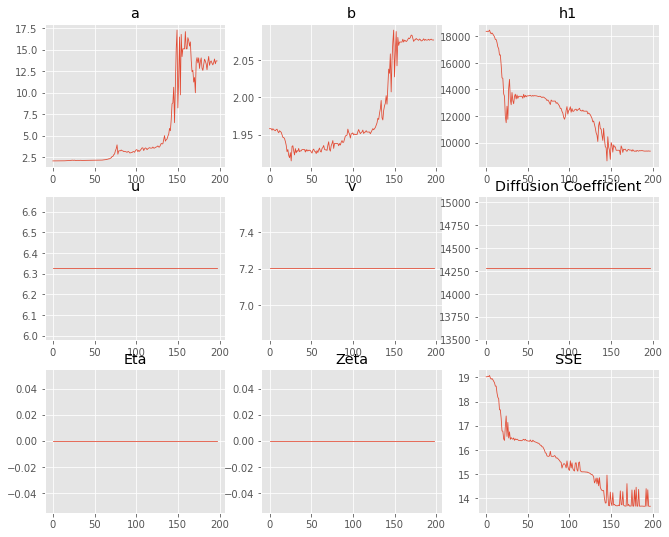

,Priors,Posteriors
a,2.09309,13.6896
b,1.95794,2.07674
h1,"18,376.5","9,362.88"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.101 minutes


Estimated remaining run time: 0.202 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.16e+03 	1.13e+03 	0.9756 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


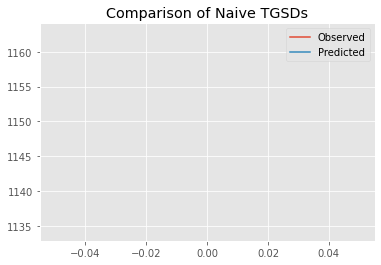

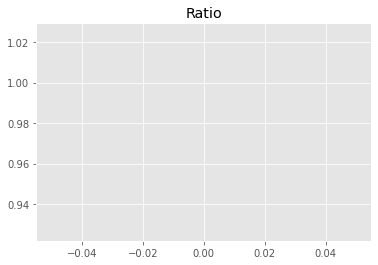

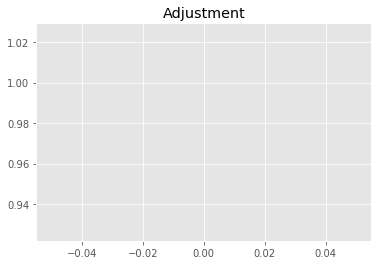

6669076550.486915
1


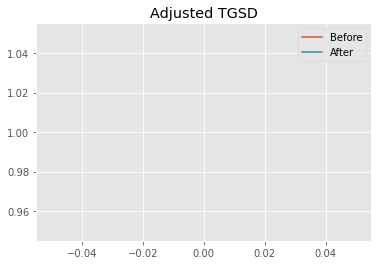

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.12181 	4.74446 	15493.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|2.18801 	2.39876 	15337.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 20.3019
New Misfit: 16.6957
Convergence:
0.17763177384649287

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.18e+02 	1.13e+03 	1.2352 		1.0000


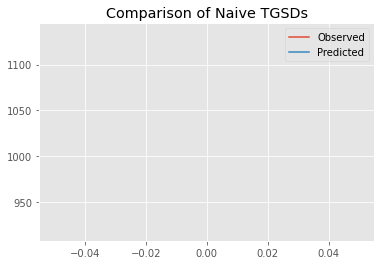

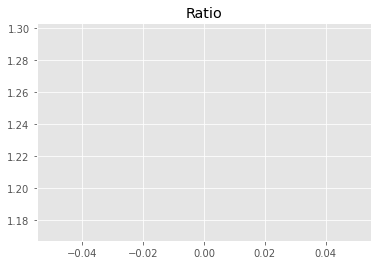

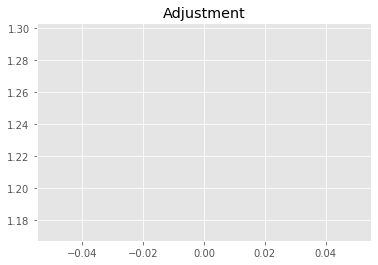

8444153970.85486
1


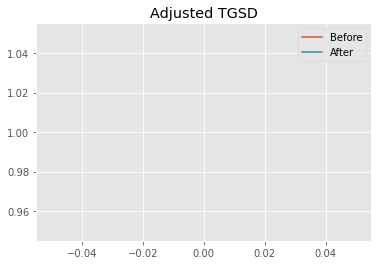

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.18801 	2.39876 	15337.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|3.09294 	1.33247 	10614.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 16.6957
New Misfit: 15.0143
Convergence:
0.10070445618444406

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.03e+03 	1.13e+03 	1.0979 		1.0000


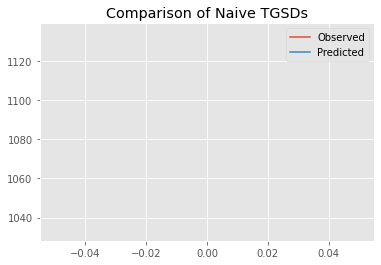

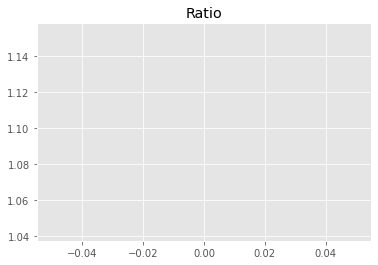

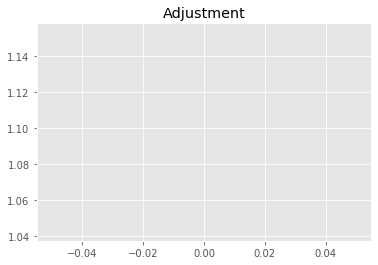

7505070577.0744095
1


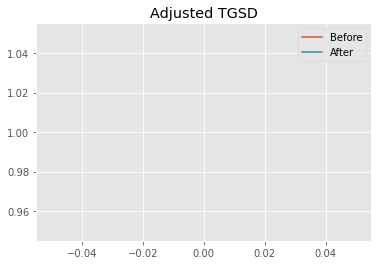

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.09294 	1.33247 	10614.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.85011 	1.23097 	9940.67 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.0143
New Misfit: 14.2262
Convergence:
0.052495923531347

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.07e+03 	1.13e+03 	1.0559 		1.0000


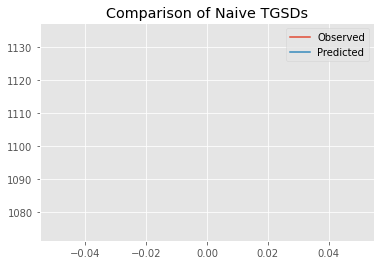

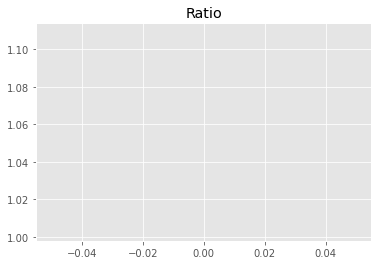

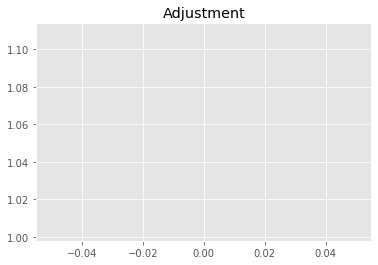

7218164965.867132
1


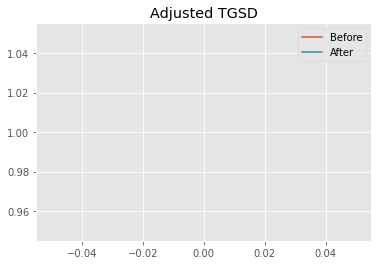

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.85011 	1.23097 	9940.67 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|9.64004 	1.28741 	9450.62 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 14.2262
New Misfit: 13.7089
Convergence:
0.03636103511091276

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.96e+02 	1.13e+03 	1.1382 		1.0000


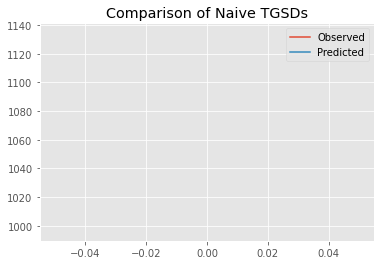

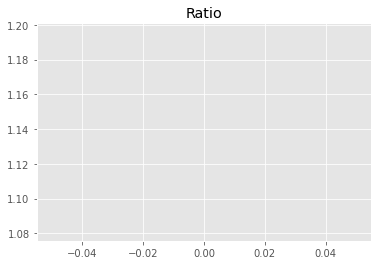

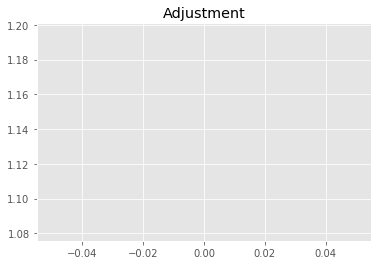

7781239226.386412
1


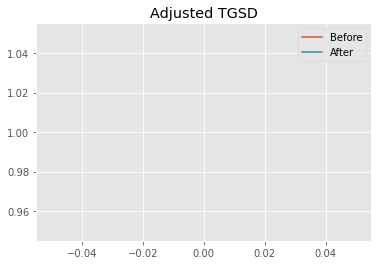

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.64004 	1.28741 	9450.62 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|10.7856 	1.46448 	9362.27 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.7089
New Misfit: 13.6961
Convergence:
0.0009301037336017369

____________________
a = 10.78558	b = 1.46448	            h1 = 9362.27222	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 13.6961286101877
Prior Misfit: 0.30799,	 Post Misfit: 13.6961


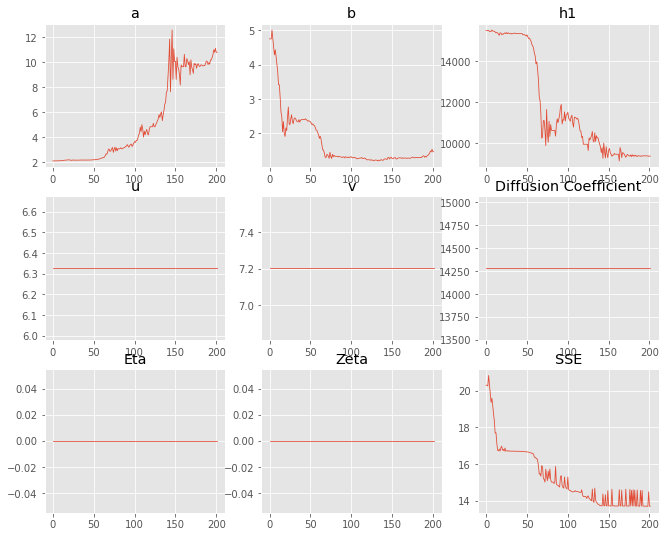

,Priors,Posteriors
a,2.12181,10.7856
b,4.74446,1.46448
h1,"15,493.2","9,362.27"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.101 minutes


Estimated remaining run time: 0.138 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.21e+02 	1.13e+03 	1.2322 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


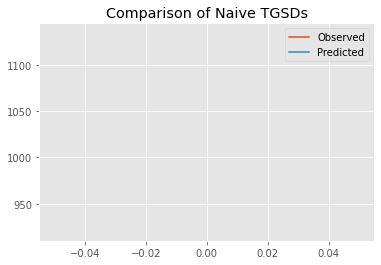

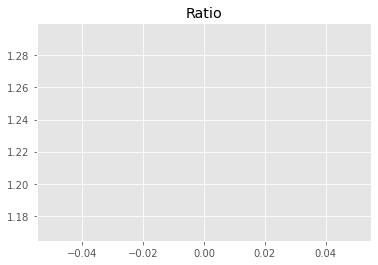

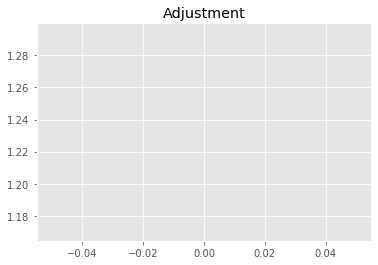

8423259721.350242
1


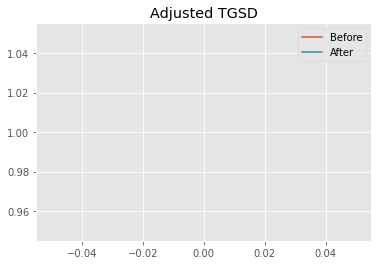

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.77077 	2.89728 	13550.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|9.85996 	2.45985 	9721.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.415
New Misfit: 13.7945
Convergence:
0.10512293919161339

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.05e+03 	1.13e+03 	1.0822 		1.0000


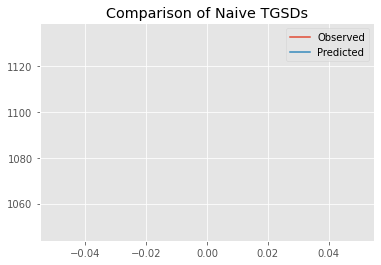

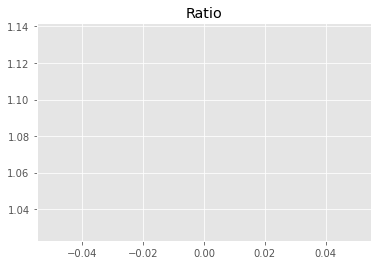

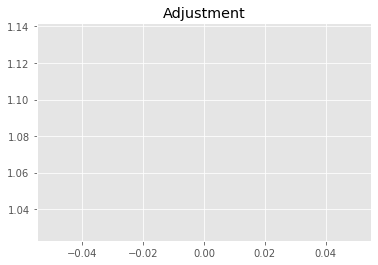

7398016355.929049
1


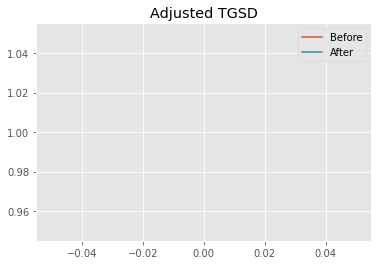

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.85996 	2.45985 	9721.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|15.0092 	2.34897 	9380.04 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.7945
New Misfit: 13.6668
Convergence:
0.009260666806884277

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.01e+03 	1.13e+03 	1.1273 		1.0000


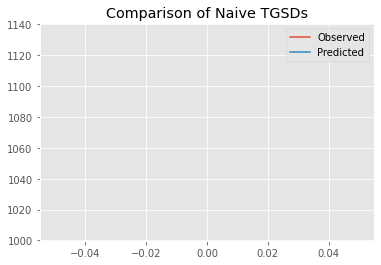

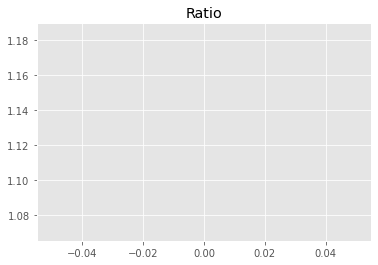

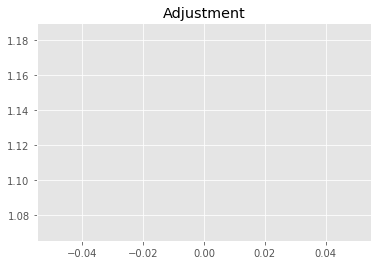

7706533959.6769905
1


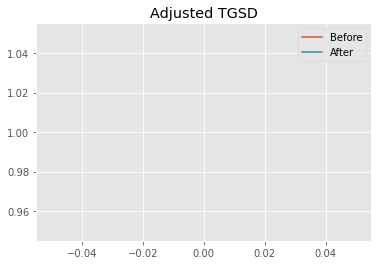

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|15.0092 	2.34897 	9380.04 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|14.8028 	2.40651 	9361.12 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6668
New Misfit: 13.6638
Convergence:
0.0002154621472763154

____________________
a = 14.80282	b = 2.40651	            h1 = 9361.11865	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.663849203844347
Prior Misfit: 0.233853,	 Post Misfit: 13.6638


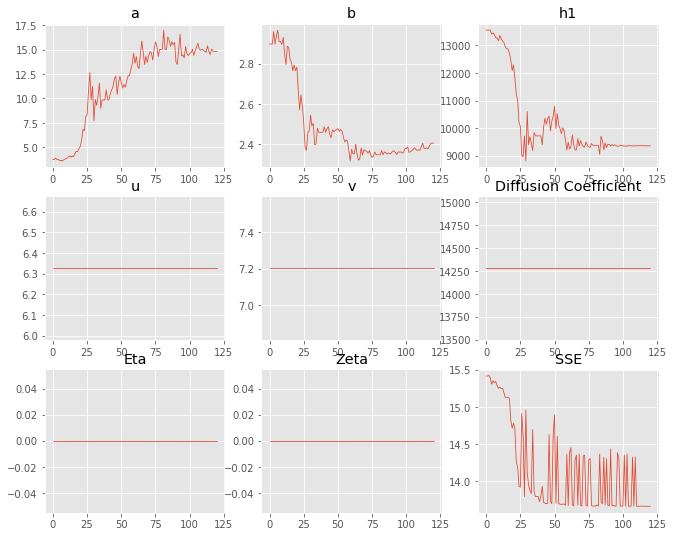

,Priors,Posteriors
a,3.77077,14.8028
b,2.89728,2.40651
h1,"13,550.8","9,361.12"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.067 minutes


Estimated remaining run time: 0.069 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1084 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


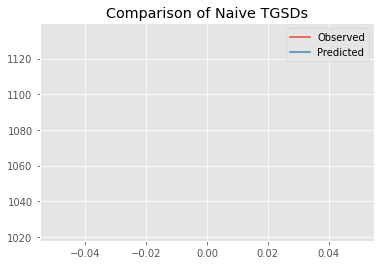

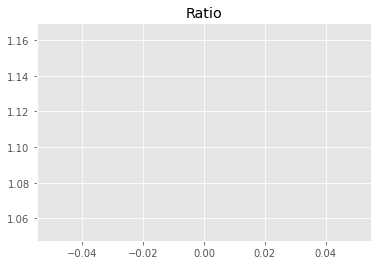

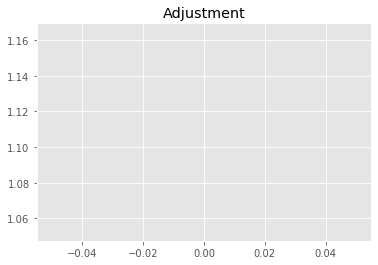

7577193968.353503
1


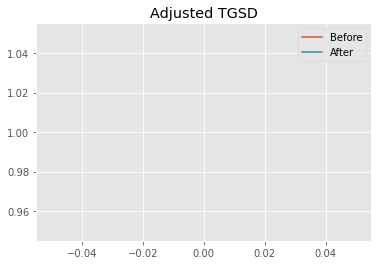

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95157 	4.00049 	18067.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.95293 	3.07214 	18041.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.983
New Misfit: 17.3314
Convergence:
0.036233145139575665

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.16e+02 	1.13e+03 	1.2389 		1.0000


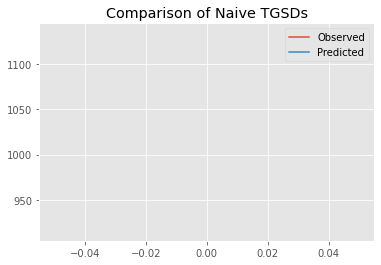

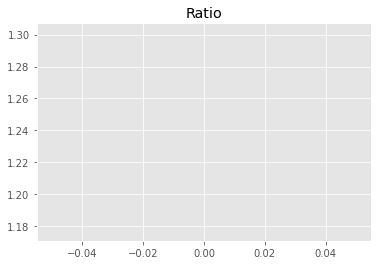

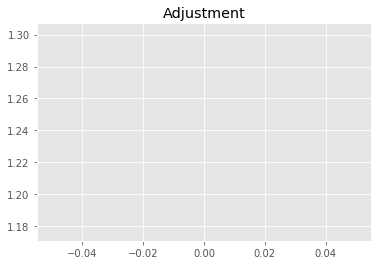

8469360285.610299
1


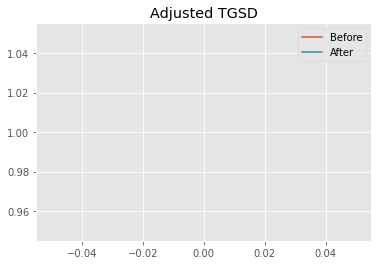

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95293 	3.07214 	18041.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.92491 	1.81643 	13411.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 17.3314
New Misfit: 16.7313
Convergence:
0.03462576947208813

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.96e+02 	1.13e+03 	1.1392 		1.0000


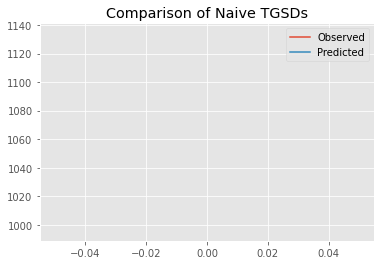

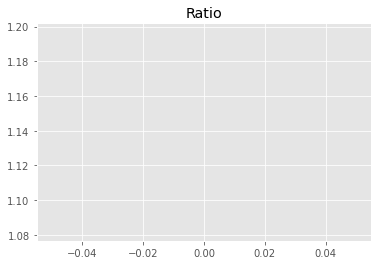

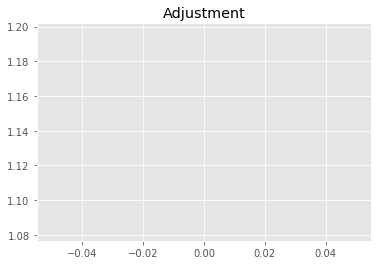

7787881508.909445
1


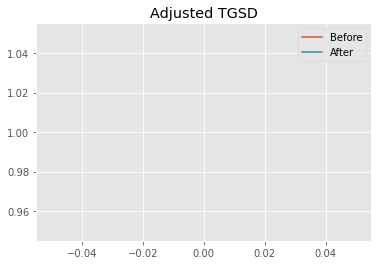

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.92491 	1.81643 	13411.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|1.92604 	1.74693 	13453 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 16.7313
New Misfit: 16.6332
Convergence:
0.005863413088737269

____________________
a = 1.92604	b = 1.74693	            h1 = 13452.95673	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 16.633229442744078
Prior Misfit: 0.272811,	 Post Misfit: 16.6332


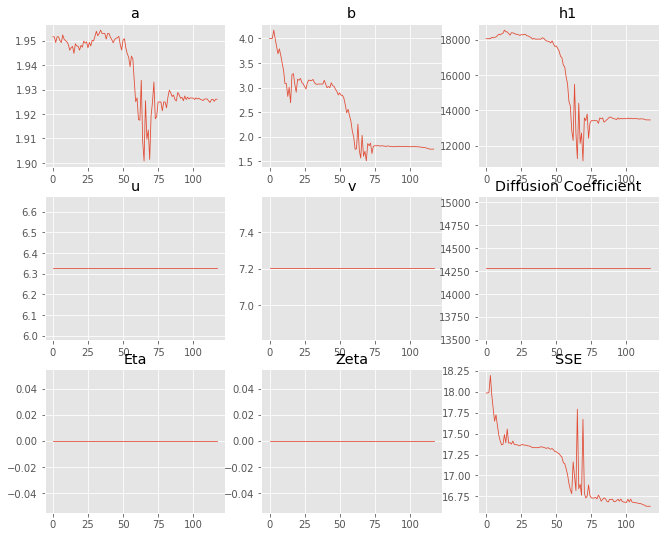

,Priors,Posteriors
a,1.95157,1.92604
b,4.00049,1.74693
h1,"18,067.3","13,453"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.066 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	6.15e+02 	1.13e+03 	1.8438 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


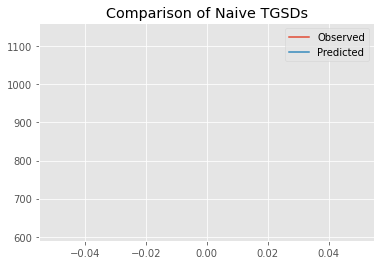

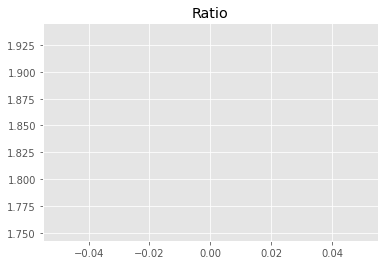

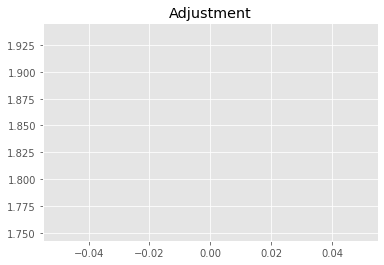

12604721220.00039
1


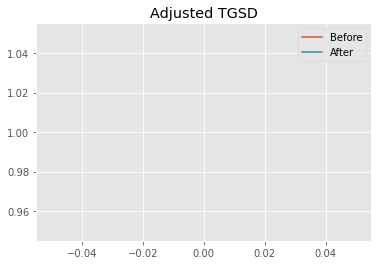

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.29164 	4.90729 	24722.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|4.20207 	5.82196 	15922.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 19.9158
New Misfit: 15.5431
Convergence:
0.2195592323289564

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.01e+03 	1.13e+03 	1.1271 		1.0000


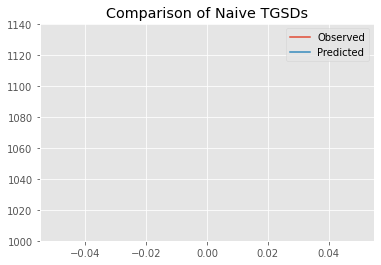

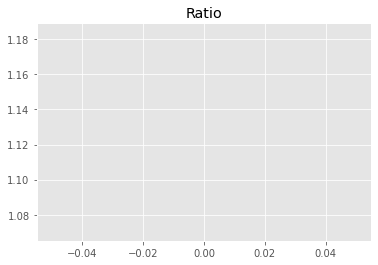

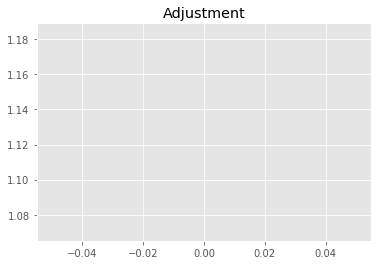

7705127953.033774
1


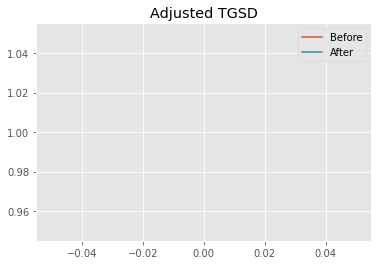

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.20207 	5.82196 	15922.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|49.8883 	80.7112 	17147.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 15.5431
New Misfit: 13.6961
Convergence:
0.11882896076280351

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.02e+03 	1.13e+03 	1.1131 		1.0000


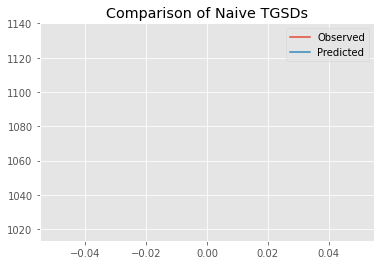

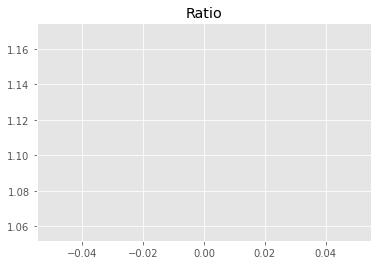

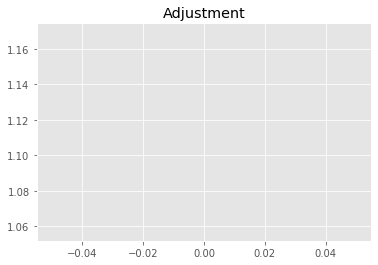

7609424534.133192
1


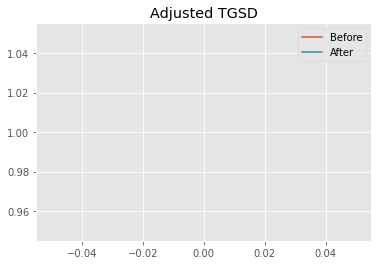

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|49.8883 	80.7112 	17147.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 6.83614e+09
After: 		|73.465 	122.97 	17162.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 13.6961
New Misfit: 13.6455
Convergence:
0.003695968238595092

____________________
a = 73.46497	b = 122.96973	            h1 = 17162.26126	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 13.645478067825962
Prior Misfit: 0.302131,	 Post Misfit: 13.6455


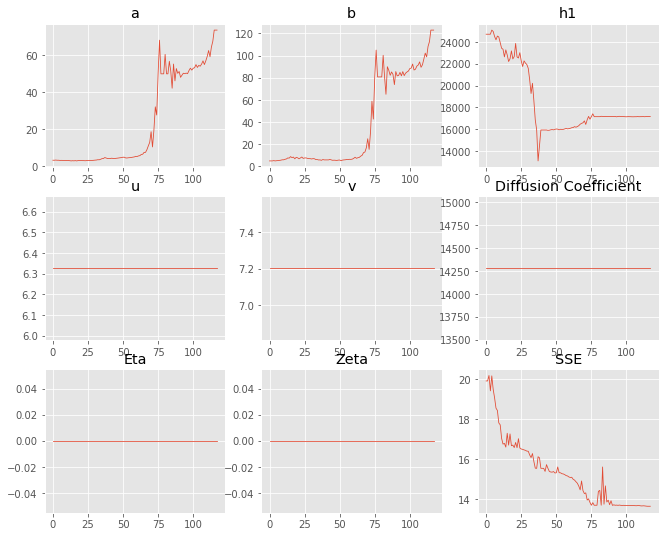

,Priors,Posteriors
a,3.29164,73.465
b,4.90729,122.97
h1,"24,722.4","17,162.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.066 minutes


Estimated remaining run time: -0.069 minutes


Total Run Time: 1.44432 minutes


[{'a': 13.60859479978271,
  'b': 2.1705796249288047,
  'h1': 9374.51293009688,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 13.660447206079173,
  'b': 2.179462000195175,
  'h1': 9389.863562488707,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 93.93638698382317,
  'b': 392.5239840090406,
  'h1': 30639.30836013769,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 240.06653172670175,
  'b': 356.7286177599436,
  'h1': 16199.409269480584,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 15.514061696742285,
  'b': 2.5950057071245736,
  'h1': 9360.850535494039,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 86.95747

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
14,298.016,361.452,"14,740.6",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206493
3,240.067,356.729,"16,199.4",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206494
8,197.375,268.84,"15,557.7",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206497
12,238.156,556.191,"20,701.1",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206498
5,86.9575,83.3545,"13,464.2",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.20662
2,93.9364,392.524,"30,639.3",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207001
19,73.465,122.97,"17,162.3",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207008
7,19.2835,3.38574,"9,416.96",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207052
6,17.564,2.93055,"9,377.79",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207126
4,15.5141,2.59501,"9,360.85",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207227


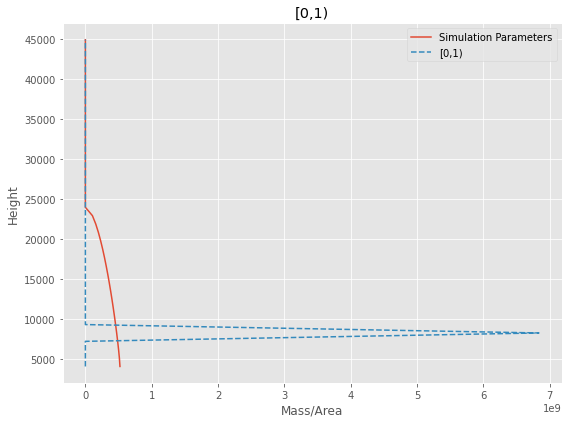

[0,1) Run Time: 1.44698 minutes


Mass Test: 52635102777.88889
========[1,2)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.17e+02 	2.64e+02 	2.2519 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


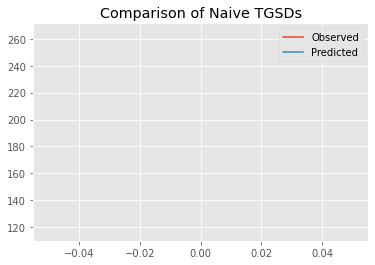

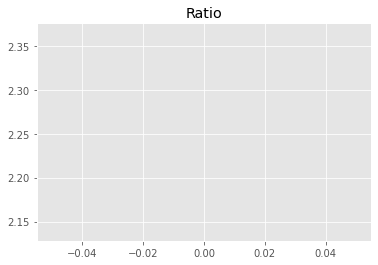

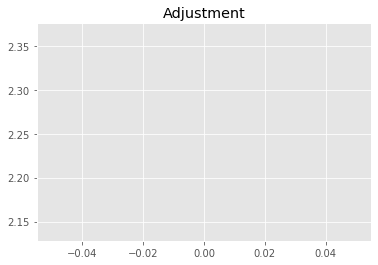

3584250471.0686517
1


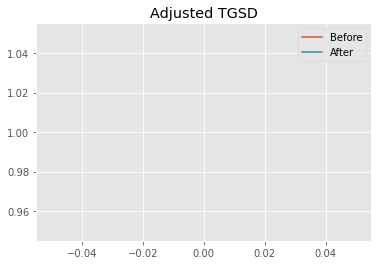

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.31444 	2.83538 	12335.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.56384 	3.18804 	10001.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.14315
New Misfit: 4.07772
Convergence:
0.20715520434320223

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.10e+02 	2.64e+02 	1.2556 		1.0000


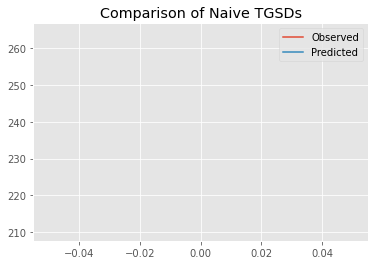

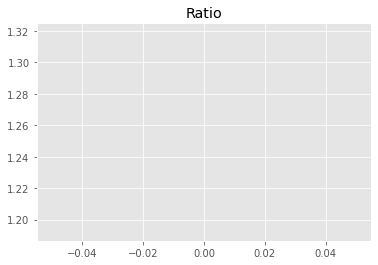

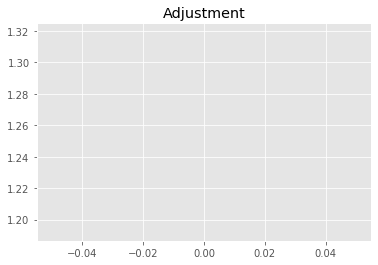

1998500067.800224
1


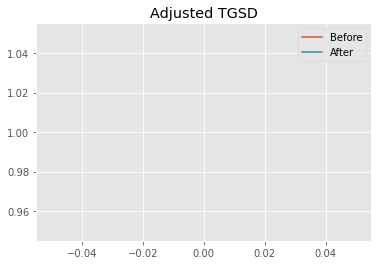

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.56384 	3.18804 	10001.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.75689 	1.82979 	7742.28 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.07772
New Misfit: 3.88567
Convergence:
0.047096093198964094

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.22e+02 	2.64e+02 	1.1878 		1.0000


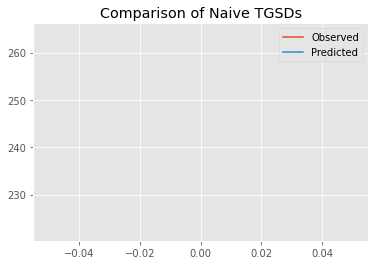

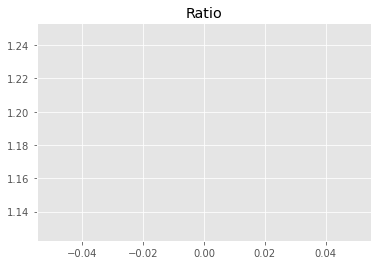

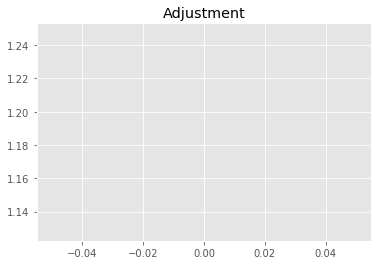

1890548327.5585175
1


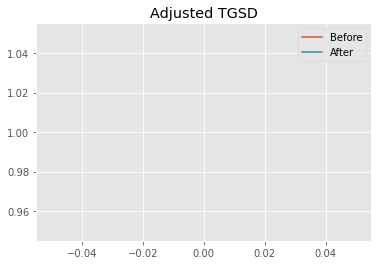

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.75689 	1.82979 	7742.28 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.53936 	1.77383 	7275.68 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.88567
New Misfit: 3.84385
Convergence:
0.01076444250200267

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.09e+02 	2.64e+02 	1.2615 		1.0000


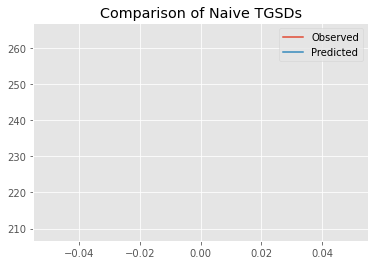

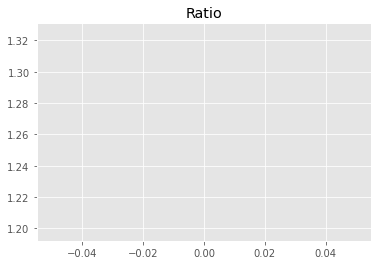

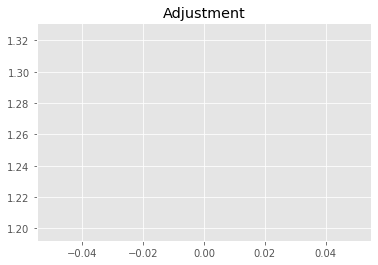

2007863995.8343952
1


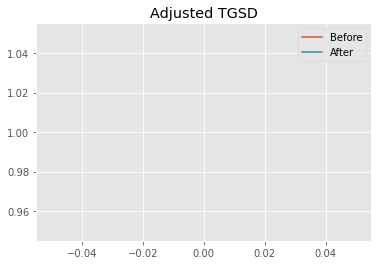

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.53936 	1.77383 	7275.68 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.50369 	1.78662 	7272.65 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.84385
New Misfit: 3.84302
Convergence:
0.00021615795234845877

____________________
a = 5.50369	b = 1.78662	            h1 = 7272.64646	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.8430168710404
Prior Misfit: 0.347261,	 Post Misfit: 3.84302


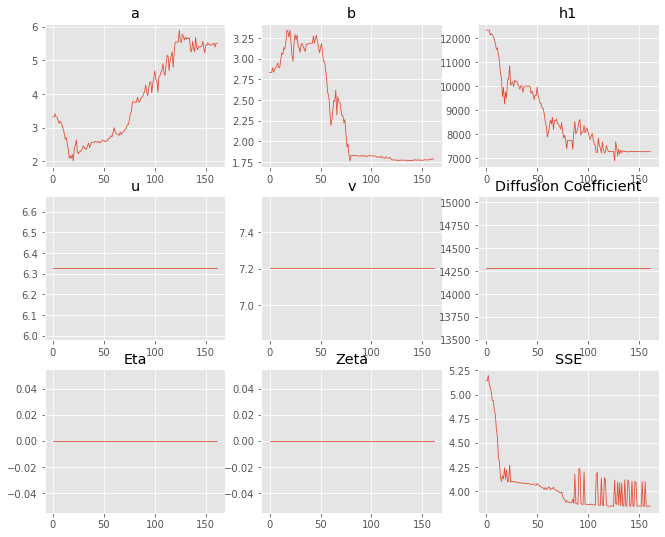

,Priors,Posteriors
a,3.31444,5.50369
b,2.83538,1.78662
h1,"12,335.9","7,272.65"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 1 Time: 0.085 minutes


Estimated remaining run time: 0.766 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.52e+02 	2.64e+02 	1.7424 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


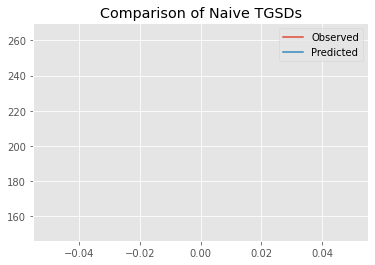

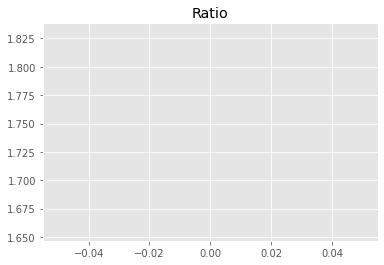

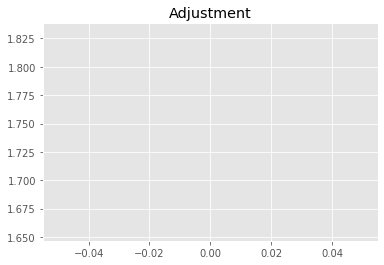

2773341962.081327
1


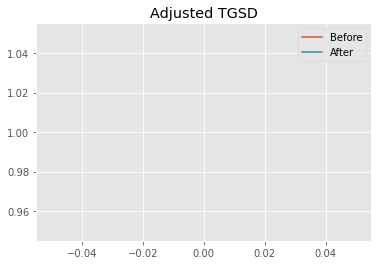

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.62485 	4.38702 	19197.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.62234 	7.54646 	18375.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.73067
New Misfit: 4.24052
Convergence:
0.10361206942559369

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.19e+02 	2.64e+02 	1.2053 		1.0000


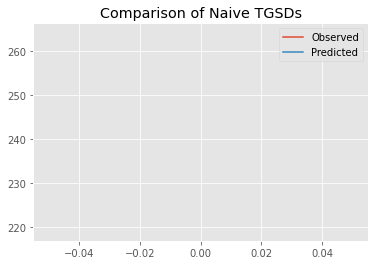

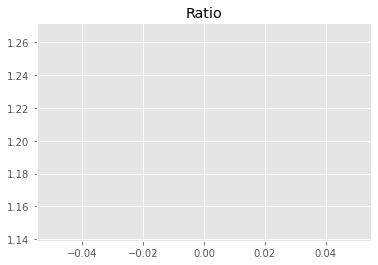

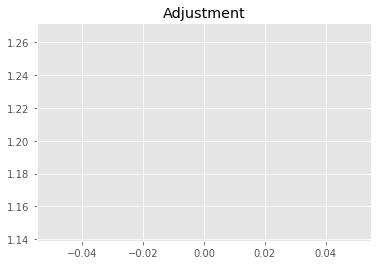

1918367838.7132065
1


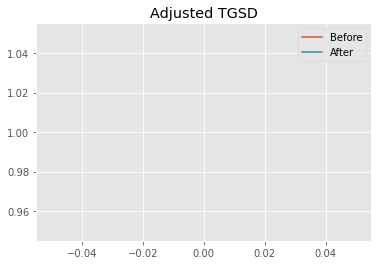

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.62234 	7.54646 	18375.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.20644 	12.8162 	18775.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.24052
New Misfit: 4.13394
Convergence:
0.025132505049843264

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.10e+02 	2.64e+02 	1.2555 		1.0000


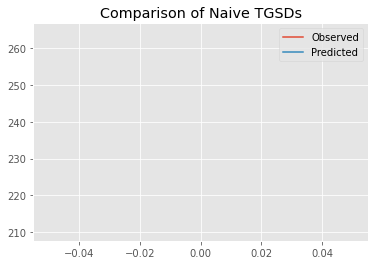

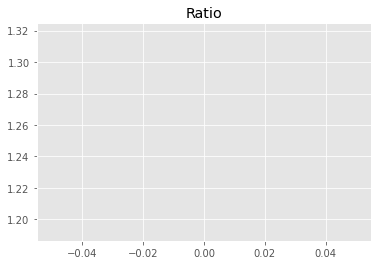

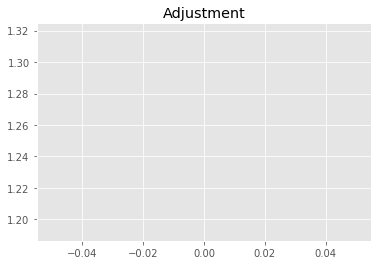

1998305875.016811
1


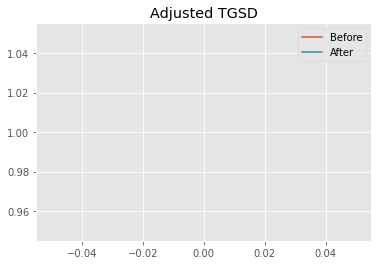

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.20644 	12.8162 	18775.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|12.5444 	18.39 	10644.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.13394
New Misfit: 3.84036
Convergence:
0.0710179184649095

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2087 		1.0000


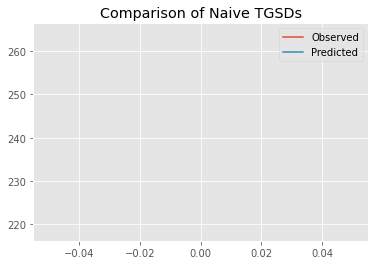

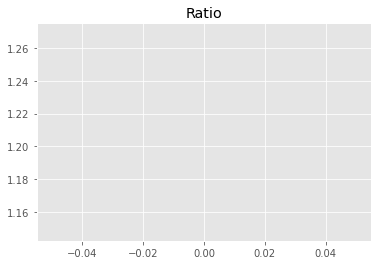

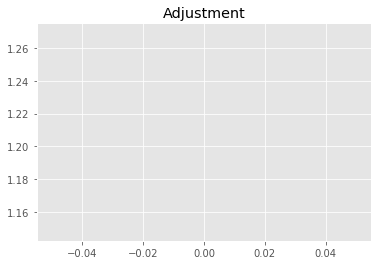

1923784963.1450808
1


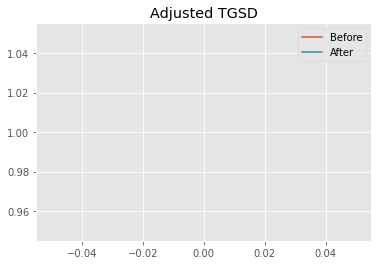

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.5444 	18.39 	10644.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|42.5917 	28.1117 	8123.89 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.84036
New Misfit: 3.766
Convergence:
0.019362962373202723

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.24e+02 	2.64e+02 	1.1794 		1.0000


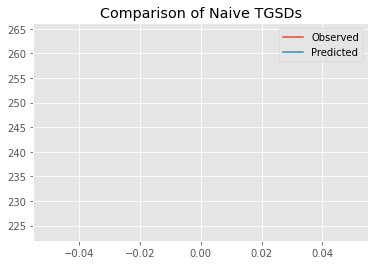

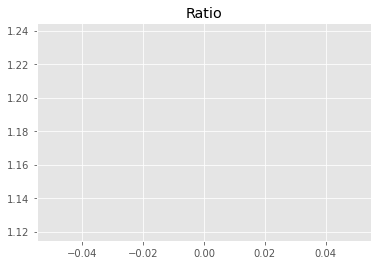

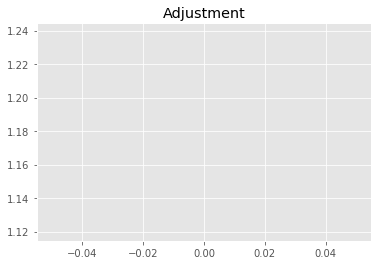

1877175703.4322314
1


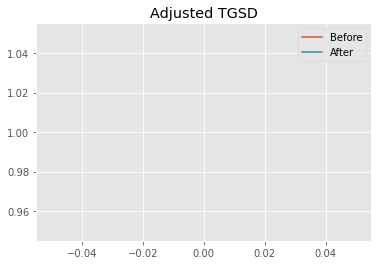

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|42.5917 	28.1117 	8123.89 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|47.8929 	29.5119 	7978.26 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.766
New Misfit: 3.76518
Convergence:
0.00021638931002859456

____________________
a = 47.89291	b = 29.51194	            h1 = 7978.26356	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.7651819934165953
Prior Misfit: 0.319411,	 Post Misfit: 3.76518


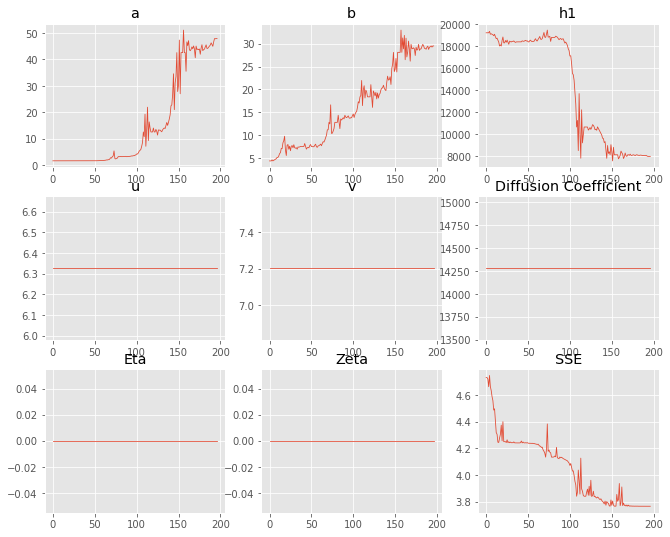

,Priors,Posteriors
a,1.62485,47.8929
b,4.38702,29.5119
h1,"19,197.7","7,978.26"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 2 Time: 0.104 minutes


Estimated remaining run time: 1.072 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.52e+02 	2.64e+02 	1.7429 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


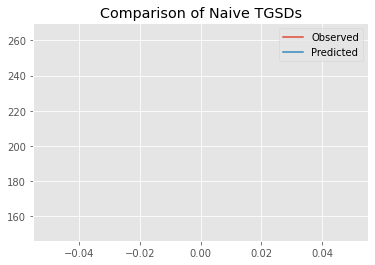

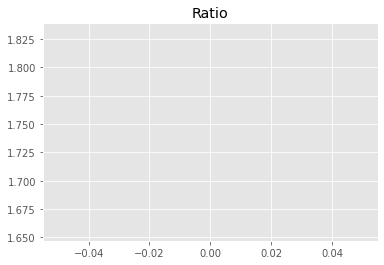

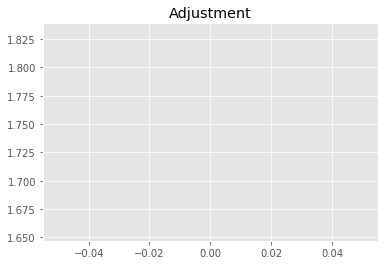

2774129398.586864
1


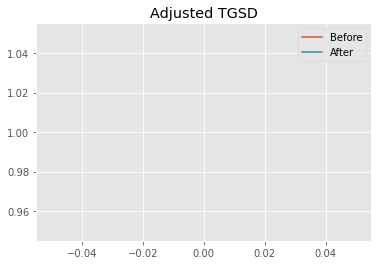

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.31713 	3.37364 	18340.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.4363 	5.90171 	16806.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.75583
New Misfit: 4.24921
Convergence:
0.1065256618331844

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.17e+02 	2.64e+02 	1.2194 		1.0000


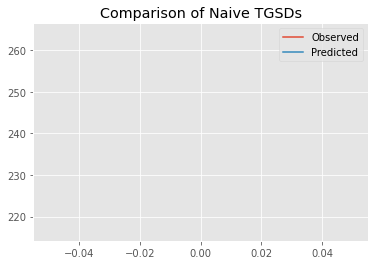

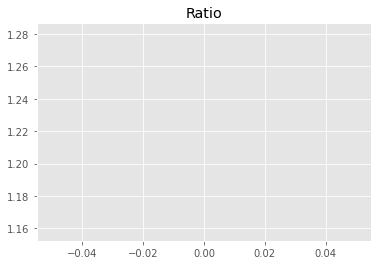

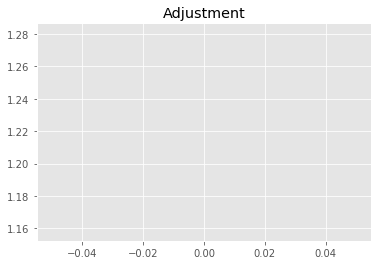

1940876983.955607
1


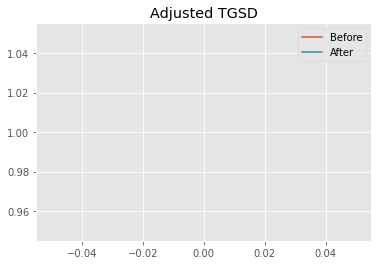

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.4363 	5.90171 	16806.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.60843 	14.0723 	16929.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.24921
New Misfit: 4.10445
Convergence:
0.034067811719662805

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.96e+02 	2.64e+02 	1.3449 		1.0000


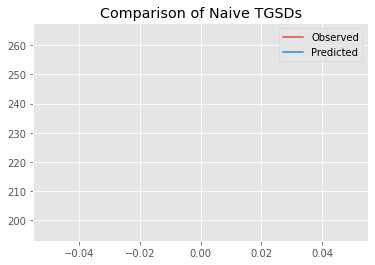

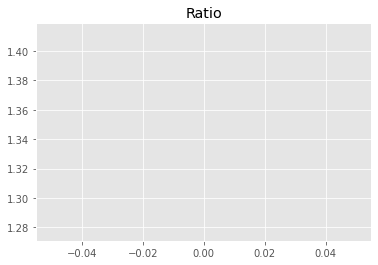

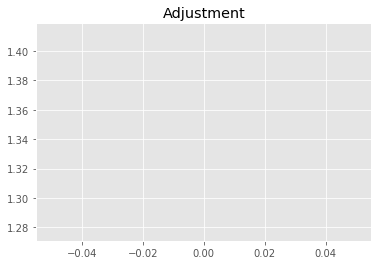

2140573967.6565225
1


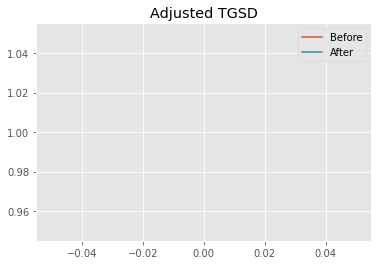

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.60843 	14.0723 	16929.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|11.1099 	36.7811 	16577.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.10445
New Misfit: 3.89208
Convergence:
0.051741027177250584

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.14e+02 	2.64e+02 	1.2320 		1.0000


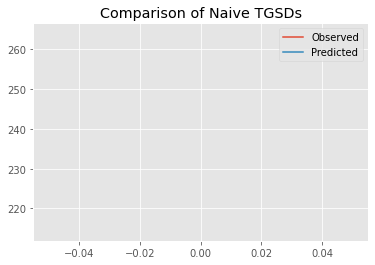

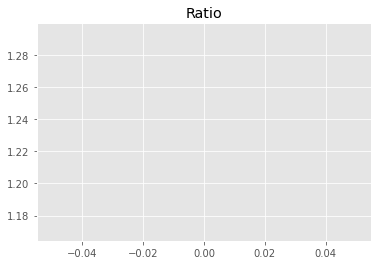

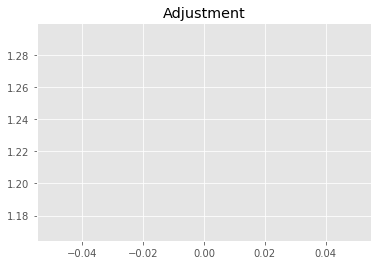

1960928458.1356878
1


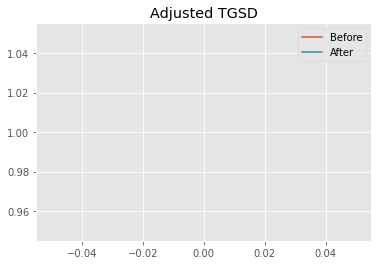

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|11.1099 	36.7811 	16577.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|210.588 	714.201 	16452.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.89208
New Misfit: 3.76648
Convergence:
0.03227197583095588

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.30e+02 	2.64e+02 	1.1486 		1.0000


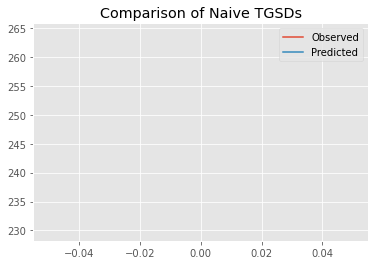

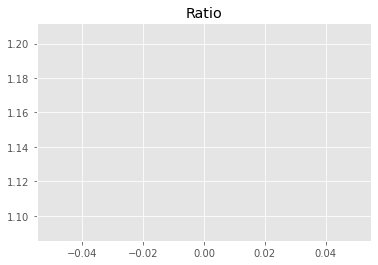

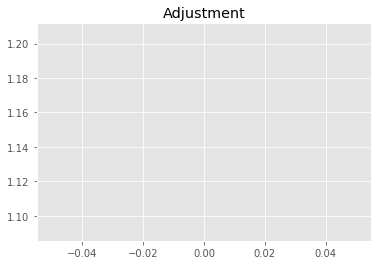

1828117695.778029
1


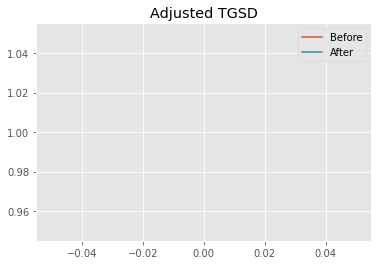

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|210.588 	714.201 	16452.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|210.039 	705.292 	16450.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.76648
New Misfit: 3.7649
Convergence:
0.0004186474188258448

____________________
a = 210.03872	b = 705.29161	            h1 = 16450.32814	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.7648994219545626
Prior Misfit: 0.32111,	 Post Misfit: 3.7649


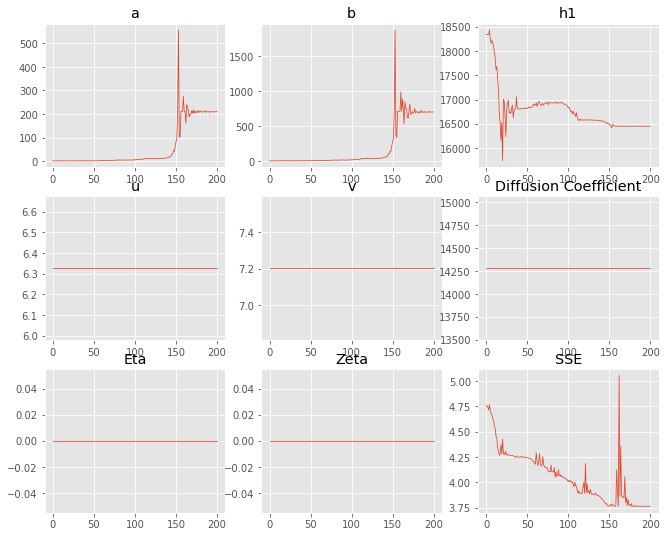

,Priors,Posteriors
a,1.31713,210.039
b,3.37364,705.292
h1,"18,340.4","16,450.3"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 3 Time: 0.101 minutes


Estimated remaining run time: 1.161 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.03e+02 	2.64e+02 	2.5569 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


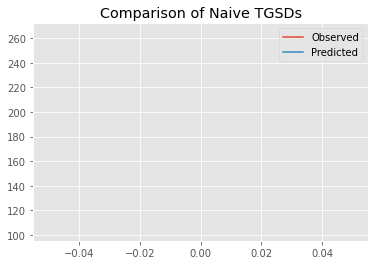

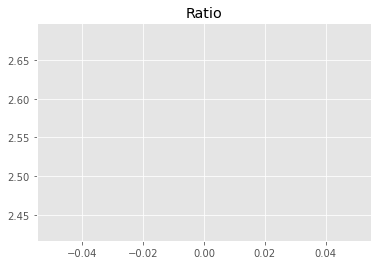

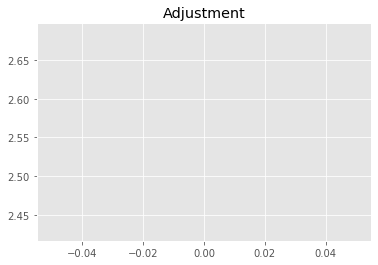

4069728216.440715
1


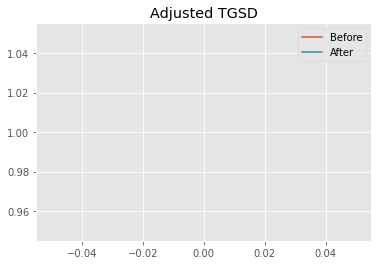

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95158 	3.05764 	18297.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.91808 	6.21806 	15244.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.51895
New Misfit: 4.19835
Convergence:
0.23928385990188453

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2245 		1.0000


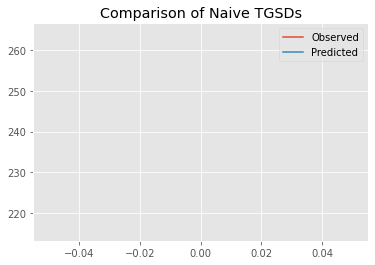

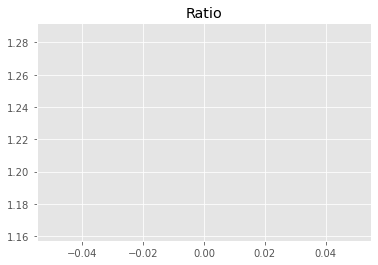

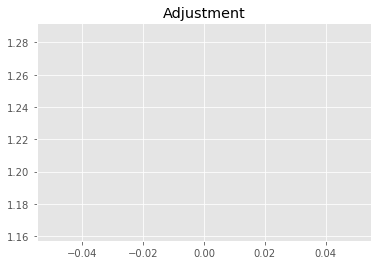

1948910311.581748
1


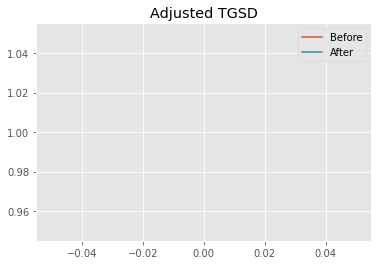

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91808 	6.21806 	15244.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.43307 	4.05247 	10269.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.19835
New Misfit: 4.12816
Convergence:
0.016718236393383212

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.32e+02 	2.64e+02 	1.1377 		1.0000


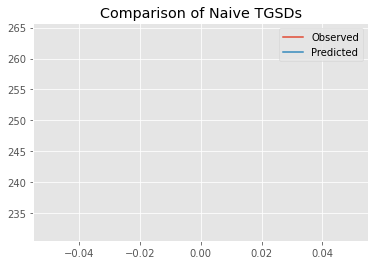

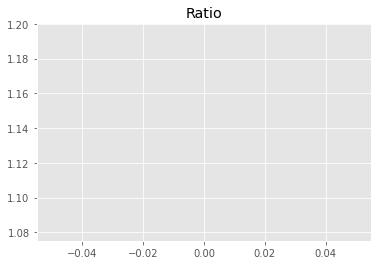

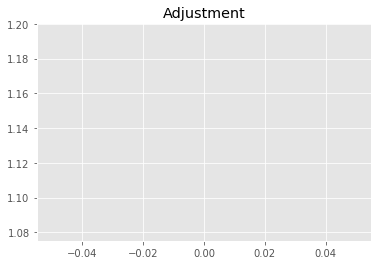

1810782695.3511024
1


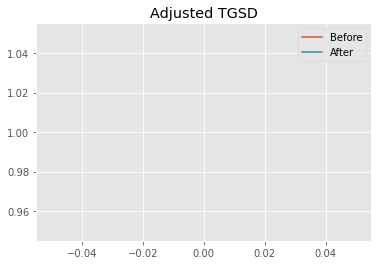

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.43307 	4.05247 	10269.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.27342 	1.9246 	7666.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.12816
New Misfit: 3.95408
Convergence:
0.04216823151178802

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.34e+02 	2.64e+02 	1.1284 		1.0000


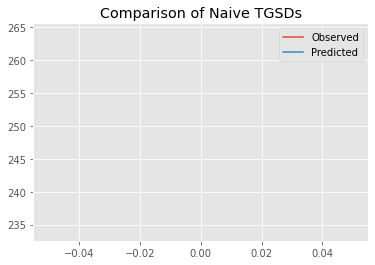

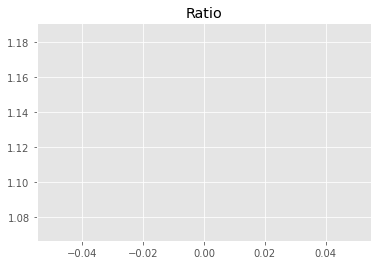

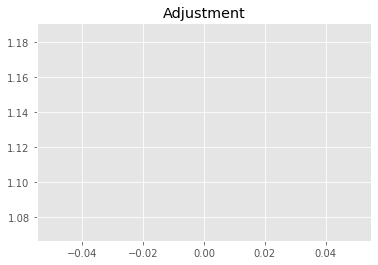

1796035404.6572812
1


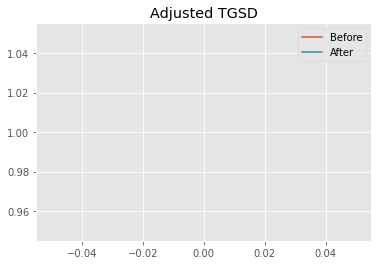

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.27342 	1.9246 	7666.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.91129 	1.93965 	7871.27 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.95408
New Misfit: 3.85738
Convergence:
0.024455689330667246

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.08e+02 	2.64e+02 	1.2716 		1.0000


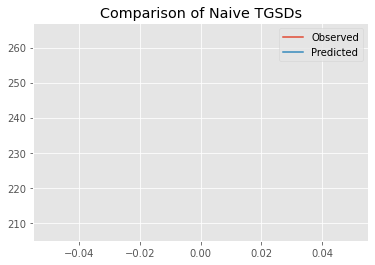

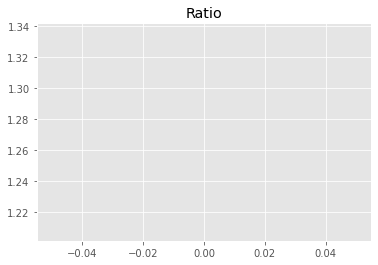

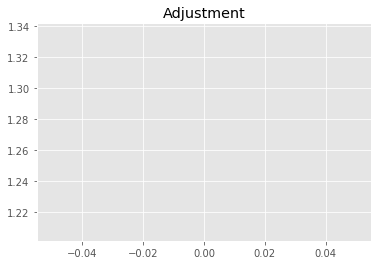

2023999034.2352154
1


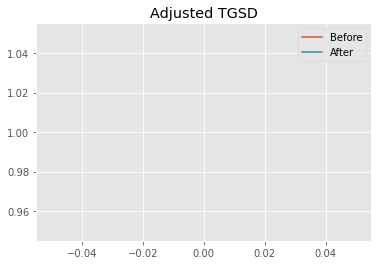

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.91129 	1.93965 	7871.27 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.85989 	1.94903 	7270.74 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.85738
New Misfit: 3.83792
Convergence:
0.005045693445241696

____________________
a = 5.85989	b = 1.94903	            h1 = 7270.74059	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.837921369300447
Prior Misfit: 0.372635,	 Post Misfit: 3.83792


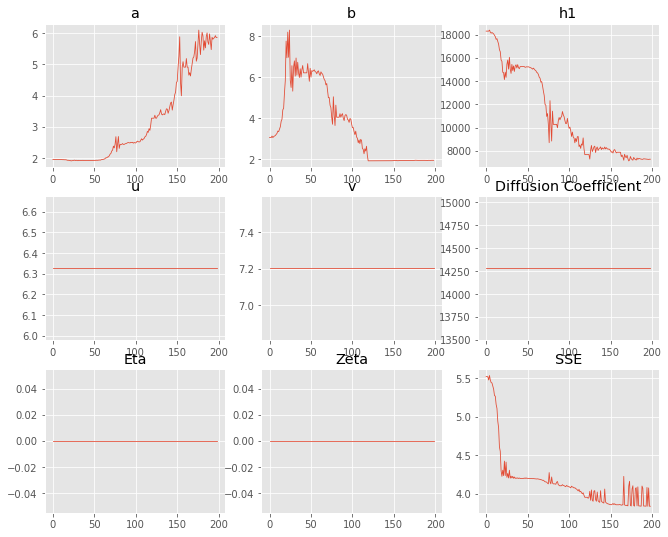

,Priors,Posteriors
a,1.95158,5.85989
b,3.05764,1.94903
h1,"18,297.5","7,270.74"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 4 Time: 0.106 minutes


Estimated remaining run time: 1.188 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.71e+02 	2.64e+02 	1.5400 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


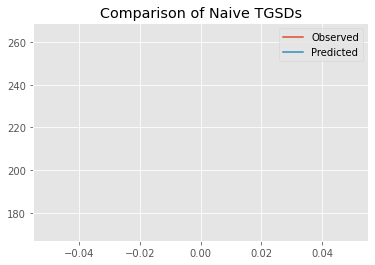

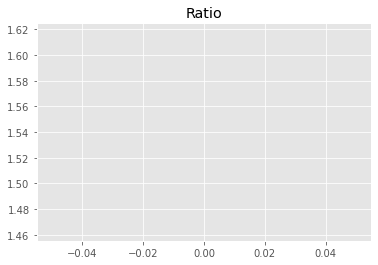

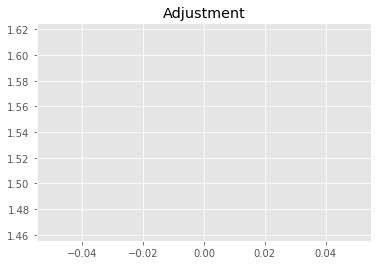

2451164376.1866326
1


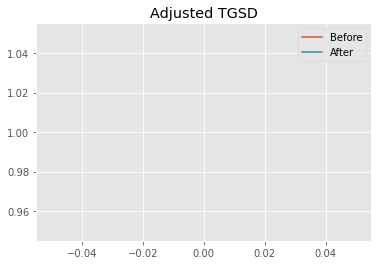

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.90635 	4.20044 	10944.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.63796 	2.95844 	7826.38 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.2796
New Misfit: 3.92586
Convergence:
0.08265555933310677

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.34e+02 	2.64e+02 	1.1293 		1.0000


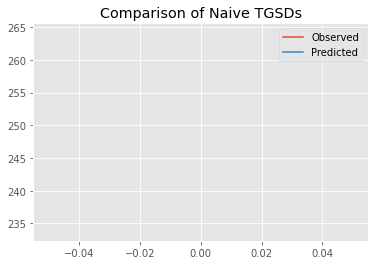

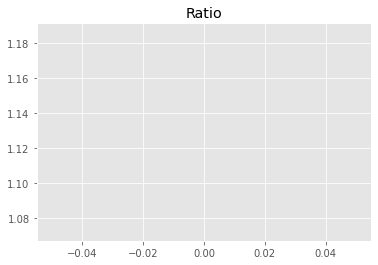

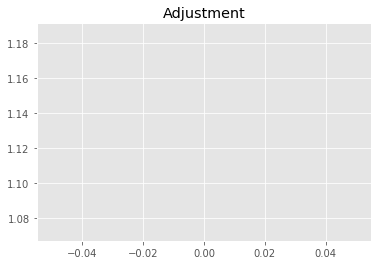

1797516145.1051888
1


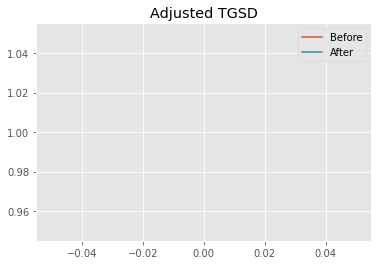

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.63796 	2.95844 	7826.38 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.08506 	2.46997 	7627.23 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.92586
New Misfit: 3.84182
Convergence:
0.021407947274029848

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.10e+02 	2.64e+02 	1.2559 		1.0000


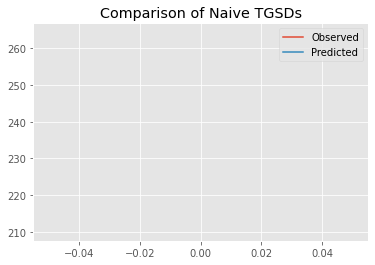

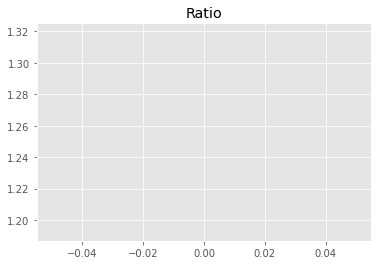

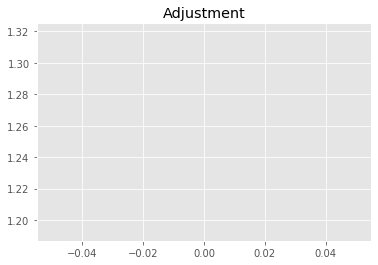

1998984241.1492364
1


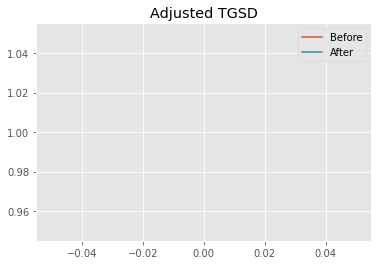

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.08506 	2.46997 	7627.23 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|7.28442 	2.47676 	7270.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.84182
New Misfit: 3.82435
Convergence:
0.004546902393824484

____________________
a = 7.28442	b = 2.47676	            h1 = 7270.59880	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 3.824351123070944
Prior Misfit: 0.288955,	 Post Misfit: 3.82435


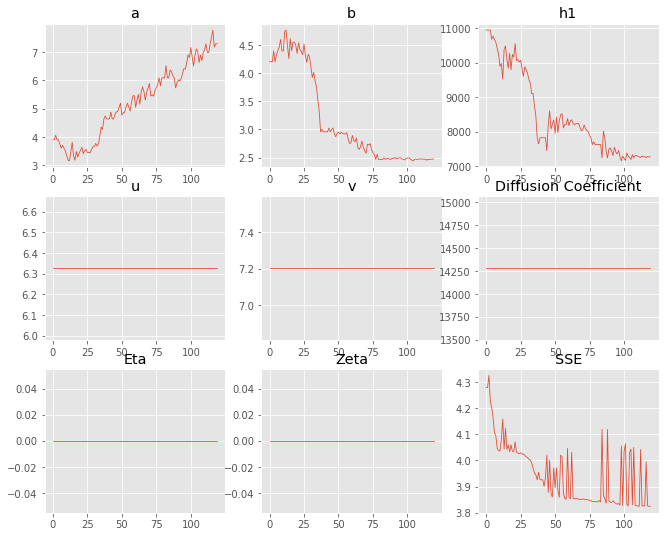

,Priors,Posteriors
a,3.90635,7.28442
b,4.20044,2.47676
h1,"10,944.5","7,270.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 5 Time: 0.066 minutes


Estimated remaining run time: 1.078 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.72e+02 	2.64e+02 	1.5383 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


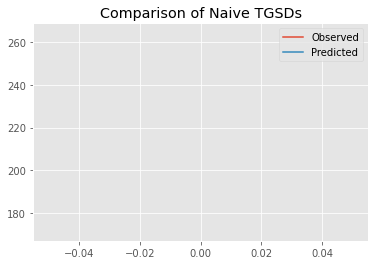

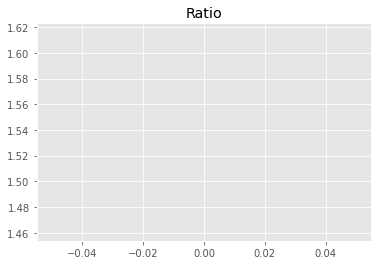

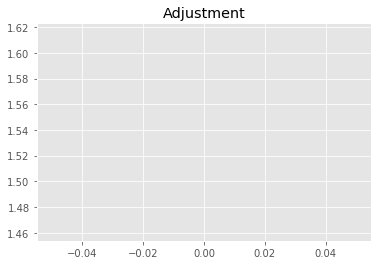

2448497630.965164
1


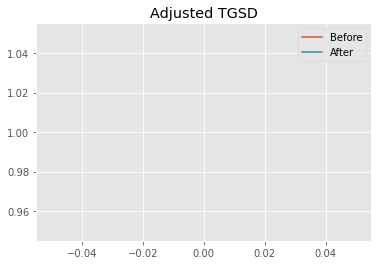

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.62258 	3.85054 	15762.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.79349 	5.8624 	15683.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.47116
New Misfit: 4.21782
Convergence:
0.05666151607789019

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.10e+02 	2.64e+02 	1.2587 		1.0000


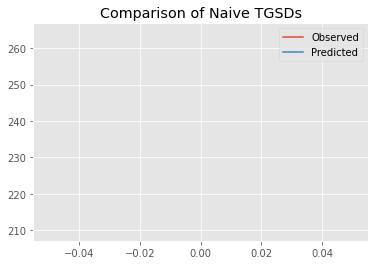

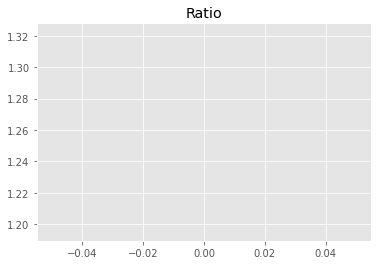

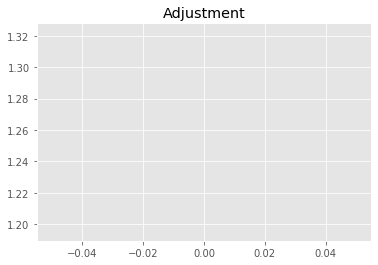

2003363562.2286088
1


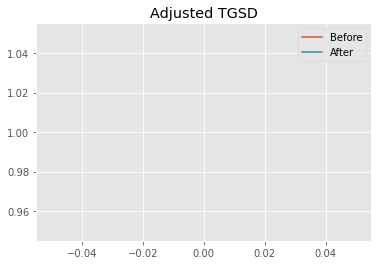

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.79349 	5.8624 	15683.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.02936 	6.43419 	14593 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.21782
New Misfit: 4.18931
Convergence:
0.00675772619708528

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1860 		1.0000


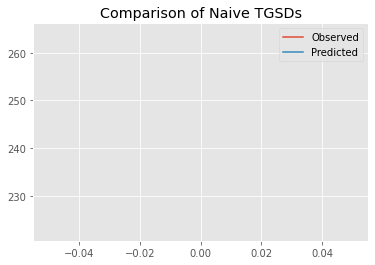

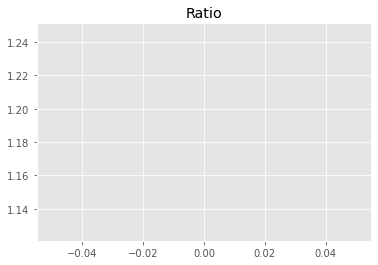

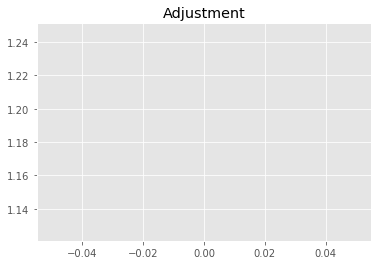

1887759357.2693367
1


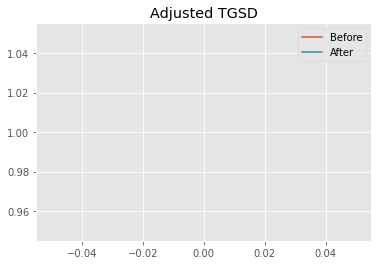

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02936 	6.43419 	14593 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00427 	2.98805 	9756.48 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.18931
New Misfit: 4.1294
Convergence:
0.014301326698577194

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.29e+02 	2.64e+02 	1.1543 		1.0000


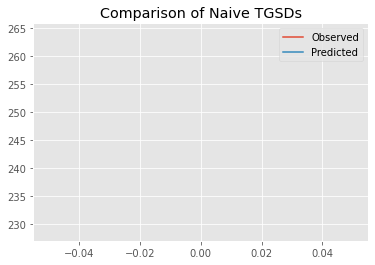

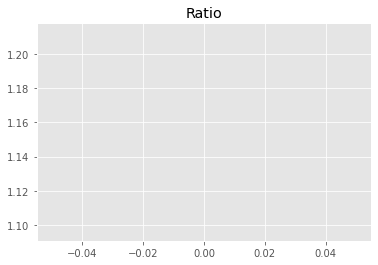

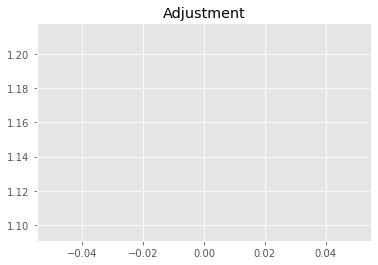

1837184889.3729398
1


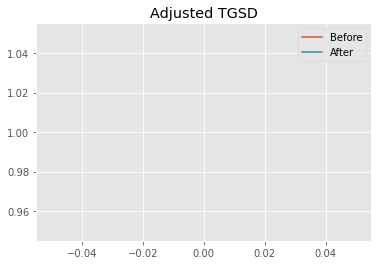

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00427 	2.98805 	9756.48 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00453 	2.44844 	9304.86 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.1294
New Misfit: 4.08685
Convergence:
0.010303127684547124

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.28e+02 	2.64e+02 	1.1576 		1.0000


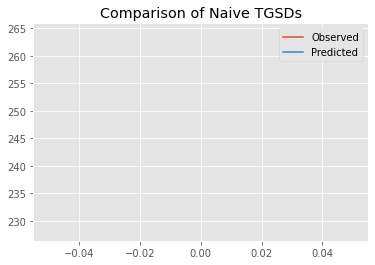

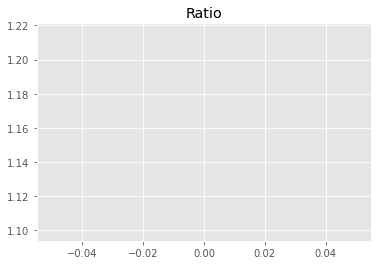

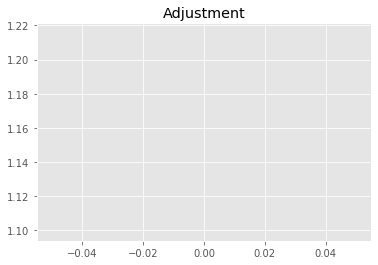

1842422645.4759989
1


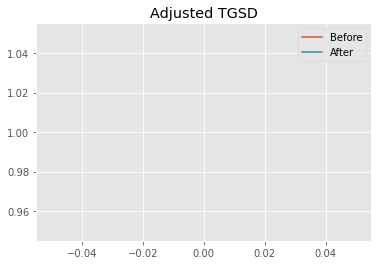

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00453 	2.44844 	9304.86 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00812 	1.78095 	9070.55 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.08685
New Misfit: 4.05025
Convergence:
0.00895608559266166

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.10e+02 	2.64e+02 	1.2558 		1.0000


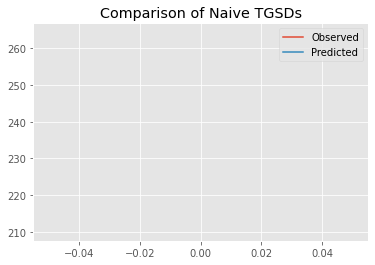

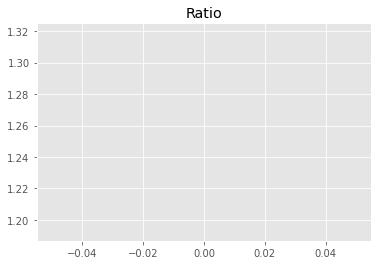

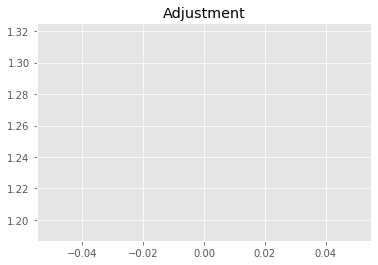

1998823230.0064037
1


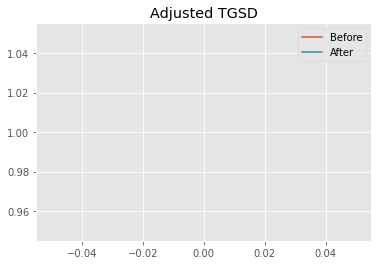

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00812 	1.78095 	9070.55 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.00355 	1.67069 	8362.02 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.05025
New Misfit: 4.04153
Convergence:
0.0021538559491070543

____________________
a = 2.00355	b = 1.67069	            h1 = 8362.01506	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 4.041527847432422
Prior Misfit: 0.301889,	 Post Misfit: 4.04153


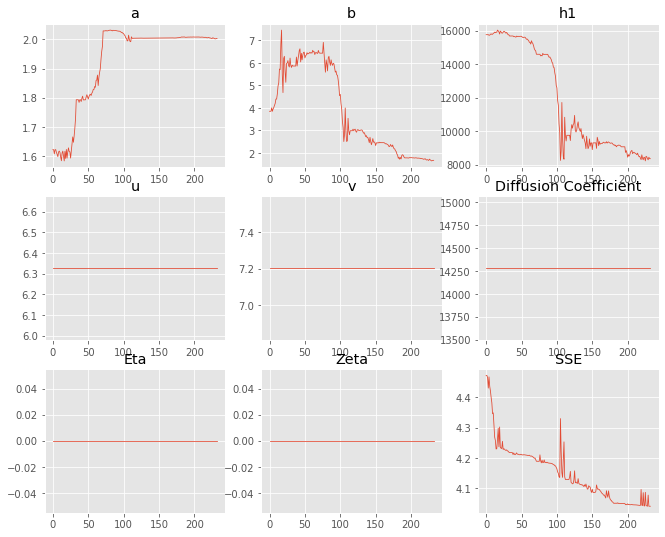

,Priors,Posteriors
a,1.62258,2.00355
b,3.85054,1.67069
h1,"15,762.9","8,362.02"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 6 Time: 0.124 minutes


Estimated remaining run time: 1.089 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.65e+02 	2.64e+02 	1.5988 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


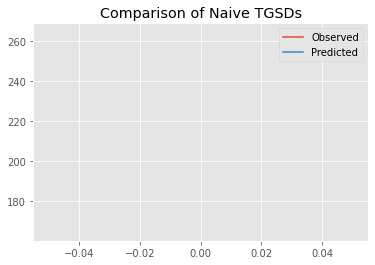

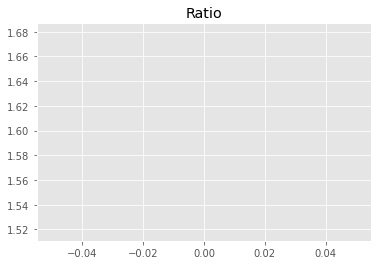

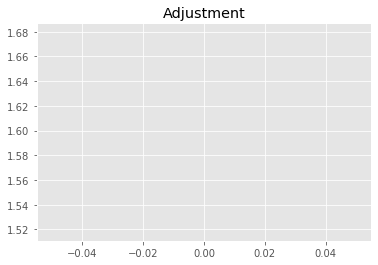

2544706143.8546963
1


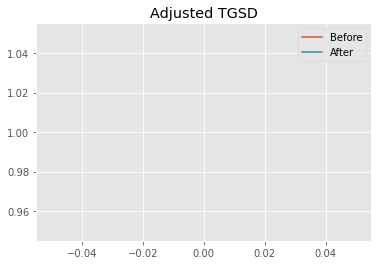

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.43669 	4.37514 	14176.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.72489 	6.46502 	13467.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.4667
New Misfit: 4.12872
Convergence:
0.0756670029277006

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.11e+02 	2.64e+02 	1.2503 		1.0000


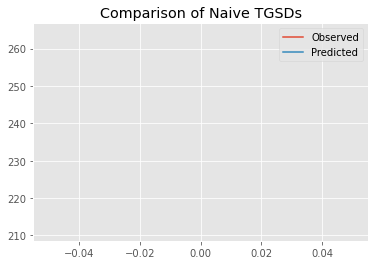

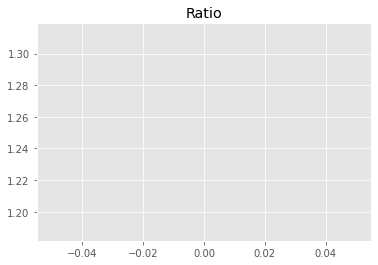

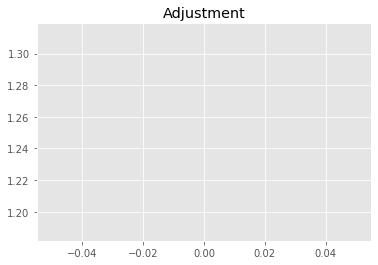

1990110288.9708724
1


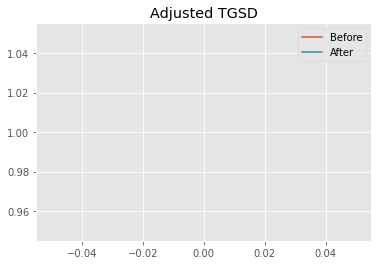

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.72489 	6.46502 	13467.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|12.4601 	30.5366 	13880.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.12872
New Misfit: 3.86606
Convergence:
0.06361632205818155

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.14e+02 	2.64e+02 	1.2337 		1.0000


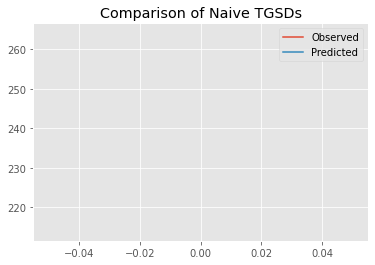

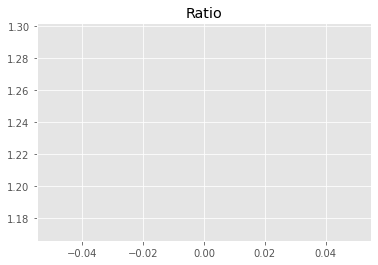

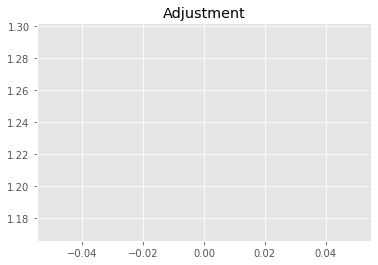

1963574599.7915885
1


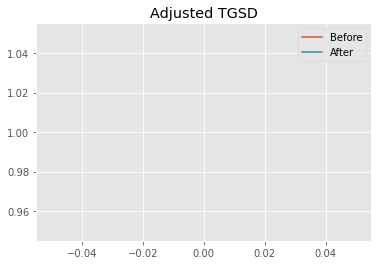

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.4601 	30.5366 	13880.9 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|41.3331 	82.144 	11975.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.86606
New Misfit: 3.77098
Convergence:
0.024594209854264592

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.28e+02 	2.64e+02 	1.1583 		1.0000


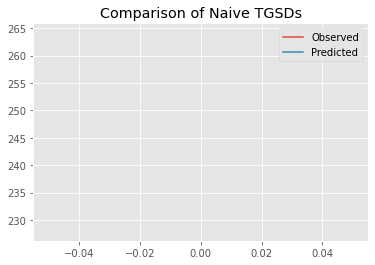

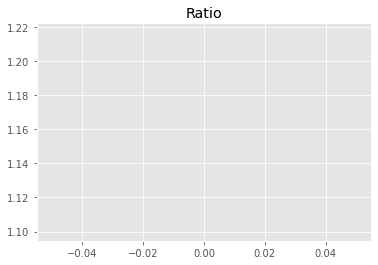

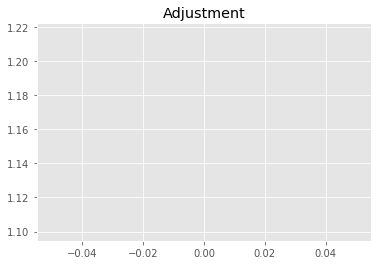

1843644210.5842729
1


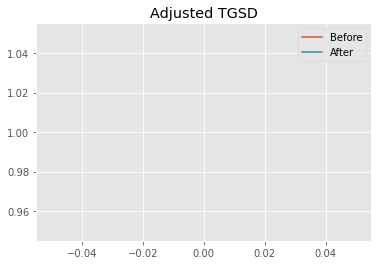

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|41.3331 	82.144 	11975.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|92.6225 	183.585 	12132.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.77098
New Misfit: 3.76496
Convergence:
0.00159615889209562

____________________
a = 92.62251	b = 183.58543	            h1 = 12132.55321	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.7649613111008313
Prior Misfit: 0.301588,	 Post Misfit: 3.76496


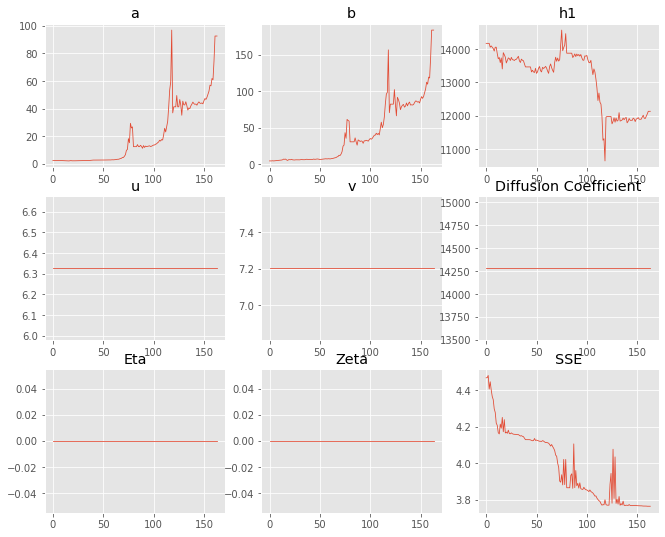

,Priors,Posteriors
a,2.43669,92.6225
b,4.37514,183.585
h1,"14,176.7","12,132.6"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 7 Time: 0.086 minutes


Estimated remaining run time: 1.008 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.95e+02 	2.64e+02 	1.3577 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


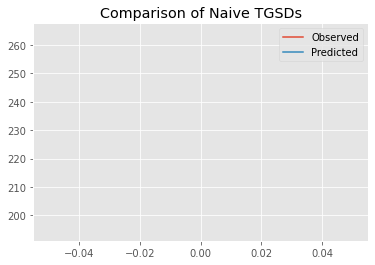

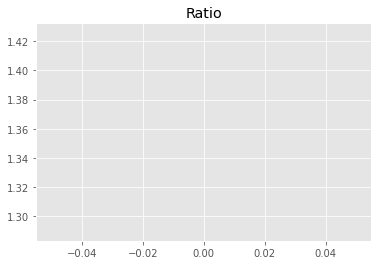

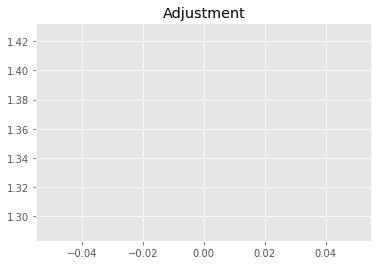

2160959926.266392
1


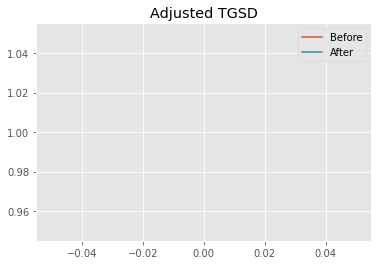

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.80118 	4.57714 	10574.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|9.41845 	3.93945 	7294 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.08613
New Misfit: 3.8112
Convergence:
0.06728596793209088

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1748 		1.0000


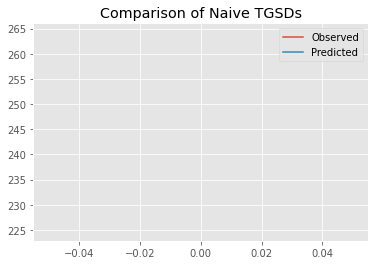

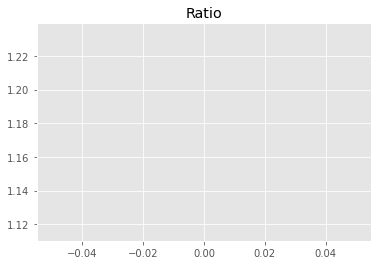

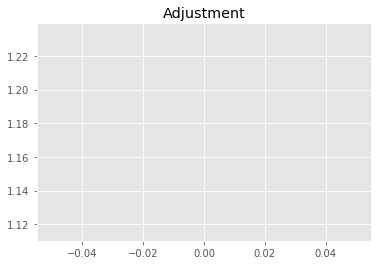

1869817665.9815059
1


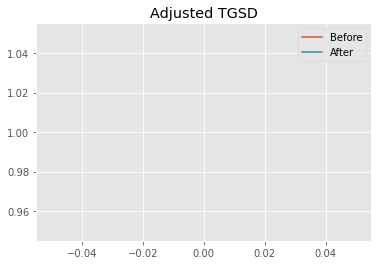

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.41845 	3.93945 	7294 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|11.6702 	4.26535 	7273.98 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.8112
New Misfit: 3.79539
Convergence:
0.004145841373955129

____________________
a = 11.67015	b = 4.26535	            h1 = 7273.98002	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 3.795394743604808
Prior Misfit: 0.275893,	 Post Misfit: 3.79539


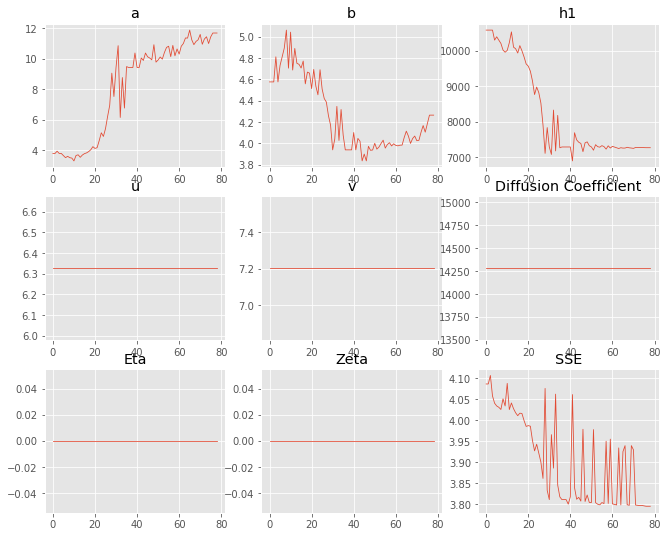

,Priors,Posteriors
a,3.80118,11.6702
b,4.57714,4.26535
h1,"10,574.6","7,273.98"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 8 Time: 0.048 minutes


Estimated remaining run time: 0.881 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.16e+02 	2.64e+02 	2.2697 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


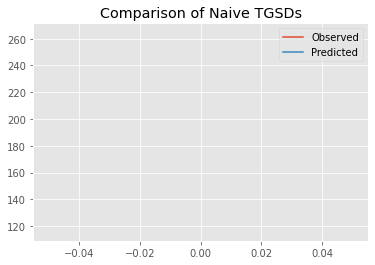

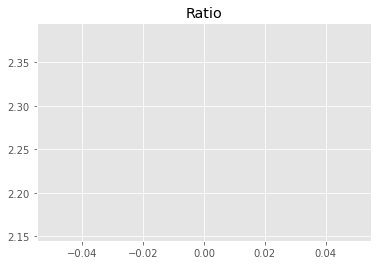

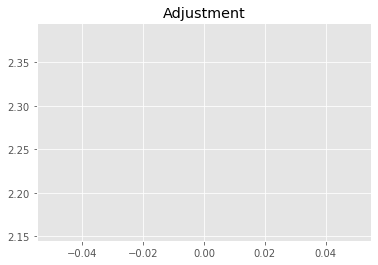

3612572635.232658
1


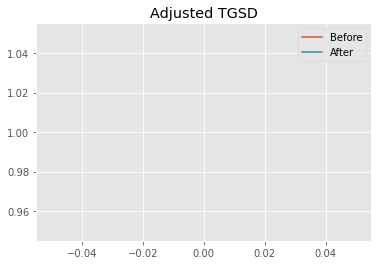

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.87104 	2.36011 	15063 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.94531 	3.2577 	10538.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.25845
New Misfit: 4.13667
Convergence:
0.2133300853981917

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1942 		1.0000


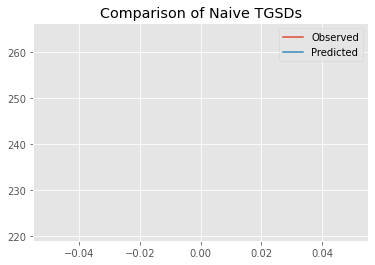

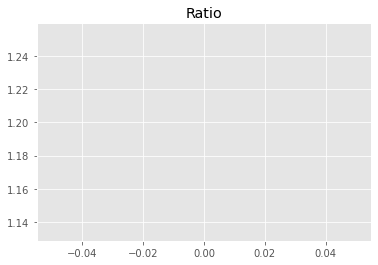

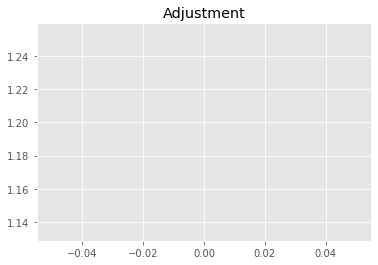

1900755614.0898528
1


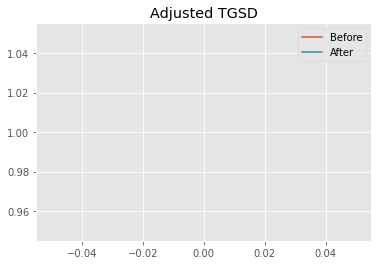

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.94531 	3.2577 	10538.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.92754 	1.74038 	8407.77 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.13667
New Misfit: 4.05553
Convergence:
0.01961522749072689

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1851 		1.0000


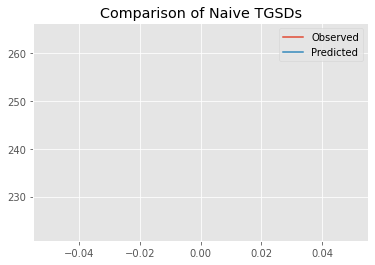

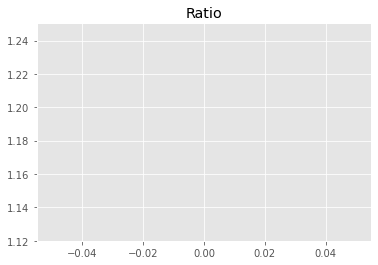

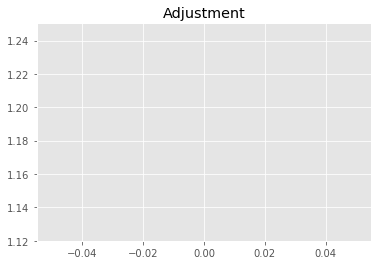

1886259699.2160566
1


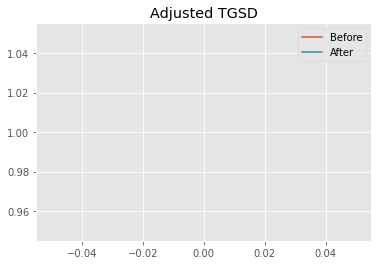

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.92754 	1.74038 	8407.77 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.03539 	1.57202 	8373.85 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.05553
New Misfit: 4.03699
Convergence:
0.004569539685089215

____________________
a = 2.03539	b = 1.57202	            h1 = 8373.85326	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 4.036994634960988
Prior Misfit: 0.355047,	 Post Misfit: 4.03699


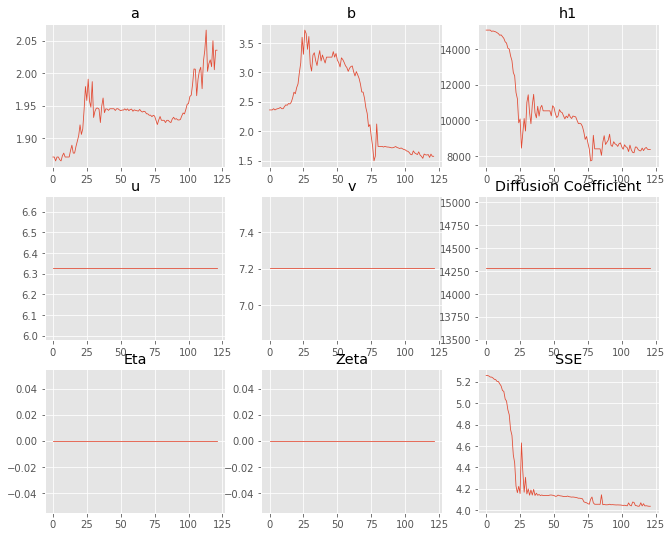

,Priors,Posteriors
a,1.87104,2.03539
b,2.36011,1.57202
h1,"15,063","8,373.85"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 9 Time: 0.067 minutes


Estimated remaining run time: 0.787 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.08e+02 	2.64e+02 	2.4398 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


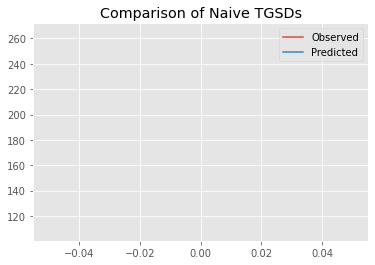

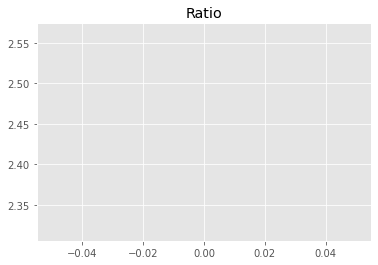

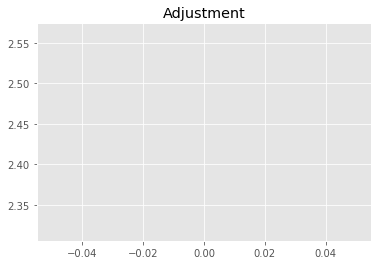

3883289852.704031
1


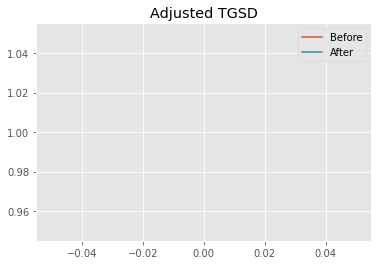

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.25066 	4.95163 	21608 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.19083 	10.0841 	19441.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.41461
New Misfit: 4.19868
Convergence:
0.2245648728839111

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2230 		1.0000


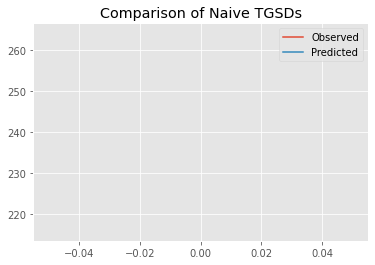

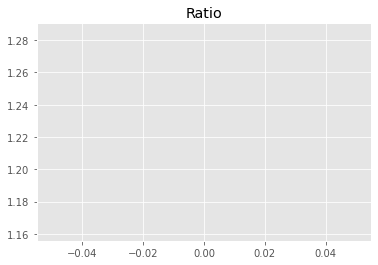

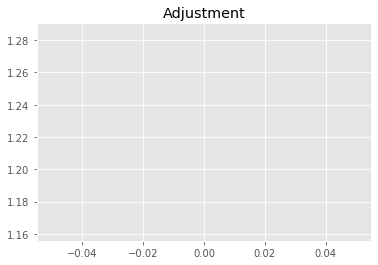

1946656768.4963777
1


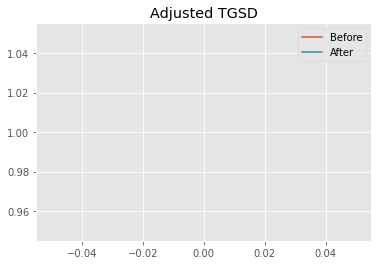

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.19083 	10.0841 	19441.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.606 	7.1614 	10240 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.19868
New Misfit: 4.03846
Convergence:
0.03815925215576226

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.35e+02 	2.64e+02 	1.1240 		1.0000


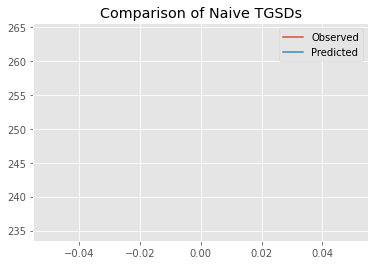

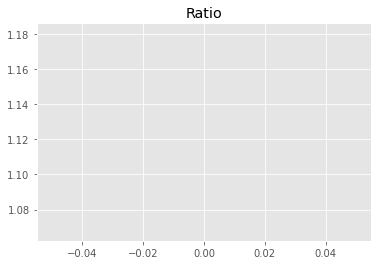

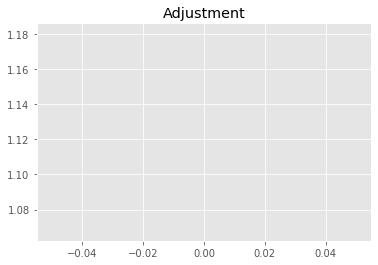

1789066646.4992423
1


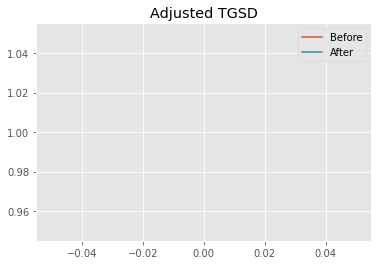

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.606 	7.1614 	10240 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.45365 	3.0163 	7691.75 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.03846
New Misfit: 3.8765
Convergence:
0.04010502580472789

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.28e+02 	2.64e+02 	1.1597 		1.0000


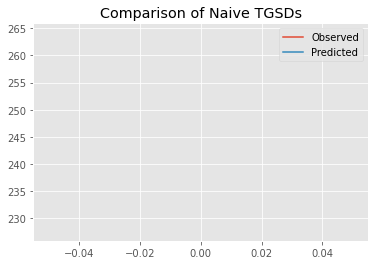

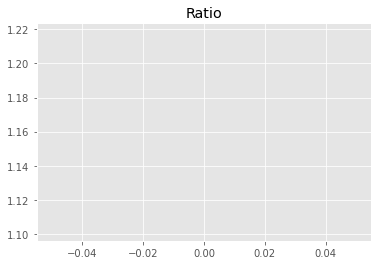

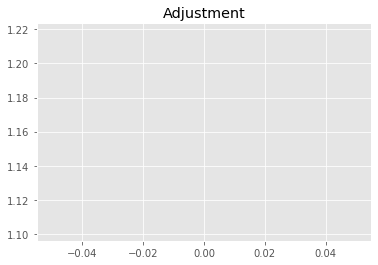

1845898931.8041246
1


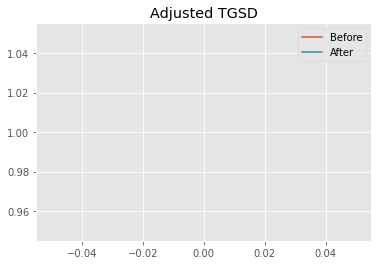

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.45365 	3.0163 	7691.75 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|7.71197 	2.74833 	7271.57 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.8765
New Misfit: 3.81853
Convergence:
0.014953710707725875

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.15e+02 	2.64e+02 	1.2288 		1.0000


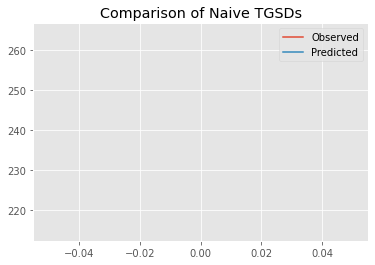

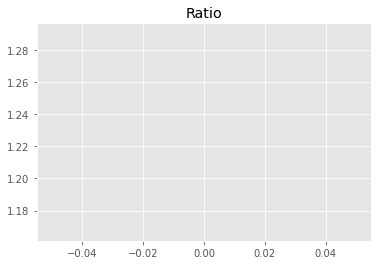

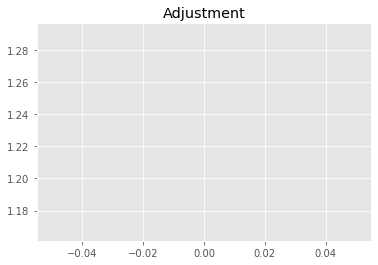

1955848994.8373039
1


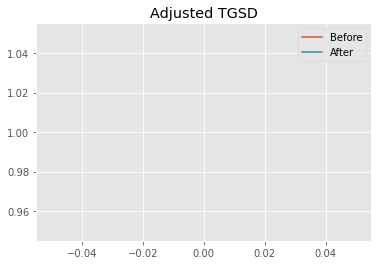

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.71197 	2.74833 	7271.57 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|13.6645 	5.46859 	7304.24 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.81853
New Misfit: 3.78603
Convergence:
0.008512535712643479

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.22e+02 	2.64e+02 	1.1922 		1.0000


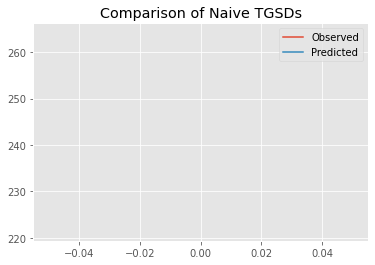

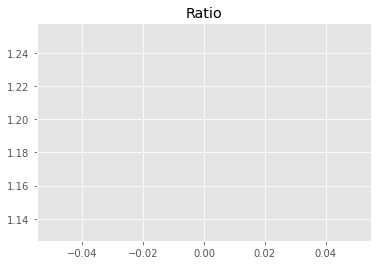

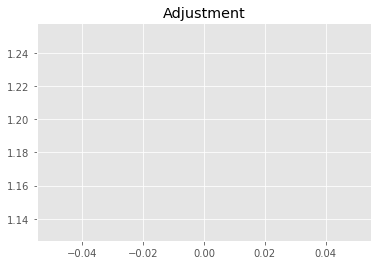

1897629728.4865441
1


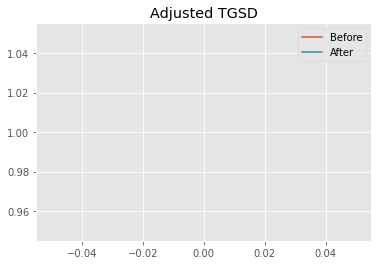

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|13.6645 	5.46859 	7304.24 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|27.5248 	12.5245 	7515.38 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.78603
New Misfit: 3.76979
Convergence:
0.004289269321055066

____________________
a = 27.52482	b = 12.52451	            h1 = 7515.37734	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.7697864476598304
Prior Misfit: 0.36559,	 Post Misfit: 3.76979


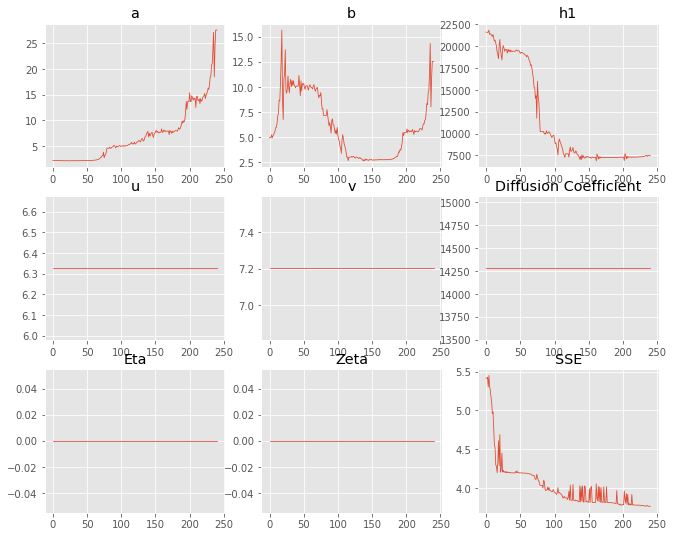

,Priors,Posteriors
a,2.25066,27.5248
b,4.95163,12.5245
h1,"21,608","7,515.38"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 10 Time: 0.120 minutes


Estimated remaining run time: 0.742 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	8.21e+01 	2.64e+02 	3.2158 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


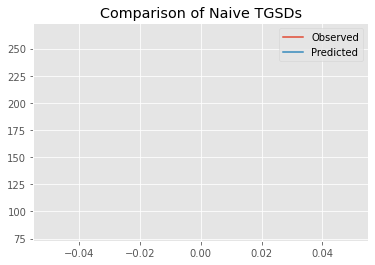

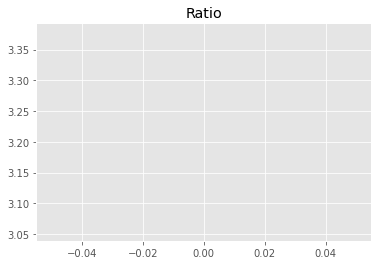

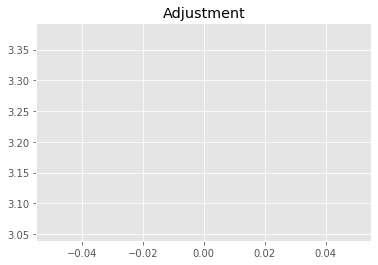

5118483886.826417
1


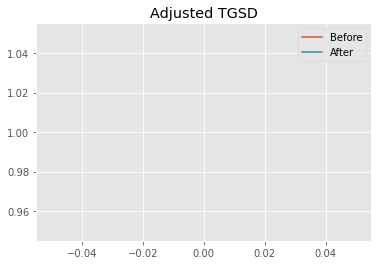

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.29089 	2.92664 	14686.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.59023 	4.59553 	13852.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.88421
New Misfit: 4.21386
Convergence:
0.28387067420178613

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2235 		1.0000


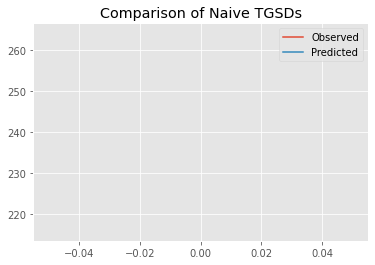

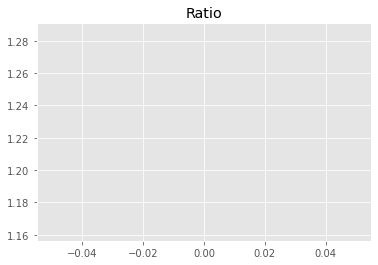

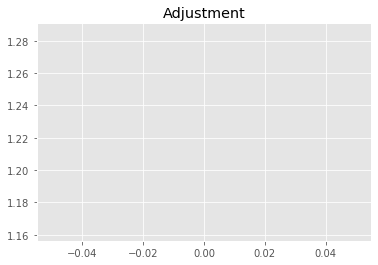

1947404990.298874
1


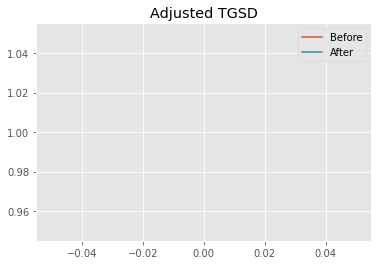

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.59023 	4.59553 	13852.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.90247 	3.53188 	8721.13 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.21386
New Misfit: 3.97392
Convergence:
0.056940512955473206

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1832 		1.0000


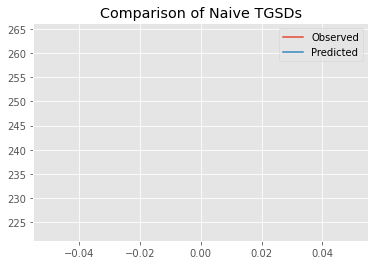

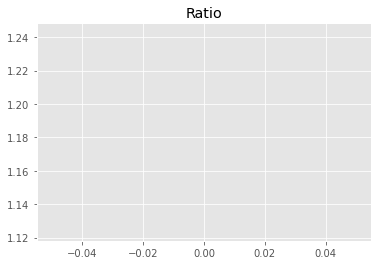

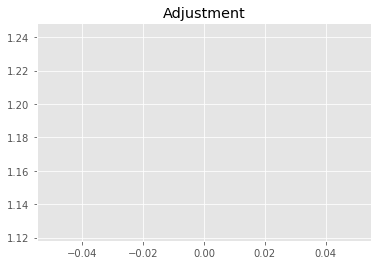

1883162571.3804634
1


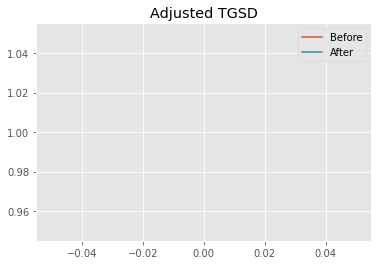

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.90247 	3.53188 	8721.13 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.33311 	2.62558 	7422.44 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.97392
New Misfit: 3.83526
Convergence:
0.03489141526696003

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2113 		1.0000


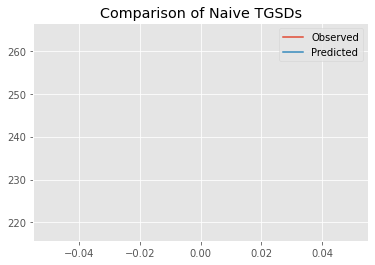

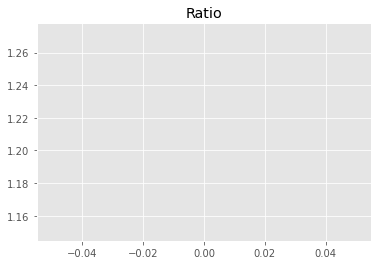

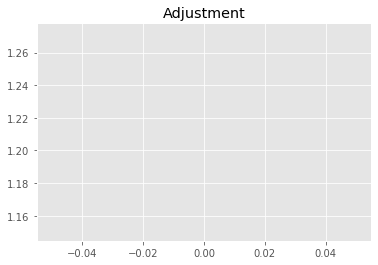

1927896211.7818844
1


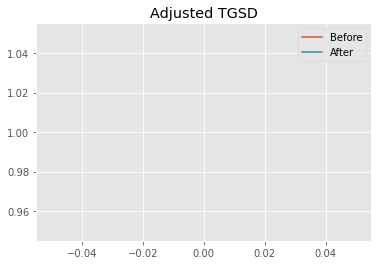

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.33311 	2.62558 	7422.44 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|7.18847 	2.5615 	7270.04 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.83526
New Misfit: 3.82276
Convergence:
0.0032589456583036335

____________________
a = 7.18847	b = 2.56150	            h1 = 7270.03584	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.8227615728446365
Prior Misfit: 0.397297,	 Post Misfit: 3.82276


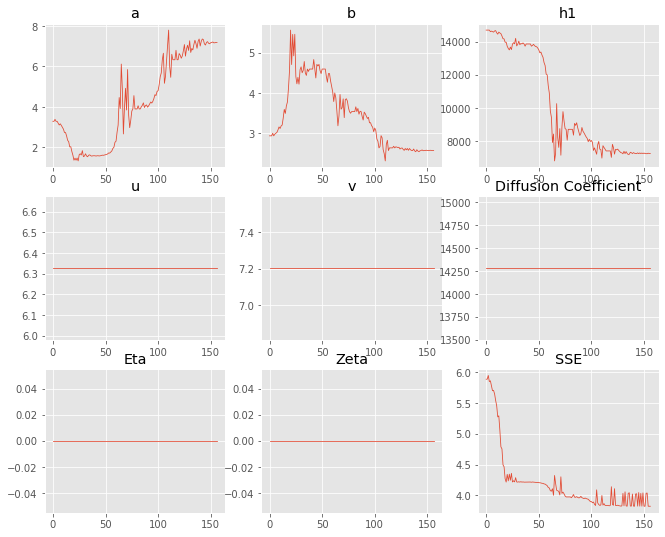

,Priors,Posteriors
a,3.29089,7.18847
b,2.92664,2.5615
h1,"14,686.6","7,270.04"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 11 Time: 0.080 minutes


Estimated remaining run time: 0.658 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.12e+02 	2.64e+02 	2.3554 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


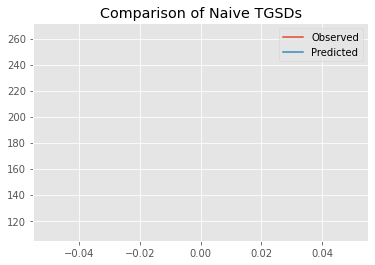

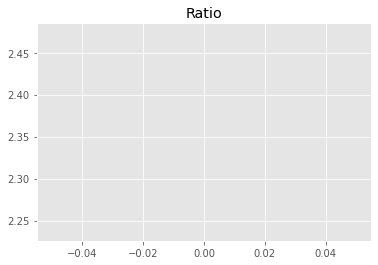

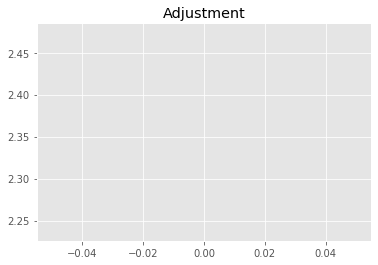

3748951219.928256
1


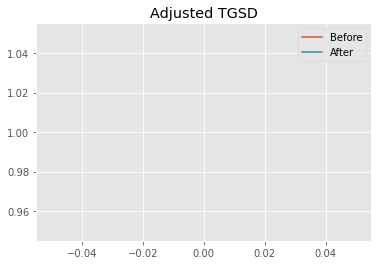

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.46093 	4.4292 	14947.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.73024 	7.48721 	14614 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.25991
New Misfit: 4.13876
Convergence:
0.21314970899009325

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.11e+02 	2.64e+02 	1.2503 		1.0000


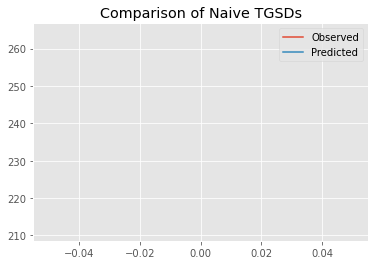

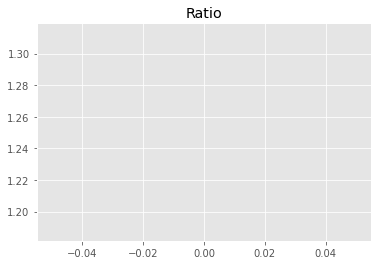

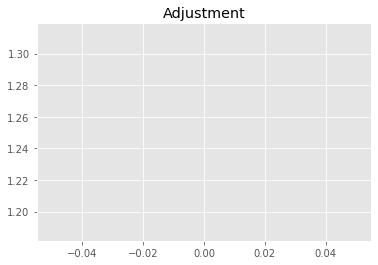

1990052537.452127
1


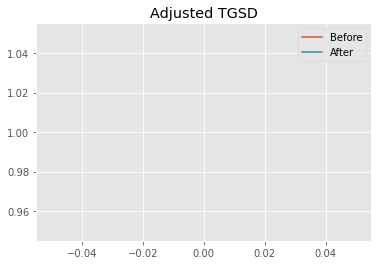

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.73024 	7.48721 	14614 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|8.98696 	15.0656 	12018.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.13876
New Misfit: 3.94797
Convergence:
0.046098059269570064

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.99e+02 	2.64e+02 	1.3272 		1.0000


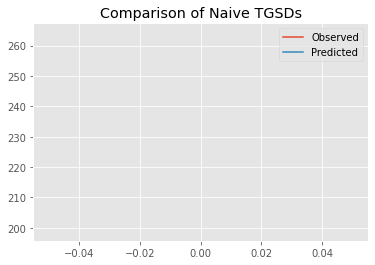

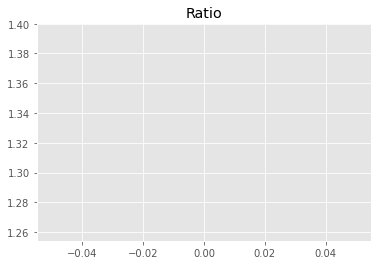

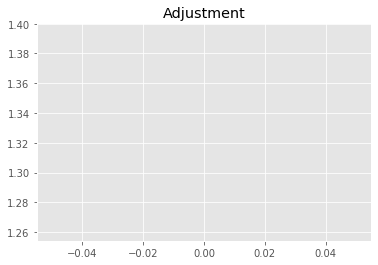

2112471757.4529781
1


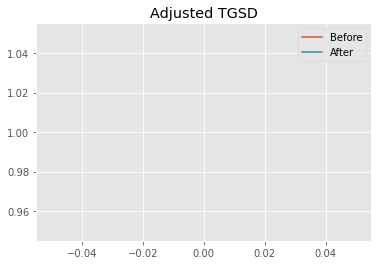

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.98696 	15.0656 	12018.6 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|86.8683 	327.947 	17150.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.94797
New Misfit: 3.77434
Convergence:
0.04398083776690927

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.35e+02 	2.64e+02 	1.1225 		1.0000


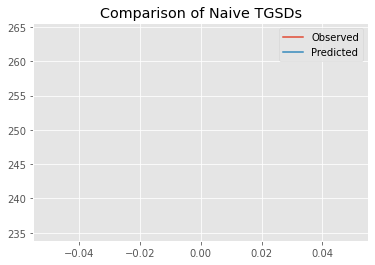

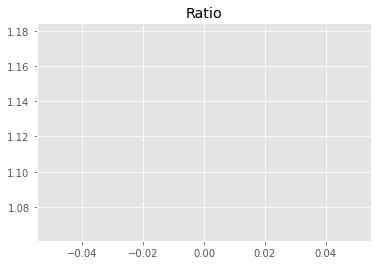

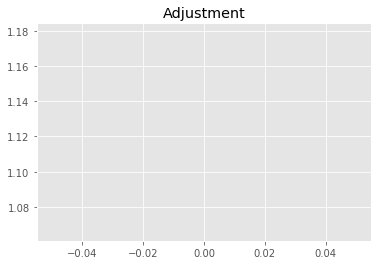

1786633557.4550467
1


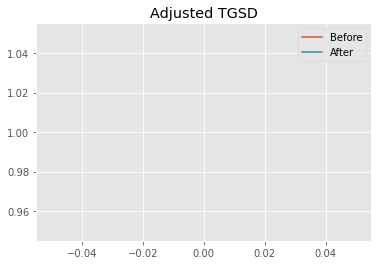

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|86.8683 	327.947 	17150.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|94.0561 	342.478 	17156.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.77434
New Misfit: 3.765
Convergence:
0.002474814397660073

____________________
a = 94.05611	b = 342.47808	            h1 = 17156.12151	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.764996857946262
Prior Misfit: 0.355145,	 Post Misfit: 3.765


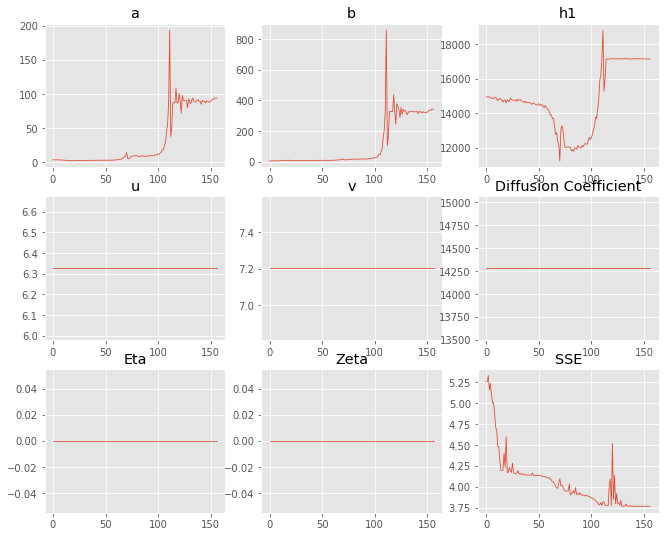

,Priors,Posteriors
a,3.46093,94.0561
b,4.4292,342.478
h1,"14,947.6","17,156.1"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 12 Time: 0.082 minutes


Estimated remaining run time: 0.576 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	7.84e+01 	2.64e+02 	3.3684 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


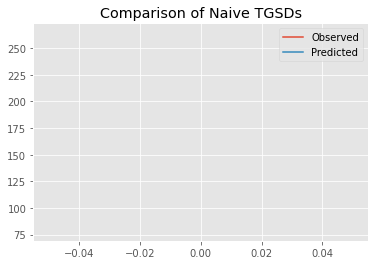

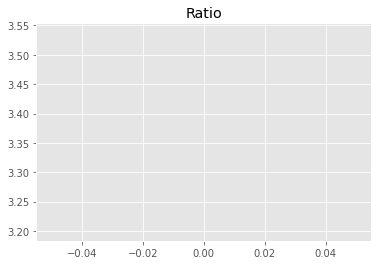

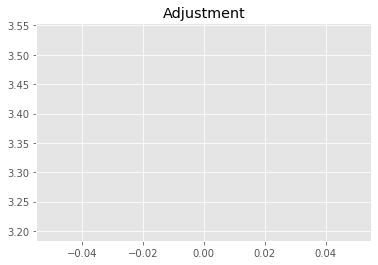

5361249556.222135
1


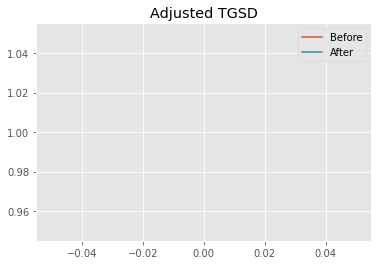

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.62545 	2.96555 	24918.7 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.50801 	4.2945 	13172.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 6.06564
New Misfit: 4.2168
Convergence:
0.30480570941231033

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.22e+02 	2.64e+02 	1.1904 		1.0000


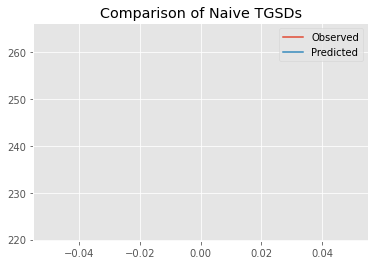

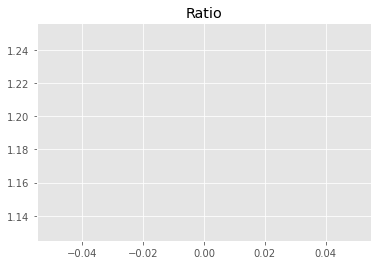

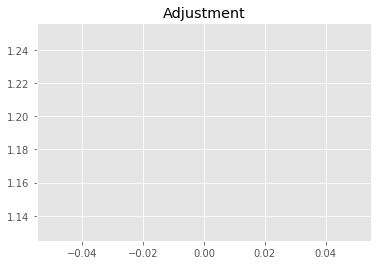

1894723897.4462032
1


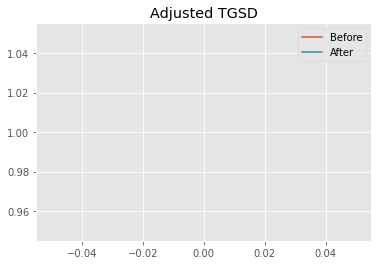

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50801 	4.2945 	13172.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.83264 	2.93652 	8786.42 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.2168
New Misfit: 4.04589
Convergence:
0.04053071333424819

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.30e+02 	2.64e+02 	1.1470 		1.0000


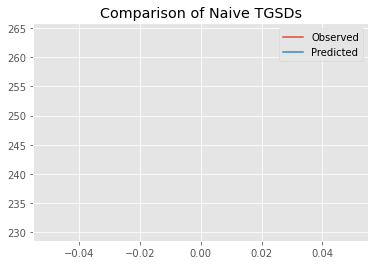

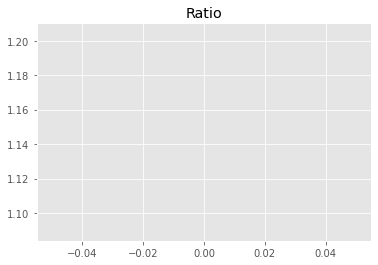

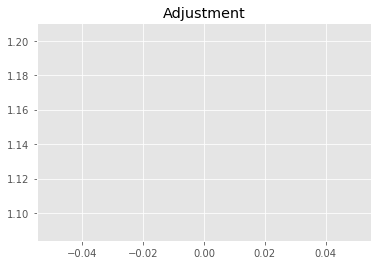

1825548496.2667685
1


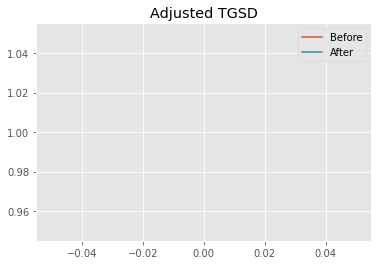

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.83264 	2.93652 	8786.42 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.43539 	2.20716 	7940.69 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.04589
New Misfit: 3.95027
Convergence:
0.023633821310892693

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.34e+02 	2.64e+02 	1.1307 		1.0000


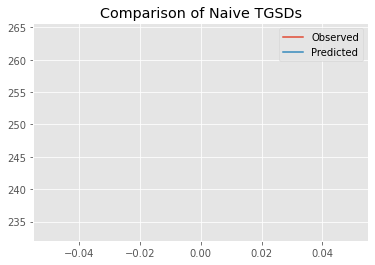

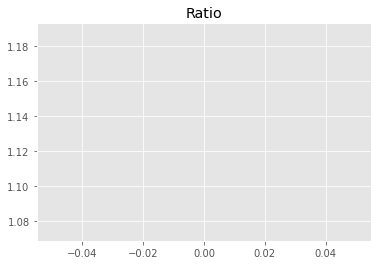

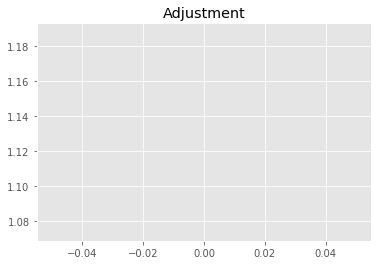

1799693358.7264173
1


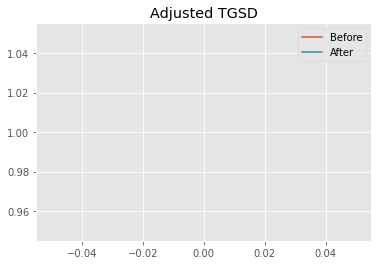

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.43539 	2.20716 	7940.69 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.75075 	2.10997 	8207.05 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.95027
New Misfit: 3.85878
Convergence:
0.023161223806724276

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.09e+02 	2.64e+02 	1.2641 		1.0000


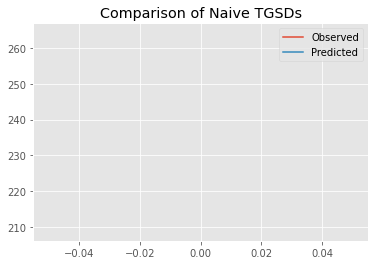

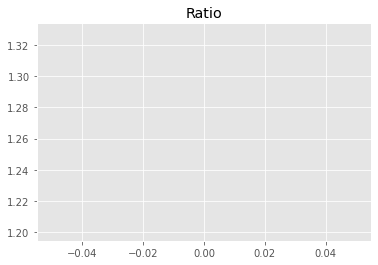

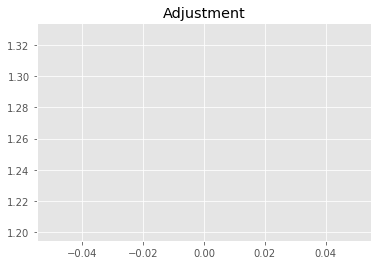

2012019339.0044339
1


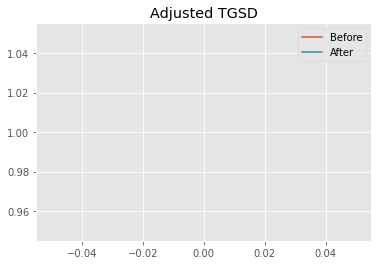

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.75075 	2.10997 	8207.05 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.95667 	2.13373 	7269.28 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.85878
New Misfit: 3.83509
Convergence:
0.006138765573673866

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2239 		1.0000


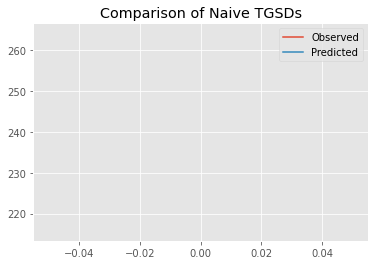

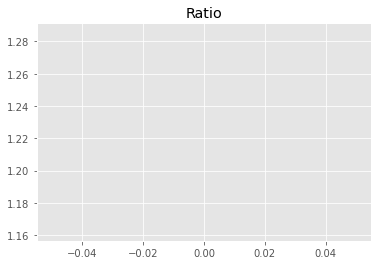

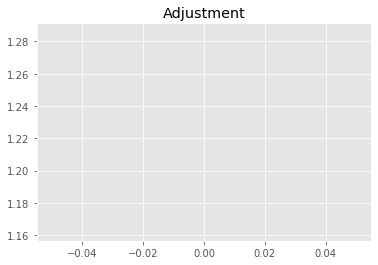

1947975014.6915994
1


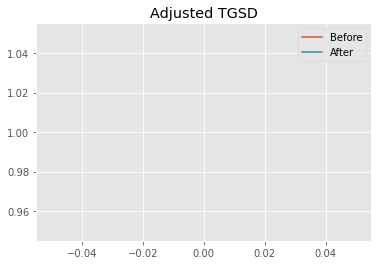

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.95667 	2.13373 	7269.28 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.35559 	2.13461 	7268.65 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.83509
New Misfit: 3.83258
Convergence:
0.0006530738772910939

____________________
a = 6.35559	b = 2.13461	            h1 = 7268.65213	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 3.8325823774082863
Prior Misfit: 0.409547,	 Post Misfit: 3.83258


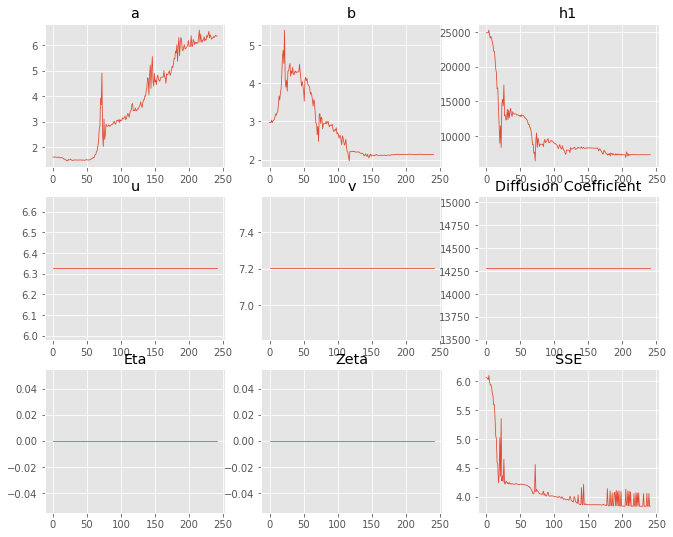

,Priors,Posteriors
a,1.62545,6.35559
b,2.96555,2.13461
h1,"24,918.7","7,268.65"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 13 Time: 0.116 minutes


Estimated remaining run time: 0.508 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	7.08e+01 	2.64e+02 	3.7299 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


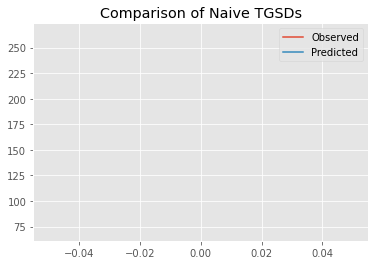

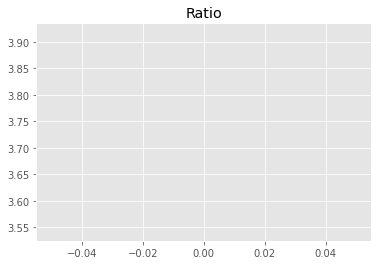

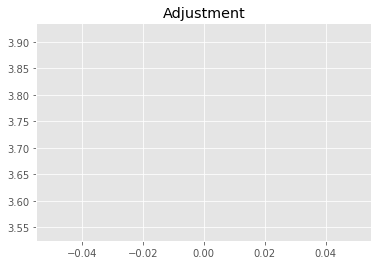

5936709811.865813
1


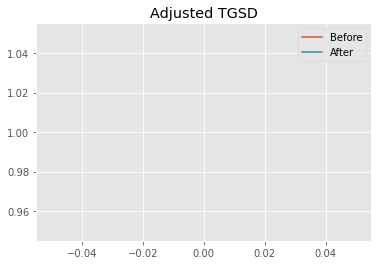

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.55688 	1.1591 	11143.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.61847 	1.132 	8169.11 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 6.07728
New Misfit: 3.90332
Convergence:
0.3577195989367363

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1935 		1.0000


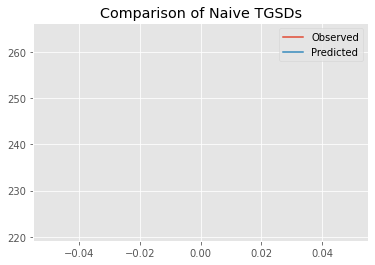

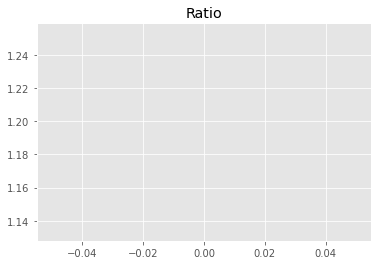

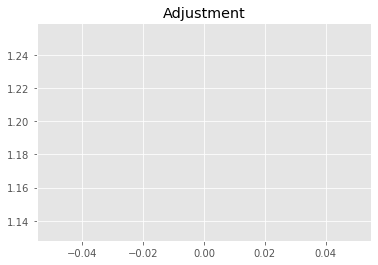

1899641559.3424015
1


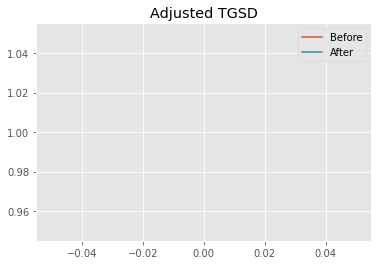

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.61847 	1.132 	8169.11 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.67257 	1.12295 	7588.91 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.90332
New Misfit: 3.87085
Convergence:
0.00831685578201346

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.07e+02 	2.64e+02 	1.2781 		1.0000


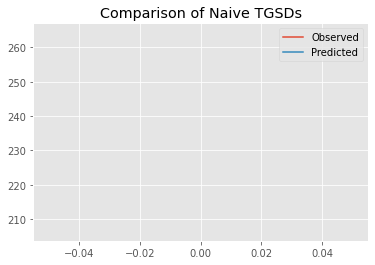

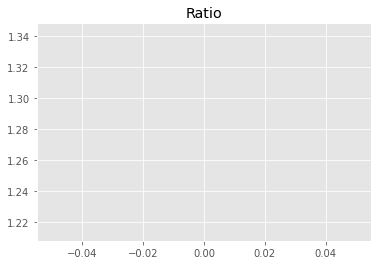

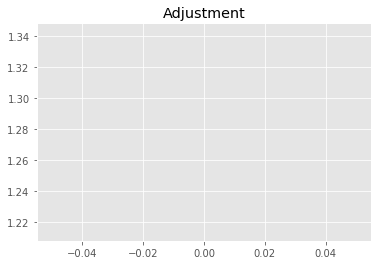

2034312681.645445
1


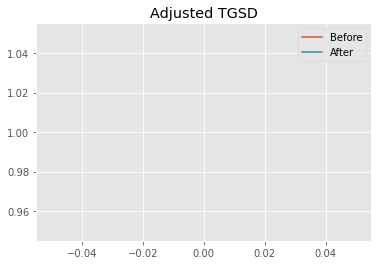

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.67257 	1.12295 	7588.91 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.76188 	1.1507 	7276.37 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.87085
New Misfit: 3.86694
Convergence:
0.0010097664131955288

____________________
a = 3.76188	b = 1.15070	            h1 = 7276.37295	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 3.8669447475942773
Prior Misfit: 0.410333,	 Post Misfit: 3.86694


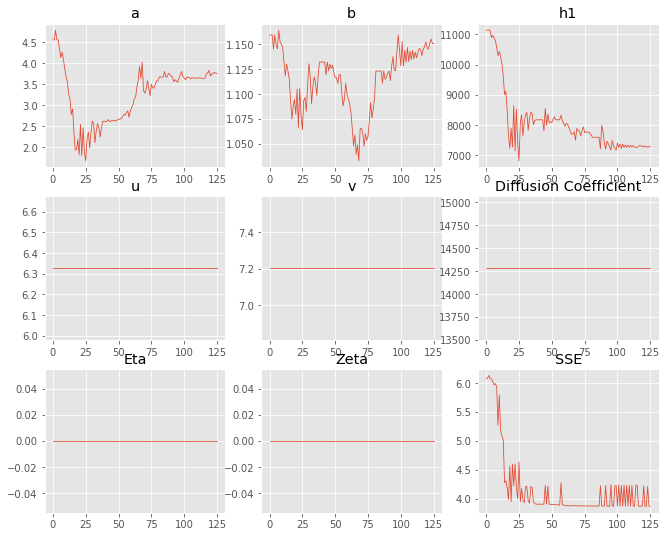

,Priors,Posteriors
a,4.55688,3.76188
b,1.1591,1.1507
h1,"11,143.2","7,276.37"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 14 Time: 0.067 minutes


Estimated remaining run time: 0.418 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	8.78e+01 	2.64e+02 	3.0089 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


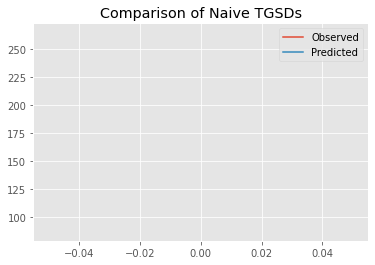

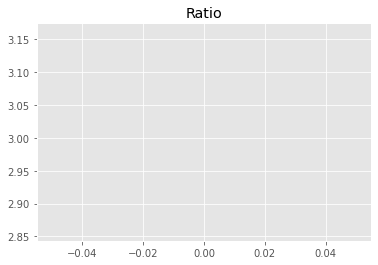

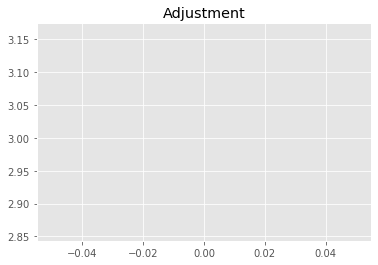

4789113647.0437565
1


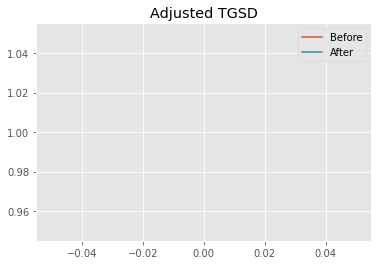

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.07446 	4.67457 	18786.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.2226 	9.60827 	18391.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.78549
New Misfit: 4.19255
Convergence:
0.2753342163726551

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2088 		1.0000


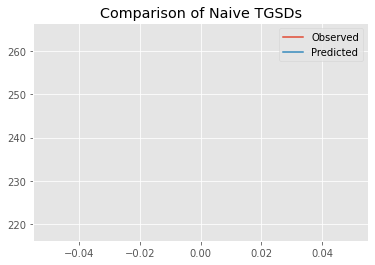

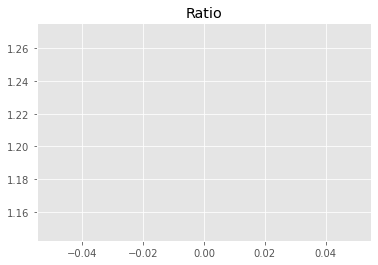

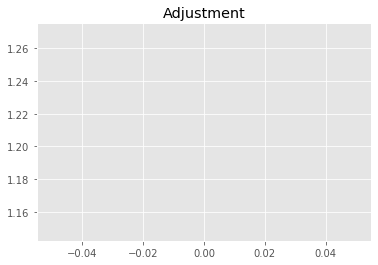

1923971316.4182665
1


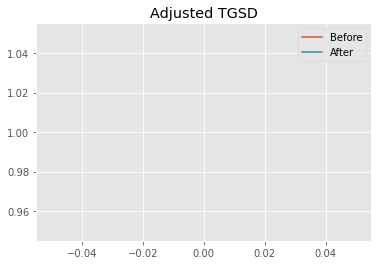

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.2226 	9.60827 	18391.5 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.507 	4.99148 	9854.96 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.19255
New Misfit: 4.06241
Convergence:
0.0310397104676293

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.32e+02 	2.64e+02 	1.1366 		1.0000


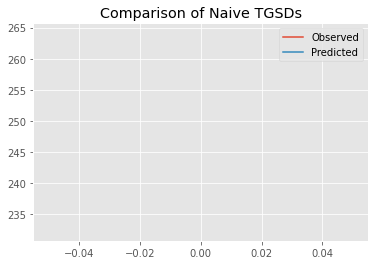

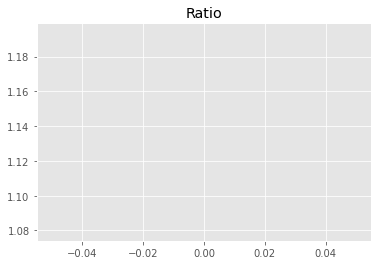

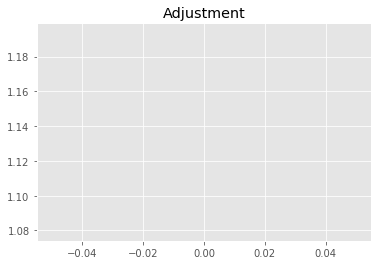

1809011734.8435285
1


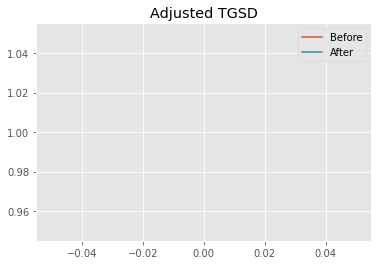

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.507 	4.99148 	9854.96 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.57736 	2.59512 	7595.49 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.06241
New Misfit: 3.91713
Convergence:
0.03576236463678515

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.33e+02 	2.64e+02 	1.1336 		1.0000


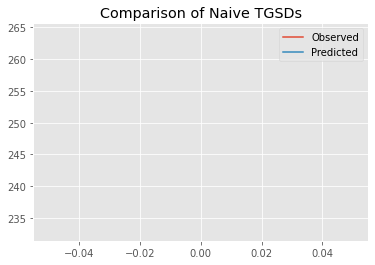

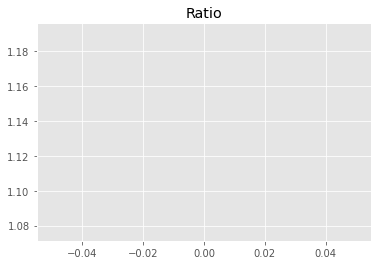

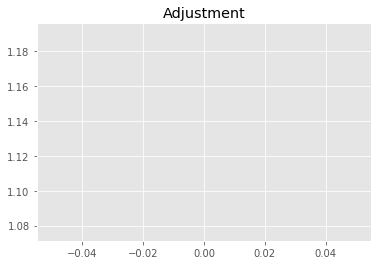

1804320170.6465826
1


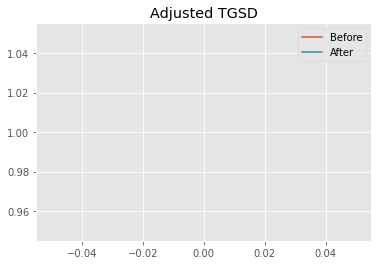

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.57736 	2.59512 	7595.49 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.11649 	2.34204 	7294.31 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.91713
New Misfit: 3.83546
Convergence:
0.020848607155326725

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.19e+02 	2.64e+02 	1.2077 		1.0000


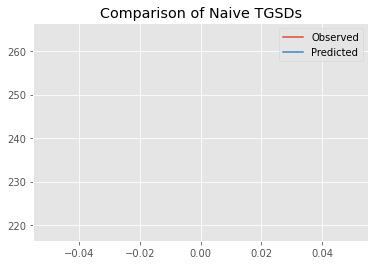

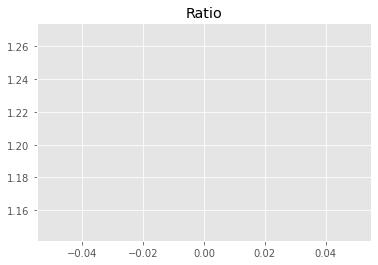

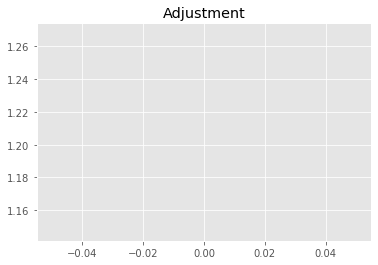

1922223781.9752066
1


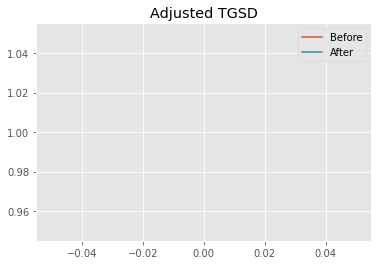

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.11649 	2.34204 	7294.31 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.736 	2.35791 	7268.59 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.83546
New Misfit: 3.82724
Convergence:
0.0021437554855896017

____________________
a = 6.73600	b = 2.35791	            h1 = 7268.58983	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.827241774067514
Prior Misfit: 0.390632,	 Post Misfit: 3.82724


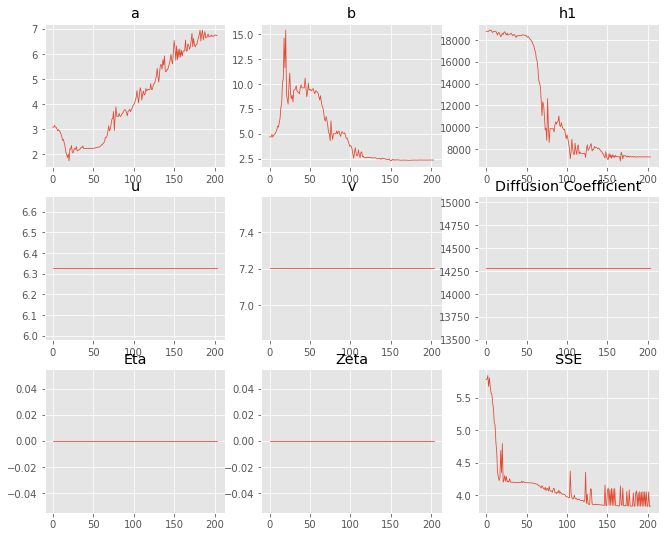

,Priors,Posteriors
a,3.07446,6.736
b,4.67457,2.35791
h1,"18,786.3","7,268.59"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 15 Time: 0.100 minutes


Estimated remaining run time: 0.338 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.84e+02 	2.64e+02 	1.4320 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


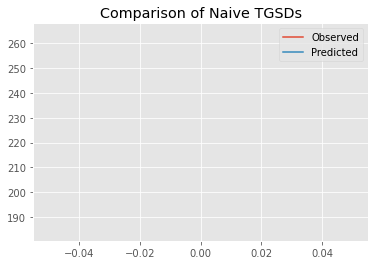

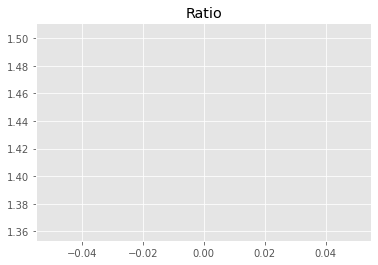

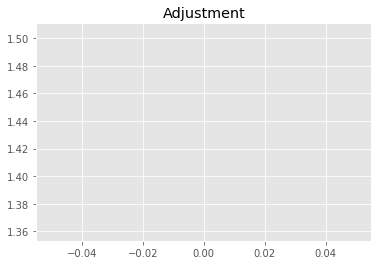

2279207489.687658
1


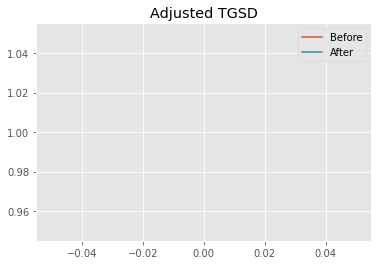

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.36474 	4.86687 	13961.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.39102 	4.54313 	11338.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.28221
New Misfit: 4.12335
Convergence:
0.037097544313499826

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.22e+02 	2.64e+02 	1.1883 		1.0000


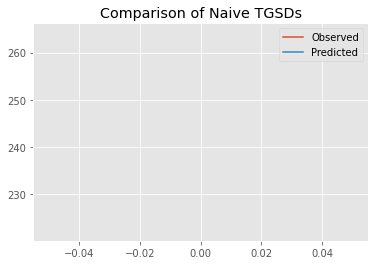

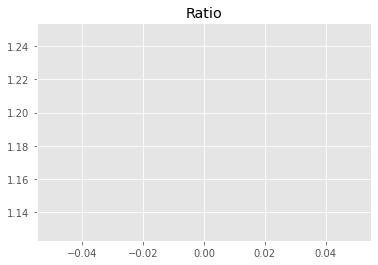

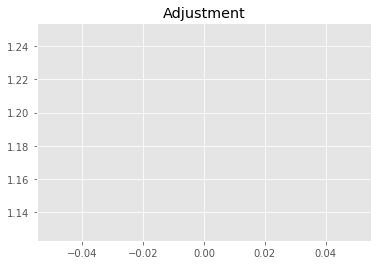

1891299314.6716287
1


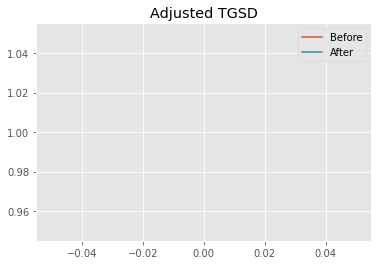

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.39102 	4.54313 	11338.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.5191 	2.12735 	8352.69 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.12335
New Misfit: 4.02399
Convergence:
0.024095633505042485

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.24e+02 	2.64e+02 	1.1780 		1.0000


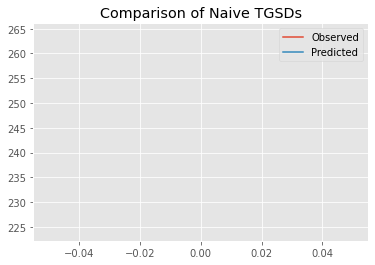

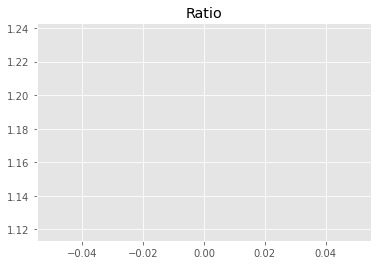

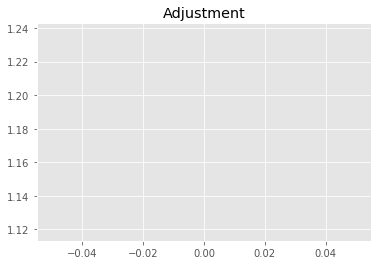

1874990068.3987148
1


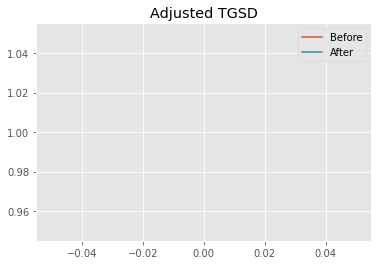

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.5191 	2.12735 	8352.69 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|4.93176 	1.87475 	7633.18 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.02399
New Misfit: 3.85383
Convergence:
0.042286097319535865

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.10e+02 	2.64e+02 	1.2603 		1.0000


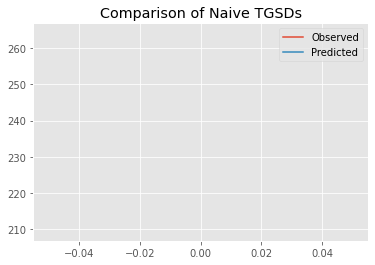

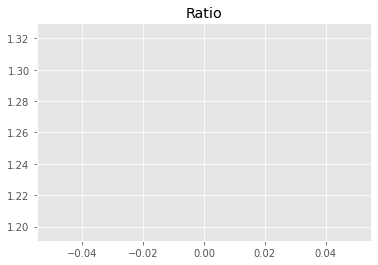

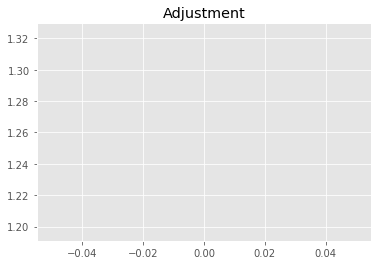

2005884918.614201
1


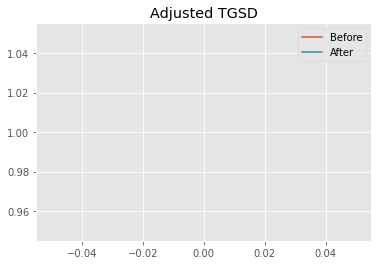

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.93176 	1.87475 	7633.18 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|5.60703 	1.88086 	7271.67 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.85383
New Misfit: 3.84016
Convergence:
0.00354896598147644

____________________
a = 5.60703	b = 1.88086	            h1 = 7271.66629	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.8401559407467047
Prior Misfit: 0.289131,	 Post Misfit: 3.84016


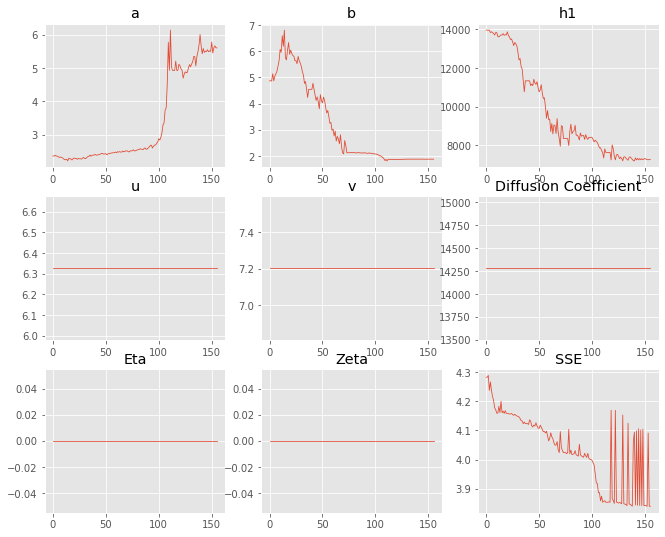

,Priors,Posteriors
a,2.36474,5.60703
b,4.86687,1.88086
h1,"13,961.3","7,271.67"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 16 Time: 0.080 minutes


Estimated remaining run time: 0.253 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.42e+02 	2.64e+02 	1.8614 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


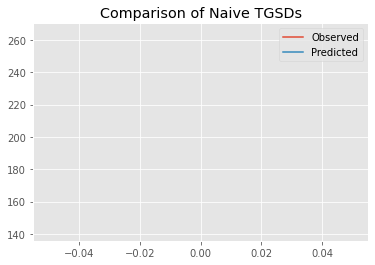

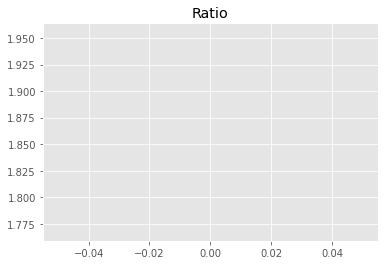

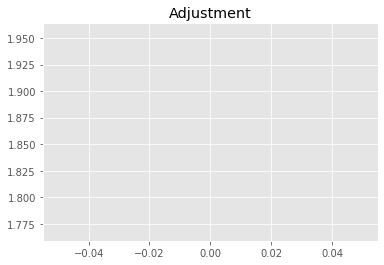

2962664407.7122116
1


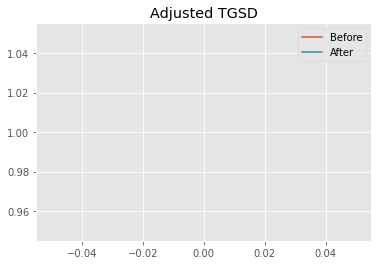

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.27595 	2.90922 	13303.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.02167 	2.78654 	9927.99 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.78348
New Misfit: 4.10793
Convergence:
0.14122540320721627

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2119 		1.0000


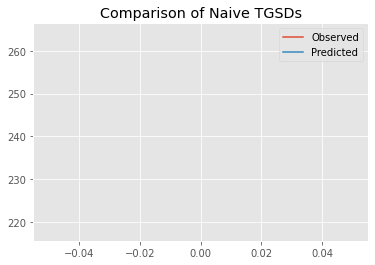

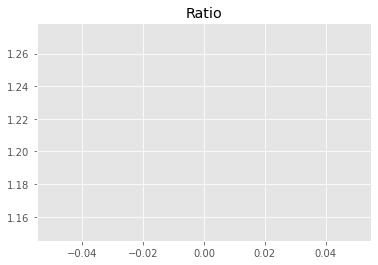

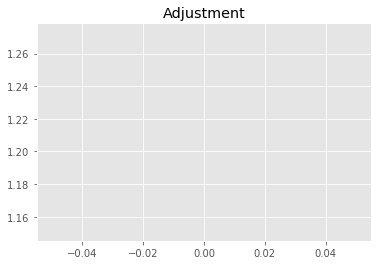

1928876484.0610836
1


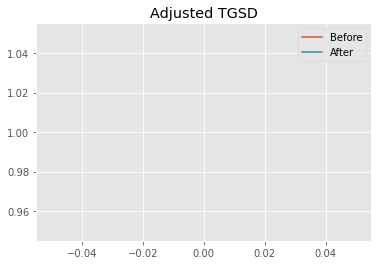

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02167 	2.78654 	9927.99 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.04079 	1.32747 	7592.18 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.10793
New Misfit: 4.03368
Convergence:
0.018073620810893618

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.40e+02 	2.64e+02 	1.1005 		1.0000


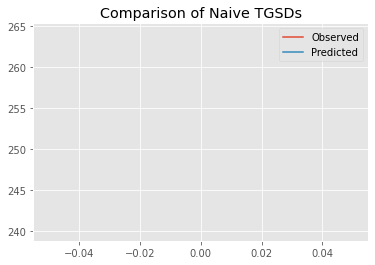

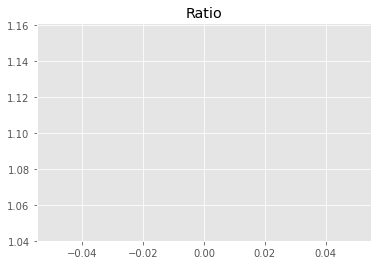

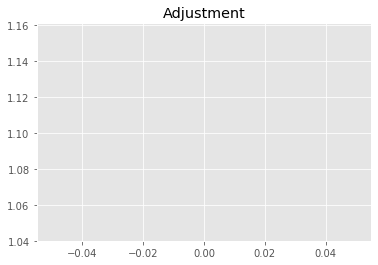

1751539011.312248
1


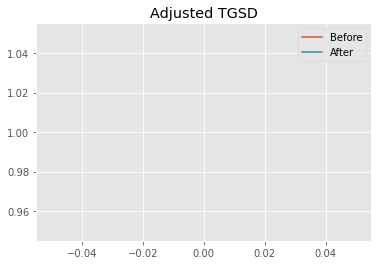

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.04079 	1.32747 	7592.18 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.0346 	1.23516 	8311.13 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.03368
New Misfit: 3.98742
Convergence:
0.011470001575639883

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.34e+02 	2.64e+02 	1.1277 		1.0000


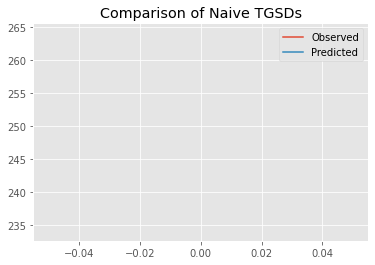

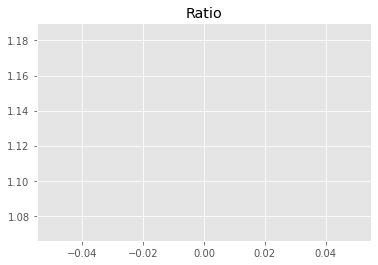

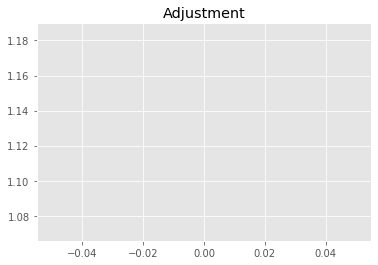

1794966073.5958495
1


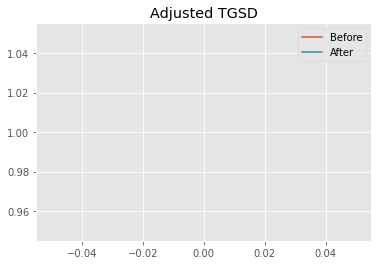

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0346 	1.23516 	8311.13 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.98975 	1.01085 	7877.61 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.98742
New Misfit: 3.96
Convergence:
0.0068744185194355815

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.30e+02 	2.64e+02 	1.1474 		1.0000


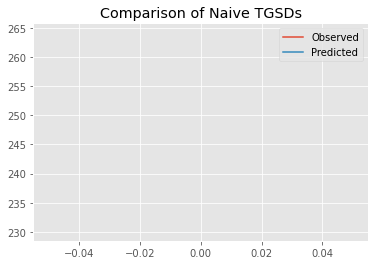

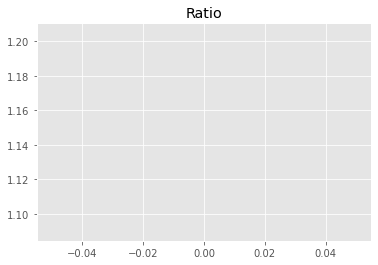

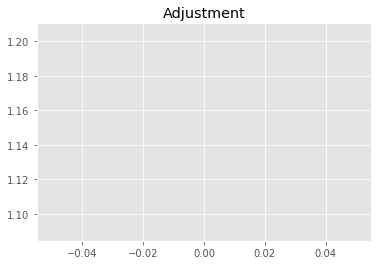

1826217001.2143898
1


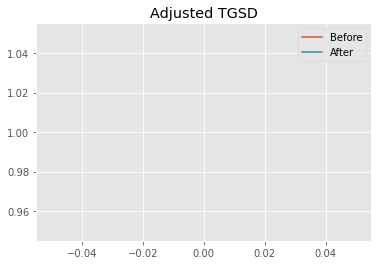

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.98975 	1.01085 	7877.61 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.0021 	1.00048 	7333.91 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.96
New Misfit: 3.95642
Convergence:
0.000906090423587419

____________________
a = 2.00210	b = 1.00048	            h1 = 7333.91135	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 3.9564164342078594
Prior Misfit: 0.322976,	 Post Misfit: 3.95642


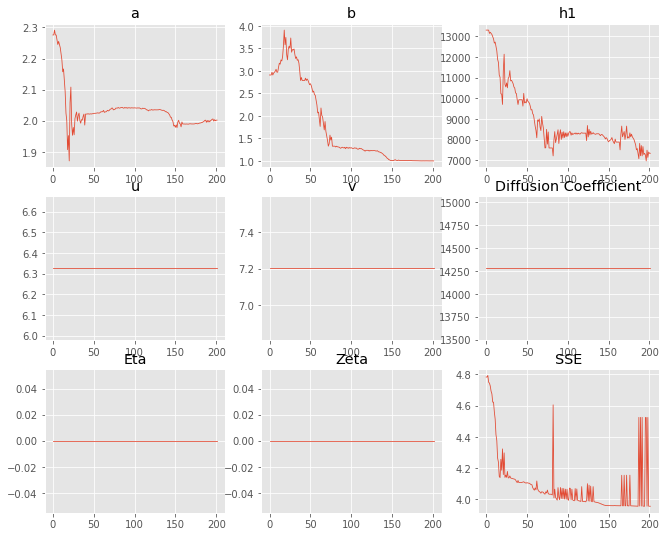

,Priors,Posteriors
a,2.27595,2.0021
b,2.90922,1.00048
h1,"13,303.2","7,333.91"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 17 Time: 0.103 minutes


Estimated remaining run time: 0.171 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.44e+02 	2.64e+02 	1.0805 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


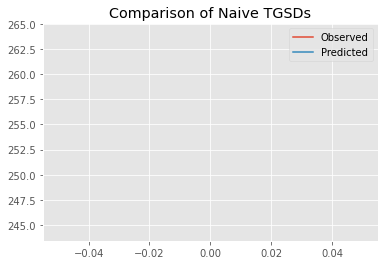

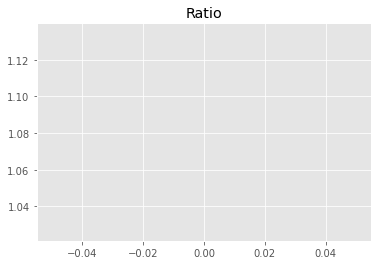

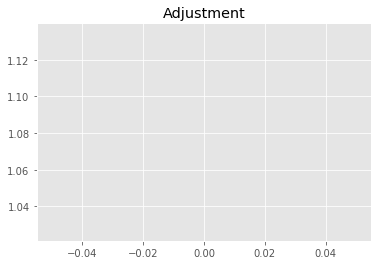

1719844053.262814
1


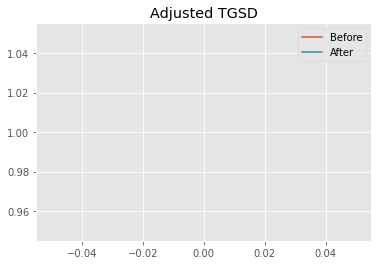

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.78516 	4.94381 	11798.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.76687 	2.11626 	9196.35 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.27812
New Misfit: 4.09343
Convergence:
0.04317030938115766

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.27e+02 	2.64e+02 	1.1625 		1.0000


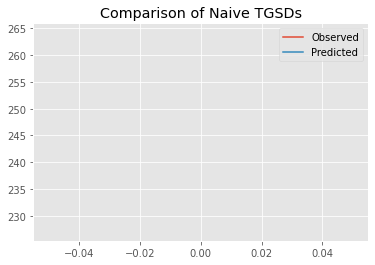

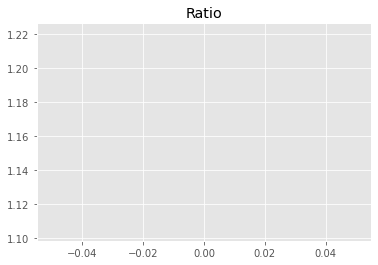

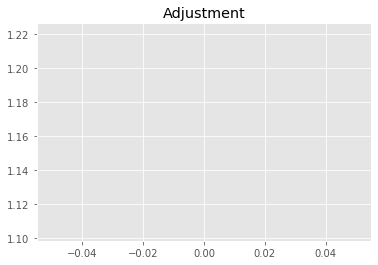

1850340419.6696332
1


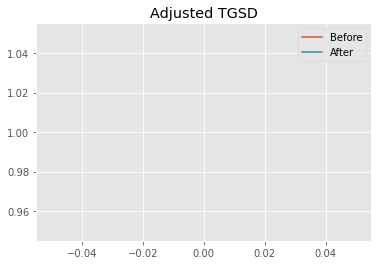

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.76687 	2.11626 	9196.35 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.33627 	2.21662 	9277.82 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.09343
New Misfit: 4.0373
Convergence:
0.013711598014842513

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.12e+02 	2.64e+02 	1.2472 		1.0000


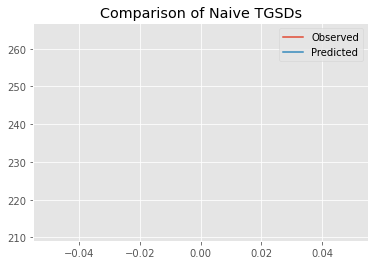

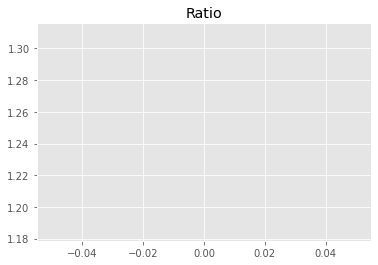

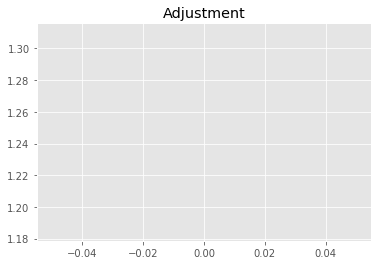

1985150239.0282993
1


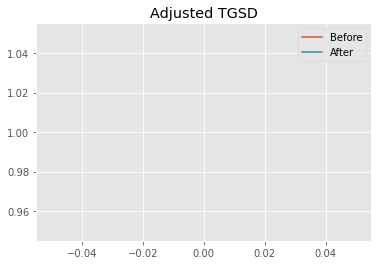

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33627 	2.21662 	9277.82 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.17028 	2.32812 	7323.87 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.0373
New Misfit: 3.83409
Convergence:
0.05033300379729852

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2205 		1.0000


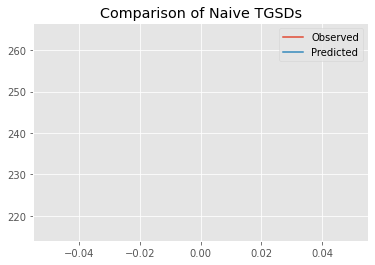

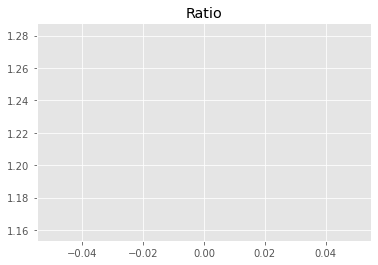

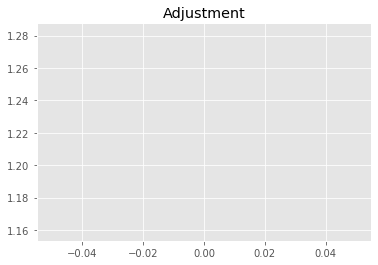

1942522099.431399
1


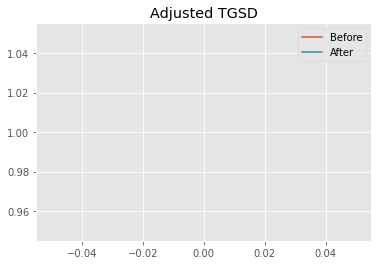

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.17028 	2.32812 	7323.87 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|6.6403 	2.29903 	7268.08 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.83409
New Misfit: 3.82848
Convergence:
0.0014647520835801328

____________________
a = 6.64030	b = 2.29903	            h1 = 7268.07918	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.8284767633304306
Prior Misfit: 0.288855,	 Post Misfit: 3.82848


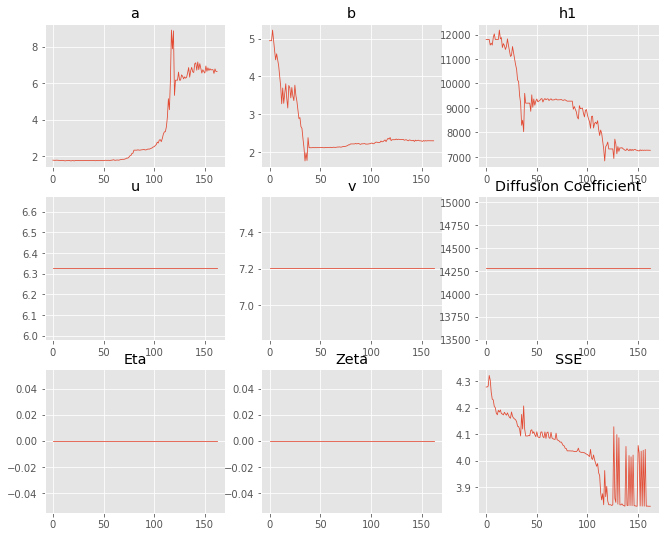

,Priors,Posteriors
a,1.78516,6.6403
b,4.94381,2.29903
h1,"11,798.3","7,268.08"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 18 Time: 0.082 minutes


Estimated remaining run time: 0.085 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	8.42e+01 	2.64e+02 	3.1354 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


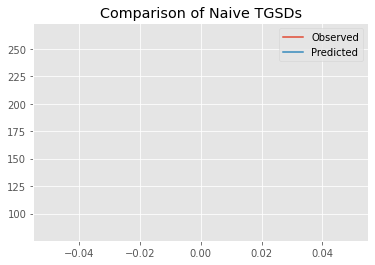

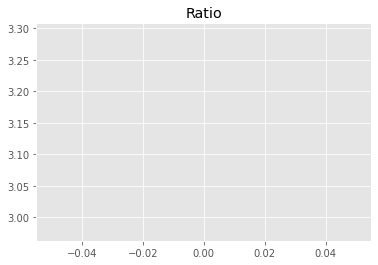

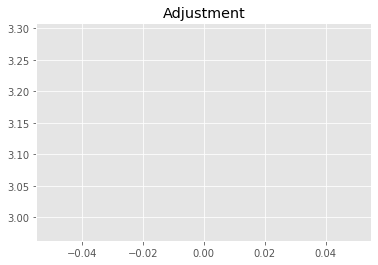

4990404210.96915
1


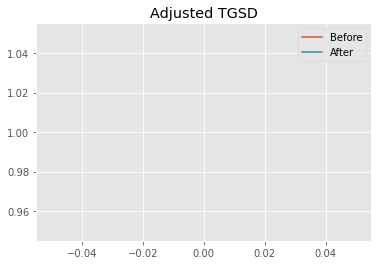

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.13838 	4.21061 	43443.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.07076 	7.92964 	23929.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.98783
New Misfit: 4.30886
Convergence:
0.2803970873883869

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.16e+02 	2.64e+02 	1.2230 		1.0000


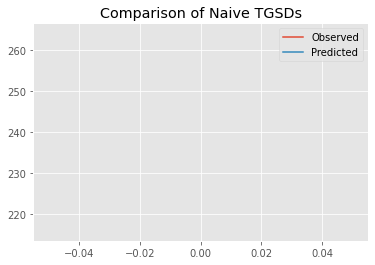

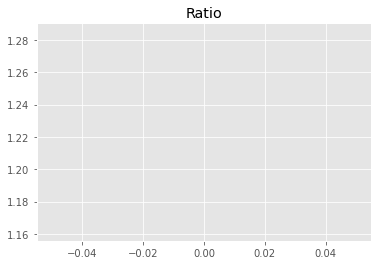

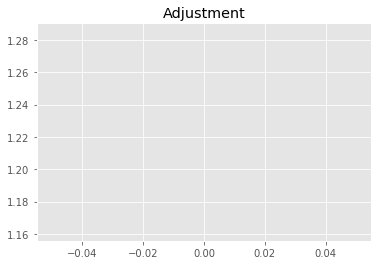

1946555172.9536307
1


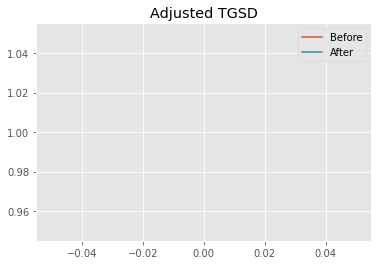

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.07076 	7.92964 	23929.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.96739 	9.89462 	21540.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.30886
New Misfit: 4.23565
Convergence:
0.01699069221680095

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.07e+02 	2.64e+02 	1.2768 		1.0000


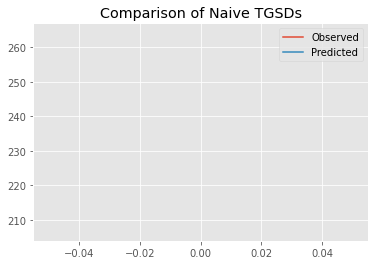

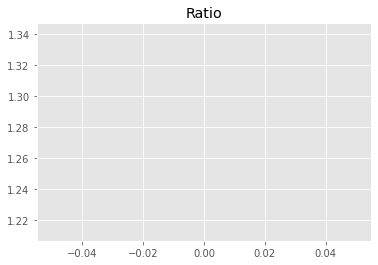

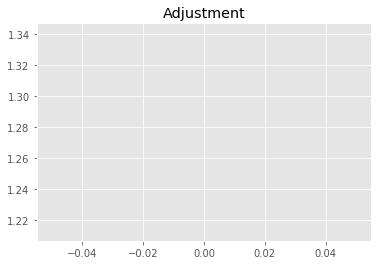

2032207161.7600615
1


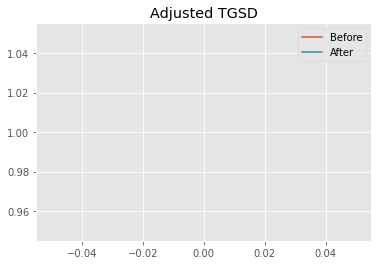

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96739 	9.89462 	21540.2 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.95143 	6.67002 	15163.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.23565
New Misfit: 4.20006
Convergence:
0.008402039936549848

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.23e+02 	2.64e+02 	1.1845 		1.0000


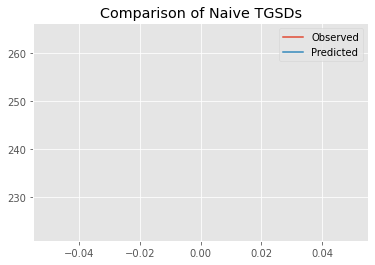

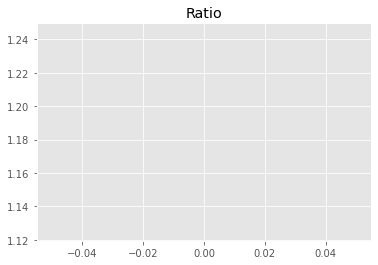

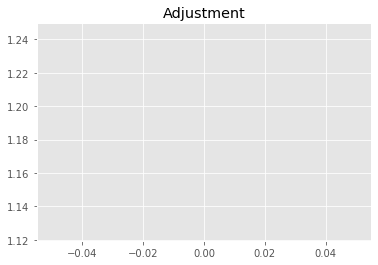

1885313736.5730176
1


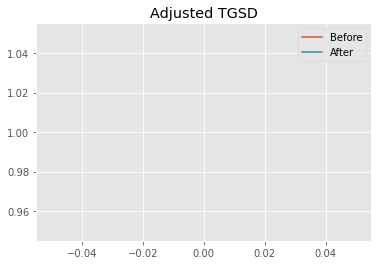

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95143 	6.67002 	15163.1 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.03208 	4.19654 	11436.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.20006
New Misfit: 4.1565
Convergence:
0.010370758685829068

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1713 		1.0000


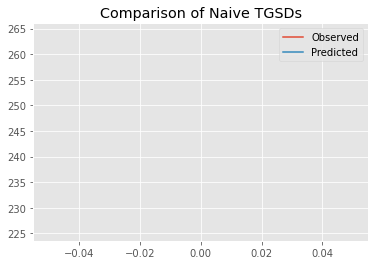

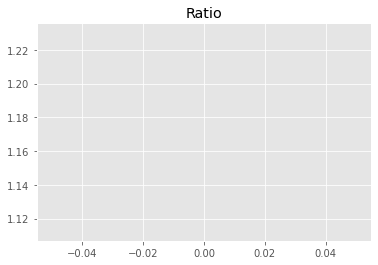

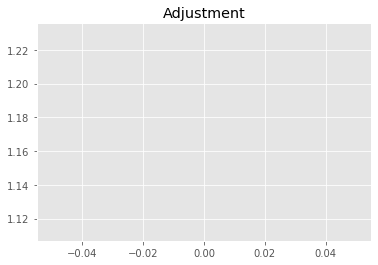

1864268351.9307737
1


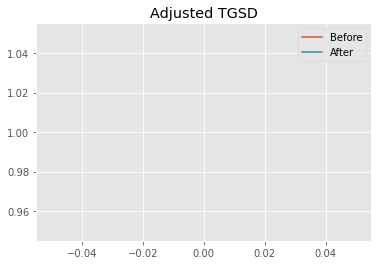

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03208 	4.19654 	11436.4 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.04956 	1.84601 	8367.38 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.1565
New Misfit: 4.05309
Convergence:
0.024880303464721296

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.25e+02 	2.64e+02 	1.1735 		1.0000


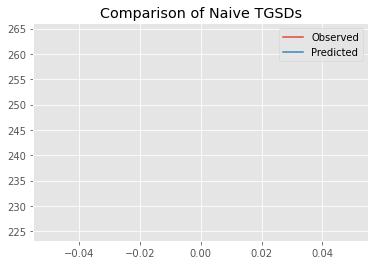

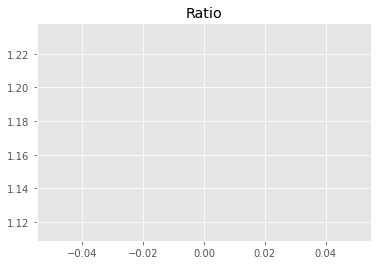

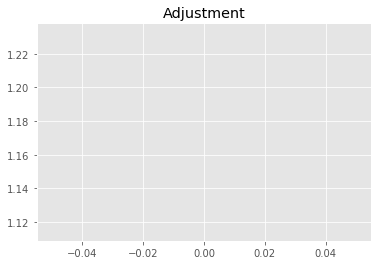

1867729484.9582775
1


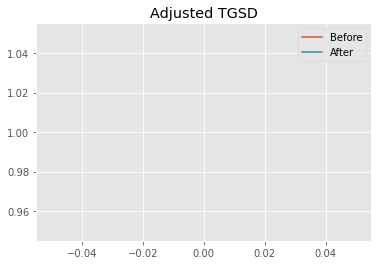

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.04956 	1.84601 	8367.38 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.03623 	1.63867 	8349.44 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.05309
New Misfit: 4.03702
Convergence:
0.003963401255088785

____________________
a = 2.03623	b = 1.63867	            h1 = 8349.43558	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 4.03702325944077
Prior Misfit: 0.404293,	 Post Misfit: 4.03702


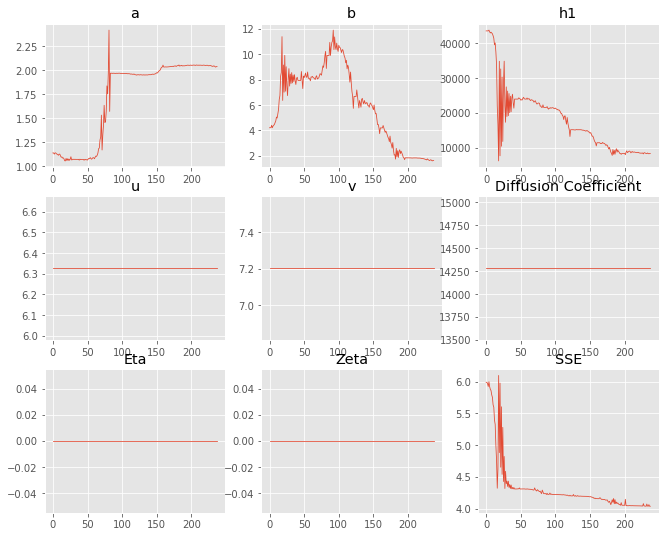

,Priors,Posteriors
a,1.13838,2.03623
b,4.21061,1.63867
h1,"43,443.4","8,349.44"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 19 Time: 0.119 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	9.26e+01 	2.64e+02 	2.8515 		1.0000


/home/nice/repos/inversion_project/utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


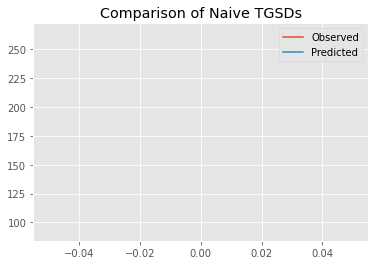

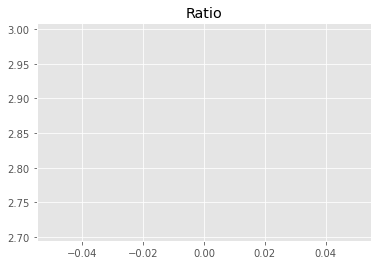

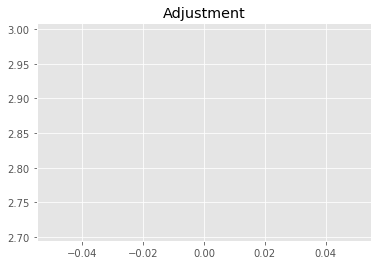

4538620952.804281
1


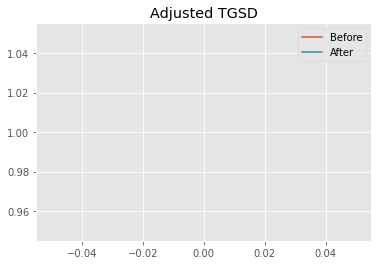

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.76584 	1.11627 	13145.3 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.62096 	3.63531 	11819.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 5.70335
New Misfit: 4.18726
Convergence:
0.26582488319933384

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1965 		1.0000


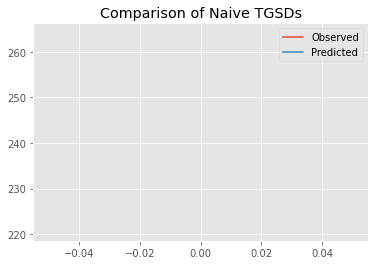

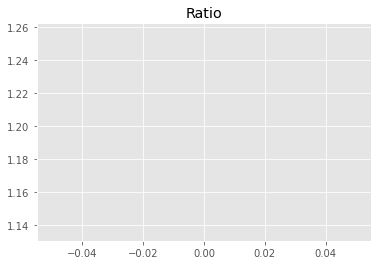

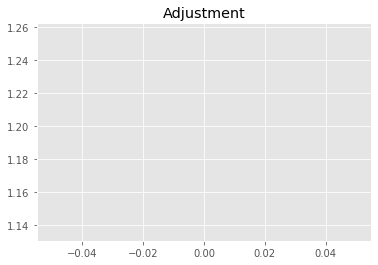

1904354387.632682
1


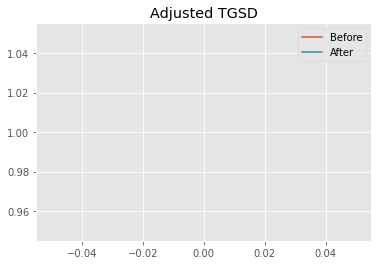

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.62096 	3.63531 	11819.8 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|1.50839 	1.51505 	8693.87 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.18726
New Misfit: 4.08073
Convergence:
0.025440279820848413

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.21e+02 	2.64e+02 	1.1971 		1.0000


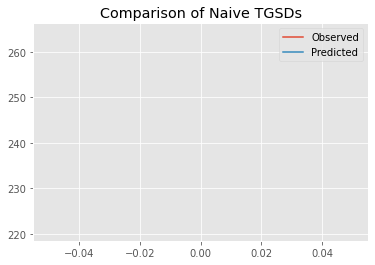

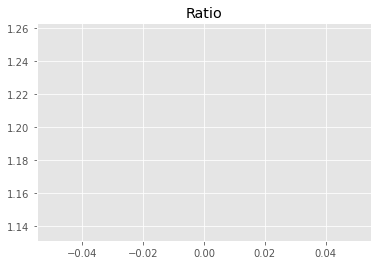

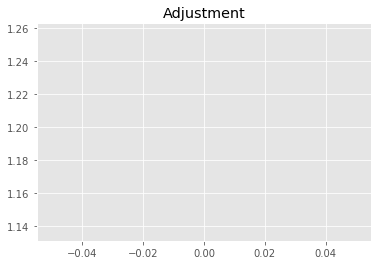

1905334869.3407588
1


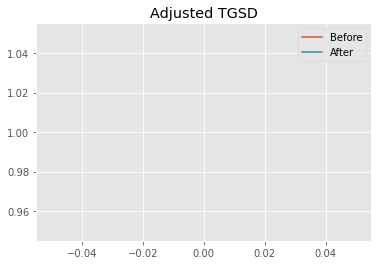

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50839 	1.51505 	8693.87 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|2.97794 	1.22336 	8118.68 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 4.08073
New Misfit: 3.88616
Convergence:
0.04768009670371146

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.17e+02 	2.64e+02 	1.2148 		1.0000


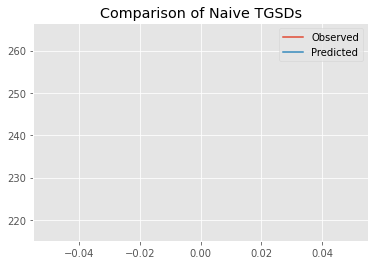

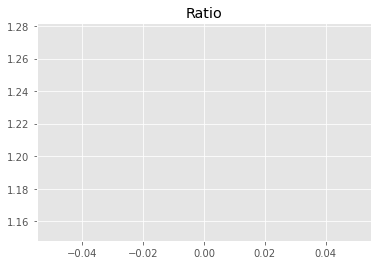

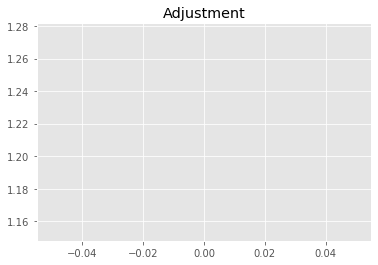

1933548306.7843618
1


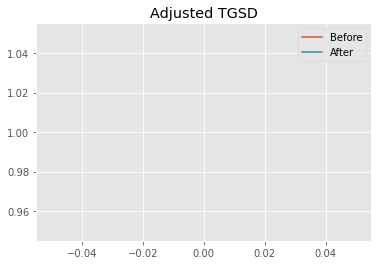

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.97794 	1.22336 	8118.68 	6.32662 	7.20299 	14280.6 	6458 	0 	0
New Total Mass: 1.59164e+09
After: 		|3.77824 	1.2038 	7334.82 	6.32662 	7.20299 	14280.6 	6458 	0 	0
Old Misfit: 3.88616
New Misfit: 3.86619
Convergence:
0.005140745035183674

____________________
a = 3.77824	b = 1.20380	            h1 = 7334.82237	u = 6.32662	v = 7.20299	            D = 14280.60000	ftt = 6458.00000	TM = 0.00000	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 3.8661868014495835
Prior Misfit: 0.385086,	 Post Misfit: 3.86619


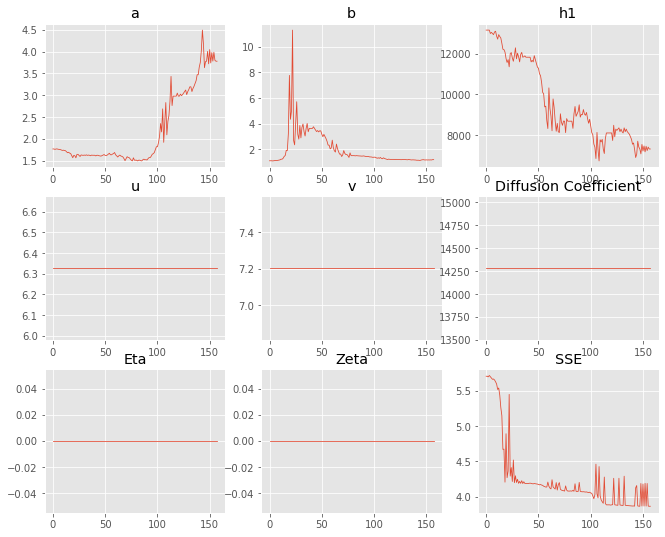

,Priors,Posteriors
a,1.76584,3.77824
b,1.11627,1.2038
h1,"13,145.3","7,334.82"
u,6.32662,6.32662
v,7.20299,7.20299
D,"14,280.6","14,280.6"
ftt,"6,458","6,458"
eta,0,0
zeta,0,0


Run 20 Time: 0.082 minutes


Estimated remaining run time: -0.087 minutes


Total Run Time: 1.81944 minutes


[{'a': 5.5036901279725985,
  'b': 1.7866190010833334,
  'h1': 7272.646464681979,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 47.892910717880106,
  'b': 29.51193715576625,
  'h1': 7978.263555486712,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 210.03872433464457,
  'b': 705.2916084484042,
  'h1': 16450.328142279563,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 5.8598904931261835,
  'b': 1.9490300231961446,
  'h1': 7270.740589766744,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 7.284424503486021,
  'b': 2.4767594401391597,
  'h1': 7270.59880436273,
  'u': 6.32662,
  'v': 7.20299,
  'D': 14280.599999999999,
  'ftt': 6457.999999999996,
  'eta': 0.0,
  'zeta': 0.0},
 {'a': 2.0035

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
2,210.039,705.292,"16,450.3",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254203
6,92.6225,183.585,"12,132.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254207
11,94.0561,342.478,"17,156.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.25421
1,47.8929,29.5119,"7,978.26",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254222
9,27.5248,12.5245,"7,515.38",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254533
7,11.6702,4.26535,"7,273.98",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.256262
10,7.18847,2.5615,"7,270.04",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.25811
4,7.28442,2.47676,"7,270.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.258217
14,6.736,2.35791,"7,268.59",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.258412
17,6.6403,2.29903,"7,268.08",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.258496


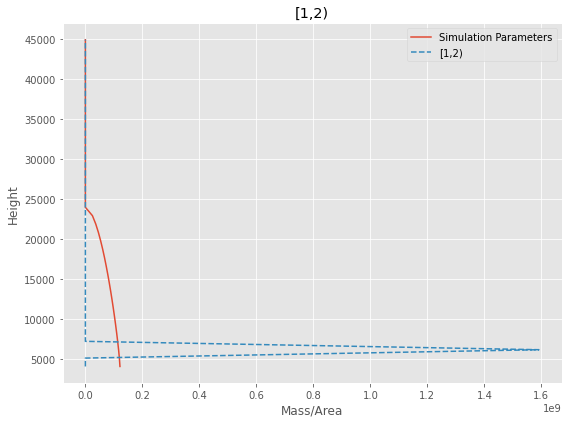

[1,2) Run Time: 1.82201 minutes


Mass Test: 54226745681.1571
Total Run Time: 9.59289 minutes


In [19]:
data_set = obs_df
t_tot = process_time()
single_run_time = 0
inverted_masses_list = []
params_list = []
iterations = 20
log="verb"
tgsd = get_tgsd(data_set, naive_phi_steps)
gof = "RMSE"

prior_phi_steps = copy.deepcopy(naive_phi_steps)

del prior_phi_steps[-1]
del prior_phi_steps[-1]

# for j, phi in enumerate(prior_phi_steps):
# #     phi["probability"] = 1/8
#     phi["probability"] = phi_probs[j]
params_dfs = []
all_misfits = []

phi_masses = []

mass_test = 0

for phi_step in prior_phi_steps:
    t = process_time()
    
    phi_df = data_set.copy()
    
    phi_df["MassArea"] = phi_df["MassArea"]*phi_df[phi_step["interval"]]/100
    phi_df[phi_step["interval"]] = 100
    mass_in_phi = config["ERUPTION_MASS"] * phi_step["probability"]
    mass_test += mass_in_phi

    
    print("========%s========"%phi_step["interval"])
    
#     out = gaussian_stack_inversion(
#         phi_df, len(phi_df), 20, config["VENT_ELEVATION"], 
#         H, 2500, [phi_step],
#         invert_params=invert_params,
#         priors=priors_vals,
#         column_cap=H)
#     inversion_table, params, sol, sse, plume_trace, param_trace, sse_trace = out
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    out = gaussian_stack_multi_run(
        phi_df, len(phi_df), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], 
        config["THEO_MAX_COL"], 2500, [iso_step], mass_in_phi, param_config, runs=iterations, column_cap = config["THEO_MAX_COL"], pre_samples=5,
        sol_iter=20, max_iter=40, tol=0.006, 
        adjust_TGSD=False, adjust_mass=False,
        adjustment_factor=0.5, gof=gof
    )
    
    masses_list, misfit_list, params_runs, priors_list, heights, tgsd_list, mass_list = out
    best = np.argsort(misfit_list)
    
    params_df = pd.DataFrame(params_runs)
    display.display(params_runs)
    params_df["M"] = mass_list
    
    if gof=="RMSE":
        denom = max(phi_df["MassArea"]) - min(phi_df["MassArea"])
        misfit_list = [mf/denom for mf in misfit_list]
    
    
    params_df["Misfit"] = misfit_list
    params_df = params_df.sort_values("Misfit")
    params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "eta", "zeta", "M", "Misfit"]]
    display.display(params_df)
    params_dfs += [params_df]
    
    all_misfits += [misfit_list]
    
    params = params_runs[best[0]]    
    params_list += [params]
    best_mass = mass_list[best[0]]
    phi_masses += [best_mass]
    
    inv_mass = mass_dist_in_plume(params["a"],params["b"], 
                                config["VENT_ELEVATION"], 
                                params["h1"], 
                                heights,
                                mass_in_phi)
    inverted_masses_list += [inv_mass]


     
    fig, ax1 = plt.subplots(1,1, figsize=(
    8, 6), facecolor='w', edgecolor='k')

    q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], 
                                config["VENT_ELEVATION"], 
                                config["PLUME_HEIGHT"], 
                                heights,
                                mass_in_phi)

    ax1.plot(q_mass, heights, label="Simulation Parameters")
    
    ax1.plot(inv_mass, heights, 
             '--', label=phi_step["interval"])
    ax1.legend()
    ax1.set_title("%s"%phi_step["interval"])
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")

    plt.tight_layout()
    plt.show()
    run_time = process_time() - t
    print("%s Run Time: %.5f minutes\n\n"%(phi_step["interval"], run_time/60))
    print("Mass Test:", mass_test)
total_run_time = process_time() - t_tot

print("Total Run Time: %.5f minutes"%(total_run_time/60))

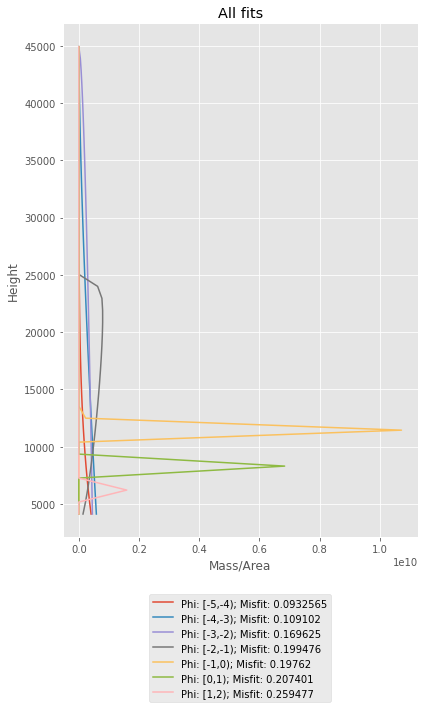

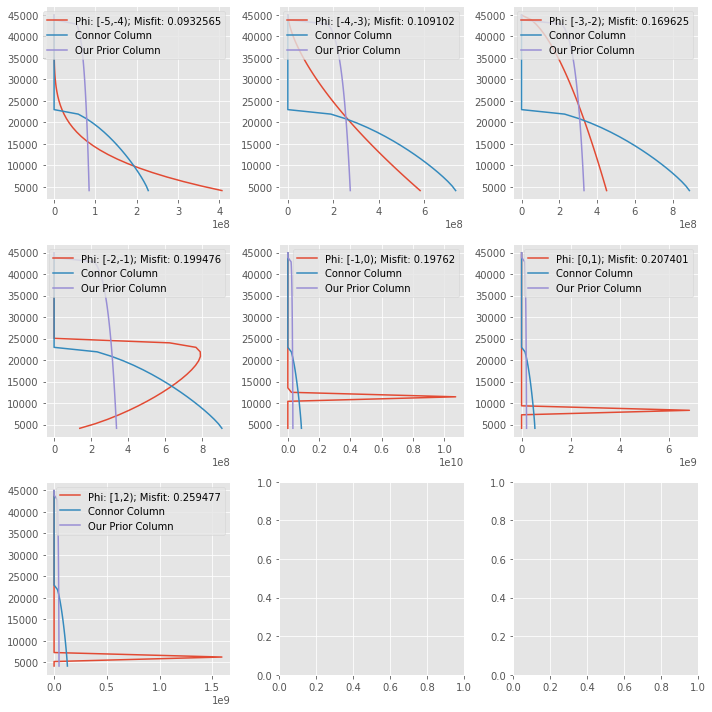

Phi Class: [-5,-4)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
6,1,5.93652,"44,910.5",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932441
10,1,5.91023,"44,912.5",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932441
1,1.00034,5.8759,"44,779",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932492
14,1.00001,5.89879,"44,640",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932514
0,1.00024,5.97929,"44,566.3",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932565
12,1,5.99592,"44,537.2",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932574
11,1.00135,5.90099,"44,587.1",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932581
9,1.00049,5.73017,"44,488.2",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932615
8,1.00119,5.75486,"44,016.8",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932734
19,1.00119,5.64419,"43,810.5",6.32662,7.20299,"14,280.6","6,458",0,0,2.8774e+09,0.0932819


Phi Class: [-4,-3)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
15,1,2.51611,"44,913.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.10871
13,1.0001,2.51774,"44,910.9",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.10871
5,1.00005,2.50657,"44,785.7",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108715
8,1.00047,2.50551,"44,821.9",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108716
6,1,2.53249,"44,834.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108718
16,1.00038,2.49999,"44,760.3",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108718
17,1.00078,2.49547,"44,455.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108733
14,1.00257,2.48101,"44,537.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.10874
1,1.00007,2.49666,"44,169.6",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108753
11,1.00007,2.36082,"42,920.5",6.32662,7.20299,"14,280.6","6,458",0,0,9.31979e+09,0.108801


Phi Class: [-3,-2)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
1,1,1.59643,"44,914.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169625
0,1.0003,1.59033,"44,707.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169625
10,1.00058,1.58327,"44,906.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.16963
7,1.00715,1.55666,"43,682.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169632
16,1.00378,1.42923,"41,304.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169635
17,1.00944,1.51357,"42,581.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.16964
14,1.01172,1.59855,"44,579.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169645
5,1.01317,1.59371,"44,088",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169646
6,1.01611,1.63419,"44,752.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169654
12,1.02296,1.63175,"44,915",6.32662,7.20299,"14,280.6","6,458",0,0,1.1215e+10,0.169666


Phi Class: [-2,-1)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
15,1.68047,1.1035,"24,113.7",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199219
16,1.88958,1.46935,"25,860",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199471
0,1.82743,1.42993,"25,833.7",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199476
7,2.14973,1.942,"27,197.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.19977
12,2.12639,2.03591,"28,182.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199774
2,2.14671,2.11699,"28,384.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.19982
13,2.20688,2.10941,"27,814",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199851
10,2.21159,2.27624,"29,034.2",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199878
4,2.21522,2.39547,"29,956",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199921
5,2.28622,2.23222,"28,109.4",6.32662,7.20299,"14,280.6","6,458",0,0,1.14451e+10,0.199929


Phi Class: [-1,0)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
19,474.908,248.646,"16,334.3",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197615
0,27.4803,1.60421,"12,951.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.19762
4,280.897,151.964,"16,534.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.19764
18,42.2528,4.86566,"12,961.9",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197655
1,234.596,122.84,"16,434.9",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197655
15,124.021,67.332,"16,635",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197764
5,52.7173,10.4964,"13,559.3",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197788
13,81.0969,44.3862,"16,527.8",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.19792
2,60.7074,33.0755,"16,576.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.197979
8,34.6078,13.5963,"15,330.5",6.32662,7.20299,"14,280.6","6,458",0,0,1.09416e+10,0.198124


Phi Class: [0,1)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
14,298.016,361.452,"14,740.6",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206493
3,240.067,356.729,"16,199.4",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206494
8,197.375,268.84,"15,557.7",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206497
12,238.156,556.191,"20,701.1",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.206498
5,86.9575,83.3545,"13,464.2",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.20662
2,93.9364,392.524,"30,639.3",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207001
19,73.465,122.97,"17,162.3",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207008
7,19.2835,3.38574,"9,416.96",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207052
6,17.564,2.93055,"9,377.79",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207126
4,15.5141,2.59501,"9,360.85",6.32662,7.20299,"14,280.6","6,458",0,0,6.83614e+09,0.207227


Phi Class: [1,2)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
2,210.039,705.292,"16,450.3",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254203
6,92.6225,183.585,"12,132.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254207
11,94.0561,342.478,"17,156.1",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.25421
1,47.8929,29.5119,"7,978.26",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254222
9,27.5248,12.5245,"7,515.38",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.254533
7,11.6702,4.26535,"7,273.98",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.256262
10,7.18847,2.5615,"7,270.04",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.25811
4,7.28442,2.47676,"7,270.6",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.258217
14,6.736,2.35791,"7,268.59",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.258412
17,6.6403,2.29903,"7,268.08",6.32662,7.20299,"14,280.6","6,458",0,0,1.59164e+09,0.258496


In [20]:
fig, ax1 = plt.subplots(1,1, figsize=(6, 10), facecolor='w', edgecolor='k')

for i, phi_step in enumerate(prior_phi_steps):
    label = "Phi: %s; Misfit: %g"%(phi_step["interval"], params_dfs[i]["Misfit"][0])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                config["ERUPTION_MASS"],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

q_mass_prior = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                config["ERUPTION_MASS"],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                phi_masses[j],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

    q_mass_prior = beta_plume(1.00002,1.13405 ,44908,
                phi_masses[j],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])
    
    label = "Phi: %s; Misfit: %g"%(phi_step["interval"], params_dfs[j]["Misfit"][0])
    axs[j].plot(inverted_masses_list[j],
             heights, 
             '-', label=label)
    axs[j].plot(q_mass, heights, label="Connor Column")
    axs[j].plot(q_mass_prior, heights, label="Our Prior Column")
    axs[j].legend()
plt.tight_layout()
plt.show()


for j, phi_step in enumerate(prior_phi_steps):
    display.display_markdown(display.Markdown('''Phi Class: %s'''%phi_step['interval']))
    display.display(params_dfs[j])




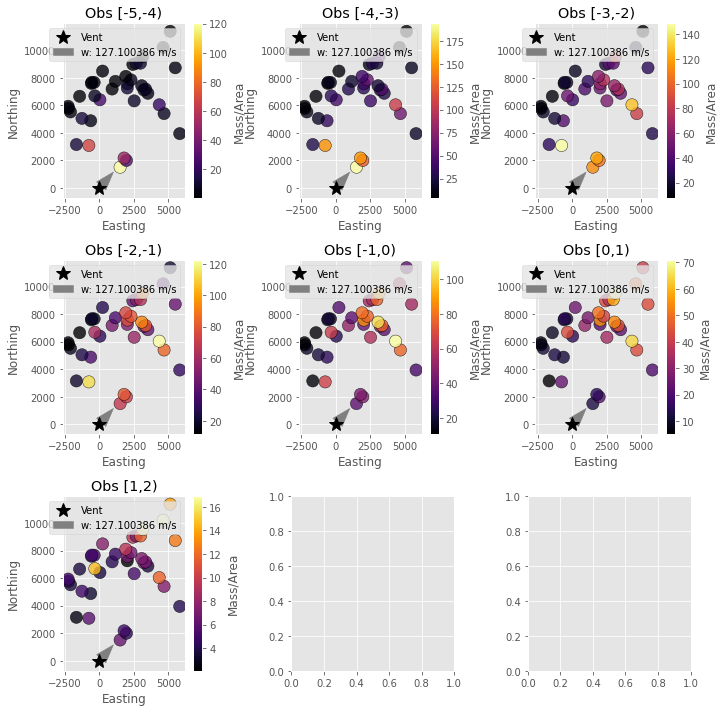

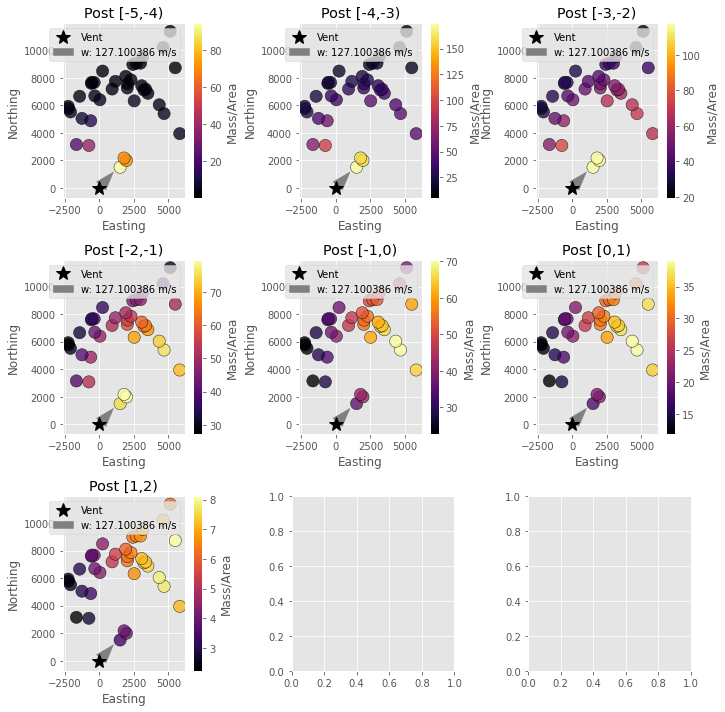

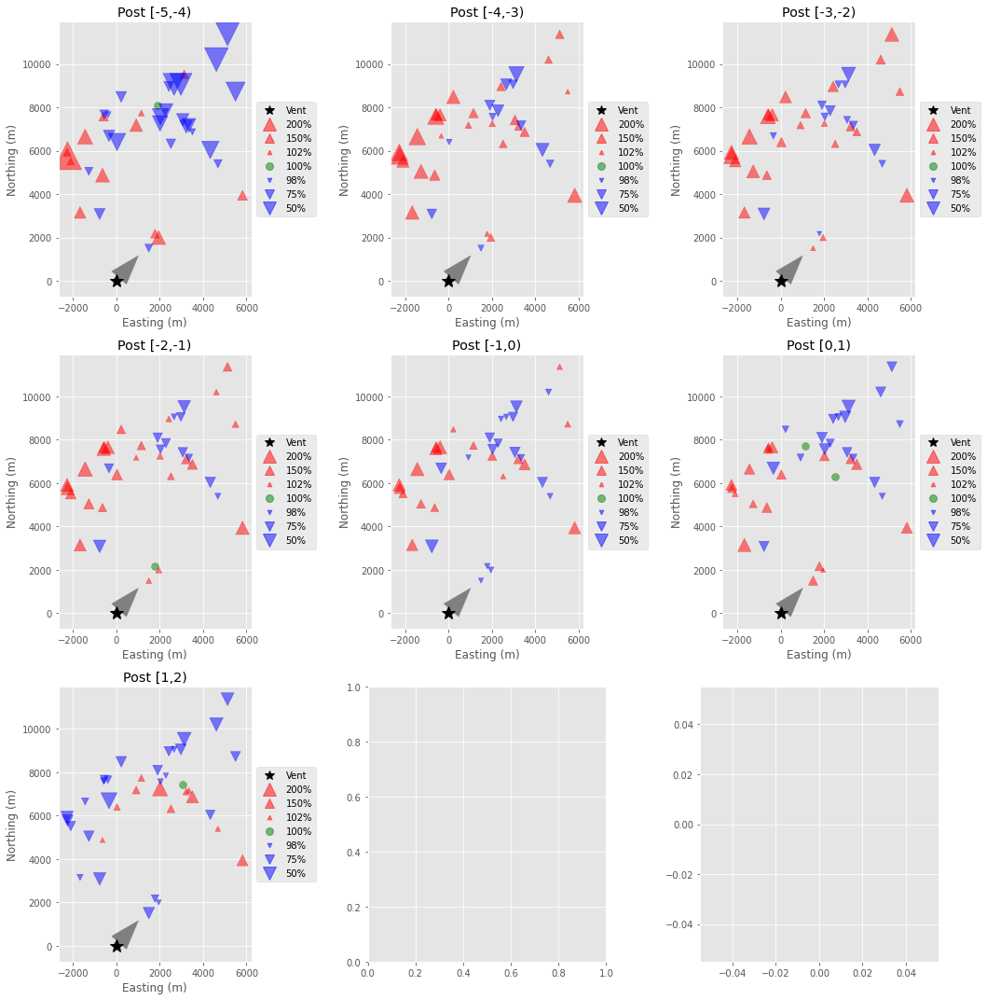

In [22]:
observation_phis = []
posterior_phis = []

for j, phi_step in enumerate(prior_phi_steps):
    phi_obs = data_set.copy()
    phi_obs["MassArea"] = phi_obs["MassArea"]*phi_obs[phi_step["interval"]]/100
    phi_obs[phi_step["interval"]] = 100
    bounds=(0, 200)

    observation_phis += [phi_obs]
    _, phi_post, _, _, _ = gaussian_stack_single_phi(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[j]["h1"], (params_list[j]["a"],params_list[j]["b"]), 
        phi_masses[j], (params_list[j]["u"],params_list[j]["v"]), phi_step["lower"], 
        phi_step["density"],2500,
        params_list[j]["D"], config["EDDY_CONST"],
        params_list[j]["ftt"], params_list[j]["eta"], params_list[j]["zeta"]
    )
    phi_post["radius"] = np.sqrt(phi_post["Easting"]**2 + phi_post["Northing"]**2)
    phi_post = phi_post.sort_values(by=['radius'])
    phi_post["Residual"] = phi_post["MassArea"].values/phi_obs["MassArea"].values
    
    posterior_phis += [phi_post]

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False,#bounds=bounds, 
                   title="Obs %s"%phi_step["interval"], cbar_label="Mass/Area", ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_sample(posterior_phis[j], vent=(0,0), log=False,#bounds=bounds, 
                   title="Post %s"%phi_step["interval"], cbar_label="Mass/Area", ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))
    
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_residuals(posterior_phis[j], vent=(0,0), plot_type="size",
                   title="Post %s"%phi_step["interval"], ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))
    
plt.tight_layout()
plt.show()

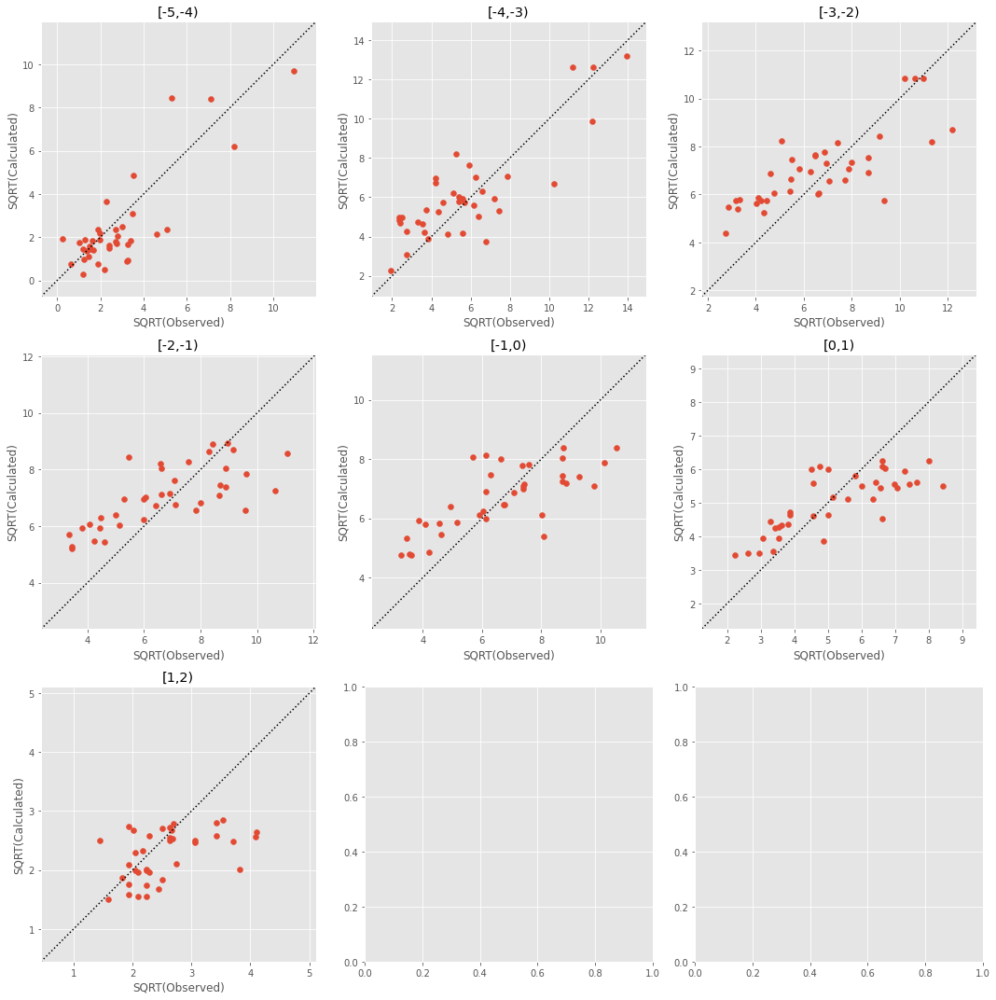

In [25]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    min_mass = min((min(observation_phis[j]["MassArea"].values), min(posterior_phis[j]["MassArea"].values)))
    max_mass = max((max(observation_phis[j]["MassArea"].values), max(posterior_phis[j]["MassArea"].values)))
    axs[j].scatter(np.sqrt(observation_phis[j]["MassArea"].values), np.sqrt(posterior_phis[j]["MassArea"].values))
    axs[j].plot([-100,100],[-100,100], "k:")
    axs[j].set_xlabel("SQRT(Observed)")
    axs[j].set_ylabel("SQRT(Calculated)")
    axs[j].set_aspect('equal', 'box')
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    axs[j].set_ylim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    
plt.tight_layout()
plt.show()

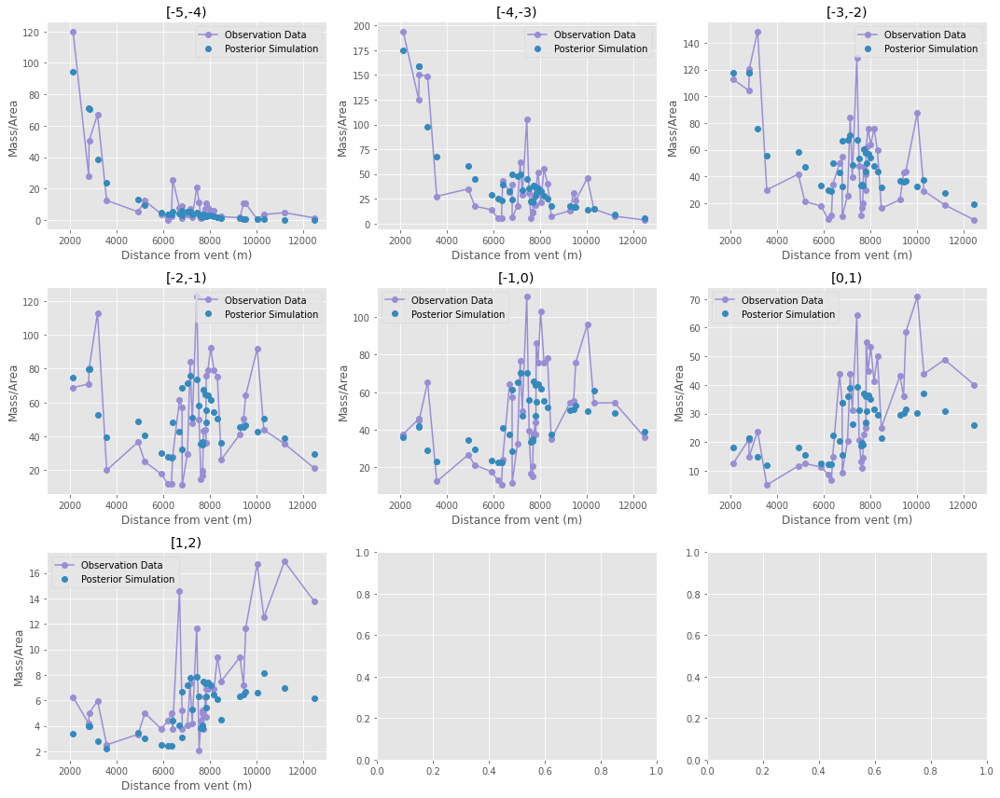

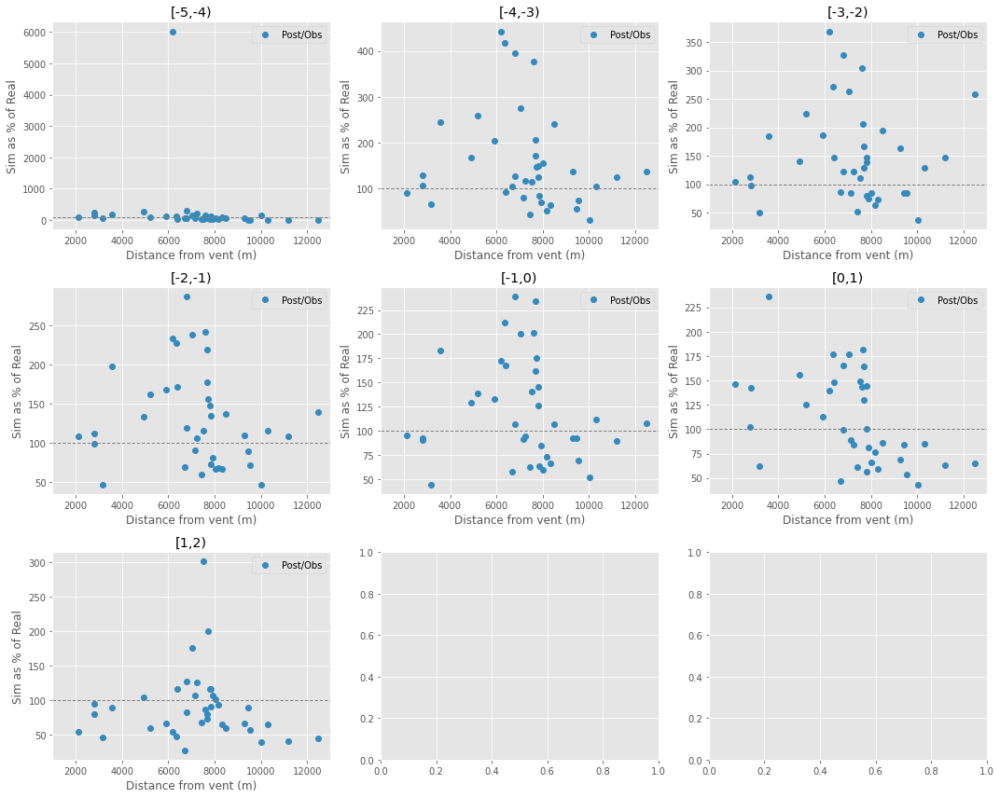

In [26]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"].values, observation_phis[j]["MassArea"].values, 'C2o-', label="Observation Data")
    axs[j].plot(posterior_phis[j]["radius"].values, posterior_phis[j]["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[j].legend()
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlabel("Distance from vent (m)")
    axs[j].set_ylabel("Mass/Area")
    axs[j].set_xlim(1000, 13000)
    
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(posterior_phis[j]["radius"].values, posterior_phis[j]["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[j].axhline(100, linestyle="--", lw=1, c="gray")  
    axs[j].legend()
    axs[j].set_xlabel("Distance from vent (m)")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_ylabel("Sim as % of Real")
    axs[j].set_xlim(1000, 13000)
    
plt.tight_layout()
plt.show()

[-5,-4) 598.9391454537729
[-4,-3) 406.0665684067763
[-3,-2) 440.69807962510356
[-2,-1) 374.171482331211
[-1,0) 310.1297589126688
[0,1) 239.4976491010694
[1,2) 87.68197692130292
Full Misfit:  2457.184660751905


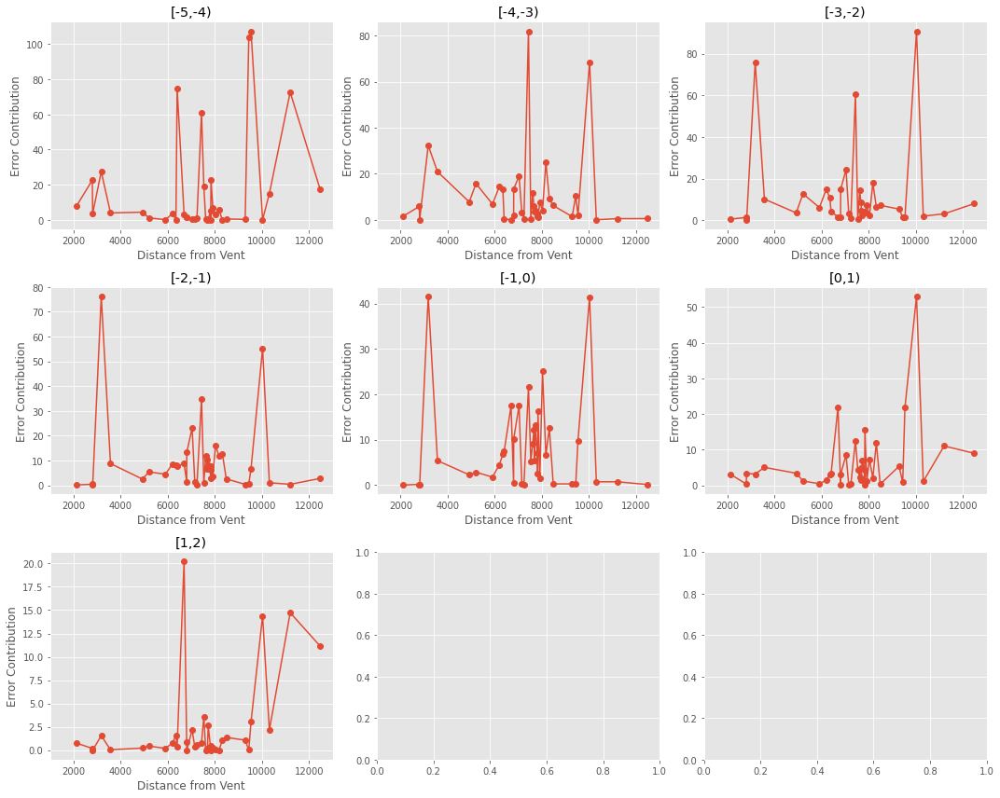

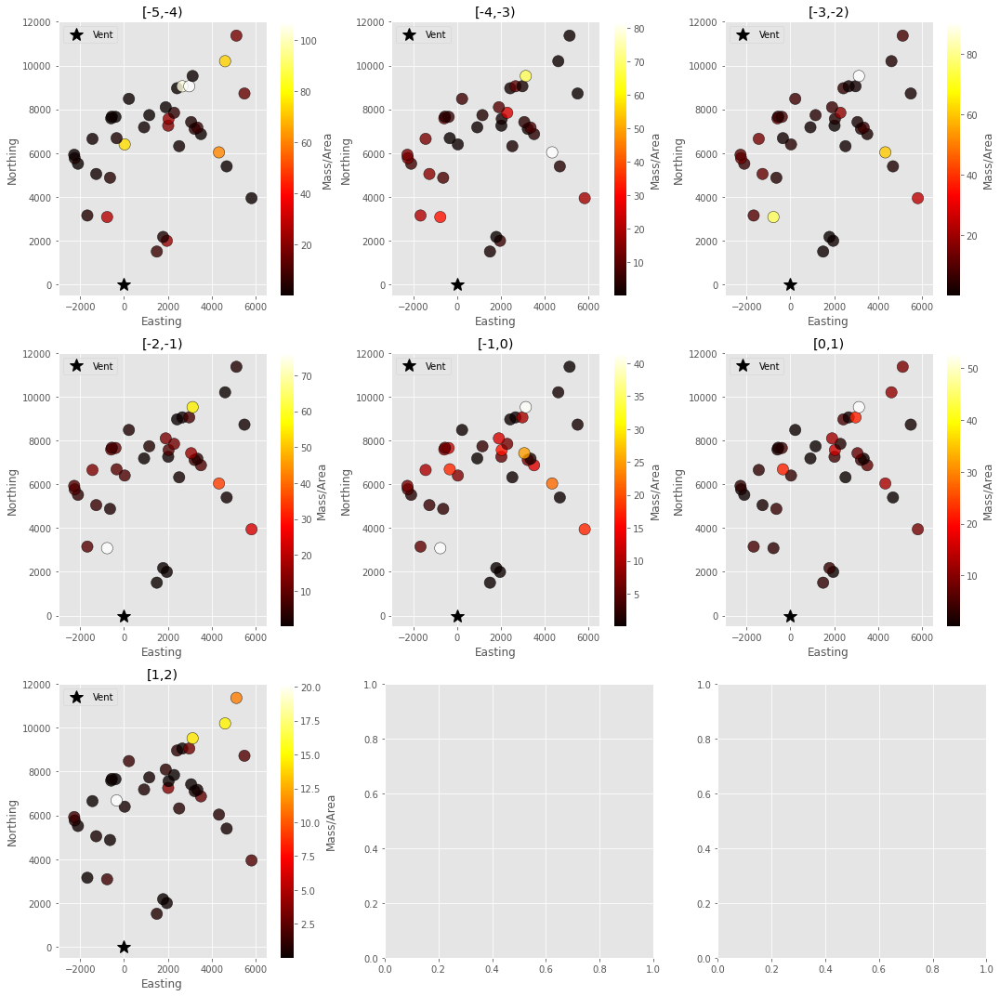

In [27]:


all_point_conts = []
all_phi_conts = []

for j, phi_step in enumerate(prior_phi_steps):
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    misfit, contributions, setup = get_error_contributions(
        observation_phis[j], len(observation_phis[j]), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, [iso_step], 
        params_list[j], phi_masses[j], column_cap = config["THEO_MAX_COL"])
    
    print(phi_step["interval"], misfit)
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    all_point_conts += [point_contributions]
    all_phi_conts += [phi_contributions]
print("Full Misfit: ", sum(sum(all_point_conts)))

fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"], all_point_conts[j], "C0o-")
    axs[j].set_xlabel("Distance from Vent")
    axs[j].set_ylabel("Error Contribution")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim(1000, 13000)

plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    observation_phis[j]["Contributions"] = all_point_conts[j]
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = axs[j], cmap="hot")
    axs[j].set_xlim([-3000, 6500])
    axs[j].set_ylim([-500, 12000])
    axs[j].set_title(phi_step["interval"])

plt.tight_layout()
plt.show()

In [28]:
def misfit_sse(observed, expected):
    return ((observed - expected)**2)/expected

contributions = np.zeros((len(prior_phi_steps), len(observation_phis[0])))
RMSE_contributions = np.zeros((len(prior_phi_steps), len(observation_phis[0])))
print(contributions.shape)
for j, phi_step in enumerate(prior_phi_steps):
    observation_phis[j]["MassArea"].values
    for i in range(len(posterior_phis[j])):
        observed = observation_phis[j]["MassArea"].values[i]
        expected = posterior_phis[j]["MassArea"].values[i]
        misfit = ((observed - expected)**2)/expected
        RMSE = ((observed - expected)**2)
        contributions[j,i] = misfit
        RMSE_contributions[j,i] = RMSE
    
RMSE_point_contributions = np.sqrt(np.sum(RMSE_contributions, 0)/38)
RMSE_phi_contributions = np.sqrt(np.sum(RMSE_contributions, 1)/9)

point_contributions = np.sum(contributions, 0)
phi_contributions = np.sum(contributions, 1)

total_misfit = np.sum(np.sum(contributions))

total_RMSE = np.sqrt(np.sum(np.sum(RMSE_contributions))/38)

total_NRMSE = total_RMSE/(np.max(obs_df["MassArea"].values) - np.min(obs_df["MassArea"].values))
display.display(phi_contributions)
print(total_misfit)
print(total_RMSE)
print(total_NRMSE)

(7, 38)


array([619.65382473, 415.74075451, 440.88063195, 370.43894704,
       316.55224923, 246.59632917, 100.57473127])

2510.4374679043326
47.37076774291828
0.08410704119690048


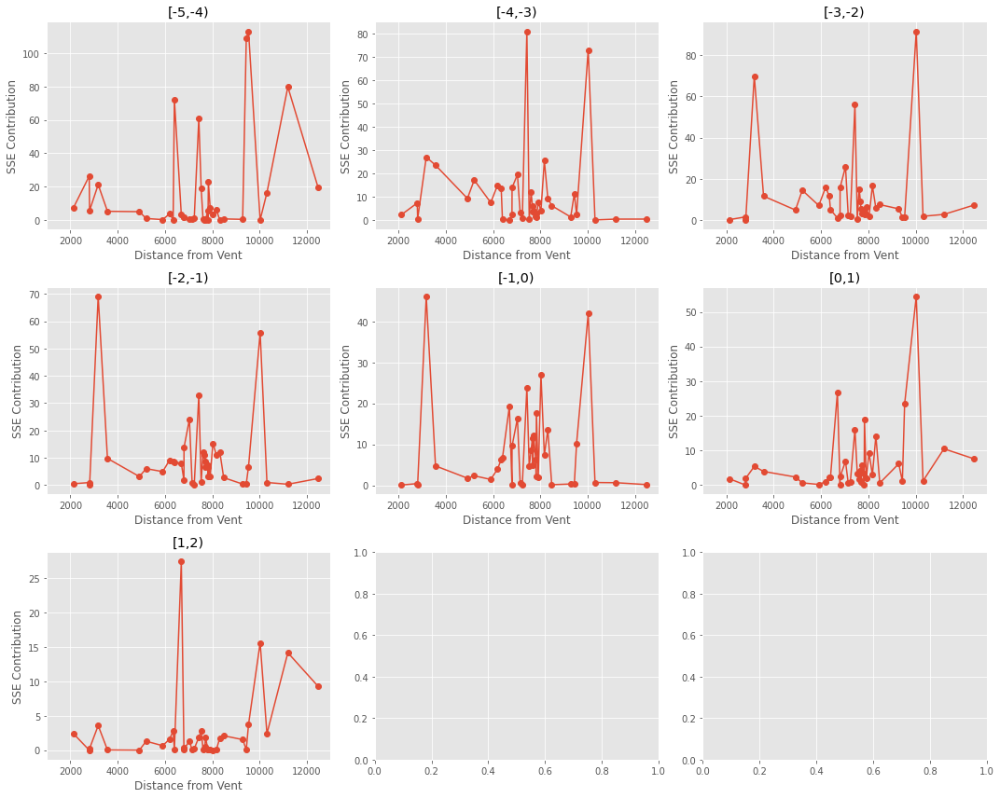

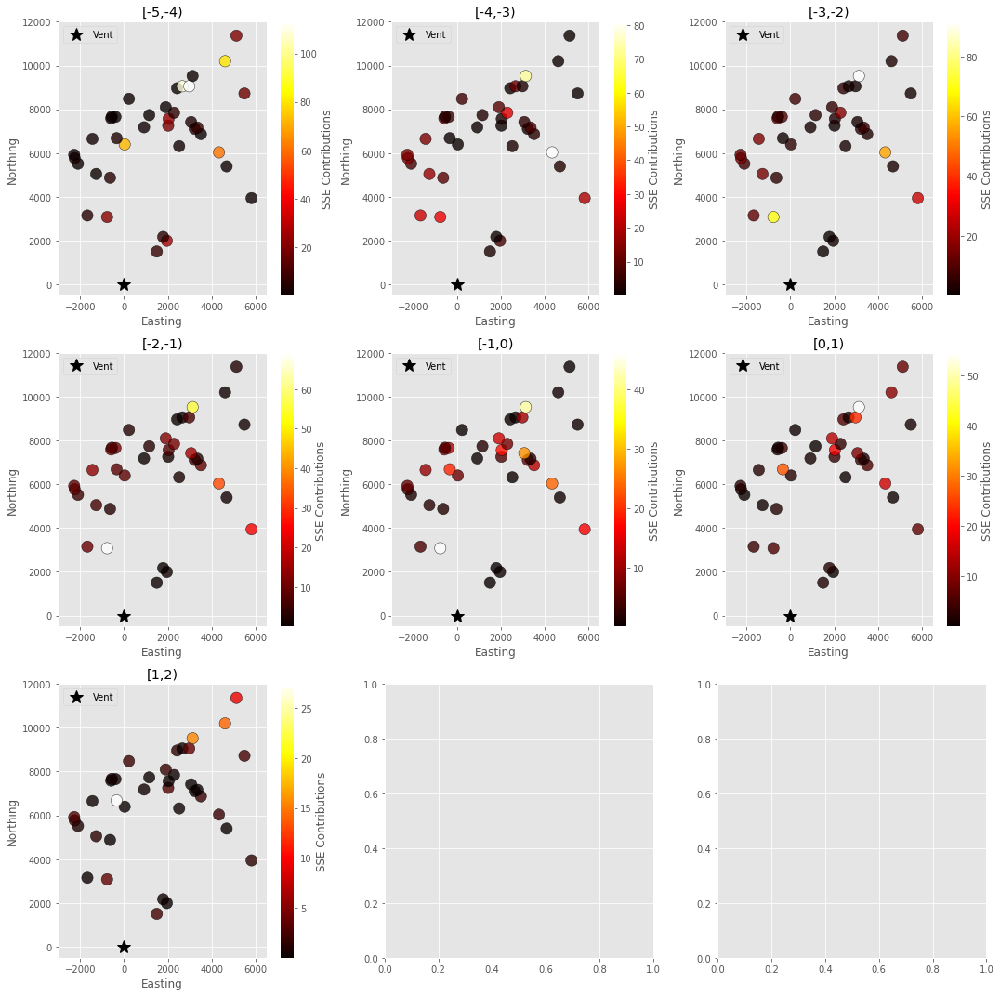

In [29]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"], contributions[j,:], "C0o-")
    axs[j].set_xlabel("Distance from Vent")
    axs[j].set_ylabel("SSE Contribution")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim(1000, 13000)

plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    observation_phis[j]["Contributions"] = contributions[j,:]
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False, values="Contributions",
                title="SSE Contributions", cbar_label="SSE Contributions", ax = axs[j], cmap="hot")
    axs[j].set_xlim([-3000, 6500])
    axs[j].set_ylim([-500, 12000])
    axs[j].set_title(phi_step["interval"])

plt.tight_layout()
plt.show()

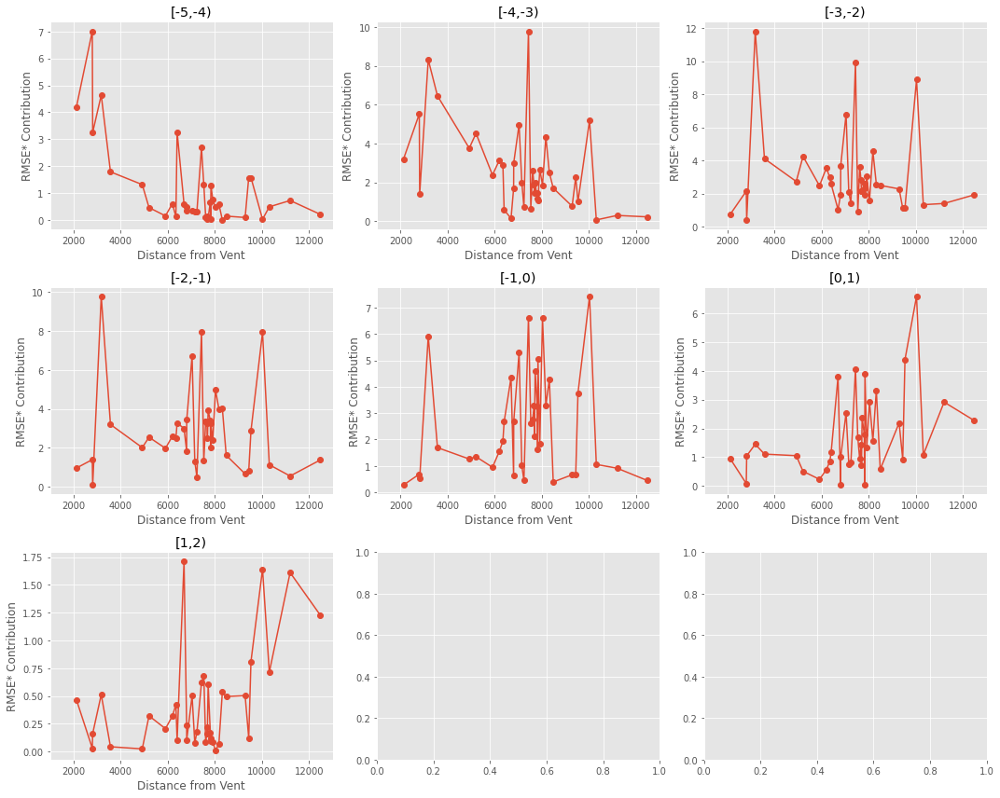

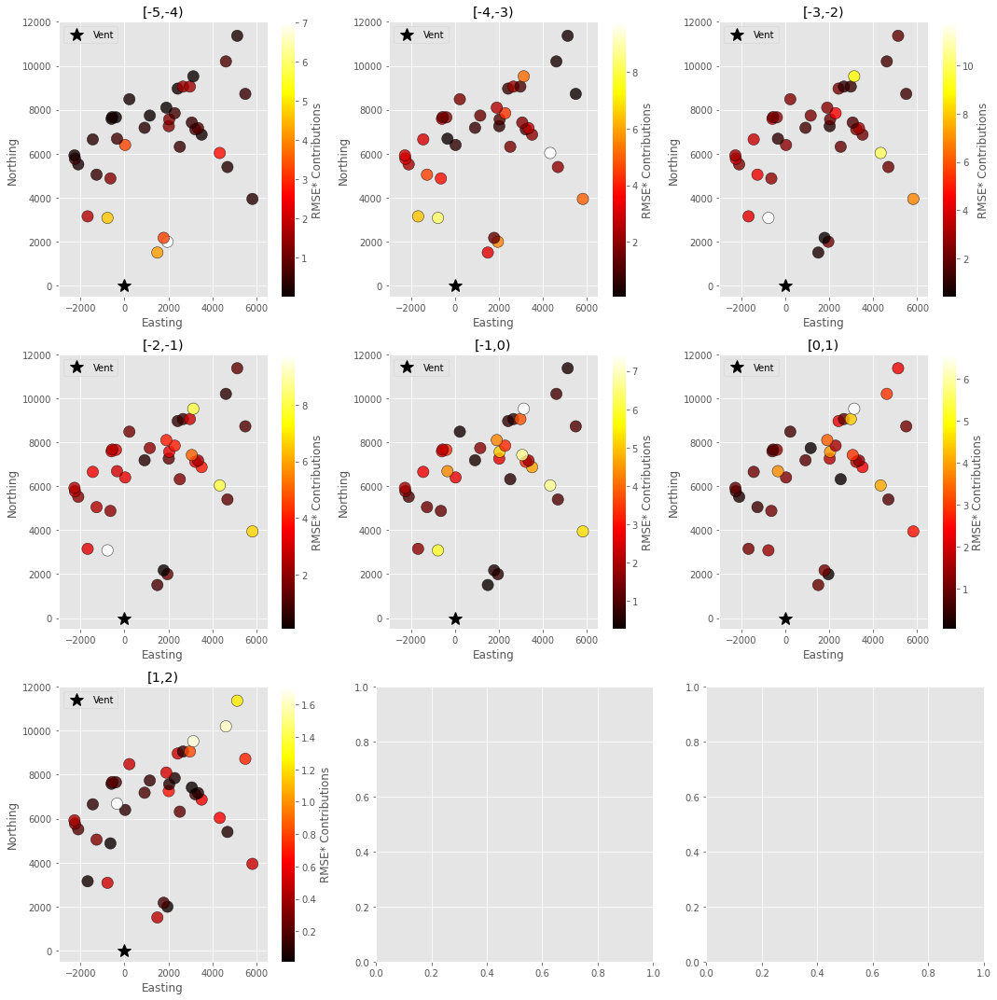

In [31]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"], np.sqrt(RMSE_contributions[j,:]/len(observation_phis[j])), "C0o-")
    axs[j].set_xlabel("Distance from Vent")
    axs[j].set_ylabel("RMSE* Contribution")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim(1000, 13000)

plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    observation_phis[j]["Contributions"] = np.sqrt(RMSE_contributions[j,:]/len(observation_phis[j]))
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False, values="Contributions", cbar_label="RMSE* Contributions", ax = axs[j], cmap="hot")
    axs[j].set_xlim([-3000, 6500])
    axs[j].set_ylim([-500, 12000])
    axs[j].set_title(phi_step["interval"])

plt.tight_layout()
plt.show()

In [33]:
row_labels = [phi["interval"] for phi in prior_phi_steps]

num_phis = len(prior_phi_steps)

cont_df = pd.DataFrame(data=contributions.T, columns=row_labels, index = obs_df.index)

min_phis = np.array([min(observation_phis[i]["MassArea"].values) for i in range(num_phis)])
print(min_phis)
max_phis = np.array([max(observation_phis[i]["MassArea"].values) for i in range(num_phis)])
print(max_phis)

#Total sum per column: 
cont_df.loc['Phi Total (RMSE)',:9]= np.sqrt(cont_df.sum(axis=0)/num_phis)
cont_df.loc['Phi Total (NRMSE)',:9] = np.sqrt(cont_df.sum(axis=0)/num_phis)/(max_phis-min_phis)

#Total sum per row: 
cont_df.loc[:38,'Point Total (RMSE*)'] = np.sqrt(cont_df.sum(axis=1)/38)
# cont_df.loc[:,'Point Total (NRMSE)'] = np.sqrt(cont_df.sum(axis=1)/38)

display.display(cont_df)

[ 0.06258  3.7548   7.5096  11.2644  10.6386   5.0064   2.086  ]
[120.1536 193.998  148.6275 122.6568 110.9752  70.924   16.8966]


<ipython-input-33-97589490930e>:13: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.
  cont_df.loc['Phi Total (RMSE)',:9]= np.sqrt(cont_df.sum(axis=0)/num_phis)
<ipython-input-33-97589490930e>:14: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.
  cont_df.loc['Phi Total (NRMSE)',:9] = np.sqrt(cont_df.sum(axis=0)/num_phis)/(max_phis-min_phis)
<ipython-input-33-97589490930e>:17: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.
  cont_df.loc[:38,'Point Total (RMSE*)'] = np.sqrt(cont_df.sum(axis=1)/38)


,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)",Point Total (RMSE*)
16,7.1279,2.21882,0.190987,0.462057,0.079031,1.8099,2.42066,0.613646
18,26.2332,7.26901,1.49858,0.916651,0.42925,0.0117336,0.00897171,0.978282
17,5.69975,0.469156,0.0548685,0.00288832,0.24568,1.93371,0.251971,0.477329
37,21.1284,26.9618,69.9288,69.1418,46.104,5.38509,3.57648,2.52475
31,5.15217,23.4864,11.5931,9.75665,4.74335,3.93112,0.0320001,1.24282
36,4.93636,9.21096,4.85189,3.11077,1.75261,2.31415,0.00632557,0.830077
35,0.849479,17.0968,14.4553,6.01694,2.33466,0.629733,1.30048,1.05983
34,0.177579,7.46081,7.038,4.91349,1.43801,0.157612,0.648514,0.75801
33,3.64671,14.9663,15.9341,9.1058,4.02031,0.98253,1.60717,1.15009
32,0.169322,13.6311,11.5791,8.58703,6.29493,2.31126,2.78873,1.09258


[-5,-4) 244.44499987853646
[-4,-3) 470.9430416458195
[-3,-2) 593.0623978419296
[-2,-1) 467.2821114707371
[-1,0) 361.8198542828056
[0,1) 471.73287137914497
[1,2) 555.2302652457236
Full Misfit:  3164.515541744697


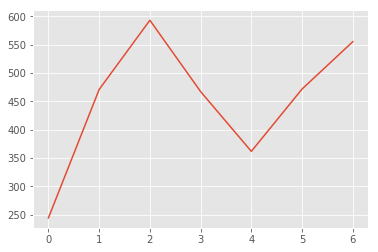

In [47]:
all_point_conts = []
all_phi_conts = []

for j, phi_step in enumerate(prior_phi_steps):
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    misfit, contributions, setup = get_error_contributions(
        observation_phis[j], len(observation_phis[j]), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, [iso_step], 
        full_inversion_priors, phi_masses[j], column_cap = config["THEO_MAX_COL"])
    
    print(phi_step["interval"], misfit)
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    all_point_conts += [point_contributions]
    all_phi_conts += [phi_contributions]
    
print("Full Misfit: ", sum(sum(all_point_conts)))
plt.plot(all_phi_conts)
plt.show()


In [48]:
misfit, contributions, setup = get_error_contributions(
        data_set, len(data_set), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, prior_phi_steps, 
        full_inversion_priors, config["ERUPTION_MASS"], column_cap = config["THEO_MAX_COL"])
print("Full misfit", misfit)
point_contributions = np.sum(contributions, 0)
phi_contributions = np.sum(contributions, 1)
print("Point Contributions", point_contributions)
print("Phi Contributions", phi_contributions)

print("Sum of Point Conts:", sum(point_contributions))
print("Sum of Phi Conts:", sum(phi_contributions))

Full misfit 3164.5155417446967
Point Contributions [163.35274457 200.02571389 152.18302505  48.87098672 128.16739944
  94.11453909  93.9503987   40.79673277  70.11854723  66.17287921
  77.55745155 144.15813168  47.50543456  75.51258791  72.3893694
  15.21925872  29.13931857 188.5233464   32.75047217  68.50857429
  60.52900923  39.49367024  60.35896466  49.47002463  39.13022476
  54.01205478  14.81722462  61.15006198  36.20088955  62.66942088
  46.18756974  50.17933628  50.69701863 120.79538777 374.67059546
  45.53763126 117.15914271  72.44040264]
Phi Contributions [244.44499988 470.94304165 593.06239784 467.28211147 361.81985428
 471.73287138 555.23026525]
Sum of Point Conts: 3164.5155417446977
Sum of Phi Conts: 3164.5155417446967


In [222]:
print(sum(phi_masses))
print(config["ERUPTION_MASS"])
print(55000000000.0)

55000000000.0
55000000000.0
55000000000.0
